### Evaluate the output trajectories from the SeqGAN model

Note: After some hacking on the SeqGAN model, we did not pursue it do to unsatisfactory results and inflexibility.

In [1]:
import datetime
import os

import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import pandas as pd

from eval_util import *


In [2]:
HOURS_PER_DAY = 24
TIME_PERIOD_DAYS = 5

In [3]:
def read_trajectories_from_file(filename):
    """
    Returns a list of lists, where each list represents a trajectory written to file.
    Expects file format where each line is one trajectory, and places in the trajectory are delimited by spaces.
    """
    trajectories = []
    with open(filename, 'r') as f:
        for _i, line in enumerate(f):
            line = line.strip()
            line = line.split()
            parse_line = [int(x) for x in line]
            trajectories.append(parse_line)
    return trajectories

Load and inspect the real data.

In [4]:
# Load the real trajectories data. Note these are prefixed by home,work labels
relabeled_trajectories_filename = '../data/relabeled_trajectories_1_workweek.txt'
real_trajectories = read_trajectories_from_file(relabeled_trajectories_filename)

In [5]:
# What is the vocabulary size? i.e. how many distinct labels?
vocab = set()
for t in real_trajectories:
    vocab.update(set(t))
print(len(vocab))

652


- How many distinct home labels?
- How many distinct (home, work) label pairs?
- Of the distinct (home, work) label pairs, how many users for each?

0
----- vector ----
prefix labels:  [1, 1]
[1, 1, 1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3]
[3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0]


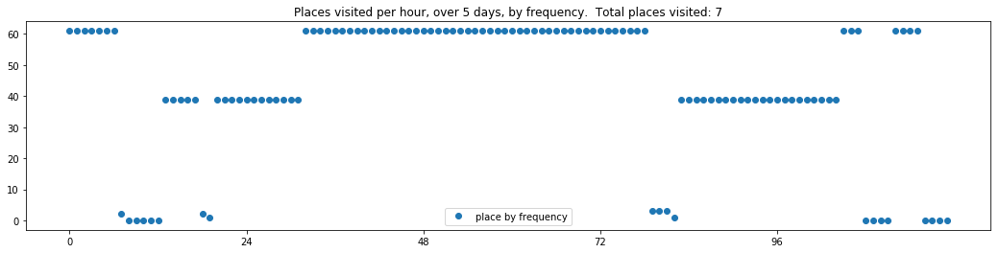

1
----- vector ----
prefix labels:  [7, 7]
[7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 7, 7]
[7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0]
[0, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7]
[7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 7, 9, 0, 7, 7, 0, 0]


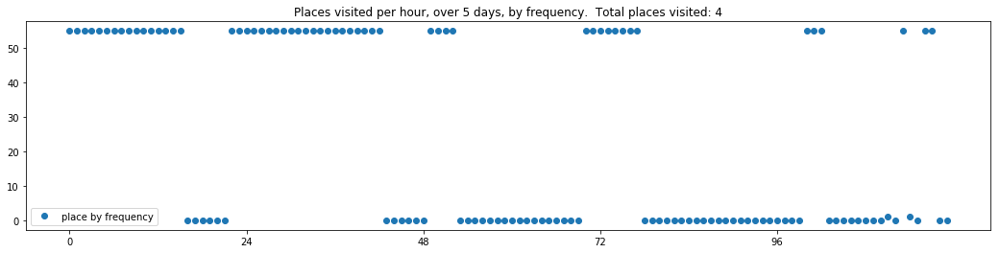

2
----- vector ----
prefix labels:  [10, 12]
[10, 11, 11, 11, 11, 11, 12, 12, 12, 13, 12, 12, 0, 12, 12, 11, 11, 11, 14, 14, 14, 14, 14, 14]
[14, 14, 14, 14, 11, 11, 0, 12, 12, 12, 12, 12, 12, 12, 12, 0, 10, 10, 10, 15, 10, 10, 10, 11]
[11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 13, 12, 12, 11, 11, 11, 11, 0, 16, 17, 17, 17, 17]
[17, 17, 17, 0, 0, 12, 12, 12, 12, 12, 12, 12, 12, 11, 11, 11, 11, 11, 0, 10, 10, 10, 10, 10]
[10, 10, 10, 10, 11, 11, 12, 12, 13, 12, 13, 18, 12, 12, 12, 12, 10, 10, 10, 10, 10, 10, 10, 10]


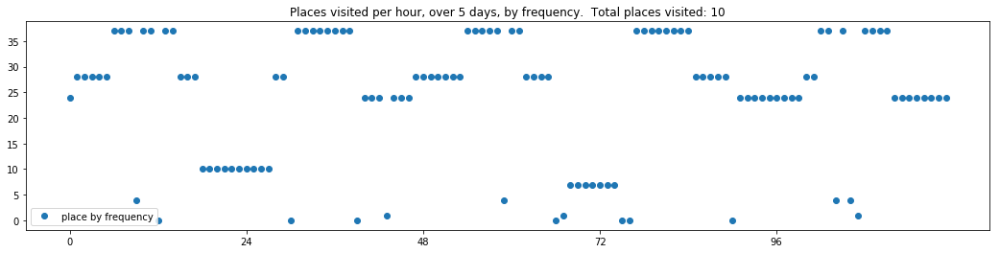

3
----- vector ----
prefix labels:  [19, 19]
[19, 19, 0, 0, 19, 19, 19, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
[19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 20, 20, 0]
[0, 0, 0, 0, 0, 0, 0, 19, 21, 21, 21, 21, 21, 21, 21, 0, 0, 19, 19, 19, 19, 19, 19, 22]


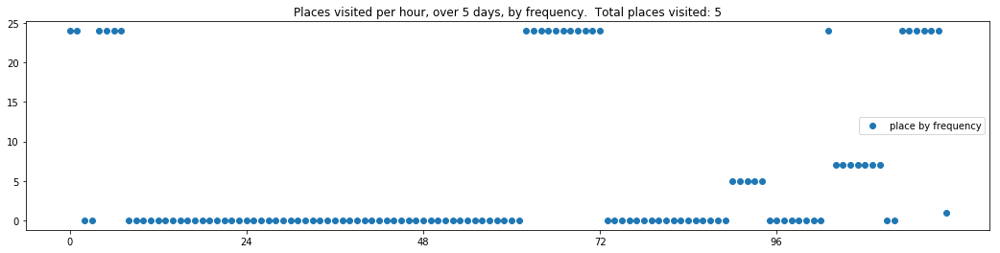

4
----- vector ----
prefix labels:  [23, 24]
[23, 23, 23, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 24, 24, 24, 24, 24, 0, 0, 23, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 23]
[23, 23, 23, 23, 23, 23, 23, 23, 0, 25, 0, 0, 0, 24, 0, 0, 0, 0, 0, 26, 0, 0, 0, 0]


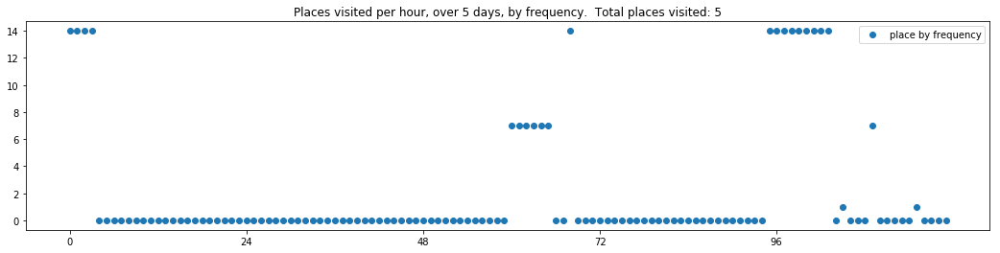

5
----- vector ----
prefix labels:  [27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 0, 0, 0, 0, 0, 0, 0, 20, 20, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 21, 0, 0, 0, 0, 0, 0, 20, 20, 20]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 21, 0, 0, 0, 0, 0, 0, 20, 20, 20]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 0, 0, 0, 0, 0, 0, 0, 0, 20, 28, 27]


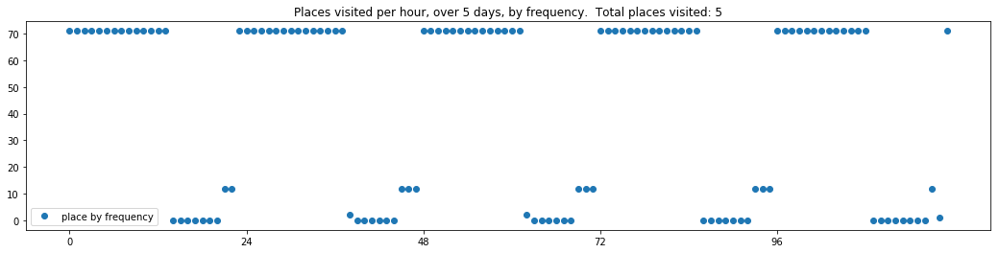

6
----- vector ----
prefix labels:  [29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 30, 31, 31, 32, 32, 29, 0, 0, 33, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 34, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 0, 35, 29, 29, 29, 29, 29, 29, 32, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 36, 36, 0, 29, 29, 29, 29, 29, 29, 29, 0, 0, 0, 29]


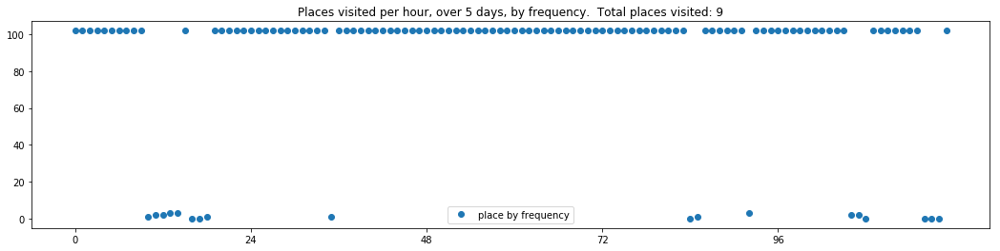

7
----- vector ----
prefix labels:  [37, 38]
[37, 37, 37, 37, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 37, 37]
[37, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 38, 38, 38, 0, 0, 0, 0, 0, 0, 39, 39, 39, 39]
[0, 0, 0, 0, 0, 0, 0, 37, 0, 0, 0, 0, 0, 0, 38, 38, 38, 38, 38, 38, 38, 37, 37, 37]
[37, 37, 37, 37, 37, 37, 37, 37, 37, 0, 38, 38, 38, 38, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39]
[37, 37, 37, 37, 37, 37, 37, 37, 37, 37, 0, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39]


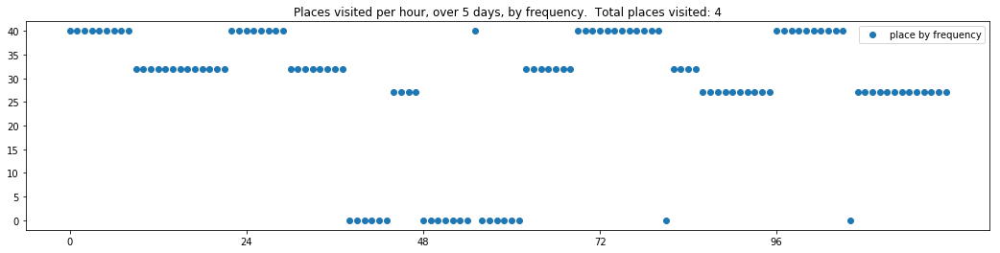

8
----- vector ----
prefix labels:  [41, 41]
[40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 20, 20, 20, 20, 20, 20, 40, 40, 40, 40, 40]
[40, 40, 40, 40, 40, 40, 0, 20, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 40, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 41, 40, 40, 40, 40, 40, 0, 0, 40, 40, 41, 41, 0, 42, 41, 41, 41, 41]


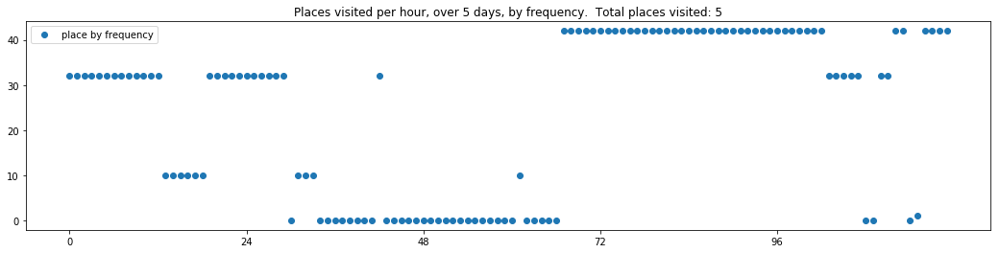

9
----- vector ----
prefix labels:  [43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 44, 0, 0, 43, 43, 43, 43, 0, 0, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 0, 0]


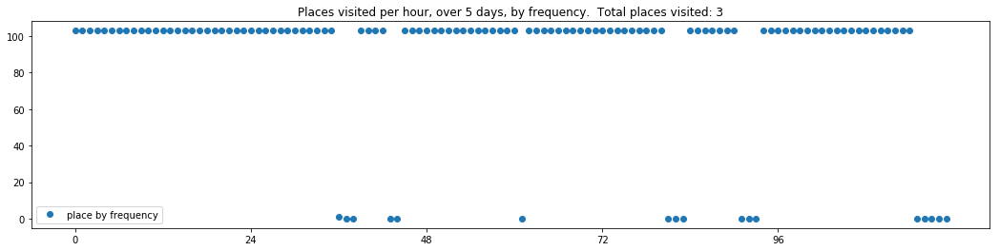

10
----- vector ----
prefix labels:  [45, 45]
[45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 0, 0, 0, 0]
[0, 45, 45, 45, 45, 45, 45, 0, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0, 47, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 48, 0, 0, 45, 45, 45, 0, 0, 0, 45, 0, 0]


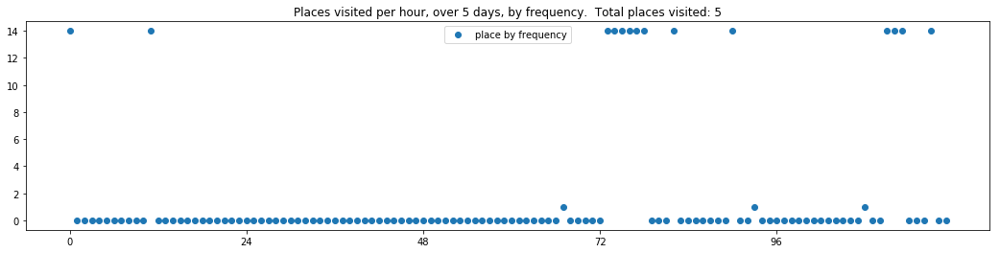

11
----- vector ----
prefix labels:  [49, 49]
[20, 0, 20, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 20, 50, 50, 51, 0, 20, 0, 0, 0]
[20, 0, 0, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 20, 20, 0, 52, 0, 22, 20, 53, 20]
[20, 0, 49, 49, 0, 0, 0, 0, 0, 0, 49, 49, 49, 20, 0, 54, 0, 0, 49, 20, 0, 0, 0, 55]
[20, 0, 0, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 56, 0, 57, 22, 20, 0, 0]
[0, 20, 20, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 58, 59, 59, 0, 58, 58, 49, 49, 20, 0, 20]


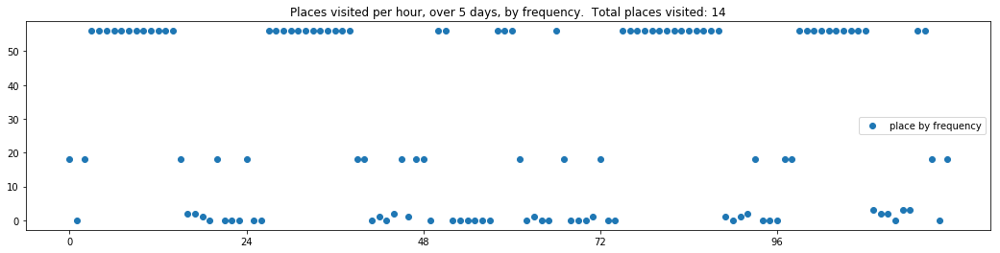

12
----- vector ----
prefix labels:  [60, 0]
[60, 60, 0, 0, 60, 60, 0, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 62, 62, 62, 62, 62, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 60, 60]
[60, 60, 60, 60, 60, 60, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 60]
[60, 60, 60, 60, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 60]


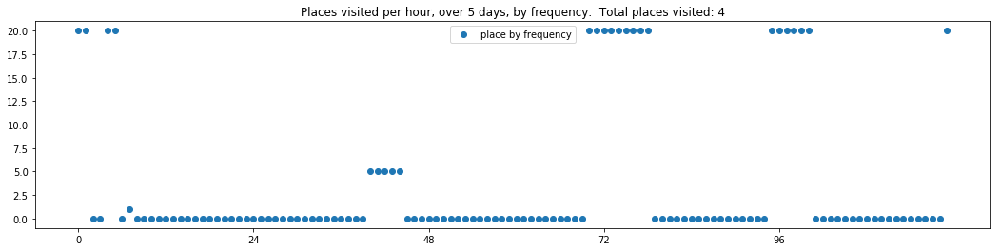

13
----- vector ----
prefix labels:  [64, 65]
[63, 63, 0, 0, 0, 64, 64, 64, 65, 65, 65, 65, 65, 65, 65, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 66, 65, 65, 65, 65, 65, 65, 31, 31, 67, 31, 31, 64, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 0, 65, 65, 65, 65, 65, 66, 64, 64, 64, 64, 68, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 65, 65, 65, 65, 65, 65, 64, 64, 64, 64, 69, 31, 31, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 65, 65, 65, 65, 31, 31, 31, 0, 0, 66, 66, 64, 64, 64, 64, 64]


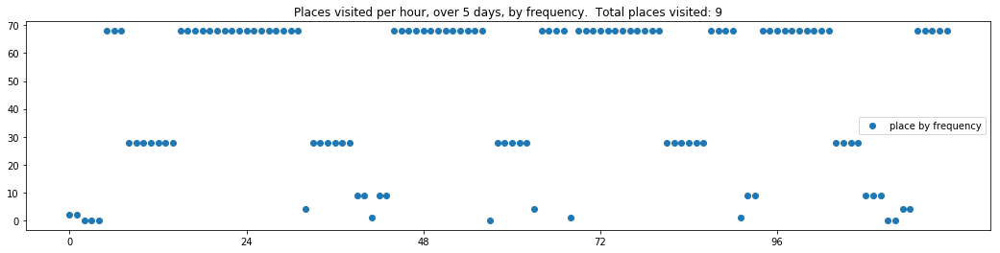

14
----- vector ----
prefix labels:  [70, 71]
[70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 71, 71, 71, 71, 71, 71, 70, 70, 70, 70, 70, 70, 70, 70]
[0, 70, 70, 70, 70, 70, 70, 71, 71, 71, 0, 0, 0, 0, 70, 70, 70, 70, 70, 70, 70, 70, 70, 21]
[70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 71, 71, 71, 71, 71, 72, 70, 70, 70, 70, 70, 70, 70, 70]
[70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 71, 71, 71, 71, 71, 0, 70, 70, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 70, 70, 70, 0, 0, 0, 0, 0, 0, 0]


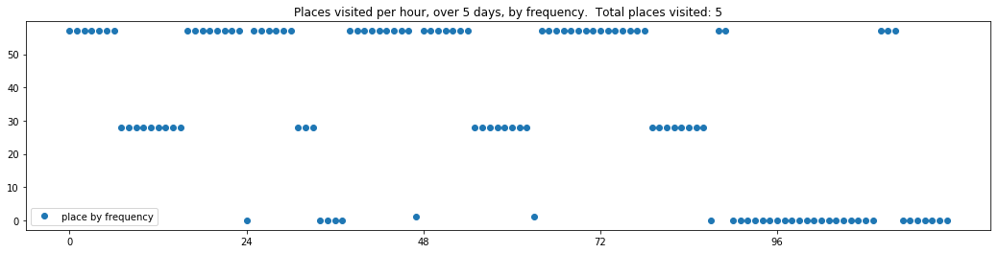

15
----- vector ----
prefix labels:  [15, 73]
[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 73, 73, 73, 73, 73, 73, 73, 15, 15, 15, 15, 15, 15, 15]
[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 0, 15, 73, 73, 73, 73, 73, 73, 73, 73, 73]
[15, 15, 15, 15, 15, 15, 15, 15, 15, 73, 73, 73, 73, 73, 73, 73, 73, 73, 15, 0, 15, 15, 52, 52]
[52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 74, 74, 8, 8, 21, 21, 21, 21, 52, 52, 52, 15]
[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 0, 0, 0, 0, 0, 0, 0, 0]


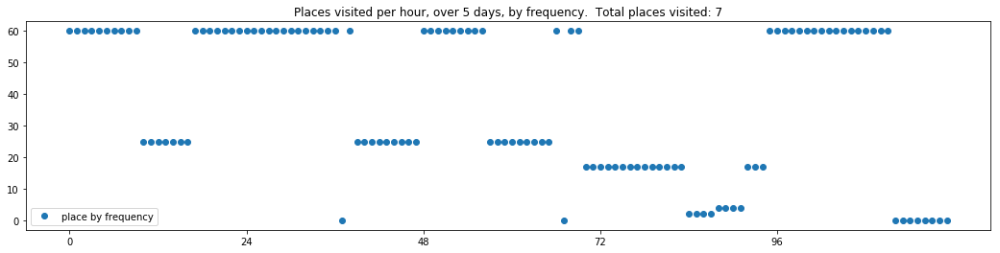

16
----- vector ----
prefix labels:  [75, 75]
[75, 75, 75, 75, 75, 75, 75, 76, 76, 76, 76, 0, 0, 77, 77, 77, 77, 77, 75, 75, 75, 75, 75, 75]
[75, 75, 75, 75, 75, 75, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 75, 75, 75, 75, 75, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 75, 75]
[75, 75, 75, 75, 75, 75, 75, 75, 75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75]


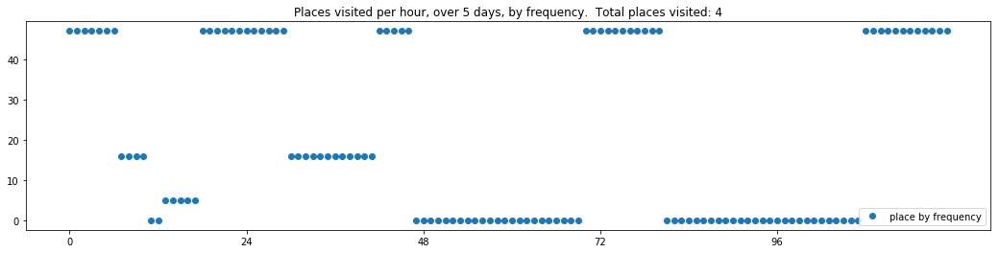

17
----- vector ----
prefix labels:  [78, 31]
[78, 78, 78, 78, 31, 79, 79, 80, 81, 31, 31, 13, 13, 34, 82, 83, 3, 31, 31, 78, 78, 20, 84, 78]
[78, 78, 78, 78, 31, 31, 31, 80, 82, 31, 31, 31, 31, 31, 35, 83, 0, 0, 0, 0, 78, 20, 84, 78]
[78, 78, 0, 78, 31, 31, 83, 83, 82, 31, 31, 31, 31, 31, 31, 85, 31, 31, 78, 78, 20, 20, 84, 78]
[78, 78, 78, 0, 0, 0, 80, 80, 82, 31, 31, 31, 31, 31, 82, 80, 35, 86, 78, 78, 20, 20, 84, 78]
[78, 78, 78, 78, 31, 31, 31, 80, 82, 31, 31, 31, 31, 31, 81, 80, 3, 85, 85, 78, 20, 53, 78, 78]


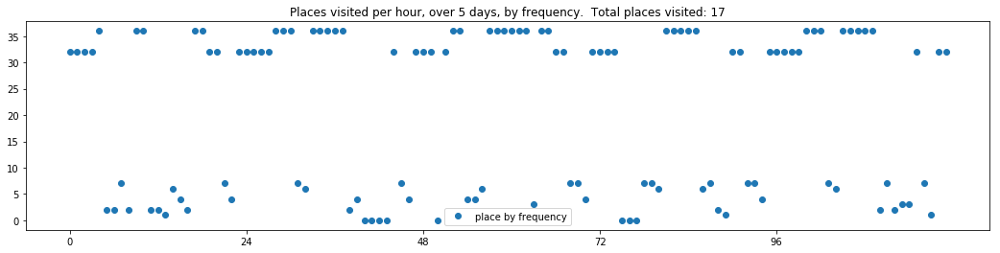

18
----- vector ----
prefix labels:  [87, 87]
[87, 87, 87, 87, 87, 87, 87, 87, 88, 89, 89, 89, 89, 89, 89, 89, 0, 89, 89, 0, 90, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 89, 0, 0, 0, 89, 89, 89, 89, 0, 0, 0, 87, 87, 87]
[87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 91, 87, 87, 87, 87, 87]
[87, 87, 87, 87, 87, 87, 87, 87, 89, 89, 89, 87, 87, 87, 87, 87, 87, 87, 87, 0, 0, 0, 87, 87]
[87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 87, 92, 0, 87, 87, 87, 0, 0, 0, 0, 0, 0]


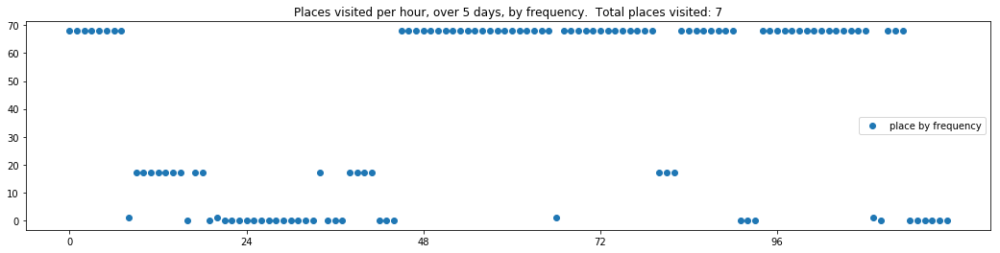

19
----- vector ----
prefix labels:  [93, 94]
[93, 93, 93, 93, 93, 93, 93, 93, 0, 0, 0, 0, 0, 0, 0, 94, 0, 93, 93, 93, 93, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 93, 93, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 0, 0, 95, 0, 0, 0, 0, 0, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 0, 0, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 93, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4]


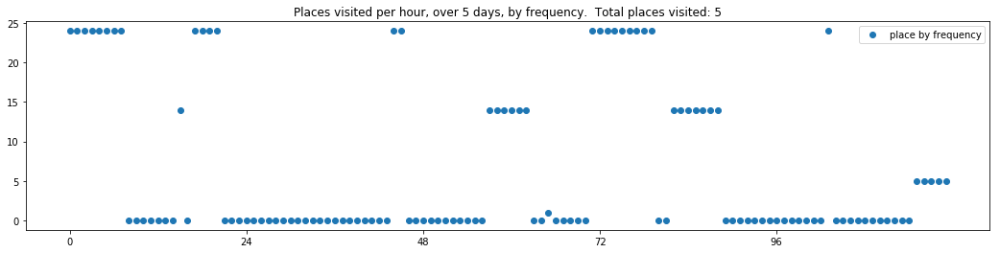

In [6]:
for t, tv in enumerate(real_trajectories[:20]):
    print(t)
    print_dwell_vector_by_days(tv)
    plot_trajectory_vector_frequencies(tv, by_frequency_order=False)

Evaluate the SeqGAN output

In [7]:
import re

def get_eval_files():
    filenames = {}
    # There are a bunch of evaluation files saved in the following directory
    seqgan_eval_files_dir = '/Users/aberke/projects/gan-hacking/SeqGAN/save/'
    for filename in os.listdir(seqgan_eval_files_dir):
        eval_num = re.findall(r'\d+', filename)
        if not (filename.startswith('eval_file_') and len(eval_num)):
            continue
        eval_num = int(eval_num[0])
        fullfilename = seqgan_eval_files_dir + filename
        filenames[eval_num] = fullfilename
    return filenames

eval_filenames = get_eval_files()


------
 0 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_0.txt 
------

----- vector ----
prefix labels:  [340, 340]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 477, 477, 477, 0, 0, 0]
[0, 0, 0, 581, 367, 174, 174, 174, 174, 174, 0, 0, 0, 0, 0, 0, 174, 174, 174, 174, 174, 174, 174, 174]
[174, 174, 174, 174, 0, 0, 621, 242, 242, 242, 242, 0, 22, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0]
[0, 0, 21, 21, 21, 21, 21, 13, 13, 21, 21, 629, 629, 629, 272, 272, 454, 397, 0, 0, 20, 20, 41, 41]
[41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 479, 444, 444, 41, 629, 0, 0, 629, 629, 629, 629, 629, 629, 629]


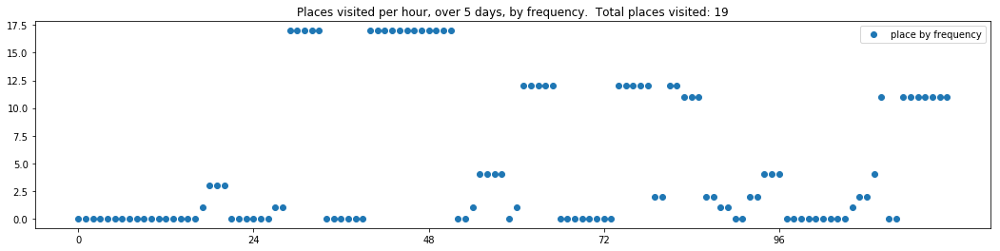

----- vector ----
prefix labels:  [581, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 398, 398, 0, 0, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 55, 53]
[39, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 482, 482, 0, 581, 581, 581, 581, 581]
[581, 581, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 163, 163, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


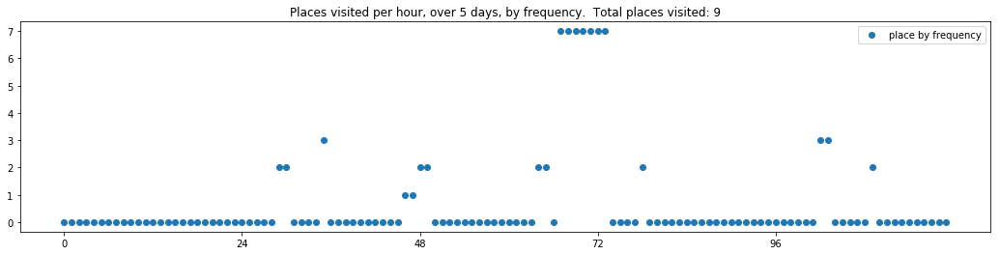

----- vector ----
prefix labels:  [568, 527]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 20, 20, 20, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


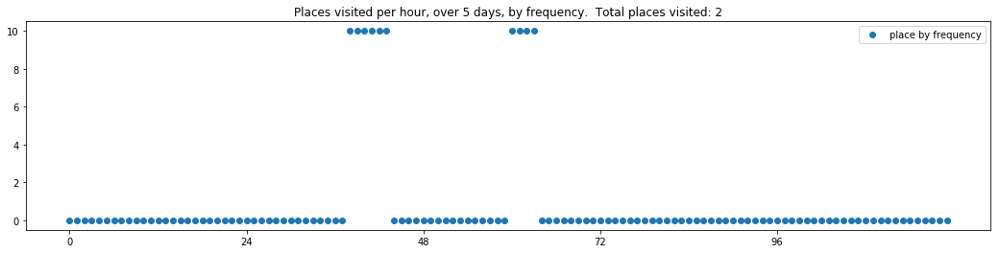

----- vector ----
prefix labels:  [411, 411]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 411, 411, 411, 411, 411, 411, 411, 411, 411, 411, 411, 411]
[411, 411, 411, 411, 411, 411, 411, 411, 411, 411, 411, 411, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 16]
[0, 0, 0, 0, 0, 0, 0, 271, 0, 0, 0, 0, 0, 0, 174, 411, 411, 411, 174, 193, 76, 76, 76, 76]


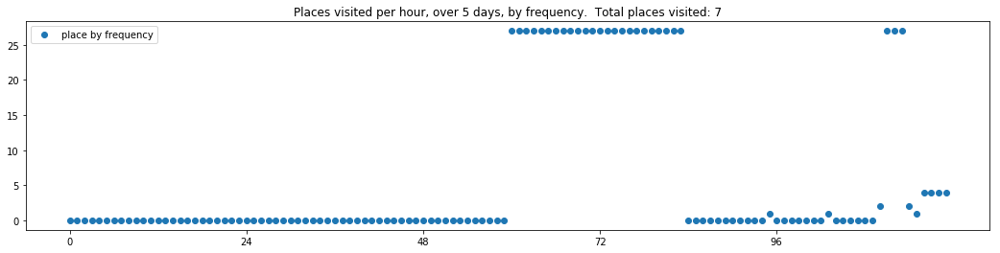

----- vector ----
prefix labels:  [165, 608]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 91, 0, 165, 165, 165, 165, 165, 165, 165, 165, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[493, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 0, 311]
[311, 311, 311, 311, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608, 608]


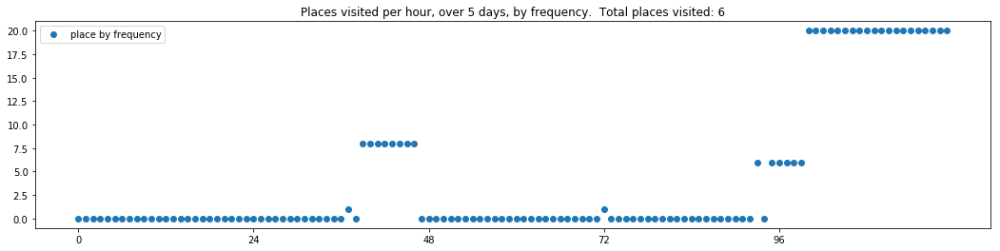

----- vector ----
prefix labels:  [417, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 55, 0, 0, 0, 0, 56, 178, 0, 0, 0, 0]
[374, 374, 0, 417, 417, 417, 417, 417, 417, 417, 417, 417, 21, 0, 451, 417, 417, 417, 417, 0, 0, 0, 0, 0]
[0, 0, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417]
[417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417]


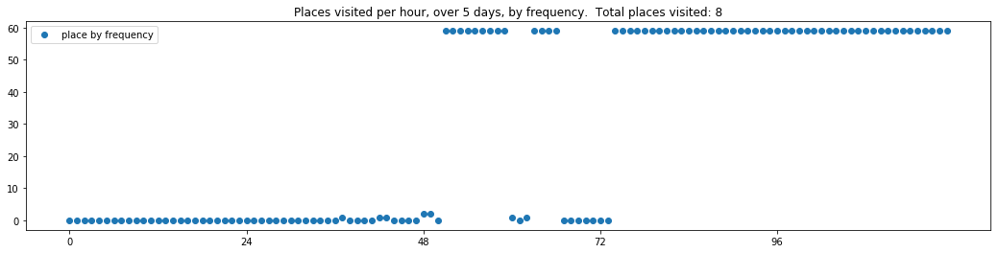

----- vector ----
prefix labels:  [76, 116]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 55, 55, 0]
[307, 473, 0, 0, 0, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 0]
[364, 373, 373, 373, 373, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 184, 184, 0, 0, 0, 0]


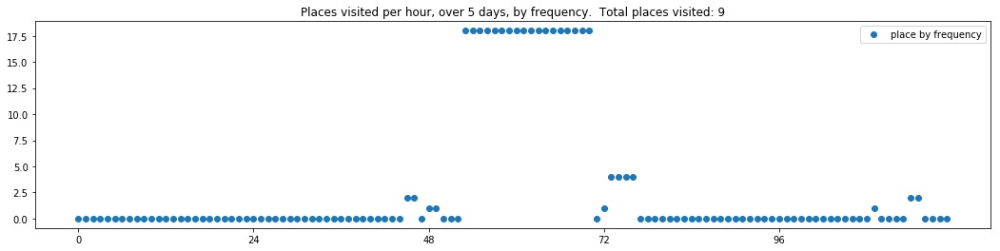

----- vector ----
prefix labels:  [433, 433]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433, 433, 433, 433, 433, 433, 433]
[433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 318, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


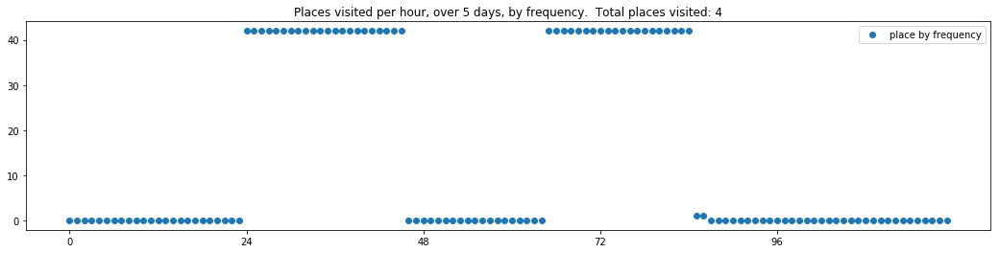

----- vector ----
prefix labels:  [108, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44]
[44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 44, 0, 44, 44, 44, 44, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 126, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 44]


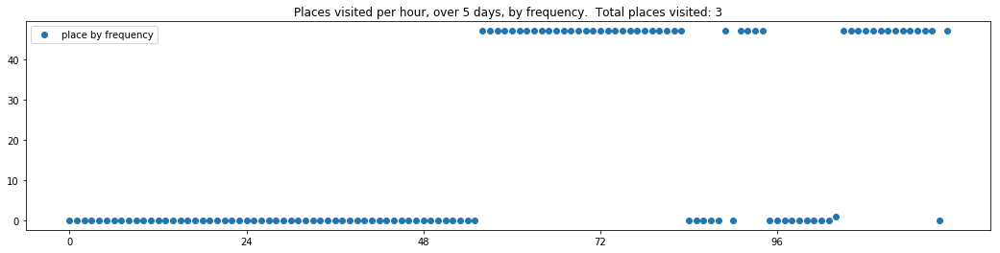

----- vector ----
prefix labels:  [85, 288]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[16, 181, 0, 0, 0, 0, 0, 87, 58, 58, 58, 58, 0, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36]
[36, 36, 36, 36, 36, 36, 36, 36, 393, 393, 51, 58, 58, 58, 58, 58, 58, 58, 58, 58, 58, 58, 58, 58]


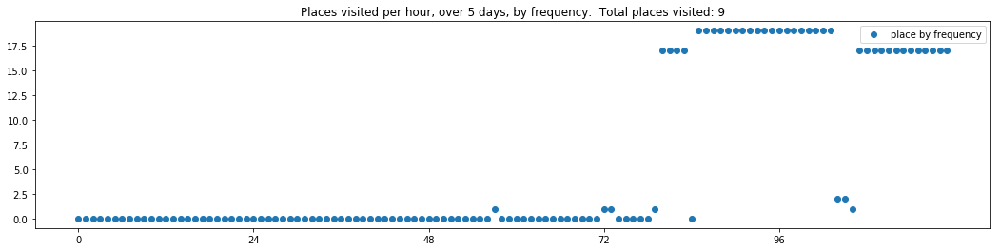

----- vector ----
prefix labels:  [303, 130]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130]
[130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 303, 303, 303, 303, 303, 303, 303, 0, 16, 0, 396]


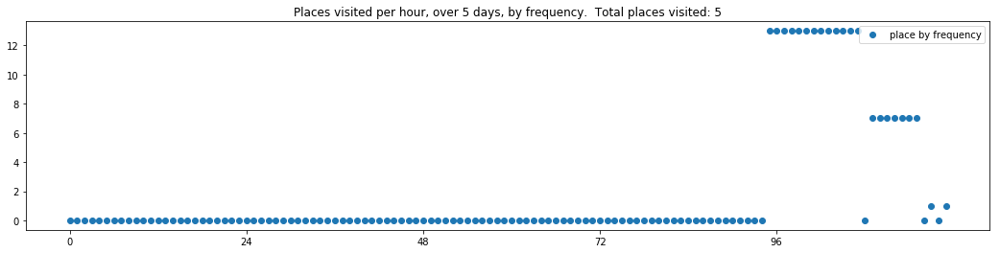

----- vector ----
prefix labels:  [86, 0]
[0, 0, 0, 0, 0, 394, 20, 20, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86]
[86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86]
[86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86]
[86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86]
[86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86, 86]


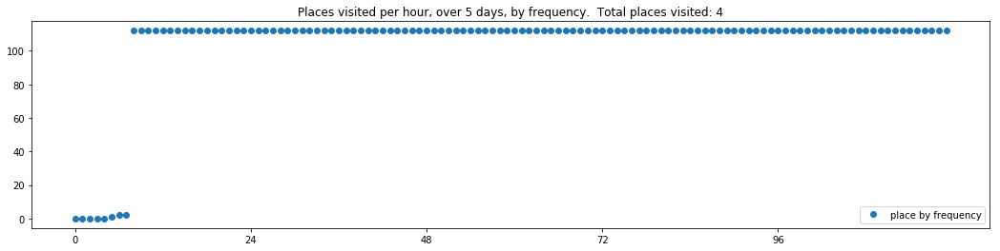

----- vector ----
prefix labels:  [40, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 527, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


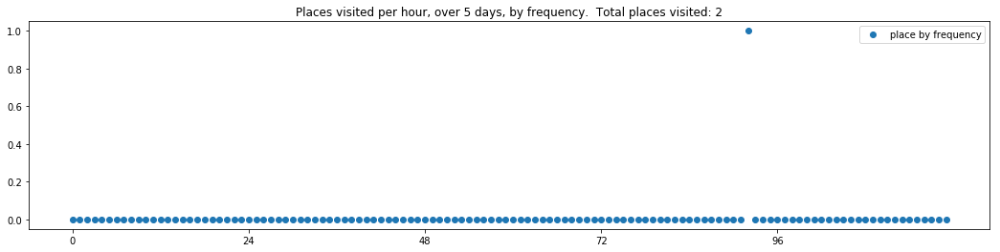

----- vector ----
prefix labels:  [604, 209]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209]
[209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


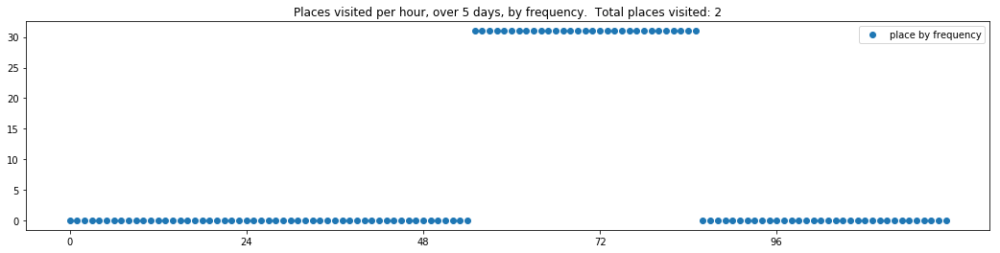

----- vector ----
prefix labels:  [375, 435]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[375, 375, 375, 375, 375, 375, 375, 375, 375, 375, 375, 119, 119, 119, 119, 119, 119, 261, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 375, 375, 375, 375, 564, 564, 498, 498, 0, 132, 132, 132, 132, 132, 0, 0, 0, 327, 327, 327]
[0, 0, 341, 178, 178, 178, 178, 41, 41, 468, 468, 41, 41, 41, 41, 41, 41, 0, 184, 184, 184, 0, 184, 368]
[368, 450, 450, 450, 365, 0, 450, 450, 450, 0, 0, 0, 244, 228, 228, 228, 228, 228, 228, 228, 228, 228, 204, 204]


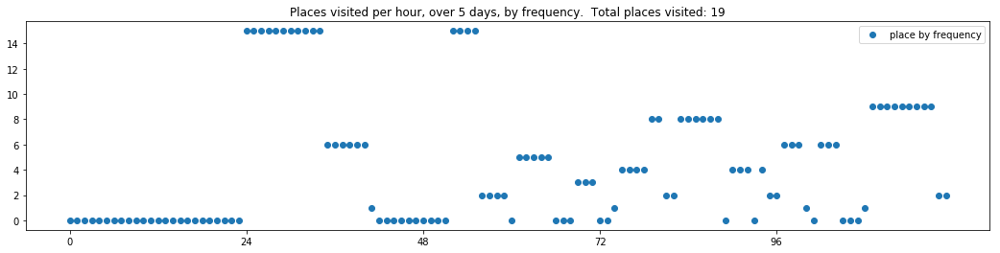

----- vector ----
prefix labels:  [396, 56]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 396, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 396, 0, 224, 403, 0, 0, 0, 0, 0, 0, 0, 0, 601, 601, 601, 601, 601, 601, 601, 601, 601, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 398, 398, 84, 0, 131, 380, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


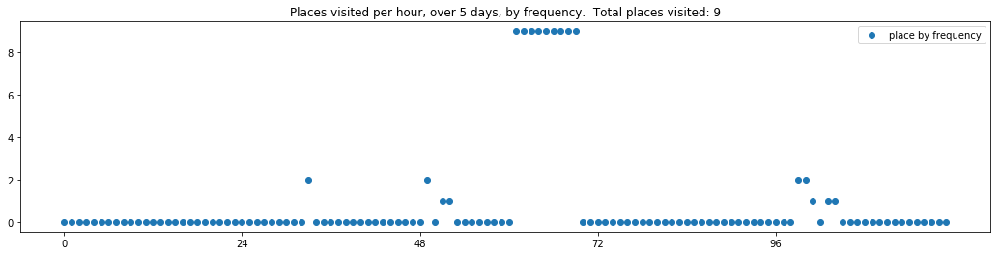

----- vector ----
prefix labels:  [419, 419]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 419, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 419, 419, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 419, 419, 419, 419, 288, 0, 0, 0, 0]


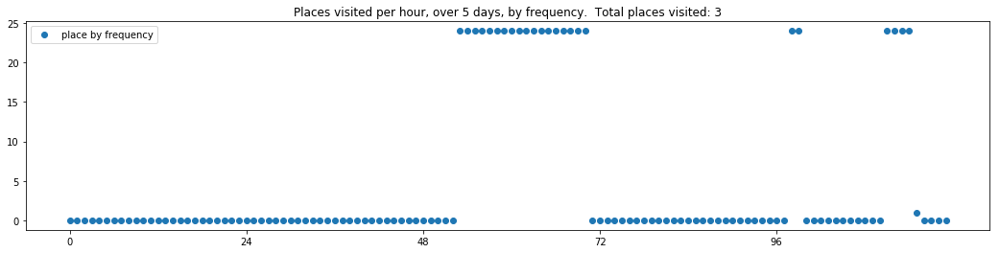

----- vector ----
prefix labels:  [116, 48]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0, 0, 295, 0, 0, 0, 0]
[24, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 44, 44, 44, 44, 44, 44, 48, 647, 647, 44, 0, 0, 0, 0, 48, 48, 48, 0, 0, 0, 0, 259, 249]


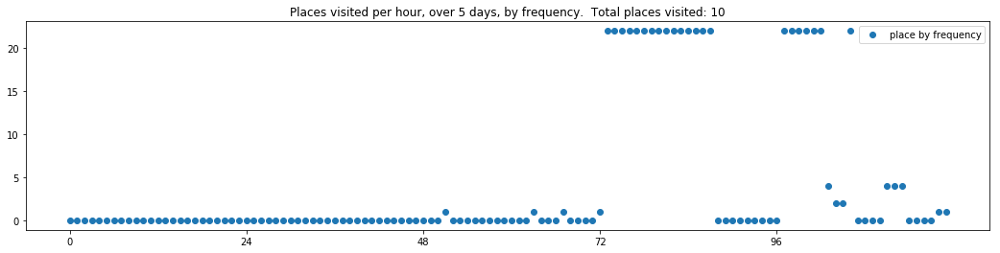

----- vector ----
prefix labels:  [142, 252]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 252, 252, 252, 252, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142]
[142, 142, 186, 280, 280, 280, 0, 252, 252, 252, 142, 142, 0, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252]
[252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0]


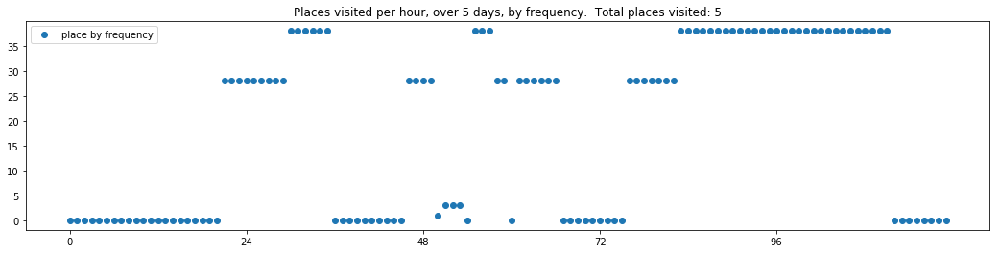

----- vector ----
prefix labels:  [285, 111]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 111, 112, 112, 111, 111, 111, 111, 111, 111]


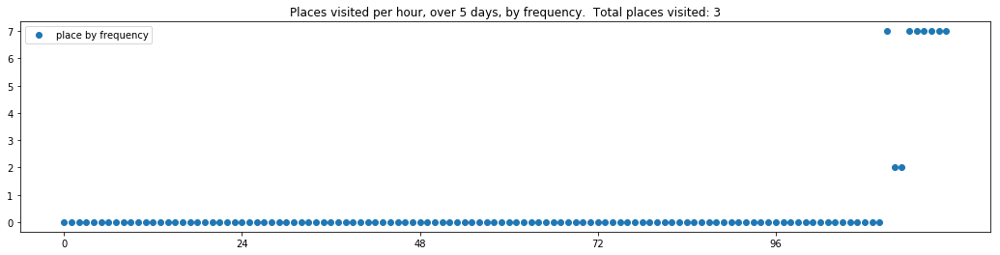

----- vector ----
prefix labels:  [177, 177]
[0, 0, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 149, 149, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 589, 589, 589, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 406, 177, 177, 177, 177, 0, 0, 55, 404, 623, 623, 623, 623, 41]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 0, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177]


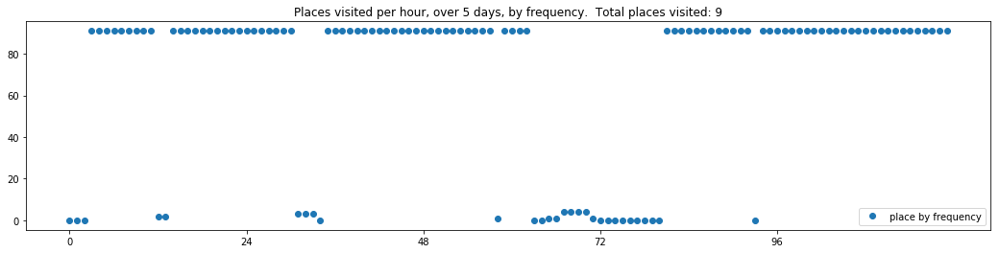

----- vector ----
prefix labels:  [456, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


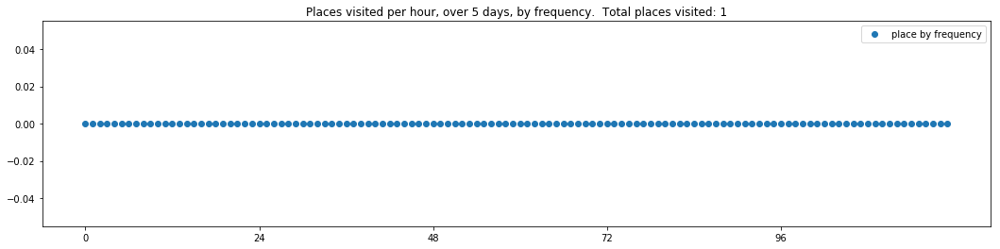

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434]


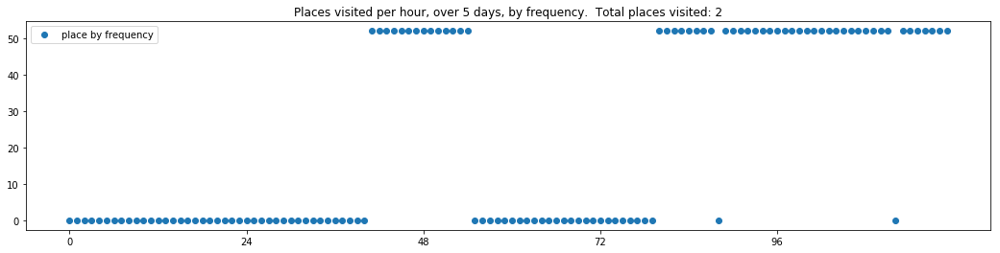

----- vector ----
prefix labels:  [226, 226]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


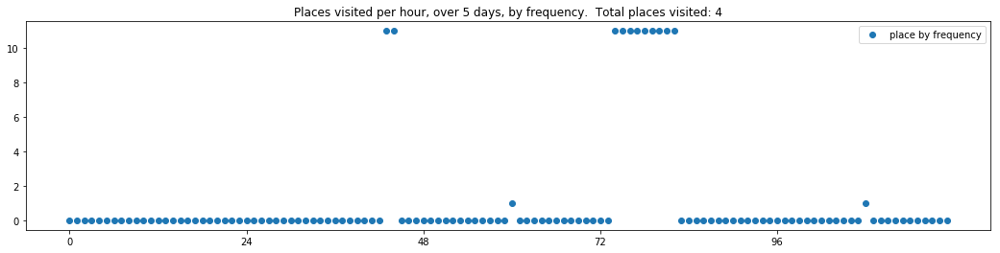

----- vector ----
prefix labels:  [340, 490]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 86, 86, 86, 86, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 114, 240, 240, 240, 240, 240, 240, 240, 240, 240, 240, 240, 240, 240, 478, 86, 172, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 340, 340, 340, 340, 340, 340, 340]


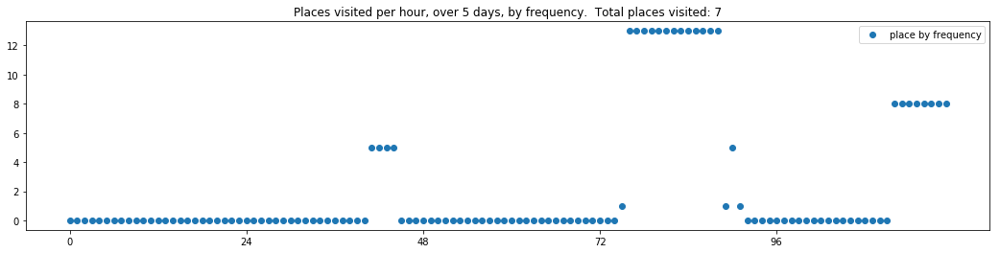

----- vector ----
prefix labels:  [341, 515]
[620, 620, 341, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515]
[515, 515, 515, 515, 515, 515, 515, 515, 515, 194, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515]
[515, 515, 515, 515, 515, 515, 515, 515, 515, 341, 341, 341, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 620, 620, 620, 620, 0, 0, 0, 0, 0, 0, 0, 194, 515, 515, 515, 515, 515, 515, 515, 515, 515]
[515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 0, 0, 0, 0, 0, 0, 0, 0, 0]


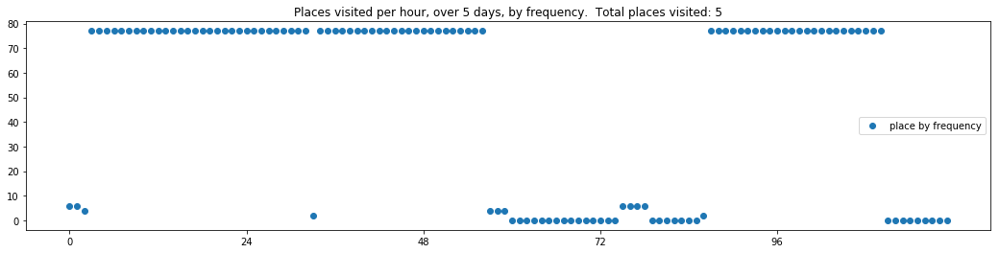

----- vector ----
prefix labels:  [104, 390]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


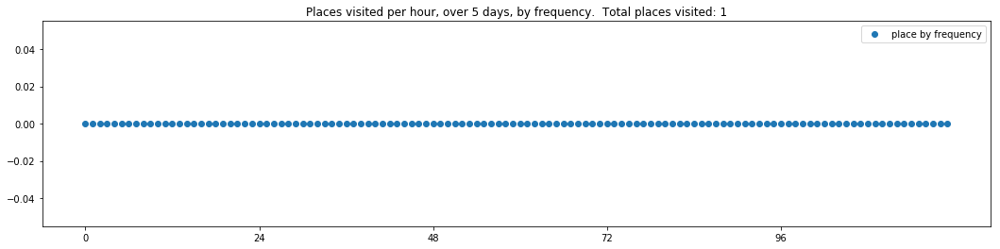

----- vector ----
prefix labels:  [39, 39]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 39, 39, 39, 39, 39, 39, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 39, 39, 39, 434, 434, 434, 378, 378]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


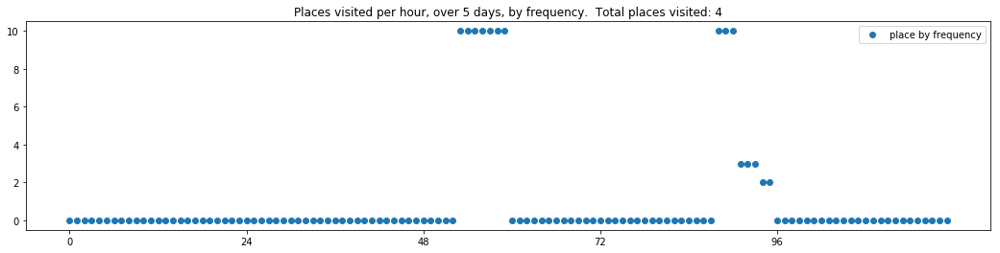

----- vector ----
prefix labels:  [526, 526]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 526, 526, 526, 526, 0, 0, 0, 0, 0, 0, 0, 526, 526, 0, 526, 526, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 526, 526, 526, 526, 526, 526, 288, 8, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 382, 382, 382, 0, 0]


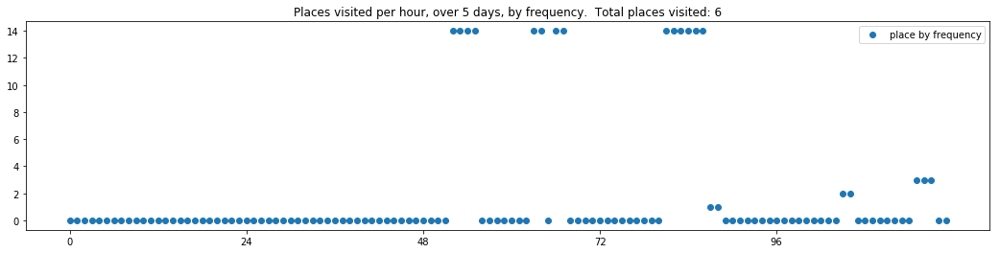

----- vector ----
prefix labels:  [208, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208]
[208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208]
[208, 208, 208, 208, 208, 208, 208, 208, 208, 240, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208]
[208, 208, 208, 208, 0, 0, 0, 0, 0, 0, 0, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208]


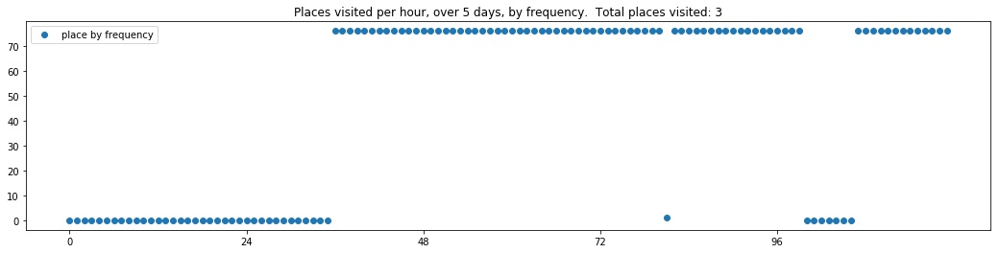

----- vector ----
prefix labels:  [516, 516]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 516, 516, 516]
[516, 516, 516, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 516, 516, 516, 20, 406, 406, 0, 0, 78, 151, 516, 516, 516, 516, 516, 516, 516]
[516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516]
[516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 516, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


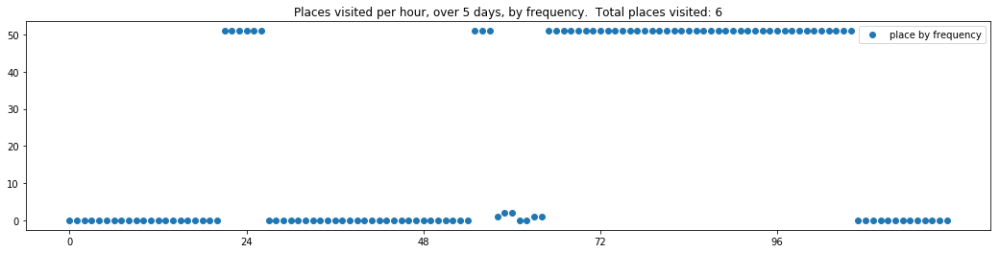

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 434, 434, 434]
[434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 142, 142, 142, 434, 434, 434, 434, 434, 434, 434, 0]


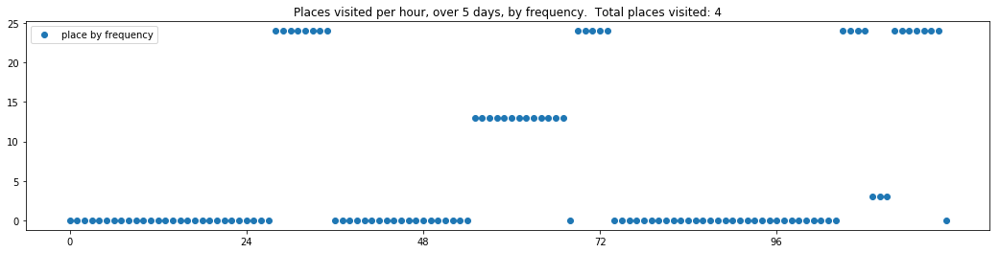

----- vector ----
prefix labels:  [204, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 204, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 0, 0, 0, 0]


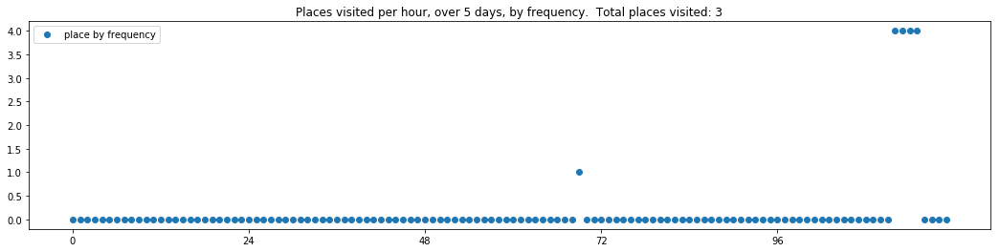

----- vector ----
prefix labels:  [266, 266]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 266, 266, 263, 263]
[263, 263, 0, 263, 263, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266, 266]
[266, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 266, 266, 266, 266, 266, 266, 266]
[266, 266, 266, 266, 266, 162, 0, 271, 271, 266, 266, 266, 266, 266, 266, 266, 266, 266, 0, 0, 0, 84, 266, 266]


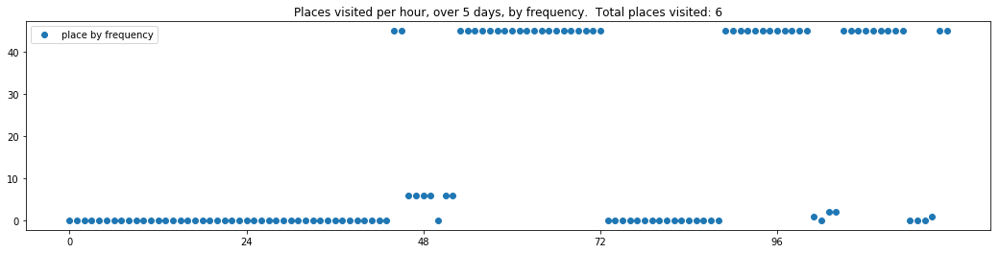

----- vector ----
prefix labels:  [44, 0]
[0, 0, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44]
[44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44]


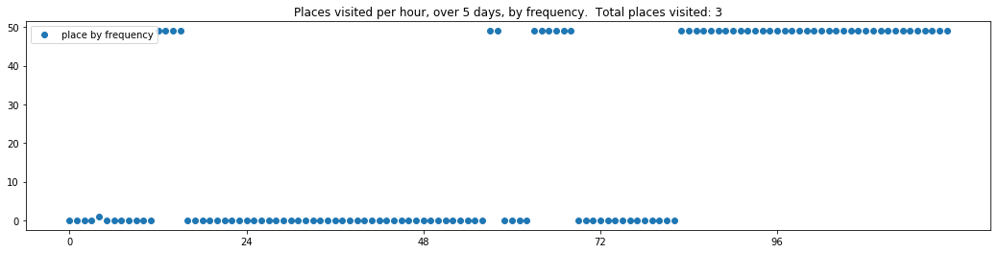

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94]
[94, 94, 94, 94, 94, 94, 94, 94, 94, 147, 147, 147, 147, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[644, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


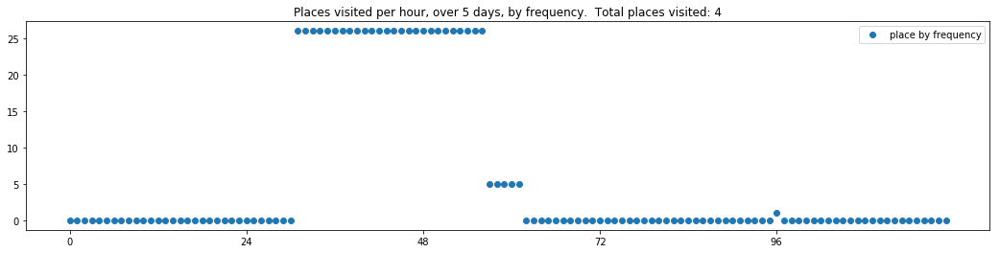

----- vector ----
prefix labels:  [582, 582]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 109, 109, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0, 0, 582]
[582, 582, 0, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 0, 0, 0, 0, 0, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 0, 0, 0]


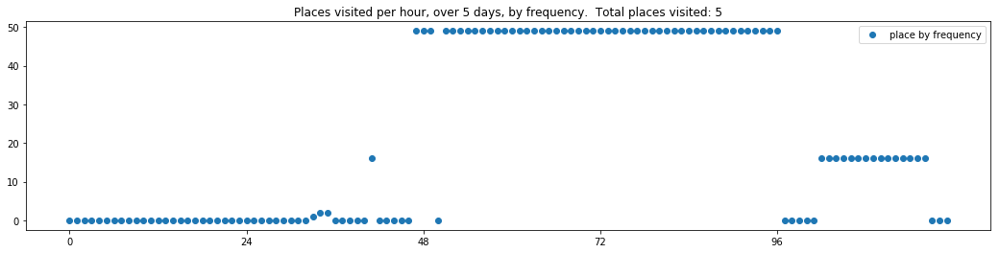

----- vector ----
prefix labels:  [593, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


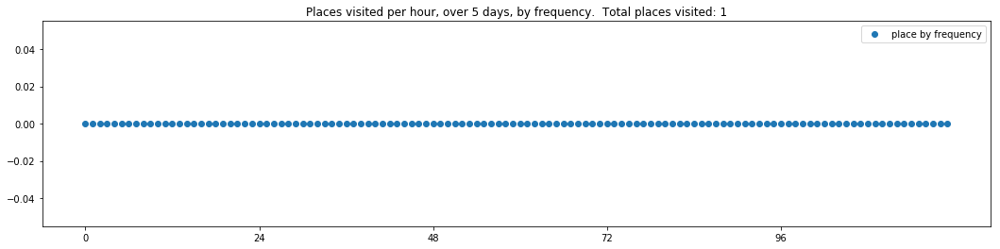

----- vector ----
prefix labels:  [435, 27]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 133, 133, 133, 133]
[133, 133, 133, 133, 40, 133, 133, 133, 133, 133, 133, 133, 176, 20, 469, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 227, 227, 227, 227, 227, 227, 351, 351]
[351, 351, 351, 351, 351, 351, 351, 0, 0, 0, 0, 0, 0, 0, 112, 183, 183, 183, 183, 0, 0, 0, 0, 207]


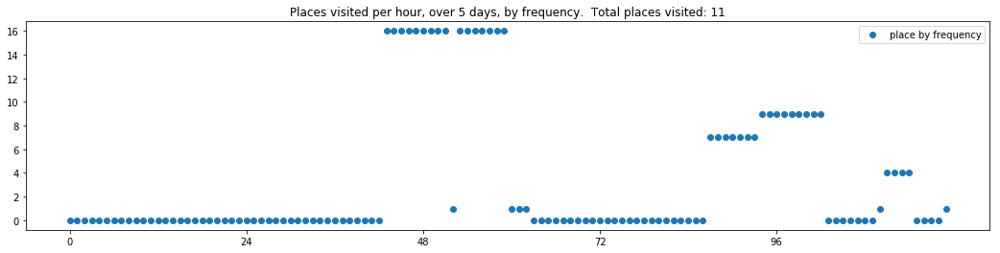

----- vector ----
prefix labels:  [107, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 637, 637, 637, 430, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 147, 147, 147, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579]
[579, 579, 579, 579, 579, 579, 579, 579, 579, 0, 0, 0, 0, 0, 0, 0, 107, 0, 539, 539, 107, 107, 107, 107]


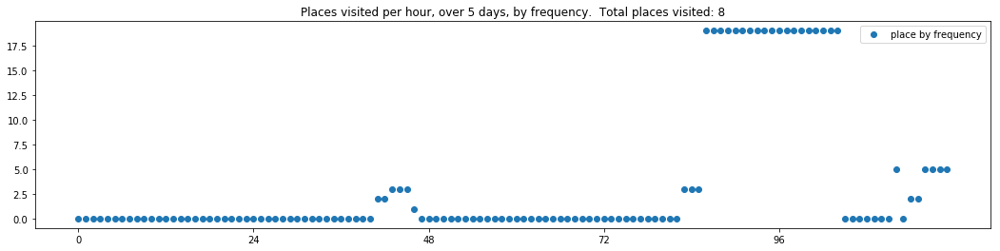

----- vector ----
prefix labels:  [245, 245]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 245, 245]
[245, 245, 245, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 208, 0, 0, 93, 0, 0, 0, 0, 0, 0, 0]


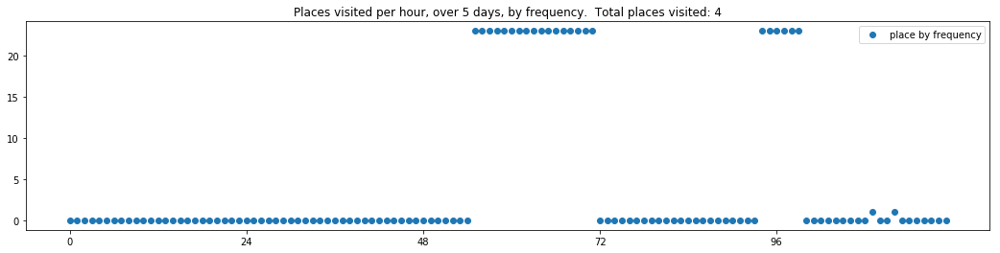

----- vector ----
prefix labels:  [8, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 8, 8, 8, 8, 8, 8, 8, 8, 21, 8, 8, 8]
[8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 21, 8, 8, 8, 8, 8, 8, 8]
[8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8]
[8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 56, 56]


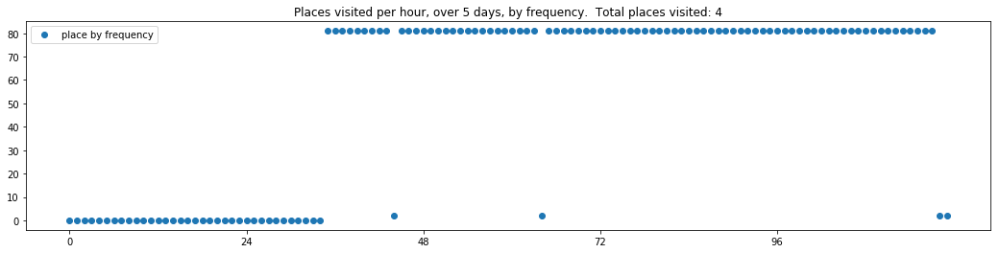

----- vector ----
prefix labels:  [108, 108]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108, 108]
[108, 108, 108, 108, 108, 108, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 463, 463, 0, 0, 0]


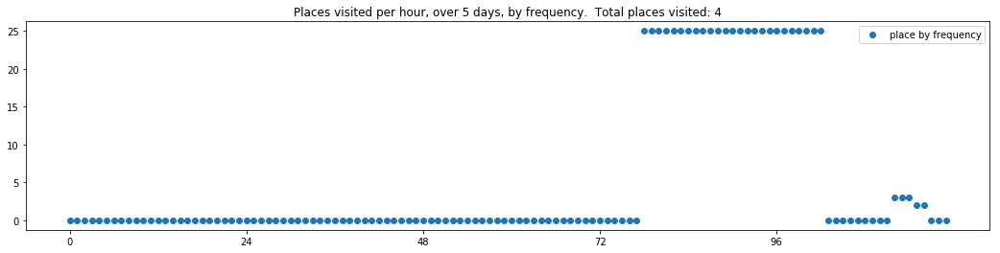

----- vector ----
prefix labels:  [5, 5]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]
[5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 0, 5, 5, 5]
[5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]


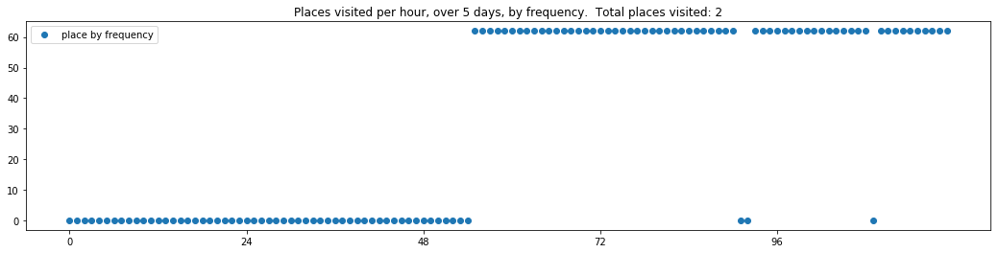

----- vector ----
prefix labels:  [507, 507]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 507, 507, 507, 507, 507, 507]
[507, 507, 0, 0, 507, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 248, 248, 0]


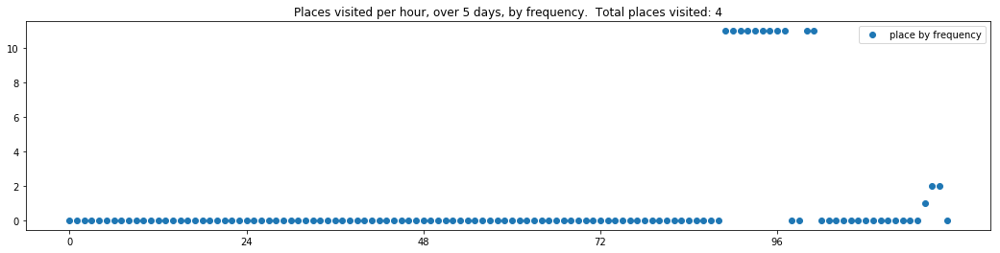

----- vector ----
prefix labels:  [332, 332]
[0, 0, 0, 0, 0, 0, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 332, 580, 97, 97, 94, 94, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 332, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


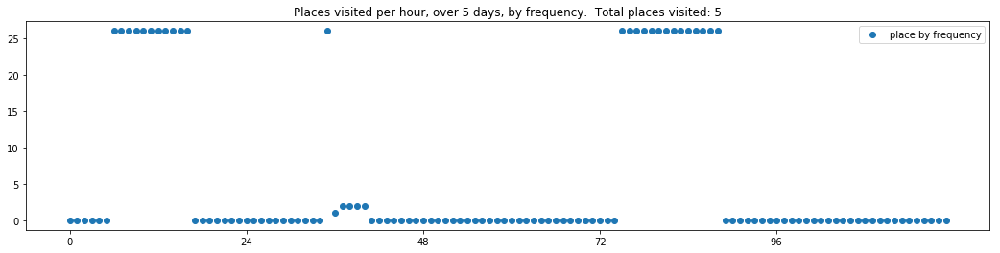

----- vector ----
prefix labels:  [285, 285]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 285, 285, 285, 285]
[285, 285, 285, 285, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 9, 0, 0]


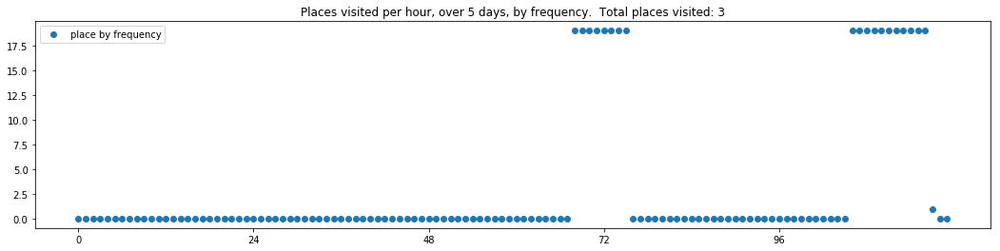

----- vector ----
prefix labels:  [555, 555]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 555, 555, 555, 555, 555, 555, 555, 555]
[555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555]
[555, 555, 555, 555, 555, 512, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555]
[555, 555, 512, 29, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555]


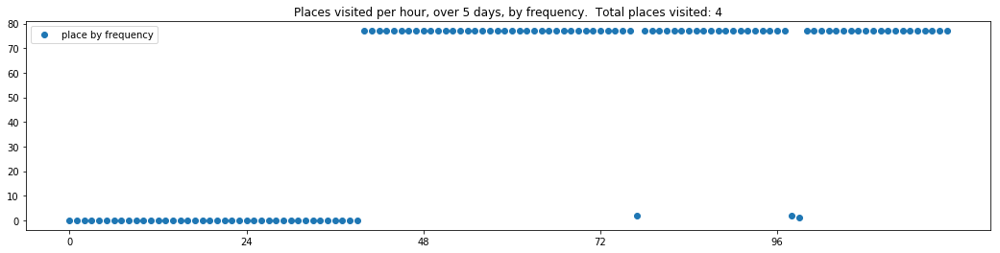

----- vector ----
prefix labels:  [356, 372]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 372, 372, 372, 372, 372, 372, 372, 372, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[38, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]


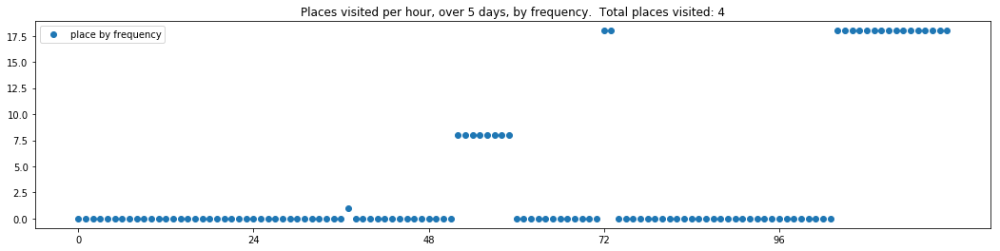

----- vector ----
prefix labels:  [396, 504]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 93, 93, 93, 93, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 396, 396]
[396, 385, 396, 396, 396, 396, 396, 396, 396, 0, 0, 0, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 385, 450, 450, 450, 236, 396, 0]
[0, 0, 0, 0, 0, 0, 396, 396, 396, 0, 276, 276, 0, 0, 0, 0, 0, 92, 92, 385, 385, 385, 385, 385]


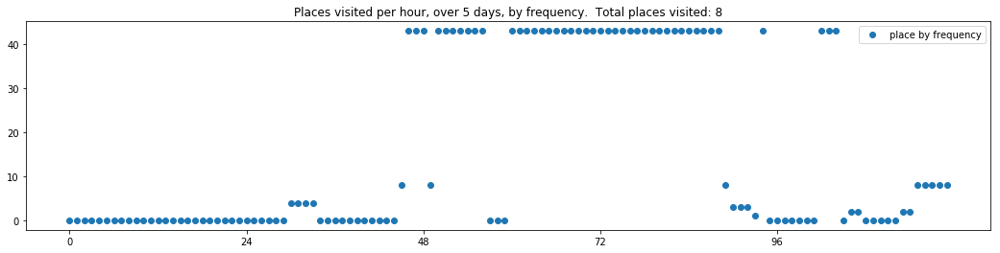


------
 5 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_5.txt 
------

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437]
[437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


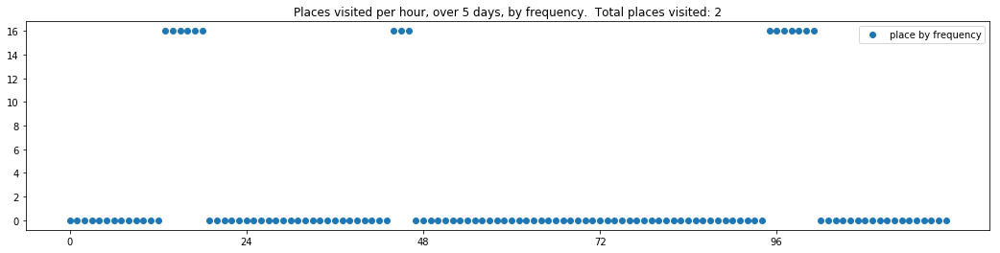

----- vector ----
prefix labels:  [511, 511]
[0, 0, 0, 0, 0, 0, 0, 0, 356, 356, 356, 356, 356, 356, 356, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 32, 0, 0, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84]
[84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511]
[511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 0]
[0, 0, 0, 225, 225, 225, 0, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511, 511]


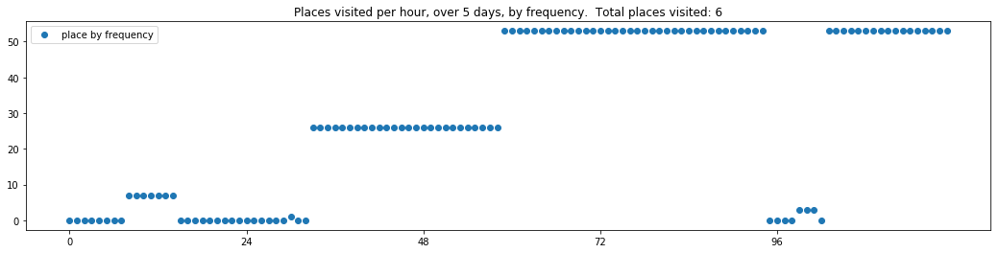

----- vector ----
prefix labels:  [195, 195]
[0, 0, 0, 0, 0, 195, 195, 195, 0, 0, 0, 195, 195, 195, 195, 195, 195, 195, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 195, 195, 195, 195, 195, 195, 0, 0, 0, 0, 0, 0, 0, 0, 195, 195, 195, 195, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 195, 0, 195, 20, 0, 0]


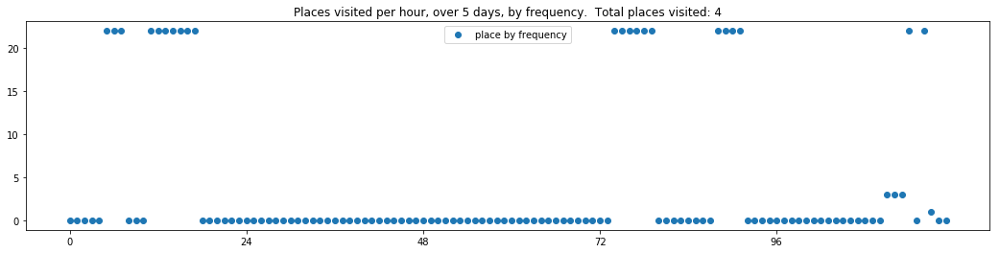

----- vector ----
prefix labels:  [388, 419]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 419, 419, 419, 419, 419, 419, 419, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0]


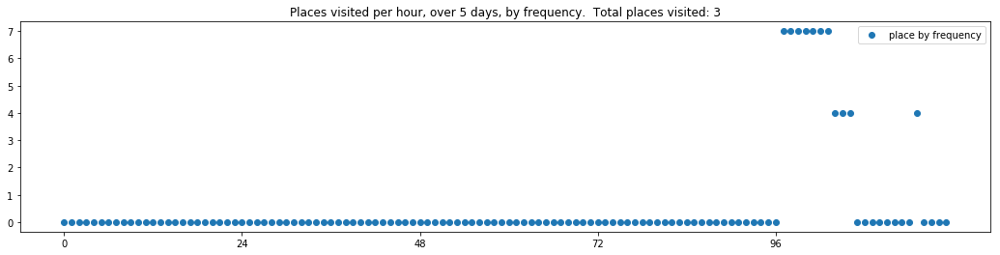

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 185, 74, 0, 0, 561, 561]
[561, 561, 0, 0, 0, 0, 0, 0, 0, 0, 0, 548, 508, 0, 295, 295, 147, 20, 10, 261, 261, 20, 20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 360, 360, 360, 360, 0, 507, 5, 5, 5, 5, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 435, 435, 0, 0, 0, 0, 0, 0, 638, 0]
[0, 0, 0, 485, 0, 0, 0, 261, 261, 261, 261, 261, 261, 261, 261, 146, 146, 0, 2, 2, 2, 2, 2, 2]


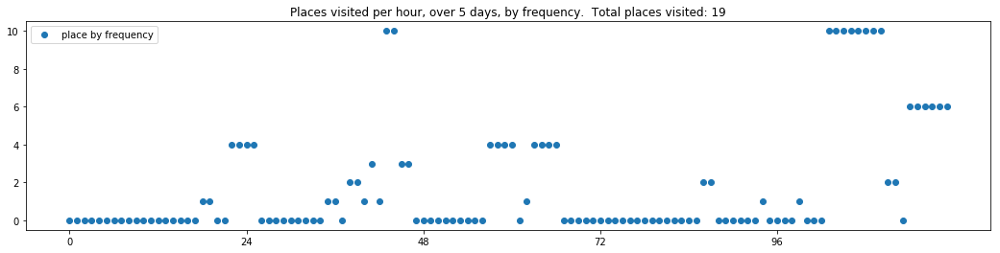

----- vector ----
prefix labels:  [154, 154]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 154, 154, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 112, 112, 154, 154, 154, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 112, 112, 112, 112, 112, 593, 593, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 419, 419, 69, 154, 154, 112, 112, 112, 112, 0, 0, 0, 0, 112, 112, 154, 154, 154, 154, 154, 154]
[154, 154, 154, 154, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 112, 154, 154, 154]


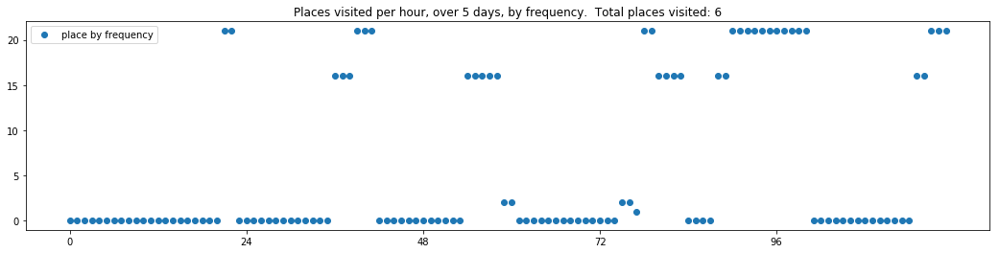

----- vector ----
prefix labels:  [39, 232]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 313, 313, 313, 313, 313, 313, 313, 313]
[313, 313, 313, 313, 313, 313, 313, 313, 313, 313, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


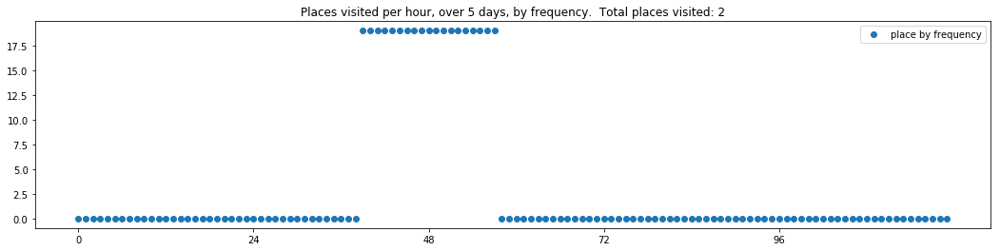

----- vector ----
prefix labels:  [22, 22]
[0, 0, 0, 0, 0, 0, 0, 22, 22, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22]
[22, 22, 22, 22, 22, 22, 22, 307, 307, 307, 307, 307, 307, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22]
[20, 20, 0, 0, 0, 0, 21, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 20, 22]


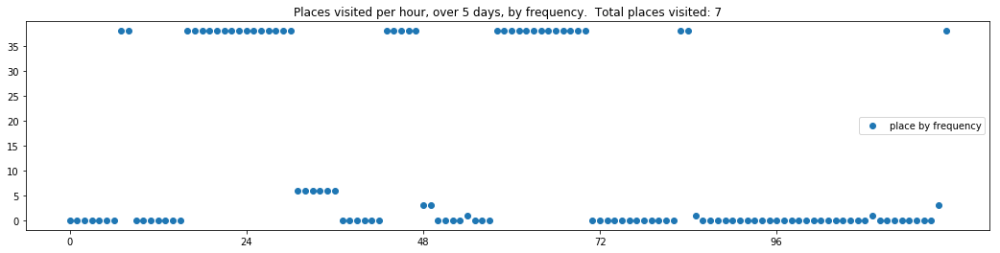

----- vector ----
prefix labels:  [122, 503]
[0, 0, 0, 25, 332, 332, 332, 332, 332, 332, 586, 586, 586, 586, 586, 586, 586, 523, 116, 116, 0, 0, 0, 503]
[503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503]
[503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503]
[503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503]
[503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 503, 199, 199, 199, 199, 199, 199, 199, 199, 197]


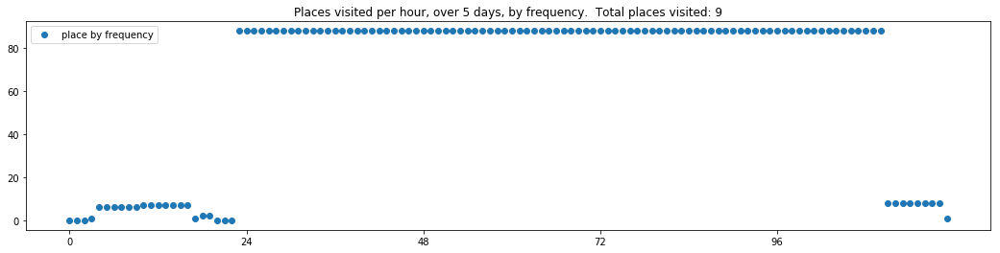

----- vector ----
prefix labels:  [183, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 464, 3, 3, 261, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 573, 573, 574, 0, 0, 476, 330]
[330, 288, 393, 239, 239, 239, 239, 239, 84, 476, 0, 0, 388, 430, 430, 430, 0, 227, 227, 561, 227, 227, 227, 227]
[227, 227, 227, 227, 227, 561, 561, 561, 227, 0, 561, 561, 561, 561, 561, 561, 561, 561, 561, 561, 561, 561, 561, 561]
[561, 561, 561, 561, 561, 561, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 480, 480]


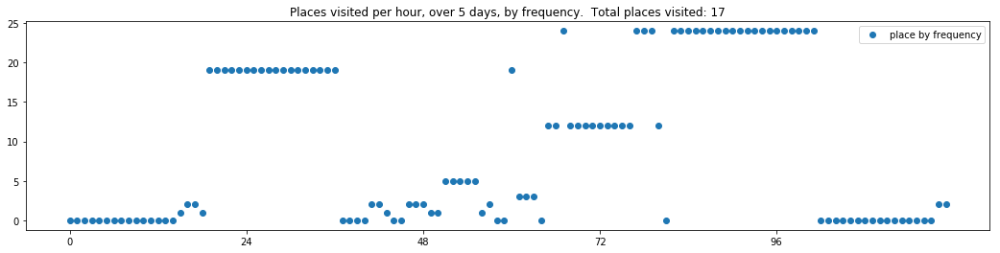

----- vector ----
prefix labels:  [622, 111]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 111, 111, 111, 351, 351]
[351, 0, 111, 111, 111, 111, 111, 111, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0]
[111, 111, 111, 111, 111, 111, 111, 0, 111, 111, 111, 0, 0, 0, 0, 0, 0, 111, 111, 111, 111, 111, 111, 111]
[111, 111, 0, 0, 0, 0, 0, 0, 229, 229, 229, 229, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0]


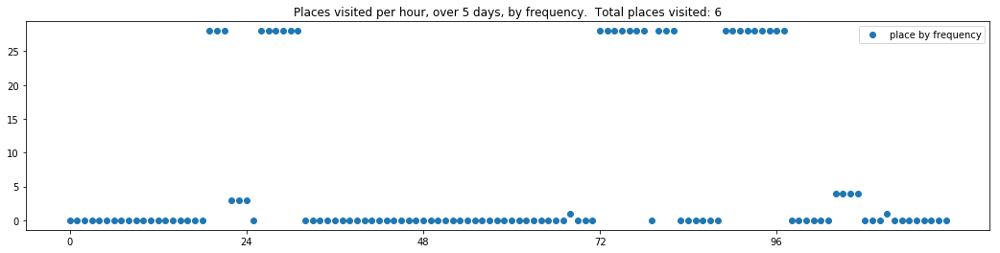

----- vector ----
prefix labels:  [537, 537]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 537, 537, 537, 537, 537, 537]
[537, 537, 537, 537, 0, 383, 537, 537, 537, 537, 537, 0, 537, 537, 537, 537, 537, 537, 0, 0, 0, 119, 119, 119]
[119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 0, 0, 100, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


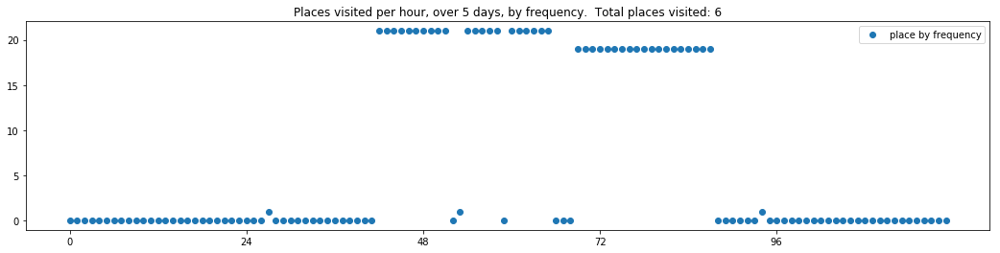

----- vector ----
prefix labels:  [536, 536]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 0, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 0]
[0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


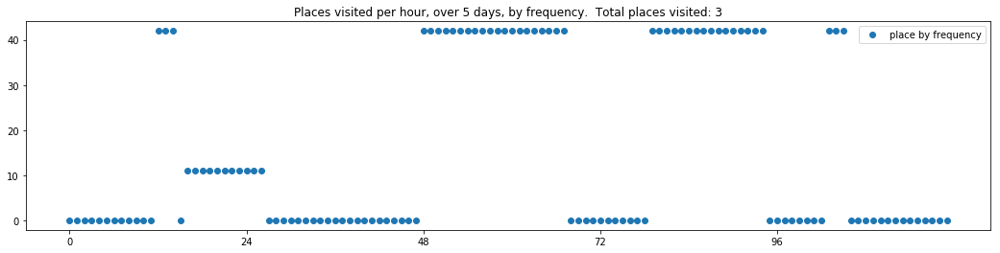

----- vector ----
prefix labels:  [22, 22]
[0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 162, 162, 162]
[162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


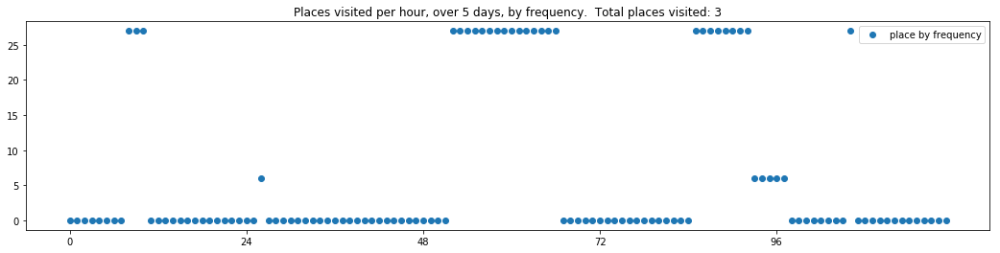

----- vector ----
prefix labels:  [579, 579]
[0, 0, 0, 0, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 3, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 0, 0, 0, 0, 0, 0, 83, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 0]
[579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 5, 579, 579, 579, 0, 0, 0, 0, 630, 0, 571, 571, 571]
[579, 579, 579, 579, 579, 579, 579, 0, 0, 0, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579, 579]


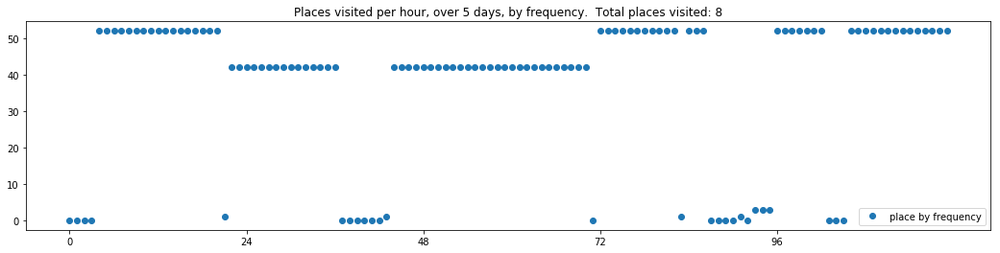

----- vector ----
prefix labels:  [470, 470]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 470, 470, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 470, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 470, 470, 470, 470, 470]


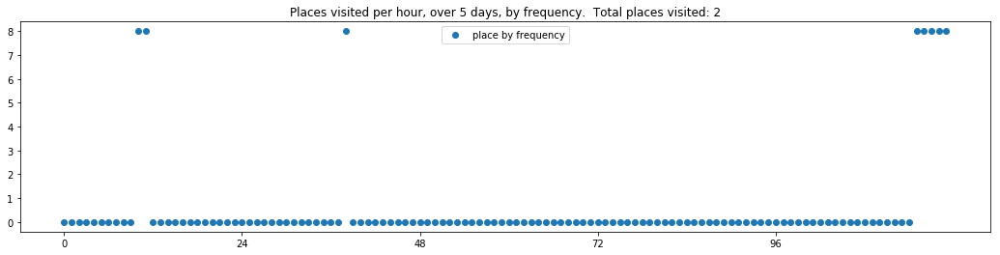

----- vector ----
prefix labels:  [578, 578]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 340, 340, 340, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578]
[578, 578, 578, 0, 0, 0, 0, 0, 0, 434, 434, 0, 578, 578, 0, 0, 0, 0, 0, 578, 578, 578, 578, 0]
[578, 578, 578, 0, 0, 0, 0, 0, 0, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578]
[578, 578, 578, 0, 0, 0, 0, 578, 578, 578, 578, 167, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 578, 0]


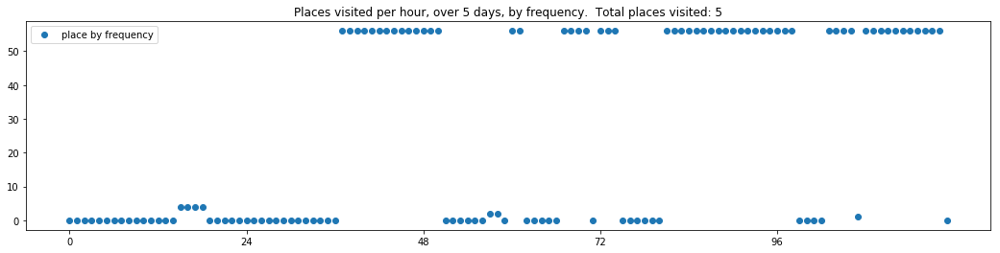

----- vector ----
prefix labels:  [306, 213]
[0, 0, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 306, 306, 213, 213, 0, 213, 213, 213, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 382, 382, 382, 382, 382, 0, 382, 382, 138, 0, 382]
[382, 382, 382, 382, 0, 0, 0, 0, 0, 0, 0, 0, 461, 461, 461, 461, 461, 461, 461, 461, 264, 455, 455, 455]
[455, 455, 455, 455, 141, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 306, 306, 213, 141, 0]


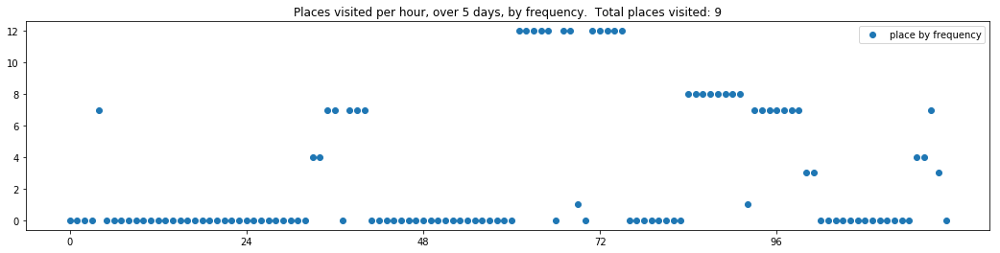

----- vector ----
prefix labels:  [518, 518]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 518, 518, 518, 518, 0, 0, 0, 0, 0, 518, 518]
[518, 518, 518, 518, 0, 0, 0, 0, 230, 230, 230, 230, 230, 230, 0, 518, 518, 518, 187, 187, 187, 187, 187, 230]
[0, 518, 518, 518, 518, 518, 518, 518, 518, 469, 365, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 230, 230, 0, 230, 230, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230, 230]


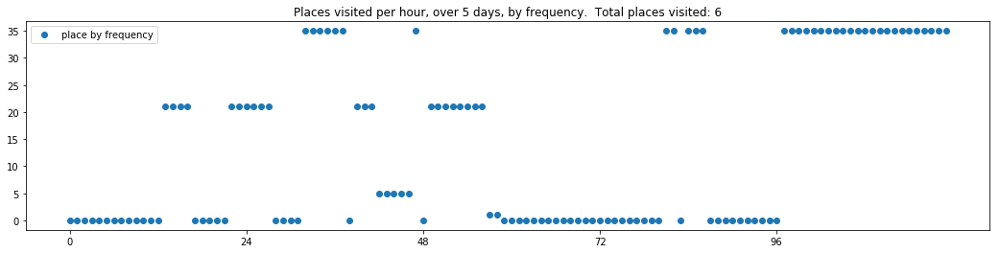

----- vector ----
prefix labels:  [191, 191]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 191, 0, 0, 0, 0, 0, 0]
[0, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 191, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 191, 191, 191, 0, 0, 0, 0, 0, 191, 191, 191, 191, 0, 0, 0, 0, 0, 0, 0, 191]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 345, 0, 0]
[0, 0, 0, 0, 0, 191, 191, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


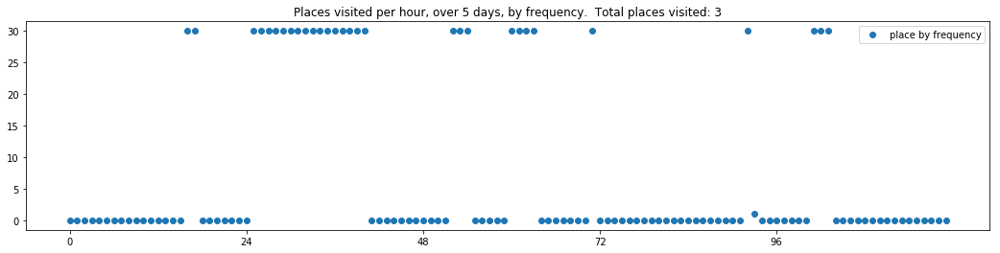

----- vector ----
prefix labels:  [527, 527]
[0, 0, 0, 0, 0, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527, 527]
[0, 0, 0, 527, 527, 0, 527, 527, 527, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 527, 527, 0, 0, 0, 0, 0, 0, 559, 0, 0, 416, 0, 0, 55, 4, 527, 527, 527, 527, 225, 225, 225]
[225, 225, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 161, 368, 368, 368, 368, 374, 0, 0, 52, 52, 52, 52]
[52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 266, 0]


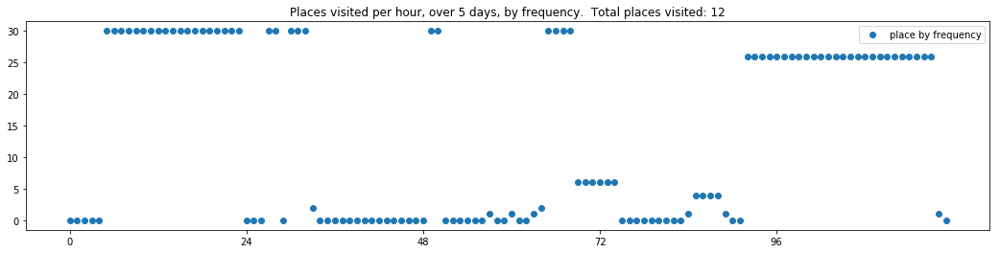

----- vector ----
prefix labels:  [459, 151]
[0, 0, 0, 0, 0, 0, 0, 151, 151, 203, 203, 203, 203, 203, 203, 203, 203, 203, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


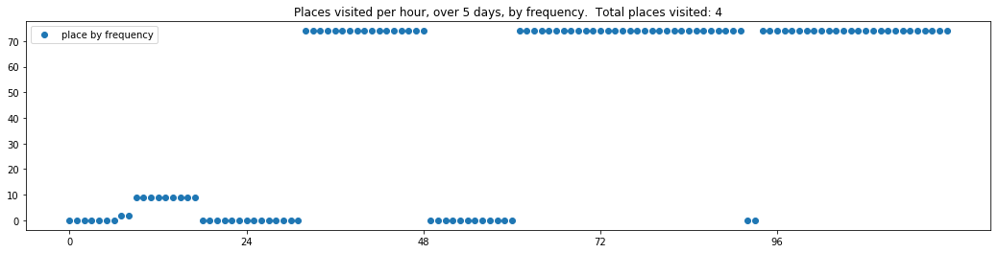

----- vector ----
prefix labels:  [598, 598]
[0, 0, 0, 0, 0, 0, 0, 20, 2, 2, 0, 124, 0, 0, 0, 0, 0, 0, 0, 276, 0, 0, 0, 0]
[598, 0, 0, 0, 0, 598, 598, 598, 598, 598, 598, 598, 598, 598, 0, 0, 221, 221, 221, 323, 323, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 379, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475]


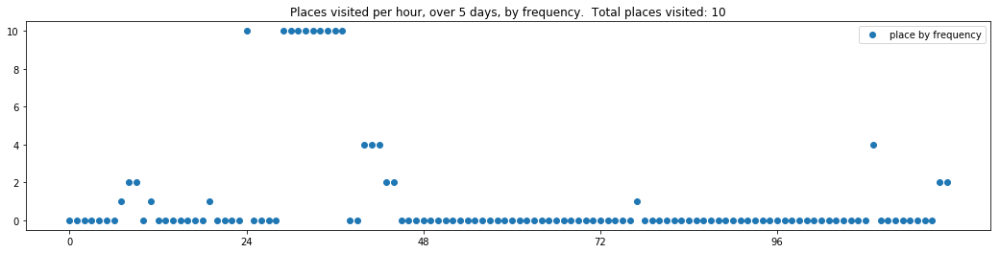

----- vector ----
prefix labels:  [384, 384]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 384, 384, 384, 384, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 384, 384, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 0, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0]


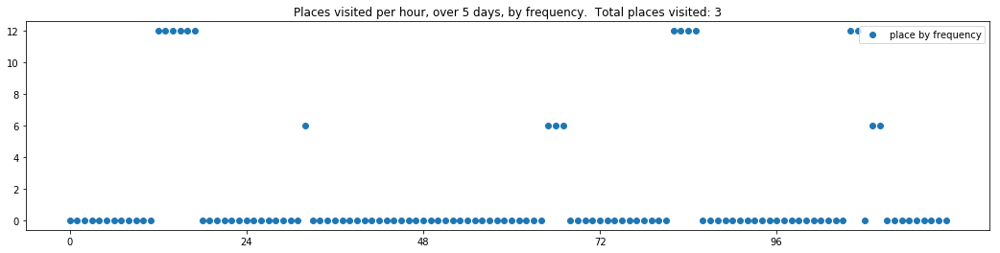

----- vector ----
prefix labels:  [406, 406]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 406, 406, 406, 406, 406, 406, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 406, 406, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 0, 406, 406, 406, 406, 406, 0, 406]
[406, 406, 406, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 406, 406, 406, 406, 0]
[485, 0, 76, 0, 0, 0, 450, 603, 603, 603, 603, 603, 603, 603, 603, 0, 0, 239, 239, 239, 416, 406, 406, 406]


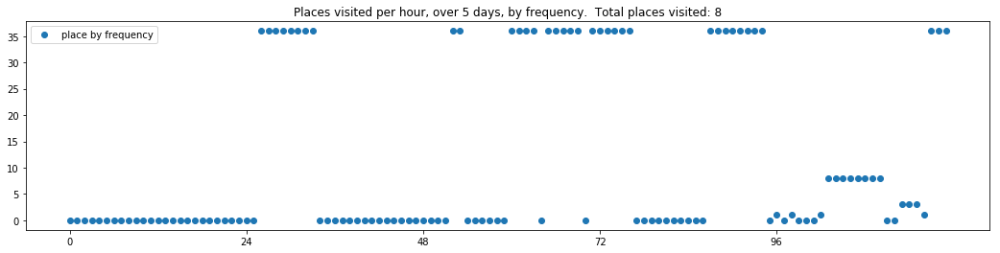

----- vector ----
prefix labels:  [167, 167]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 562]
[562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 167, 0, 0, 0, 0, 165, 165, 165, 165, 165, 165, 165, 165, 167, 167, 167, 167, 167, 167, 167, 167, 167]
[167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 167, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 165, 165, 165, 0, 0, 0]


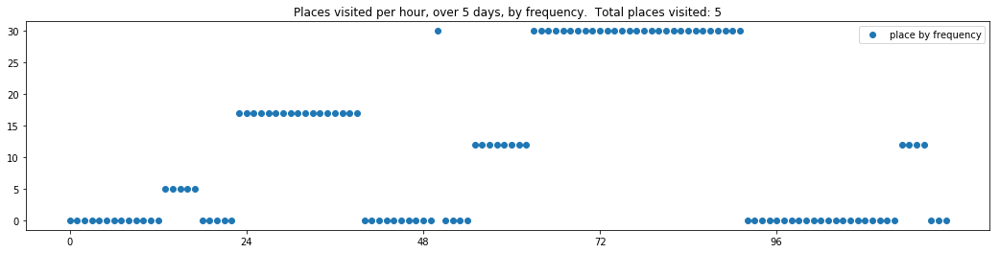

----- vector ----
prefix labels:  [310, 310]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 310, 310, 310, 310, 310, 310, 310, 310, 0, 0, 0, 0, 0, 0, 0, 558, 558, 497, 497, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 200, 200, 200, 200, 328, 328, 328, 328]


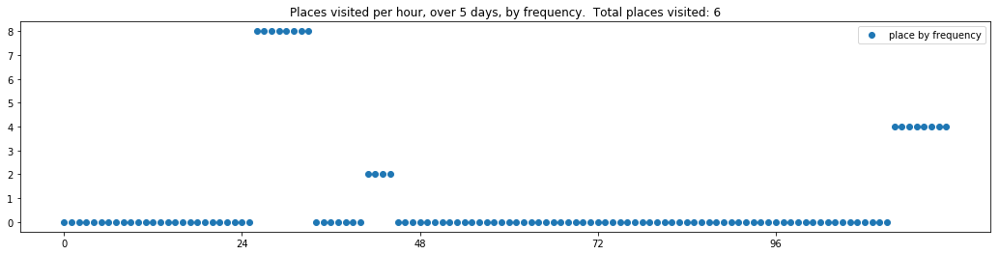

----- vector ----
prefix labels:  [107, 107]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107, 107, 107, 107]


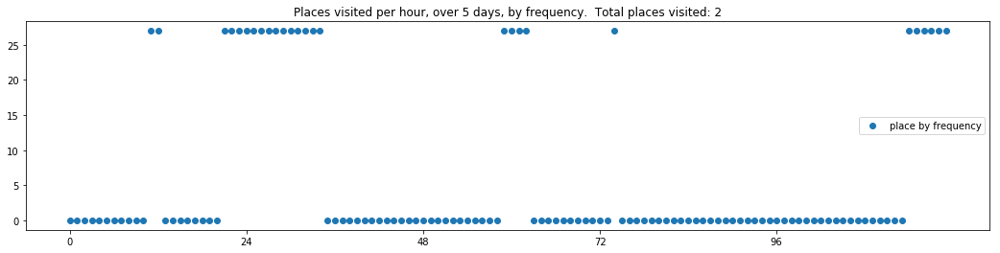

----- vector ----
prefix labels:  [205, 4]
[0, 0, 0, 0, 4, 4, 4, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 205, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 205]
[205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 0, 205, 205, 205, 205]
[205, 0, 0, 205, 0, 0, 0, 496, 496, 496, 496, 496, 496, 0, 0, 479, 479, 479, 479, 479, 479, 0, 0, 0]


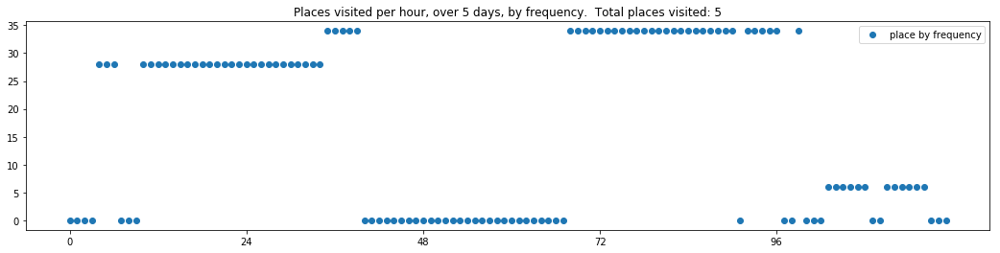

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413]
[413, 0, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


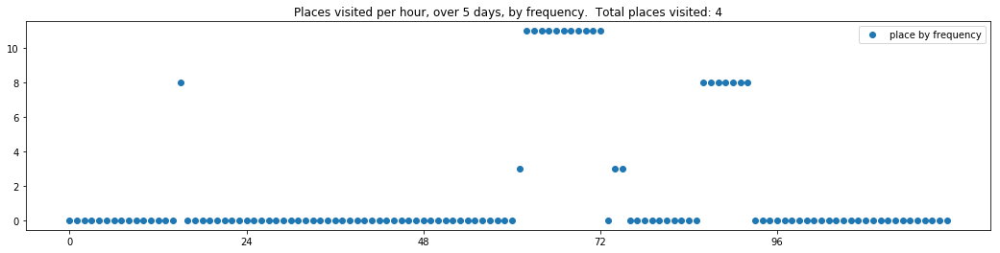

----- vector ----
prefix labels:  [77, 77]
[0, 0, 0, 0, 0, 0, 0, 0, 21, 77, 77, 77, 77, 77, 77, 77, 0, 0, 8, 8, 8, 0, 0, 77]
[77, 77, 77, 77, 77, 77, 77, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 0]
[0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 373, 373, 603, 603, 603, 603, 603, 603, 603, 603, 603]


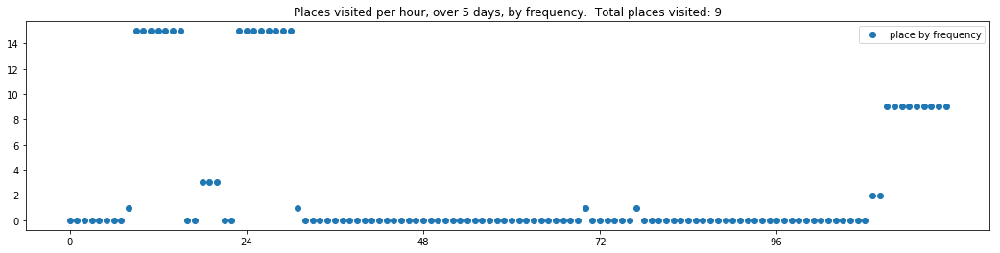

----- vector ----
prefix labels:  [298, 261]
[0, 0, 0, 0, 261, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 368, 279]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 462, 462, 462]
[341, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 93, 279, 279, 279, 279, 279, 279, 279]
[0, 0, 0, 76, 386, 386, 386, 386, 119, 119, 0, 0, 261, 261, 358, 645, 261, 261, 261, 261, 261, 261, 261, 261]


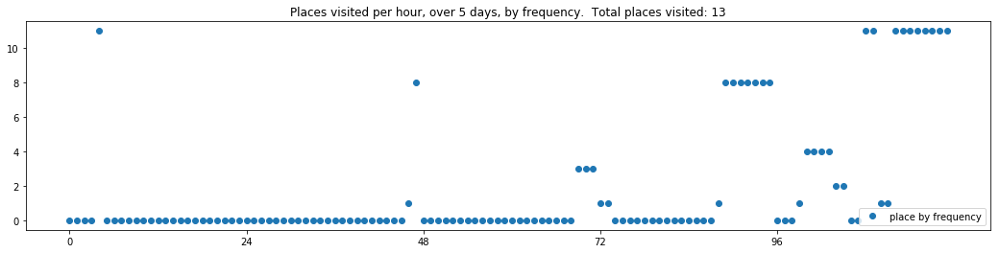

----- vector ----
prefix labels:  [133, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 497, 0, 0, 0, 364, 364, 364]
[364, 364, 364, 364, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 58, 58, 58, 58]


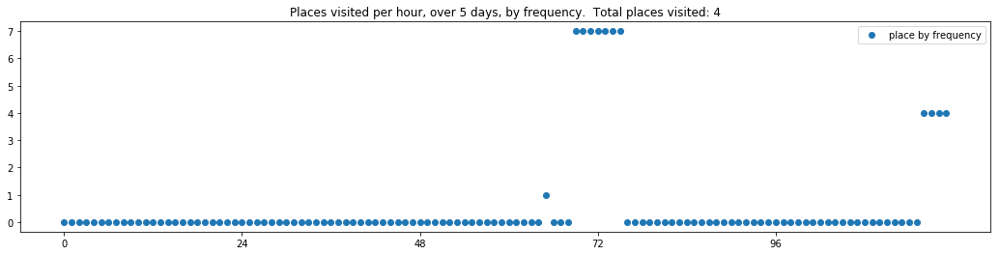

----- vector ----
prefix labels:  [635, 635]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 635, 635, 0, 0, 0, 0, 0, 0, 0, 635, 0]
[635, 635, 635, 635, 635, 635, 635, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 502, 502, 502, 502, 0]
[0, 0, 0, 77, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 502, 502, 0, 502, 502, 0, 0, 0, 0, 22, 22, 0, 373, 373, 0, 373, 0, 0, 0, 0, 0]


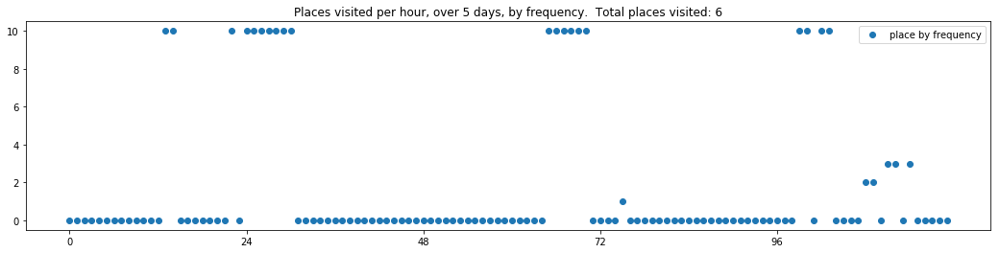

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 29, 29, 29, 22, 0, 8, 8, 0, 0, 0, 0]
[0, 0, 0, 640, 0, 163, 163, 0, 0, 0, 0, 0, 0, 0, 0, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 30, 0, 0, 30, 30, 540, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 29, 29, 319, 575, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


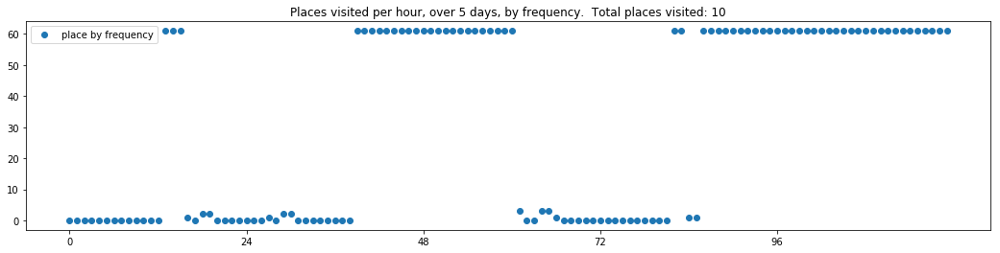

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 401, 0, 0, 314, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 276, 276, 0]
[0, 0, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 23, 23, 23, 23, 0, 0, 0, 0, 0, 0, 0, 0]


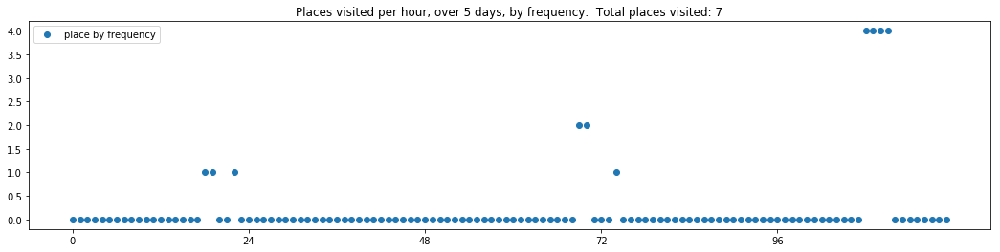

----- vector ----
prefix labels:  [209, 127]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 127, 127, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 209, 209, 209, 209, 209, 209, 209, 209, 209, 598, 209, 209, 209, 209, 209, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 127, 127, 127, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


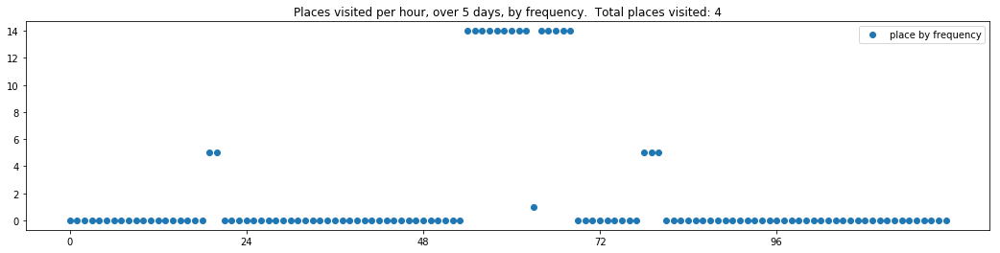

----- vector ----
prefix labels:  [194, 195]
[0, 0, 0, 632, 632, 632, 632, 200, 632, 0, 0, 632, 632, 632, 632, 632, 4, 4, 4, 4, 4, 4, 4, 0]
[0, 0, 0, 0, 0, 632, 632, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[194, 194, 194, 194, 0, 539, 539, 0, 194, 632, 194, 194, 194, 194, 194, 389, 0, 194, 194, 0, 194, 194, 194, 0]
[493, 493, 493, 562, 562, 562, 562, 110, 311, 195, 191, 191, 56, 0, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 0, 0, 194, 166, 493, 493, 493, 493, 493, 493, 493, 493, 493, 301]


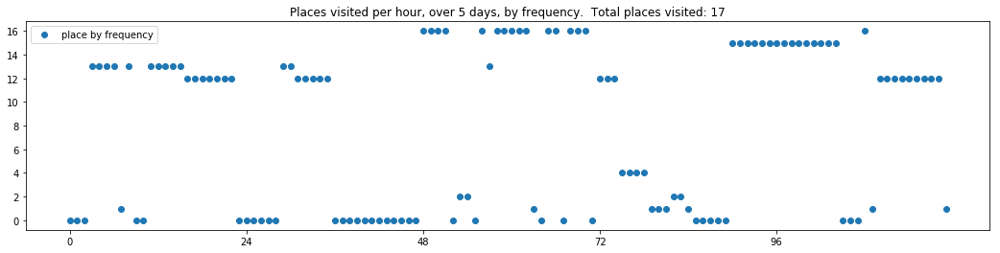

----- vector ----
prefix labels:  [39, 39]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 39, 39, 39, 39, 39, 39, 39, 39]
[39, 0, 0, 0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 39, 39, 39, 39, 39, 39, 39, 187, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


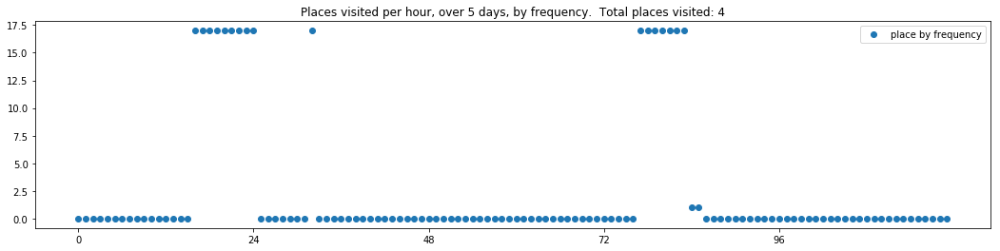

----- vector ----
prefix labels:  [190, 21]
[0, 0, 0, 0, 0, 0, 0, 155, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0]
[0, 0, 333, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 360, 360, 360, 415, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 149, 0, 0, 0, 0, 0, 149, 519, 519, 519, 519, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 149, 149, 163, 163, 163, 163, 163, 20, 20, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 180]


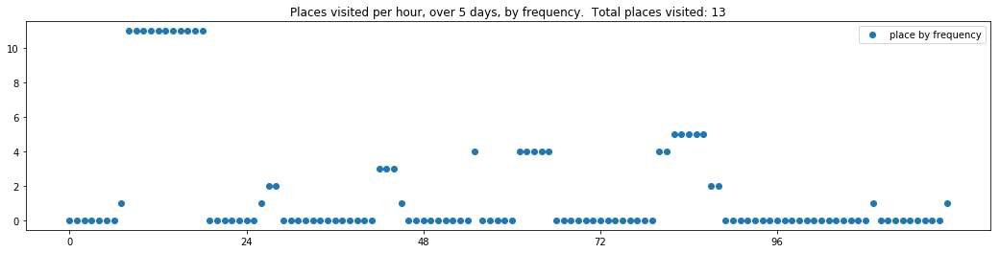

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 205]
[205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 205, 0, 0, 0]
[0, 0, 0, 0, 205, 205, 205, 205, 205, 205, 205, 0, 0, 0, 0, 205, 205, 205, 205, 205, 205, 205, 205, 0]
[205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 205]


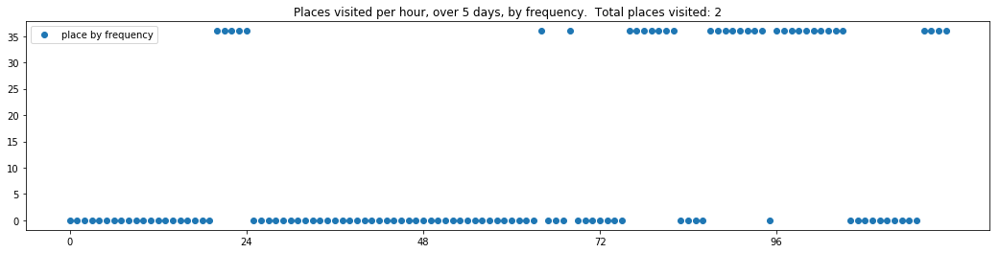

----- vector ----
prefix labels:  [451, 163]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 63, 298, 0, 62, 98, 364, 342, 342, 342]
[342, 143, 21, 466, 466, 617, 0, 0, 0, 0, 0, 0, 271, 0, 0, 0, 261, 261, 261, 137, 540, 540, 59, 59]
[59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 0, 0, 357, 606, 600, 600, 601, 105, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132]
[132, 132, 132, 132, 560, 0, 0, 0, 0, 0, 0, 596, 339, 339, 421, 192, 451, 346, 346, 532, 532, 532, 0, 0]


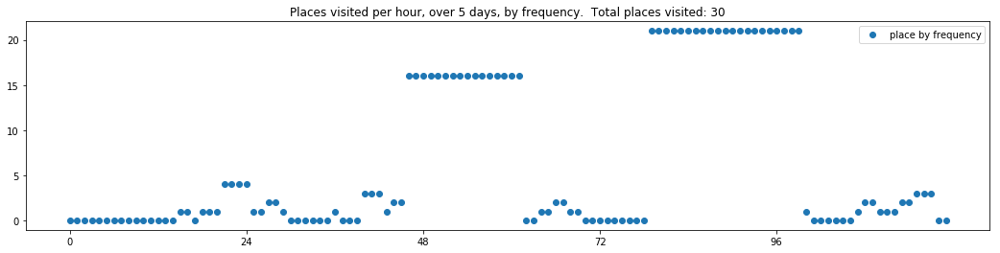

----- vector ----
prefix labels:  [282, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 213, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 0]
[0, 0, 0, 0, 0, 282, 282, 0, 0, 0, 0, 0, 0, 0, 0, 0, 59, 0, 0, 0, 0, 59, 59, 59]
[59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 394, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282]
[282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 192, 0, 425, 339]


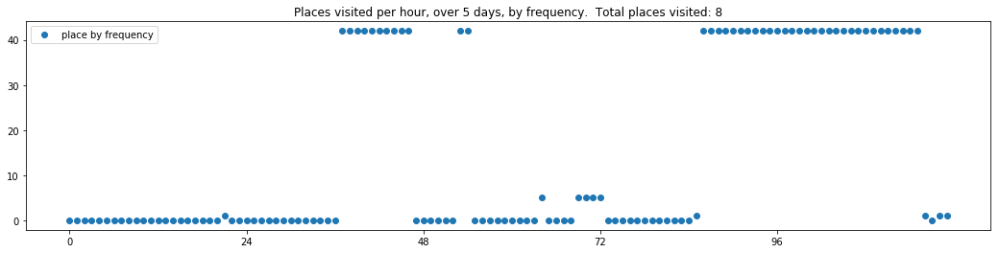

----- vector ----
prefix labels:  [187, 221]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 94, 94, 220, 220, 220, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 292, 221, 221, 221]
[572, 0, 0, 0, 0, 112, 112, 112, 112, 112, 112, 112, 112, 64, 64, 64, 64, 469, 0, 0, 0, 0, 0, 469]
[469, 469, 469, 0, 0, 0, 0, 0, 469, 469, 469, 469, 469, 469, 0, 0, 0, 0, 0, 0, 20, 20, 469, 230]


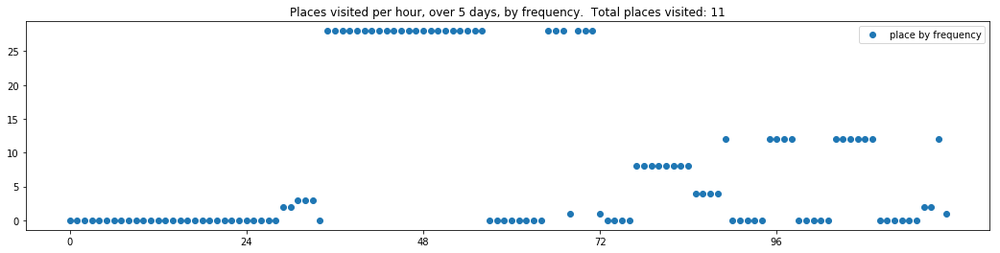

----- vector ----
prefix labels:  [344, 344]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 344, 344, 344, 344, 344, 225, 225, 225, 225, 225, 225, 225, 225]
[225, 87, 128, 0, 119, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 344, 344, 344, 344, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 364]
[364, 364, 364, 364, 364, 364, 364, 364, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344, 344]
[344, 87, 0, 344, 344, 344, 344, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 552]


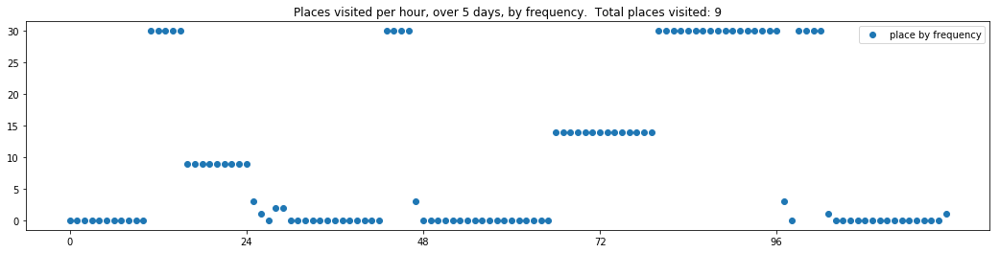

----- vector ----
prefix labels:  [403, 464]
[0, 0, 0, 0, 0, 0, 0, 0, 169, 0, 0, 0, 0, 0, 0, 8, 383, 177, 177, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 404, 404, 404, 404, 239, 0, 0, 0, 0]
[0, 0, 0, 631, 631, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404]
[404, 404, 404, 404, 404, 404, 404, 404, 404, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78]
[323, 173, 173, 173, 173, 173, 173, 173, 173, 173, 173, 173, 173, 173, 0, 0, 0, 579, 579, 579, 579, 579, 579, 579]


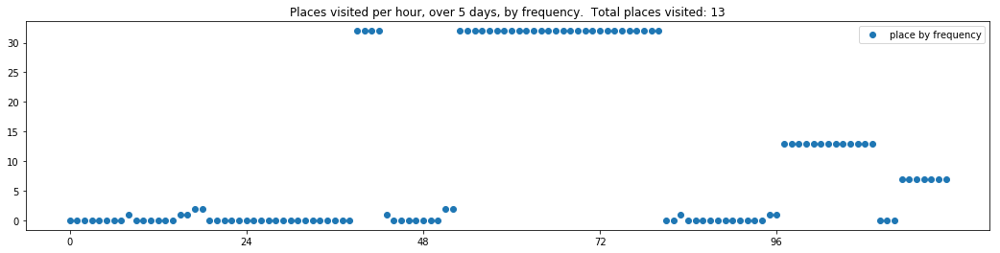

----- vector ----
prefix labels:  [462, 462]
[0, 0, 0, 0, 462, 0, 146, 0, 0, 0, 0, 0, 559, 462, 462, 462, 462, 462, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 146, 146, 146, 146, 146, 146, 0, 0, 0, 539, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 610, 463, 463, 462, 462]


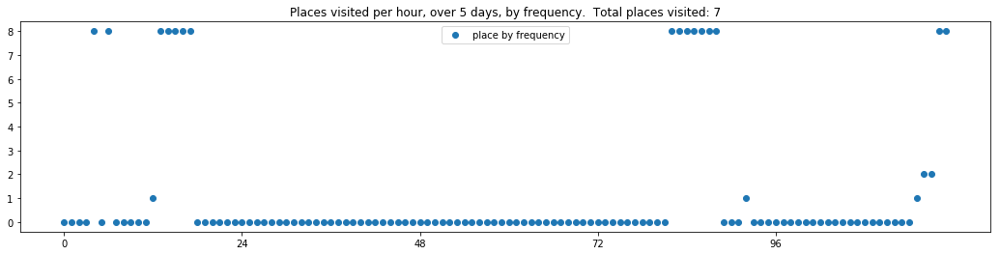

----- vector ----
prefix labels:  [163, 163]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 163, 163, 0, 0, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163, 163]
[163, 163, 163, 163, 163, 163, 163, 163, 163, 68, 68, 68, 163, 0, 0, 0, 0, 0, 0, 253, 253, 253, 24, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


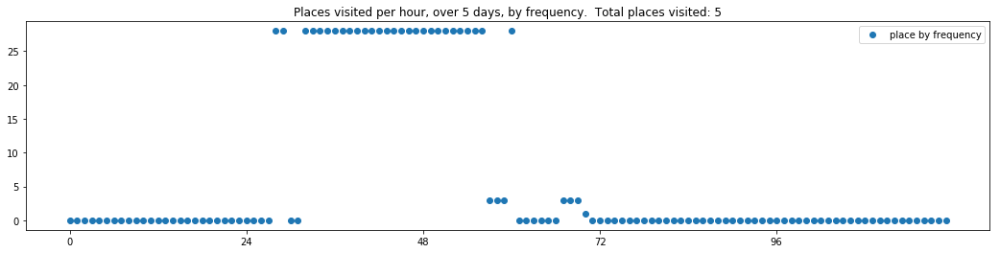

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


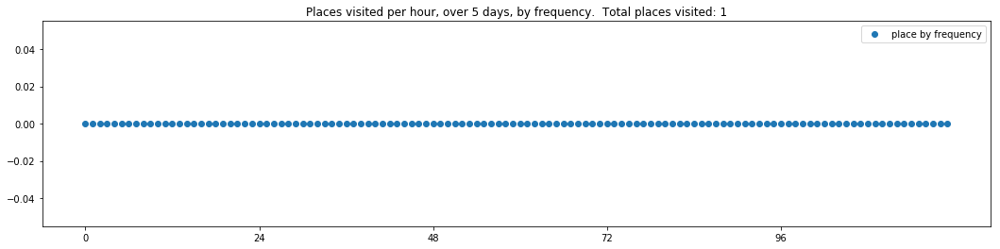

----- vector ----
prefix labels:  [278, 278]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 0, 278, 278, 278, 278, 278, 0, 278, 278, 278, 278, 278, 278]


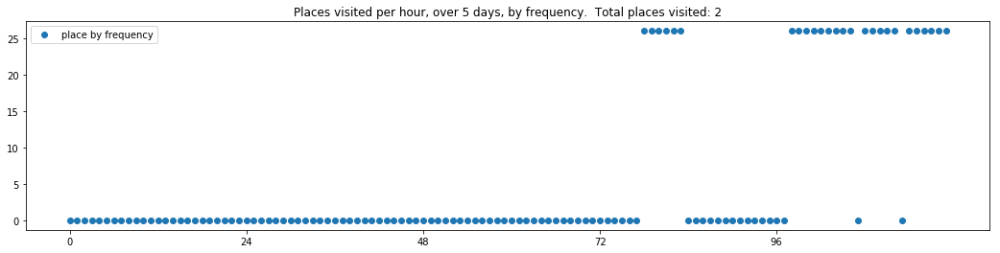


------
 10 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_10.txt 
------

----- vector ----
prefix labels:  [321, 321]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


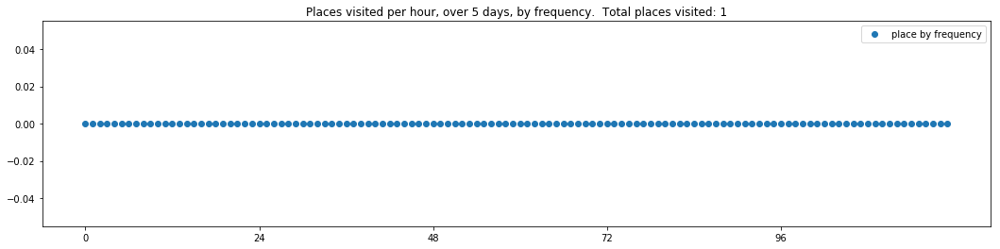

----- vector ----
prefix labels:  [618, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 618, 618, 618, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[336, 336, 336, 336, 336, 336, 336, 336, 336, 336, 336, 0, 0, 0, 0, 0, 0, 0, 0, 404, 404, 0, 0, 0]
[0, 0, 424, 424, 424, 424, 424, 424, 424, 424, 236, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 223, 0]


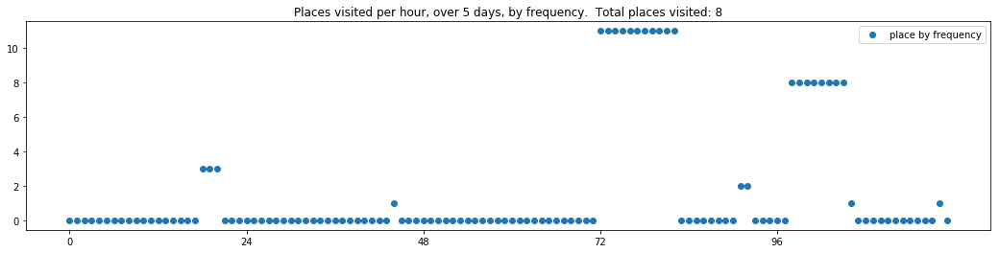

----- vector ----
prefix labels:  [22, 22]
[0, 0, 0, 0, 22, 22, 22, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 22, 22, 22, 0, 0, 0, 0, 0, 0, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 342, 342]
[271, 271, 271, 271, 271, 271, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 0, 0]
[0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 52, 52, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


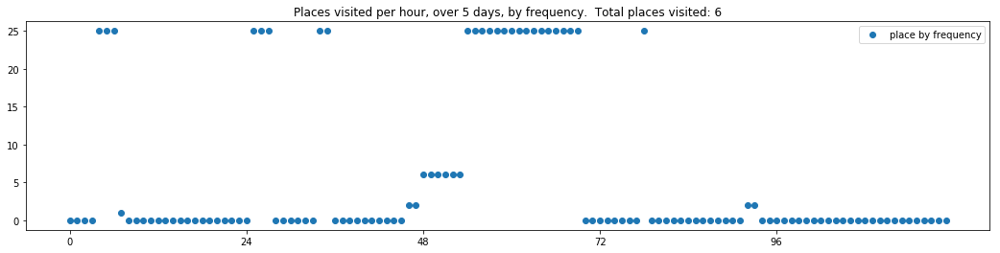

----- vector ----
prefix labels:  [46, 46]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46]


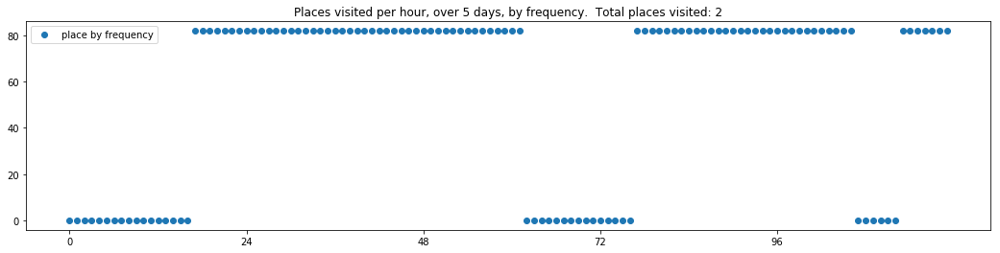

----- vector ----
prefix labels:  [350, 133]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 59, 59, 133, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 541, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 374, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


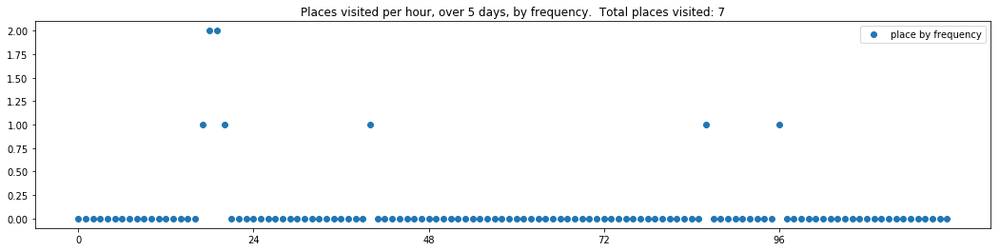

----- vector ----
prefix labels:  [92, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


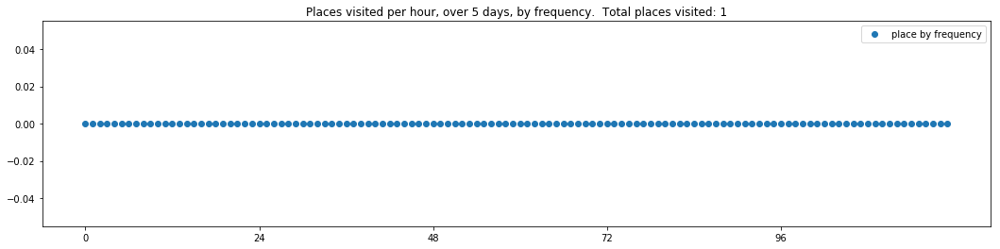

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 225, 225, 0, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 42, 42, 0, 0, 0, 0, 0, 0, 0, 0, 350, 350]
[350, 350, 350, 350, 350, 350, 350, 350, 350, 350, 350, 350, 350, 350, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 225, 225, 225, 225, 225]


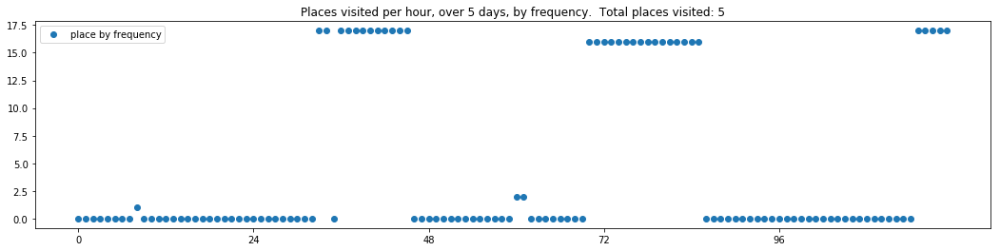

----- vector ----
prefix labels:  [494, 76]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[558, 0, 443, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 464, 464, 0, 464, 464, 464, 464, 464, 558]
[558, 558, 0, 0, 0, 0, 0, 0, 598, 598, 0, 0, 0, 0, 0, 0, 0, 4, 2, 2, 0, 2, 0, 0]
[0, 0, 0, 0, 598, 598, 598, 461, 461, 461, 0, 122, 122, 598, 0, 184, 184, 184, 0, 0, 0, 0, 0, 0]
[475, 116, 116, 116, 0, 0, 0, 0, 0, 0, 0, 0, 70, 612, 612, 0, 370, 370, 249, 257, 257, 257, 257, 257]


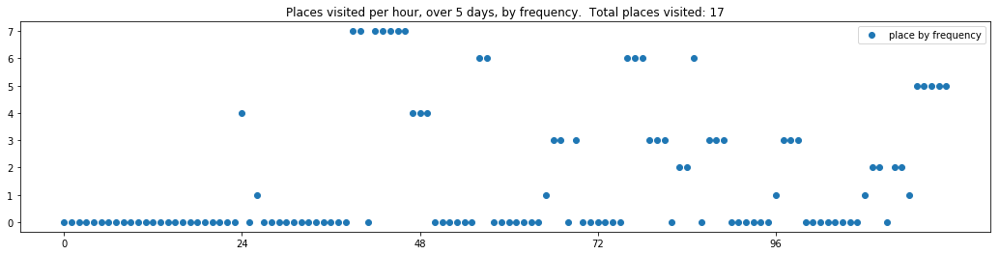

----- vector ----
prefix labels:  [21, 290]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 290, 290, 0, 0, 290, 290, 290, 290, 290, 290]
[290, 290, 290, 558, 558, 558, 558, 558, 558, 290, 290, 290, 290, 290, 290, 290, 290, 290, 556, 447, 76, 76, 22, 22]
[22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 76, 29, 0, 0, 0, 0, 0, 0, 100, 0, 66]
[66, 66, 66, 0, 0, 0, 56, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


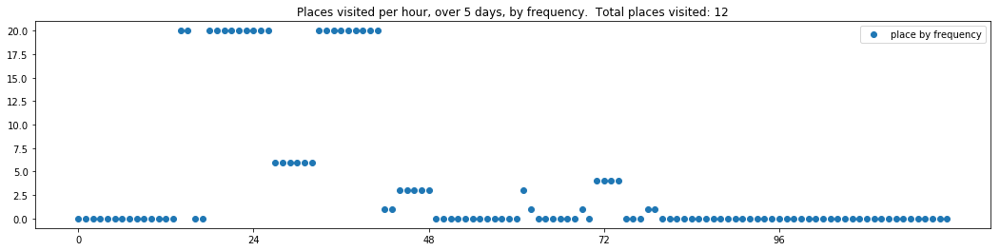

----- vector ----
prefix labels:  [184, 184]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184]
[184, 184, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]


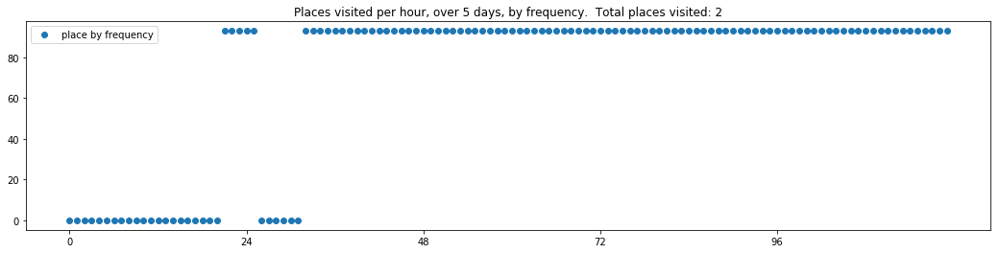

----- vector ----
prefix labels:  [230, 253]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 230, 230]
[230, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 472, 0, 0, 0, 230, 230, 0, 229]


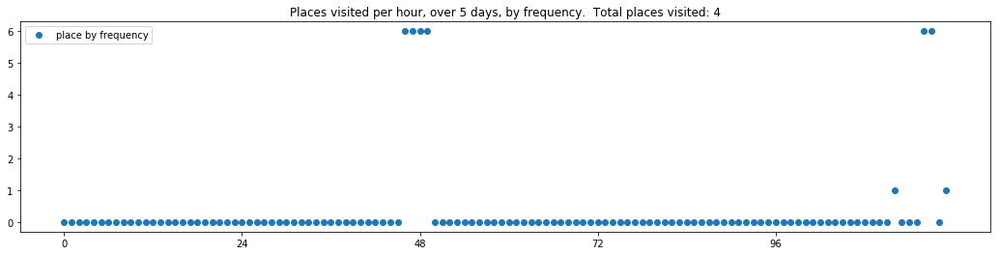

----- vector ----
prefix labels:  [42, 42]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[385, 385, 385, 385, 385, 385, 385, 385, 385, 385, 105, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


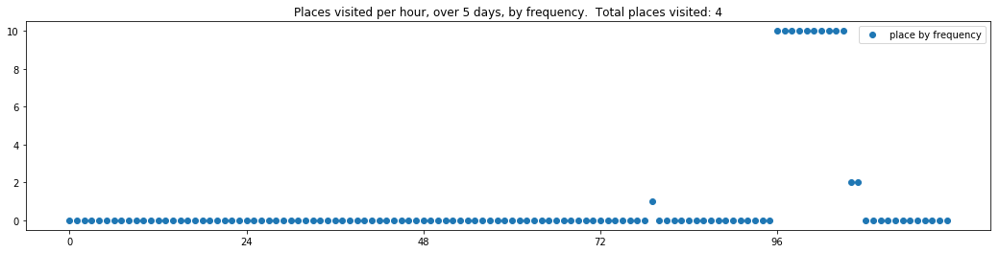

----- vector ----
prefix labels:  [330, 330]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 2]
[2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


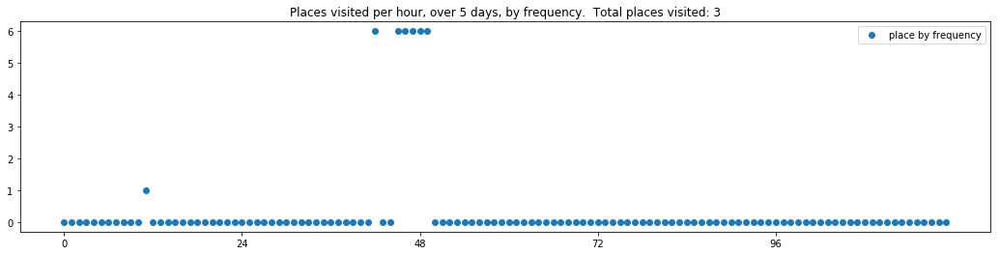

----- vector ----
prefix labels:  [0, 267]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


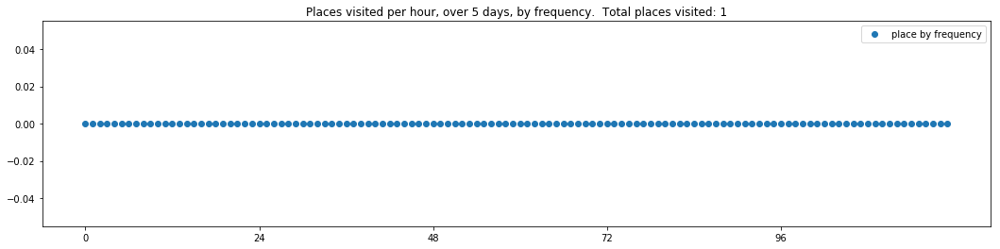

----- vector ----
prefix labels:  [536, 536]
[0, 0, 0, 0, 0, 0, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536]
[536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536]
[536, 536, 536, 536, 536, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 536, 536, 536]
[536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 536, 0, 0]


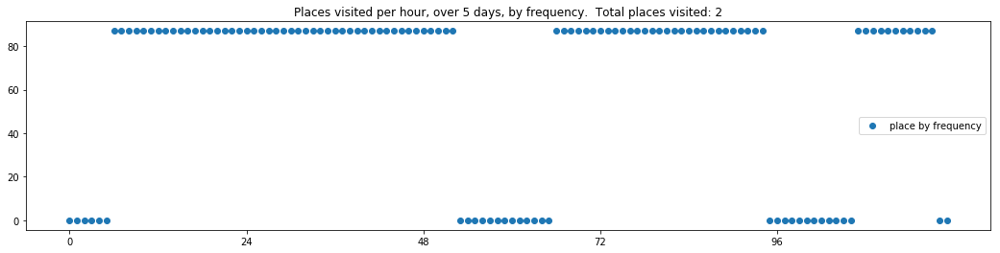

----- vector ----
prefix labels:  [215, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


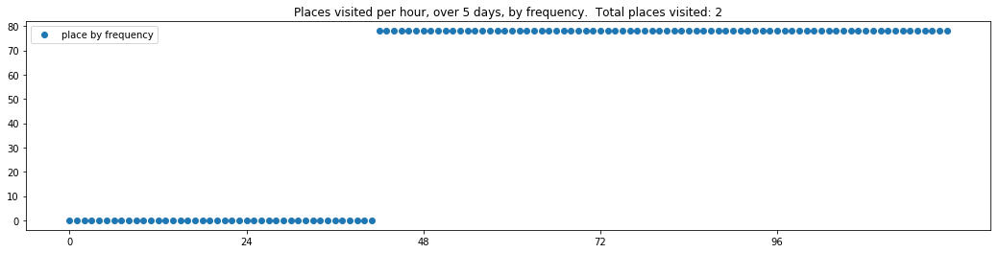

----- vector ----
prefix labels:  [0, 392]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 0, 0, 0, 0, 0]


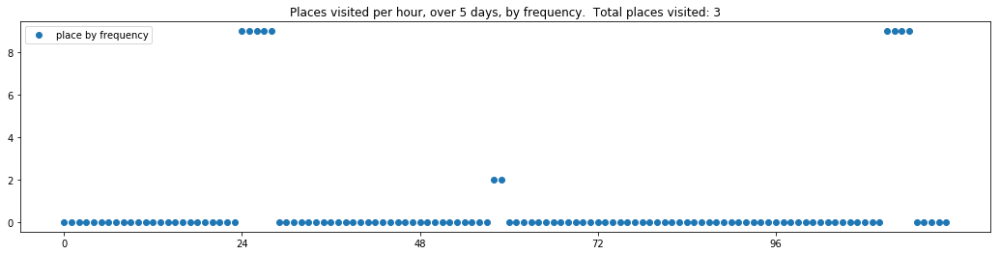

----- vector ----
prefix labels:  [481, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 376, 481, 0, 0, 0, 0, 0, 0, 481, 481, 481, 481]
[481, 481, 481, 481, 481, 481, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[481, 481, 481, 481, 481, 481, 481, 481, 481, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 282, 481, 481, 481, 481, 481]
[481, 481, 481, 481, 481, 481, 481, 481, 481, 0, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282]


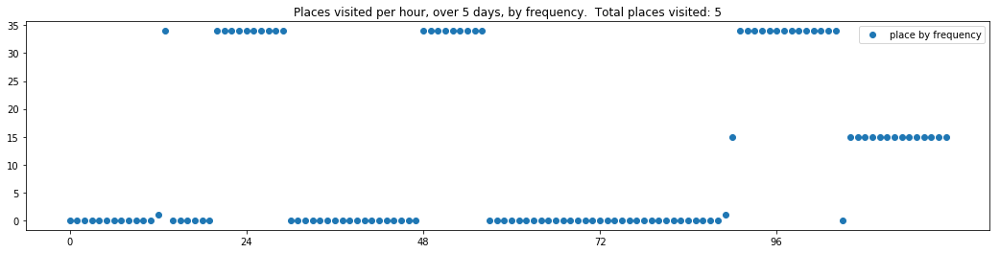

----- vector ----
prefix labels:  [285, 252]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 0, 0, 252, 0, 0, 0, 0, 0, 0, 252]
[433, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 252, 252, 252, 252, 252]
[252, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 252, 252, 252, 252, 252, 252, 252, 0, 0, 0, 0, 0, 0]
[0, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 522]


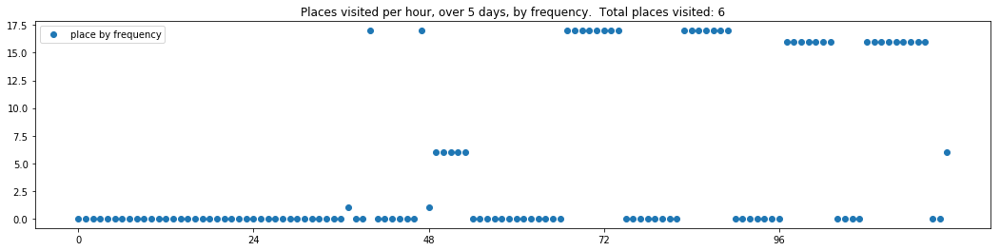

----- vector ----
prefix labels:  [61, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 259, 0, 0]
[0, 0, 259, 61, 61, 61, 61, 61, 61, 0, 0, 0, 0, 0, 0, 61, 61, 61, 61, 61, 61, 61, 61, 61]


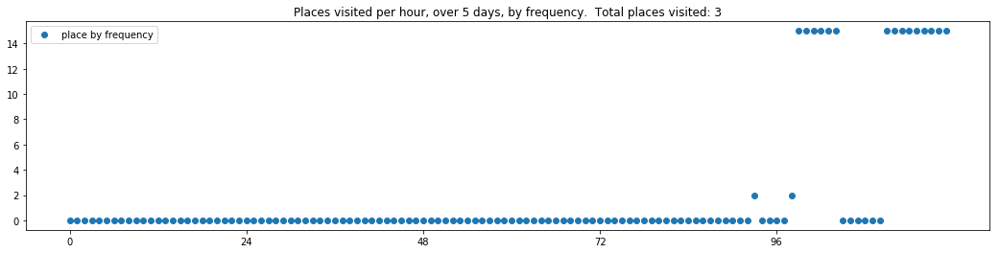

----- vector ----
prefix labels:  [66, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66]
[66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66]


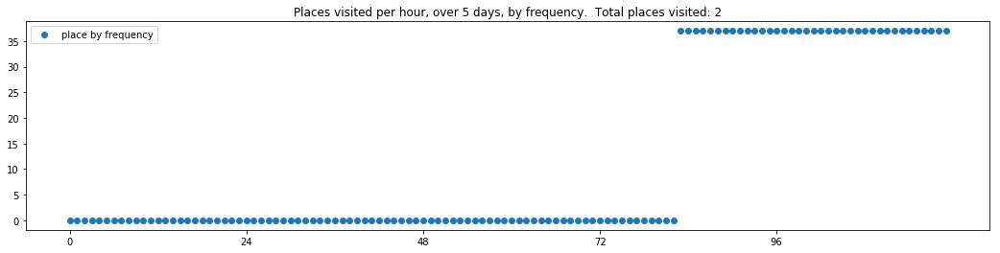

----- vector ----
prefix labels:  [128, 128]
[0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 386, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 386, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 161, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


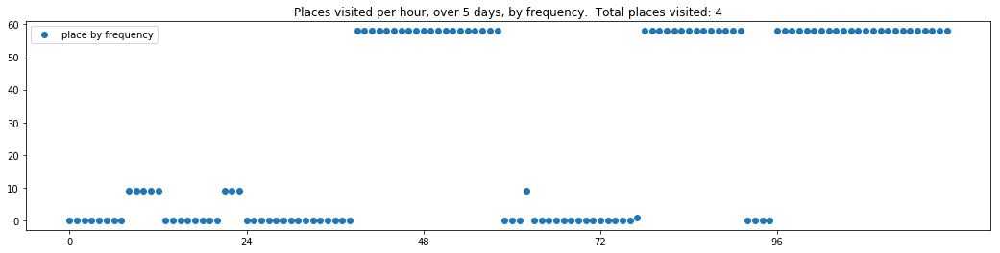

----- vector ----
prefix labels:  [144, 144]
[0, 0, 0, 0, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 490, 0, 0, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 51, 121, 0, 0, 0, 376, 376, 376, 376, 0, 490]
[490, 0, 0, 0, 0, 0, 0, 0, 439, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 490, 490, 439, 439, 439, 439, 439, 439, 0, 0, 0, 0]


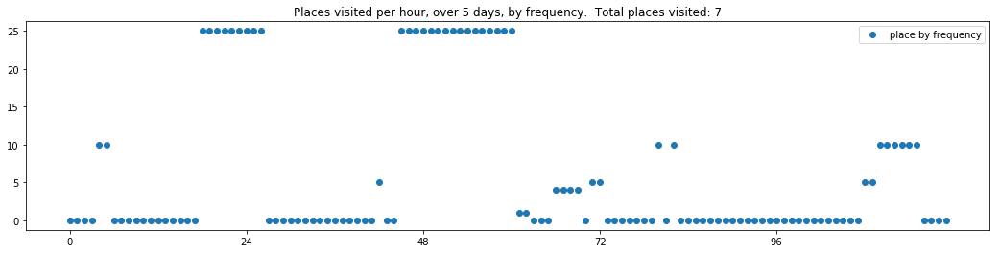

----- vector ----
prefix labels:  [209, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


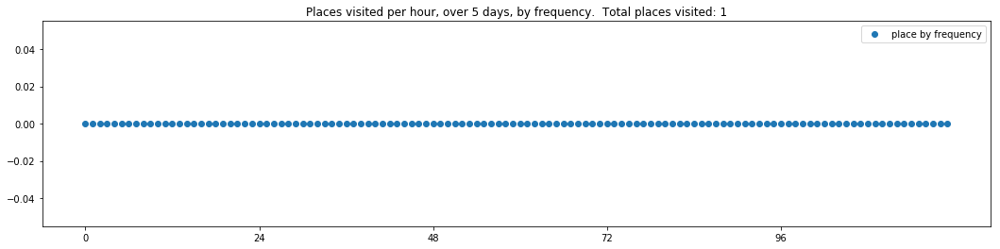

----- vector ----
prefix labels:  [101, 219]
[0, 0, 0, 0, 0, 0, 0, 0, 101, 101, 101, 101, 0, 0, 0, 101, 101, 101, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 101, 101, 101, 101, 101, 101, 101, 101, 101, 101, 101, 101, 101, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 454]
[454, 454, 454, 454, 454, 454, 454, 101, 454, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


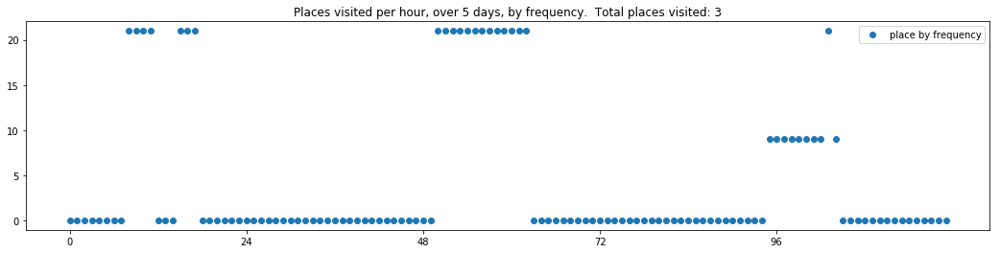

----- vector ----
prefix labels:  [423, 423]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 420, 0, 0, 0, 54, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 423, 423, 423, 423, 423, 423, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 423, 423, 0, 0, 0, 0, 0, 0, 423, 423, 388]


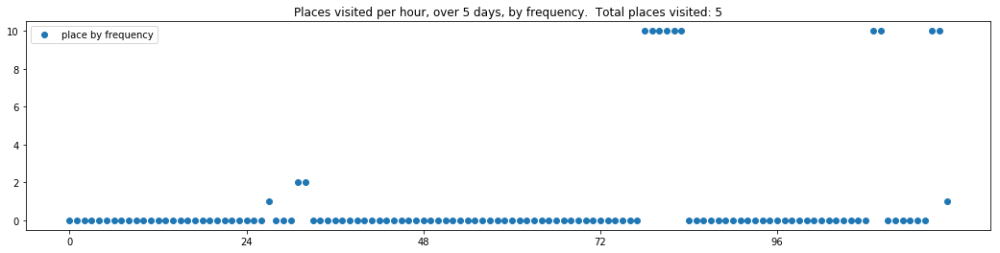

----- vector ----
prefix labels:  [214, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[72, 72, 72, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214]
[214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 72, 214, 214, 214]
[214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


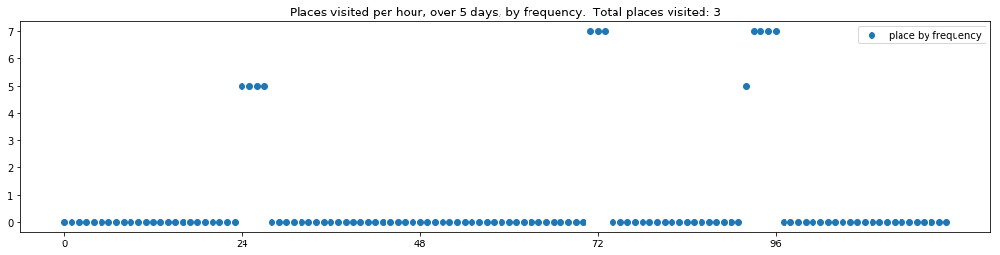

----- vector ----
prefix labels:  [246, 246]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]
[246, 48, 48, 48, 48, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]
[246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 109, 109, 109, 109, 109, 246, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 109, 108, 108, 108, 0, 109, 109, 109, 109, 0, 0, 48, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]
[246, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0]


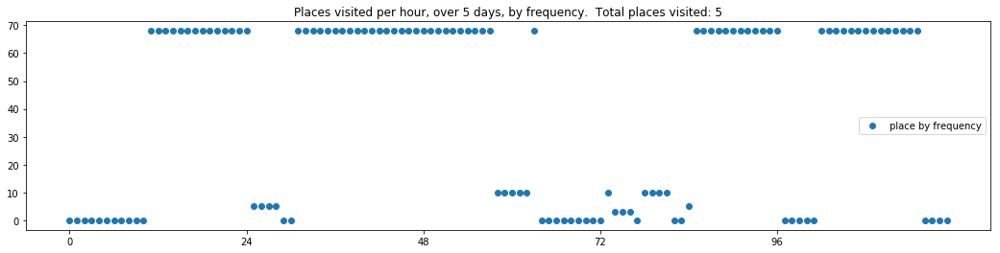

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 399, 22]
[22, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 0, 69, 69, 69, 69, 69, 69, 69]


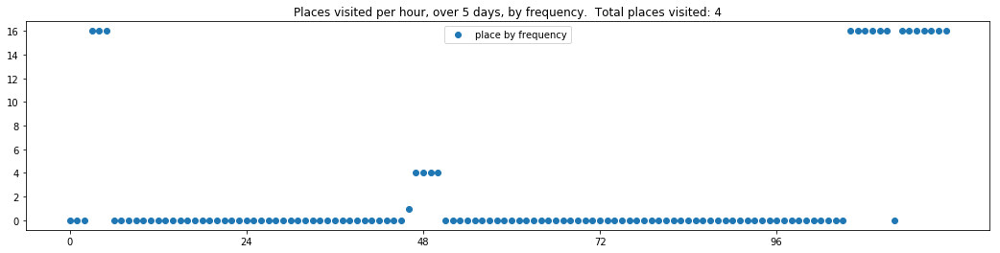

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 225, 225, 225, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


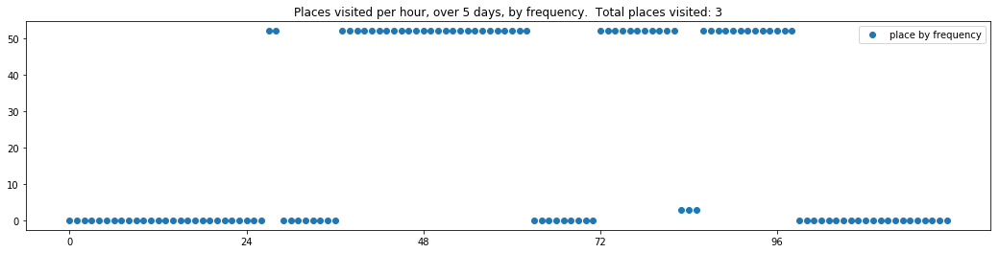

----- vector ----
prefix labels:  [137, 137]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 137, 137, 71, 71, 0, 0, 0, 0, 0, 0, 137, 33, 33]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 593, 410, 410, 410, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105]
[105, 105, 105, 105, 105, 105, 105, 411, 0, 0, 348, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34]


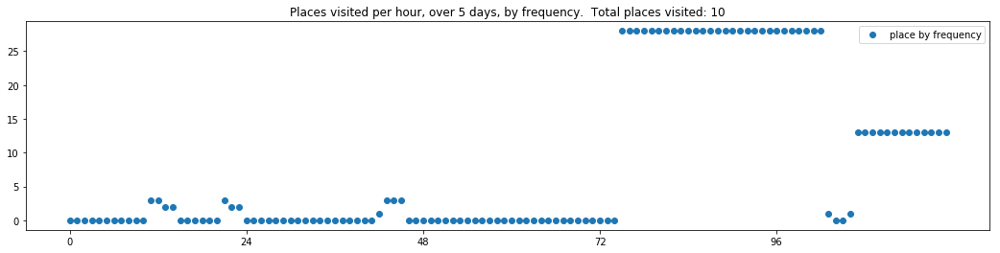

----- vector ----
prefix labels:  [141, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 141, 141, 141, 141, 141, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 216, 216, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


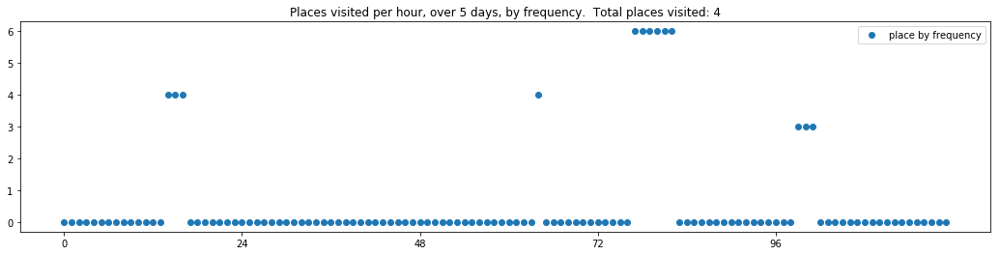

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 0, 0, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 21, 0]


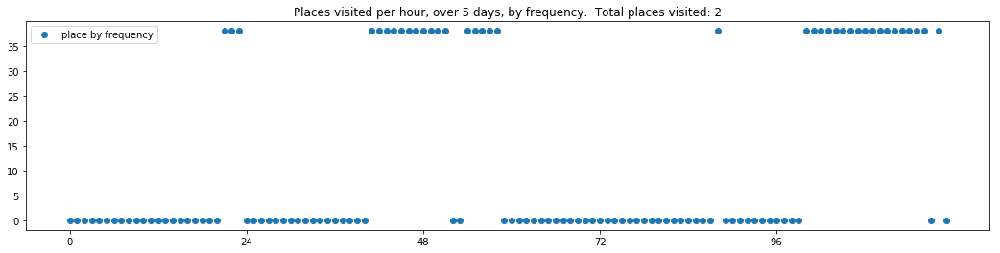

----- vector ----
prefix labels:  [21, 287]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 275, 30, 334, 334, 334, 334, 334]
[330, 330, 330, 0, 0, 0, 0, 248, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 36, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 319, 0, 0, 0, 0, 0, 0, 439, 439, 439, 439, 439, 439, 439, 439, 439, 439, 439]
[439, 439, 439, 439, 439, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 54, 0, 0, 0, 0, 0]
[0, 0, 0, 334, 334, 0, 0, 439, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0]


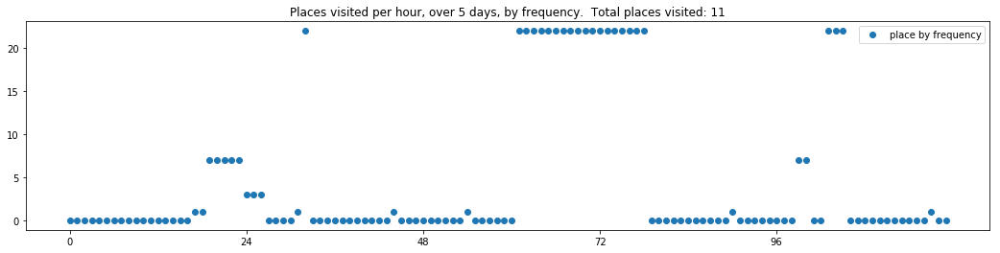

----- vector ----
prefix labels:  [219, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


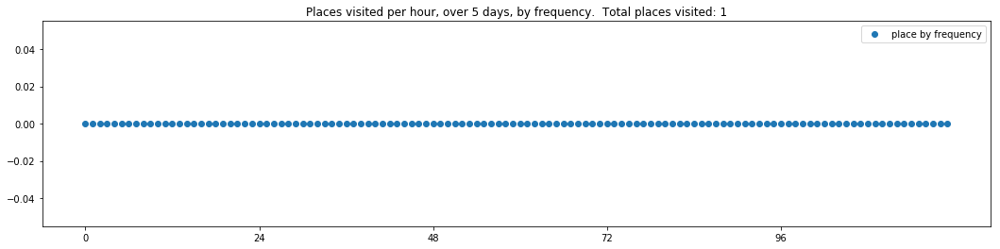

----- vector ----
prefix labels:  [192, 192]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[0, 192, 192, 0, 0, 0, 0, 0, 0, 192, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 192, 192, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 0, 0, 0]
[0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


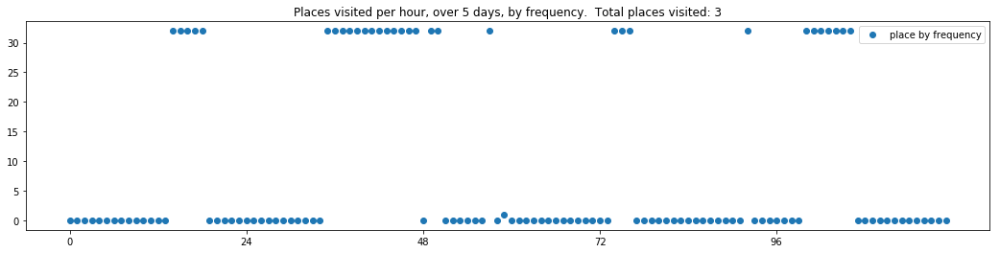

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4]
[4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 93, 93, 93, 93, 93, 93, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 93, 4, 4, 93, 93, 93, 93, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


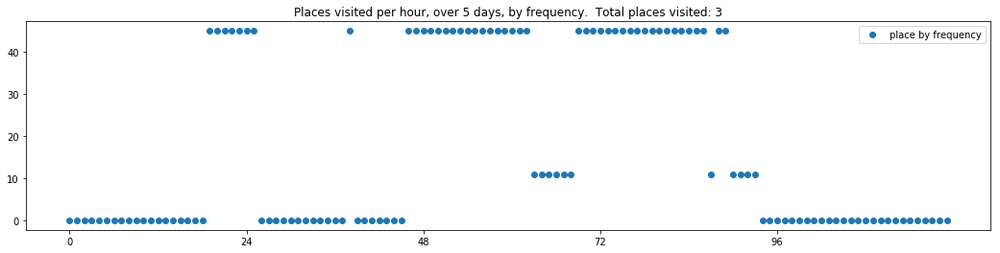

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 21]
[21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0]
[0, 20, 417, 417, 417, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


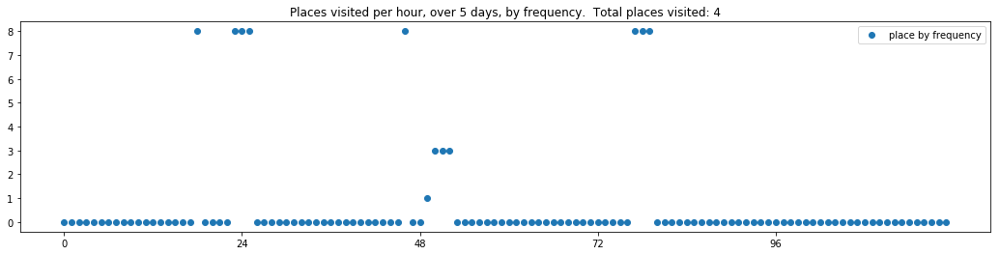

----- vector ----
prefix labels:  [597, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 597, 597, 597, 26, 26, 26, 0, 0, 0, 0, 200, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 597, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 20, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


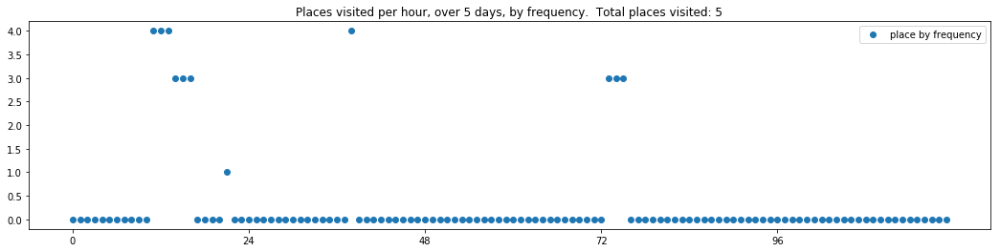

----- vector ----
prefix labels:  [278, 22]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 278, 278, 278, 278, 278, 2, 2, 0, 20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


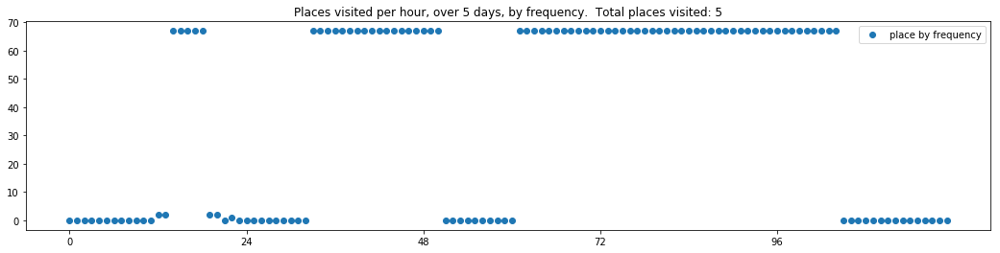

----- vector ----
prefix labels:  [267, 267]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 0, 591, 591, 591, 323, 323, 323, 323, 225, 323, 0, 0, 0, 0, 0, 0, 87, 88, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 107, 0, 0, 0, 0, 346, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 158]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 93]
[528, 528, 528, 528, 528, 528, 528, 528, 528, 528, 528, 528, 527, 527, 0, 0, 0, 0, 357, 357, 0, 0, 0, 528]


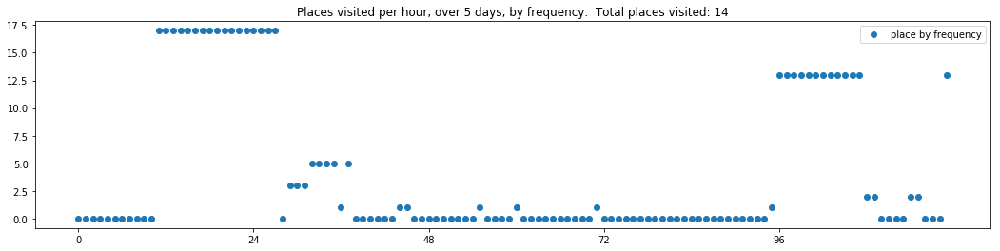

----- vector ----
prefix labels:  [444, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 404, 404, 404, 404, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 444, 444, 444, 444, 444, 444, 444, 444, 444, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


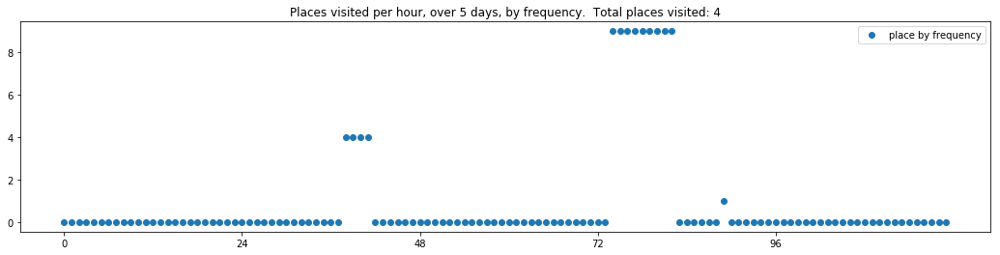

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 0, 0, 0, 0]
[0, 112, 112, 112, 0, 0, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205]
[205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 303, 205, 205, 205]
[205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


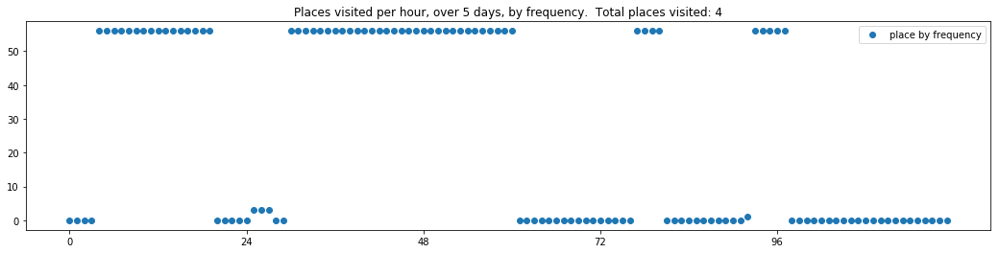

----- vector ----
prefix labels:  [526, 526]
[0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 0, 0, 0, 0, 0, 20, 20, 20, 20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 76, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 527, 527, 527, 527, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


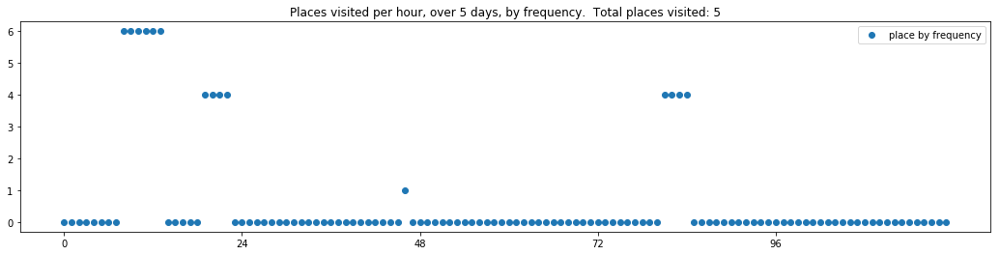

----- vector ----
prefix labels:  [558, 558]
[0, 0, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558]
[558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 558, 0, 558, 558, 558, 558]
[558, 558, 558, 558, 558, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


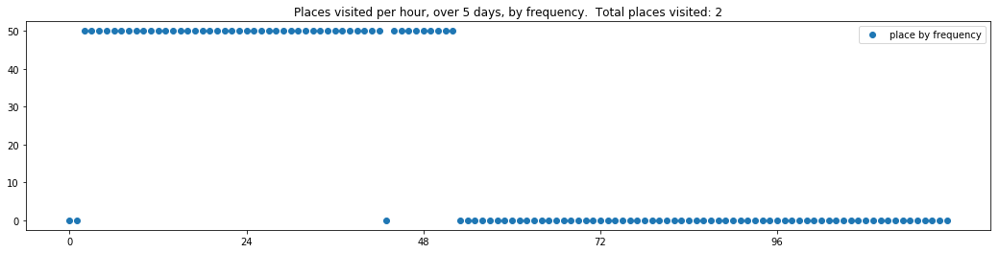

----- vector ----
prefix labels:  [212, 212]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 0, 0]


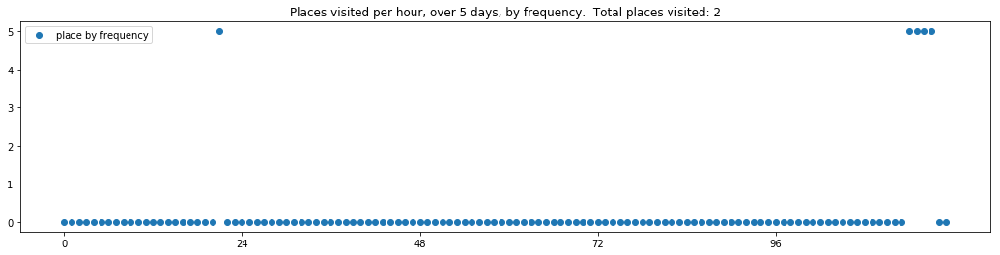

----- vector ----
prefix labels:  [132, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 200, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[496, 0, 462, 462, 462, 462, 462, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 87, 0, 462, 0, 0, 0, 0, 87, 87, 87, 0, 0, 0, 0, 559, 0, 0, 87, 87, 4, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 220, 220, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


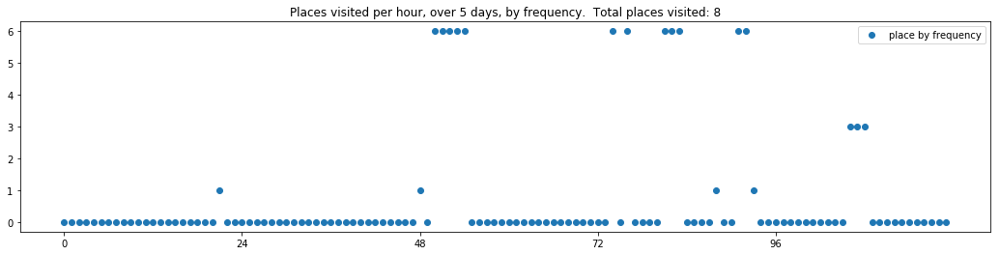

----- vector ----
prefix labels:  [304, 304]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 0, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304]
[0, 0, 0, 0, 0, 304, 296, 0, 0, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[0, 304, 304, 304, 304, 0, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


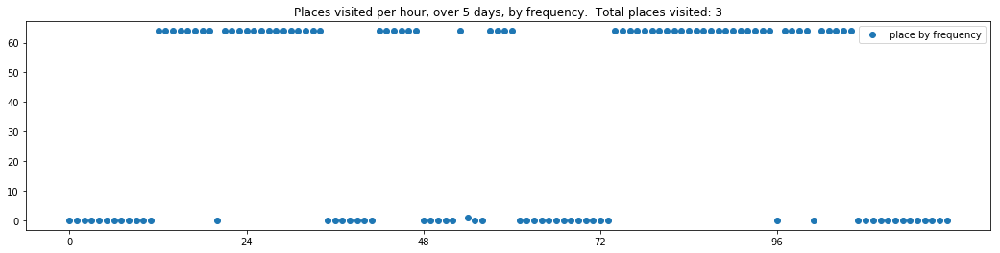

----- vector ----
prefix labels:  [544, 333]
[334, 0, 0, 0, 221, 221, 450, 0, 0, 0, 0, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


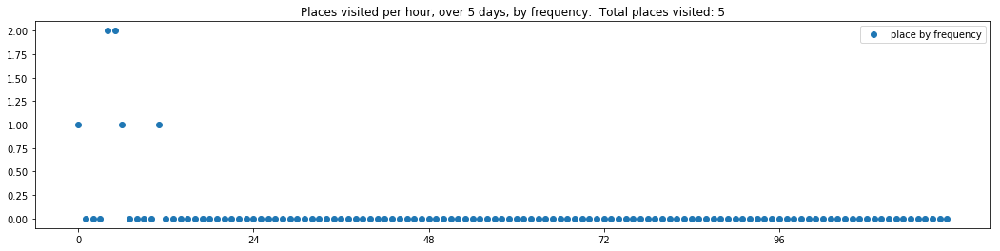

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 20, 20, 0, 33, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 269, 269, 269, 269, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 20, 20, 20, 20, 20]
[20, 0, 20, 20, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


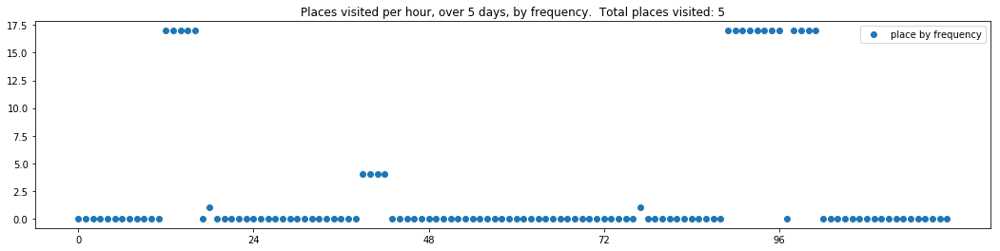


------
 15 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_15.txt 
------

----- vector ----
prefix labels:  [507, 488]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 568, 0, 0, 0, 235, 235, 541, 541, 541, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 45, 45, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 0, 0, 507]
[492, 492, 492, 0, 507, 507, 507, 507, 568, 568, 568, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 286, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 507, 507, 507, 507, 488, 488]


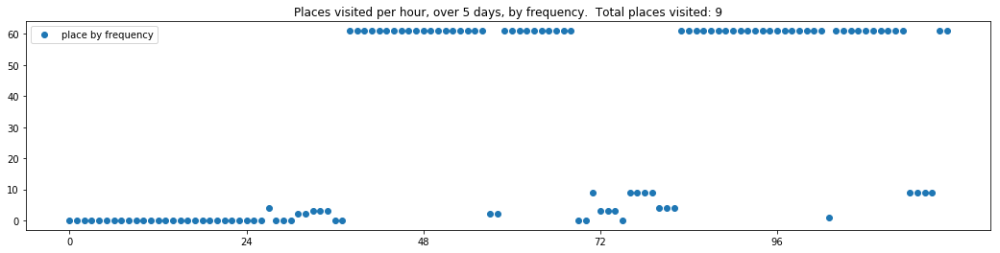

----- vector ----
prefix labels:  [190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 392, 392, 392]
[392, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 0, 485, 485, 485, 382, 0, 0, 0, 0, 0, 0, 0, 0, 0]


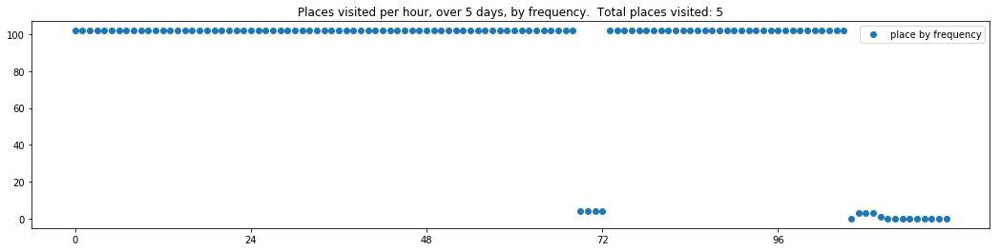

----- vector ----
prefix labels:  [78, 20]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 406, 406, 406, 406]
[406, 406, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


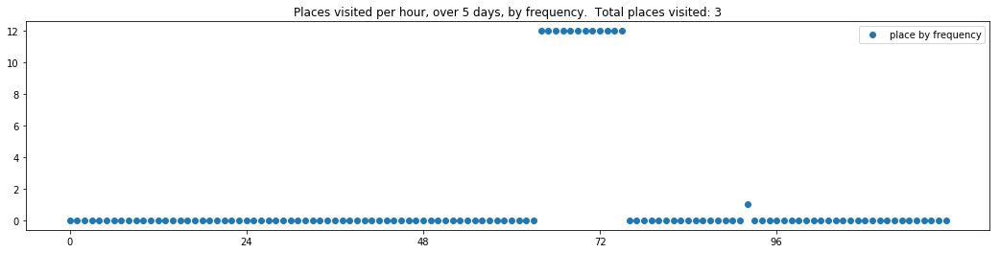

----- vector ----
prefix labels:  [448, 480]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 284, 284, 284, 0, 0, 0, 65, 65, 0, 0, 0, 0, 0, 0, 0, 640, 640, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 0, 0, 0, 0, 0, 0, 0, 0, 0, 640, 640, 640]
[640, 640, 640, 0, 0, 0, 0, 640, 640, 640, 0, 0, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640]


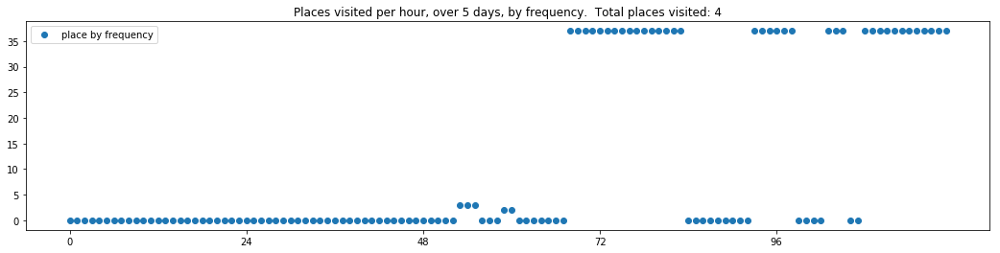

----- vector ----
prefix labels:  [39, 39]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 39, 39, 187, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39]
[39, 39, 39, 39, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]


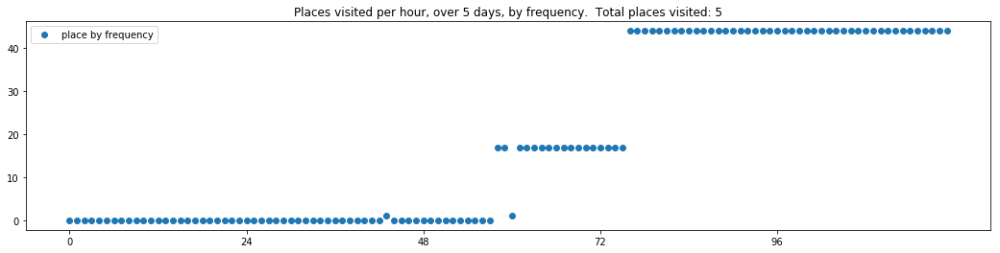

----- vector ----
prefix labels:  [357, 357]
[0, 357, 357, 357, 372, 0, 357, 357, 357, 357, 357, 357, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 400, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0]


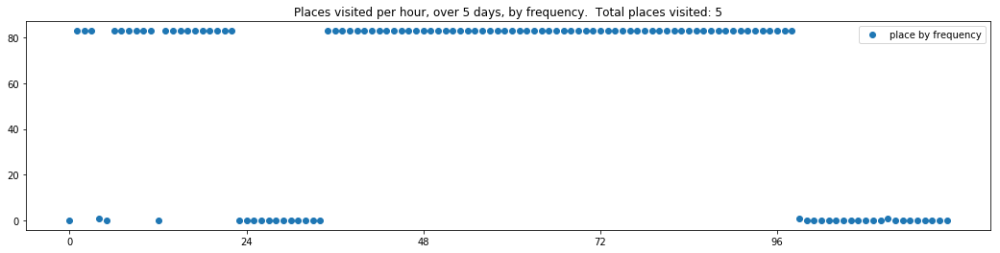

----- vector ----
prefix labels:  [237, 237]
[0, 0, 0, 487, 0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 502, 502, 502, 502, 502, 0, 108, 0, 502]
[502, 502, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 0, 0, 0, 0, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 0, 46]


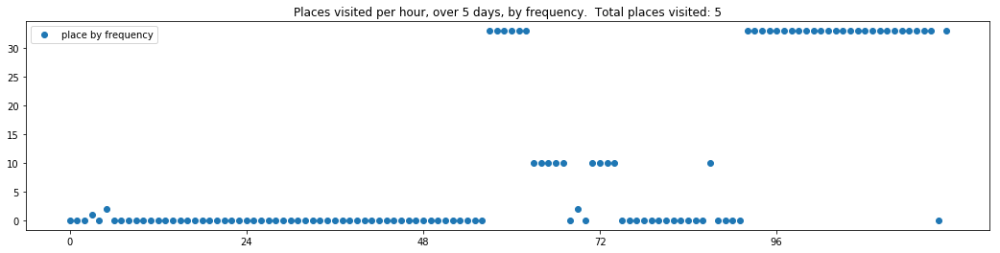

----- vector ----
prefix labels:  [368, 636]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 0, 0, 0, 209, 209, 636, 636, 636, 636]
[636, 636, 429, 429, 0, 429, 429, 429, 334, 334, 334, 57, 57, 57, 57, 0, 0, 0, 0, 0, 0, 0, 8, 8]
[276, 276, 276, 276, 276, 276, 276, 160, 218, 122, 122, 400, 400, 400, 209, 209, 209, 457, 209, 458, 458, 209, 209, 209]
[209, 0, 0, 0, 636, 636, 636, 636, 636, 636, 636, 636, 636, 506, 636, 636, 636, 636, 636, 636, 636, 636, 636, 0]


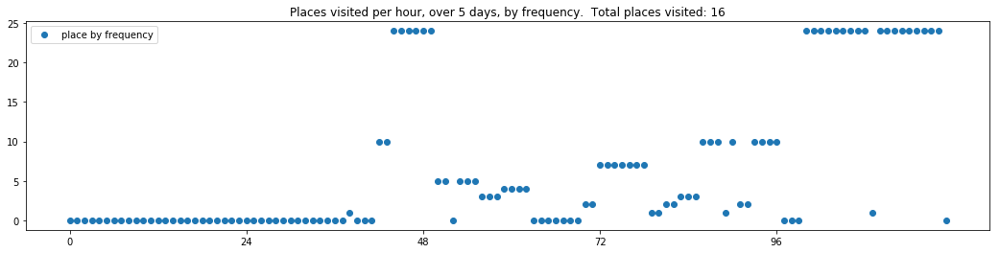

----- vector ----
prefix labels:  [604, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 604, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 244, 244, 0, 0, 0, 0, 0, 187]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[187, 604, 604, 604, 0, 0, 0, 0, 0, 0, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 0, 0, 0]


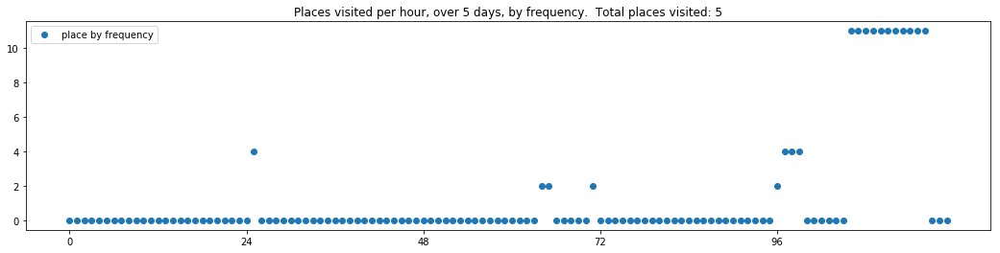

----- vector ----
prefix labels:  [268, 268]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 0, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 21, 21, 21, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 0, 268, 268, 268, 268, 268]
[268, 268, 268, 0, 0, 0, 0, 0, 0, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 503, 503]


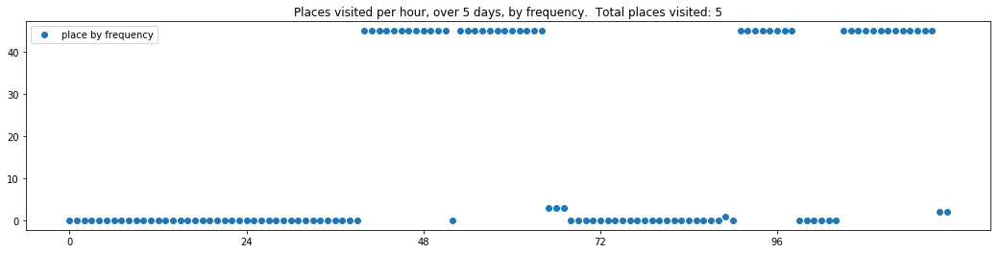

----- vector ----
prefix labels:  [271, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 231, 98, 98, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 254, 140, 271, 58, 58, 0]


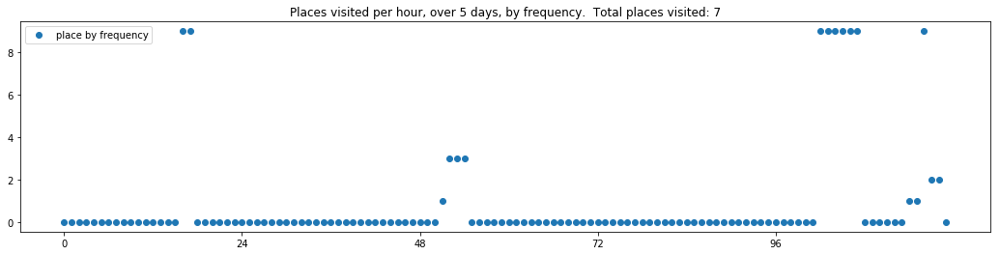

----- vector ----
prefix labels:  [431, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 385, 385, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 431, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 0, 0, 0, 0]


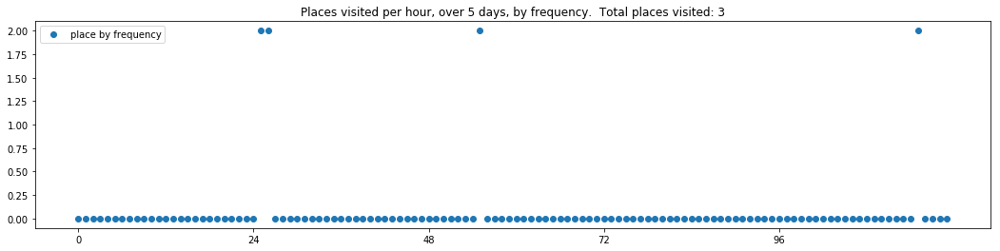

----- vector ----
prefix labels:  [578, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 401, 401, 0, 0, 35, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


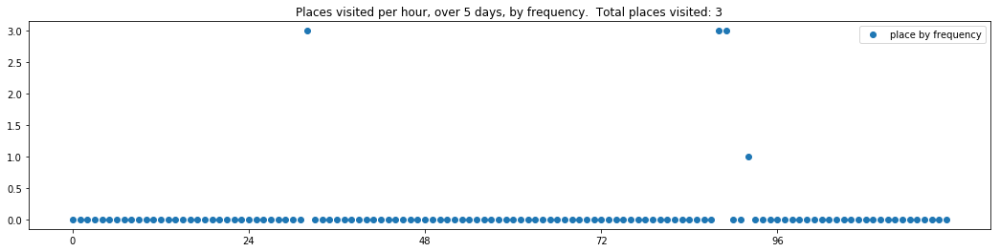

----- vector ----
prefix labels:  [410, 410]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 410, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 0, 0, 0, 0, 0, 410, 0, 0]
[410, 410, 410, 410, 410, 271, 22, 0, 0, 410, 410, 410, 0, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410]
[410, 410, 410, 410, 410, 410, 410, 410, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 410]
[410, 410, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 410, 410, 410, 410, 410, 410, 0, 0]


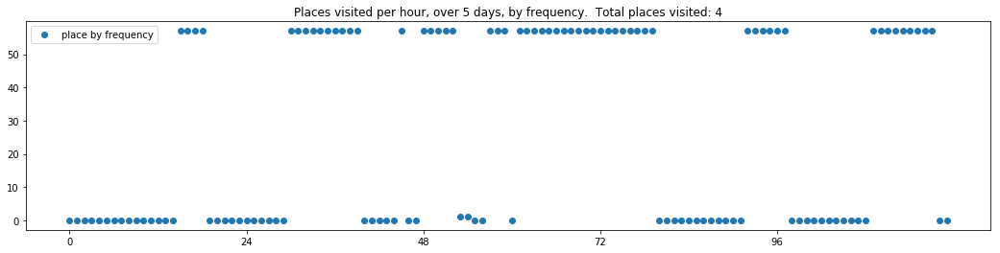

----- vector ----
prefix labels:  [21, 374]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 98, 98, 98, 98, 0, 0, 0]
[0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 291, 291, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21]
[21, 21, 21, 169, 169, 0, 0, 0, 87, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


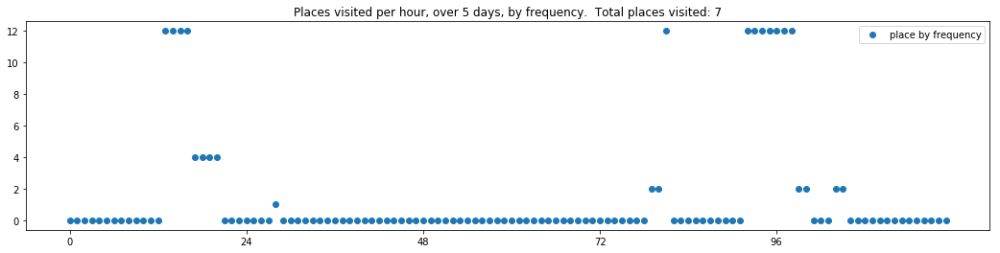

----- vector ----
prefix labels:  [449, 358]
[0, 0, 0, 0, 0, 0, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 216, 216, 204, 0, 0, 0]
[0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 370, 371, 371, 371, 371, 371, 371, 215, 145, 0, 0, 0]
[21, 263, 204, 204, 204, 204, 0, 0, 138, 38, 38, 38, 71, 71, 71, 71, 71, 71, 0, 0, 0, 186, 186, 186]
[186, 186, 186, 370, 370, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]


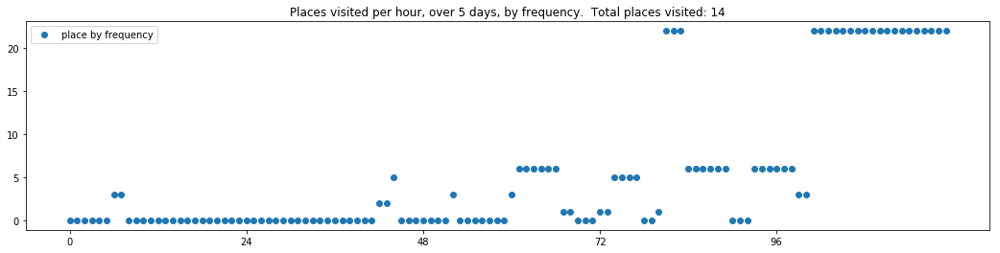

----- vector ----
prefix labels:  [487, 24]
[0, 0, 0, 0, 0, 0, 0, 24, 24, 24, 0, 487, 487, 487, 487, 487, 487, 487, 487, 125, 125, 126, 125, 125]
[125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 487, 487, 487, 487, 487, 487, 487, 487, 487, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[168, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 333, 125, 125, 125, 125, 125]
[125, 125, 0, 0, 0, 0, 0, 0, 24, 24, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125]


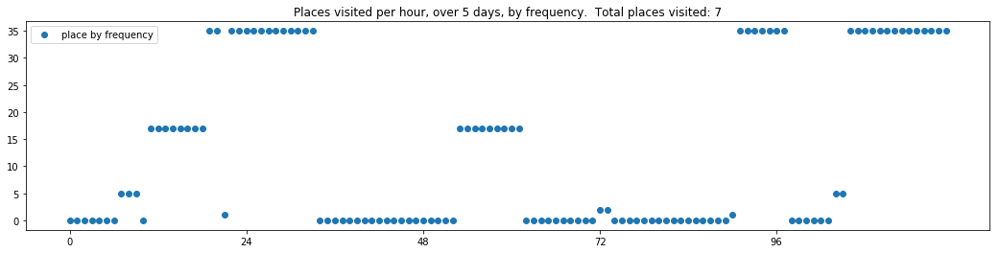

----- vector ----
prefix labels:  [425, 184]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 183, 184, 184, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 227, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


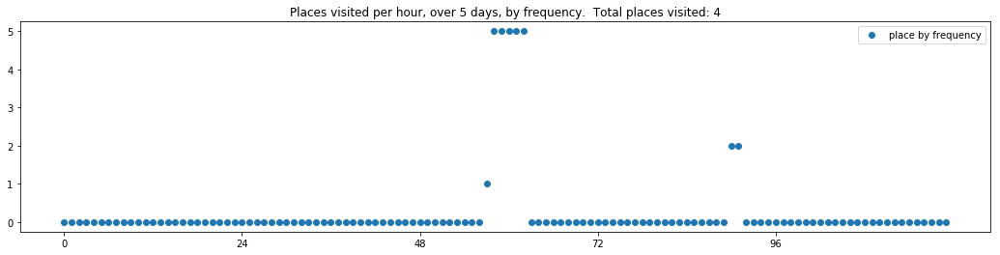

----- vector ----
prefix labels:  [194, 0]
[0, 0, 0, 0, 0, 0, 194, 194, 194, 194, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 194, 194, 0, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 194, 194, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


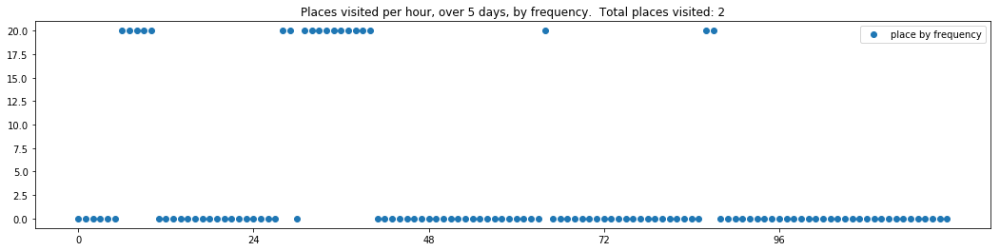

----- vector ----
prefix labels:  [44, 142]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 0, 0, 0, 0]
[0, 0, 0, 0, 216, 142, 142, 142, 142, 0, 0, 162, 162, 557, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 7, 7, 7, 7, 204]
[204, 500, 500, 27, 0, 0, 0, 0, 0, 214, 214, 214, 434, 8, 8, 0, 0, 0, 0, 0, 231, 216, 0, 434]
[353, 352, 352, 352, 352, 581, 581, 581, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 203, 203, 533, 0, 0, 0]


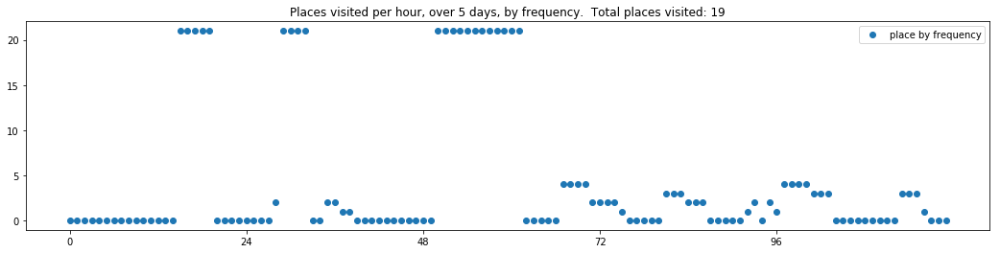

----- vector ----
prefix labels:  [574, 574]
[0, 0, 0, 0, 0, 98, 0, 574, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21]
[21, 0, 0, 0, 20, 0, 439, 439, 439, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 0, 0]
[0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0, 0, 242, 242, 242, 132, 132, 564]


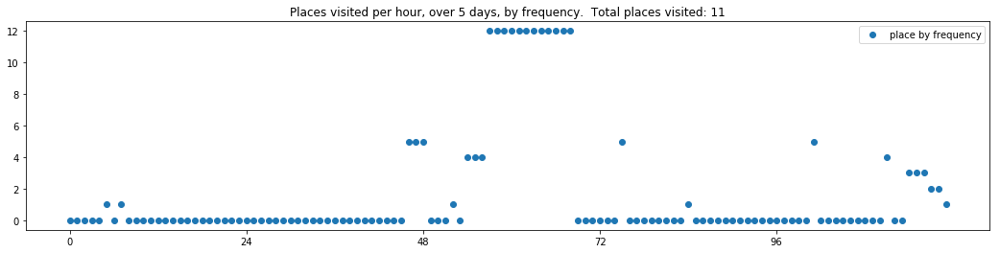

----- vector ----
prefix labels:  [605, 605]
[0, 0, 0, 605, 487, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 605, 0, 626, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 24, 24, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


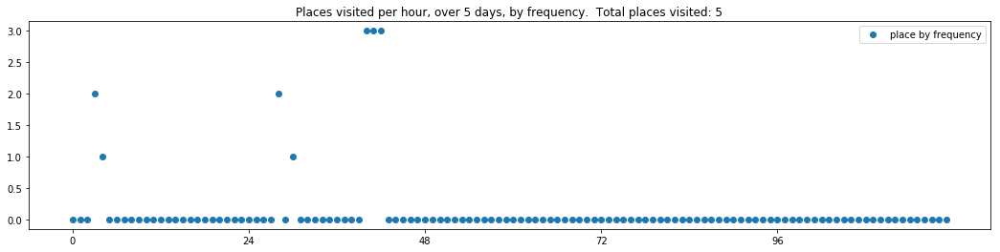

----- vector ----
prefix labels:  [401, 401]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 231, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 248, 0, 0, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 401, 401, 0, 0, 401, 401, 401, 401, 401, 401, 401, 401, 0, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 401, 401, 401, 401, 401, 80, 80, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]


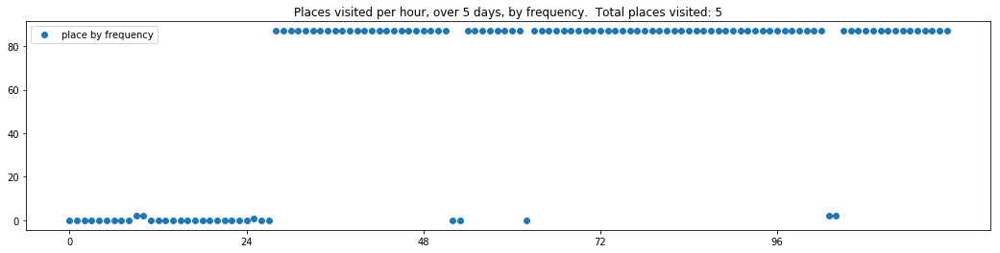

----- vector ----
prefix labels:  [462, 462]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 390, 390, 390]
[390, 390, 390, 0, 0, 0, 390, 390, 390, 0, 0, 462, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 311, 311, 0, 311, 311, 311, 0, 0, 390, 390, 390, 390, 390, 390, 0, 390, 390, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 390, 0, 0, 0]


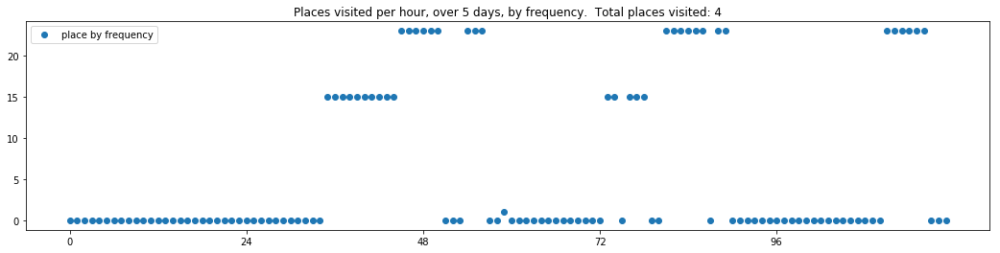

----- vector ----
prefix labels:  [69, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 69, 0, 0, 0, 0, 0, 0, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


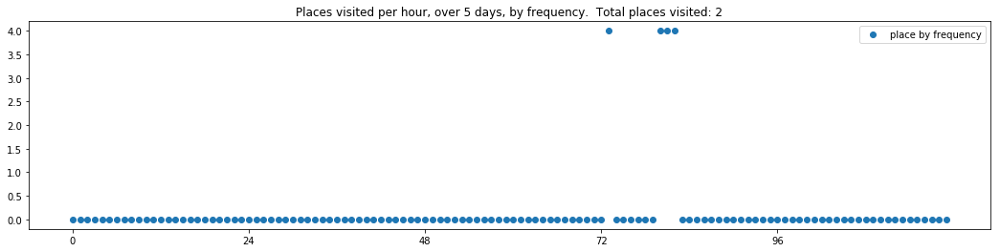

----- vector ----
prefix labels:  [26, 116]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 116, 116, 116, 0, 0, 0, 116]
[116, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 0, 116, 116, 116, 116, 116, 116, 116]
[116, 116, 116, 116, 116, 0, 0, 0, 0, 0, 0, 518, 213, 0, 0, 116, 116, 116, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 0, 0, 0]
[0, 221, 221, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 221, 221, 221, 221, 221, 221]


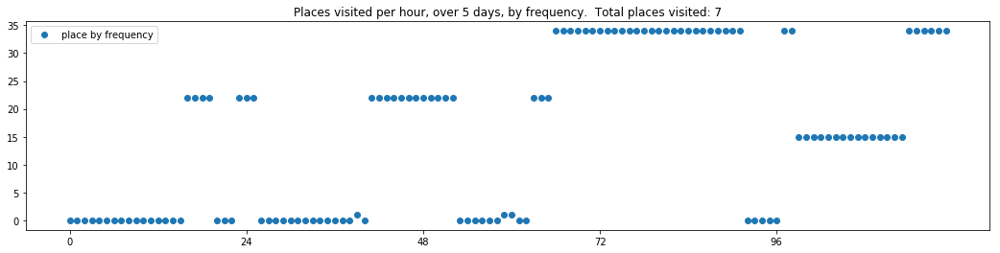

----- vector ----
prefix labels:  [65, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 65, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 65, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 65, 65]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


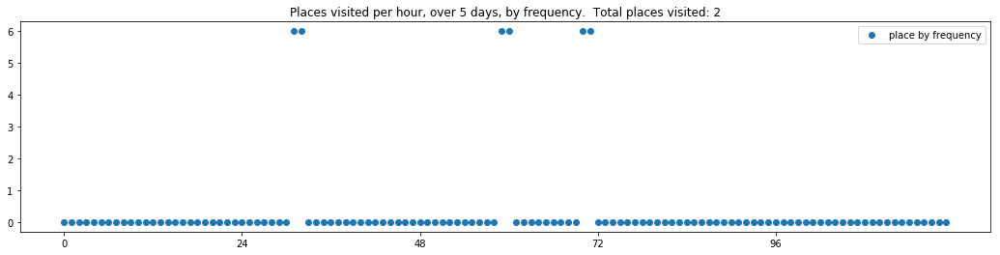

----- vector ----
prefix labels:  [242, 242]
[0, 0, 0, 0, 0, 0, 0, 0, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 239, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


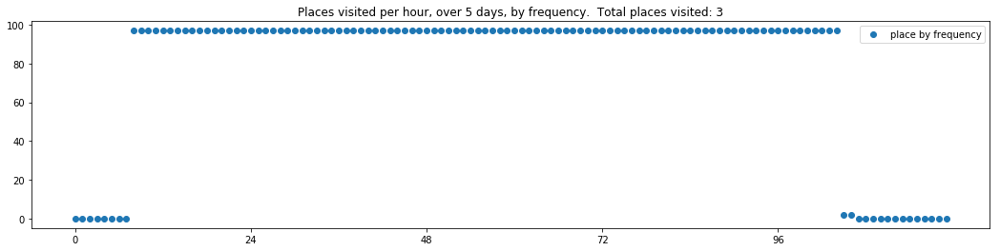

----- vector ----
prefix labels:  [235, 235]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 235, 235, 235, 235, 235, 235, 235, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235, 235]
[235, 235, 235, 235, 235, 235, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 448, 0, 0, 0, 0]


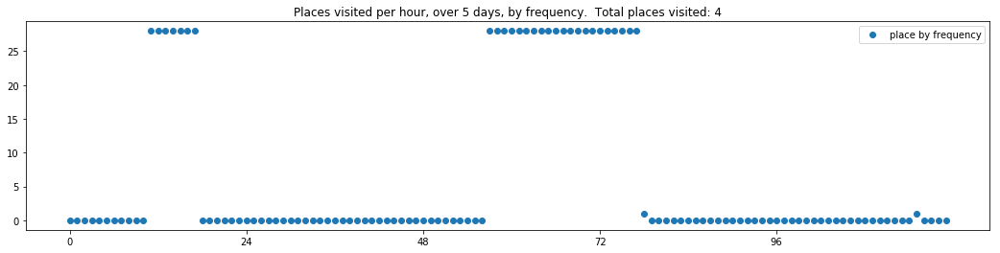

----- vector ----
prefix labels:  [431, 431]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 225, 225, 225, 225, 225, 225, 225, 225, 225]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 558, 385, 385, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 479, 0, 0, 0, 191, 191, 191, 191, 558, 558, 191, 191, 0, 0]


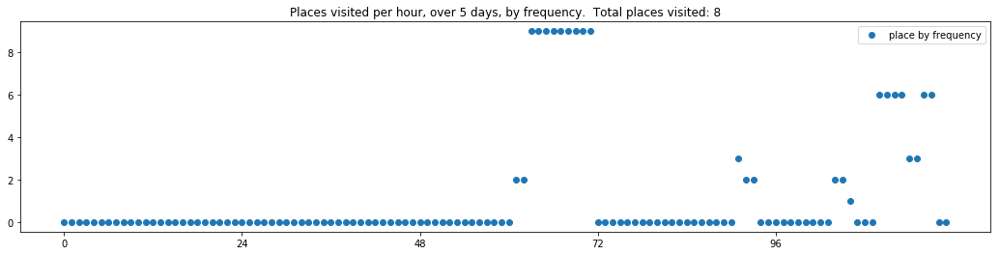

----- vector ----
prefix labels:  [358, 358]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 639, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 397, 0, 0, 0, 0, 0, 0, 0, 0, 341, 341, 344, 0, 0, 0, 0, 0, 0, 0]


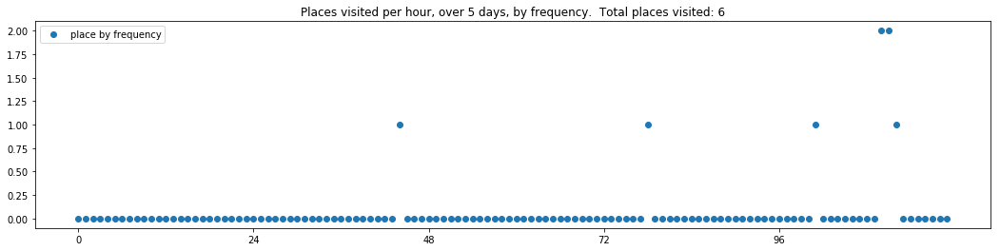

----- vector ----
prefix labels:  [339, 339]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 339, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


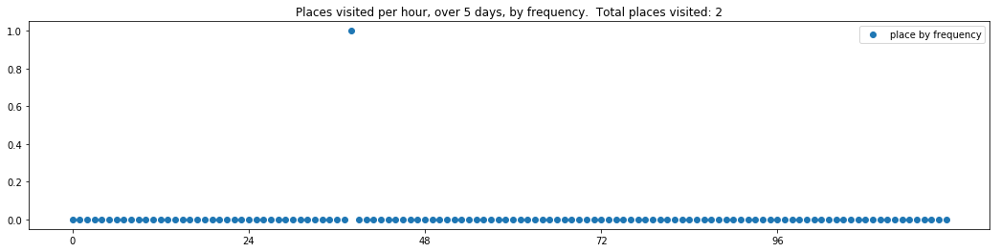

----- vector ----
prefix labels:  [54, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 54, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 439, 439, 439, 439, 439, 439, 439, 439, 0, 0, 0, 0, 0, 0, 385, 0]


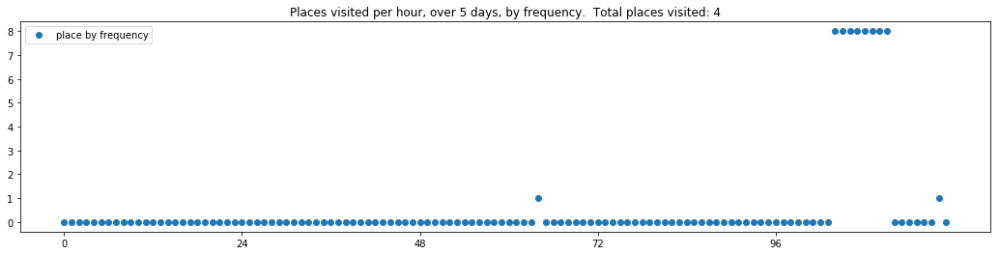

----- vector ----
prefix labels:  [134, 134]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 134, 134, 134, 134, 134, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134]


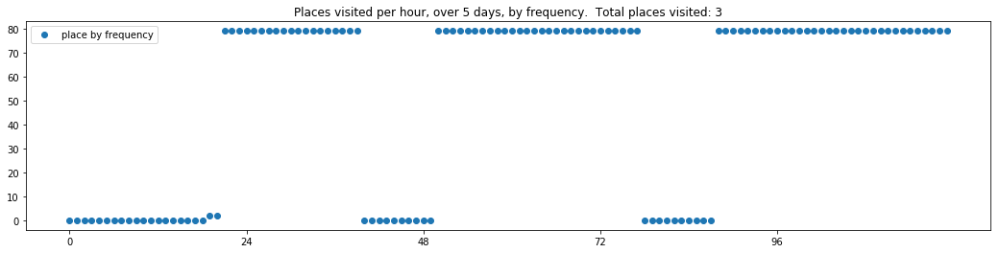

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392]


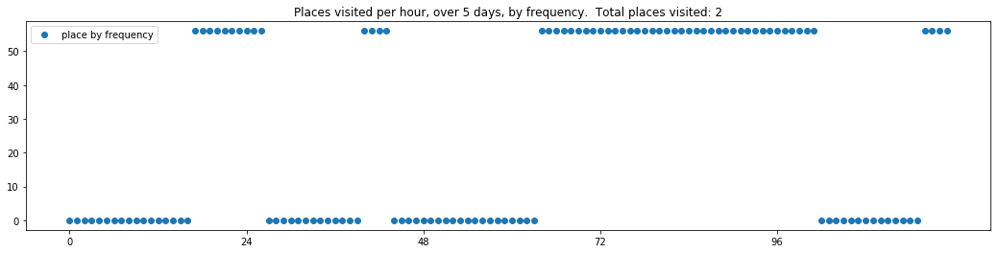

----- vector ----
prefix labels:  [628, 628]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628]
[628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628]
[628, 628, 628, 0, 0, 0, 0, 0, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628]
[628, 628, 628, 628, 0, 0, 0, 0, 0, 628, 628, 628, 0, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628, 628]
[628, 628, 628, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 461, 461, 461]


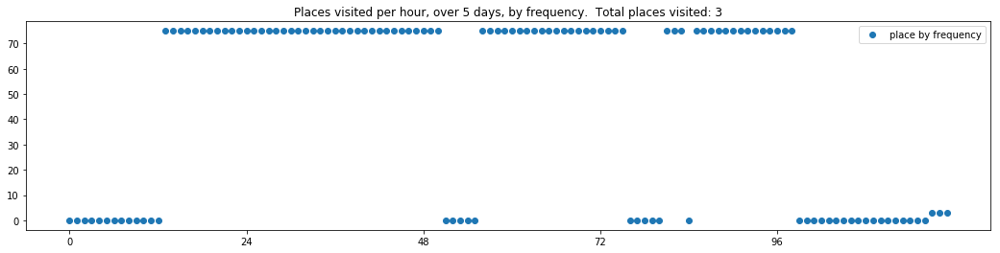

----- vector ----
prefix labels:  [572, 572]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 389, 389, 389, 389]
[389, 389, 389, 389, 205, 0, 54, 455, 455, 189, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 389, 455, 455, 455, 455]
[0, 389, 389, 389, 389, 520, 520, 520, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 520, 520, 520, 520, 520]
[520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520]


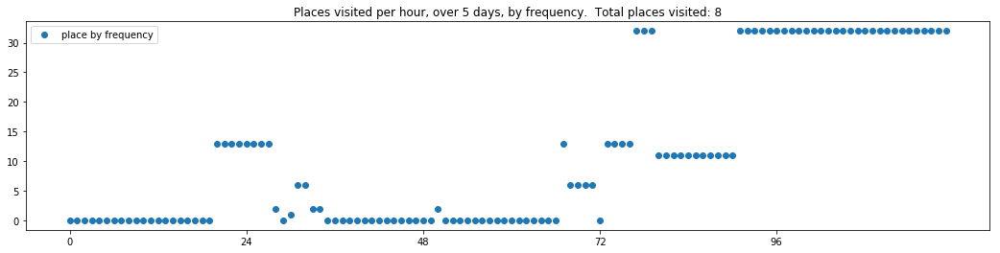

----- vector ----
prefix labels:  [10, 10]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


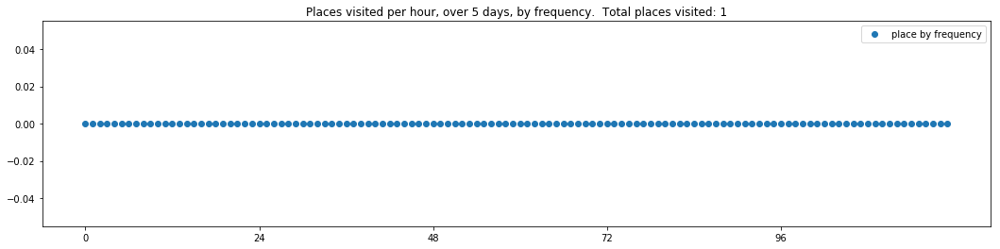

----- vector ----
prefix labels:  [515, 388]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 396, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]


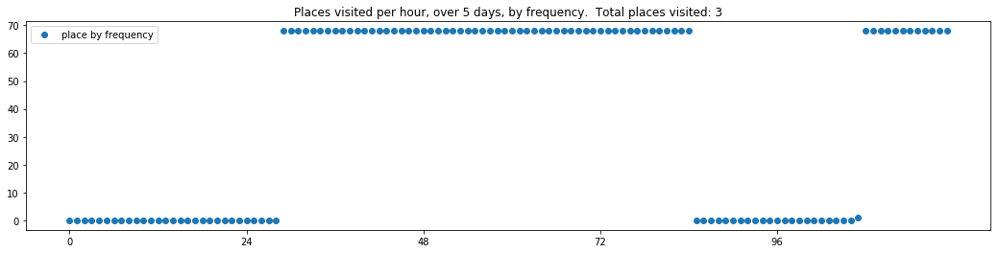

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 190, 190, 190, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0]
[0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 288, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 0, 0, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


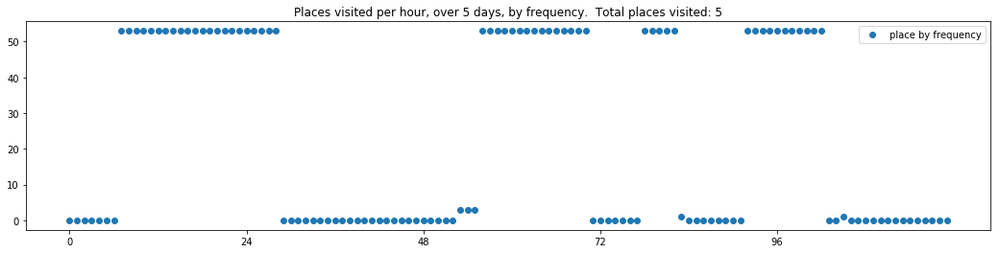

----- vector ----
prefix labels:  [87, 356]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 239, 239, 239, 239, 239, 239, 239, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 59, 410]
[0, 0, 0, 0, 0, 0, 0, 0, 314, 314, 314, 314, 314, 17, 17, 0, 0, 0, 0, 314, 314, 314, 314, 314]
[314, 0, 0, 0, 0, 0, 314, 314, 314, 314, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 314, 314]
[314, 314, 314, 314, 133, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 536, 0]


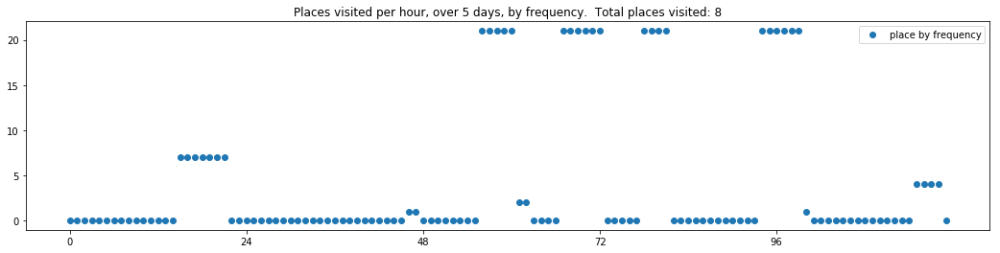

----- vector ----
prefix labels:  [386, 386]
[0, 0, 0, 0, 0, 0, 0, 0, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 386, 386, 386, 0, 0, 0, 0, 0, 0, 113, 0, 0, 0, 0, 0, 386, 386, 0, 386, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 252, 252, 0, 0, 0, 223, 0, 385]
[0, 0, 0, 0, 0, 0, 385, 385, 385, 385, 0, 0, 0, 0, 0, 181, 386, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 311, 311, 386, 386, 0, 0, 0, 0, 76, 76, 0, 0, 0, 0, 0, 0, 0]


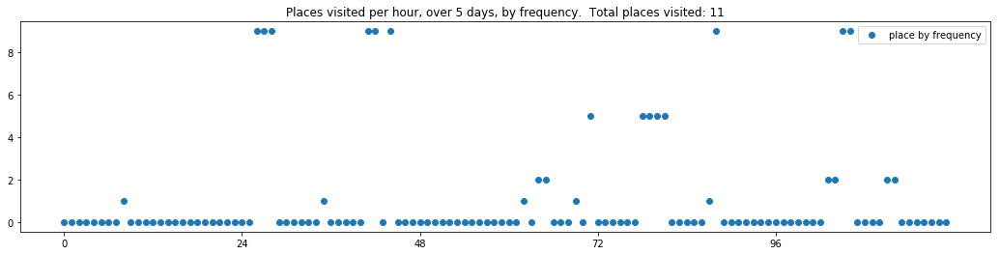

----- vector ----
prefix labels:  [459, 216]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 593, 593, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 216, 216, 0, 0, 0, 0]
[0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


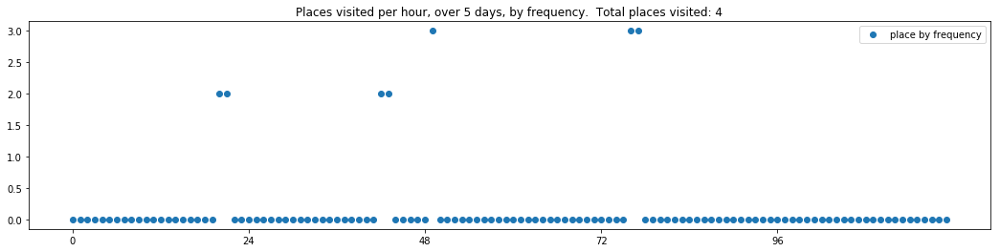

----- vector ----
prefix labels:  [295, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0]
[0, 0, 0, 69, 69, 0, 8, 8, 8, 8, 8, 8, 8, 8, 69, 69, 0, 0, 0, 0, 0, 0, 0, 69]
[69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 8, 8, 8, 8, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 483, 93, 93, 220, 0, 0]


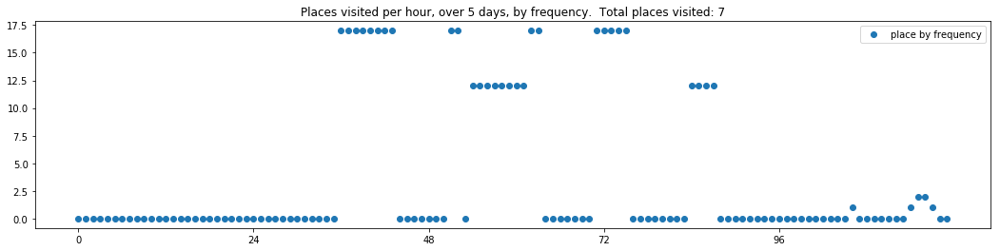

----- vector ----
prefix labels:  [65, 22]
[0, 0, 0, 162, 0, 65, 65, 65, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22]
[22, 22, 22, 22, 22, 22, 162, 22, 22, 22, 22, 22, 22, 162, 162, 65, 162, 162, 22, 22, 22, 22, 22, 22]
[22, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[65, 0, 0, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


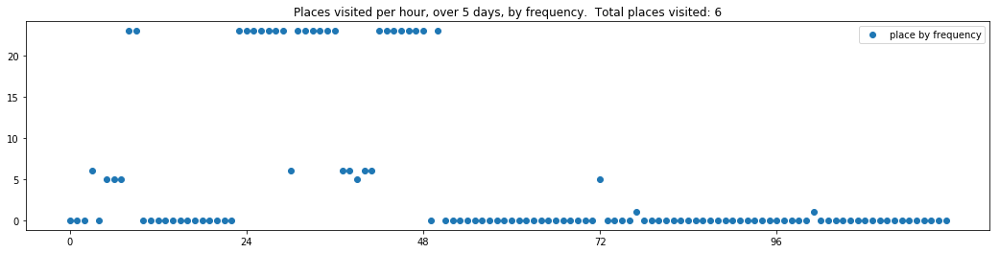

----- vector ----
prefix labels:  [90, 90]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 90, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 90, 90, 90]


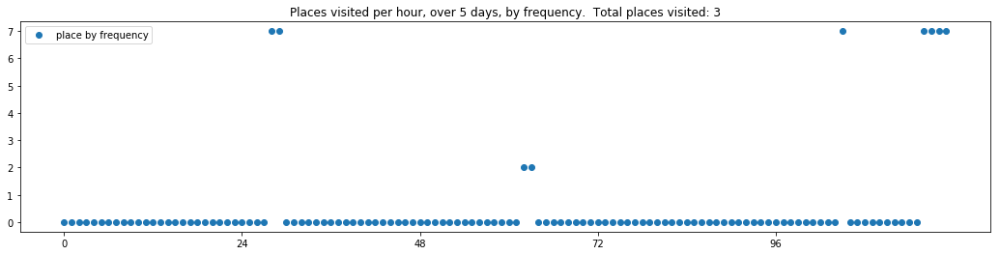

----- vector ----
prefix labels:  [420, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 473, 41, 78, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 221, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 221, 221, 133, 133, 133, 291, 291, 0, 0, 175, 395, 395, 395, 395, 395, 395, 395, 395, 395]


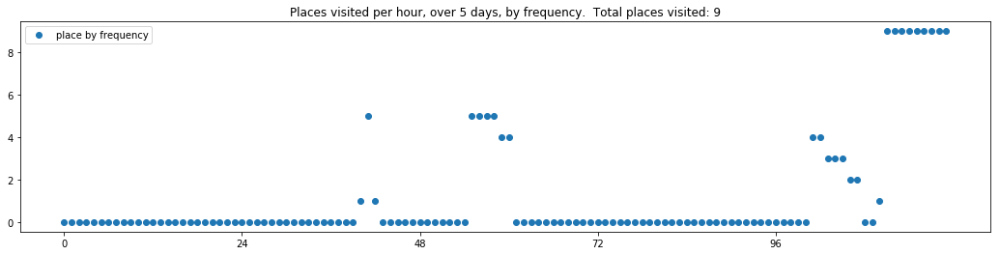

----- vector ----
prefix labels:  [142, 142]
[0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 142, 142, 142]
[142, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[0, 0, 0, 0, 0, 0, 142, 0, 0, 0, 0, 0, 0, 203, 203, 142, 142, 142, 142, 0, 0, 0, 0, 0]


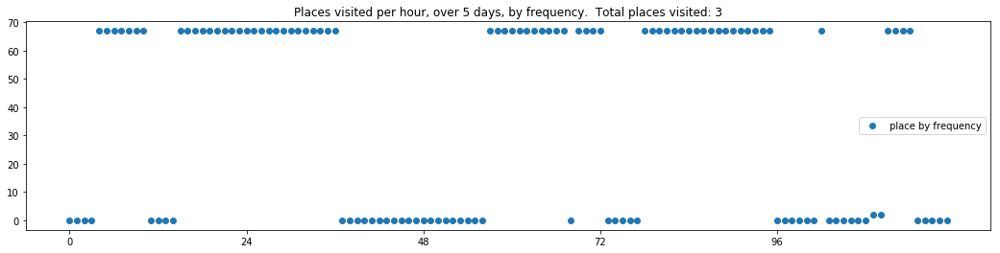

----- vector ----
prefix labels:  [78, 0]
[0, 0, 0, 0, 0, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 78, 78, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


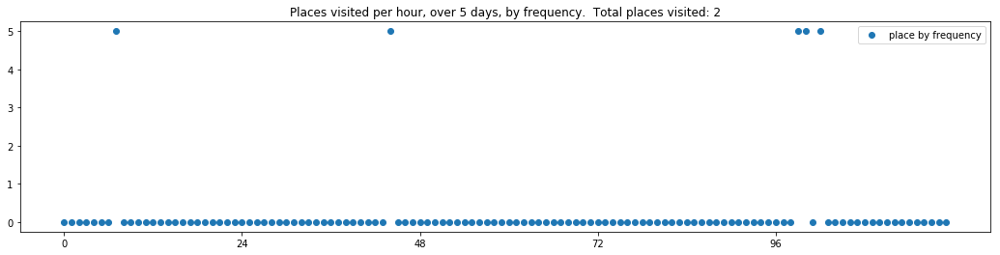

----- vector ----
prefix labels:  [53, 567]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 271, 271, 41, 41, 41, 41, 0, 0, 0, 0]


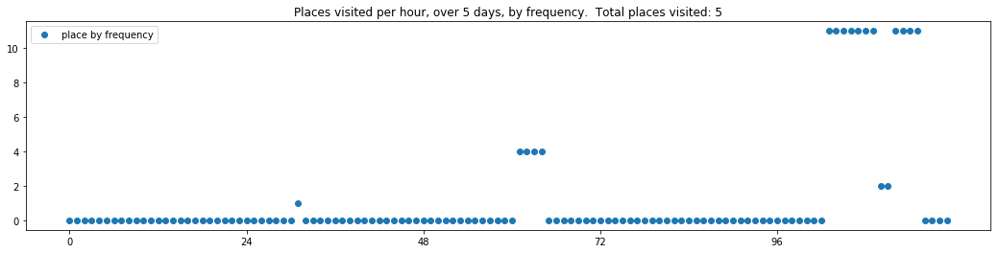


------
 20 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_20.txt 
------

----- vector ----
prefix labels:  [221, 221]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 221, 384, 384, 384, 384]
[221, 221, 0, 276, 364, 364, 364, 364, 364, 364, 364, 364, 364, 284, 93, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116]


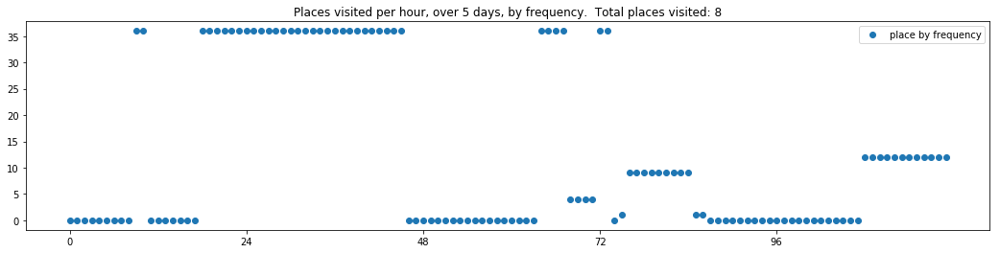

----- vector ----
prefix labels:  [76, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 76, 76, 0, 0, 0, 0, 0, 0, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


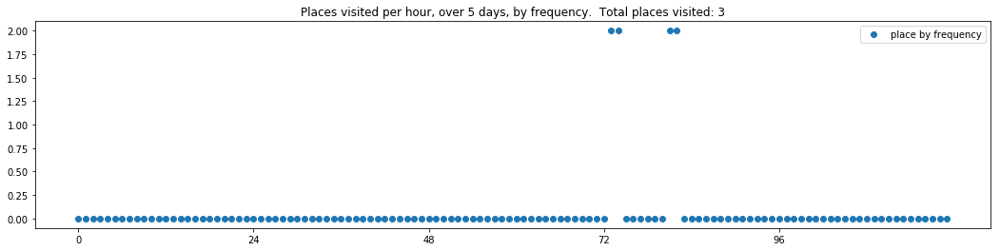

----- vector ----
prefix labels:  [167, 318]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 110, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562, 562, 562, 562, 562, 0]
[32, 0, 0, 562, 562, 562, 562, 0, 165, 0, 0, 562, 562, 562, 562, 0, 0, 0, 391, 391, 391, 391, 0, 0]


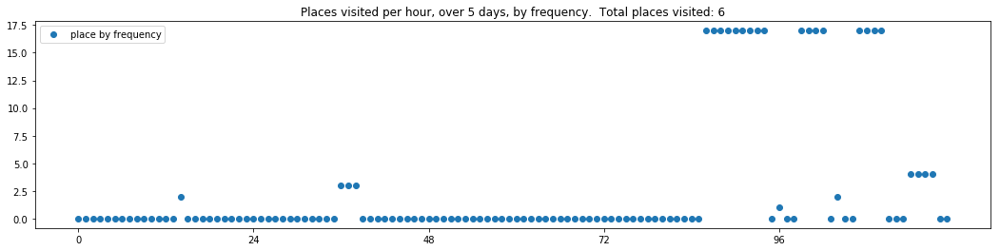

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 0, 0, 0, 0, 0, 0, 0]
[437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 259]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


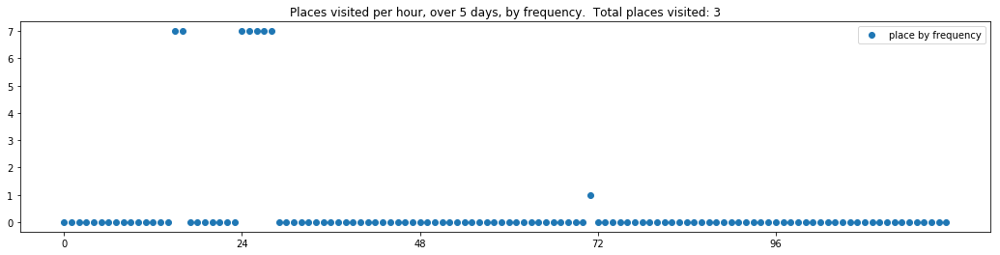

----- vector ----
prefix labels:  [415, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0]


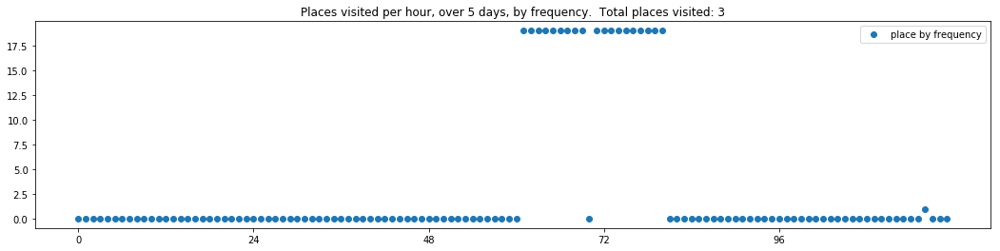

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 26, 0, 391, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


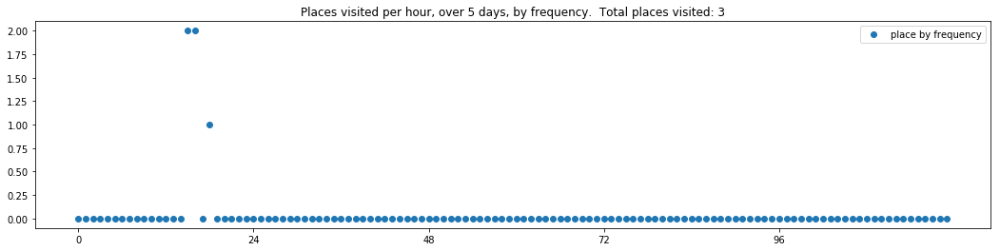

----- vector ----
prefix labels:  [163, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 163, 71, 71, 71, 71, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 0, 0, 0, 0, 0, 151, 151, 151, 71]
[0, 0, 0, 0, 0, 0, 0, 473, 0, 0, 0, 0, 0, 215, 0, 71, 71, 71, 71, 71, 0, 0, 0, 0]
[0, 0, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71]


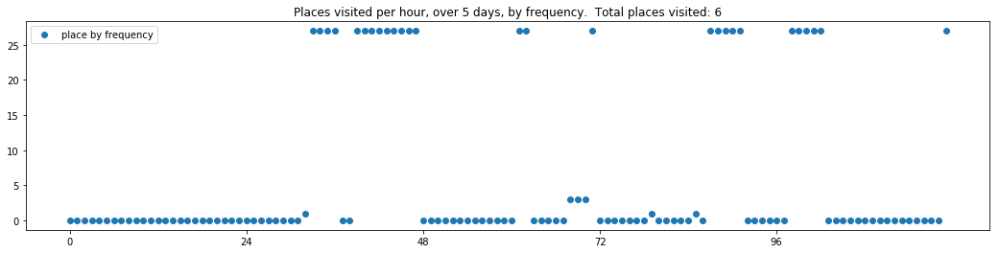

----- vector ----
prefix labels:  [76, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 0, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


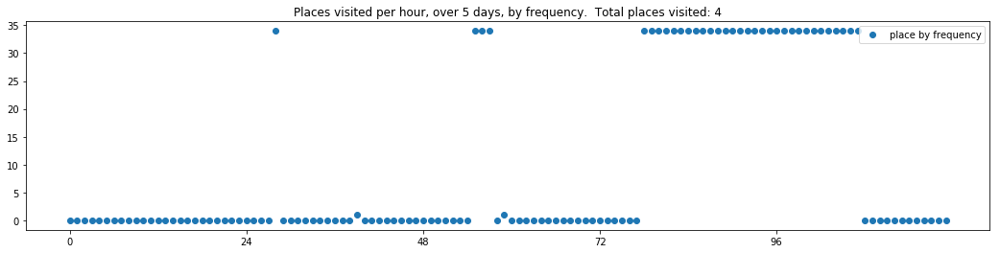

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 199, 199, 0, 0, 0, 0, 0]


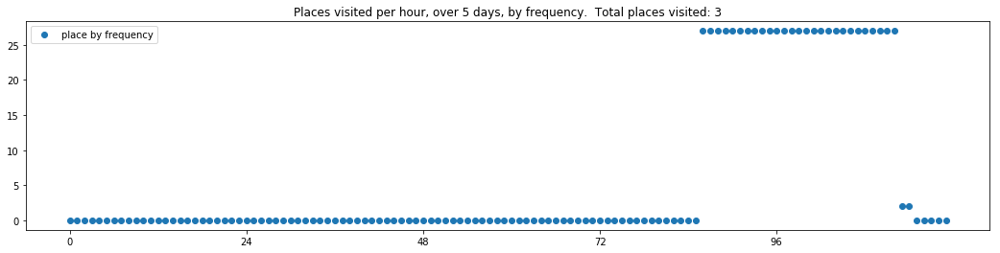

----- vector ----
prefix labels:  [605, 605]
[0, 0, 0, 0, 0, 524, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248]
[0, 0, 0, 0, 327, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 533]


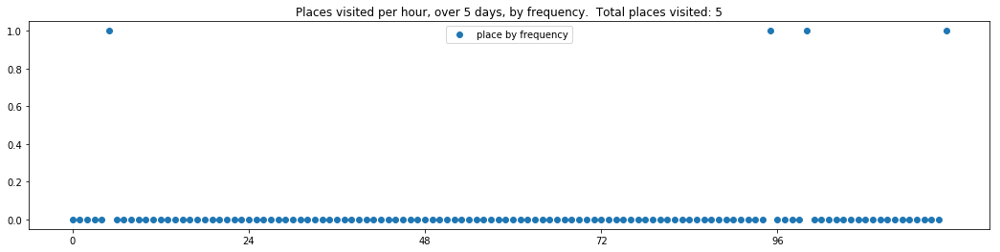

----- vector ----
prefix labels:  [388, 388]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


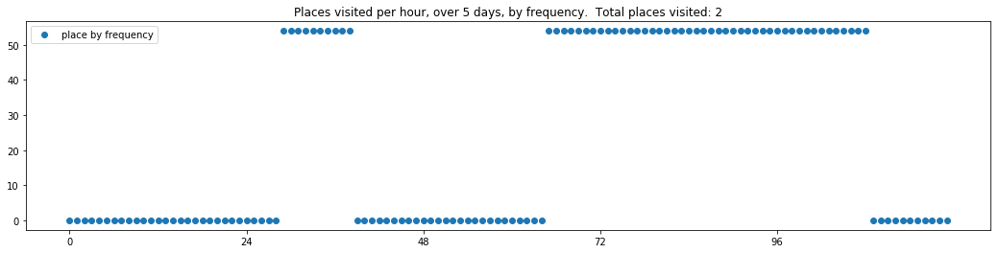

----- vector ----
prefix labels:  [2, 276]
[0, 0, 0, 0, 0, 0, 0, 276, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 252, 252, 252, 252, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 580, 0, 358, 276, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]


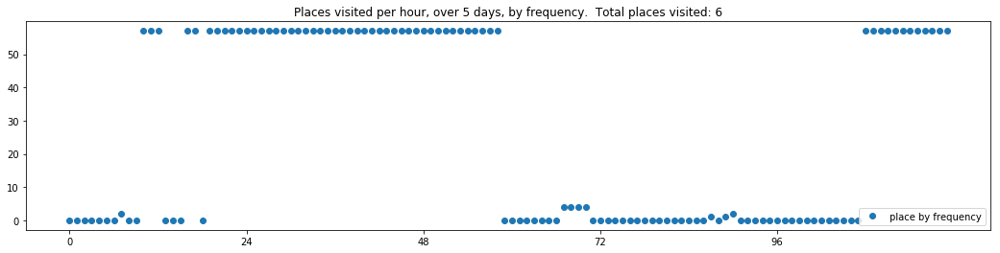

----- vector ----
prefix labels:  [559, 559]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 259]
[434, 0, 0, 559, 0, 0, 0, 0, 0, 0, 0, 0, 87, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 559]
[146, 146, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 559, 559]


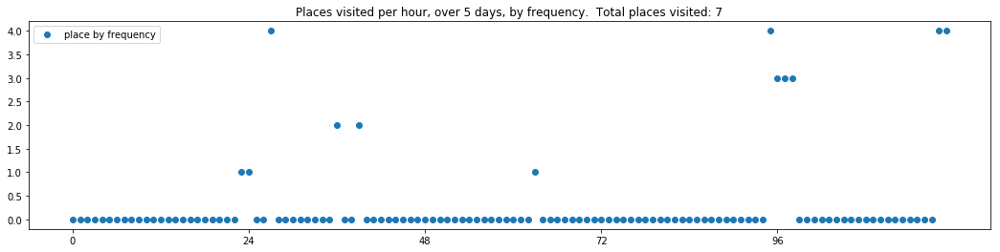

----- vector ----
prefix labels:  [219, 219]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0]


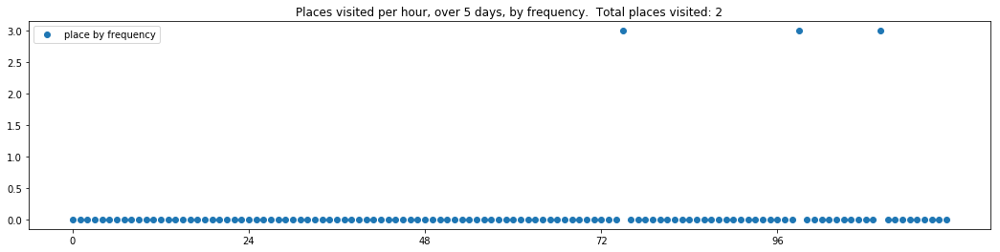

----- vector ----
prefix labels:  [395, 55]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 395, 395, 395, 395, 395, 395, 21, 395, 395, 395, 395, 395]
[395, 395, 395, 84, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 395, 395, 0, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 178, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]


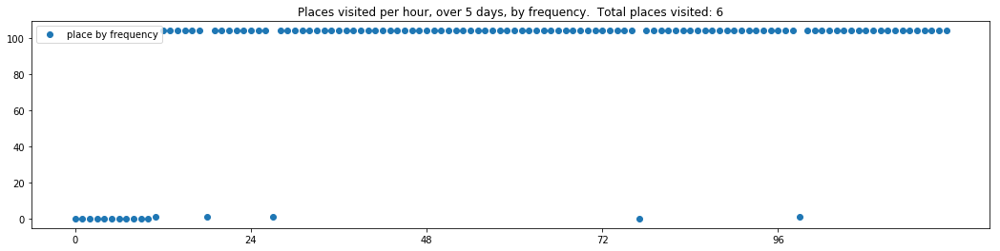

----- vector ----
prefix labels:  [503, 357]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 503, 158, 143, 143, 143, 143, 143, 143, 143, 143, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 575, 575, 15, 396, 93, 0, 93, 0, 0, 0, 0, 0, 545]
[349, 601, 558, 0, 0, 0, 0, 0, 0, 0, 0, 387, 387, 387, 387, 387, 387, 387, 387, 387, 387, 387, 387, 387]
[387, 387, 387, 387, 387, 387, 387, 387, 0, 0, 260, 0, 0, 0, 0, 260, 260, 0, 0, 0, 0, 0, 0, 0]


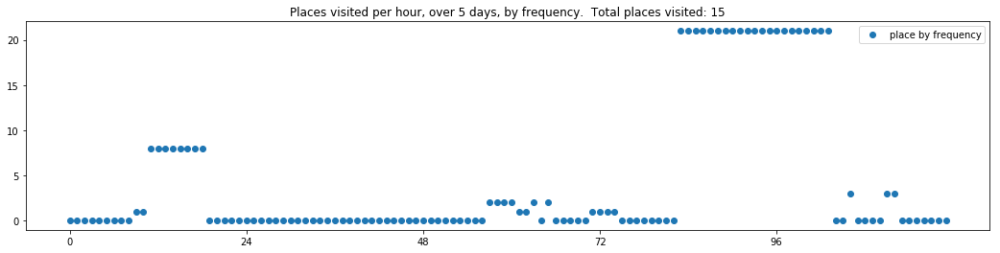

----- vector ----
prefix labels:  [1, 563]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 563]
[563, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


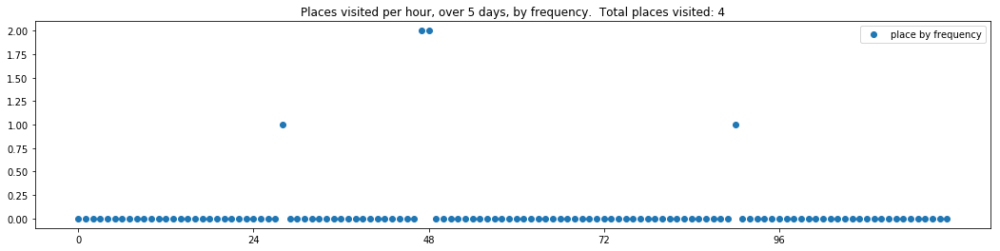

----- vector ----
prefix labels:  [401, 401]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 33, 59, 448, 0, 484, 484, 484, 484, 484, 484, 484, 439]
[13, 13, 0, 0, 0, 0, 18, 0, 0, 0, 0, 0, 0, 20, 162, 162, 162, 22, 22, 162, 162, 162, 13, 13]


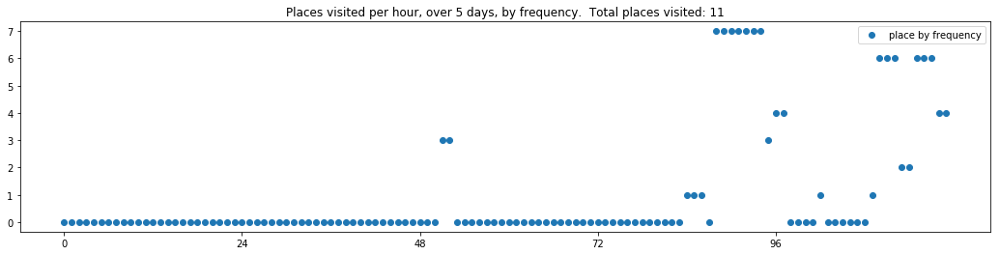

----- vector ----
prefix labels:  [479, 620]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 62, 0, 0, 0, 0, 0, 0, 0, 0, 515]
[515, 515, 515, 0, 0, 0, 515, 515, 515, 0, 0, 0, 0, 0, 107, 107, 107, 107, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 620, 515, 515, 515, 515, 515, 515, 515, 515, 515, 0, 0, 200, 200]


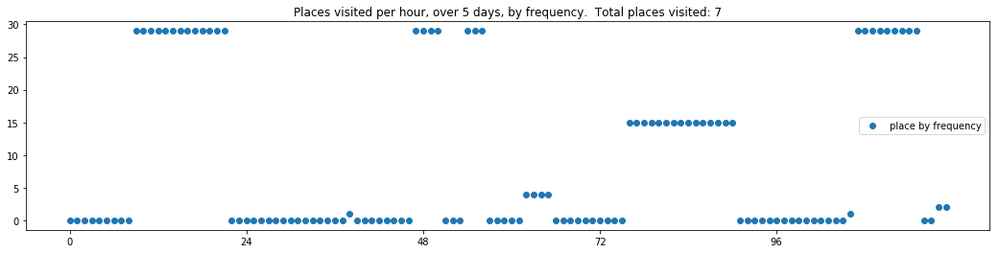

----- vector ----
prefix labels:  [321, 321]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 321, 321, 321, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


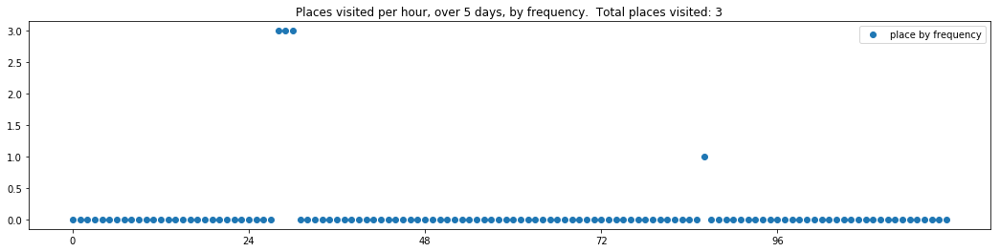

----- vector ----
prefix labels:  [216, 520]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520]
[520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520]
[520, 520, 520, 520, 520, 520, 520, 0, 0, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520]
[520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520, 520]


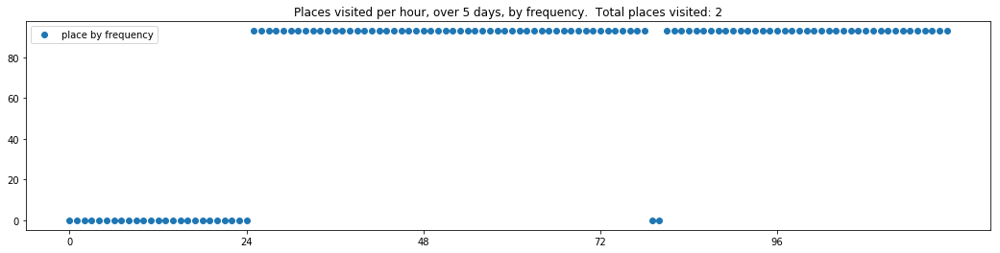

----- vector ----
prefix labels:  [479, 431]
[0, 0, 0, 0, 0, 87, 0, 0, 0, 225, 225, 225, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 4, 4, 4, 4, 4, 93, 367, 367, 0, 0, 0, 0, 0, 200, 4, 4, 431, 431, 0, 431, 0]
[0, 0, 222, 0, 0, 431, 431, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 463]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 336, 336, 336, 557, 133, 0, 0, 0, 0, 341, 341, 341, 341]


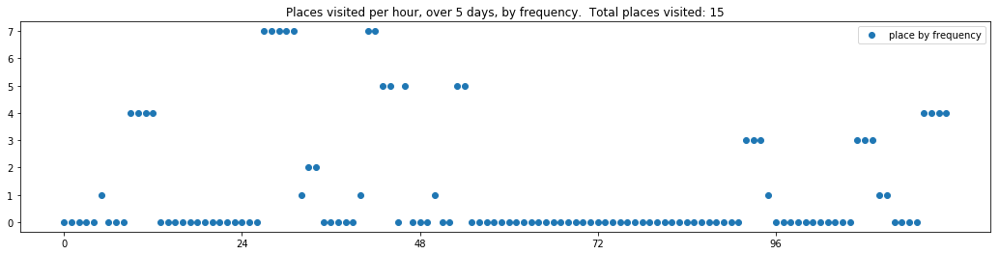

----- vector ----
prefix labels:  [412, 412]
[0, 0, 0, 0, 0, 0, 0, 412, 0, 412, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[412, 412, 412, 412, 412, 412, 412, 412, 0, 0, 0, 0, 0, 0, 412, 412, 412, 0, 0, 412, 412, 412, 0, 412]
[412, 412, 412, 412, 0, 0, 0, 0, 0, 412, 412, 0, 0, 412, 412, 412, 412, 412, 412, 412, 412, 412, 412, 412]
[412, 26, 26, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 412, 412, 0, 186, 0, 412, 0, 0, 0, 412, 412, 412, 0, 412, 412, 412, 412, 412, 412, 412, 412, 412]


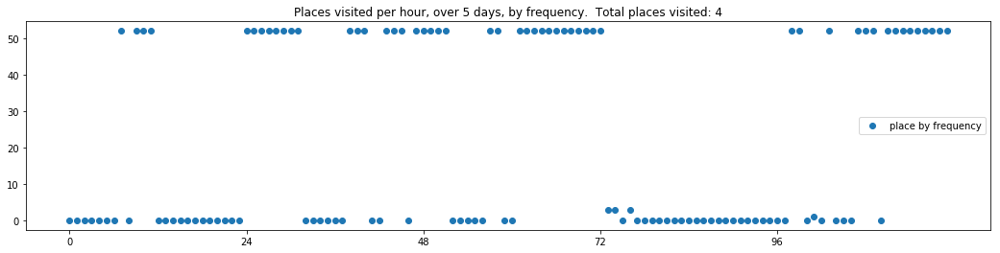

----- vector ----
prefix labels:  [590, 590]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 308, 165, 590, 590, 590, 590, 590, 590, 590, 590, 0, 0, 0, 590, 0]
[0, 0, 0, 0, 590, 590, 590, 590, 590, 590, 303, 0, 0, 0, 0, 0, 0, 303, 590, 590, 590, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 590, 590, 590, 590, 590, 590, 590, 590, 590, 590, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 590, 0, 590, 0, 0, 0, 0, 590, 590, 590, 0, 0, 0, 0, 0, 296]
[296, 296, 296, 303, 303, 205, 308, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]


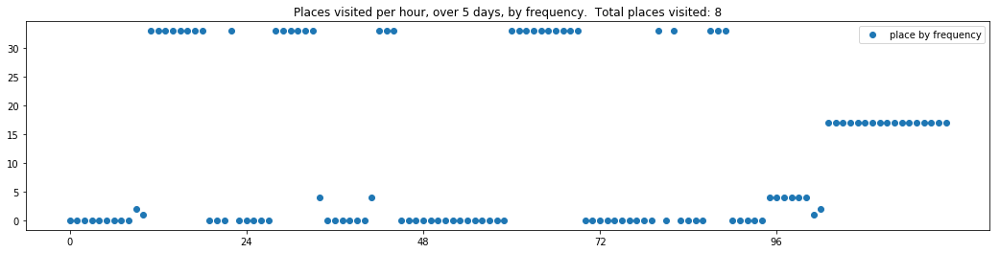

----- vector ----
prefix labels:  [304, 391]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 0, 304, 304, 304, 304, 304, 304, 304, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 389, 389, 389, 389, 389, 389, 389, 389, 389, 389, 0, 0, 0]
[0, 0, 0, 0, 341, 341, 341, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 0, 320, 389, 389, 304, 304, 304, 304, 304, 194, 0, 0, 0, 0, 0, 0, 389, 314]


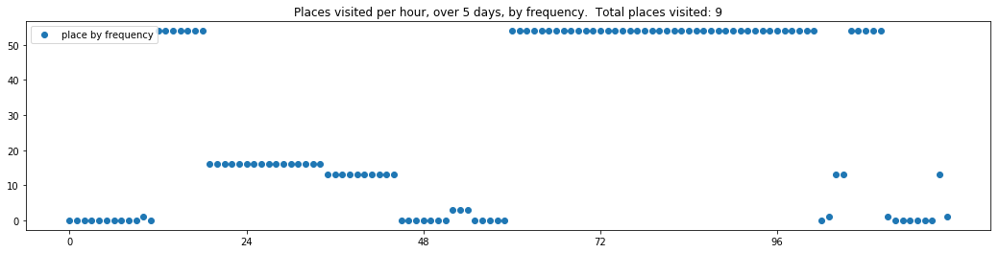

----- vector ----
prefix labels:  [186, 186]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 186, 186, 186, 186, 186]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0]
[186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


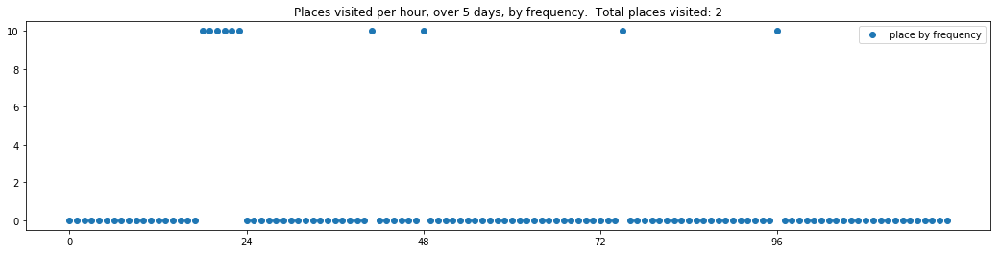

----- vector ----
prefix labels:  [488, 488]
[0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 568, 568, 488, 488]


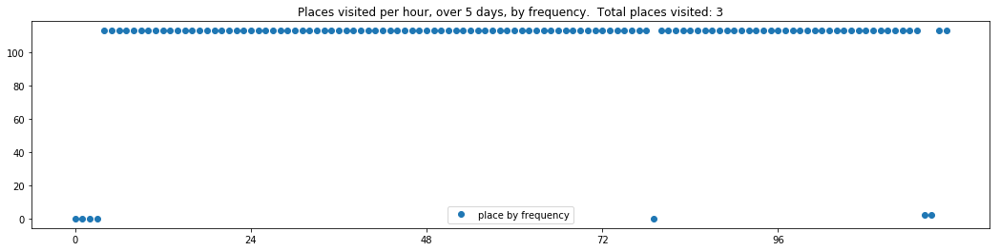

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 415, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


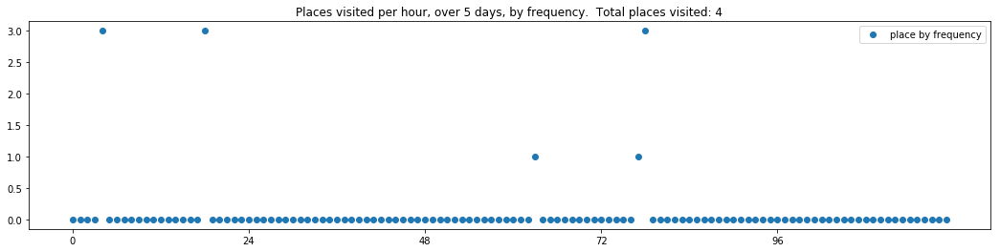

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 87, 0, 0, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 87, 87, 87, 289, 320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 0, 0, 0, 284]


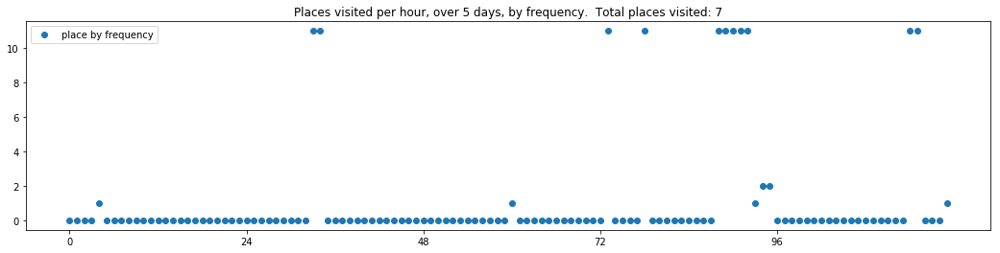

----- vector ----
prefix labels:  [148, 133]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 422, 423, 0, 0, 0, 0, 0, 0, 0, 0, 104, 104, 104]
[84, 133, 133, 133, 133, 133, 133, 133, 133, 133, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 0]
[0, 104, 148, 148, 180, 180, 180, 180, 180, 180, 388, 388, 388, 388, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]


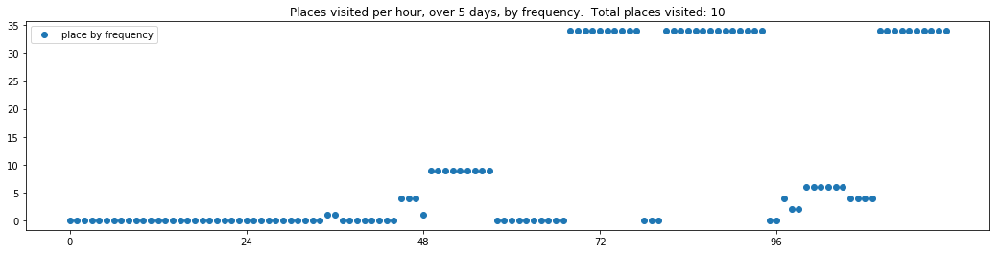

----- vector ----
prefix labels:  [248, 44]
[0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 48, 45, 45, 45, 45, 45, 45, 45, 0, 45, 45, 45, 45, 45, 45, 45, 0, 0, 0, 45, 45, 45, 45]
[45, 45, 45, 45, 45, 45, 45, 45, 45, 0, 0, 0, 0, 0, 248, 248, 203, 319, 0, 251, 82, 45, 45, 45]
[45, 45, 45, 45, 45, 0, 0, 647, 565, 565, 565, 565, 24, 24, 24, 24, 24, 24, 24, 214, 275, 33, 33, 33]
[33, 0, 0, 275, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61]


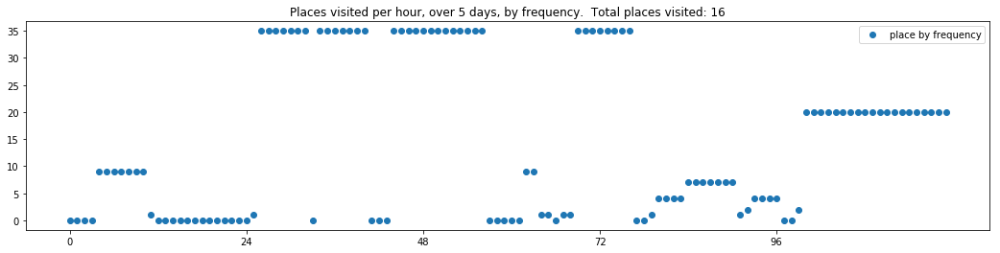

----- vector ----
prefix labels:  [22, 22]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 162, 0, 0, 0, 0, 0, 0, 162, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 0, 0, 0, 0, 0, 0, 0]


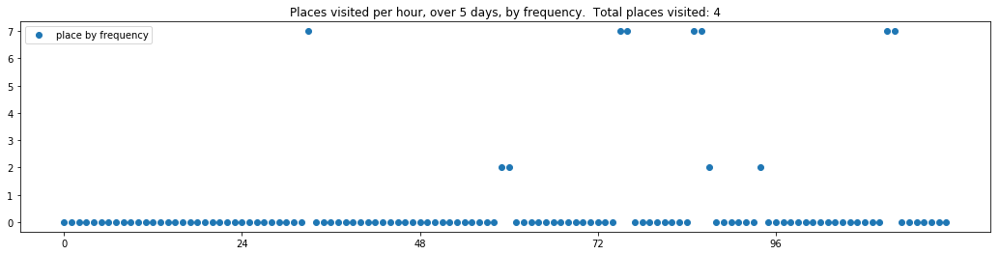

----- vector ----
prefix labels:  [231, 231]
[231, 231, 231, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 371, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 1, 39, 371, 371, 371, 371, 371, 371, 214, 214, 214, 155, 285, 478, 478, 478, 478, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214]
[214, 371, 371, 371, 371, 71, 0, 0, 0, 0, 370, 39, 70, 70, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 130, 130, 0, 203, 204, 204, 231, 231, 231, 231, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


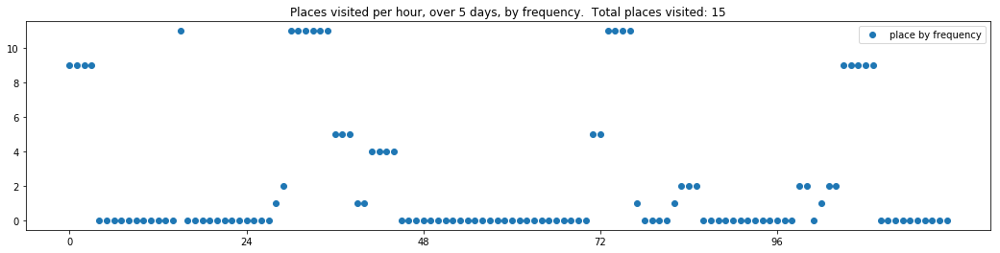

----- vector ----
prefix labels:  [617, 0]
[0, 0, 0, 292, 116, 116, 116, 116, 116, 116, 116, 461, 461, 461, 461, 461, 0, 0, 0, 0, 0, 0, 0, 0]
[184, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 123, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 271, 271, 366, 366, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 364, 364, 364, 364]
[364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 123, 123, 123, 123, 123, 123, 0, 0, 461, 461, 461, 461, 461, 461, 461, 461, 461]


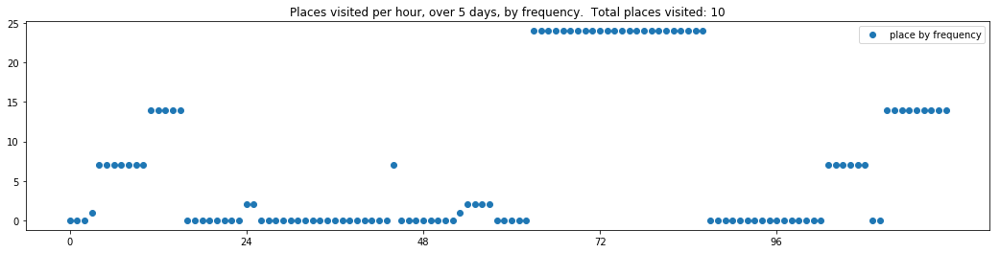

----- vector ----
prefix labels:  [126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


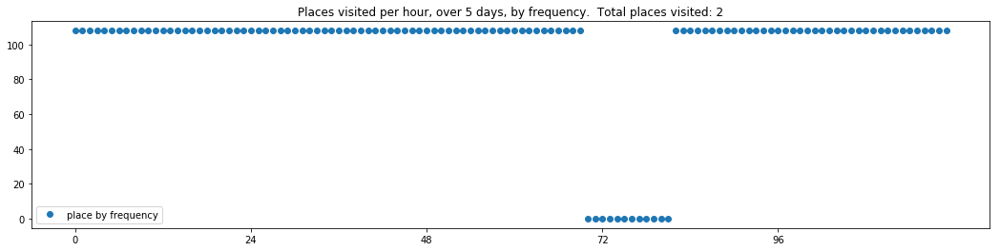

----- vector ----
prefix labels:  [295, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 93, 320, 320, 320, 320, 320]


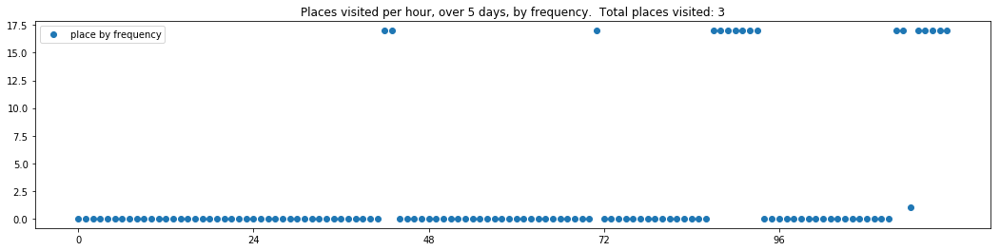

----- vector ----
prefix labels:  [404, 404]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 404, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 454, 454, 454, 454, 454, 454]


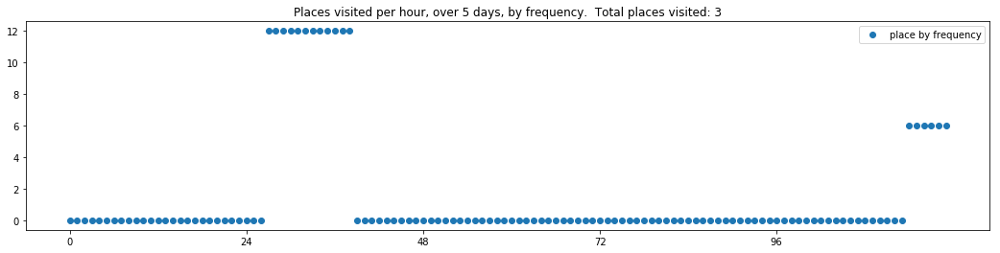

----- vector ----
prefix labels:  [195, 55]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 0]
[406, 0, 0, 0, 0, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


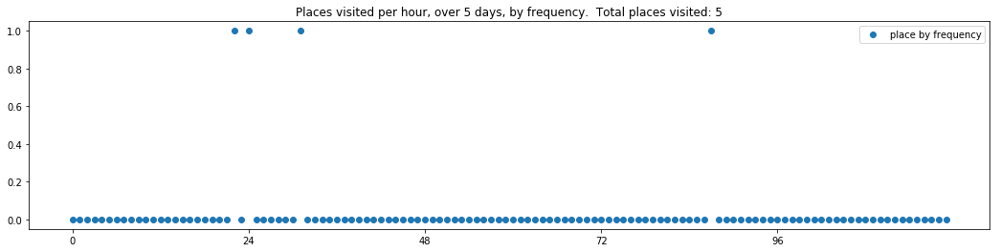

----- vector ----
prefix labels:  [65, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 65, 65, 65, 65, 65, 273, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 0, 0, 0, 0, 0, 0, 448, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388]


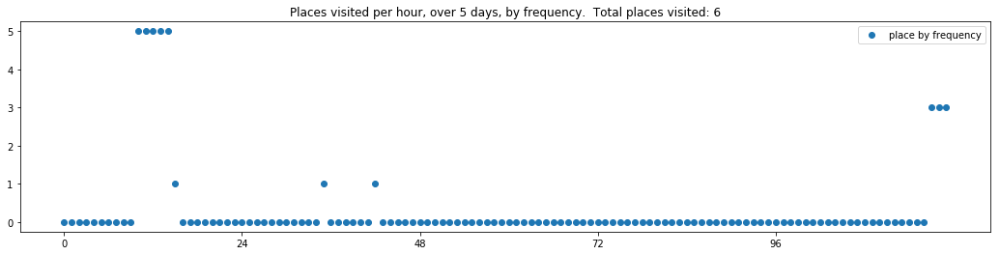

----- vector ----
prefix labels:  [586, 586]
[0, 586, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 473, 0, 0, 0]
[0, 0, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 498, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 323, 0, 0, 0, 0, 0, 0]
[93, 93, 93, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 215, 215, 215, 215, 215, 215, 0, 21, 0, 487]
[487, 487, 0, 549, 549, 549, 549, 549, 549, 549, 549, 549, 549, 549, 549, 0, 549, 549, 0, 26, 0, 0, 0, 0]


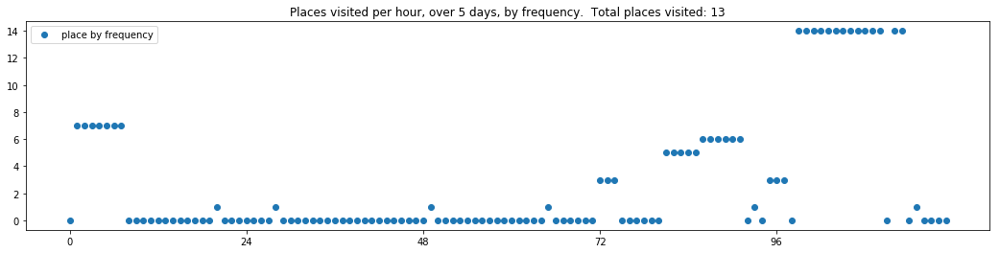

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 0, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


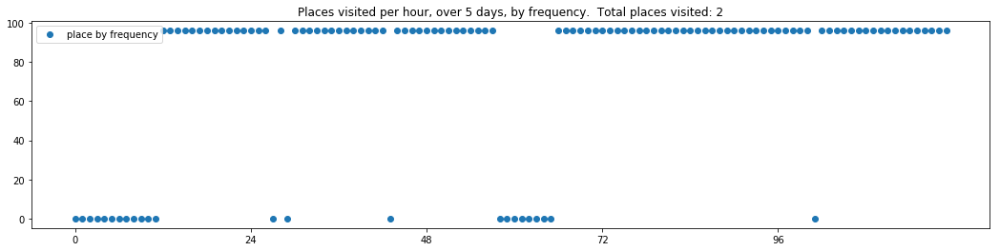

----- vector ----
prefix labels:  [391, 391]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 391, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


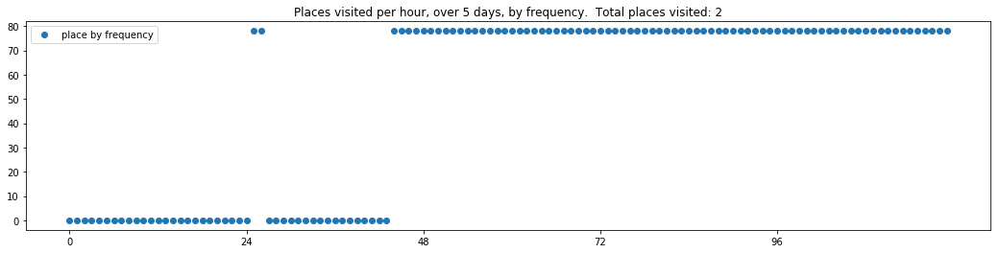

----- vector ----
prefix labels:  [239, 245]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 266, 266, 266, 271, 270, 270, 0]
[0, 239, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 245, 245, 245, 245, 245, 245, 0, 0, 0]
[119, 119, 119, 119, 119, 119, 119, 0, 245, 245, 245, 245, 245, 245, 245, 245, 0, 0, 0, 0, 0, 0, 80, 0]


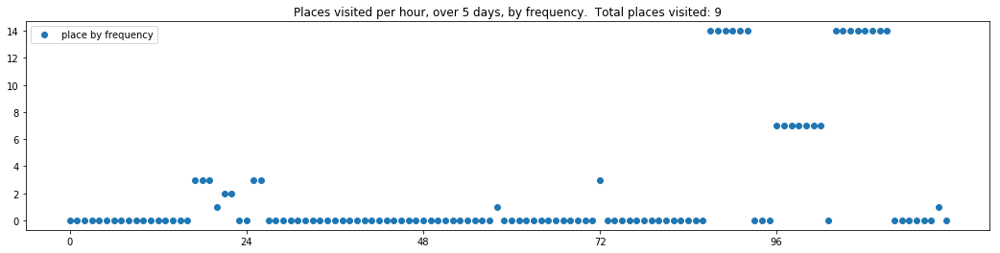

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 0, 0, 87, 87, 87, 87, 87, 87, 87, 87]
[87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 479, 0, 0, 0, 0, 0, 296, 296, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 87, 87, 87, 0]


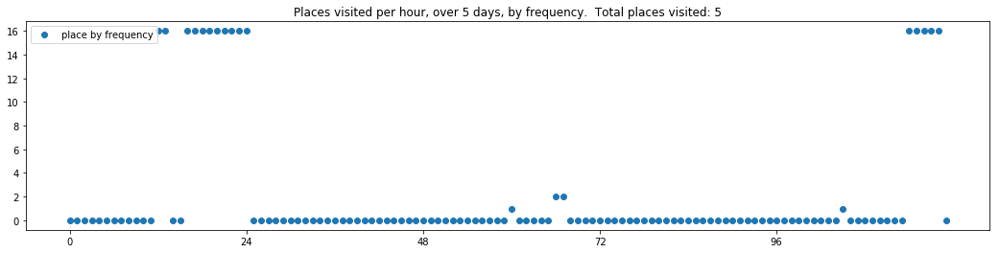

----- vector ----
prefix labels:  [203, 203]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


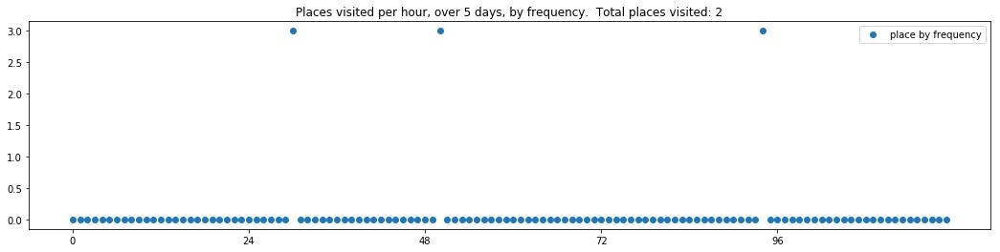

----- vector ----
prefix labels:  [457, 484]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484]
[484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484]
[484, 484, 484, 484, 484, 484, 484, 484, 0, 0, 482, 482, 0, 204, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 0, 266, 0, 0, 0, 0, 0, 484, 484, 484, 484, 484]
[484, 484, 484, 0, 0, 0, 0, 0, 0, 0, 0, 473, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


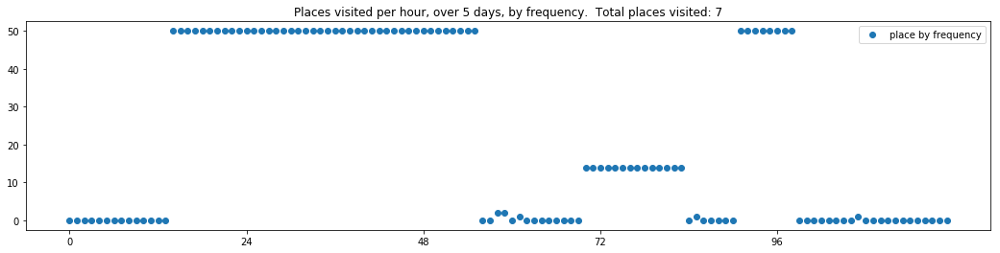

----- vector ----
prefix labels:  [218, 218]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218, 0, 218, 218, 218, 218, 218, 218, 218, 218, 0, 0]
[218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 0, 539, 218, 0, 539, 218, 218, 218]
[218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 0, 0, 218, 218, 218, 218, 218, 218]
[218, 218, 218, 218, 218, 218, 218, 539, 0, 0, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218]
[218, 218, 218, 218, 218, 218, 508, 0, 218, 218, 218, 218, 218, 218, 539, 539, 539, 218, 218, 218, 218, 218, 218, 574]


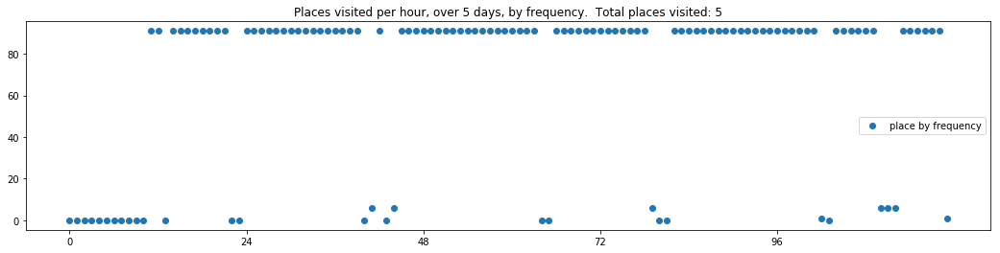

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 323, 323]
[0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]


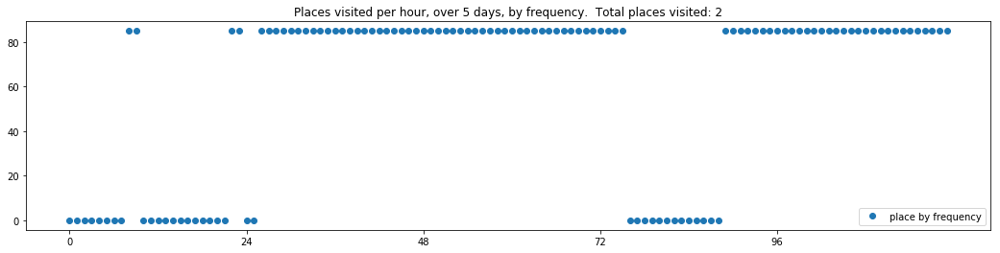

----- vector ----
prefix labels:  [355, 346]
[0, 0, 0, 0, 0, 0, 0, 593, 593, 593, 593, 355, 355, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 539, 539, 539, 539, 539, 0, 0]
[0, 0, 0, 0, 0, 0, 56, 56, 56, 56, 56, 221, 221, 221, 221, 221, 221, 496, 539, 0, 220, 0, 539, 539]
[539, 539, 0, 116, 141, 141, 141, 0, 0, 0, 0, 0, 395, 395, 395, 0, 376, 376, 376, 376, 376, 376, 376, 364]
[364, 364, 0, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 204, 0, 0]


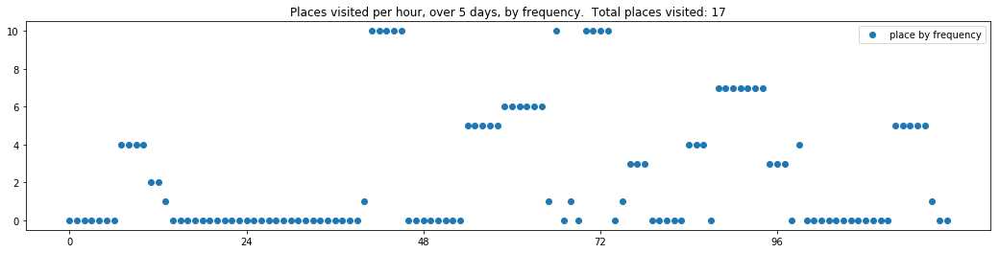

----- vector ----
prefix labels:  [462, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 462, 462, 462, 462, 462, 341, 0, 0, 462, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 462, 462, 462, 462, 462]
[462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 557, 0, 0, 0, 603, 603, 603, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388]


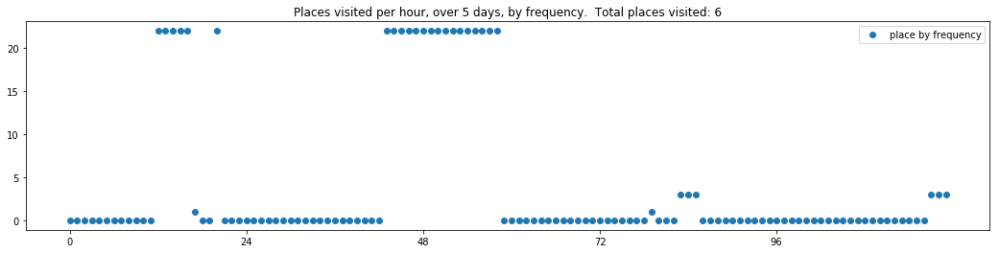


------
 25 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_25.txt 
------

----- vector ----
prefix labels:  [117, 117]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 117, 117, 117, 117, 117, 117, 117, 117, 117, 117, 117, 0]
[0, 0, 0, 0, 0, 0, 0, 117, 117, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 82, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 117, 117]
[0, 32, 306, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434, 434]


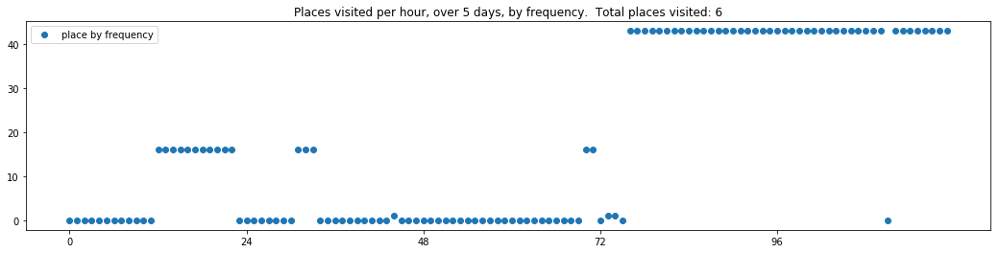

----- vector ----
prefix labels:  [41, 84]
[0, 0, 0, 0, 0, 84, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 84, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 84, 84, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 0, 0, 0, 0, 0]
[0, 554, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 374, 374, 0, 177, 177, 0, 0, 41]


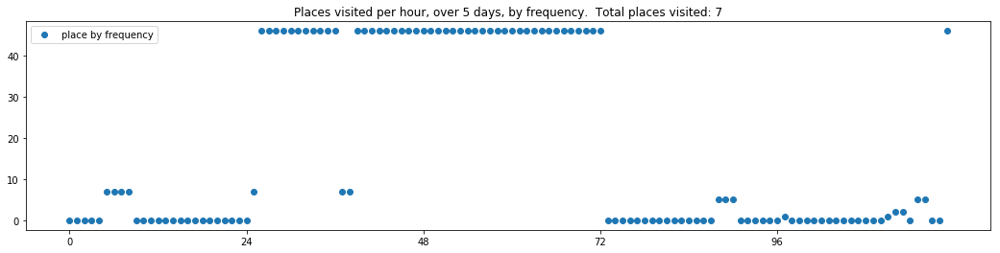

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 437, 0, 0, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 0, 0, 0, 437, 437, 437, 437, 162, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437]


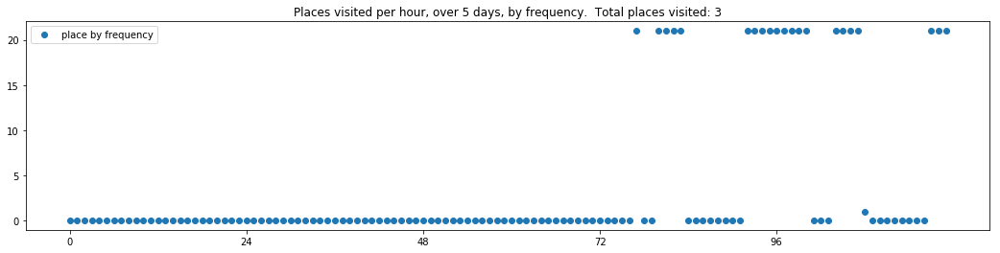

----- vector ----
prefix labels:  [604, 339]
[0, 0, 0, 0, 0, 339, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


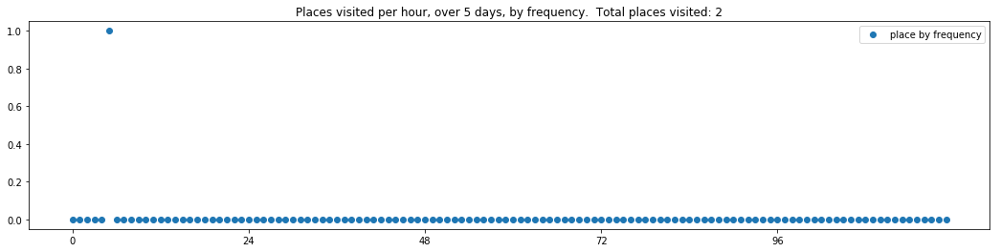

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 437, 437, 437, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 437, 0, 0, 0, 0, 0, 0, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 437, 0, 0, 0, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


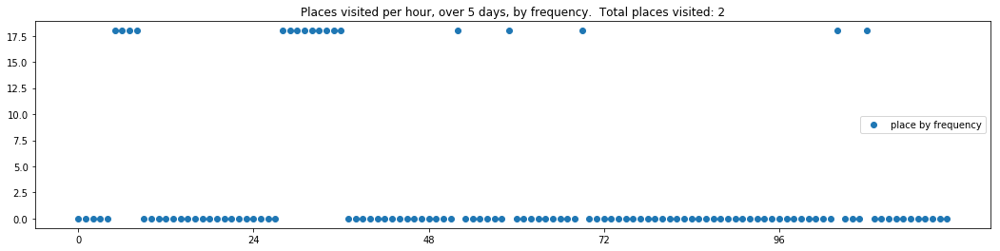

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0]
[0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 0, 0]
[0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0, 0]


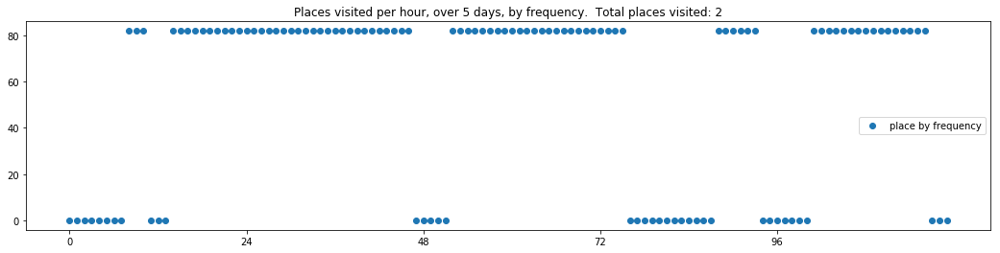

----- vector ----
prefix labels:  [118, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


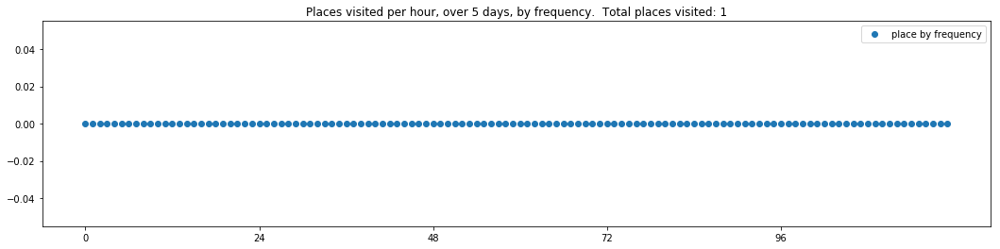

----- vector ----
prefix labels:  [248, 483]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 483, 483, 483, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 73, 158, 158, 503, 503, 503, 503, 503, 0, 0, 0, 0, 220, 0, 361, 361]


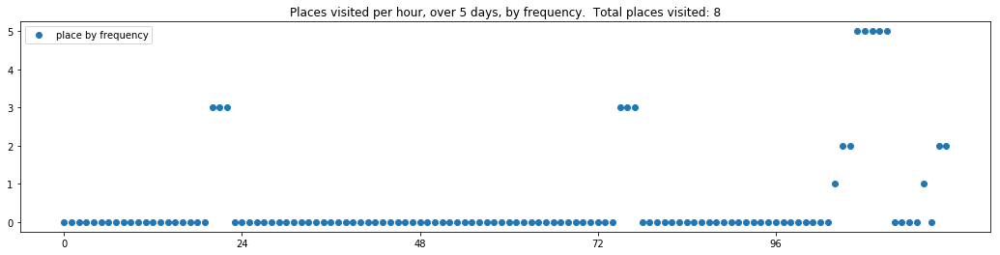

----- vector ----
prefix labels:  [20, 20]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 239, 239, 271, 424, 424, 0, 0, 0, 0]
[0, 0, 62, 0, 0, 0, 0, 0, 382, 0, 0, 0, 0, 0, 0, 0, 0, 76, 0, 0, 0, 0, 0, 0]


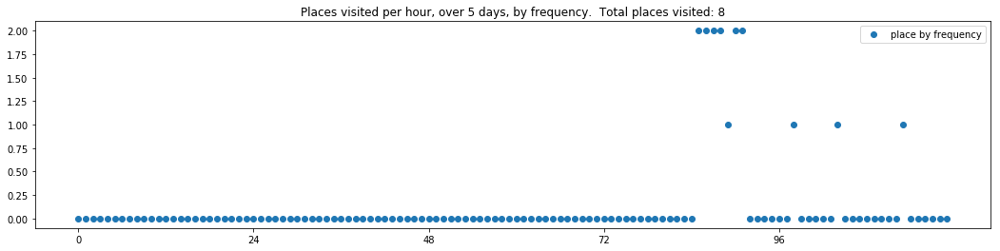

----- vector ----
prefix labels:  [223, 223]
[0, 0, 0, 0, 0, 205, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 223, 223, 223, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


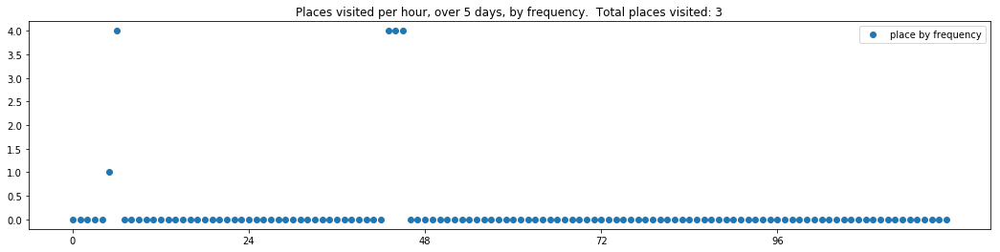

----- vector ----
prefix labels:  [61, 61]
[0, 0, 0, 0, 0, 0, 0, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61]
[61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61]
[61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 0, 0, 0, 0, 0, 61, 61]
[61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61]
[61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61, 61]


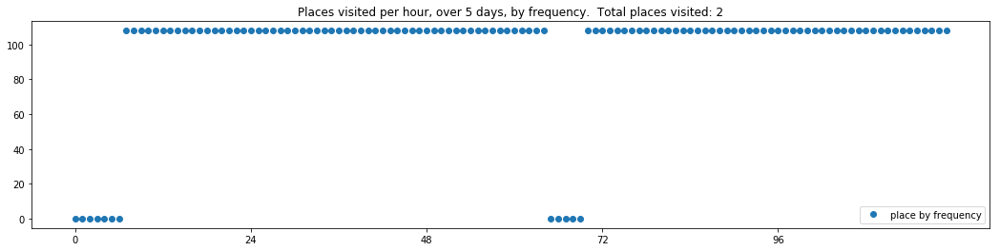

----- vector ----
prefix labels:  [340, 340]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340]
[340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 0, 0, 0, 0]
[0, 0, 0, 0, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340]
[340, 340, 340, 340, 340, 340, 340, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 340, 340, 340, 340, 340, 340]
[340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340, 340]


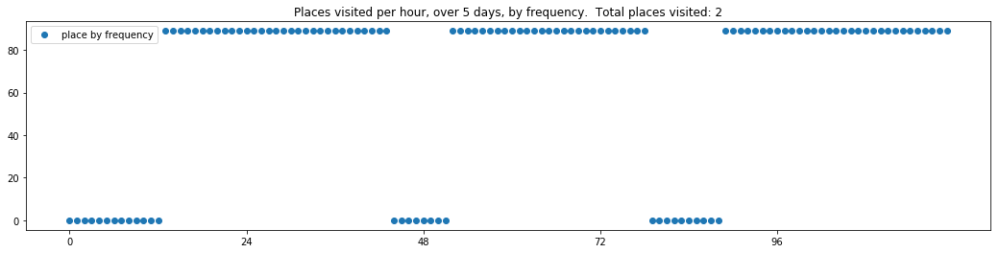

----- vector ----
prefix labels:  [246, 246]
[0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]
[246, 246, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 246, 246]
[246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 48, 48, 0, 0, 0, 0]
[0, 44, 0, 0, 0, 0, 44, 48, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]


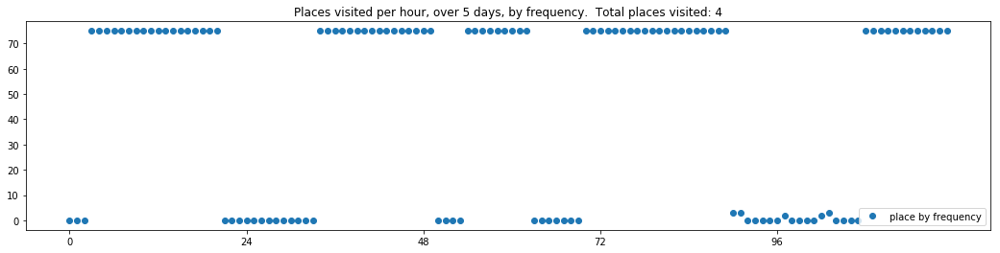

----- vector ----
prefix labels:  [142, 142]
[0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0]
[0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


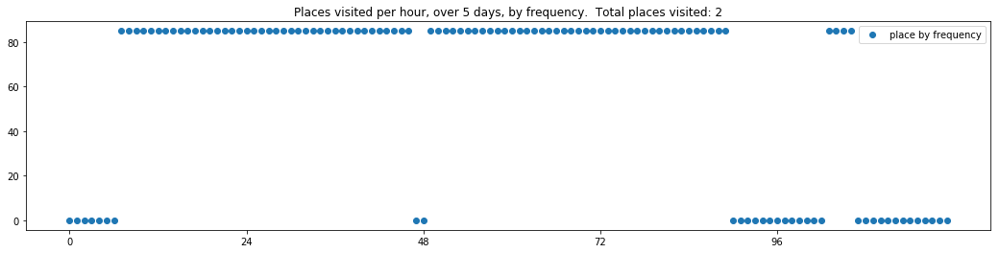

----- vector ----
prefix labels:  [90, 90]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[90, 90, 90, 90, 24, 90, 90, 90, 90, 90, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 90, 0, 0, 90, 90, 90, 90, 90, 90, 0, 500, 90, 0, 0]
[0, 0, 0, 0, 90, 90, 90, 90, 90, 90, 90, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 90, 48, 48]


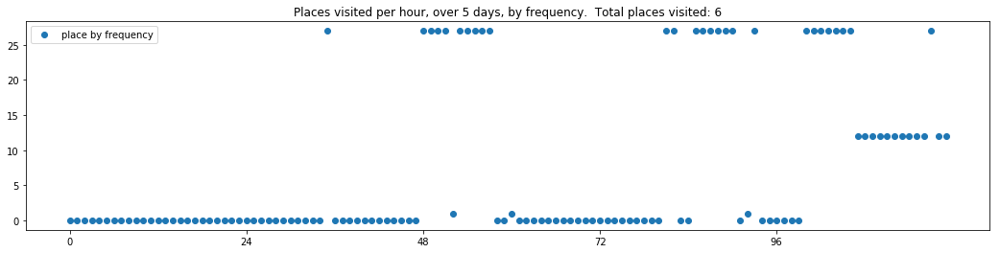

----- vector ----
prefix labels:  [267, 222]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 222, 276, 276, 276, 222, 396, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222, 222, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 0, 341, 341, 341]
[341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341]
[341, 341, 341, 341, 341, 341, 341, 341, 0, 0, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341]


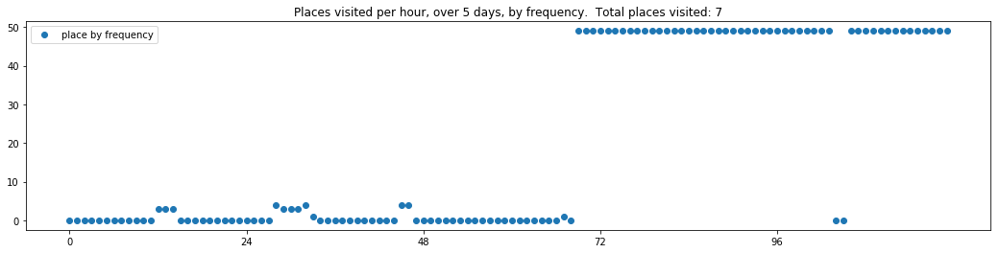

----- vector ----
prefix labels:  [505, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0]
[0, 248, 248, 248, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


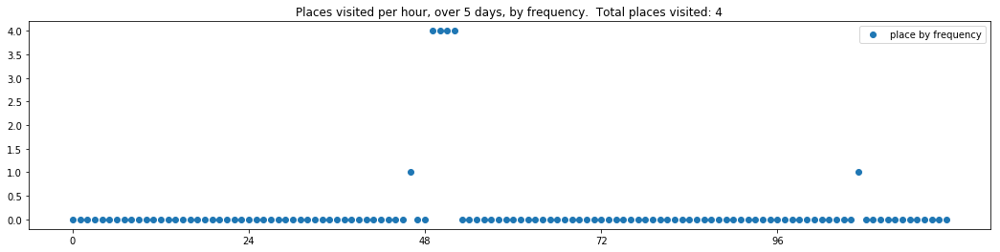

----- vector ----
prefix labels:  [611, 611]
[0, 0, 0, 0, 611, 611, 0, 0, 0, 0, 0, 0, 0, 0, 103, 0, 0, 0, 303, 0, 0, 0, 0, 0]
[0, 0, 296, 296, 0, 0, 0, 0, 0, 0, 0, 391, 391, 391, 391, 611, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 611, 611, 611, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568]
[0, 0, 296, 296, 296, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 195, 195, 195, 611, 611, 611, 611, 611]
[611, 0, 0, 0, 0, 0, 0, 0, 0, 296, 296, 296, 0, 568, 568, 568, 568, 0, 0, 0, 0, 0, 205, 205]


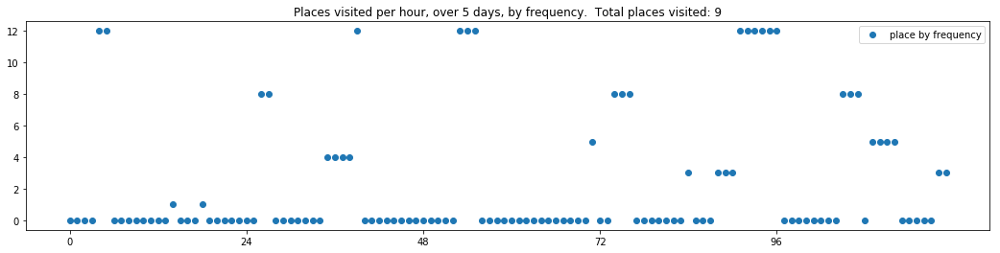

----- vector ----
prefix labels:  [609, 609]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 404, 404, 404, 0, 0, 0, 0, 0, 0, 0, 0, 0, 225, 225]


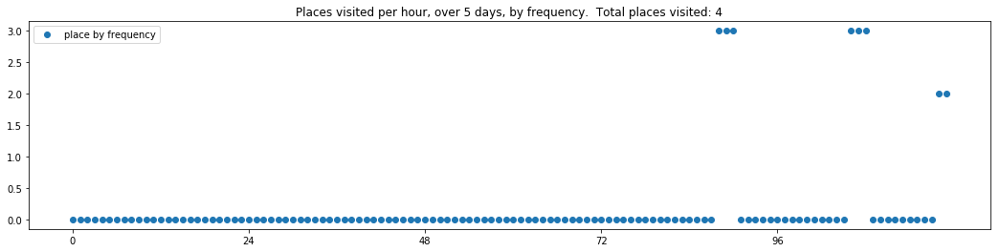

----- vector ----
prefix labels:  [450, 450]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 0, 0, 0, 0, 0]
[0, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 0, 0, 0, 568, 0]


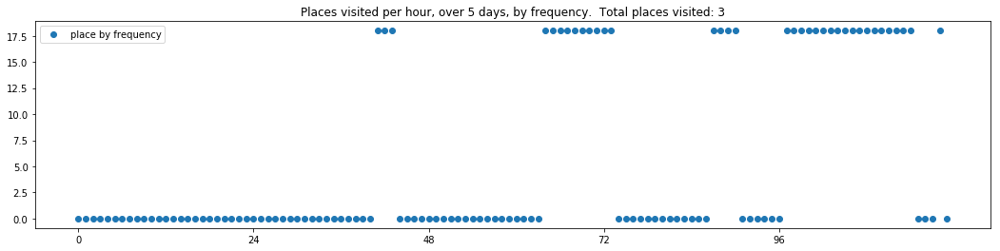

----- vector ----
prefix labels:  [168, 168]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 0, 0, 0, 0, 0, 0, 0, 0, 95]
[95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 0, 311, 311, 311, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 391, 391, 391, 391, 391, 391, 391, 391]


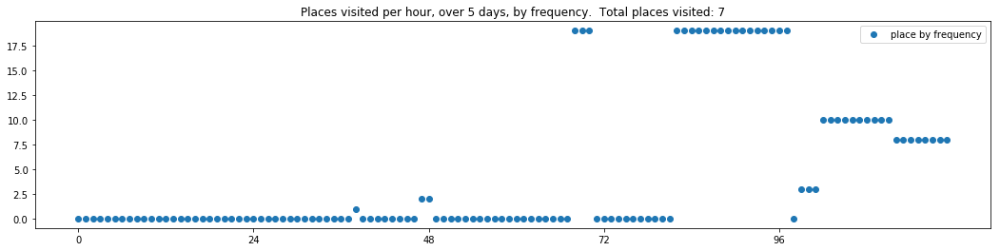

----- vector ----
prefix labels:  [150, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[150, 150, 0, 20, 20, 20, 0, 20, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


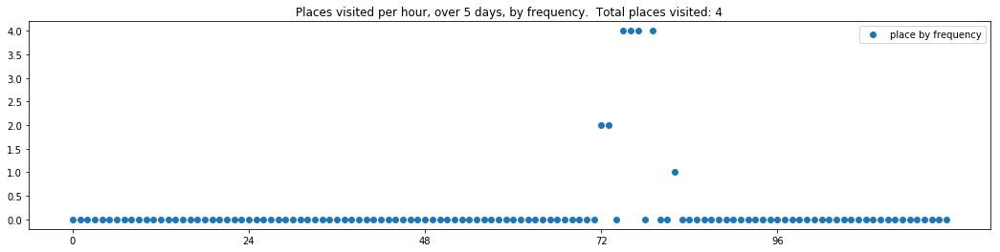

----- vector ----
prefix labels:  [312, 312]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 0, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 0, 0, 312, 312]


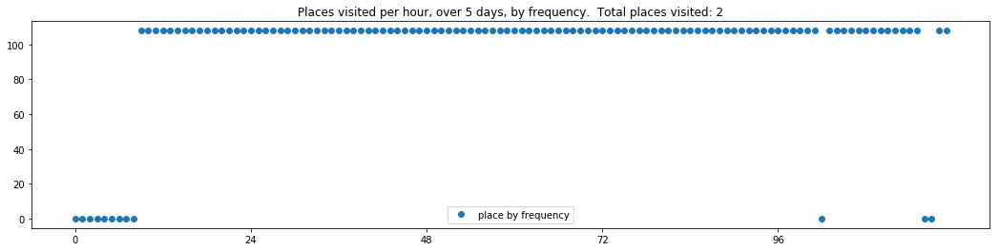

----- vector ----
prefix labels:  [171, 260]
[0, 0, 0, 0, 260, 260, 260, 260, 0, 0, 0, 0, 0, 0, 171, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 260, 260, 260, 260, 260, 260, 0, 0, 0, 0, 0, 260, 260, 260, 260, 260, 260, 260, 260]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271]
[271, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 269, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


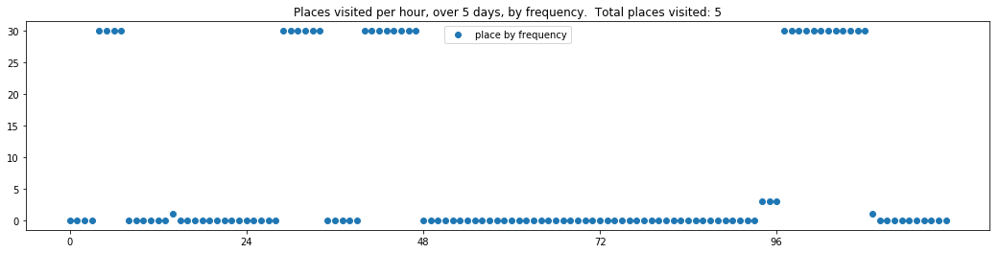

----- vector ----
prefix labels:  [461, 142]
[0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 0, 0, 142, 0, 0, 0, 0, 142, 0, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 461, 461, 461, 461, 461, 0, 248, 248, 248, 248]
[248, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 250, 293, 288, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]


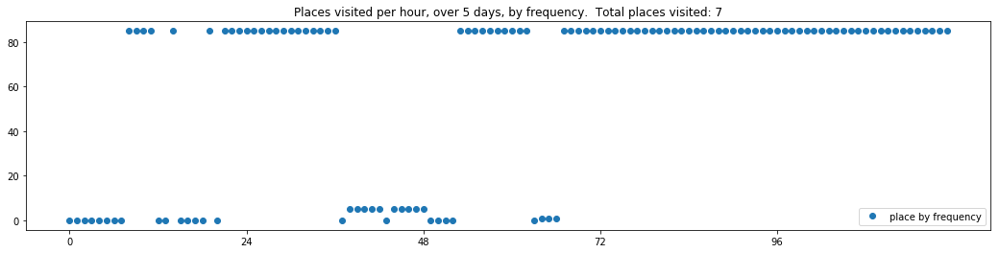

----- vector ----
prefix labels:  [253, 253]
[253, 0, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 126, 126, 126, 126, 124, 124, 124, 124, 124, 124, 124, 124, 124]


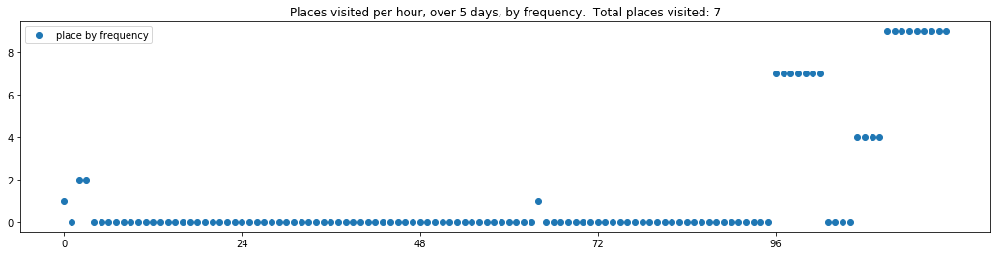

----- vector ----
prefix labels:  [21, 119]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 119]
[119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 116, 116, 0, 116, 0, 119, 0, 0, 0, 0, 0, 0, 0]
[21, 21, 21, 0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 176, 177, 181, 0, 0, 0]
[0, 0, 0, 0, 0, 72, 0, 0, 0, 0, 461, 461, 461, 461, 461, 461, 461, 0, 0, 579, 579, 0, 319, 199]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


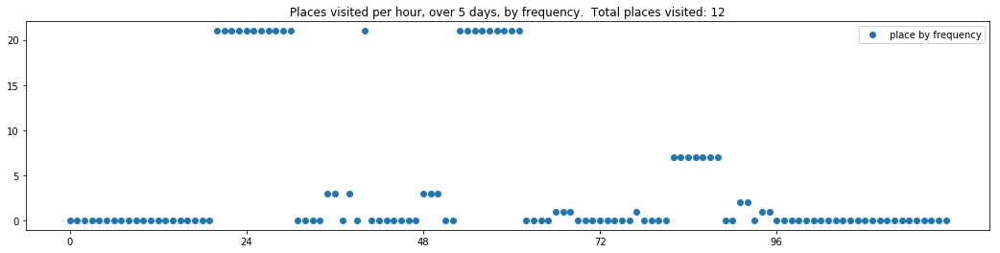

----- vector ----
prefix labels:  [96, 96]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 279, 279, 279, 279, 0, 0, 0, 0, 0, 0, 0]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 304, 304, 304, 304, 304, 304, 0, 96, 96, 96, 0, 0, 0, 0, 0, 0, 96, 96, 96, 96, 96]
[96, 96, 96, 96, 96, 96, 96, 96, 96, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


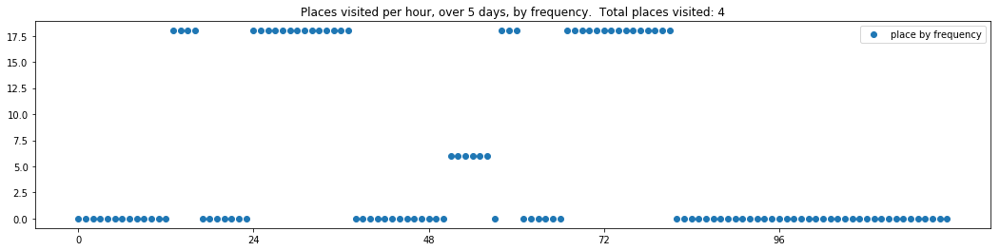

----- vector ----
prefix labels:  [36, 471]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 109, 0, 0, 0, 0, 0, 0, 0, 46]
[46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 488, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 46, 46, 0, 0, 0, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


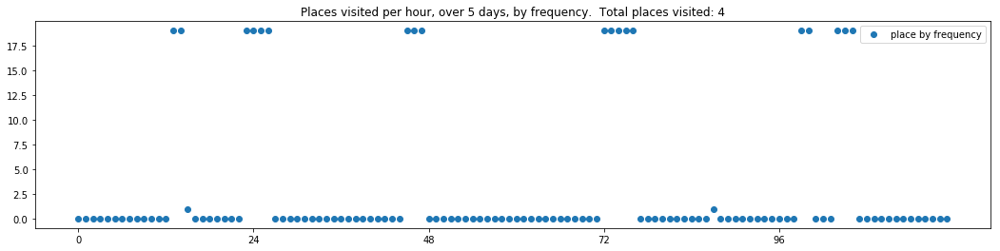

----- vector ----
prefix labels:  [191, 369]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 191, 191, 191, 608, 0, 0, 0, 191, 191, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 345, 345, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 558, 558, 558, 558, 558, 558]
[0, 0, 0, 191, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 345, 0, 0, 0, 0, 0, 0, 0, 0, 0, 345, 345, 345, 0, 0, 190, 0, 190, 190, 190, 190, 190, 190]


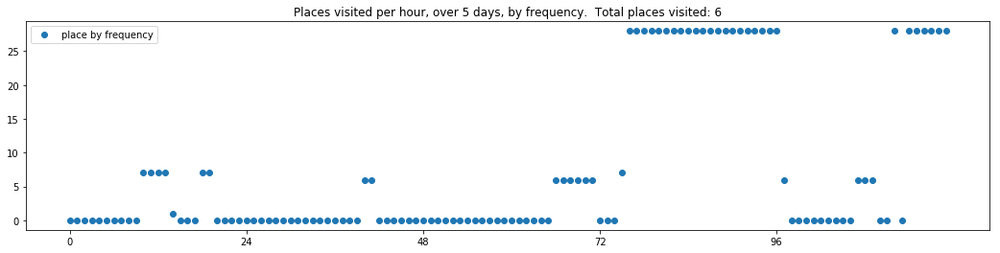

----- vector ----
prefix labels:  [561, 126]
[0, 0, 0, 0, 0, 507, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 400, 557, 557, 0, 90, 0]
[0, 0, 0, 247, 162, 162, 0, 90, 90, 90, 45, 247, 247, 247, 247, 247, 247, 247, 247, 247, 247, 0, 0, 46]
[46, 46, 46, 46, 46, 46, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 0, 0, 0]


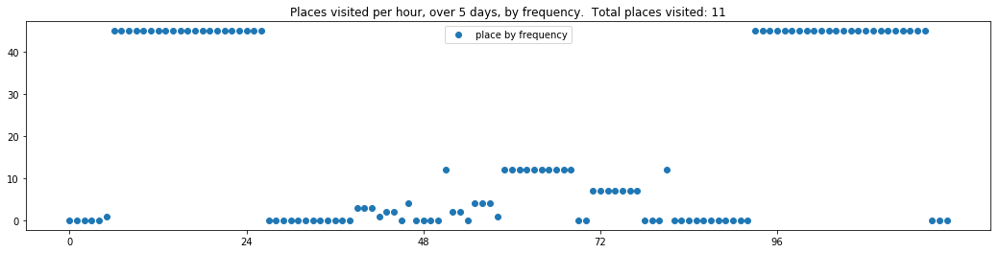

----- vector ----
prefix labels:  [270, 270]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 0, 0, 270, 270, 270, 270, 270, 270]


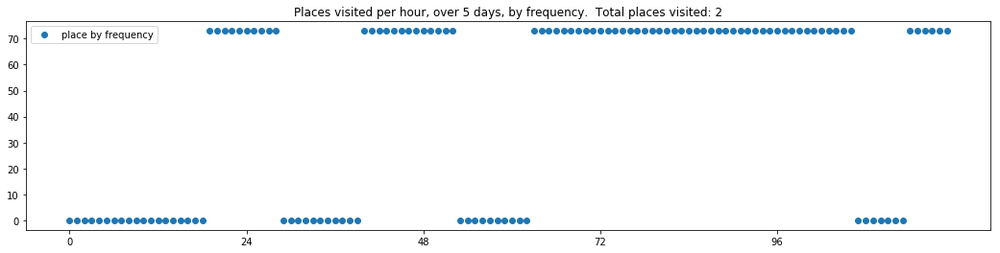

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 569, 0, 0, 21, 21, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 8, 8, 0, 612, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 475, 0, 0]
[0, 21, 21, 21, 21, 0, 0, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


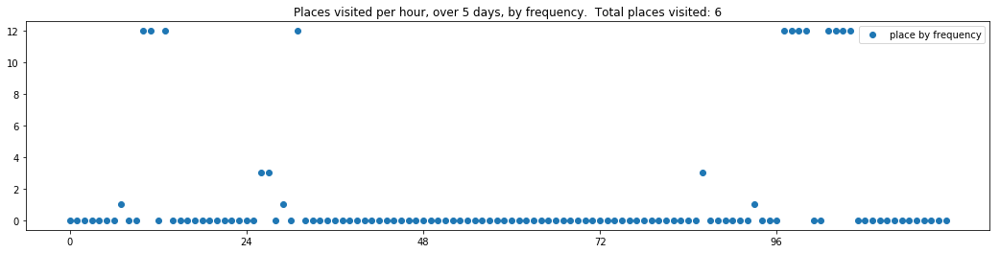

----- vector ----
prefix labels:  [410, 410]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 410, 410, 410, 410, 410, 410, 410, 410, 410, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


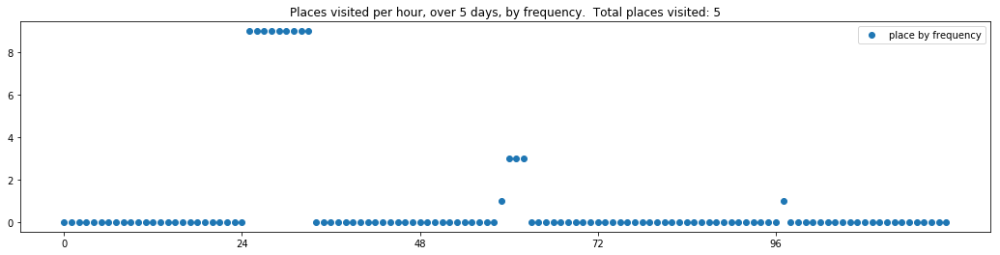

----- vector ----
prefix labels:  [507, 507]
[0, 0, 0, 0, 0, 507, 507, 507, 0, 0, 0, 507, 507, 507, 507, 507, 507, 507, 507, 0, 0, 507, 507, 507]
[0, 541, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 0, 0, 0, 0]
[0, 0, 488, 81, 576, 0, 0, 0, 0, 0, 0, 507, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 507]
[507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 474, 146, 146, 22, 22]
[22, 22, 22, 22, 22, 22, 22, 0, 22, 22, 22, 22, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]


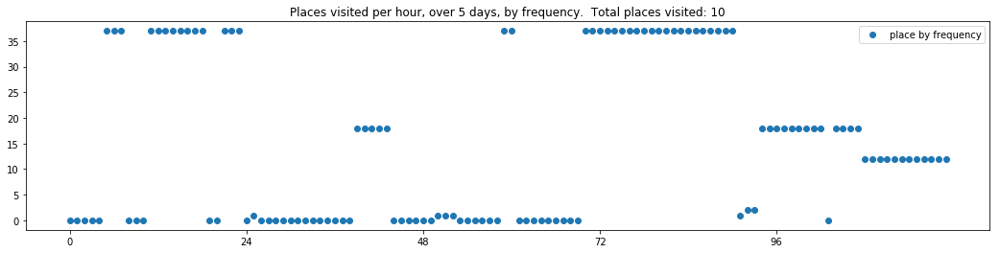

----- vector ----
prefix labels:  [87, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


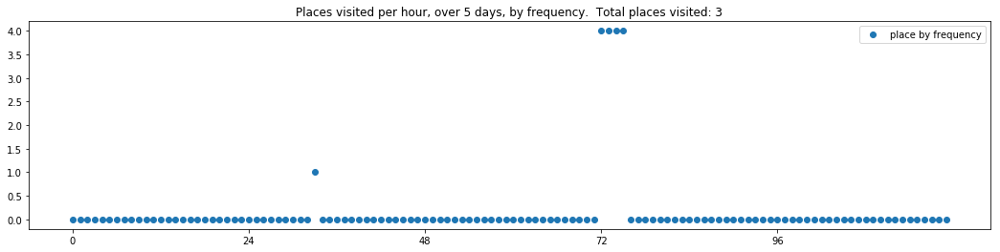

----- vector ----
prefix labels:  [161, 161]
[0, 0, 0, 0, 0, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]


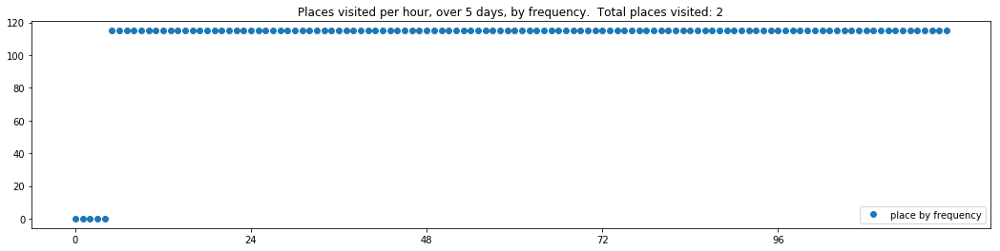

----- vector ----
prefix labels:  [107, 107]
[0, 0, 0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 0, 0, 0, 0, 107, 107, 107, 107, 107, 0]
[0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107]
[107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 107, 0, 0]


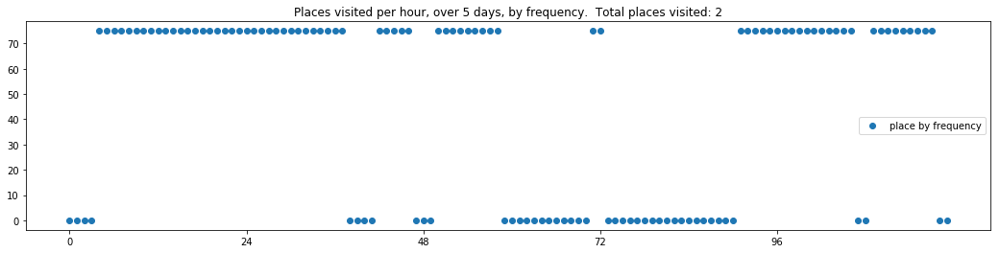

----- vector ----
prefix labels:  [108, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


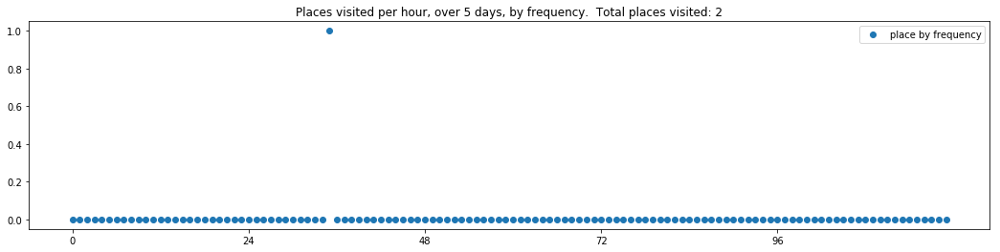

----- vector ----
prefix labels:  [201, 201]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 349, 349, 349, 349, 349, 349, 349, 349, 349]
[349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 0, 0, 0, 0, 0, 0, 0, 38, 38, 38, 38, 38, 38, 38]
[38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]
[38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]
[38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]


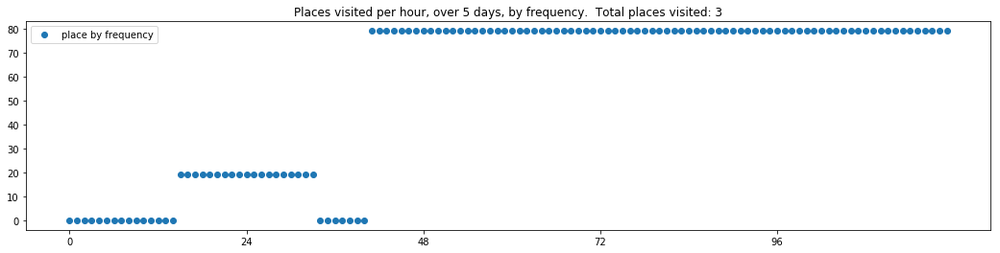

----- vector ----
prefix labels:  [119, 119]
[0, 0, 177, 177, 177, 177, 177, 225, 225, 225, 225, 225, 225, 225, 225, 0, 0, 0, 0, 0, 0, 419, 419, 0]
[0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 0, 0, 119, 119, 119, 119, 119, 0, 0, 76]
[0, 0, 0, 0, 0, 0, 0, 603, 0, 0, 0, 0, 267, 199, 199, 61, 119, 119, 119, 119, 119, 119, 119, 119]
[119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 637, 0]


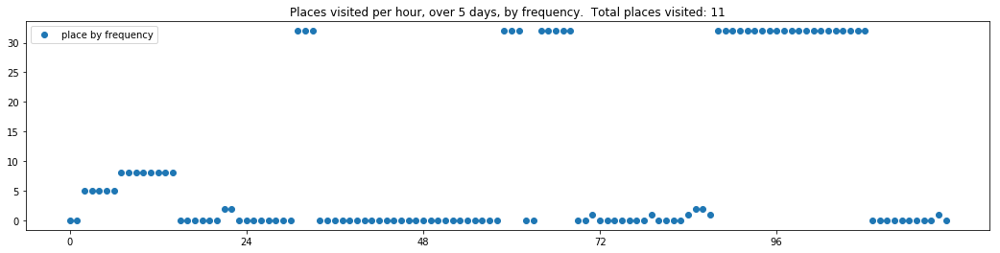

----- vector ----
prefix labels:  [88, 564]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


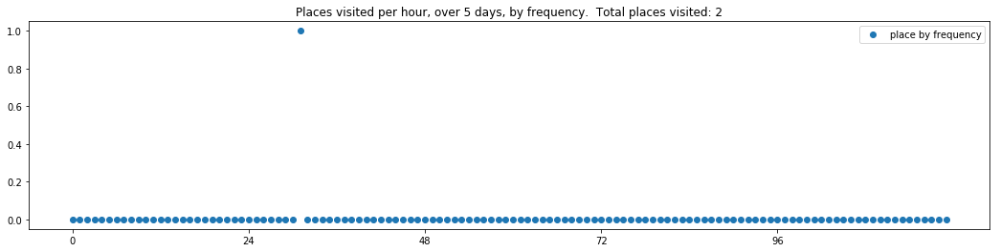

----- vector ----
prefix labels:  [483, 293]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


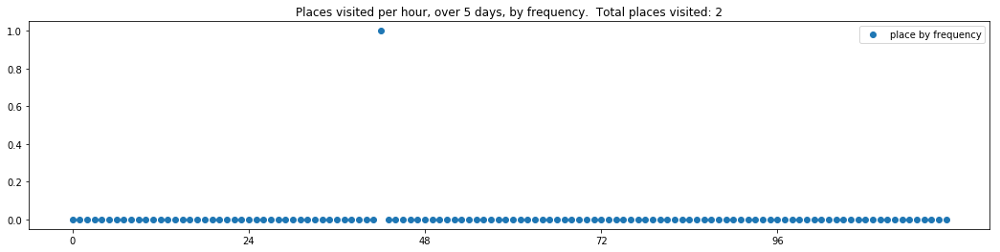

----- vector ----
prefix labels:  [161, 161]
[0, 0, 0, 0, 0, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 0, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]


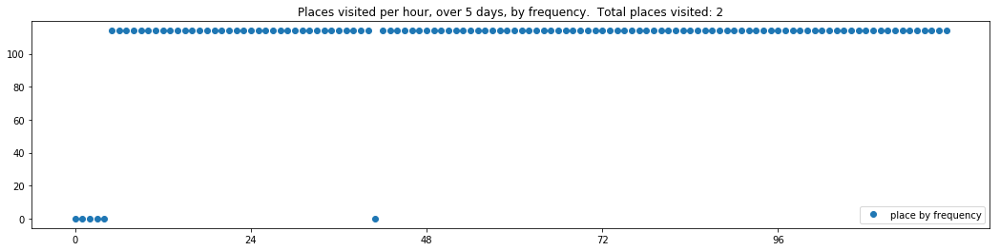

----- vector ----
prefix labels:  [86, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 586]
[586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


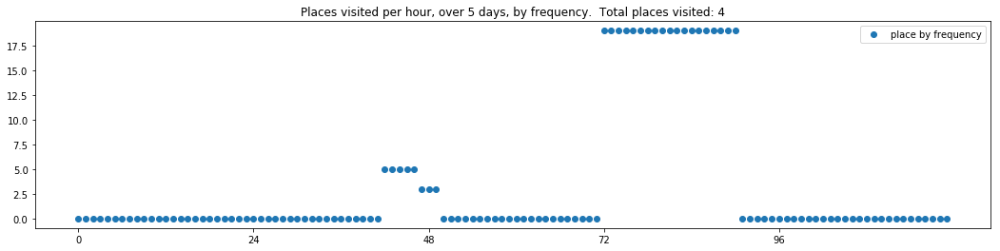

----- vector ----
prefix labels:  [2, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 2, 2, 2, 2, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 261, 0, 0, 0, 0, 252, 252, 252, 0, 0, 0, 0, 0, 2, 2, 2, 252, 252, 252, 252, 252, 252]
[252, 252, 252, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2]
[2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 0, 0, 21, 122, 0, 0, 0, 0, 2, 2, 2]


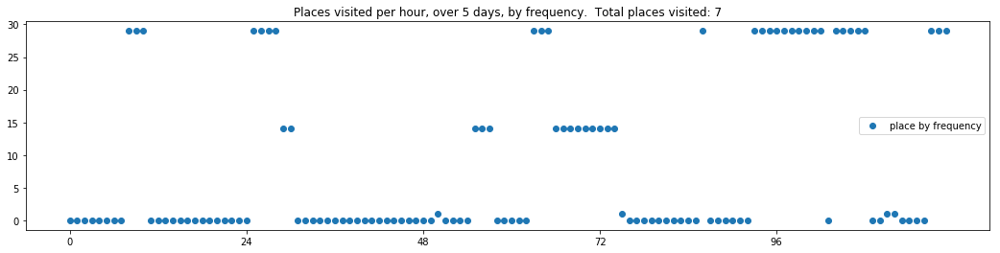

----- vector ----
prefix labels:  [177, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


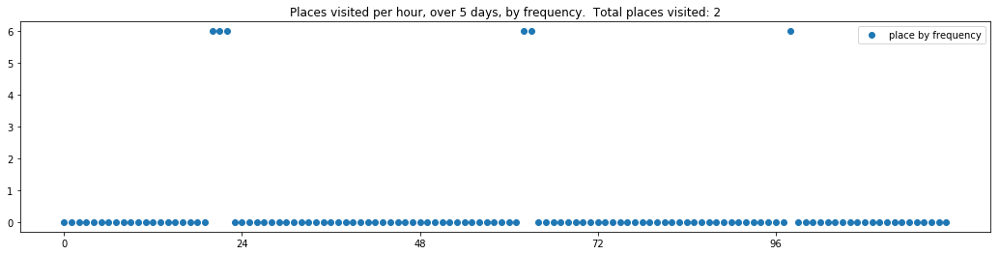

----- vector ----
prefix labels:  [492, 492]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 0, 0, 0, 0, 0, 0, 0, 0, 48, 48, 48, 48, 48]
[48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 492, 492, 492, 492]
[492, 492, 492, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 0, 0, 0, 43, 0, 455, 455, 492, 492, 0, 0, 0, 0]


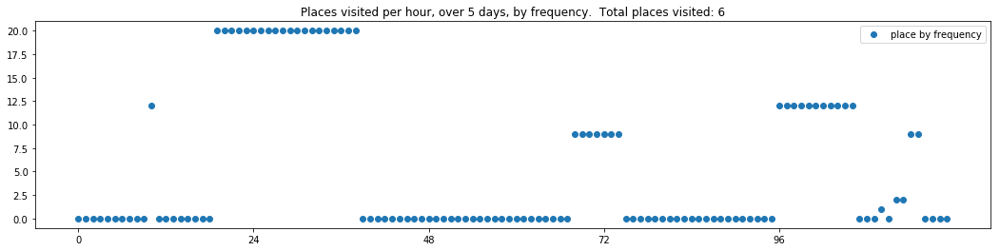

----- vector ----
prefix labels:  [453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 453, 0, 489, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[390, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 167, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 0, 0, 390, 390, 390, 390, 390, 390, 390, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 390, 390, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562]


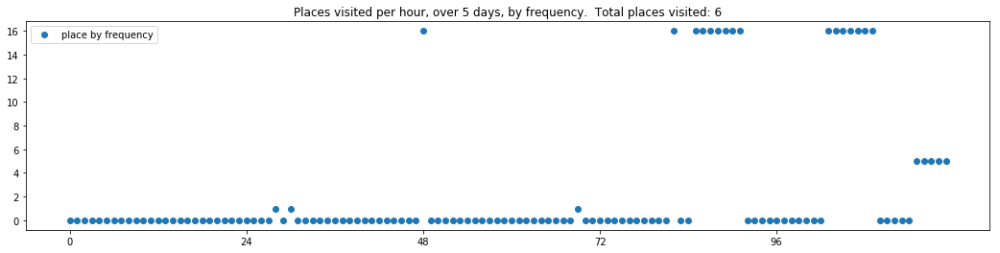

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 473, 473, 0, 77, 77, 98, 52, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271]
[271, 271, 271, 271, 270, 473, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


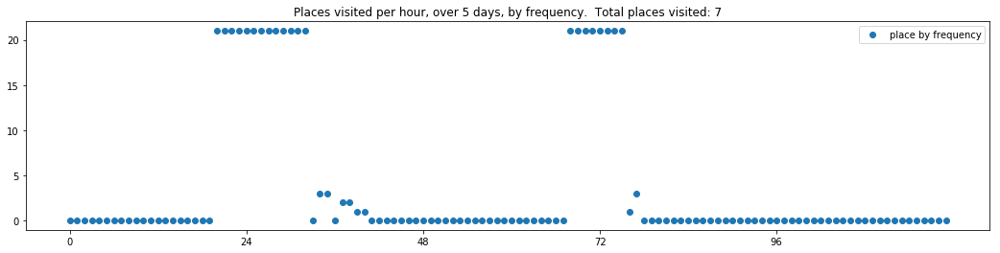


------
 30 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_30.txt 
------

----- vector ----
prefix labels:  [286, 508]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 508, 508, 508, 508, 508, 508]
[508, 508, 508, 508, 508, 508, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 124, 0, 0, 205, 205, 205, 205, 507, 507]
[205, 205, 103, 563, 563, 563, 0, 205, 205, 205, 205, 205, 205, 286, 22, 22, 0, 0, 618, 618, 618, 618, 618, 618]
[618, 618, 618, 618, 618, 618, 147, 508, 508, 508, 508, 508, 563, 563, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]


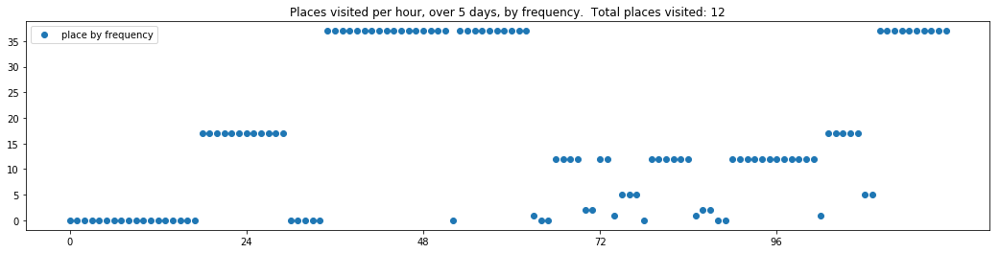

----- vector ----
prefix labels:  [413, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413]
[413, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 186, 0, 412, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


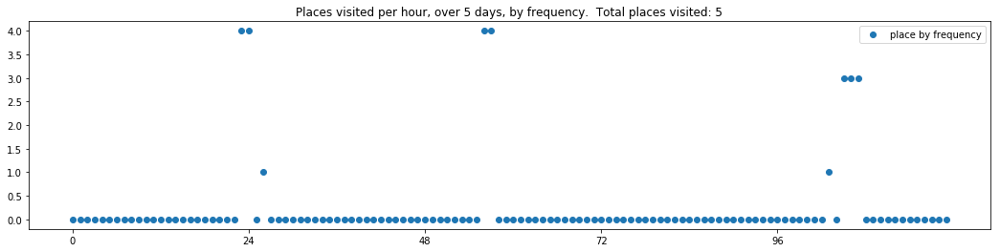

----- vector ----
prefix labels:  [312, 312]
[0, 0, 0, 0, 0, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]
[312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312, 312]


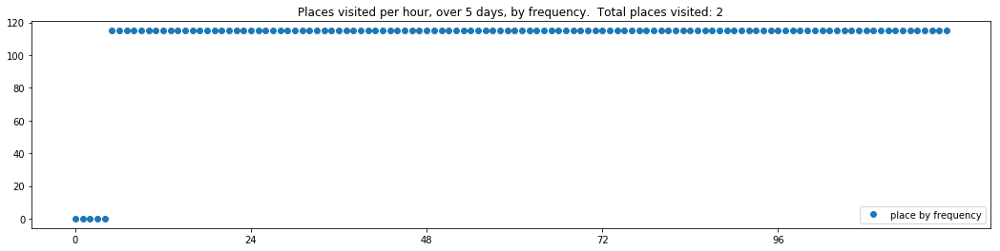

----- vector ----
prefix labels:  [358, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 358, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 358, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0]


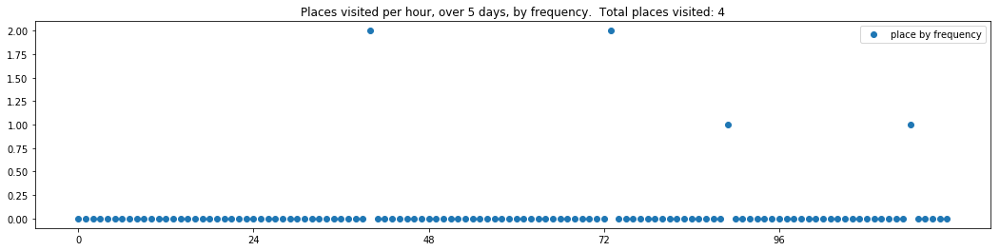

----- vector ----
prefix labels:  [167, 167]
[0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 429, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


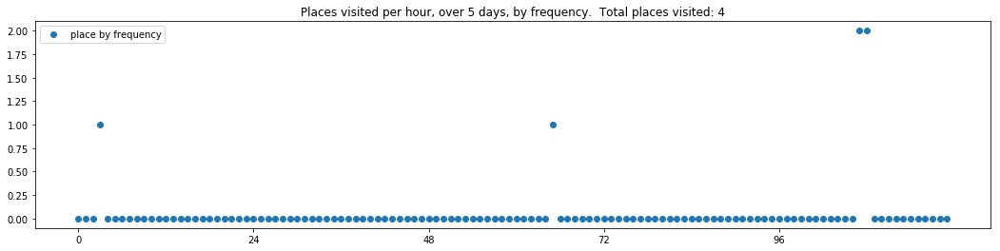

----- vector ----
prefix labels:  [626, 122]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 252, 71, 0, 0, 493, 0, 23, 220, 0, 0, 0, 187]
[187, 378, 378, 378, 0, 596, 0, 187, 71, 0, 187, 370, 144, 144, 144, 0, 136, 0, 0, 0, 0, 0, 0, 0]
[142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 248, 231, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 187, 0, 0, 0, 0, 0]


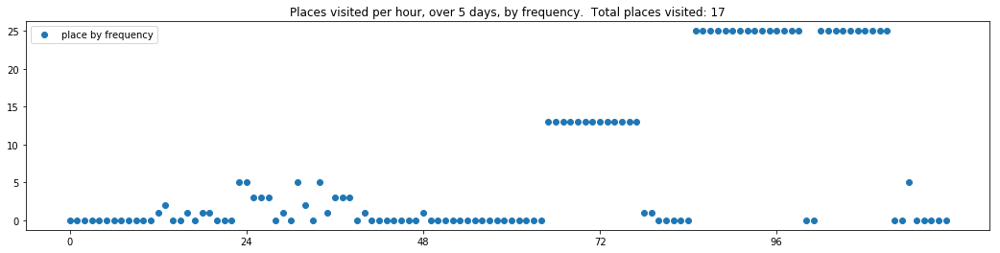

----- vector ----
prefix labels:  [523, 523]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 523, 523, 523, 523, 523, 0, 0, 0, 523, 523, 523, 523, 523, 523, 523]
[523, 523, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388]
[388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


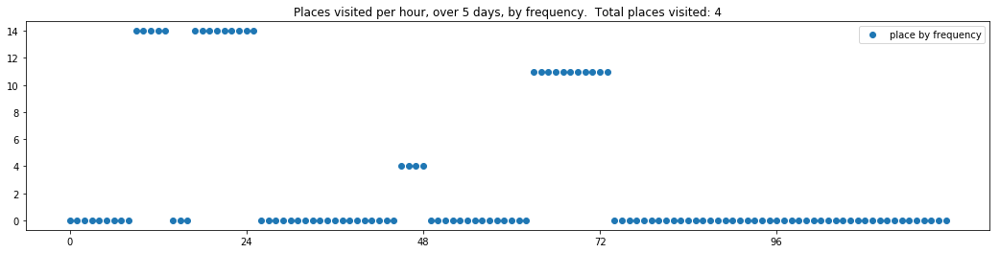

----- vector ----
prefix labels:  [238, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 238, 238, 238, 238, 238, 238, 238, 238, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 471, 471, 0, 0, 69, 69, 8, 0, 0, 0, 238, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 346, 0, 516, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69]


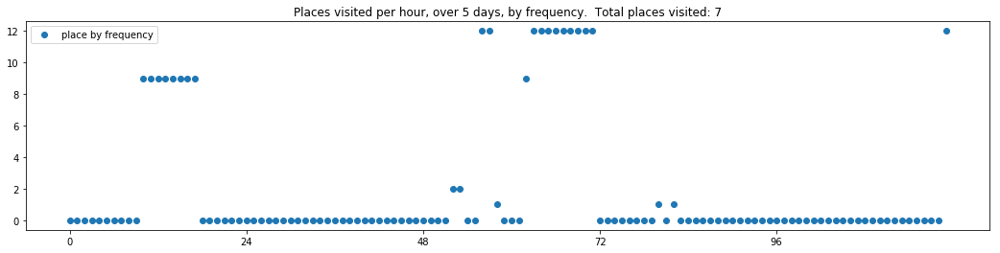

----- vector ----
prefix labels:  [309, 309]
[0, 0, 0, 0, 0, 0, 0, 309, 309, 309, 433, 433, 433, 433, 433, 0, 0, 0, 0, 0, 0, 23, 304, 304]
[304, 0, 0, 0, 205, 0, 433, 433, 433, 433, 433, 433, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 296, 0, 0, 0, 0, 309, 309, 0, 0, 0, 0, 620, 620, 309, 309, 309, 309, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 309, 309, 309, 309, 309, 309, 313, 313, 313, 313, 0, 309, 309, 309, 309, 0, 0, 0, 0]
[309, 309, 309, 309, 309, 309, 0, 0, 0, 0, 102, 102, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 309, 309]


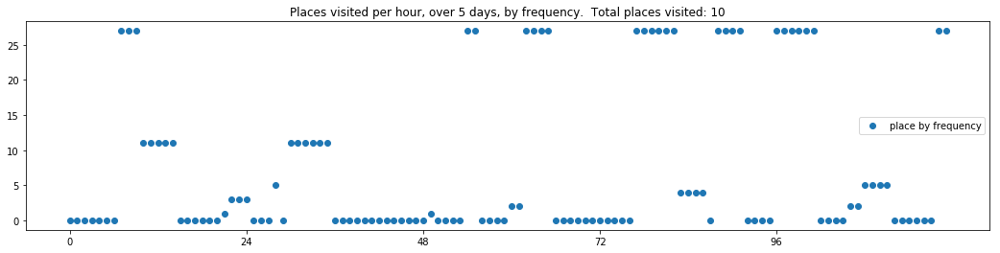

----- vector ----
prefix labels:  [215, 215]
[0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


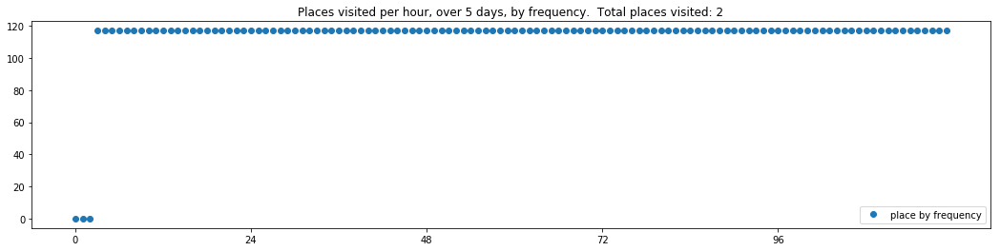

----- vector ----
prefix labels:  [21, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 8, 8, 8, 0, 0, 0, 0, 0]
[0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 591, 0, 0, 21, 21, 21, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 430, 0, 0, 0, 0, 0, 0, 0]


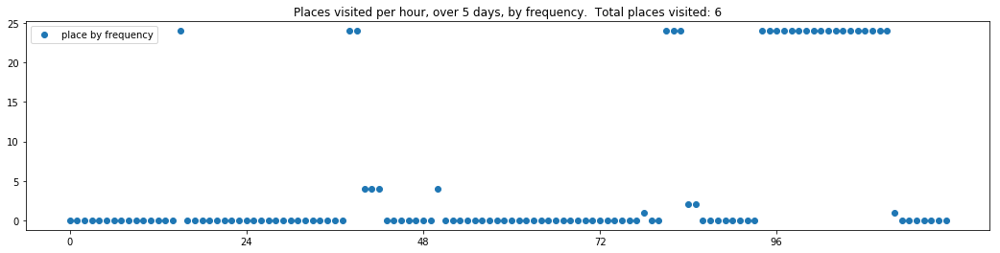

----- vector ----
prefix labels:  [91, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 323, 479, 479, 479, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 479, 217, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 578, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]


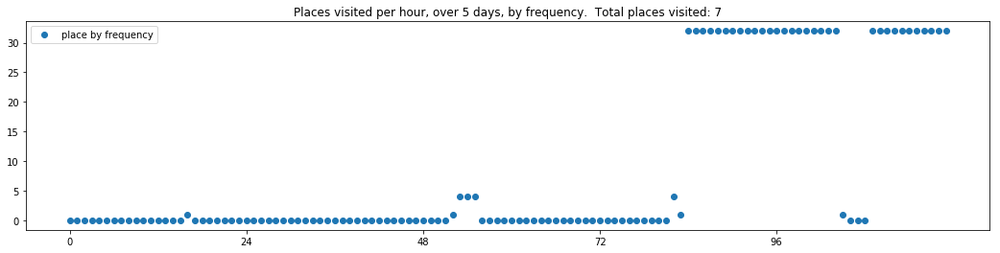

----- vector ----
prefix labels:  [109, 109]
[0, 0, 0, 582, 413, 0, 0, 0, 0, 0, 582, 582, 0, 0, 0, 0, 0, 0, 205, 205, 0, 0, 0, 0]
[0, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 0, 0, 0, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


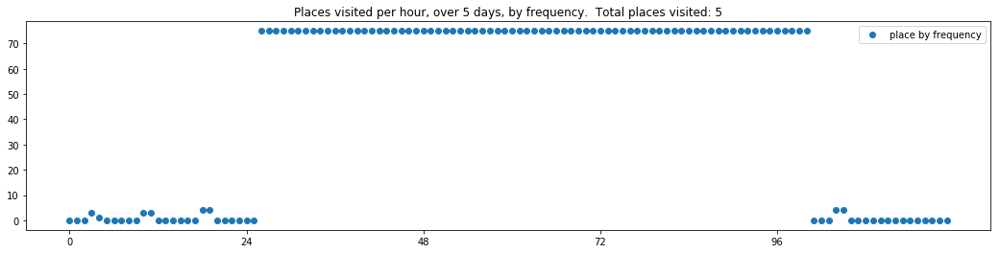

----- vector ----
prefix labels:  [107, 190]
[0, 0, 0, 0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 590, 590, 590, 590, 590, 590, 590, 590, 590]
[590, 0, 0, 0, 390, 0, 0, 0, 0, 0, 0, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 0]
[0, 0, 0, 0, 0, 515, 515, 102, 102, 102, 102, 102, 102, 102, 0, 0, 0, 0, 0, 0, 391, 391, 391, 391]


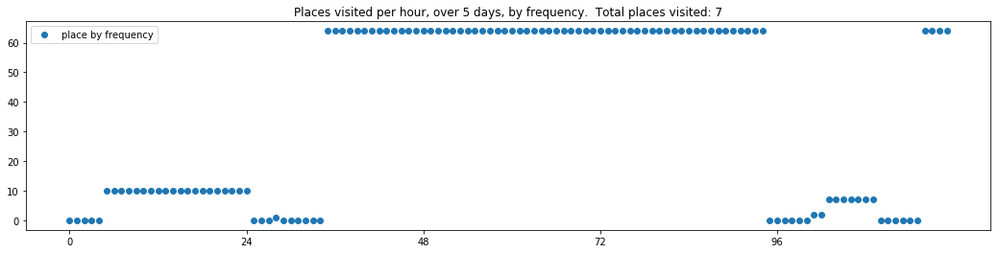

----- vector ----
prefix labels:  [425, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 425, 425, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 425, 425, 0, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 164]
[304, 304, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 304, 0, 0, 0, 0, 0, 304, 304, 304]


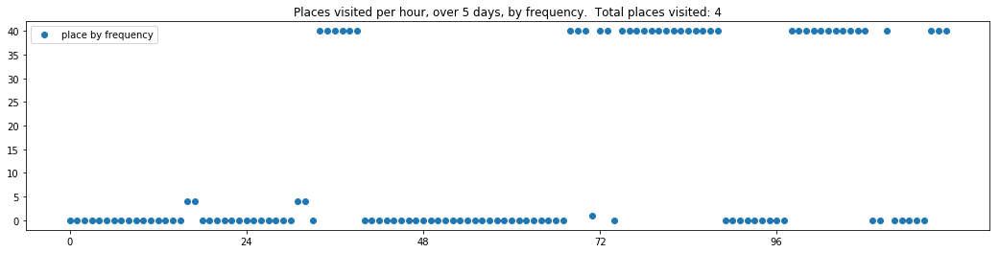

----- vector ----
prefix labels:  [202, 243]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


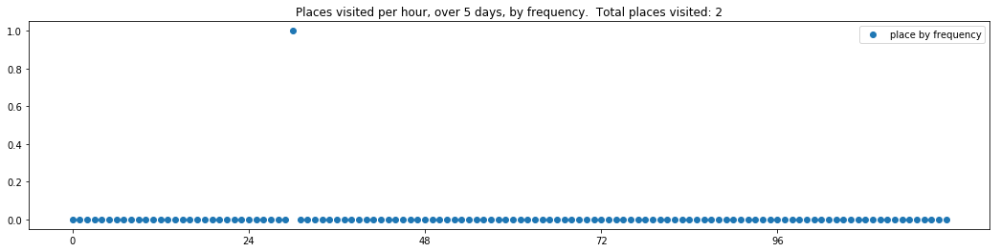

----- vector ----
prefix labels:  [215, 215]
[0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


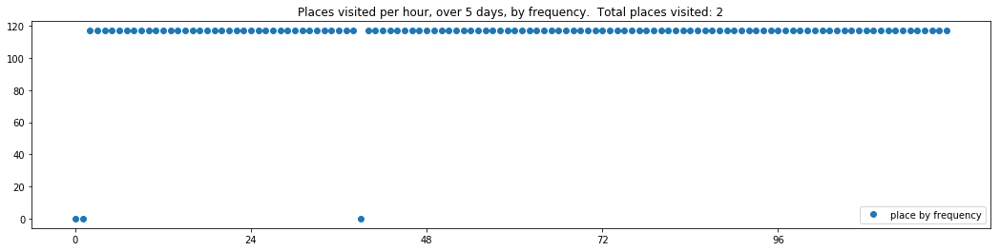

----- vector ----
prefix labels:  [29, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 449, 29, 449, 449, 302, 407, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 432, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 548, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 278, 278, 278]


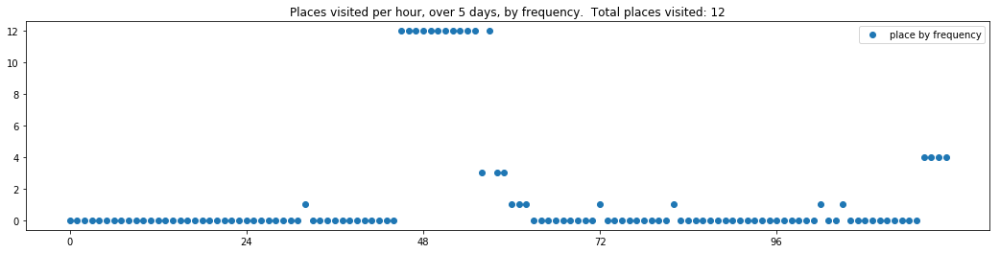

----- vector ----
prefix labels:  [361, 3]
[0, 0, 0, 0, 0, 0, 3, 3, 3, 39, 39, 250, 371, 371, 371, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 306]
[3, 3, 3, 3, 3, 3, 457, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


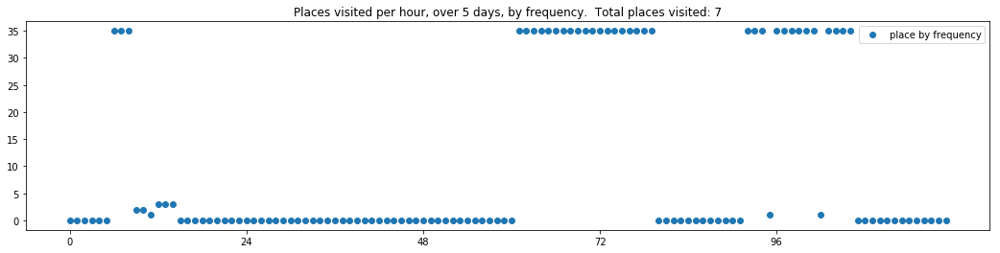

----- vector ----
prefix labels:  [459, 459]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 283, 0, 459, 459, 459, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 283, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459]
[459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459]
[459, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 0, 0]


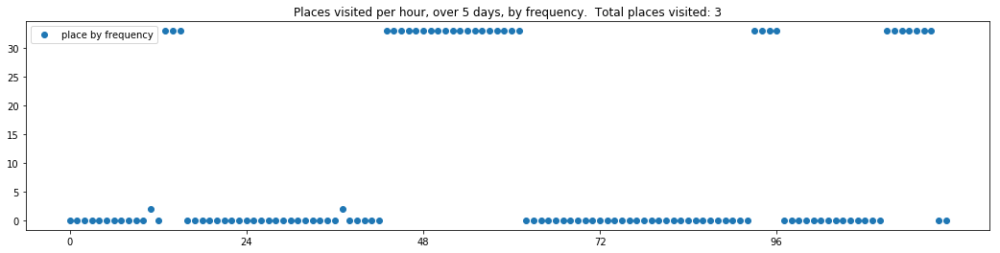

----- vector ----
prefix labels:  [149, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 149, 0, 0]
[0, 0, 0, 0, 149, 149, 149, 149, 0, 149, 149, 149, 149, 149, 149, 149, 149, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 149, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]


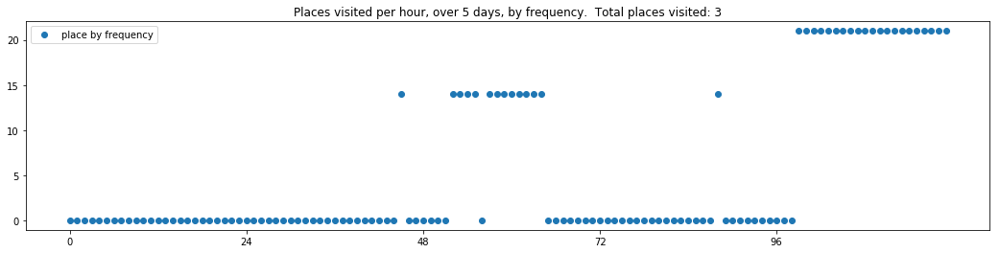

----- vector ----
prefix labels:  [477, 66]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 477, 477, 477, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66, 66]
[0, 0, 21, 21, 0, 22, 477, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 477, 477, 66, 66, 66, 66, 66]
[0, 0, 0, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477, 477]
[477, 353, 353, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


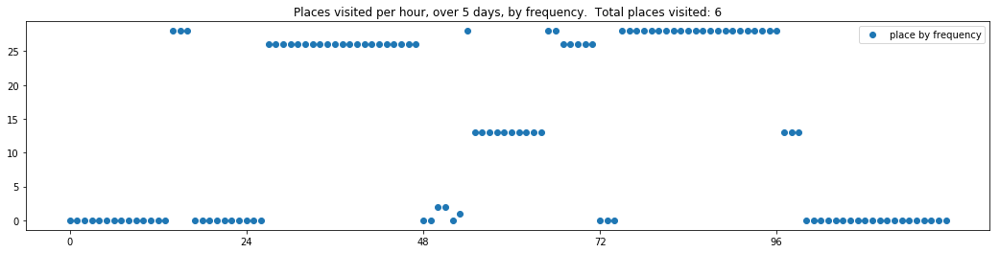

----- vector ----
prefix labels:  [75, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 307, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21]
[21, 21, 21, 198, 198, 0, 0, 0, 0, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 629, 0, 0, 629, 629, 629, 0, 0, 0, 0, 0, 629, 629, 629, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 629, 629, 77, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21]


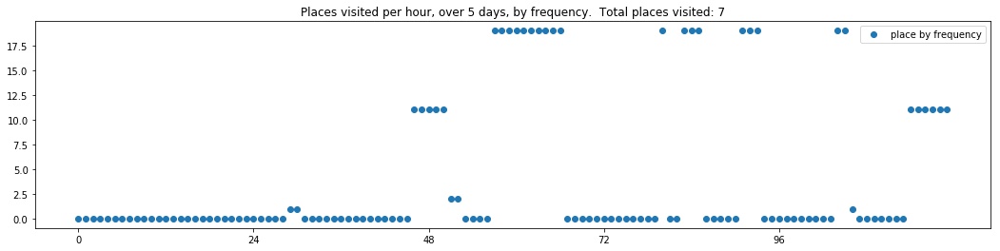

----- vector ----
prefix labels:  [523, 71]
[0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 523, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 186, 0, 0, 71, 71, 71, 71, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


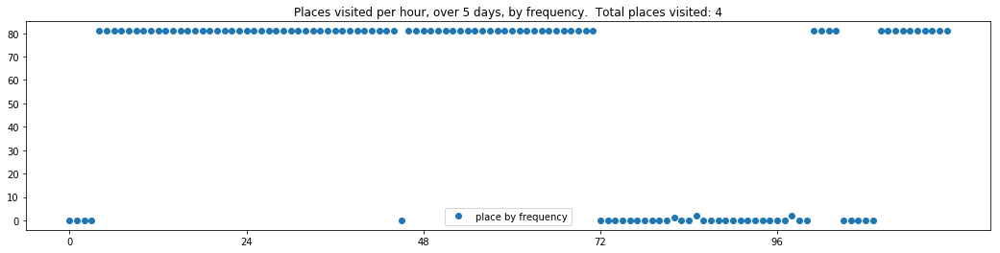

----- vector ----
prefix labels:  [42, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 252, 252, 252, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 345, 0, 0, 0, 0, 0]
[0, 0, 457, 457, 0, 0, 0, 252, 450, 545, 545, 545, 545, 545, 105, 105, 105, 0, 0, 0, 0, 0, 0, 0]
[0, 190, 0, 105, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 105, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


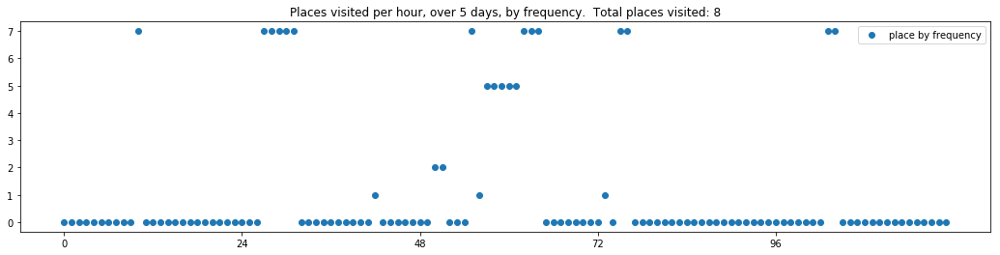

----- vector ----
prefix labels:  [201, 112]
[0, 0, 0, 0, 0, 0, 0, 112, 112, 112, 112, 112, 112, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 112, 68, 68, 112, 112, 112, 112, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 112, 68, 68, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


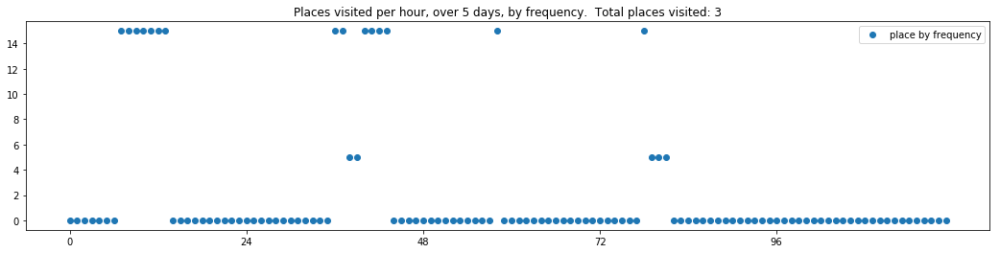

----- vector ----
prefix labels:  [246, 109]
[0, 0, 0, 0, 0, 0, 0, 582, 582, 582, 582, 582, 246, 246, 246, 246, 246, 246, 246, 246, 109, 109, 109, 109]
[364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 162, 162, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 81, 119, 119, 75, 75, 75, 75, 0, 0, 0, 0]
[55, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 322]
[322, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 284, 284, 284, 284, 0, 0, 0, 0, 0, 284, 284]


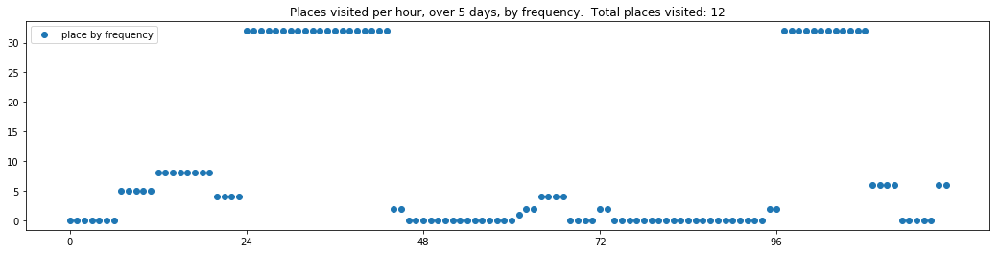

----- vector ----
prefix labels:  [581, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 581, 581, 581, 581, 581, 581, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 121, 0, 357, 357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 456, 0, 581, 581]
[581, 0, 0, 257, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


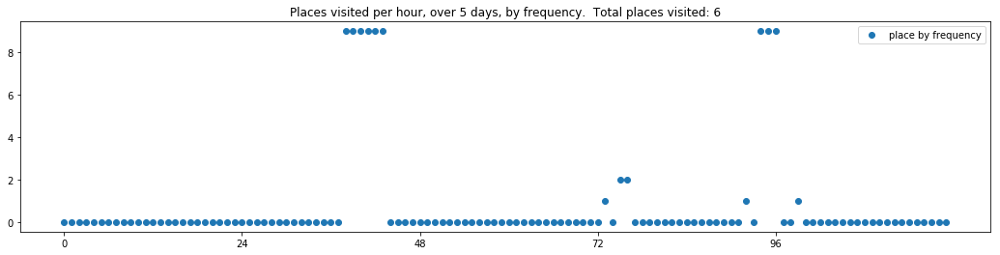

----- vector ----
prefix labels:  [238, 238]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 238, 238, 238, 238, 0, 0, 0, 0]
[0, 0, 0, 0, 183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 238, 0, 0, 0, 0]
[0, 0, 640, 238, 238, 238, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 393, 238, 238, 238, 238]


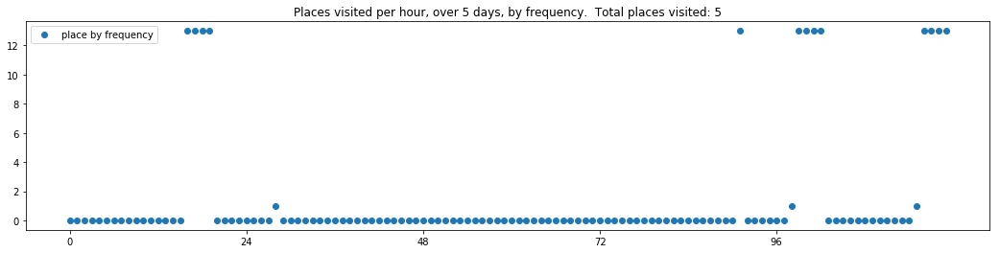

----- vector ----
prefix labels:  [20, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21]
[0, 373, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


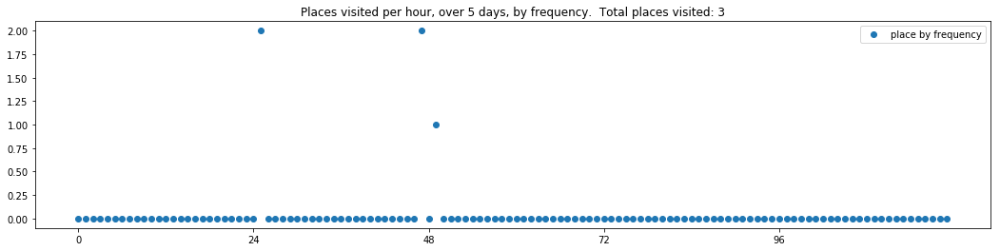

----- vector ----
prefix labels:  [557, 557]
[0, 0, 0, 0, 0, 557, 557, 557, 557, 557, 557, 557, 557, 557, 557, 557, 557, 557, 0, 0, 557, 557, 557, 557]
[557, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 636, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 161, 161, 161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


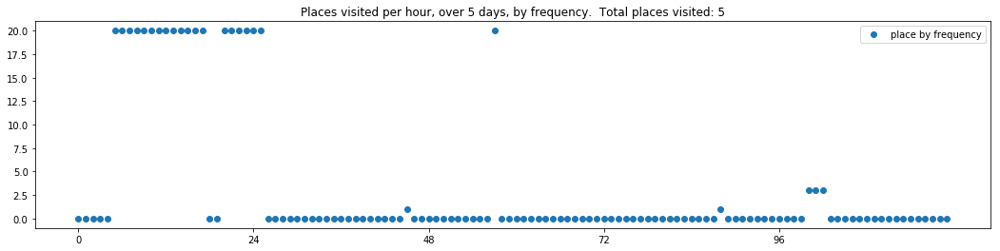

----- vector ----
prefix labels:  [230, 252]
[0, 0, 0, 0, 0, 0, 0, 252, 252, 252, 252, 252, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 213, 213, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 112, 112, 112, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 32, 32, 64, 64, 64]


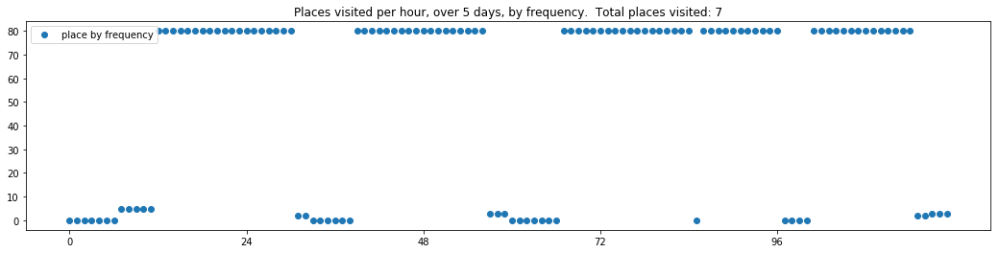

----- vector ----
prefix labels:  [70, 142]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 141, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]


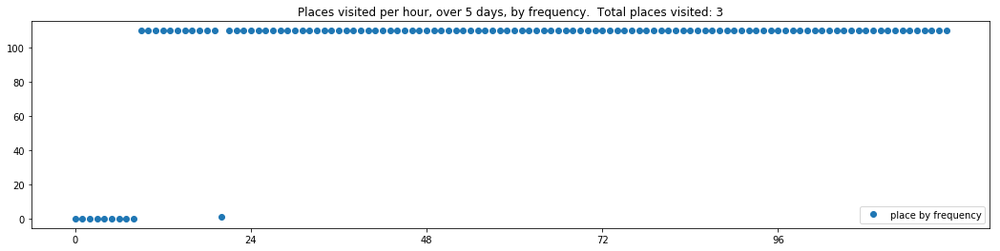

----- vector ----
prefix labels:  [270, 270]
[0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 52, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 0, 0, 0, 270, 271, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


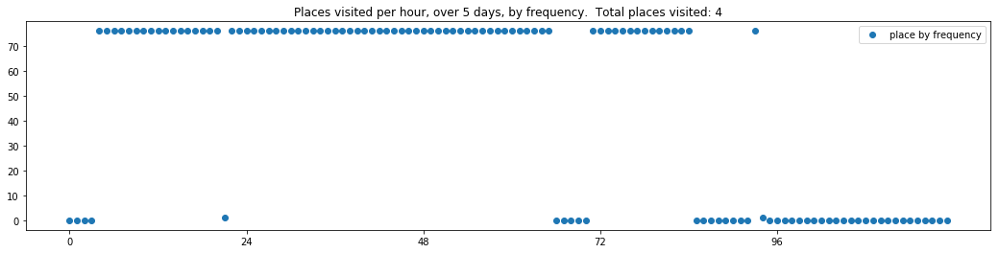

----- vector ----
prefix labels:  [389, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 389, 389, 389, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 344, 0, 0]


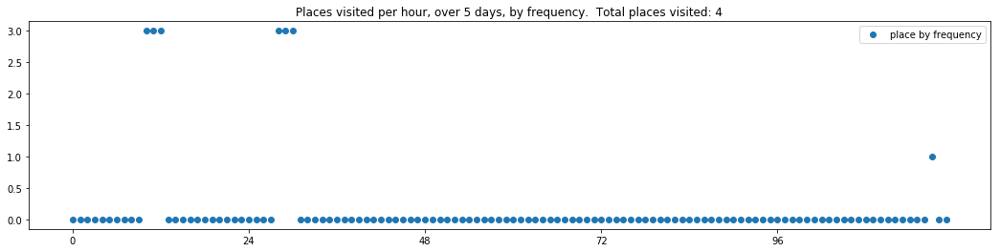

----- vector ----
prefix labels:  [44, 0]
[0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 0, 0, 0]
[44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 248, 248, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 0, 0, 0, 275, 61, 0, 0, 0, 0, 0]


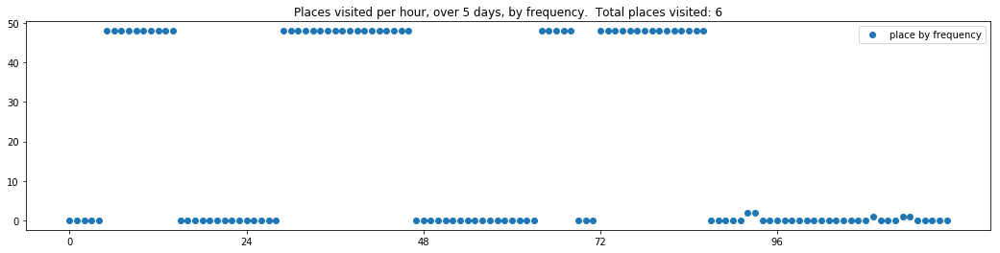

----- vector ----
prefix labels:  [108, 47]
[0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 0, 0, 582, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]


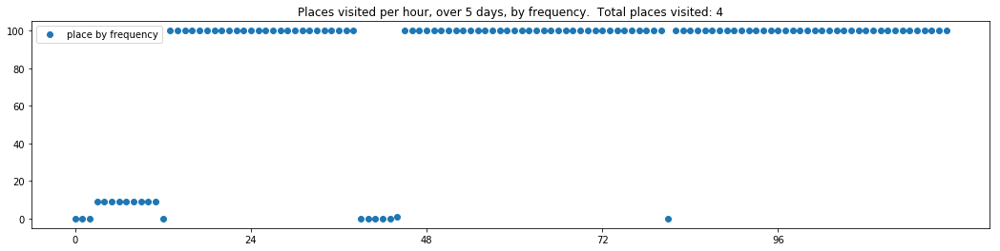

----- vector ----
prefix labels:  [192, 192]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 0]
[0, 0, 448, 448, 448, 0, 85, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 31]
[31, 31, 31, 31, 31, 0, 0, 0, 284, 0, 0, 0, 448, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


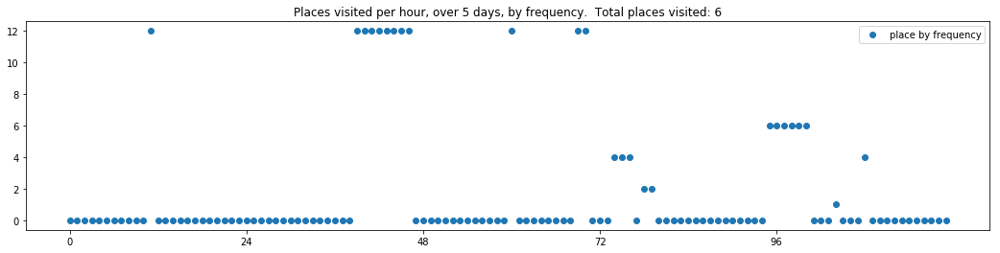

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 328, 341, 341, 415, 415, 415, 415, 415]
[415, 415, 415, 93, 93, 93, 93, 93, 93, 93, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]


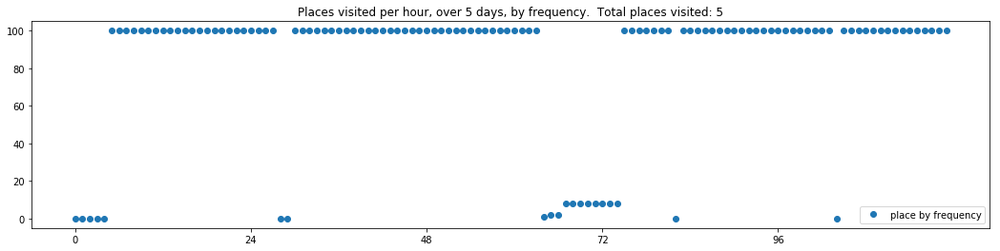

----- vector ----
prefix labels:  [84, 149]
[0, 0, 0, 0, 0, 0, 0, 149, 149, 0, 149, 149, 149, 149, 149, 149, 149, 149, 149, 149, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 132, 132]
[638, 638, 0, 0, 0, 0, 0, 104, 385, 385, 388, 388, 388, 388, 0, 0, 0, 0, 178, 0, 0, 0, 0, 0]
[178, 178, 178, 0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 0, 0, 226, 0, 0, 0, 0]


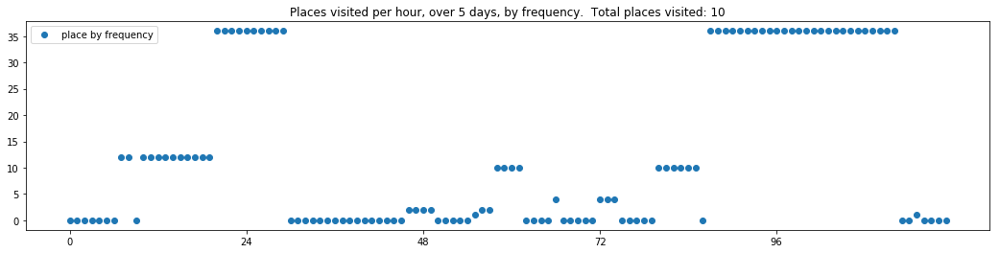

----- vector ----
prefix labels:  [521, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 71, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


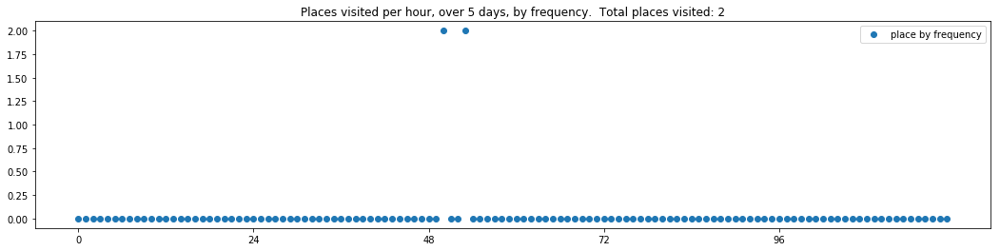

----- vector ----
prefix labels:  [615, 225]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225, 225]
[225, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 225, 225, 225, 225, 225, 225, 225, 225, 225]
[225, 225, 0, 0, 0, 0, 0, 0, 456, 0, 0, 0, 0, 0, 0, 0, 0, 0, 276, 276, 276, 0, 0, 0]
[542, 0, 0, 0, 0, 33, 0, 0, 0, 0, 0, 0, 290, 290, 290, 290, 290, 290, 290, 290, 100, 100, 0, 331]


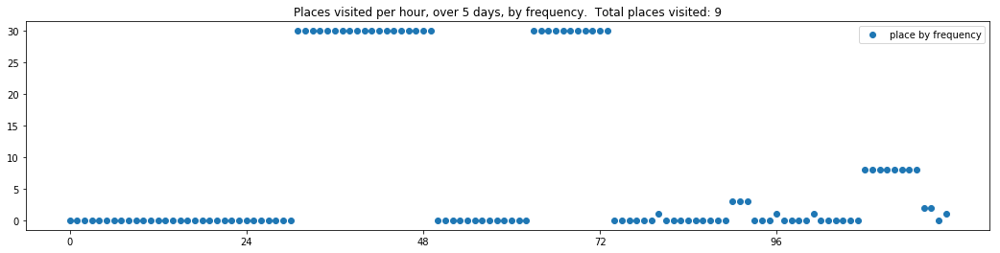

----- vector ----
prefix labels:  [220, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 107, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 320, 320, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 200, 618, 618, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 518, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


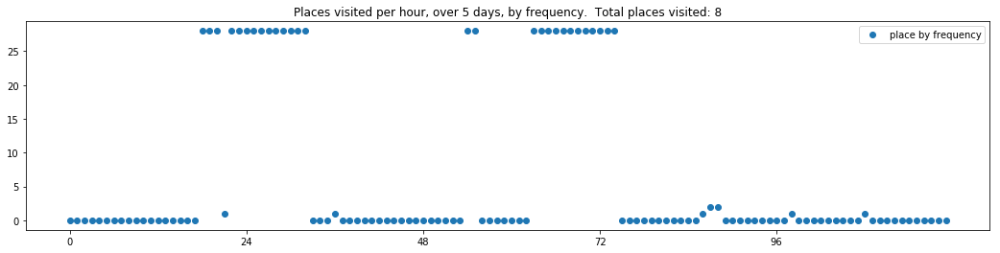

----- vector ----
prefix labels:  [588, 153]
[0, 0, 0, 0, 0, 588, 588, 0, 153, 153, 153, 0, 0, 0, 588, 588, 0, 0, 0, 0, 0, 588, 588, 564]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 465, 465, 465, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 562, 562, 562]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 588, 588, 588, 588, 588, 588, 588, 588, 588, 588, 588]


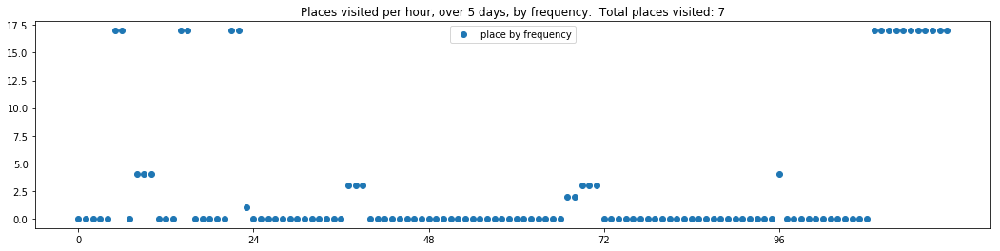

----- vector ----
prefix labels:  [105, 105]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 105, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 105, 105, 105, 105, 105, 105, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 105, 105, 105, 105, 105, 105, 105, 105, 105, 105, 0, 177, 177, 177, 177, 0, 0, 0]
[105, 105, 105, 105, 105, 105, 105, 105, 0, 105, 105, 105, 105, 0, 0, 105, 105, 105, 105, 105, 105, 105, 0, 0]


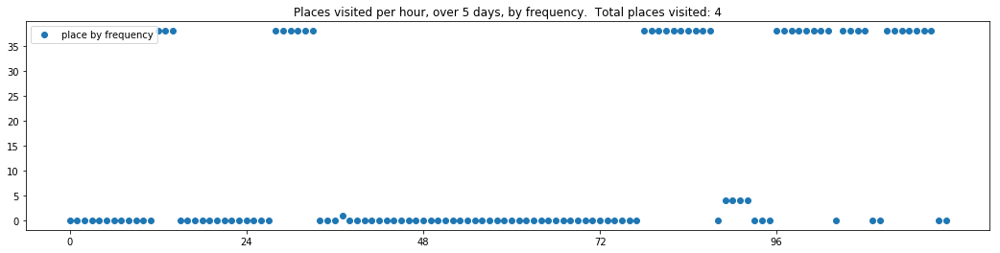

----- vector ----
prefix labels:  [162, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162]
[162, 162, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


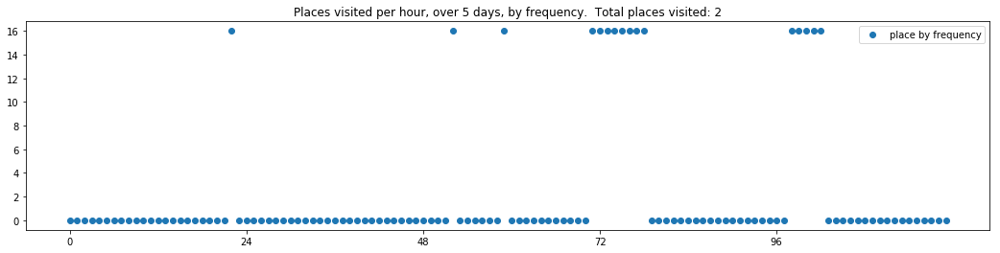

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21]
[21, 116, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 21, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 21, 21, 21, 21, 21, 21, 21, 0, 0]
[0, 371, 371, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 362, 0, 0, 0]


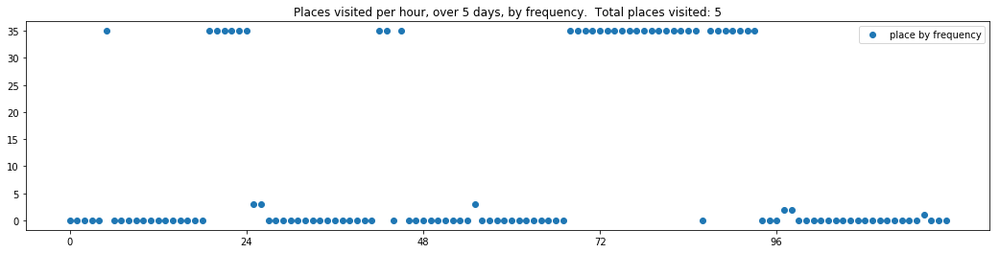

----- vector ----
prefix labels:  [586, 209]
[0, 0, 0, 0, 0, 586, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475, 209]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 288, 288, 0]
[0, 0, 0, 0, 0, 140, 140, 140, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 0, 0, 0, 0]


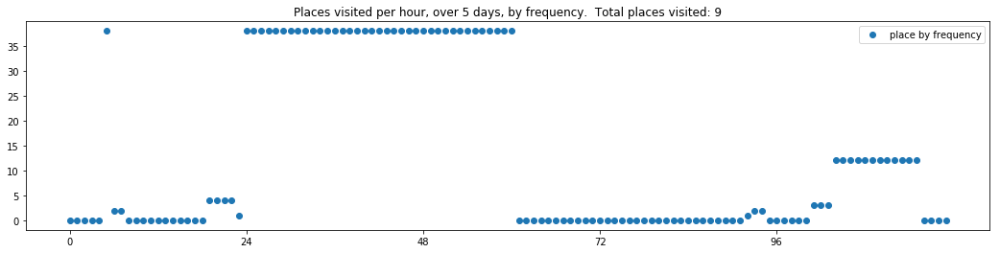

----- vector ----
prefix labels:  [140, 297]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 182, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 297, 0, 39, 39, 39, 71, 0, 71, 71, 71, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0]


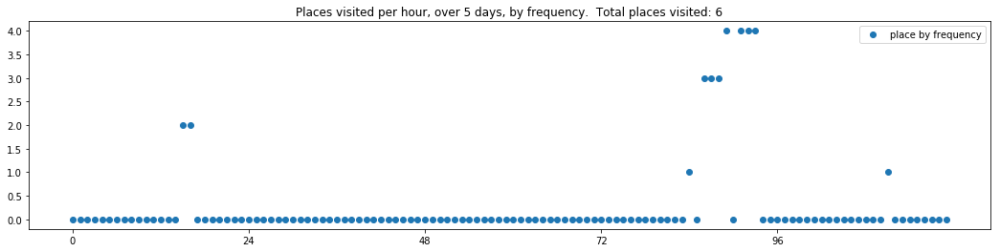

----- vector ----
prefix labels:  [558, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 8]
[8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 0, 0, 0]
[0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 76, 0, 0, 0, 0, 0, 0, 0, 0, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8]


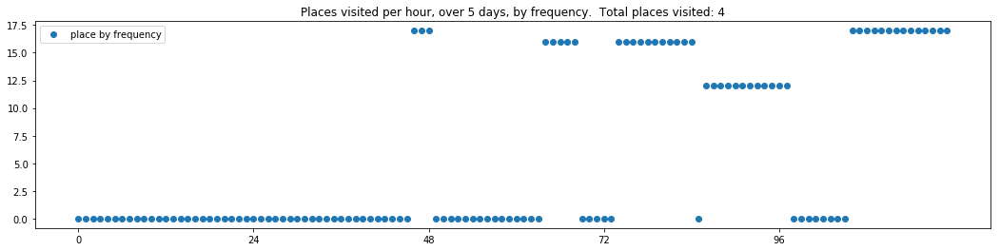


------
 35 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_35.txt 
------

----- vector ----
prefix labels:  [596, 596]
[0, 0, 0, 0, 596, 596, 0, 0, 0, 0, 0, 0, 0, 0, 0, 596, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 596, 0, 596, 596, 596, 0, 0, 596, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


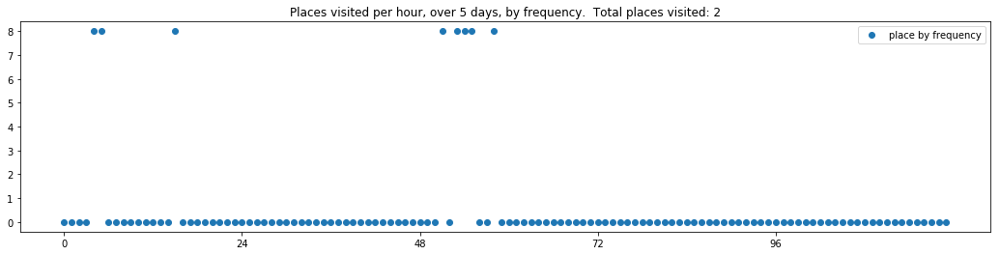

----- vector ----
prefix labels:  [108, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 47, 246, 548, 0, 22, 47, 47, 47, 47, 47, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 434, 0, 0, 0, 46, 0, 400, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


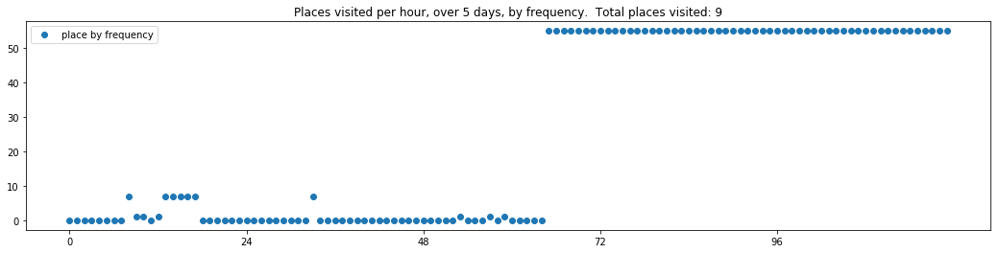

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 328, 328, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 0, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]


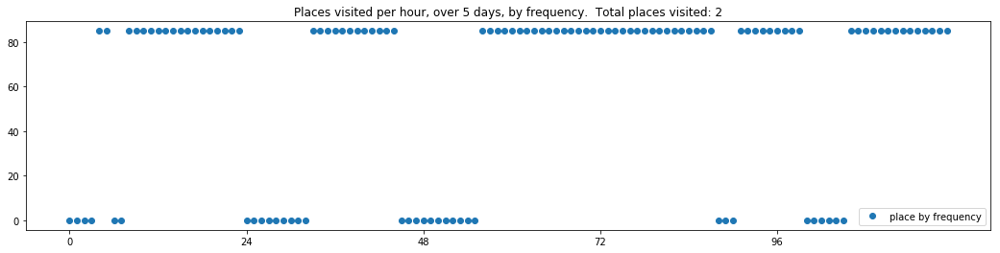

----- vector ----
prefix labels:  [32, 370]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 72, 0, 0, 0, 0]
[332, 332, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 38, 38, 38, 38, 38]


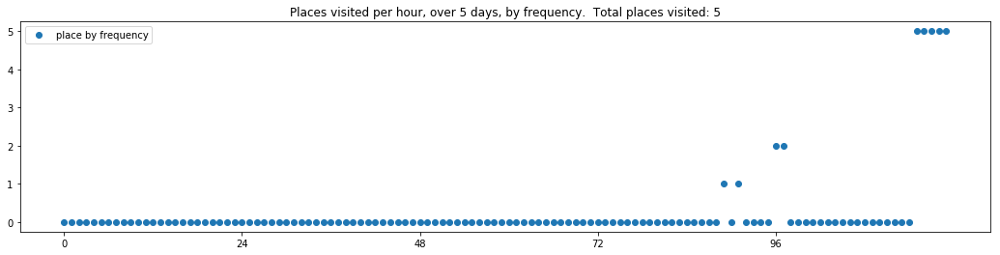

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 0, 185, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]


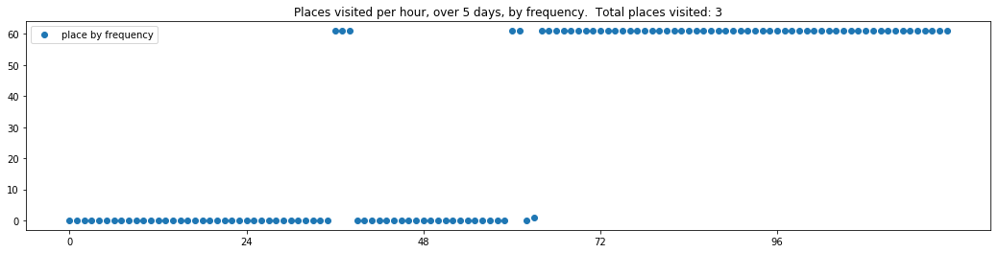

----- vector ----
prefix labels:  [183, 183]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 183, 183, 183]
[183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545]
[545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545]


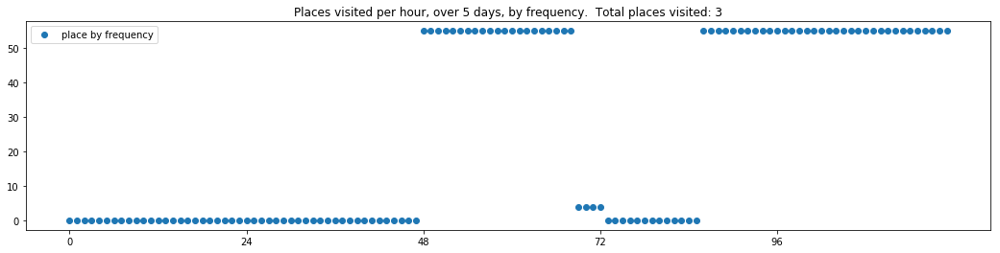

----- vector ----
prefix labels:  [231, 231]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 231, 231, 0, 60, 0, 0, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0]
[140, 140, 140, 293, 293, 72, 72, 72, 72, 182, 182, 203, 203, 203, 203, 203, 427, 31, 32, 32, 32, 32, 32, 32]
[32, 371, 371, 259, 203, 203, 203, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 0, 0, 412]
[412, 412, 412, 248, 248, 2, 0, 0, 0, 0, 0, 0, 0, 0, 259, 0, 0, 0, 0, 568, 0, 0, 0, 0]


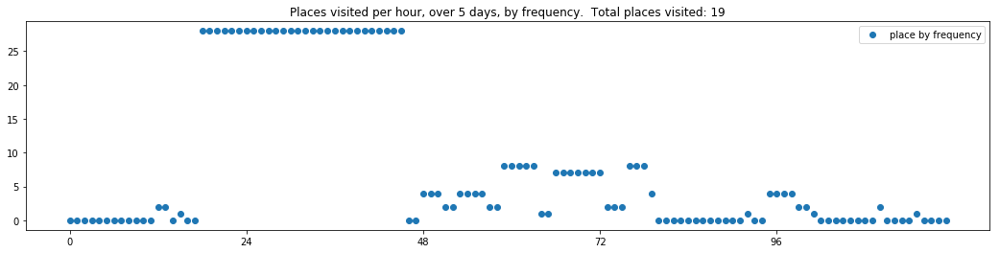

----- vector ----
prefix labels:  [226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 181, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 418, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]


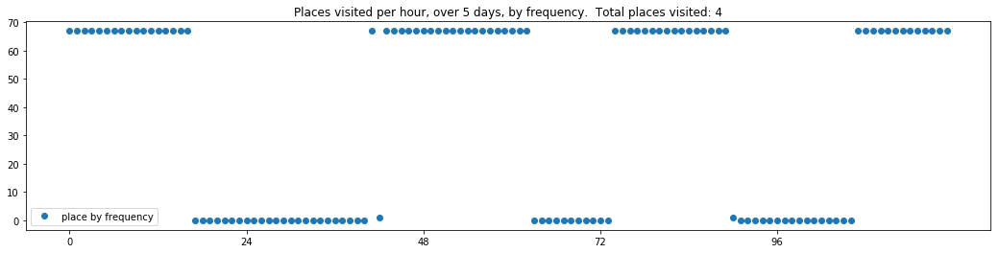

----- vector ----
prefix labels:  [280, 278]
[0, 0, 0, 0, 0, 0, 0, 398, 398, 398, 398, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]


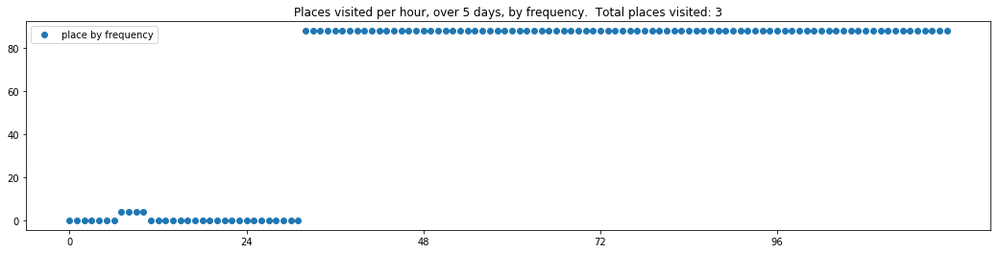

----- vector ----
prefix labels:  [232, 0]
[0, 0, 336, 0, 288, 0, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 446]
[446, 446, 446, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 30, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[81, 81, 81, 81, 81, 81, 81, 81, 81, 81, 81, 75, 75, 75, 75, 0, 0, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]


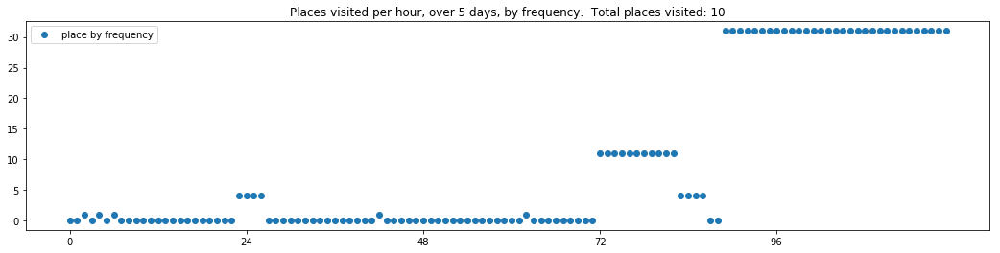

----- vector ----
prefix labels:  [565, 146]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 629, 629, 629, 629, 0, 220, 220, 220, 220, 629, 395, 0]
[367, 367, 367, 0, 0, 0, 0, 0, 146, 146, 0, 623, 410, 410, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 367, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 629, 629, 0, 0, 0, 0, 0, 0, 0, 565, 565, 565, 565, 565, 565, 565, 565, 565, 565, 565]
[565, 565, 565, 565, 0, 259, 0, 340, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 340, 340, 340]


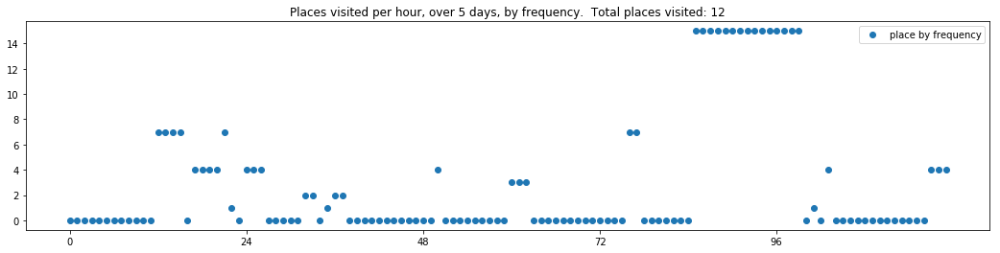

----- vector ----
prefix labels:  [248, 248]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 248, 248, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


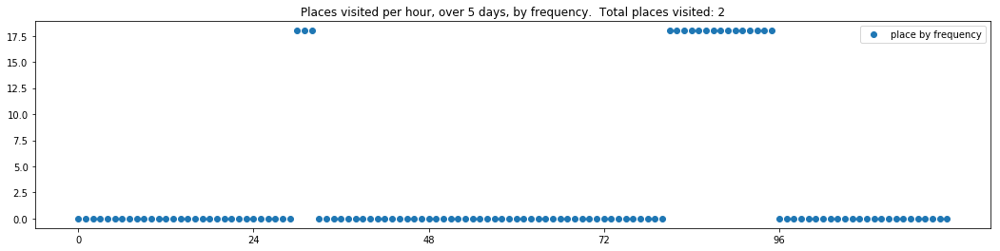

----- vector ----
prefix labels:  [318, 318]
[0, 0, 0, 0, 0, 0, 0, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 318, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 539, 539, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 318, 0, 328, 328, 433, 385, 385, 385, 0, 107, 107, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 0]


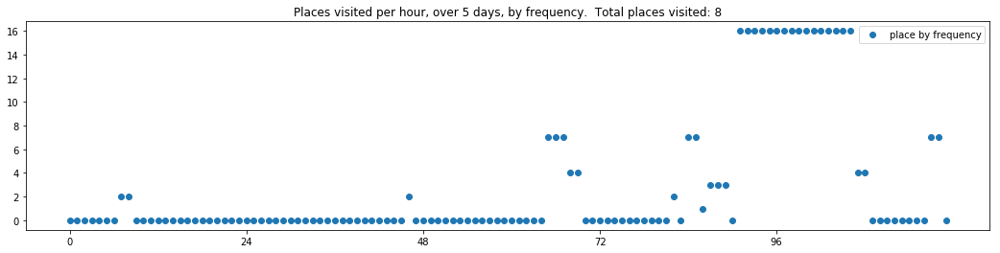

----- vector ----
prefix labels:  [371, 371]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 371, 371, 371, 371, 371, 371, 0, 371, 371, 371]
[371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371]
[371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 20, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371, 371]


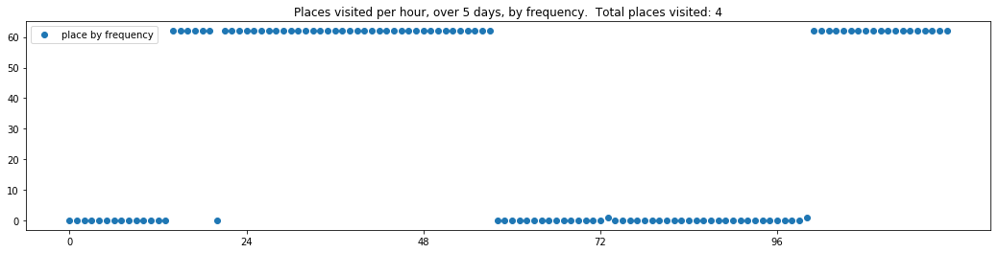

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44]
[44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44]
[44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 194, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 109, 44, 44, 44, 44, 44]
[44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44]


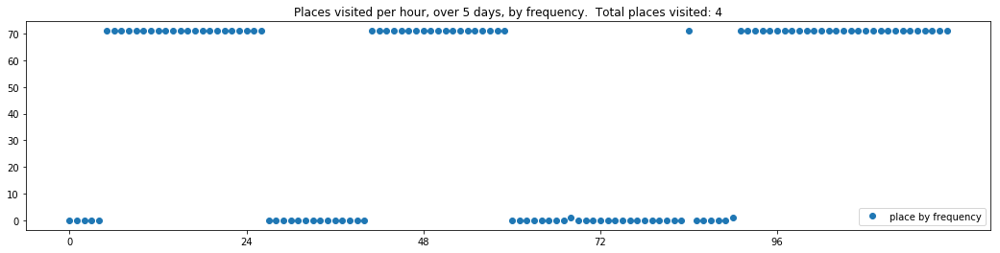

----- vector ----
prefix labels:  [84, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 119, 119]
[0, 0, 0, 0, 0, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


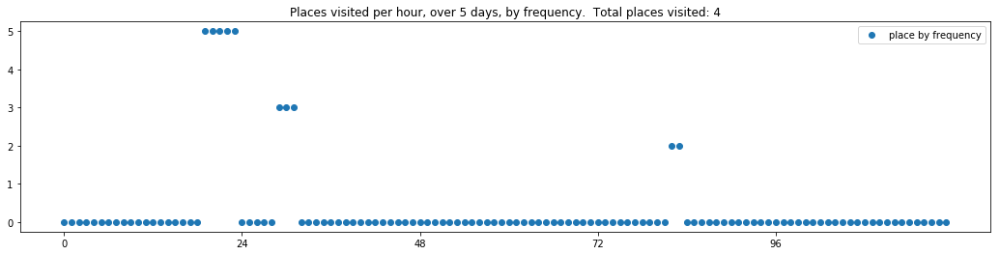

----- vector ----
prefix labels:  [412, 465]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 82, 496, 323]
[224, 224, 133, 331, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 80, 80, 80, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364]
[364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 629, 629, 629, 629, 0, 276, 276, 0, 0, 0, 0, 0, 0, 101, 0, 0, 0, 0]


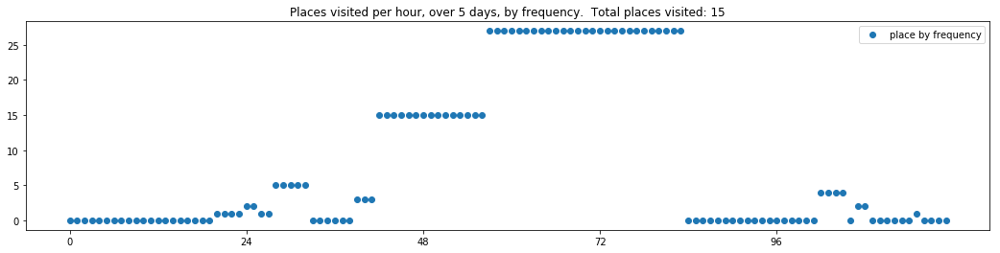

----- vector ----
prefix labels:  [47, 47]
[0, 0, 0, 0, 0, 0, 0, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 0, 0, 47, 47, 47, 47]
[0, 0, 0, 0, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 0, 353, 353, 353]
[353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


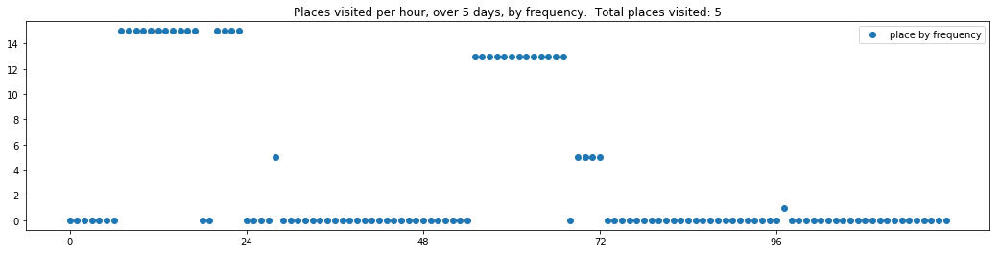

----- vector ----
prefix labels:  [123, 123]
[270, 270, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[0, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 123, 0, 0, 0, 0, 199, 199]
[199, 199, 199, 199, 347, 465, 465, 22, 22, 22, 0, 0, 0, 0, 0, 0, 0, 317, 317, 317, 317, 317, 317, 317]
[317, 317, 317, 317, 59, 126, 126, 46, 46, 46, 46, 44, 44, 44, 0, 0, 112, 317, 317, 317, 0, 86, 46, 46]


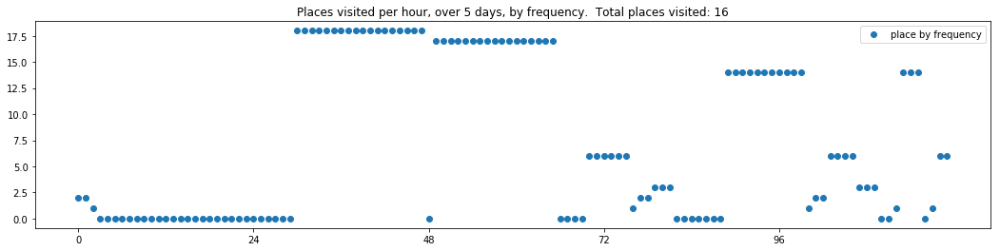

----- vector ----
prefix labels:  [406, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


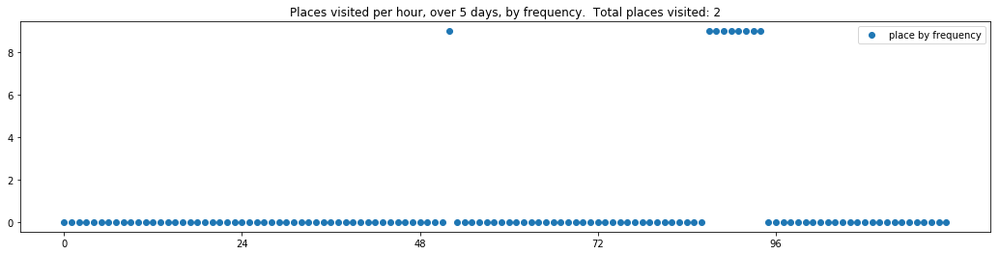

----- vector ----
prefix labels:  [478, 115]
[0, 0, 0, 0, 115, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 7, 478, 478, 478, 478, 478, 478, 484, 484, 484, 484]
[484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484, 484]
[484, 484, 484, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 26, 565, 44, 44, 0, 0, 0, 0, 0, 0, 565, 565, 565, 565, 565, 0]


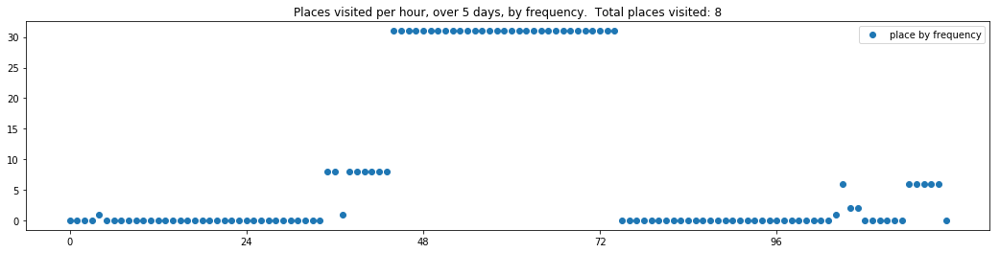

----- vector ----
prefix labels:  [13, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 15, 15]


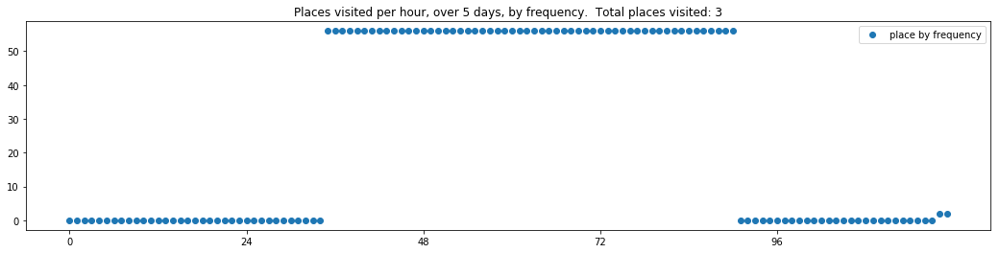

----- vector ----
prefix labels:  [626, 626]
[0, 0, 61, 214, 214, 214, 0, 0, 187, 187, 214, 187, 187, 0, 0, 0, 0, 562, 562, 562, 562, 390, 0, 0]
[0, 549, 0, 0, 0, 0, 0, 0, 214, 0, 0, 0, 562, 562, 71, 71, 71, 71, 214, 596, 596, 187, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410]
[410, 410, 410, 410, 410, 410, 0, 0, 0, 0, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 390, 0]
[390, 0, 0, 0, 0, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 462, 632, 390, 0, 555, 555, 555, 555]


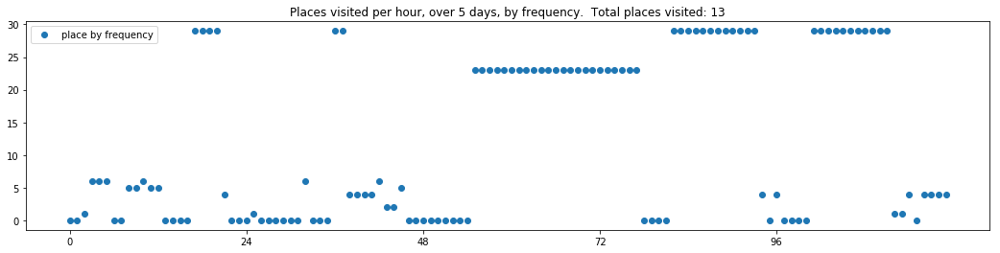

----- vector ----
prefix labels:  [458, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 21, 21, 21, 21, 21, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]


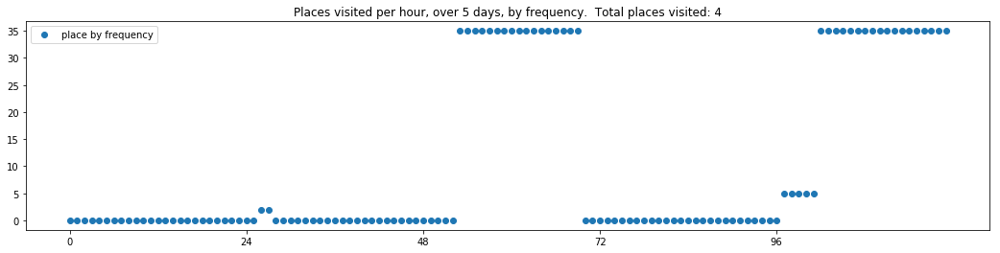

----- vector ----
prefix labels:  [69, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 0, 69, 69, 69, 69, 69, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


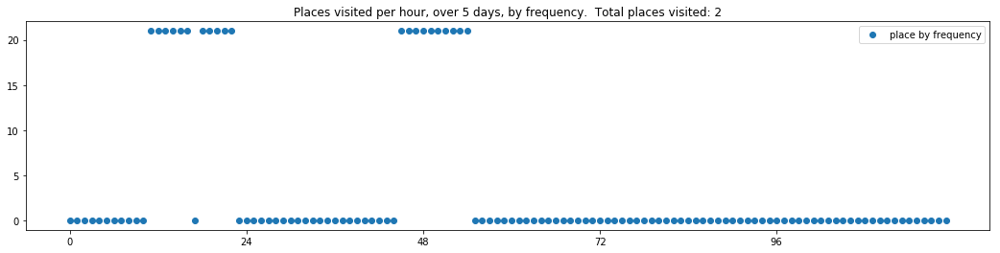

----- vector ----
prefix labels:  [393, 393]
[0, 0, 0, 0, 0, 0, 0, 0, 393, 393, 393, 393, 393, 393, 393, 393, 393, 393, 393, 0, 0, 0, 0, 0]
[385, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 286, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[286, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


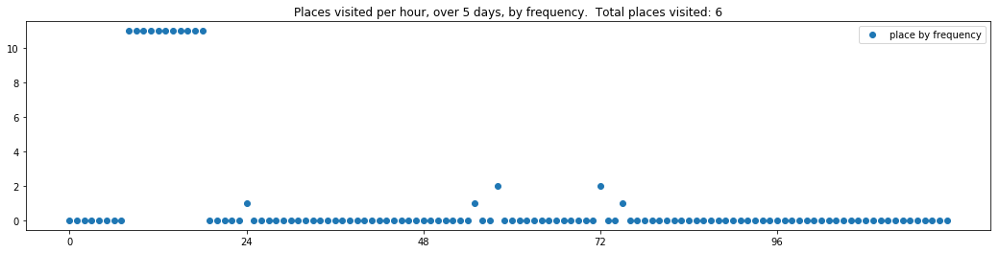

----- vector ----
prefix labels:  [462, 462]
[0, 0, 0, 0, 0, 0, 0, 462, 0, 0, 0, 0, 341, 539, 539, 0, 200, 0, 0, 539, 539, 539, 539, 539]
[539, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 462, 462, 462, 462, 93, 462, 462, 462, 462, 462, 0, 0, 0, 0, 224, 462, 462, 462, 462, 462, 462, 462, 462]
[462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 462, 0, 0, 462, 462, 462, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 453, 462, 462, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


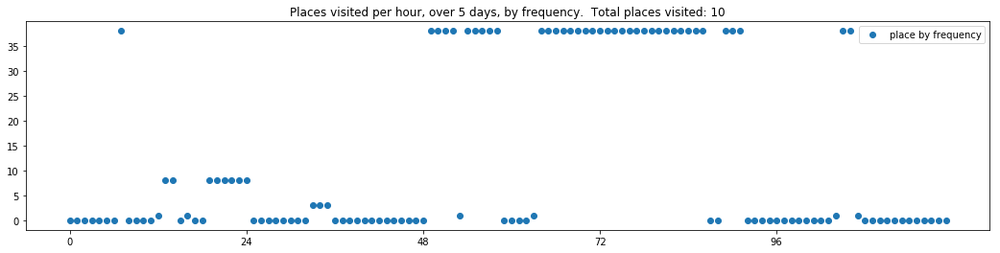

----- vector ----
prefix labels:  [153, 153]
[0, 0, 0, 0, 420, 74, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 153, 153, 0, 32, 0, 0]
[0, 0, 0, 248, 153, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459]
[459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 0, 0, 0]
[124, 124, 124, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 565, 0, 71, 0, 0]
[0, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126]


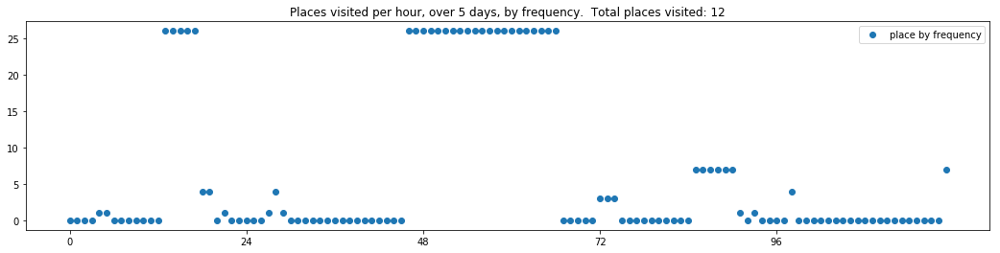

----- vector ----
prefix labels:  [97, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


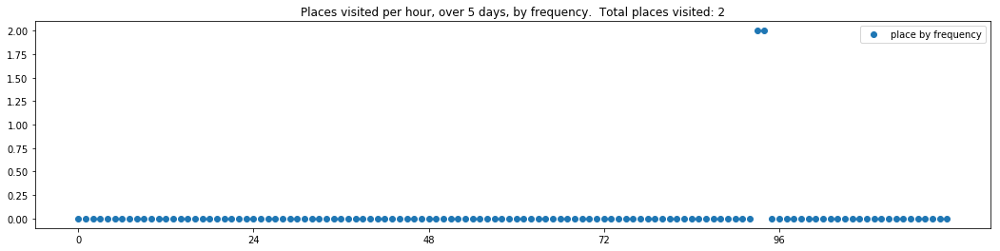

----- vector ----
prefix labels:  [406, 406]
[0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 406, 406, 406, 406, 406, 406, 0, 0, 0, 0, 0, 579, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 452, 452, 117, 117, 117, 0, 0, 0, 0, 31, 406, 406, 406]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 0, 18, 18, 0, 406, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406]


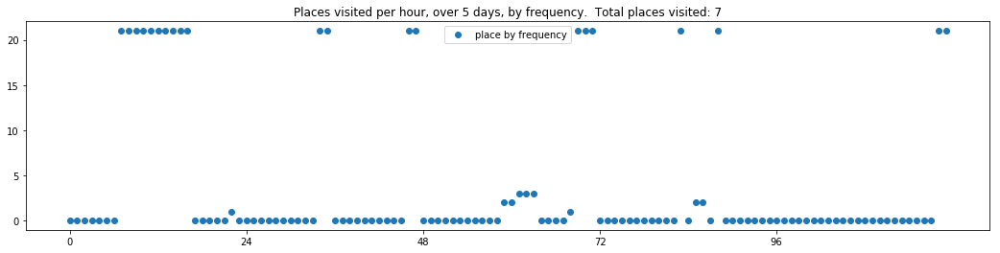

----- vector ----
prefix labels:  [215, 215]
[0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215]


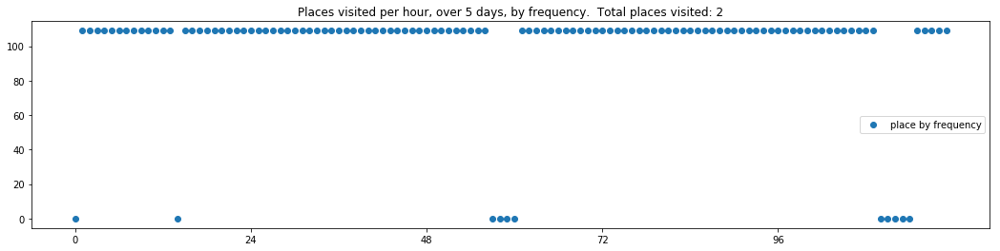

----- vector ----
prefix labels:  [76, 634]
[0, 0, 0, 21, 21, 21, 21, 8, 8, 69, 21, 21, 115, 115, 410, 410, 410, 69, 0, 0, 0, 0, 0, 132]
[132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 132, 21, 21, 29, 8, 8, 0, 8, 8, 0, 0, 0, 551, 551]
[551, 374, 374, 374, 374, 374, 410, 410, 410, 410, 0, 551, 551, 21, 0, 0, 0, 0, 0, 0, 146, 21, 21, 21]
[21, 132, 132, 638, 395, 638, 8, 8, 8, 8, 33, 8, 8, 8, 8, 8, 8, 8, 8, 410, 410, 410, 410, 410]
[410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 410]


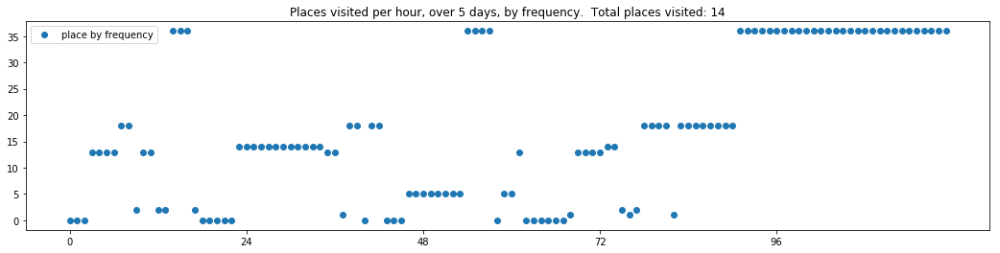

----- vector ----
prefix labels:  [124, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 635, 635, 0, 0, 0, 126, 124, 124, 124, 124, 124, 124]
[124, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 90, 90, 0, 0]


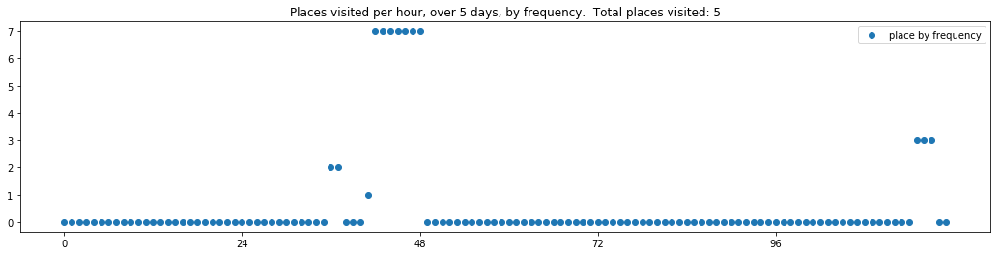

----- vector ----
prefix labels:  [369, 369]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


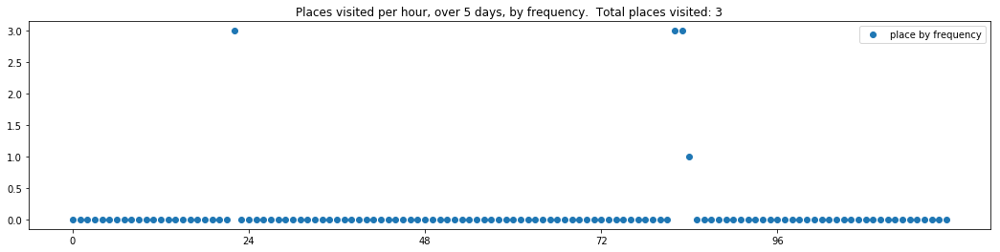

----- vector ----
prefix labels:  [118, 76]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 267, 574, 574, 574, 574, 574, 0, 0, 0, 0]
[0, 0, 0, 325, 334, 334, 334, 94, 0, 0, 0, 0, 0, 0, 306, 306, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 213, 158, 0, 0, 0, 0, 0, 0, 0, 184, 184, 221, 221, 221, 221, 221, 221, 221, 0, 522, 522]
[522, 522, 522, 56, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 522, 0, 0]


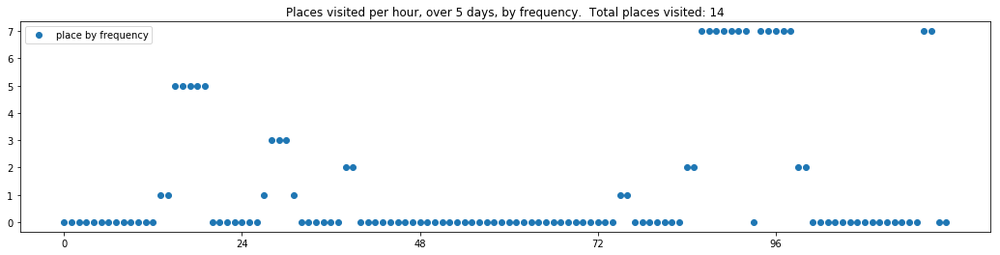

----- vector ----
prefix labels:  [79, 20]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 287, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]


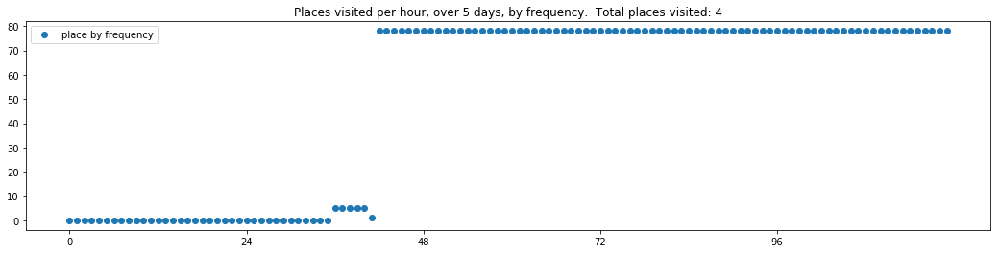

----- vector ----
prefix labels:  [88, 88]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 591, 591, 591, 591, 591, 591, 591, 591, 591]


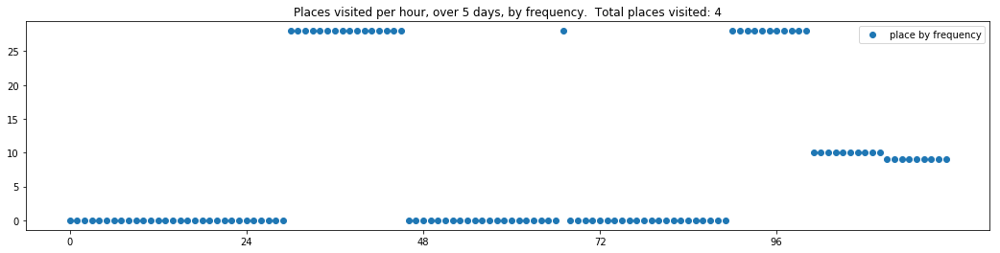

----- vector ----
prefix labels:  [506, 209]
[0, 0, 0, 0, 0, 456, 456, 456, 456, 126, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 506, 506, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 364, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 506, 506, 506, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 456, 0, 0, 0, 0, 503, 0, 0, 0, 0, 0, 506, 0, 0, 506, 0, 0]


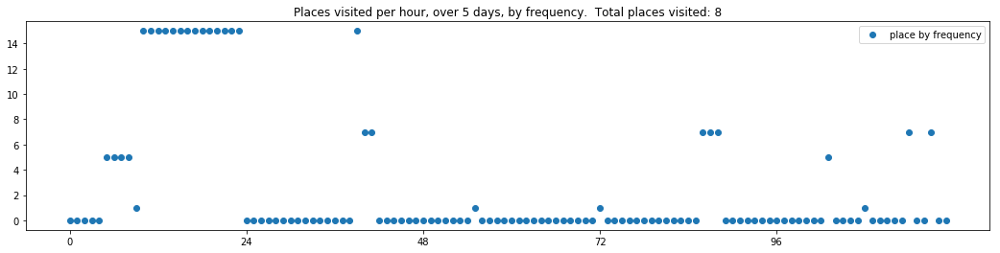

----- vector ----
prefix labels:  [142, 142]
[0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 0, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0]
[142, 142, 0, 142, 142, 142, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 142, 142, 142, 142, 142, 142, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 0]
[0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


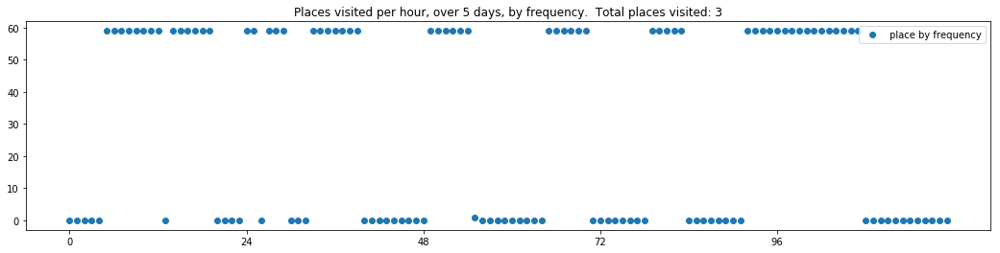

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 0, 20, 0, 0, 0, 0, 319, 0, 0]
[0, 0, 0, 0, 0, 0, 35, 0, 0, 0, 0, 0, 0, 0, 0, 507, 507, 507, 0, 0, 0, 0, 507, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 439, 317, 74, 0, 0, 0, 0, 406, 406, 0, 0, 0]
[0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 221, 2, 0, 0, 0, 0, 0, 0, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0]


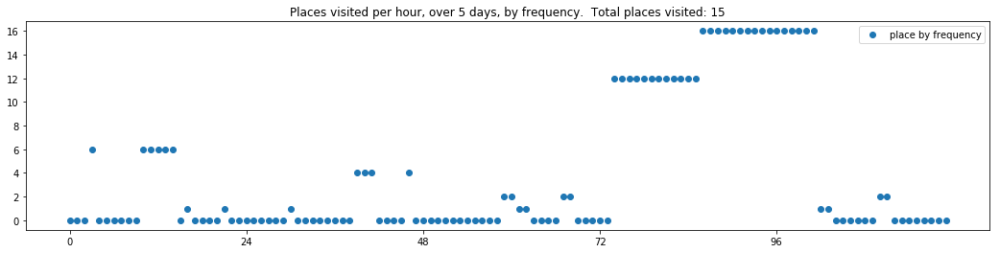

----- vector ----
prefix labels:  [267, 76]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


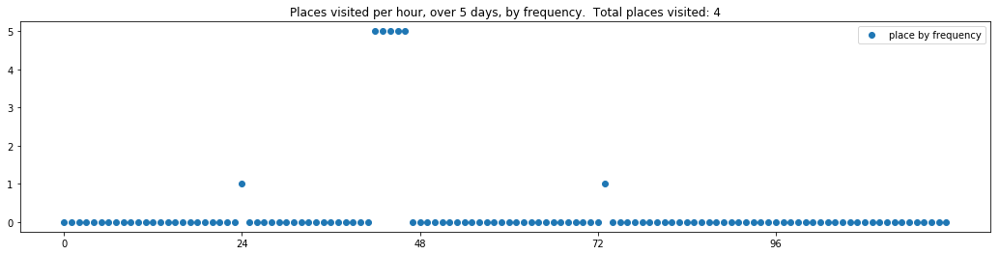

----- vector ----
prefix labels:  [541, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


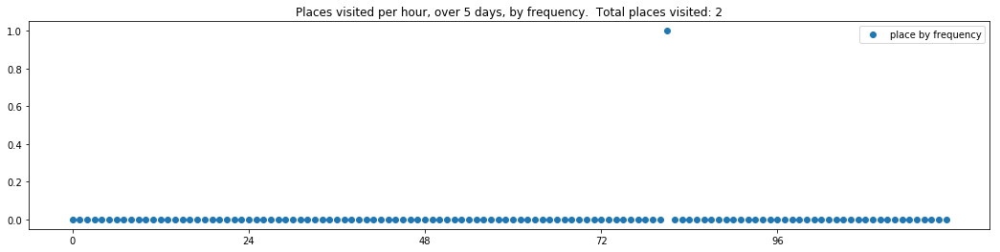

----- vector ----
prefix labels:  [389, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 0, 0, 0, 304, 0]
[0, 0, 0, 0, 389, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304]
[0, 311, 304, 304, 304, 304, 0, 0, 304, 0, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 389, 389, 389, 389, 389, 389, 389, 389, 389, 389, 389, 389, 389]


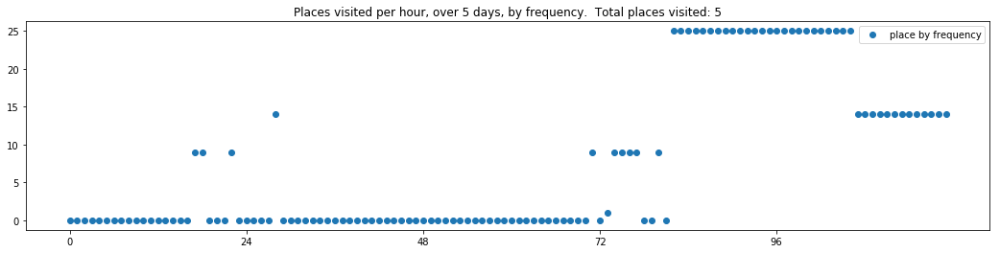

----- vector ----
prefix labels:  [638, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 522, 522, 0, 0, 0, 642, 0, 0]
[0, 0, 0, 341, 341, 0, 0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 0, 0, 522, 522, 522, 522, 522, 522]
[522, 522, 522, 522, 522, 522, 522, 0, 0, 0, 522, 522, 0, 0, 522, 522, 522, 522, 522, 522, 0, 0, 0, 0]
[0, 0, 0, 0, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 389, 0, 0, 0, 0, 0, 0]
[522, 522, 522, 522, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 296, 0, 0, 0, 0, 0, 0, 0]


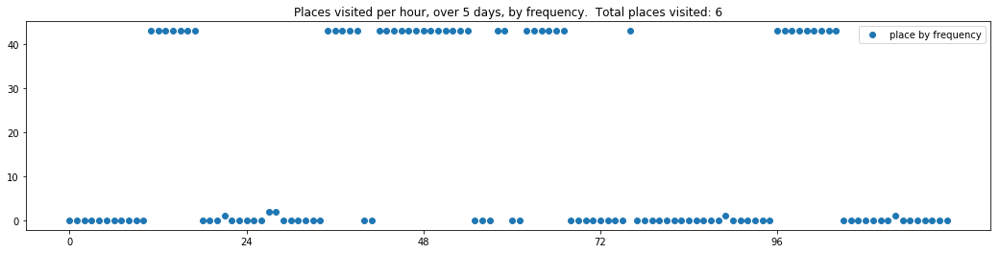

----- vector ----
prefix labels:  [185, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 0, 70, 0, 0, 112, 112]
[112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


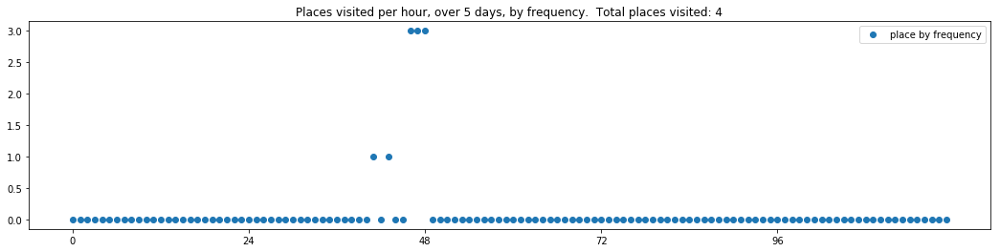

----- vector ----
prefix labels:  [11, 11]
[11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11]
[11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11]
[11, 11, 151, 11, 11, 11, 11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 11, 11, 11, 11, 0, 0, 0, 11, 11, 0, 11, 11, 22]
[11, 11, 11, 11, 11, 11, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


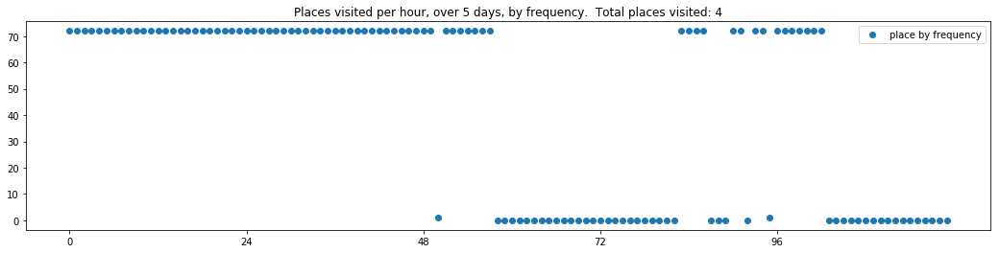

----- vector ----
prefix labels:  [415, 373]
[0, 0, 0, 0, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 0, 0, 0, 0, 0, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


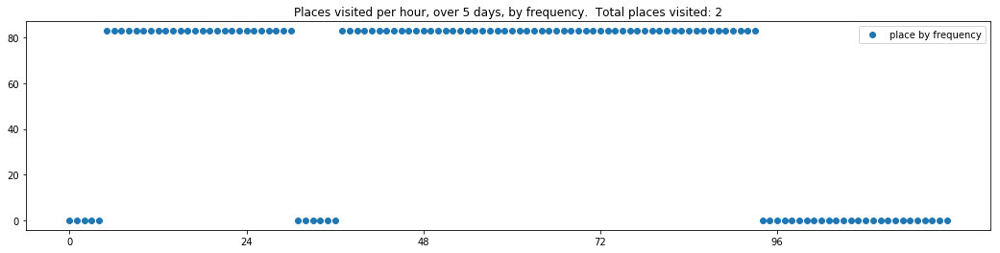

----- vector ----
prefix labels:  [463, 99]
[0, 0, 185, 0, 0, 0, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 336, 336, 336]
[336, 342, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 631, 336, 336, 336, 336, 336, 336, 336]
[336, 0, 0, 386, 0, 180, 40, 40, 40, 40, 40, 40, 42, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40]


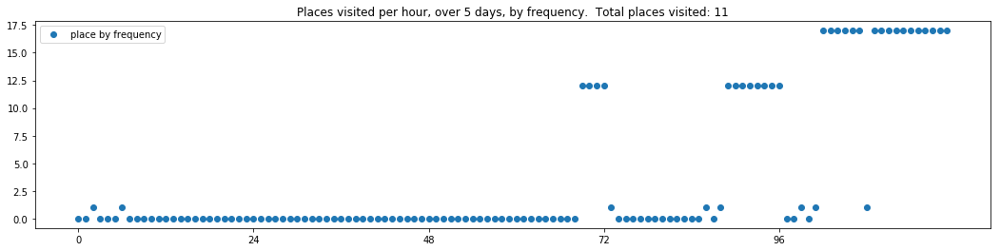

----- vector ----
prefix labels:  [396, 564]
[0, 0, 0, 0, 0, 0, 0, 0, 420, 0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 77, 21, 396, 396, 396]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388, 0, 21, 21, 21, 21, 21, 220, 220, 0, 506, 506]
[636, 0, 396, 396, 396, 396, 396, 396, 465, 0, 0, 0, 0, 0, 0, 396, 396, 396, 396, 396, 396, 396, 396, 396]


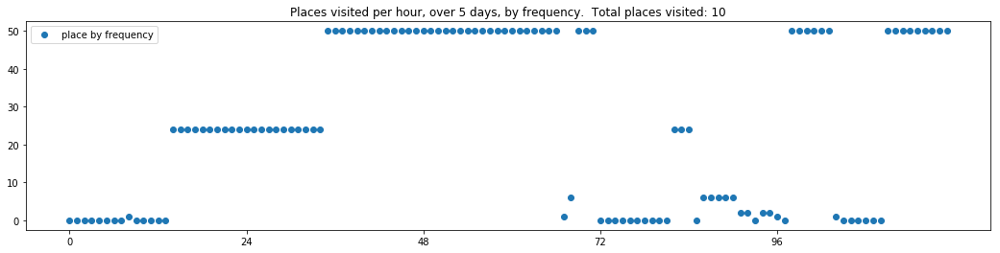

----- vector ----
prefix labels:  [345, 386]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 386, 386, 0, 0, 0, 0, 0, 0, 0, 386, 386]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 386, 386, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 260, 260, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 0, 0, 345, 345, 345]


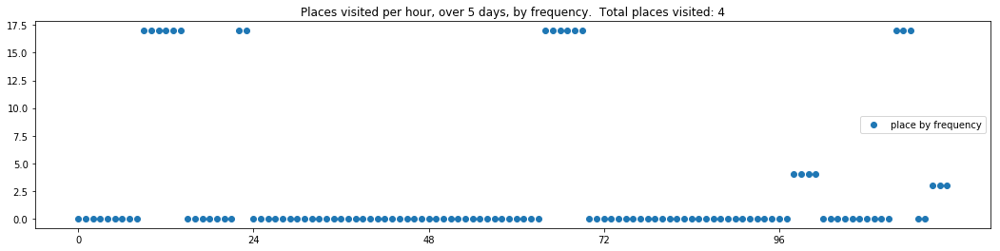


------
 40 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_40.txt 
------

----- vector ----
prefix labels:  [532, 532]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 271, 471, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 208, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 270]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 322, 322, 322, 322, 322, 322, 225, 225]


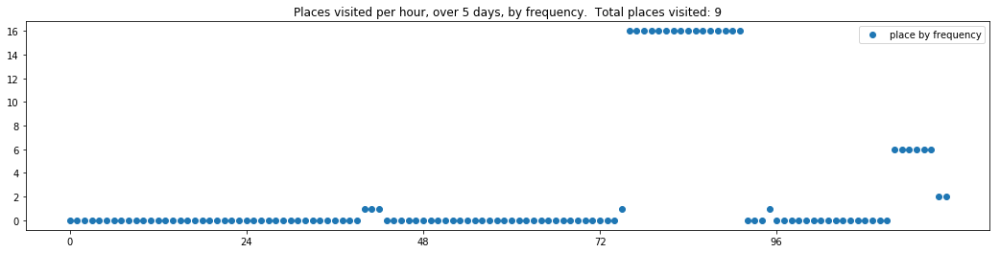

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 93, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[93, 93, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 93, 93, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]


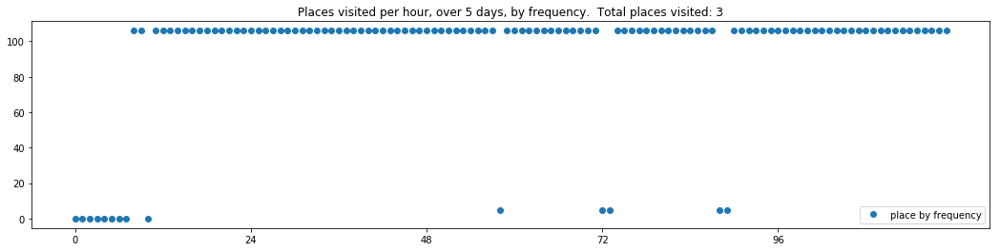

----- vector ----
prefix labels:  [333, 333]
[0, 0, 0, 333, 333, 333, 333, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334]
[334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 333, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 333, 333]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


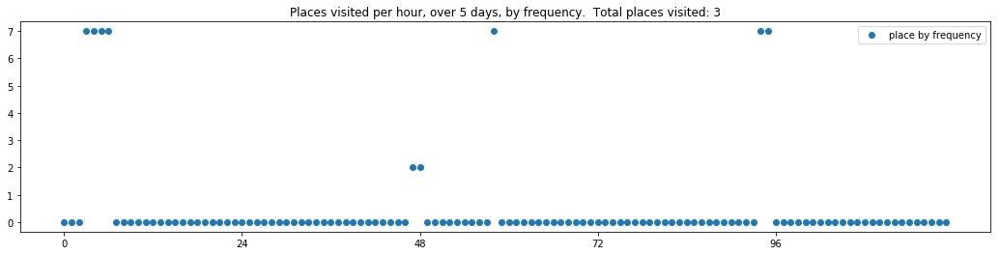

----- vector ----
prefix labels:  [99, 99]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 342, 342, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 40, 40, 40, 40, 40, 40, 40, 40]
[40, 144, 74, 74, 0, 33, 0, 0, 0, 424, 424, 503, 503, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


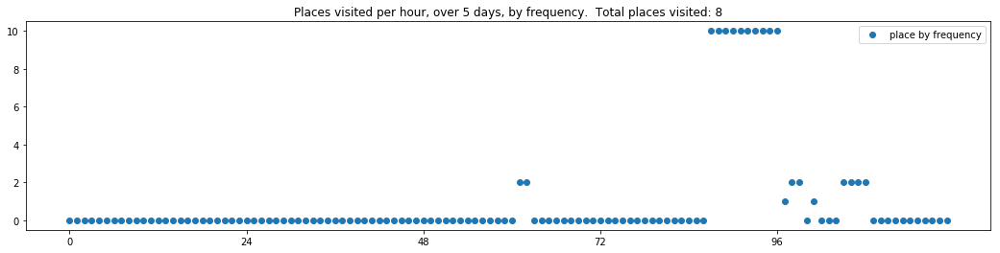

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 4, 4, 4, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 542, 542, 542, 542, 542, 93, 93, 93]
[93, 93, 93, 0, 0, 515, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]
[93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]


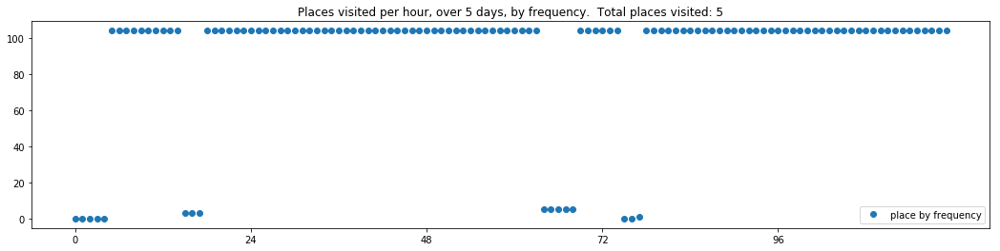

----- vector ----
prefix labels:  [369, 369]
[0, 0, 0, 0, 195, 218, 218, 545, 545, 545, 545, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 369, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


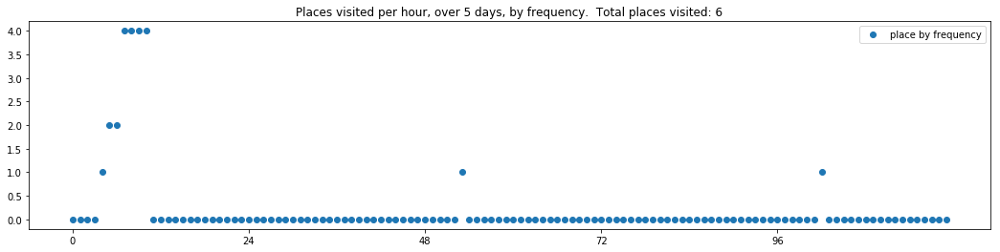

----- vector ----
prefix labels:  [498, 227]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 284, 284, 0, 0, 0, 0, 0]


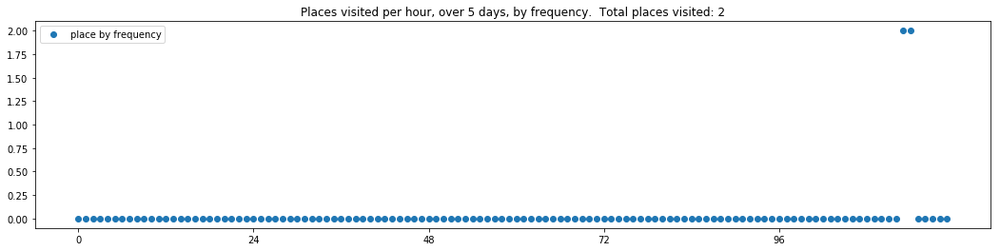

----- vector ----
prefix labels:  [134, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 303, 0, 0, 0, 0, 0, 0, 0, 0]


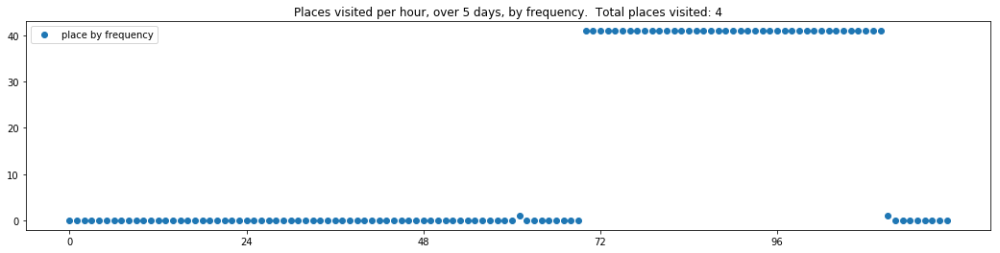

----- vector ----
prefix labels:  [563, 298]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 205, 205, 0, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 205, 205, 563, 205, 508, 508, 508, 508, 508, 508, 508, 508]
[508, 508, 508, 508, 508, 508, 508, 508, 0, 303, 195, 195, 0, 0, 0, 0, 0, 205, 563, 563, 392, 392, 392, 341]


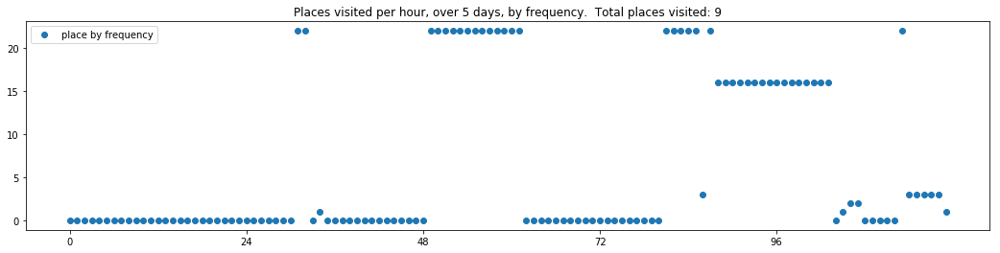

----- vector ----
prefix labels:  [11, 11]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11]
[11, 11, 11, 0, 0, 0, 0, 0, 0, 0, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]
[285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]
[285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 0, 0]
[0, 0, 0, 0, 0, 0, 130, 130, 0, 435, 0, 0, 0, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]


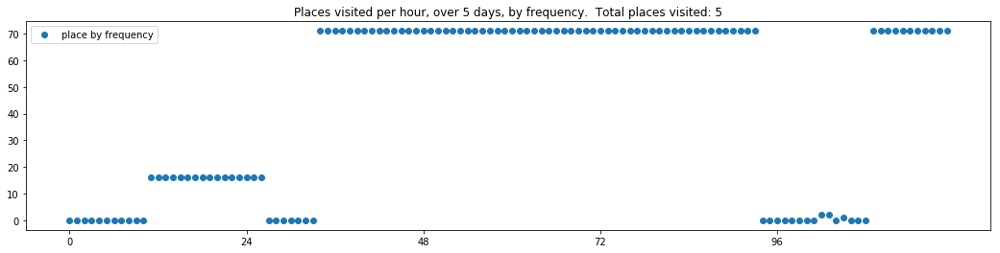

----- vector ----
prefix labels:  [143, 0]
[0, 0, 0, 143, 270, 270, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 52, 0, 0, 0, 0, 0, 0]
[123, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 192, 0, 0, 0, 0, 0, 186, 0, 208, 208, 208, 0, 353, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0]


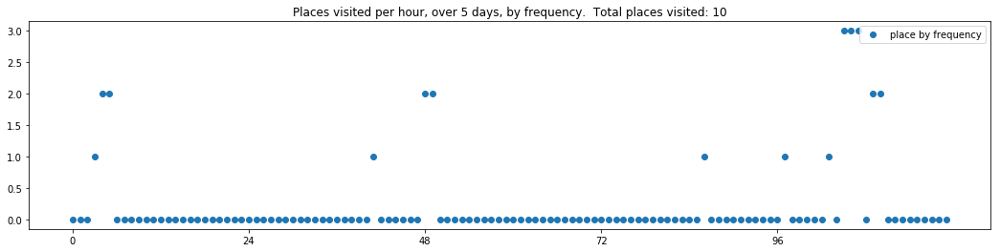

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


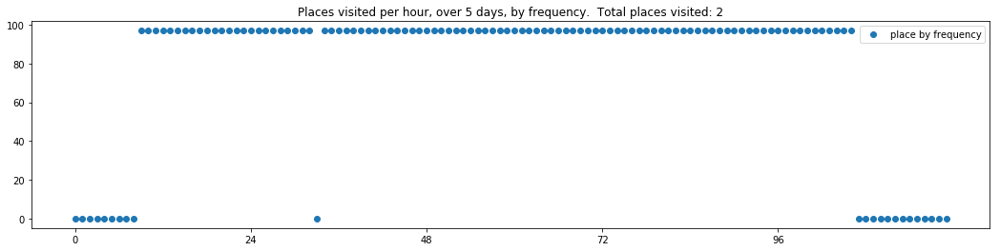

----- vector ----
prefix labels:  [55, 55]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


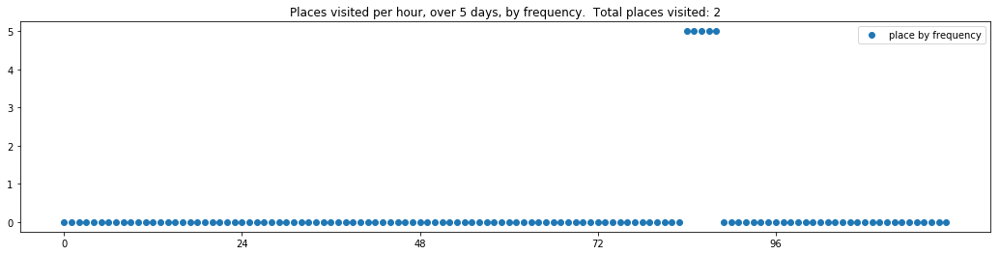

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]


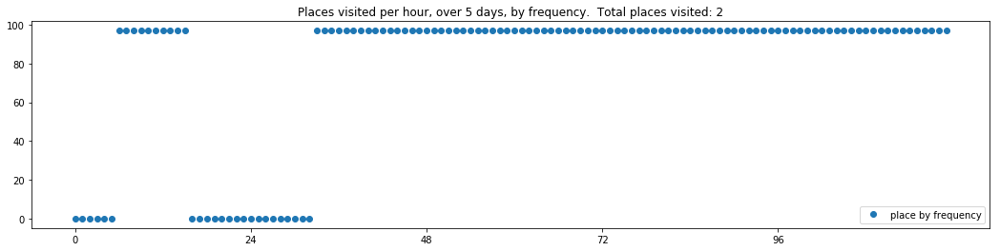

----- vector ----
prefix labels:  [397, 559]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 559, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 559, 559, 559, 559, 559, 559, 559]
[390, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 214, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


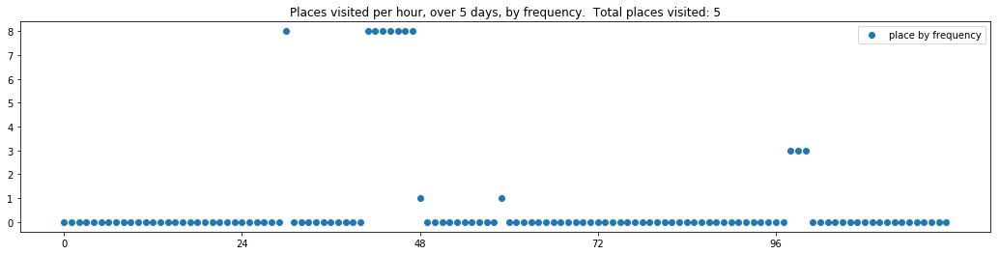

----- vector ----
prefix labels:  [466, 466]
[0, 0, 0, 0, 0, 0, 0, 0, 466, 466, 466, 466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69]
[466, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


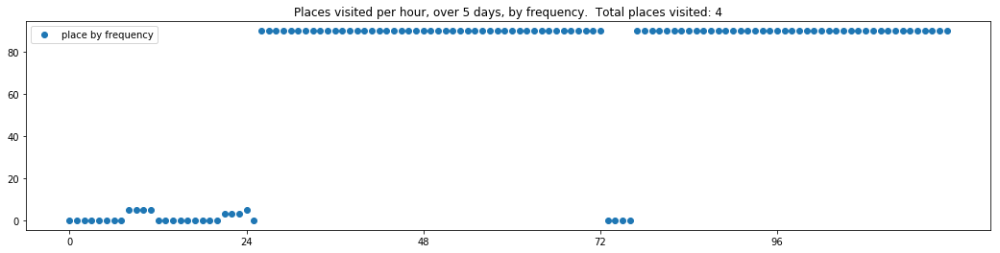

----- vector ----
prefix labels:  [25, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 25, 25, 25, 0, 0, 0, 0, 0, 0, 0]
[0, 453, 453, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]


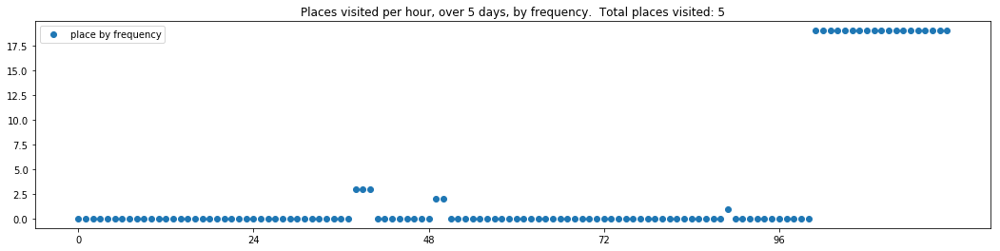

----- vector ----
prefix labels:  [120, 502]
[0, 0, 0, 0, 0, 0, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 502, 502, 502, 502, 502, 502, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 120, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 120, 502, 502, 502]


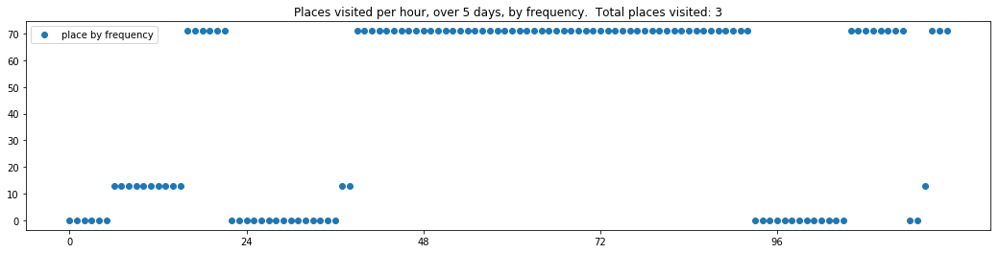

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 413, 413, 413, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 413, 413, 413, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0, 0, 0, 0, 0]
[412, 413, 413, 413, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 413, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 412, 0, 0, 0, 0, 0, 0, 413, 413, 0, 413, 0, 0]
[413, 0, 0, 0, 0, 413, 413, 413, 413, 413, 0, 0, 0, 0, 0, 412, 0, 0, 0, 0, 0, 0, 0, 0]


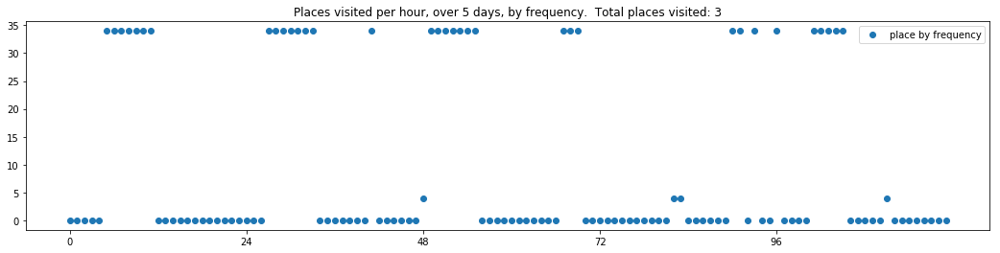

----- vector ----
prefix labels:  [203, 203]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]


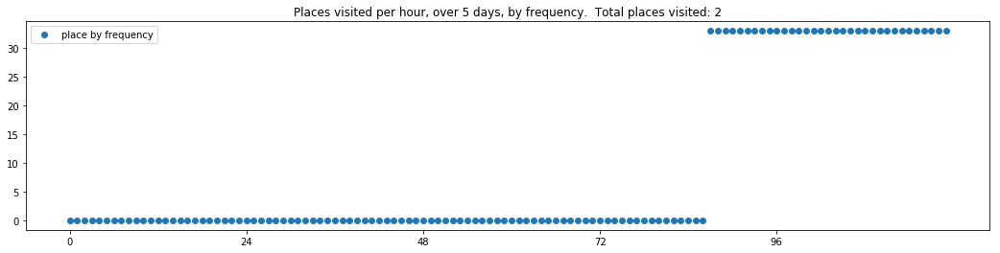

----- vector ----
prefix labels:  [153, 153]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 112, 153, 153, 0, 0, 0, 153, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 153, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 153]
[153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 153, 153, 153, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


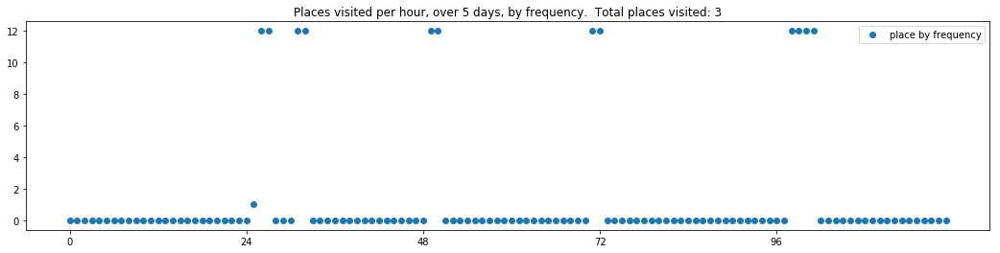

----- vector ----
prefix labels:  [424, 424]
[0, 212, 212, 0, 0, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 0, 0, 0, 0, 0, 0, 0, 0, 0, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 0, 0, 105, 105, 0, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


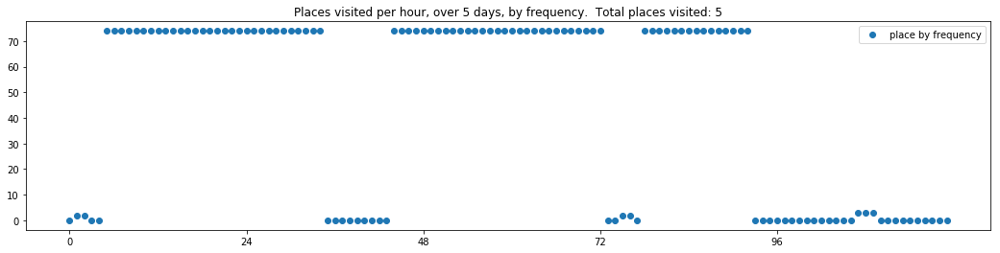

----- vector ----
prefix labels:  [385, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


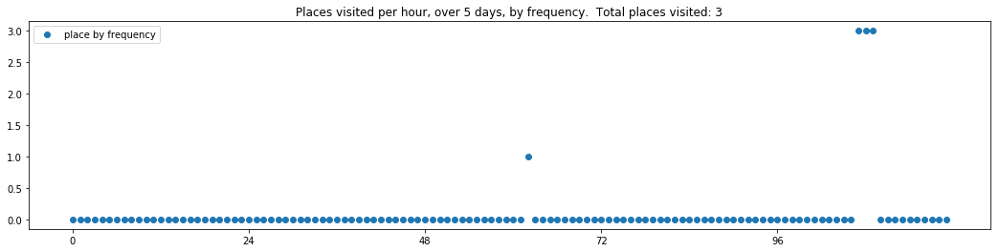

----- vector ----
prefix labels:  [425, 425]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 274, 274, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 274, 545, 545, 545, 545, 545, 545, 545]
[545, 545, 545, 545, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


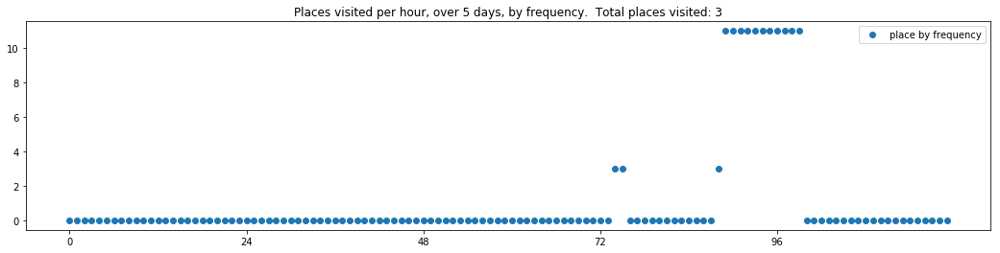

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320]


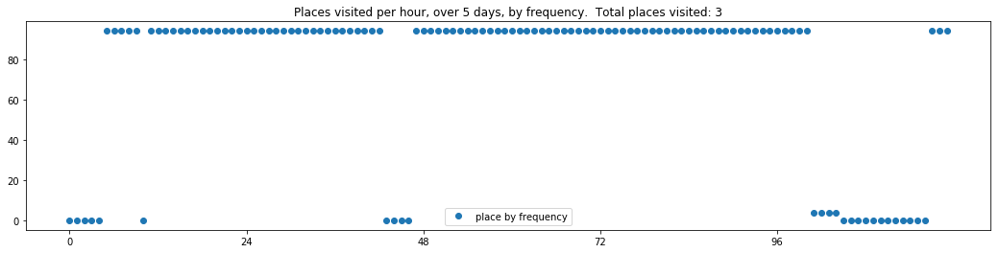

----- vector ----
prefix labels:  [630, 535]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248]
[248, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 488, 0, 0, 0, 0, 0, 0, 0, 535, 535, 0, 0, 0]
[0, 0, 535, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 535, 0, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 32]
[32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0]


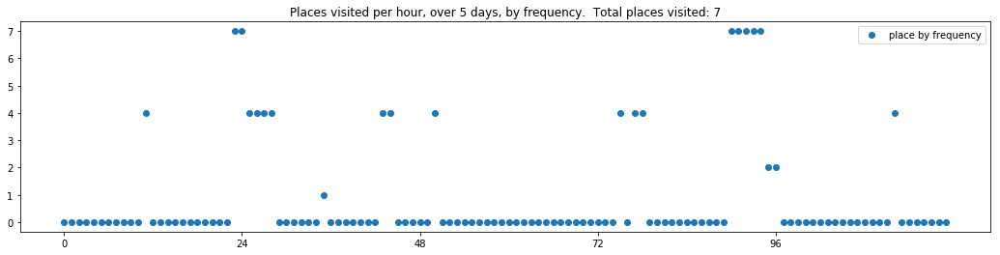

----- vector ----
prefix labels:  [168, 522]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 453, 289, 453, 453, 453, 311, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0]


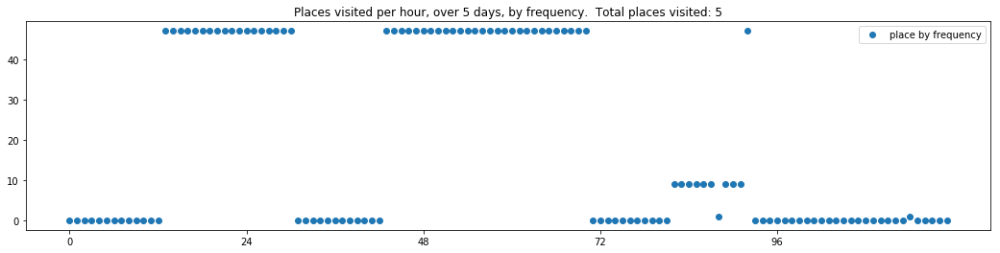

----- vector ----
prefix labels:  [414, 414]
[0, 0, 0, 124, 0, 0, 0, 353, 353, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 0, 130, 130, 130, 130, 130, 130, 130, 130, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]
[414, 414, 414, 414, 414, 414, 0, 0, 0, 0, 0, 0, 0, 0, 0, 414, 432, 157, 157, 157, 157, 157, 157, 157]
[157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]


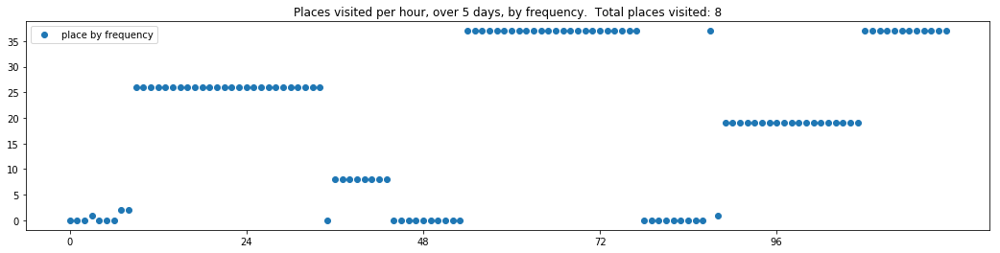

----- vector ----
prefix labels:  [493, 493]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 407, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 493, 0, 0, 0, 0, 0, 515, 341, 0, 0]


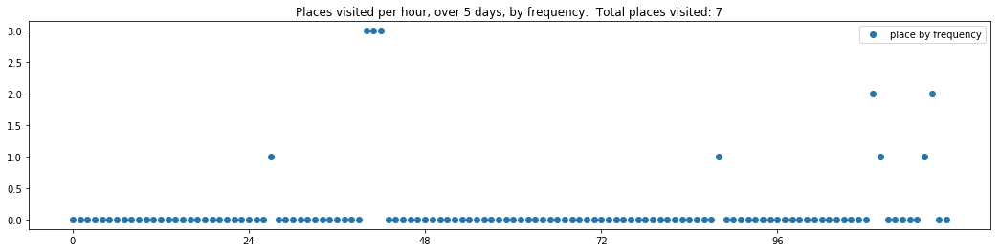

----- vector ----
prefix labels:  [29, 364]
[0, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364]
[364, 364, 364, 364, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 448, 364]
[364, 364, 364, 268, 268, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 29, 29, 29, 29, 8, 8, 8, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364]
[364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364]


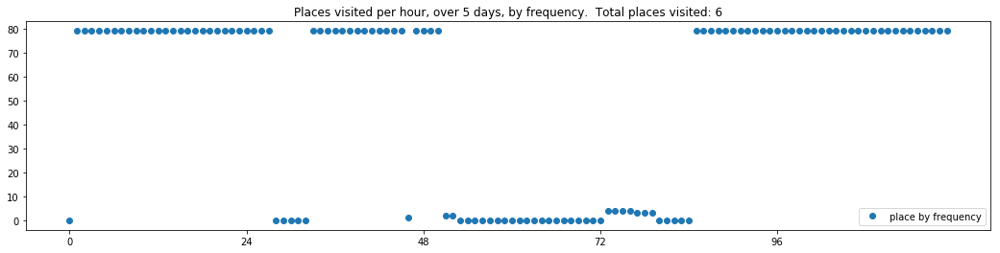

----- vector ----
prefix labels:  [493, 562]
[0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 4, 318, 94, 94, 94, 0, 303, 303, 320, 320, 320, 320]
[320, 0, 94, 94, 549, 549, 0, 599, 0, 549, 0, 320, 320, 320, 320, 320, 0, 311, 311, 392, 392, 0, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 0, 165, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]


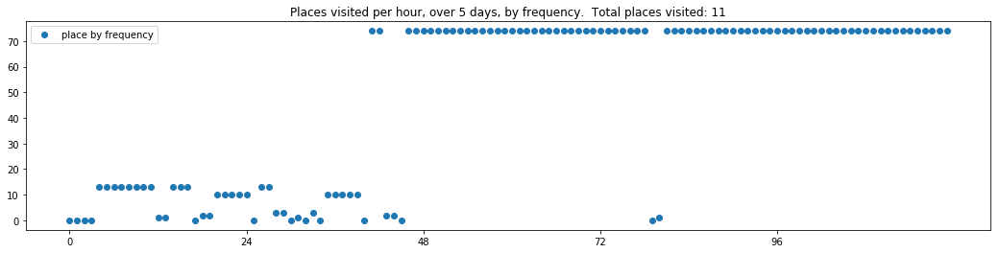

----- vector ----
prefix labels:  [165, 482]
[0, 0, 0, 0, 0, 0, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 165, 165, 165, 165, 165, 165, 165, 165, 165, 165, 304, 304, 304, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 165, 165, 304, 599, 311, 599, 304, 304, 304, 304]
[304, 304, 304, 304, 0, 165, 165, 165, 227, 165, 165, 165, 165, 304, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]


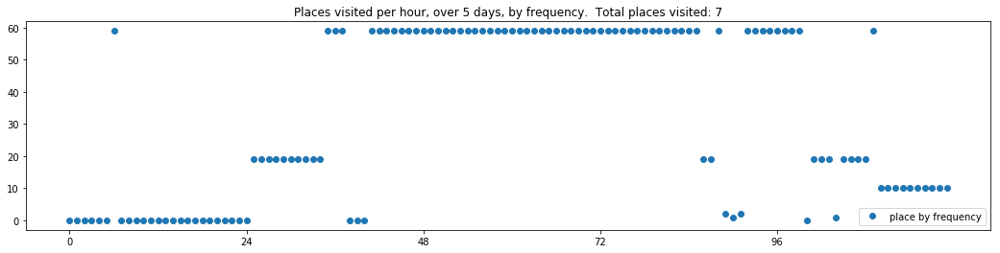

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


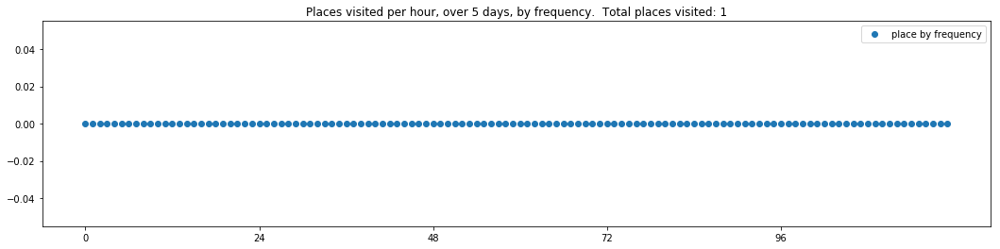

----- vector ----
prefix labels:  [186, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


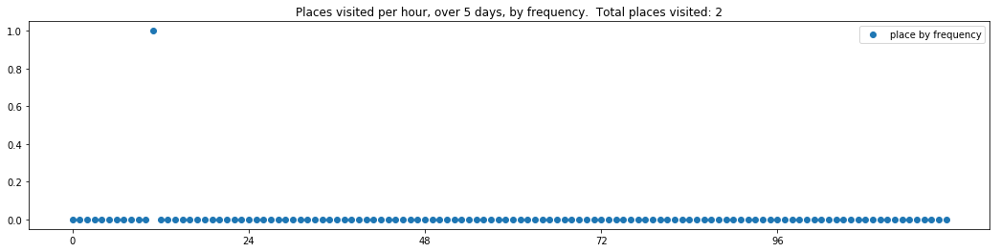

----- vector ----
prefix labels:  [107, 107]
[0, 0, 0, 0, 0, 0, 21, 0, 8, 8, 8, 8, 0, 0, 0, 0, 640, 8, 0, 640, 640, 640, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 0, 640, 640, 640, 640]


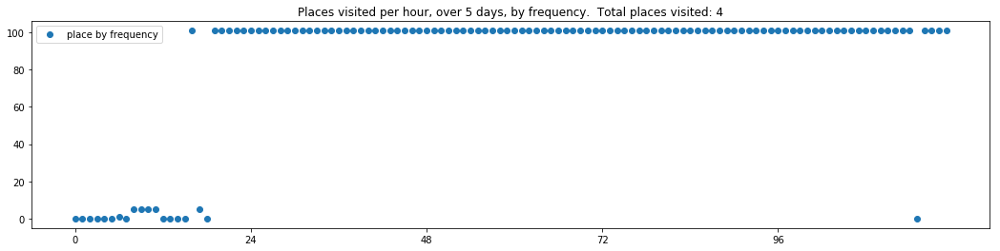

----- vector ----
prefix labels:  [127, 434]
[0, 0, 0, 0, 213, 213, 213, 213, 251, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 482, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 344, 2, 227, 0, 0, 0, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 0, 196, 289, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]


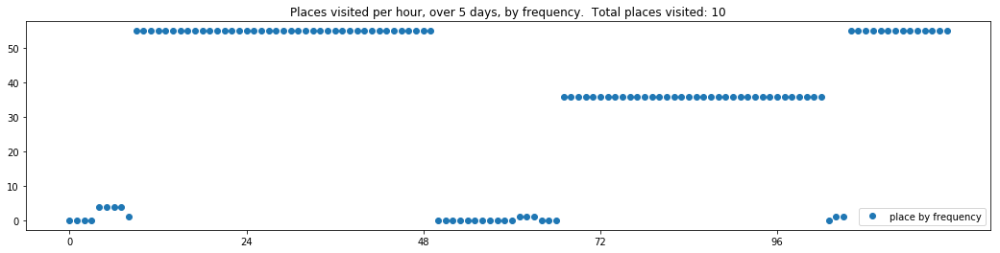

----- vector ----
prefix labels:  [261, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 0, 0, 382, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 486, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


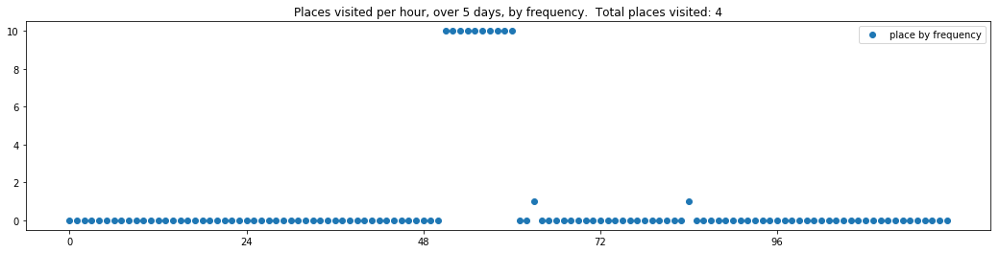

----- vector ----
prefix labels:  [340, 435]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 0]
[0, 0, 204, 204, 204, 204, 204, 204, 204, 204, 0, 0, 340, 340, 478, 0, 0, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 0, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]


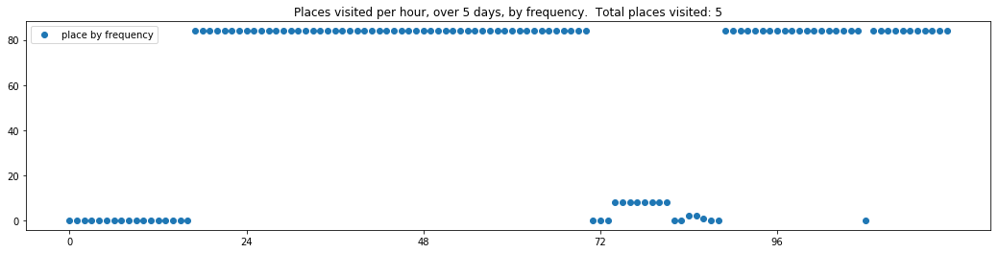

----- vector ----
prefix labels:  [478, 478]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0, 0, 0, 0, 478, 478, 478, 478]
[478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 478, 478, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 478, 478, 478, 478, 478, 478, 478, 0]


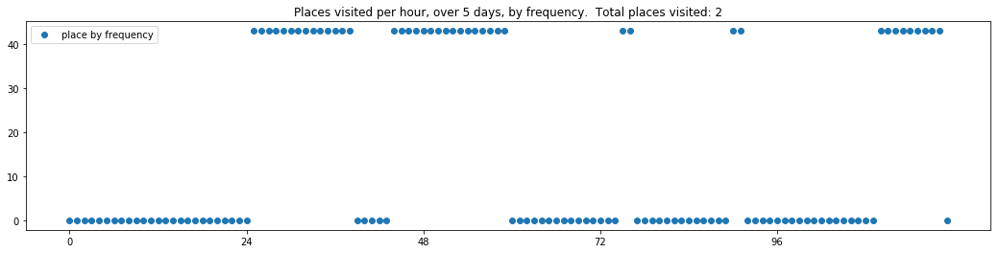

----- vector ----
prefix labels:  [352, 352]
[0, 0, 0, 0, 0, 0, 0, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]


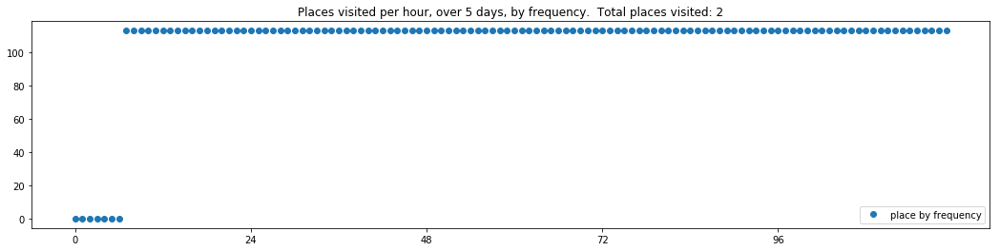

----- vector ----
prefix labels:  [470, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 444, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 470, 470, 470, 470, 470, 470, 470]
[470, 470, 470, 470, 470, 470, 470, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 470, 470, 470, 470, 470, 470, 470, 470, 470, 470, 470, 470, 470, 187, 187, 187, 187, 187, 187, 187]


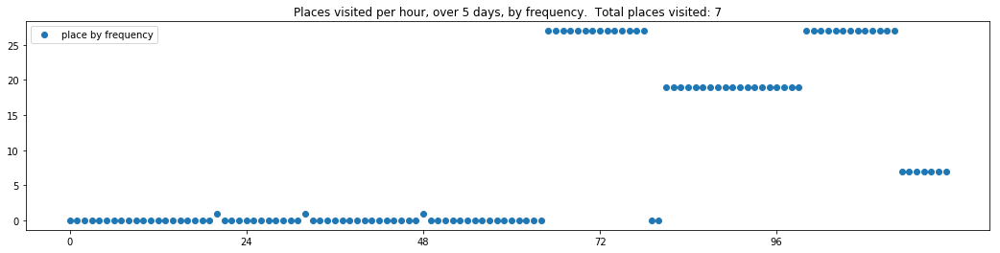

----- vector ----
prefix labels:  [591, 591]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 591, 591, 591, 591, 591, 591]
[591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591]
[591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591]
[591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591, 591]


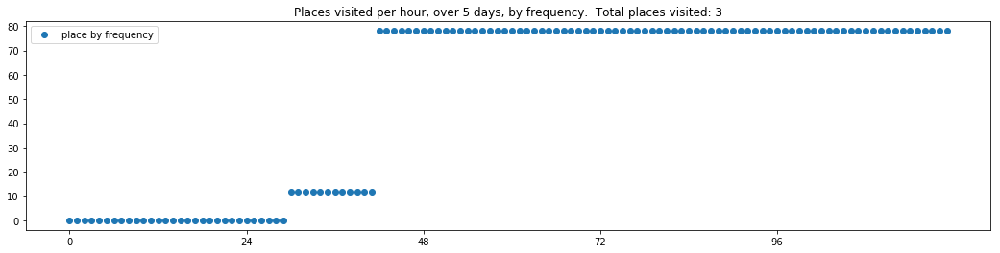

----- vector ----
prefix labels:  [361, 361]
[183, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 641, 394, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361]
[361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361]
[361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 0, 0, 0, 361, 361]
[361, 361, 361, 69, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361]
[361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 361, 0, 69, 0, 0, 0, 0, 0, 0, 0]


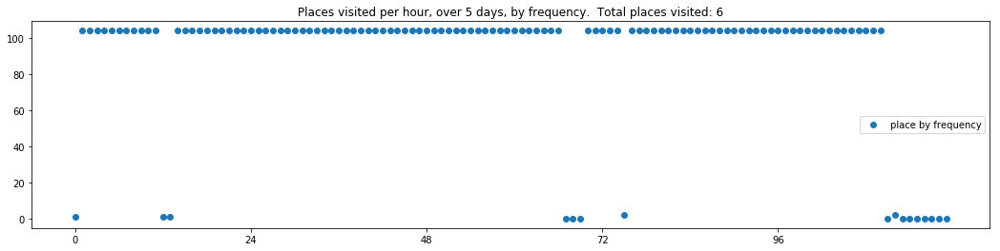

----- vector ----
prefix labels:  [465, 465]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]
[465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465, 465]


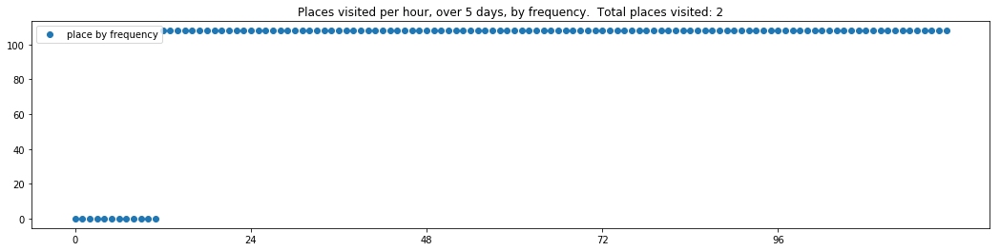

----- vector ----
prefix labels:  [46, 46]
[0, 0, 0, 0, 46, 46, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46, 0, 0, 46, 46]
[46, 46, 0, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]


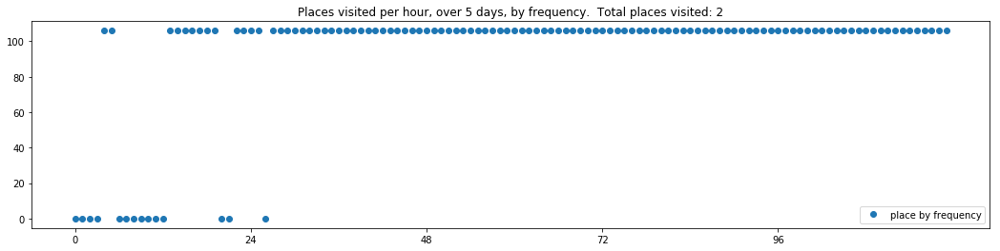

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 617, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 149, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 12]


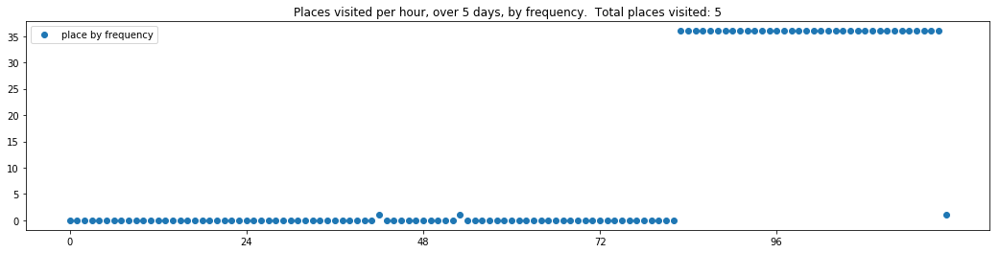

----- vector ----
prefix labels:  [136, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0]


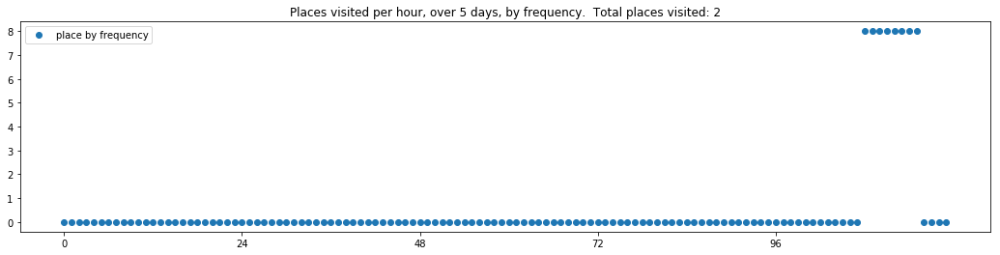

----- vector ----
prefix labels:  [399, 44]
[0, 0, 0, 0, 0, 0, 0, 475, 0, 0, 0, 0, 399, 0, 399, 399, 399, 435, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 298, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 319, 319, 0, 0, 0, 0, 0, 487, 487, 487, 487, 487]
[487, 487, 487, 0, 256, 256, 44, 120, 502, 502, 502, 326, 120, 120, 0, 0, 0, 0, 0, 567, 567, 567, 567, 567]
[567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567]


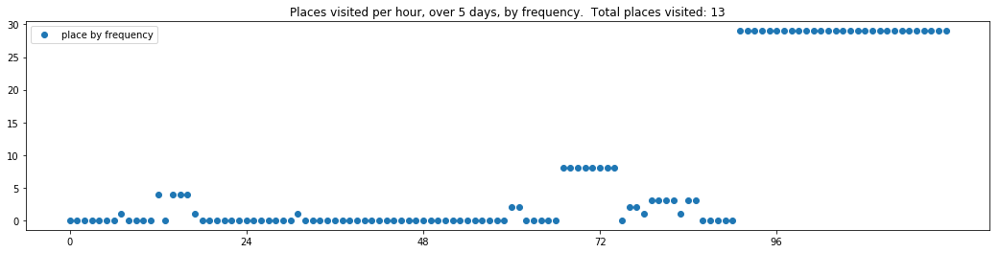

----- vector ----
prefix labels:  [570, 570]
[0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 0, 374, 374, 374, 374, 374, 0, 0, 610]
[0, 570, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 424, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]


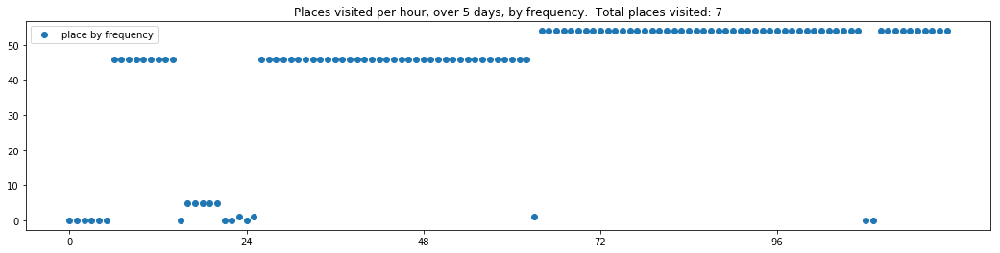

----- vector ----
prefix labels:  [308, 110]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[110, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0, 308, 308, 308, 0, 0, 0]
[110, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 110, 391, 391, 391, 0, 0, 0, 0, 311, 0, 0, 0]
[0, 0, 0, 110, 110, 110, 0, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 308, 562]


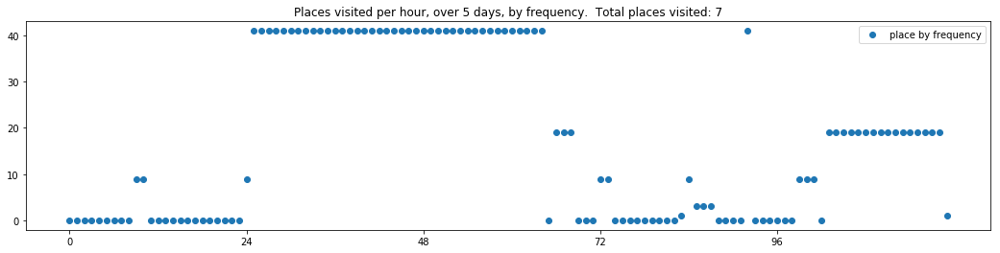


------
 45 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_45.txt 
------

----- vector ----
prefix labels:  [298, 40]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 195, 195, 364, 364, 364, 77, 77, 77, 77, 77, 212, 0, 0]
[0, 0, 279, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 336, 336, 336, 336, 336, 336, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0]


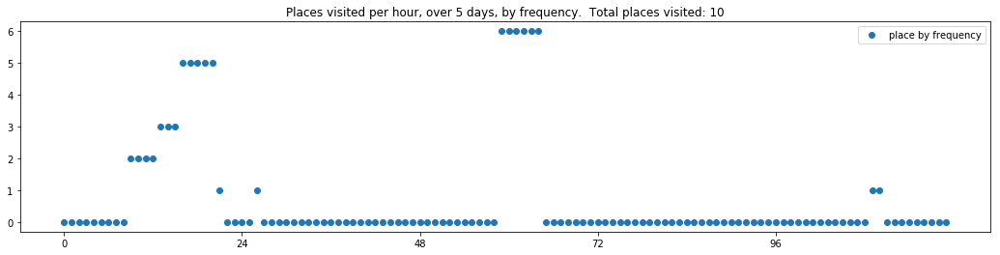

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 26, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 26, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0]


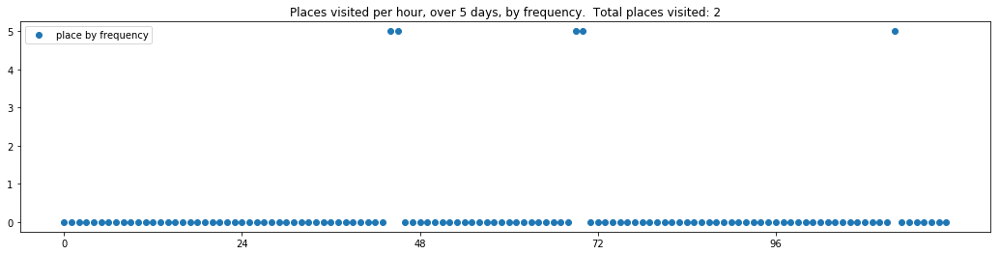

----- vector ----
prefix labels:  [296, 189]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 0, 0, 195, 195, 195, 195, 195]
[95, 95, 95, 95, 95, 95, 95, 4, 4, 4, 4, 4, 341, 620, 0, 453, 453, 453, 0, 184, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 296, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0]


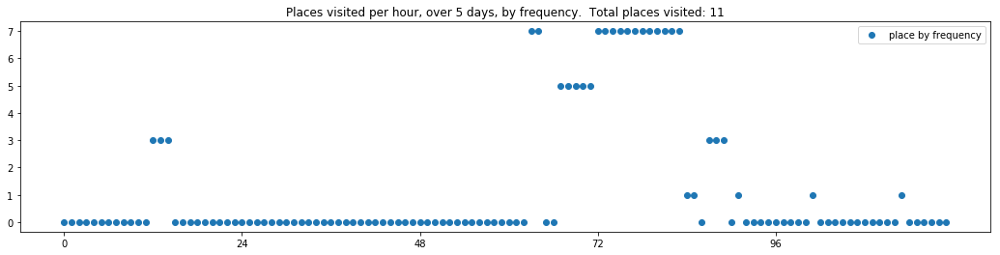

----- vector ----
prefix labels:  [420, 420]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 0, 0, 0, 0, 0, 0, 420, 420, 420, 420, 420]
[420, 420, 0, 0, 0, 0, 420, 0, 0, 0, 0, 0, 0, 420, 420, 420, 420, 420, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 420, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0]
[357, 267, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 414, 22, 0, 0, 0, 0, 0, 0, 0, 0]


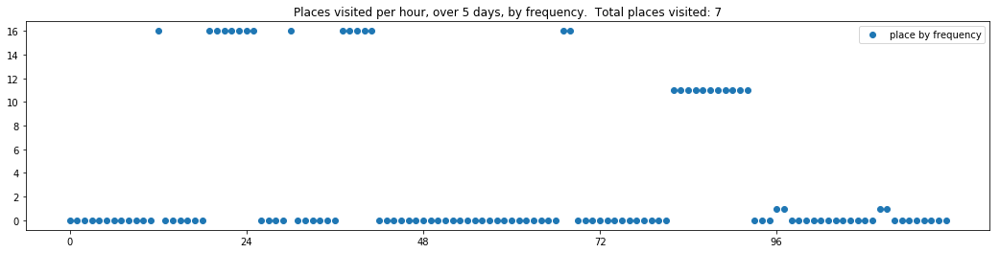

----- vector ----
prefix labels:  [448, 266]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 413, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 0, 0, 413, 0, 413, 413]
[413, 413, 413, 413, 0, 434, 434, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434]


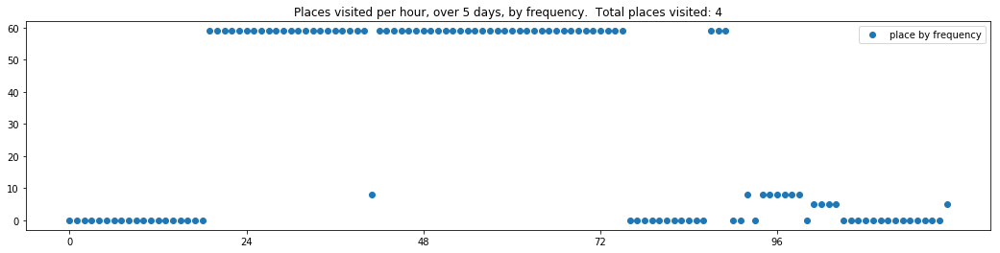

----- vector ----
prefix labels:  [423, 423]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 10, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


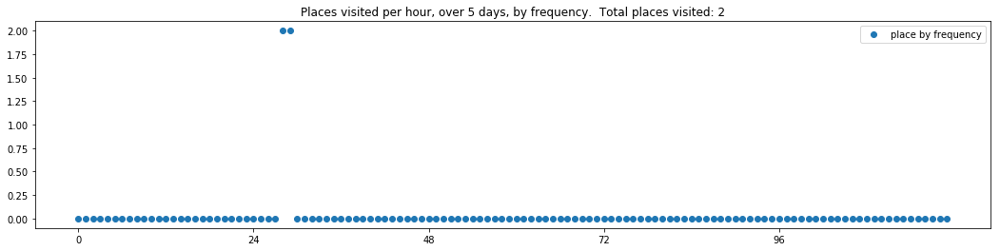

----- vector ----
prefix labels:  [391, 391]
[0, 0, 0, 0, 0, 0, 0, 0, 390, 0, 0, 0, 0, 0, 390, 102, 390, 390, 390, 0, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 0, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


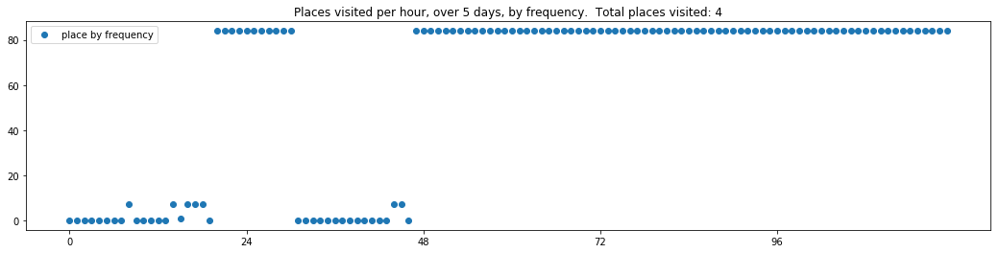

----- vector ----
prefix labels:  [227, 21]
[0, 0, 0, 144, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 21, 0, 21, 0, 0, 21, 21, 21]
[0, 227, 227, 227, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0]
[0, 0, 0, 0, 0, 0, 21, 0, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0]


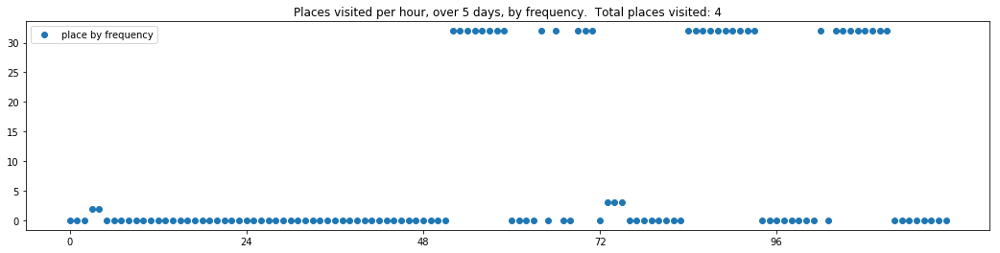

----- vector ----
prefix labels:  [161, 161]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]


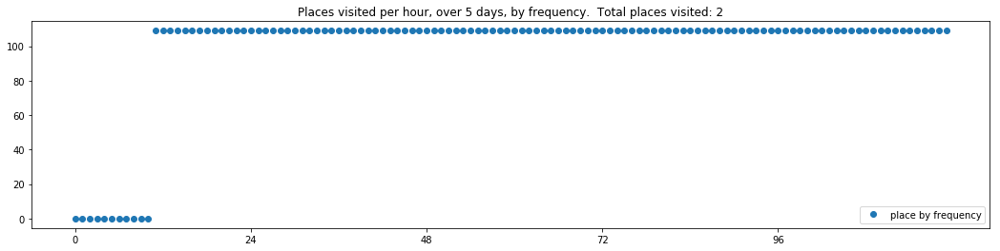

----- vector ----
prefix labels:  [32, 32]
[0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 32, 32, 32, 32, 32, 32, 32, 0, 32, 32, 32, 32, 32, 0, 32, 32, 32, 32, 32, 0, 0, 0]


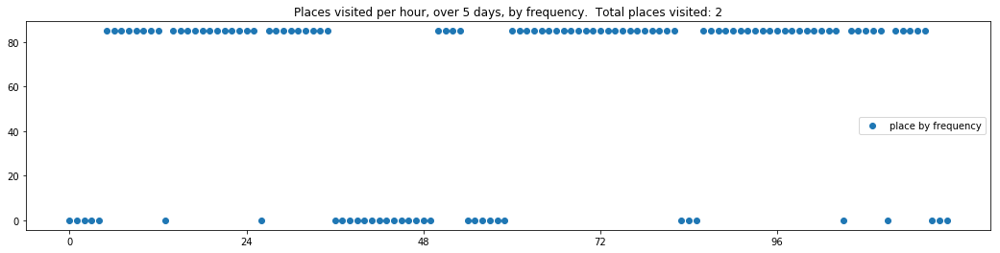

----- vector ----
prefix labels:  [157, 99]
[0, 284, 284, 284, 284, 284, 0, 0, 0, 0, 0, 0, 144, 144, 144, 144, 144, 144, 144, 260, 260, 0, 284, 14]
[14, 14, 14, 14, 14, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0]
[0, 0, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 0, 0, 0, 0, 157, 157]
[157, 157, 20, 20, 0, 0, 208, 208, 208, 208, 208, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 208, 208, 208, 208, 208, 208, 208, 31, 0, 0, 0, 0, 0, 0, 0, 0]


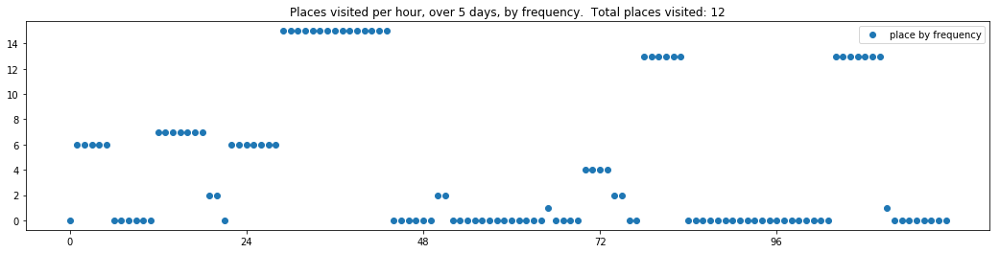

----- vector ----
prefix labels:  [230, 136]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 318, 318, 187, 187, 187, 187, 0, 187, 0, 187, 187, 187, 187]
[187, 230, 578, 0, 0, 0, 112, 112, 112, 112, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]
[38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38]
[38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


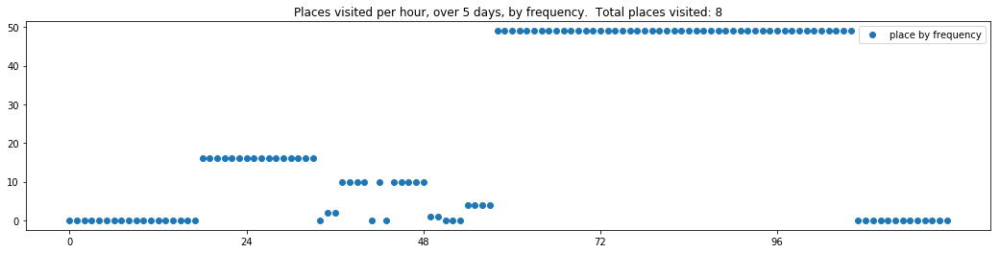

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 190, 190, 190, 224, 0, 0, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392]


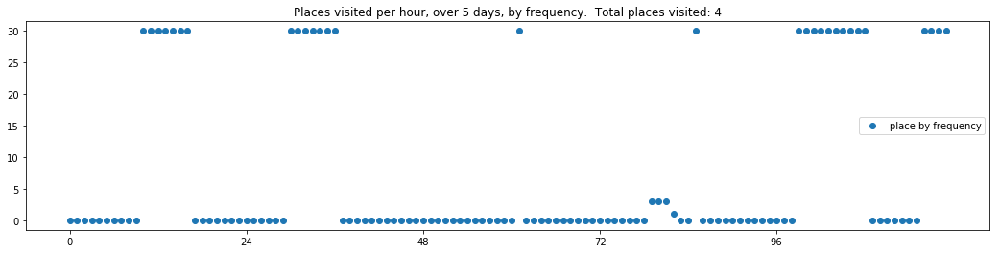

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


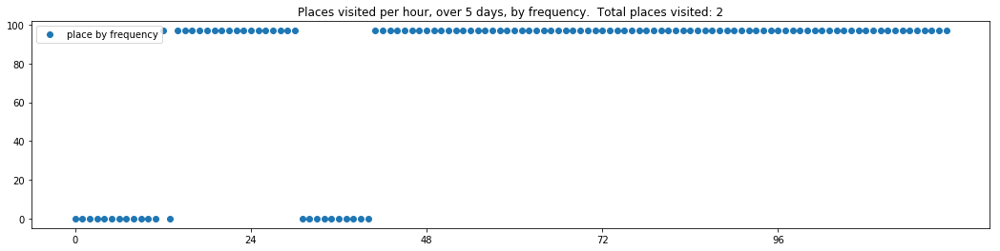

----- vector ----
prefix labels:  [30, 186]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 0, 0, 251, 214, 214, 214, 214, 214, 214, 214, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 461]
[461, 461, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 214, 214, 214, 214, 214, 70, 0, 0]


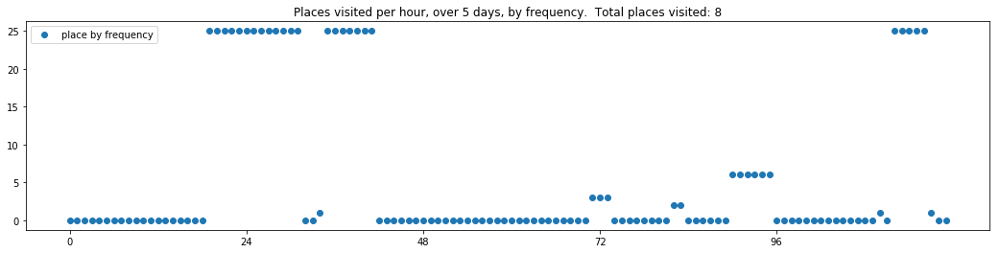

----- vector ----
prefix labels:  [248, 248]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 0, 248, 248, 248]
[248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248]
[248, 248, 248, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]


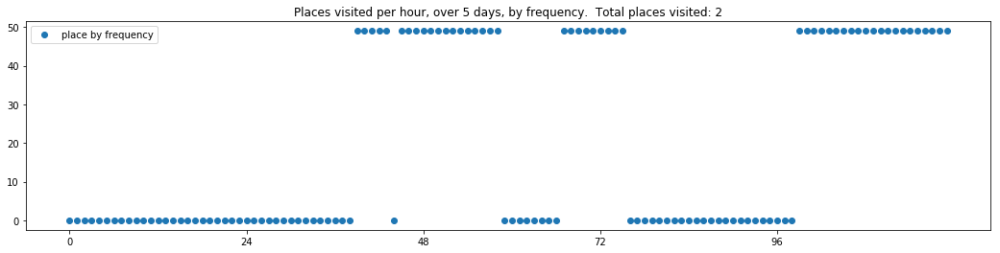

----- vector ----
prefix labels:  [71, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 52, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 248, 465, 465, 0, 0, 0, 0, 0, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 462, 0, 0, 0, 0, 0, 0, 0, 350, 350, 350, 350, 350, 350, 350, 350, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]


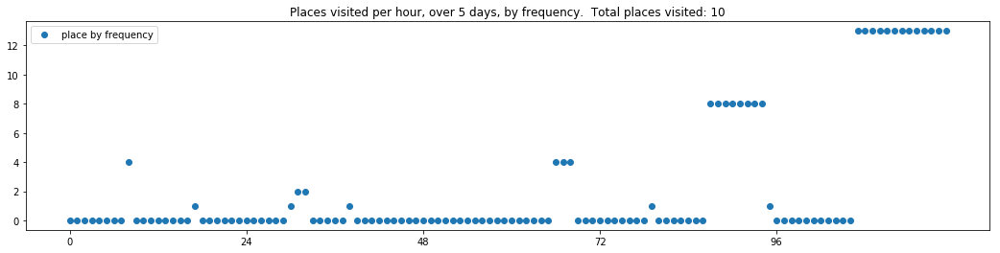

----- vector ----
prefix labels:  [318, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 200, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 341, 0, 328, 200, 328, 328, 328, 328, 328, 328, 200, 200, 328, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 328, 328, 0, 0, 0, 0, 0, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 296, 0, 0, 0, 0, 0, 0, 0]


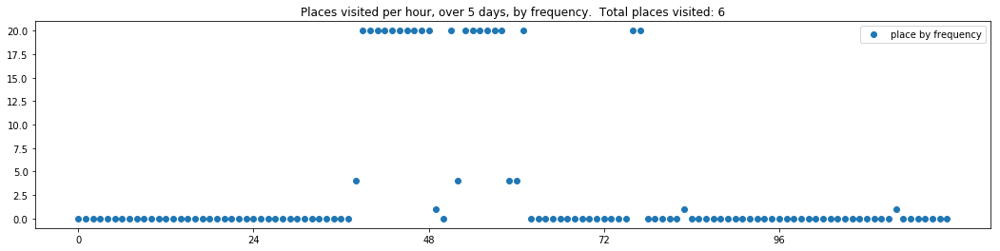

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 0, 0]
[71, 71, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 420, 0, 0, 0, 0, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0]
[0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


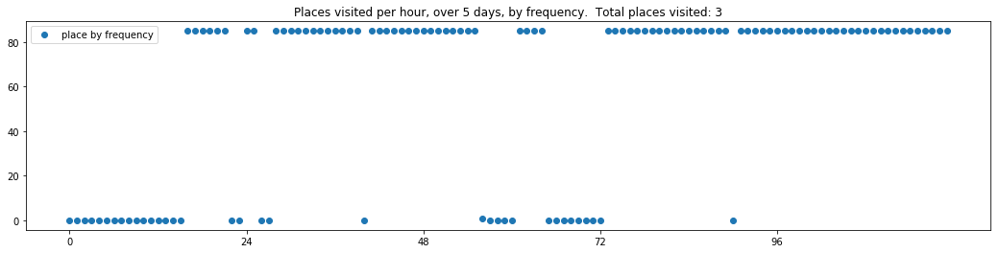

----- vector ----
prefix labels:  [424, 424]
[0, 0, 0, 0, 0, 603, 485, 485, 0, 0, 0, 0, 0, 0, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 388, 388, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]


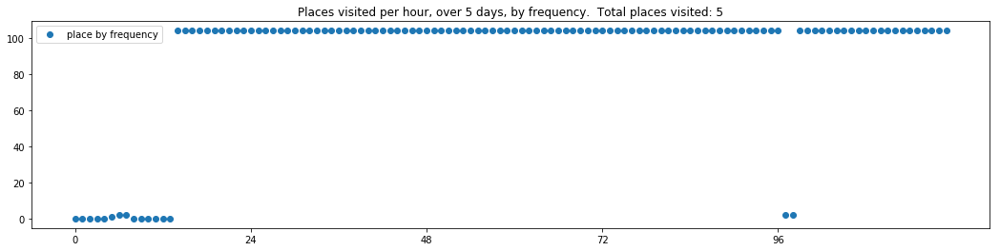

----- vector ----
prefix labels:  [574, 574]
[0, 0, 0, 0, 0, 0, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 424, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 132, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 41, 41, 0, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574]


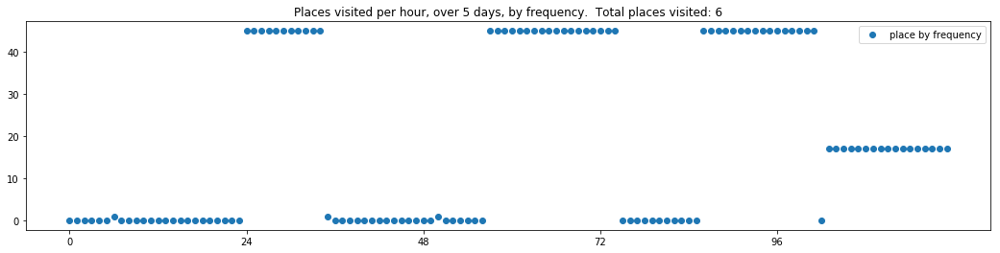

----- vector ----
prefix labels:  [414, 260]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 414, 414, 414, 414, 414, 414, 414, 414, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 208]
[0, 0, 0, 0, 0, 0, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]


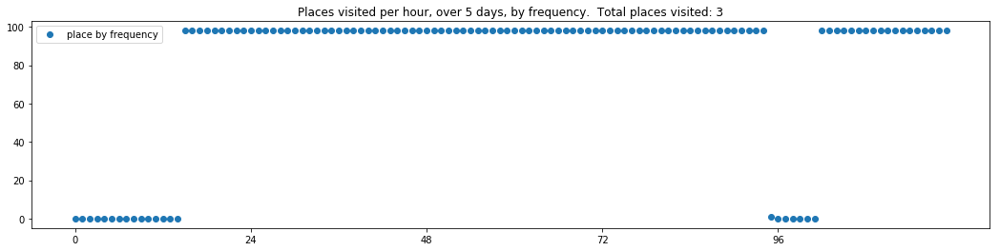

----- vector ----
prefix labels:  [586, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 586, 586, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 100, 0, 291, 291, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 0]


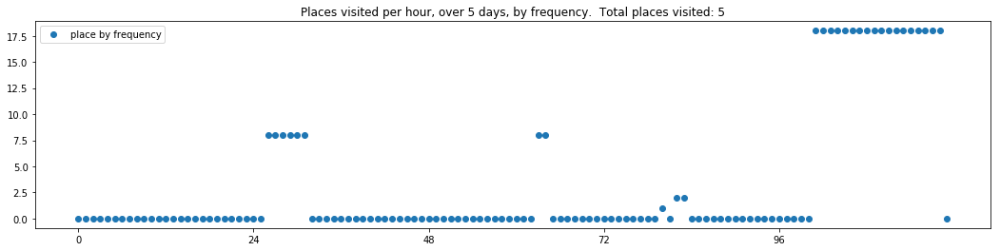

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 0, 0, 0, 44, 44, 44]
[44, 44, 44, 44, 44, 0, 44, 44, 44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 439, 439, 439, 439, 46, 46, 21, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46]
[0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


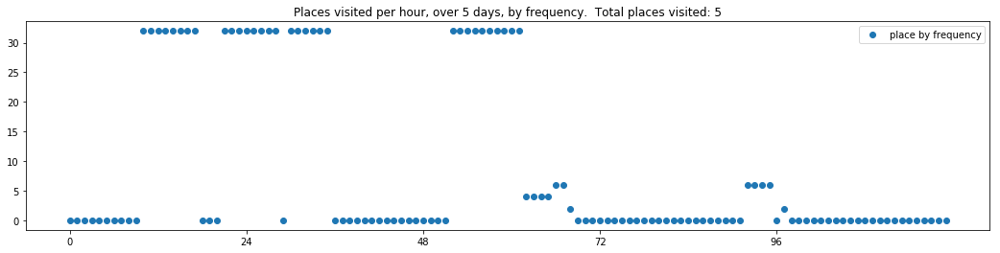

----- vector ----
prefix labels:  [520, 573]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 483, 483, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 396, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 195, 220, 220, 220, 0, 64, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 634, 634, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


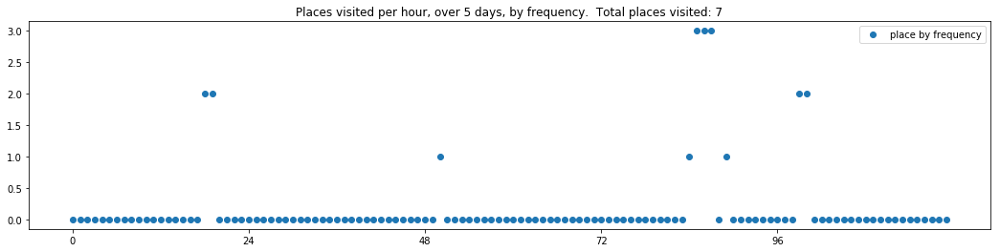

----- vector ----
prefix labels:  [21, 21]
[21, 21, 21, 21, 185, 4, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 0, 21, 21, 0, 0, 0, 0, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 0, 21, 21, 0, 0, 71, 71, 71, 77, 77, 21, 21, 21, 21, 21, 21, 21, 21]
[0, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0]


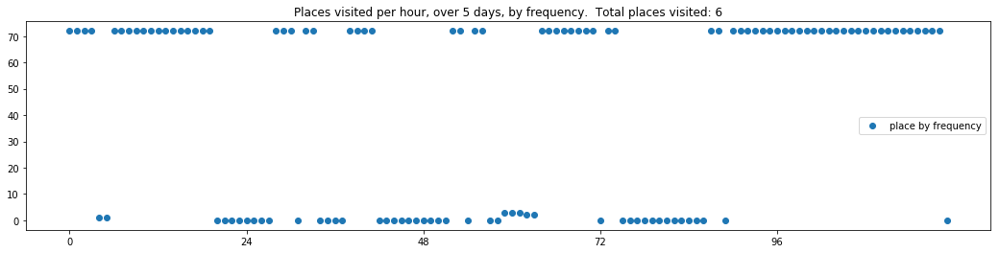

----- vector ----
prefix labels:  [524, 389]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 125, 125, 125, 126, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109, 125, 125]
[125, 125, 125, 0, 0, 0, 0, 109, 109, 109, 109, 109, 109, 109, 109, 109, 0, 0, 0, 0, 109, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0]


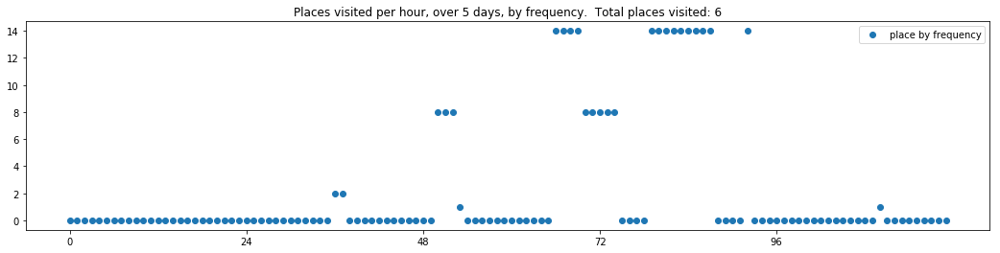

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 0, 0, 0, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]


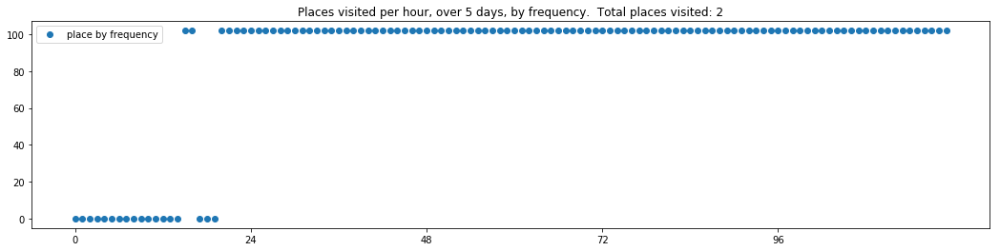

----- vector ----
prefix labels:  [527, 0]
[0, 0, 0, 0, 0, 527, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 415, 415, 415, 415, 415, 415, 415]
[219, 0, 0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 415, 415, 415, 415, 415, 219, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 0, 0, 0, 0, 0, 0, 0, 0, 219, 0, 22]


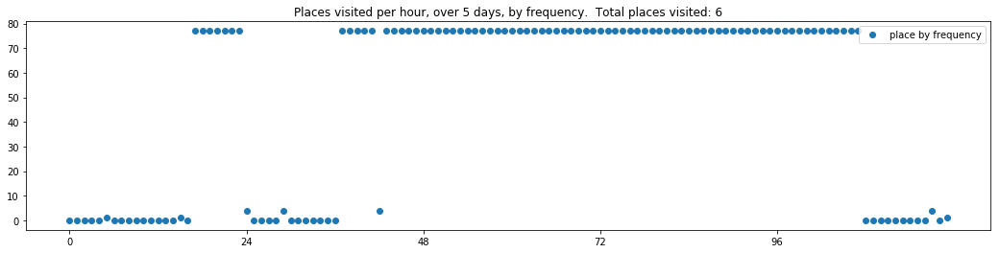

----- vector ----
prefix labels:  [286, 388]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 546, 0, 0]
[0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 187, 71, 187, 187, 187, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[71, 71, 71, 0, 0, 0, 0, 0, 0, 216, 216, 216, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 0, 0, 0, 0, 71]


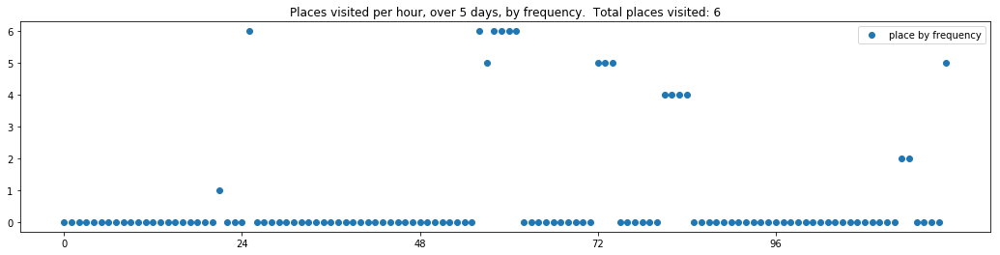

----- vector ----
prefix labels:  [470, 339]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 328, 328, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107]
[107, 0, 0, 21, 21, 21, 21, 21, 8, 470, 470, 470, 470, 470, 470, 470, 470, 470, 470, 177, 177, 177, 177, 177]
[177, 177, 0, 177, 177, 177, 177, 177, 177, 177, 176, 177, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0]


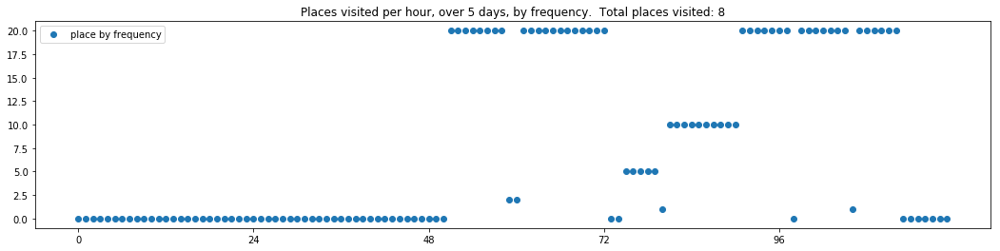

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 0, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 0, 93, 93, 0, 93]
[93, 93, 93, 93, 93, 93, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 4]
[4, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 4, 93, 93, 93, 93, 93, 0, 0, 0, 0, 0, 0, 0]
[0, 93, 0, 0, 0, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 220, 220, 220, 220]
[0, 93, 93, 93, 93, 93, 93, 93, 0, 0, 0, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93]


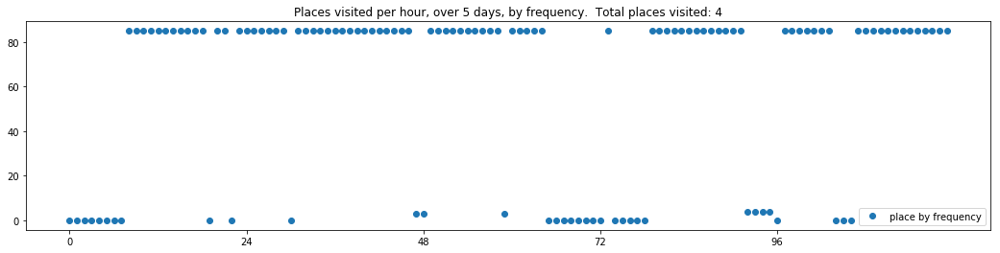

----- vector ----
prefix labels:  [120, 8]
[0, 0, 0, 0, 0, 8, 8, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 47, 635, 635, 256, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[506, 506, 506, 506, 0, 0, 0, 0, 0, 0, 0, 0, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506]
[506, 8, 8, 575, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 461, 557]


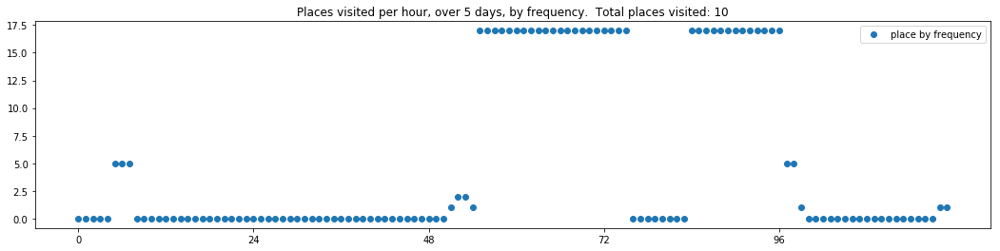

----- vector ----
prefix labels:  [15, 15]
[0, 0, 0, 0, 0, 15, 15, 15, 15, 0, 0, 0, 0, 0, 15, 15, 0, 15, 0, 0, 0, 0, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


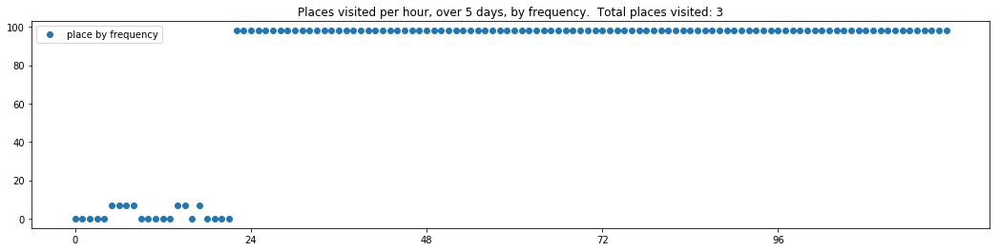

----- vector ----
prefix labels:  [349, 349]
[0, 0, 0, 371, 371, 371, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 54, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 349, 349, 349, 349, 349, 349, 349, 349]


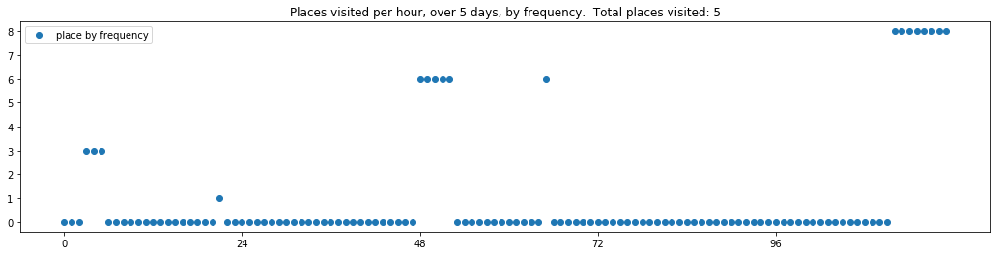

----- vector ----
prefix labels:  [52, 21]
[0, 0, 0, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 52, 52, 52, 52, 52, 52]
[52, 52, 52, 21, 21, 21, 0, 371, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 52, 52, 52, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0, 0, 0, 0, 0, 52, 52, 52, 52, 52, 52]


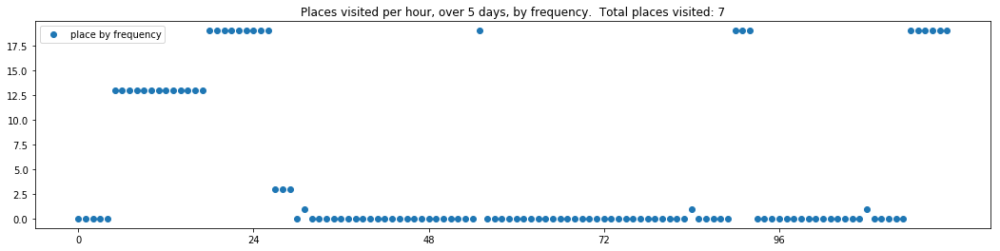

----- vector ----
prefix labels:  [291, 55]
[0, 0, 0, 291, 291, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 291, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 130, 130, 0, 0, 0, 0, 0]
[0, 0, 0, 50, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


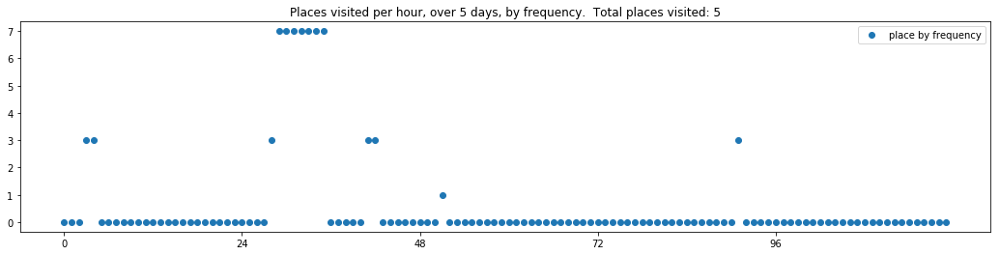

----- vector ----
prefix labels:  [562, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 304, 304, 304, 304, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304]


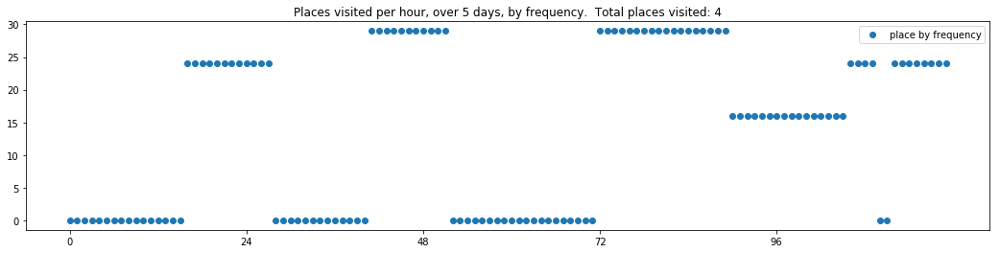

----- vector ----
prefix labels:  [152, 215]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215]
[215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


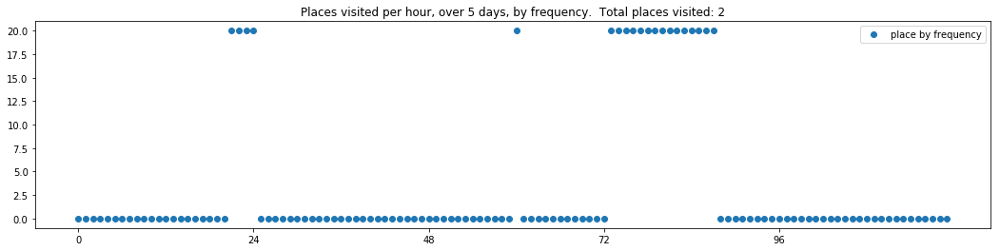

----- vector ----
prefix labels:  [412, 0]
[0, 0, 0, 0, 0, 412, 0, 412, 0, 0, 0, 0, 412, 0, 0, 0, 0, 0, 412, 412, 412, 0, 0, 412]
[0, 0, 412, 0, 0, 412, 151, 116, 116, 116, 116, 0, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 0]
[0, 0, 0, 0, 0, 0, 248, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 412, 0, 0, 412, 0, 0, 412, 412, 412, 412, 412, 0, 0, 0, 0, 0, 412, 412, 412, 412]
[0, 0, 0, 0, 0, 0, 0, 0, 412, 412, 0, 0, 0, 0, 0, 518, 0, 412, 412, 412, 412, 0, 0, 0]


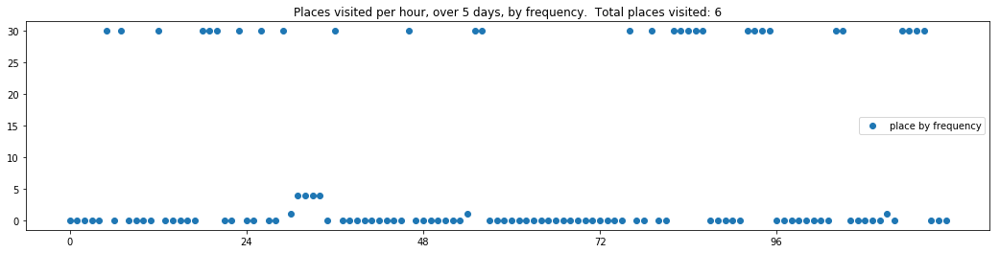

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 629, 629, 629, 629, 629, 629, 629, 629, 0, 328, 328, 328, 328, 629]
[0, 629, 629, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433, 328, 328, 328]


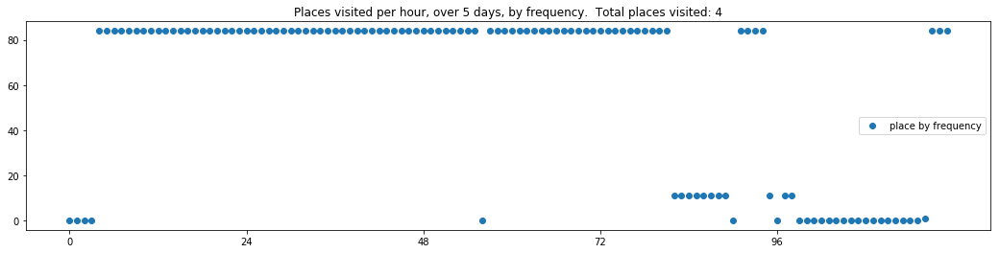

----- vector ----
prefix labels:  [296, 107]
[0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 0, 0, 0, 0, 0, 328, 0, 328, 328, 328, 328, 0]
[0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0]
[0, 0, 0, 0, 296, 0, 0, 0, 0, 296, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]


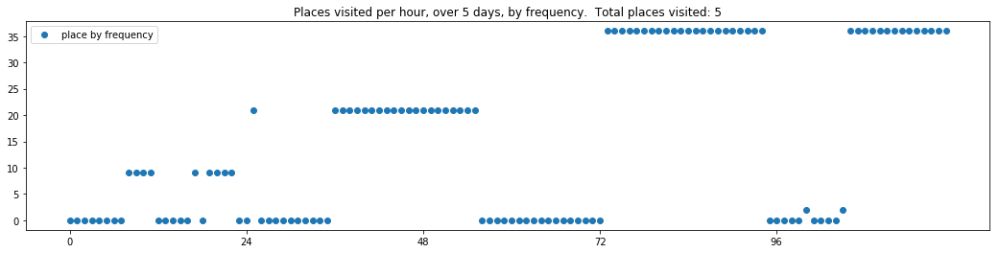

----- vector ----
prefix labels:  [91, 0]
[0, 0, 42, 40, 40, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 177, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 105, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 226, 143]
[574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 574, 184, 184, 279, 279, 279, 279, 279, 279]


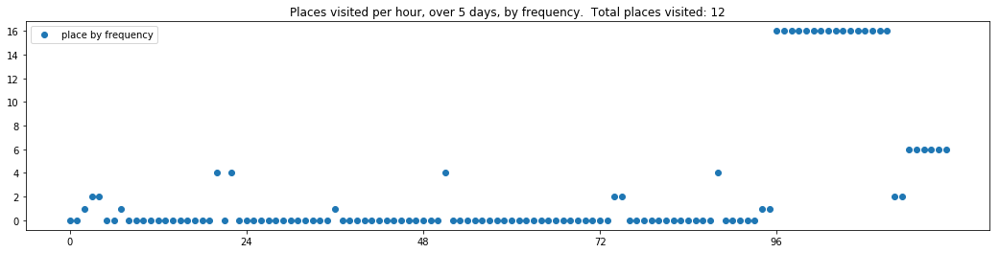

----- vector ----
prefix labels:  [177, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177]
[177, 177, 177, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 0, 0, 0, 177, 0, 0, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 0, 0, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 84, 0, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 177]


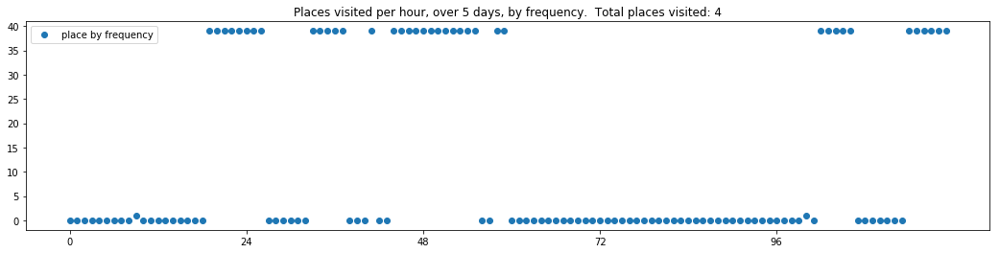

----- vector ----
prefix labels:  [140, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


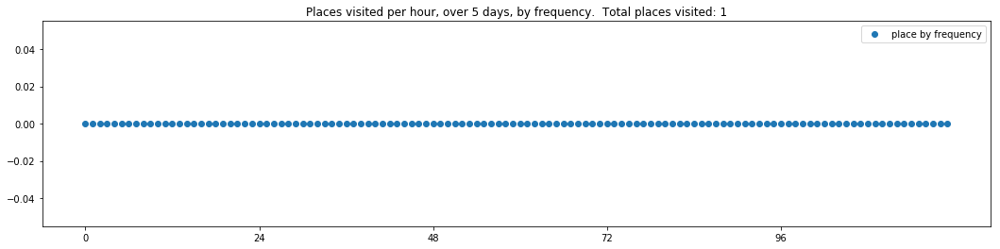

----- vector ----
prefix labels:  [396, 396]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 146, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 410, 410, 410, 410, 410, 410]
[410, 410, 410, 410, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 323, 323]


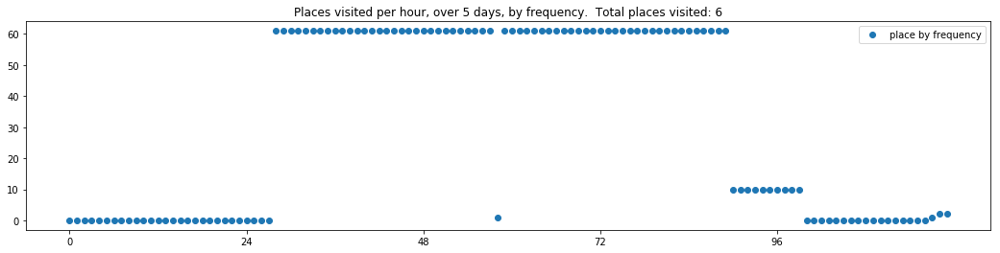

----- vector ----
prefix labels:  [566, 566]
[0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 0, 0, 0, 0, 0, 209, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 333, 333]
[126, 126, 126, 126, 126, 126, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


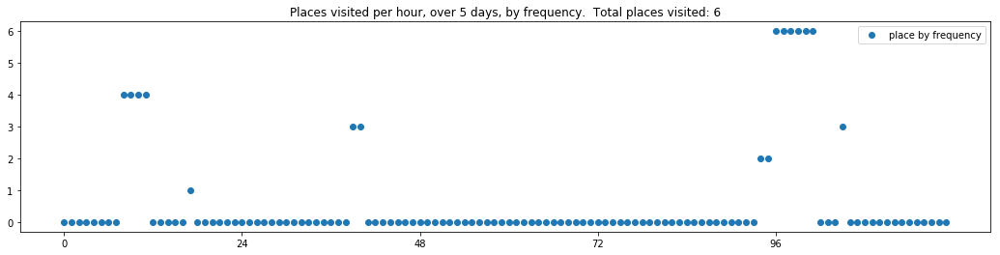

----- vector ----
prefix labels:  [57, 57]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 580, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 424, 424, 0, 0, 0, 0, 0, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57]
[57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 424, 424, 424, 0, 0, 0, 0, 0, 0, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57]
[57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57]


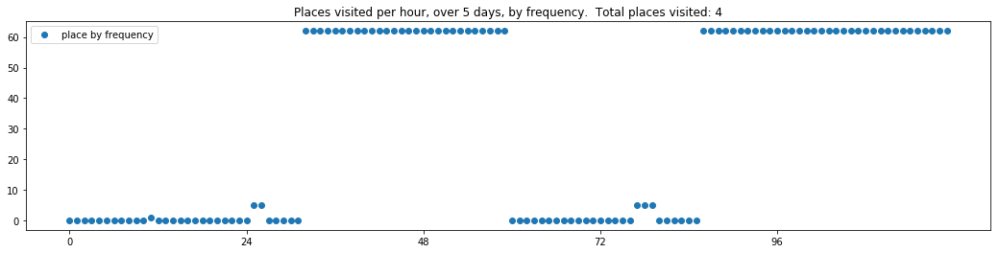

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 313, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 542, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 542, 313, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


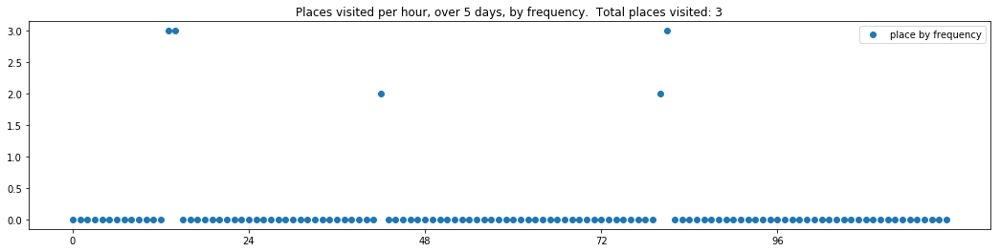

----- vector ----
prefix labels:  [321, 94]
[0, 0, 0, 0, 0, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94]
[94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 65, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


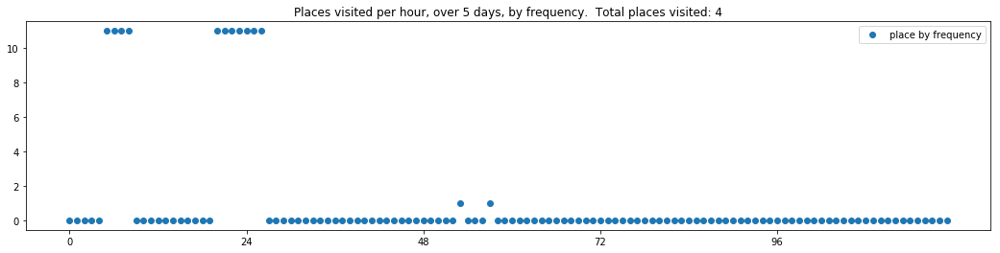


------
 50 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_50.txt 
------

----- vector ----
prefix labels:  [192, 192]
[0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]


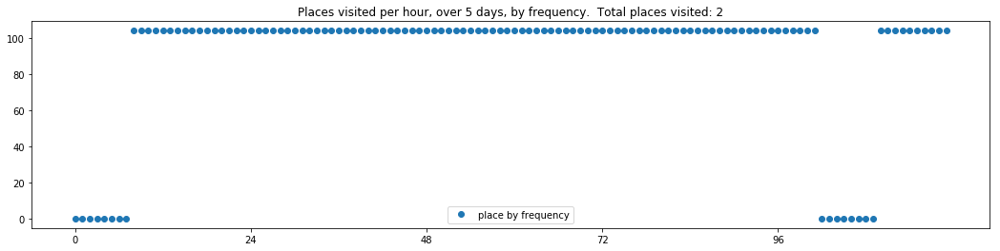

----- vector ----
prefix labels:  [8, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0]


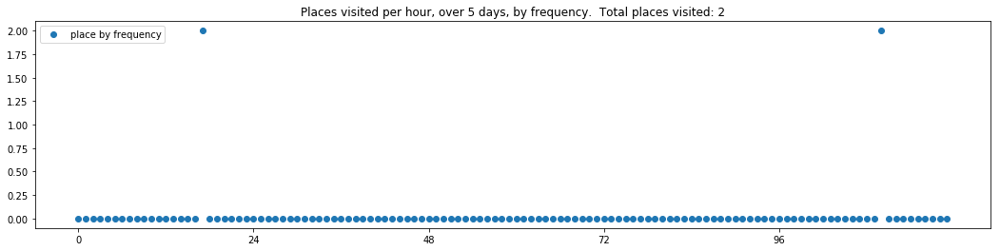

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0]
[0, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 0, 0, 0, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]


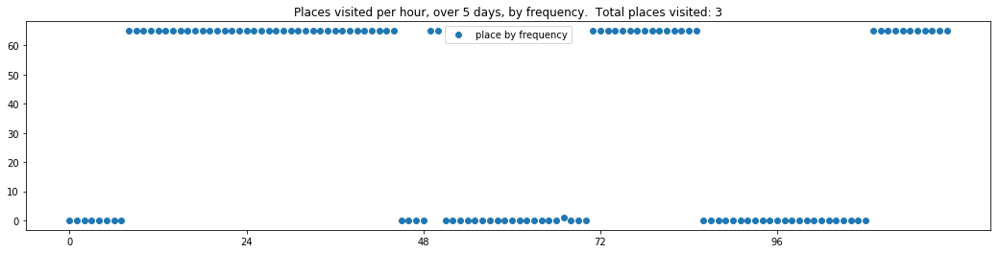

----- vector ----
prefix labels:  [507, 507]
[0, 0, 0, 0, 0, 507, 0, 0, 0, 0, 507, 507, 507, 0, 0, 0, 0, 507, 507, 507, 0, 507, 0, 0]
[0, 0, 0, 0, 507, 507, 507, 507, 507, 507, 0, 507, 507, 507, 0, 507, 0, 507, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 507, 507, 0, 0, 507, 507, 0, 507, 507, 507, 507, 507, 507, 0, 0, 0, 0, 0, 507, 0]
[507, 507, 507, 507, 507, 0, 507, 507, 507, 0, 0, 507, 507, 507, 507, 0, 0, 507, 507, 507, 507, 507, 507, 507]
[0, 507, 507, 0, 0, 507, 507, 507, 507, 507, 507, 507, 507, 507, 507, 0, 507, 507, 507, 507, 507, 0, 0, 0]


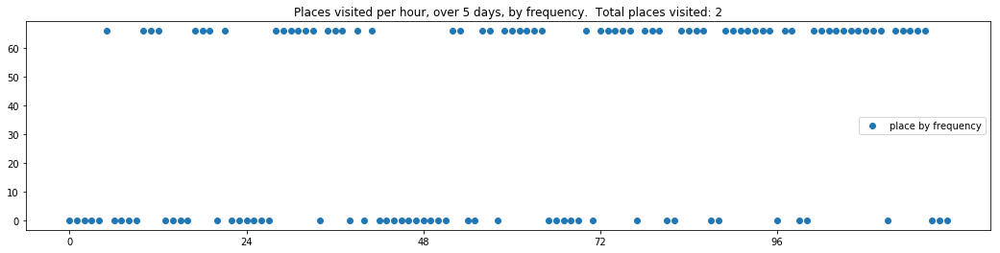

----- vector ----
prefix labels:  [123, 245]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 245, 245, 245, 245, 245, 245, 130, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[199, 199, 199, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 0, 162, 0]
[0, 0, 0, 0, 357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 52, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 133, 133, 133]


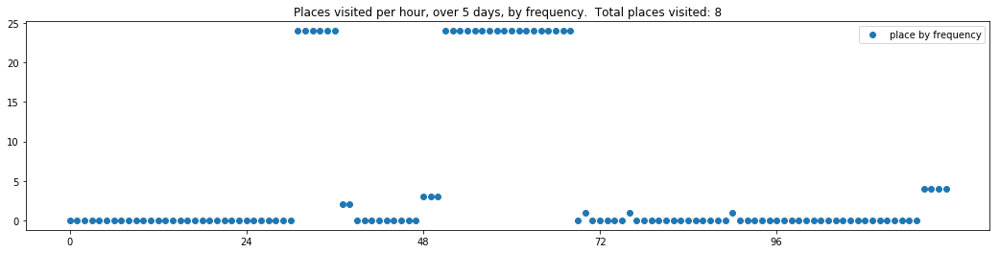

----- vector ----
prefix labels:  [227, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 193, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 239, 0, 0, 0, 0, 0, 555, 555, 555, 555, 555, 555, 555, 240, 0, 0, 0, 0, 0, 0, 0]


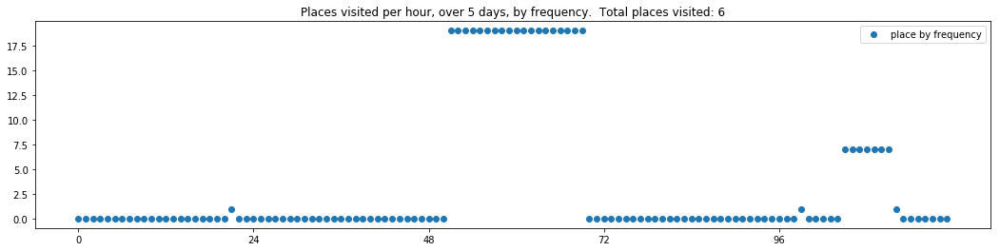

----- vector ----
prefix labels:  [167, 76]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 195, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[444, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 303, 303, 303, 303, 303, 303, 303, 134, 134, 134, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 134, 134, 134, 134, 134]
[134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134, 134]


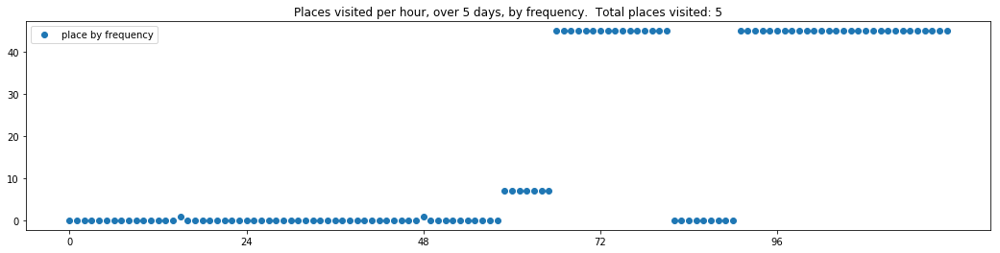

----- vector ----
prefix labels:  [140, 140]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[140, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0]


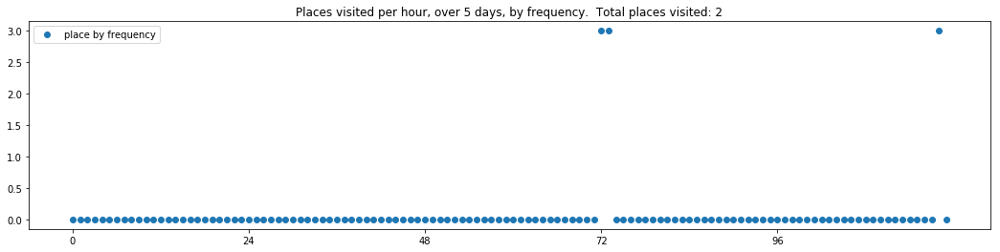

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 0, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


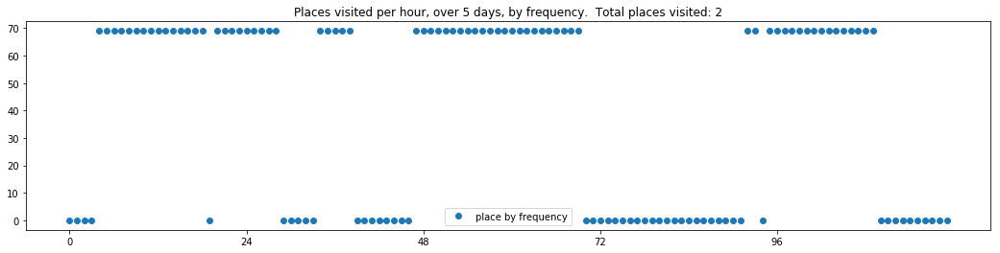

----- vector ----
prefix labels:  [21, 21]
[0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 41, 41, 388, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[21, 0, 0, 0, 551, 551, 551, 551, 551, 551, 551, 551, 551, 551, 551, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21]
[21, 21, 0, 21, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 388, 388, 149, 21, 21]


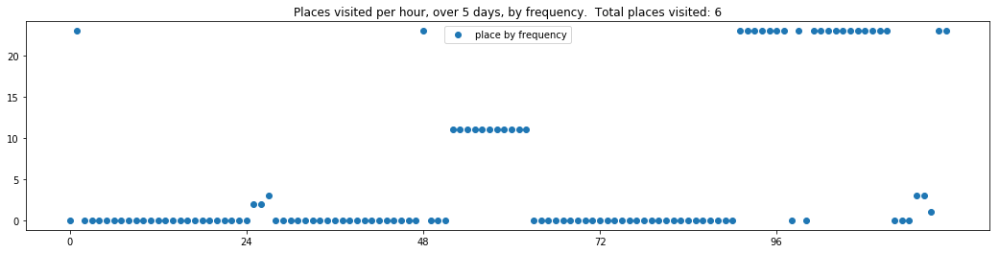

----- vector ----
prefix labels:  [20, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 445, 445, 20, 0, 0, 0, 0, 21, 21, 0]
[0, 0, 0, 0, 473, 473, 473, 0, 0, 416, 416, 416, 20, 0, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 400, 400, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 375, 20, 0, 0, 0]


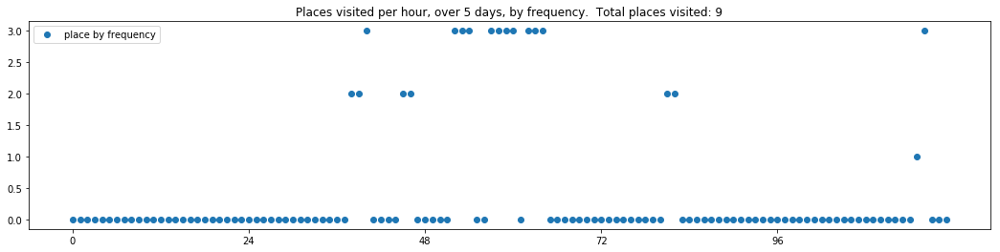

----- vector ----
prefix labels:  [544, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 544, 544, 544, 544, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 544, 544, 544, 544, 544, 544, 544, 544, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 528, 528, 528, 528, 528, 528, 528, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 274, 327, 637, 637]


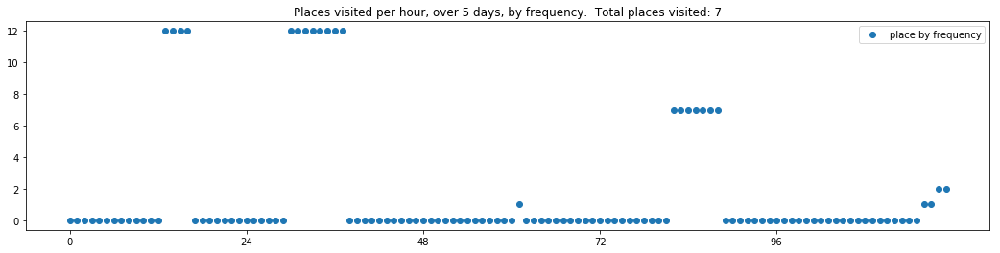

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 583, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 583, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


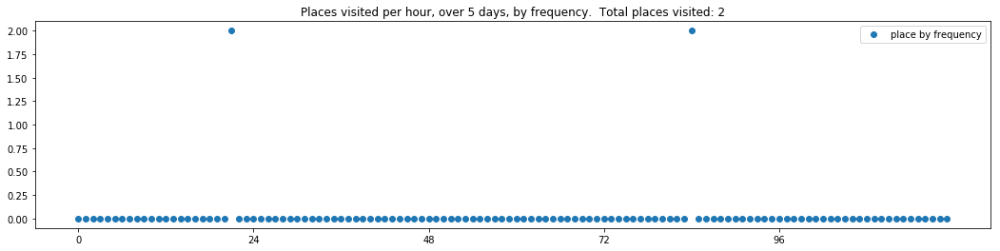

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]


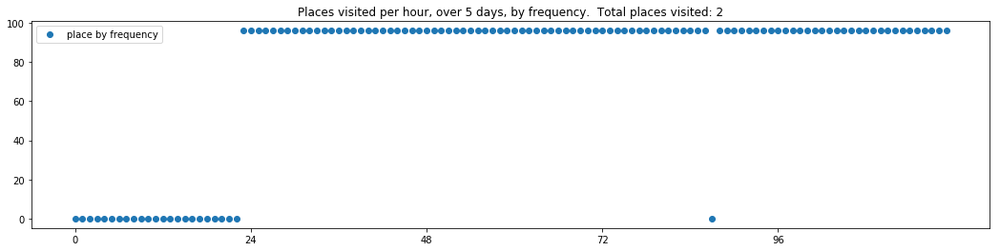

----- vector ----
prefix labels:  [203, 203]
[0, 0, 0, 0, 0, 0, 0, 0, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 203, 107, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 187, 187, 0, 0, 260, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 203, 203, 203, 203, 203, 203, 0, 0, 0, 0, 187, 187, 187, 142, 0, 21, 187, 0]


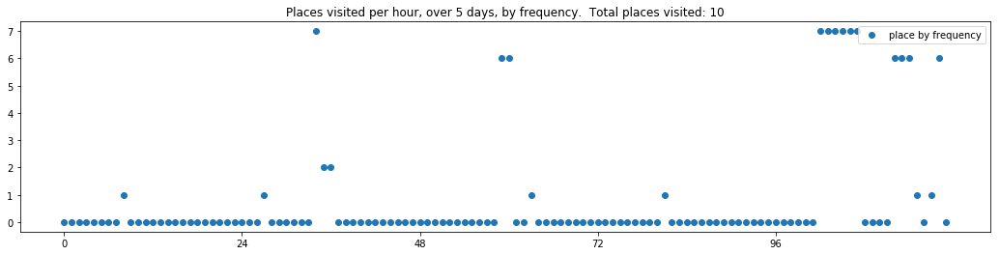

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 0, 0, 0, 0, 0]
[0, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 44, 0, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 100, 0, 0, 0, 0, 410, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 227, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 111, 0, 0, 0, 0, 0, 0, 0, 0]


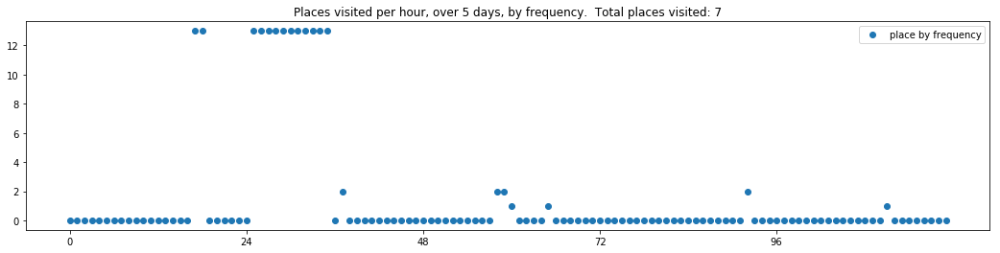

----- vector ----
prefix labels:  [226, 226]
[0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 323, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0]
[0, 0, 0, 56, 56, 56, 0, 0, 269, 0, 0, 0, 0, 0, 0, 357, 0, 0, 0, 0, 0, 0, 0, 0]


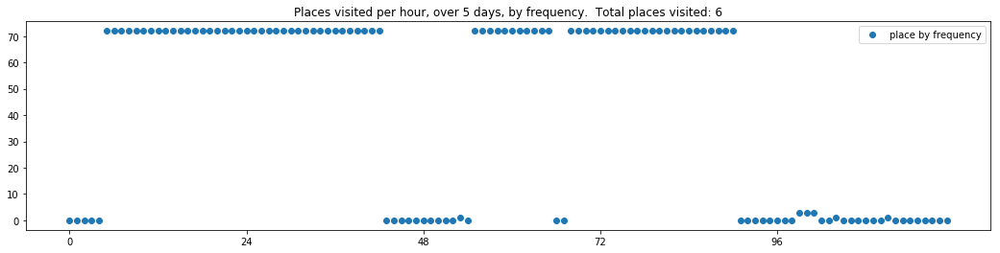

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 0, 0, 0, 0, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271]


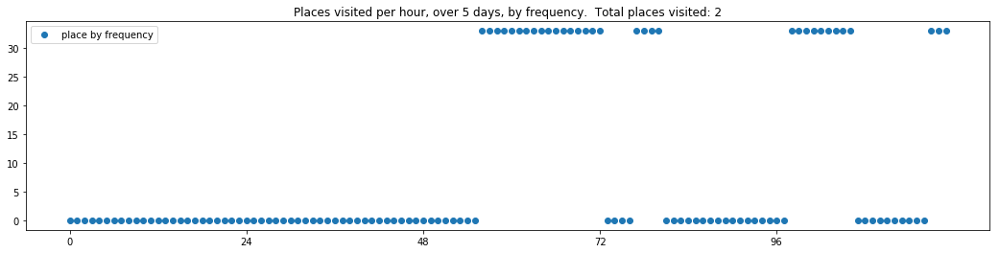

----- vector ----
prefix labels:  [102, 102]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 102, 102, 102, 0, 102, 102, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 390, 390, 390, 0, 0, 0, 611, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 102, 102, 102, 0, 0, 0]


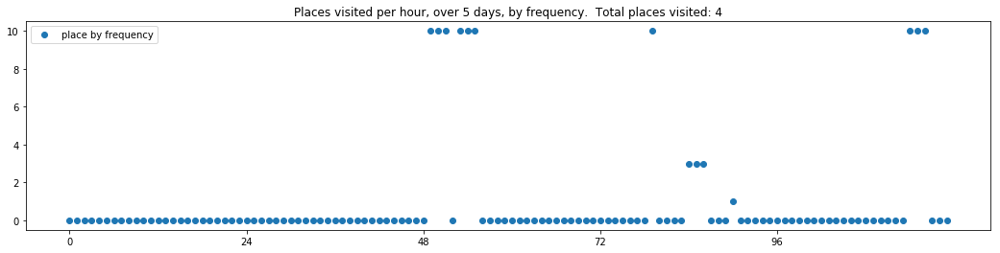

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


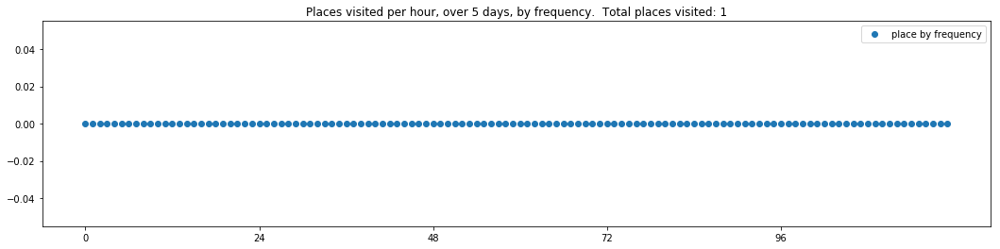

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 0, 0]


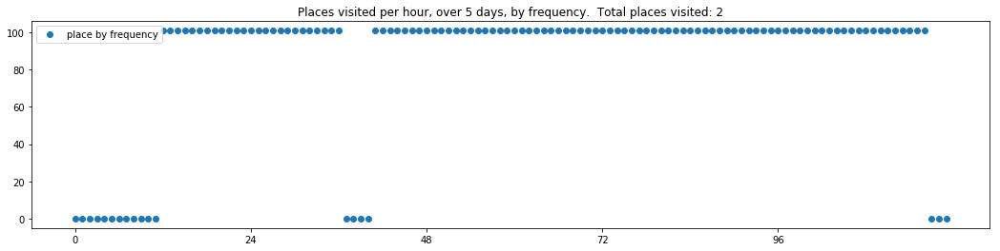

----- vector ----
prefix labels:  [221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 637, 637, 637, 637, 637, 637, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]


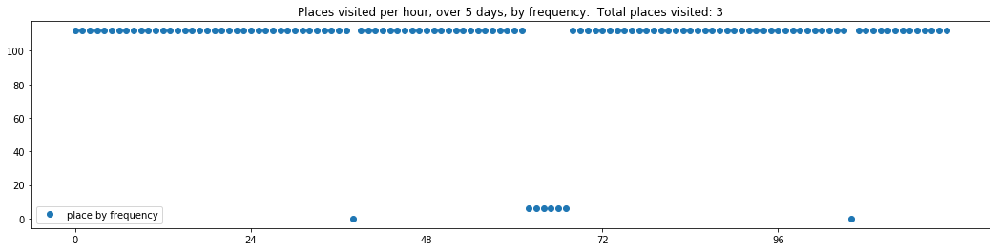

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0]
[21, 21, 21, 0, 0, 21, 21, 0, 0, 0, 21, 0, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[21, 21, 21, 21, 21, 22, 22, 21, 21, 0, 0, 21, 21, 21, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 21, 0, 21, 21, 21, 21, 0, 342, 0, 21, 21, 21, 21, 271]
[271, 342, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21]


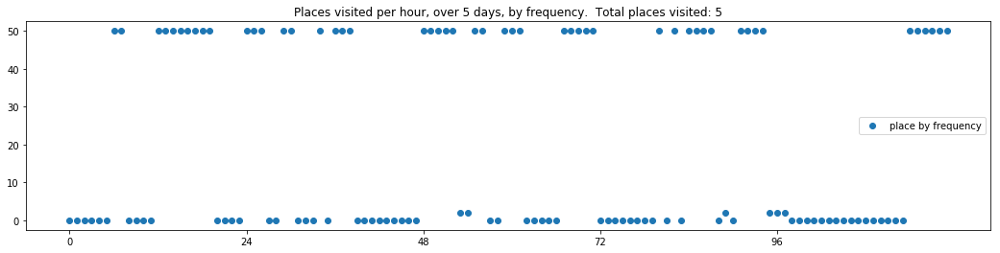

----- vector ----
prefix labels:  [629, 629]
[0, 0, 0, 0, 0, 0, 0, 0, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]


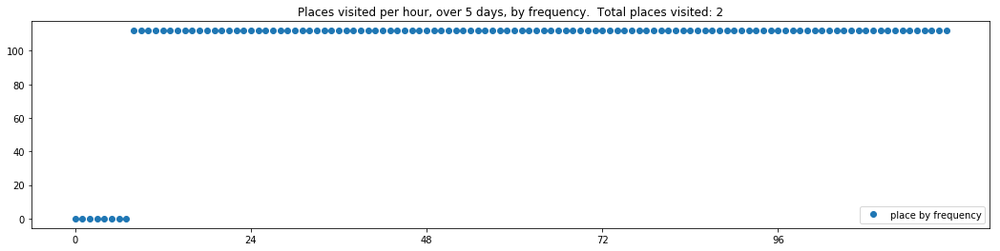

----- vector ----
prefix labels:  [69, 1]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 267, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 362, 362, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


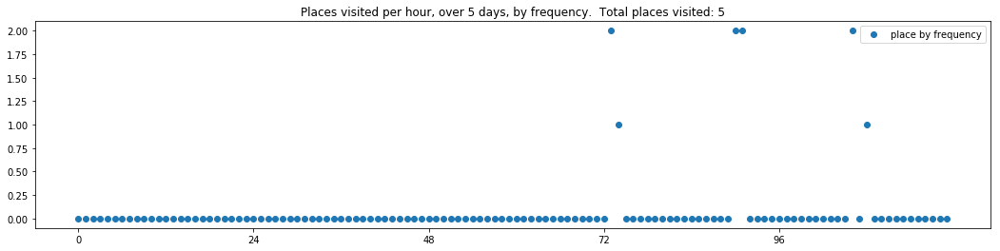

----- vector ----
prefix labels:  [226, 226]
[0, 0, 0, 0, 0, 0, 0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 0, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]


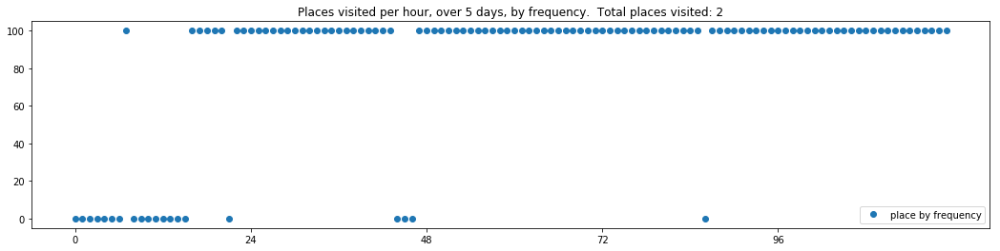

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]


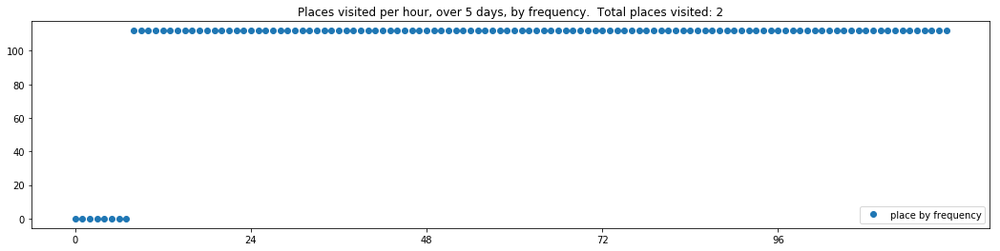

----- vector ----
prefix labels:  [319, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


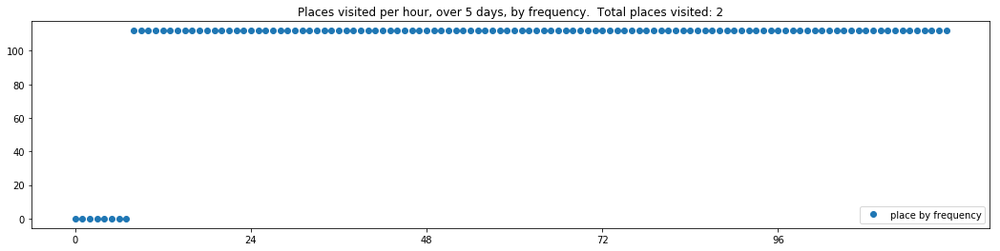

----- vector ----
prefix labels:  [22, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 77, 77, 77, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


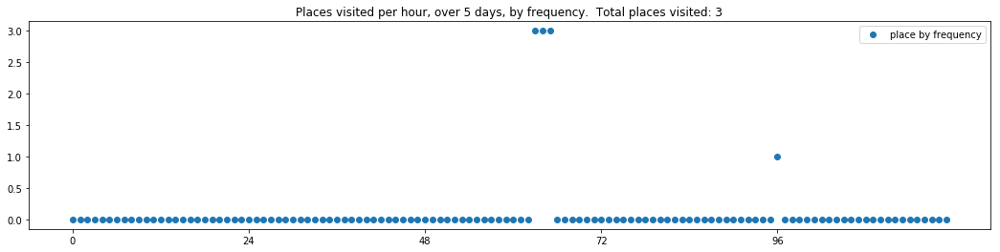

----- vector ----
prefix labels:  [195, 195]
[0, 0, 0, 0, 312, 489, 489, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 0, 0, 0, 0, 0, 195, 195]
[195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195]
[195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195]
[195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 0, 0, 195, 195, 195, 195, 195, 195, 195, 195]
[195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195, 195]


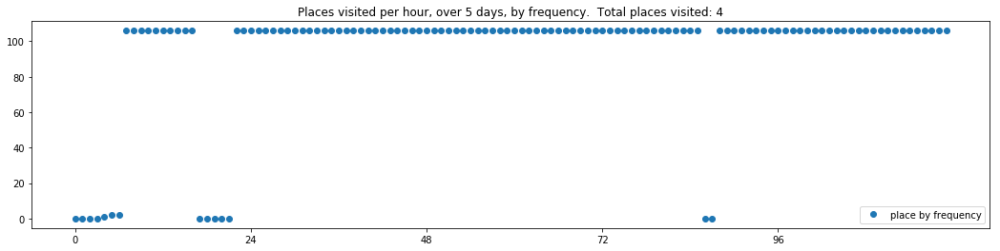

----- vector ----
prefix labels:  [91, 0]
[0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 102, 102, 102]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 308, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0, 308, 341, 341]
[341, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212]


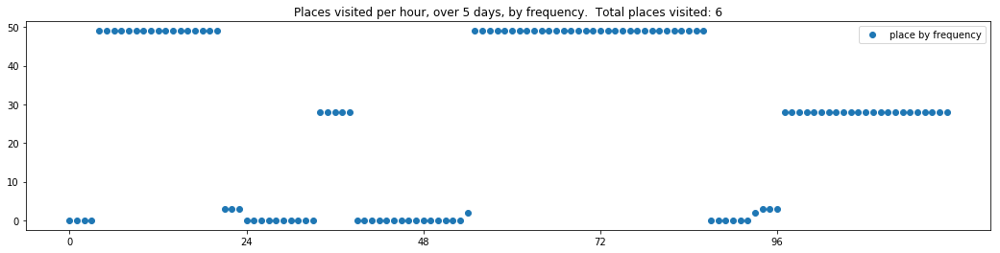

----- vector ----
prefix labels:  [191, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


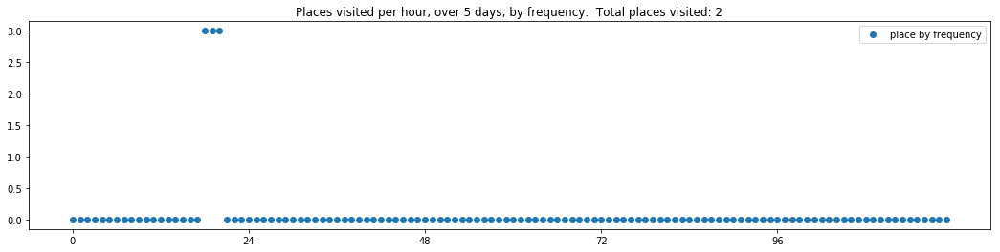

----- vector ----
prefix labels:  [85, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


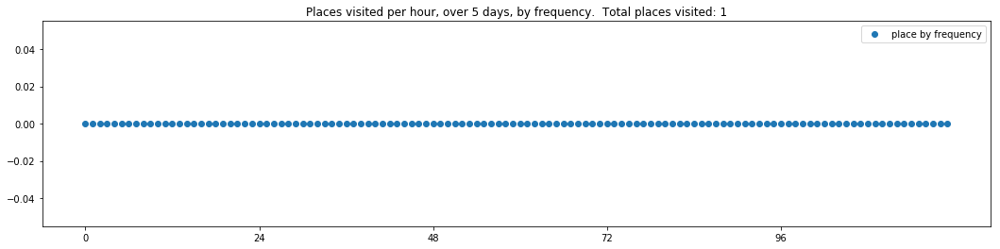

----- vector ----
prefix labels:  [385, 385]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 385, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 374, 388, 388, 388, 385, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 635, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


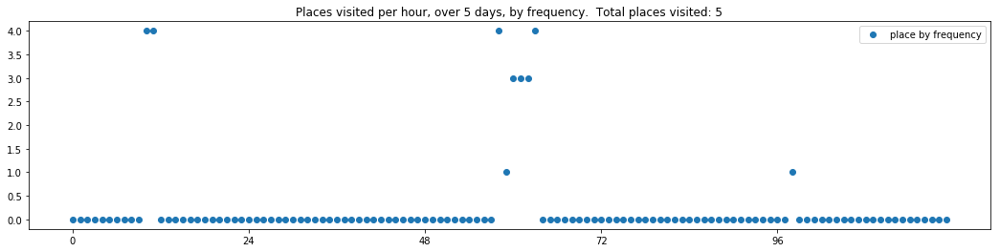

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 225, 0, 0, 0, 0, 205, 205, 205, 0, 0, 0, 0, 205, 205, 205, 0]
[0, 0, 0, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 205, 205, 205]
[0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 0, 0, 0, 200, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4]


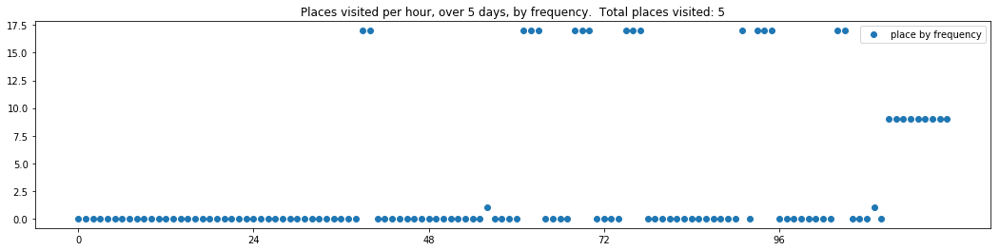

----- vector ----
prefix labels:  [457, 195]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 429, 429, 457, 457, 457, 457, 457]


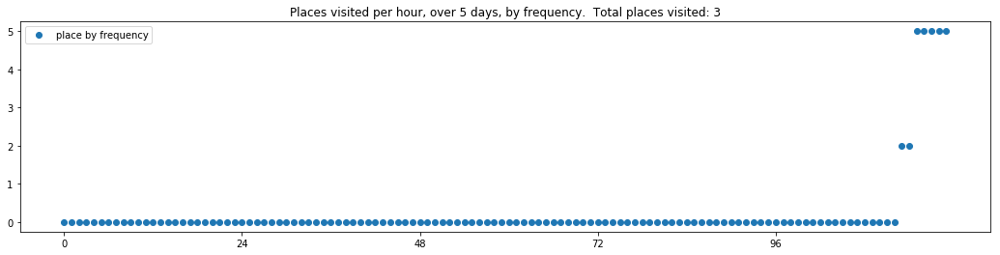

----- vector ----
prefix labels:  [45, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 45, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0]
[0, 0, 0, 0, 0, 20, 0, 0, 45, 45, 45, 45, 45, 45, 45, 45, 45, 45, 45, 45, 45, 45, 0, 0]


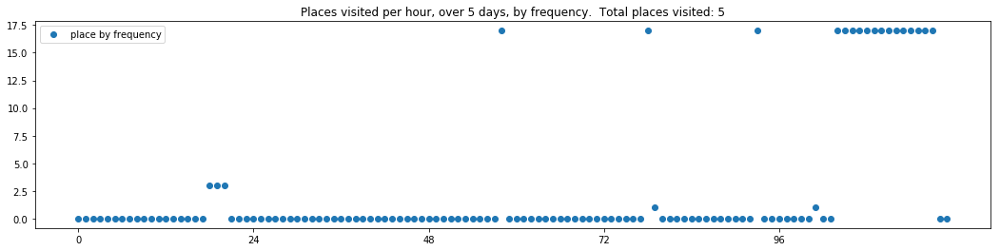

----- vector ----
prefix labels:  [102, 102]
[0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562]
[562, 562, 562, 562, 562, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562]
[562, 102, 390, 390, 102, 0, 390, 390, 390, 390, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 102, 102, 102, 102, 102, 102, 102, 102, 102, 102, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 390, 390, 390, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 0, 0, 0, 0, 0]


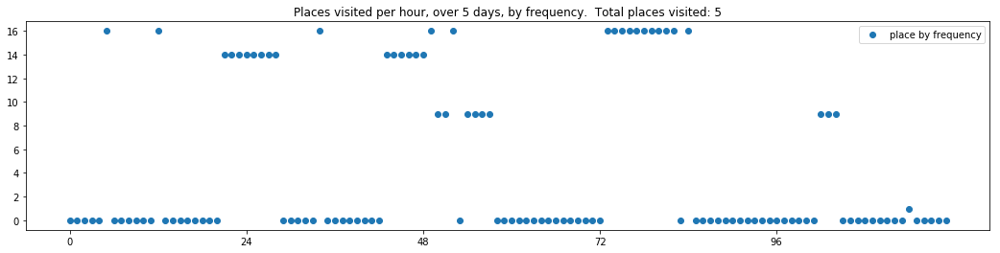

----- vector ----
prefix labels:  [237, 237]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


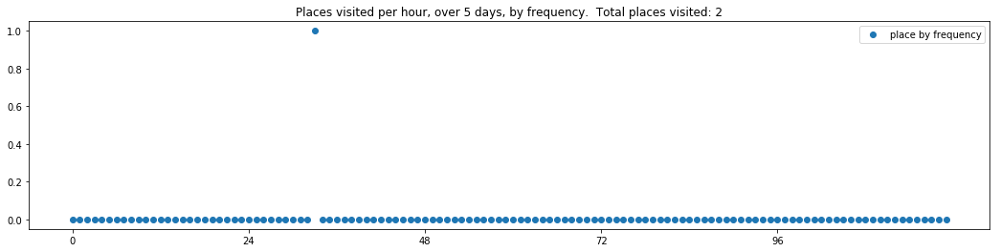

----- vector ----
prefix labels:  [124, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 2, 568, 568, 568, 568, 568, 568, 568, 568, 0, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 124, 0, 0, 0, 0, 0, 0, 0]


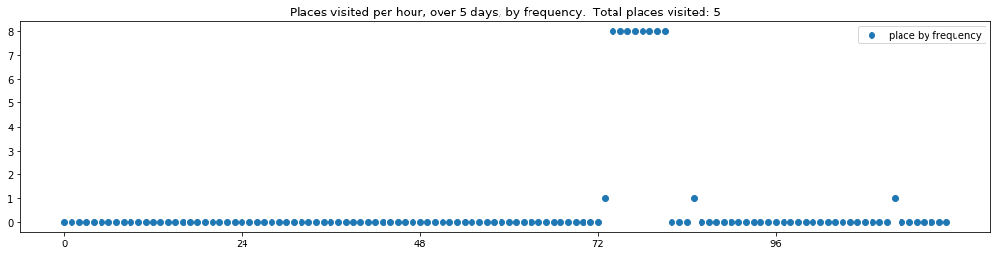

----- vector ----
prefix labels:  [342, 333]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 333, 333, 333, 333]
[333, 0, 0, 0, 0, 0, 342, 342, 342, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 0, 143]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 76, 0, 0, 0, 0, 0, 0]
[0, 0, 65, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


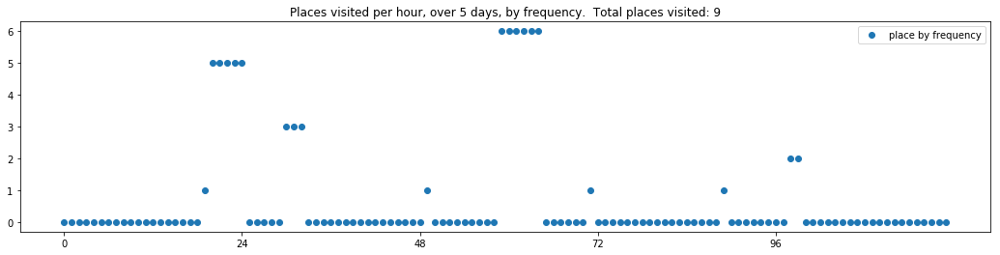

----- vector ----
prefix labels:  [116, 116]
[0, 0, 0, 0, 0, 0, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 116, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 0, 71, 71, 526, 526, 526, 526, 526, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 461, 461, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 0, 23, 314, 0, 0, 0, 0, 0, 0]


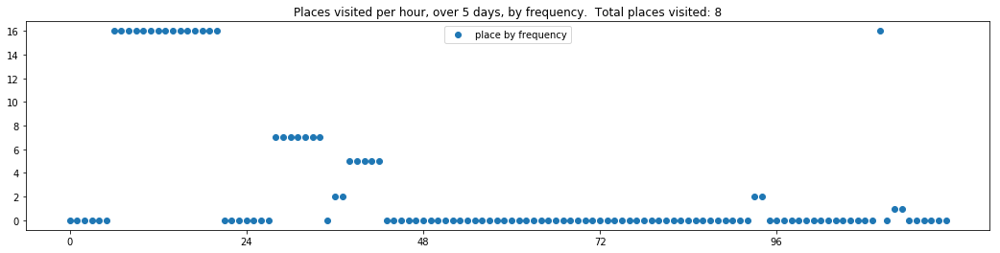

----- vector ----
prefix labels:  [68, 68]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 588, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 475, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 0]
[0, 130, 0, 0, 0, 0, 0, 0, 0, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 0, 0, 0]


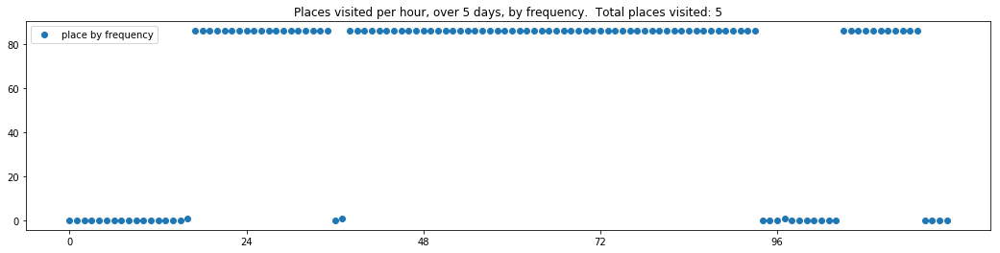

----- vector ----
prefix labels:  [620, 320]
[0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 0, 0, 0, 0, 0, 620, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 620, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]


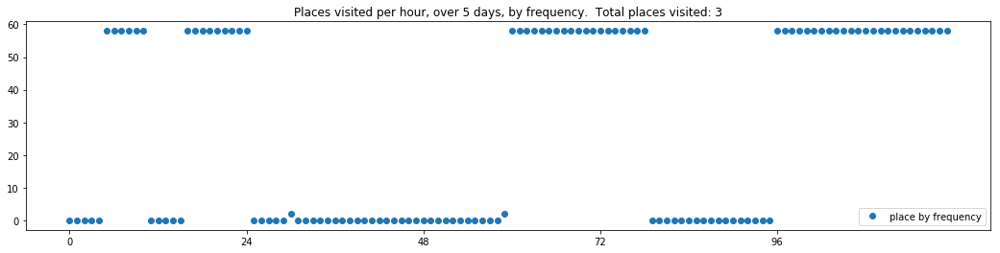

----- vector ----
prefix labels:  [522, 522]
[0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 312, 0, 0, 0, 0, 0, 0, 522, 522]
[522, 522, 522, 522, 0, 0, 0, 0, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 522]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


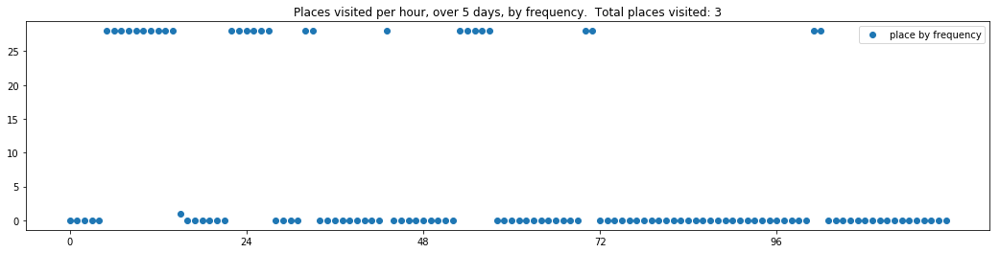

----- vector ----
prefix labels:  [458, 458]
[0, 0, 0, 0, 0, 458, 0, 0, 0, 0, 0, 0, 0, 0, 458, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 458, 458, 458, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


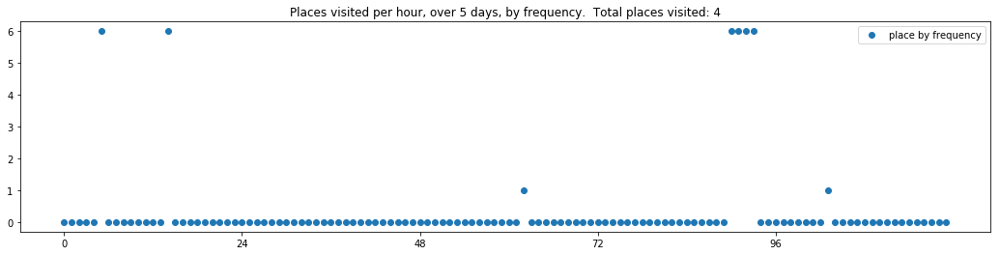

----- vector ----
prefix labels:  [130, 130]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 0, 0, 0]
[0, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 352, 352, 352, 352, 0, 0, 0, 0]


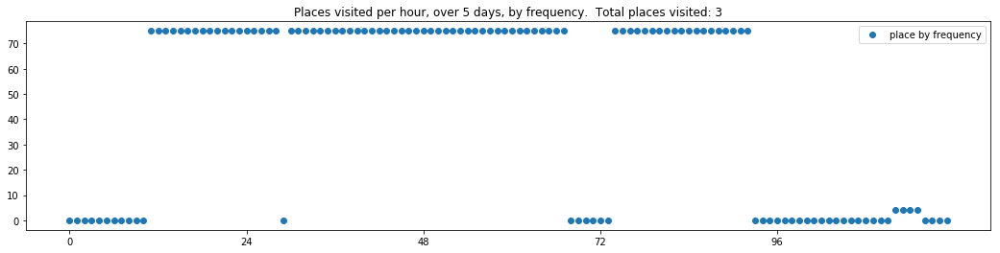

----- vector ----
prefix labels:  [508, 508]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]
[508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]
[508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]
[508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]


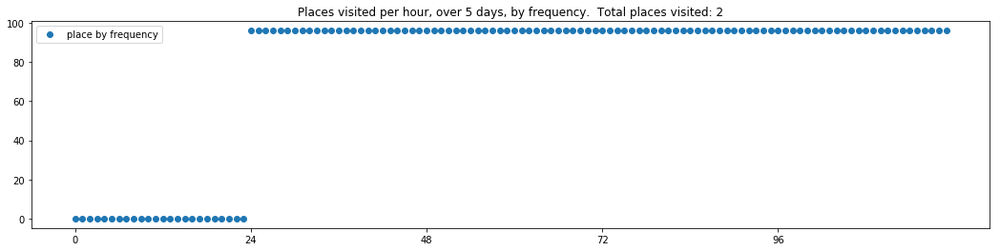

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 378, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 0, 434, 434, 434, 434, 413, 0, 0, 0, 0, 140, 140, 250, 0, 0, 0, 0, 0, 0, 0, 0, 176]


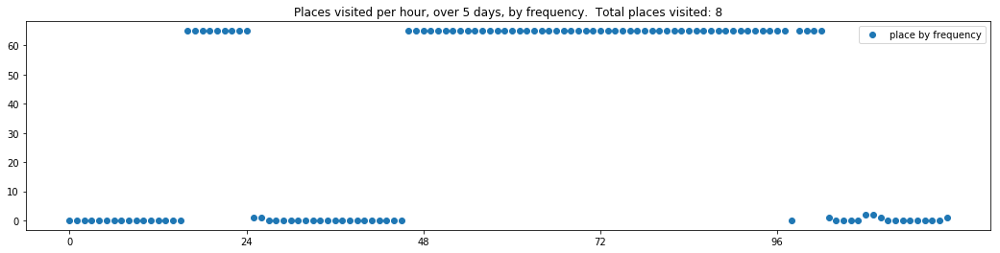

----- vector ----
prefix labels:  [149, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 383, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 149, 0, 0, 149, 149, 149, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75, 75]


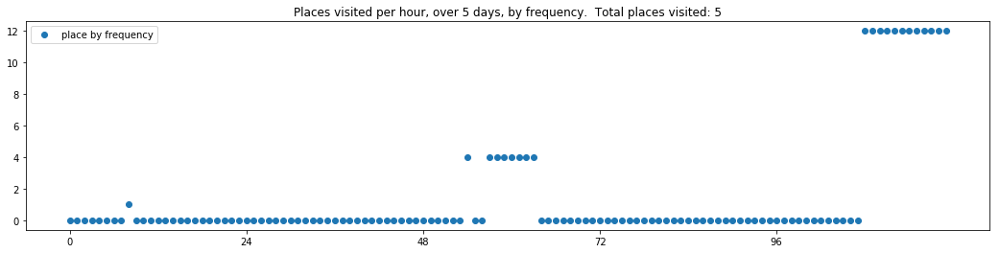


------
 55 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_55.txt 
------

----- vector ----
prefix labels:  [8, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 591, 591]
[591, 591, 591, 591, 0, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]


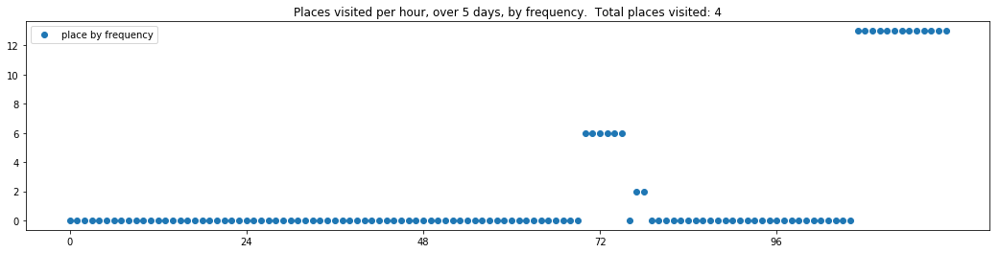

----- vector ----
prefix labels:  [349, 349]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 349, 423, 349, 349, 349, 349, 349, 349]
[349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 349, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 424, 424, 424, 424, 0, 0, 0, 0, 0, 0, 0, 423, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 423, 423, 423, 423, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57, 57]


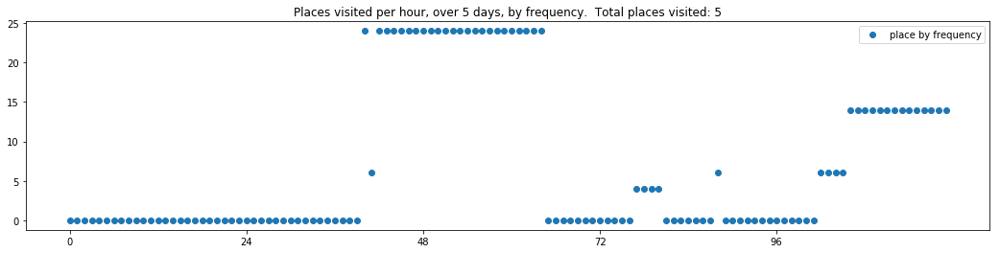

----- vector ----
prefix labels:  [286, 0]
[0, 0, 0, 0, 0, 286, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


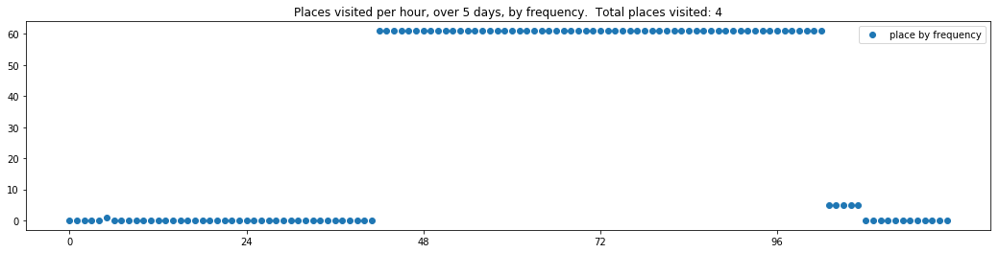

----- vector ----
prefix labels:  [439, 439]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 439, 439, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[439, 439, 439, 439, 439, 439, 439, 439, 439, 0, 0, 0, 0, 0, 0, 439, 439, 0, 385, 385, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 439, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


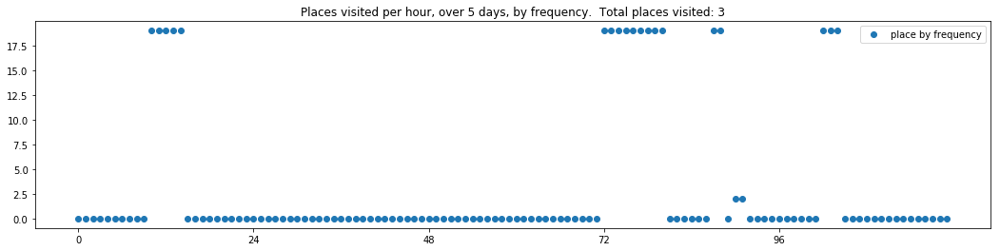

----- vector ----
prefix labels:  [21, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 0, 0, 0, 0, 0]
[0, 0, 0, 21, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[72, 72, 72, 72, 72, 72, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


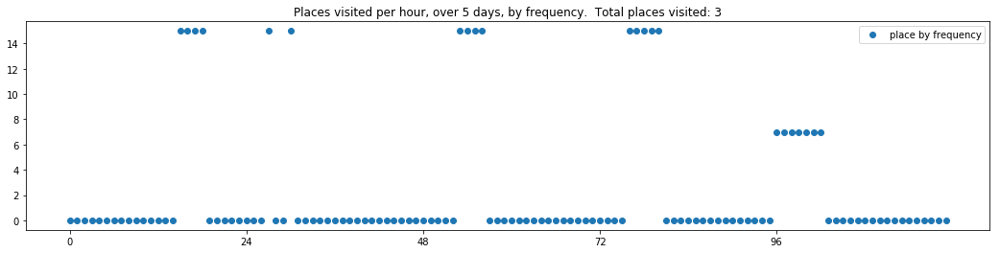

----- vector ----
prefix labels:  [246, 246]
[0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]
[246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246]
[246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]


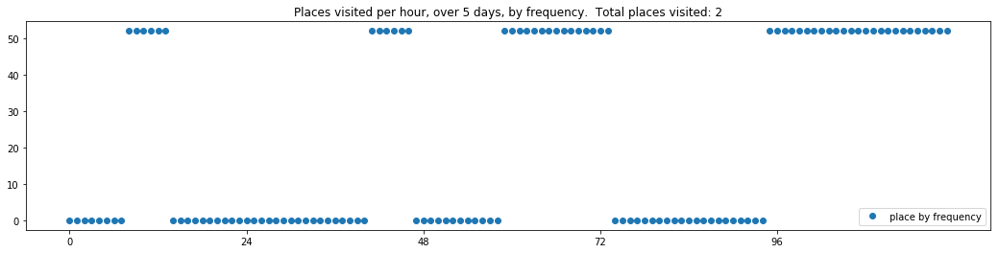

----- vector ----
prefix labels:  [142, 142]
[0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 0, 0, 0, 0, 0, 0]
[0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142]
[142, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0]
[0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0]


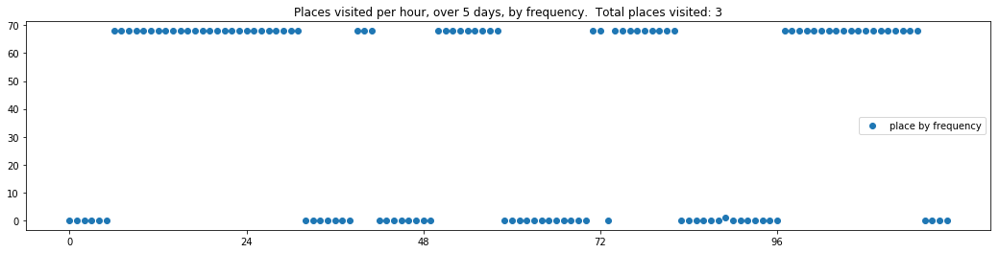

----- vector ----
prefix labels:  [612, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21]
[21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 21, 21, 21, 0, 0, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 0, 21, 21, 0, 0, 0, 0, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0]


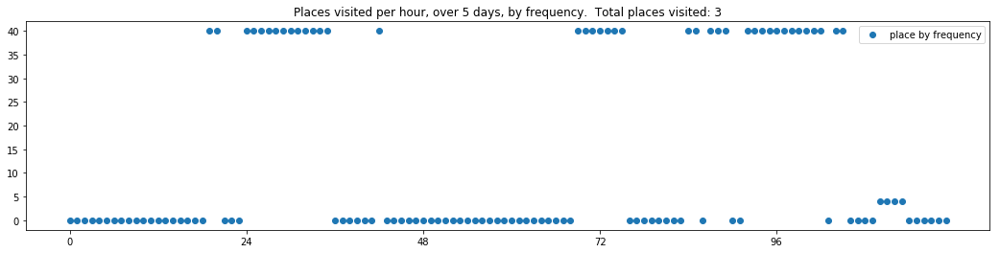

----- vector ----
prefix labels:  [391, 391]
[0, 0, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 0, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 311, 311, 311, 311, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


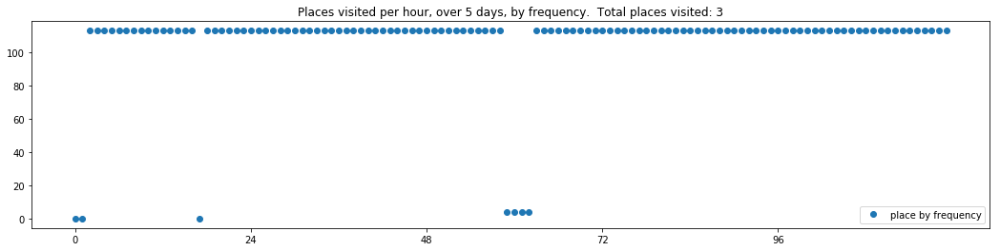

----- vector ----
prefix labels:  [341, 341]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 341, 341, 341, 341, 341, 341, 341, 341, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 341, 341, 341, 341, 341, 341, 341]
[341, 341, 341, 341, 341, 341, 341, 341, 463, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 341, 341, 341, 341, 341, 341, 341, 341, 341, 341, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]


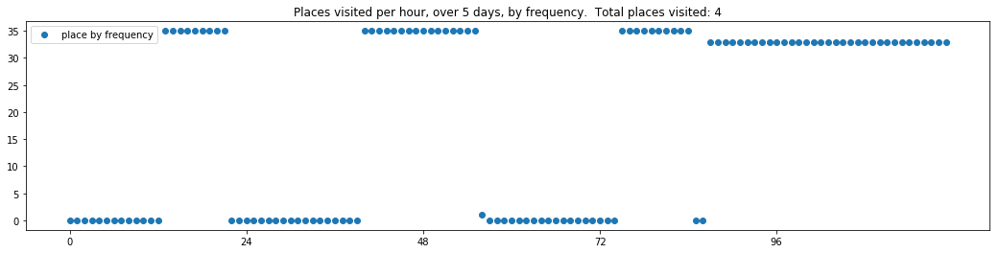

----- vector ----
prefix labels:  [539, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 539, 539, 0, 0, 0, 0, 0, 0, 0, 539]
[539, 539, 539, 539, 0, 539, 539, 0, 0, 0, 0, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 539]
[539, 539, 539, 539, 539, 539, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


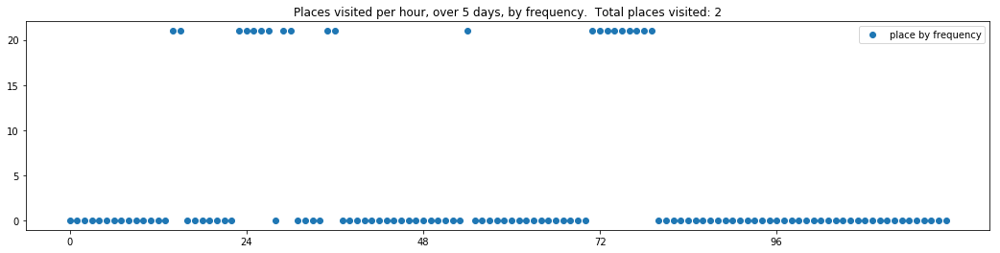

----- vector ----
prefix labels:  [582, 0]
[0, 0, 0, 0, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 43, 43, 0, 582, 582, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]


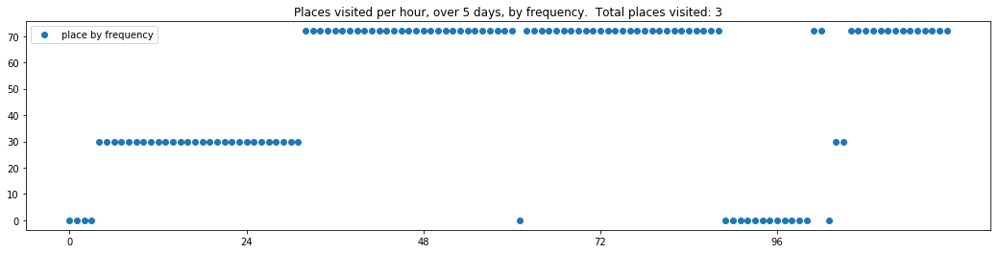

----- vector ----
prefix labels:  [100, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 284, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 553, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 52, 52, 52, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 208, 0, 0, 0, 0, 0]


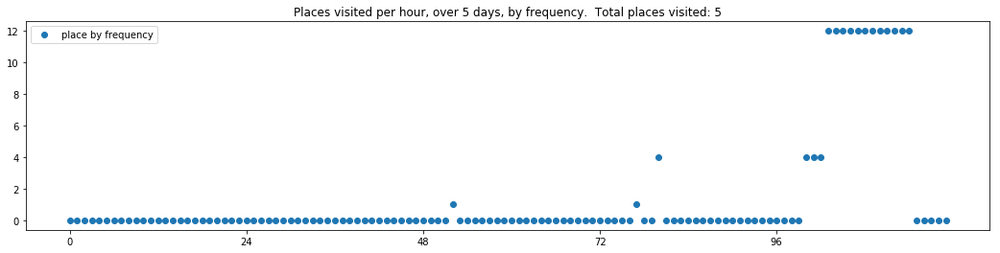

----- vector ----
prefix labels:  [192, 192]
[192, 0, 0, 0, 0, 448, 20, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]


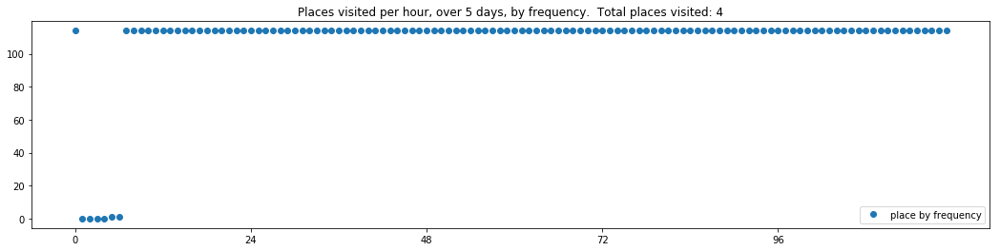

----- vector ----
prefix labels:  [311, 311]
[0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]


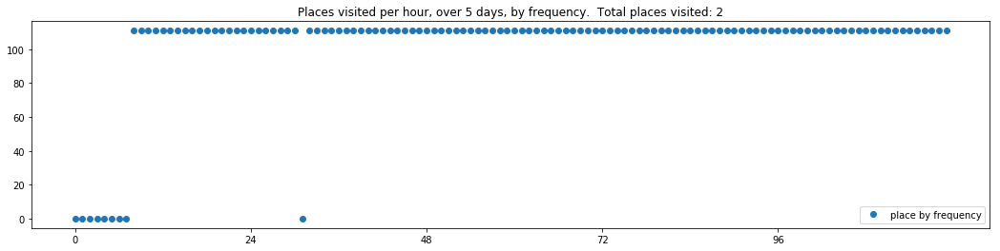

----- vector ----
prefix labels:  [488, 488]
[0, 0, 0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 583, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]


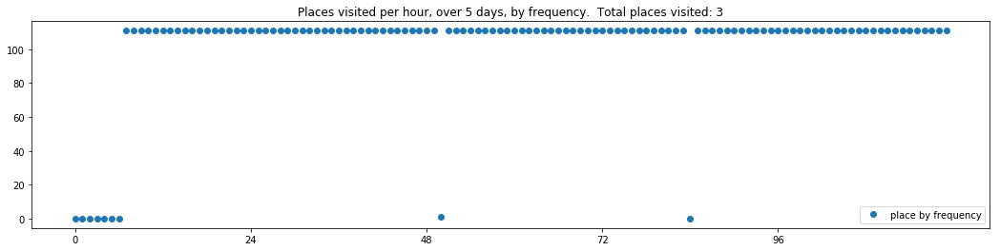

----- vector ----
prefix labels:  [119, 119]
[0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119]
[119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 364, 364, 227, 227, 227, 241, 117, 406, 406, 406, 406, 0, 0, 0, 0, 119, 119, 119, 119, 119, 119]
[119, 0, 0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119]


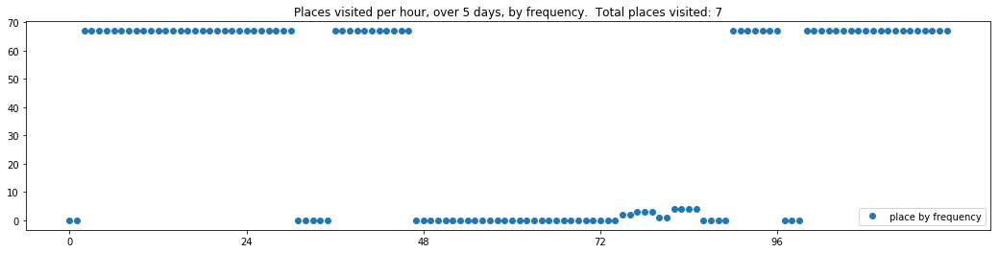

----- vector ----
prefix labels:  [177, 177]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 0, 0, 0, 177]
[177, 177, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 84]
[0, 0, 177, 0, 177, 0, 0, 21, 21, 21, 21, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 21, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 177, 177, 177, 177, 177, 177]


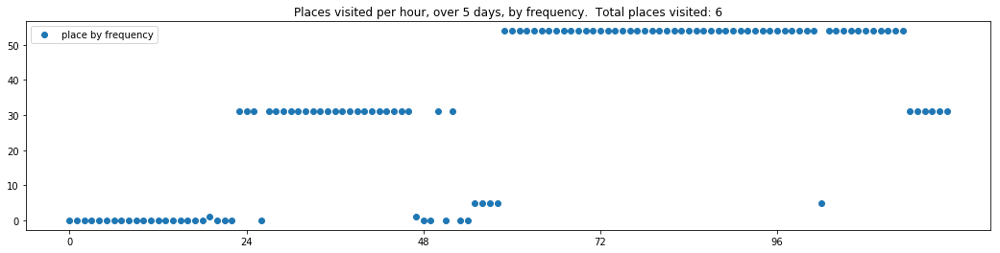

----- vector ----
prefix labels:  [7, 7]
[0, 0, 0, 0, 0, 0, 20, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7]
[7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 130, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0]
[0, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 437, 0, 0, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7]


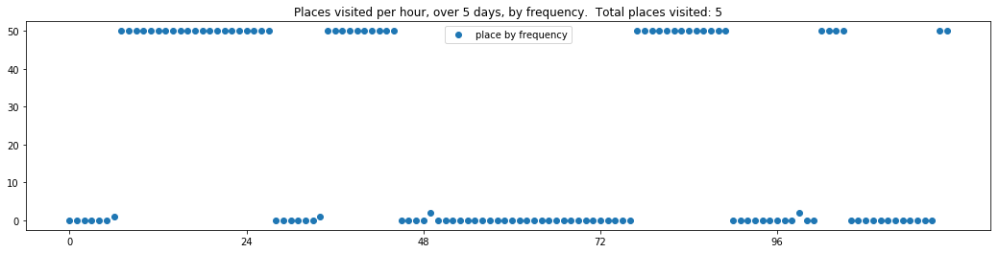

----- vector ----
prefix labels:  [124, 124]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 124, 124, 124]
[124, 124, 124, 124, 124, 124, 124, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


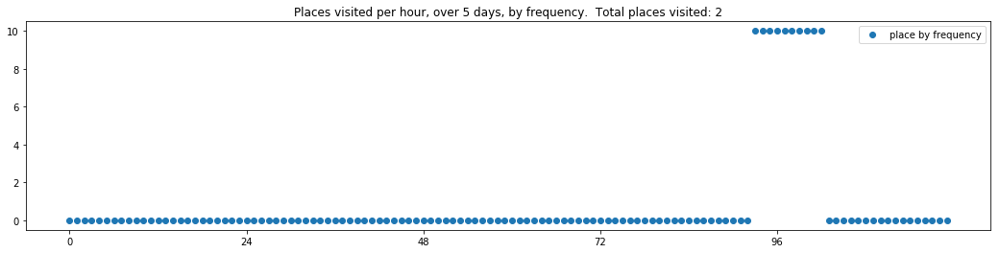

----- vector ----
prefix labels:  [0, 84]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 396, 0, 0, 0, 0, 0, 84]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


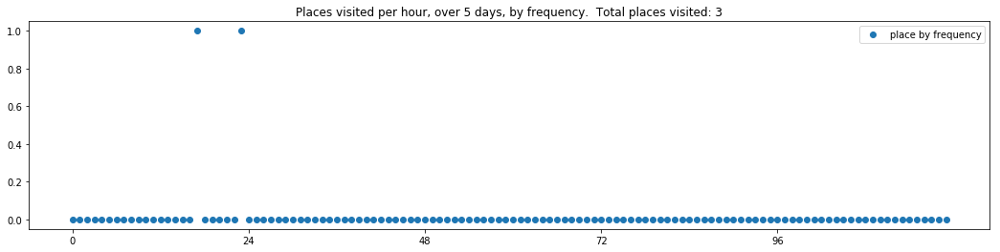

----- vector ----
prefix labels:  [306, 199]
[0, 0, 0, 0, 0, 0, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[377, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 291, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]


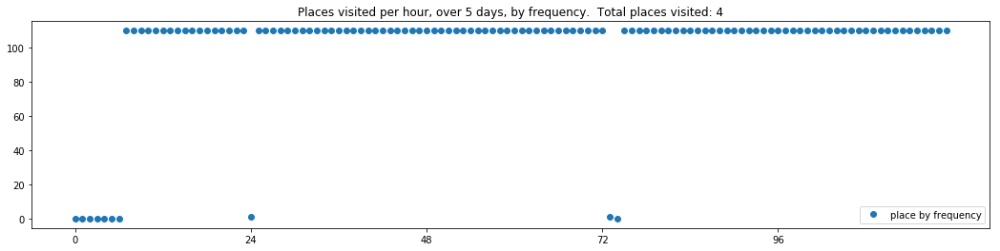

----- vector ----
prefix labels:  [119, 119]
[119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119]
[119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 0]
[0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 406, 0, 0, 0, 406, 406]
[406, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 119, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119]


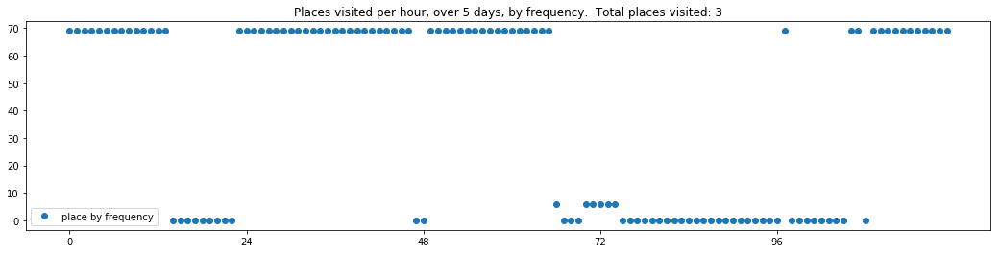

----- vector ----
prefix labels:  [642, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


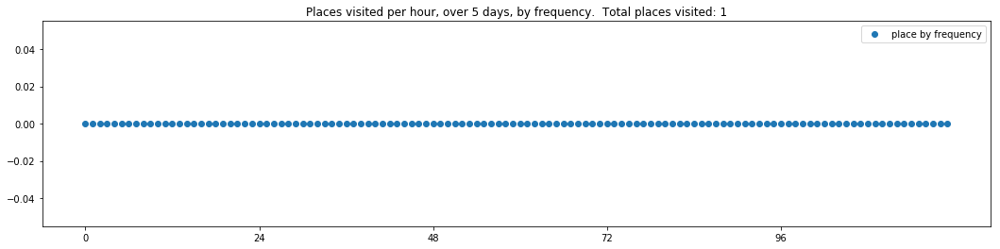

----- vector ----
prefix labels:  [496, 222]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 0, 0, 0, 0, 0, 0]
[222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 496, 496, 496, 0, 0, 0, 0, 0, 396, 396, 396]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 222]
[222, 224, 0, 222, 0, 0, 0, 0, 0, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 0, 0, 0]


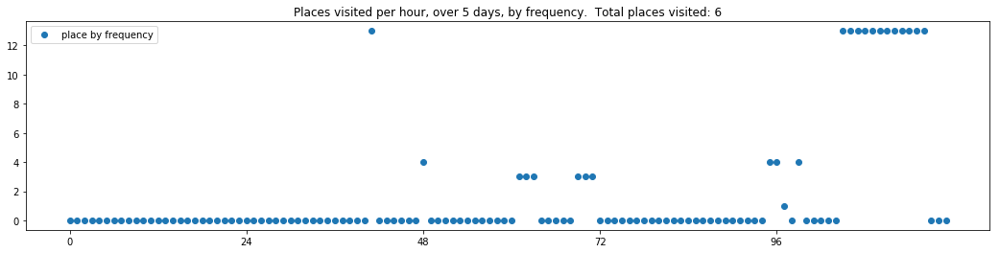

----- vector ----
prefix labels:  [343, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 343, 343, 343, 343]
[343, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 343, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 343, 343]


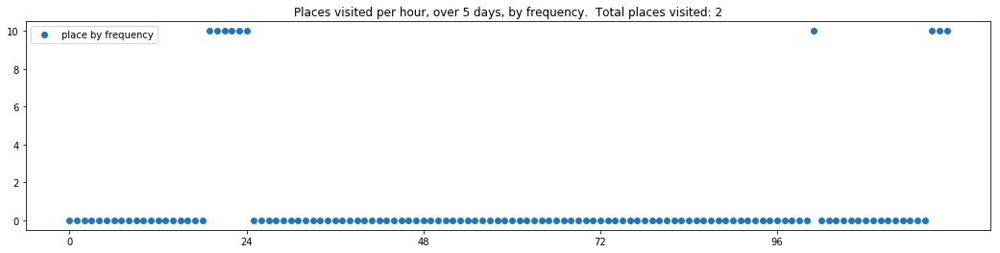

----- vector ----
prefix labels:  [111, 111]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 111, 111, 0, 0]
[111, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


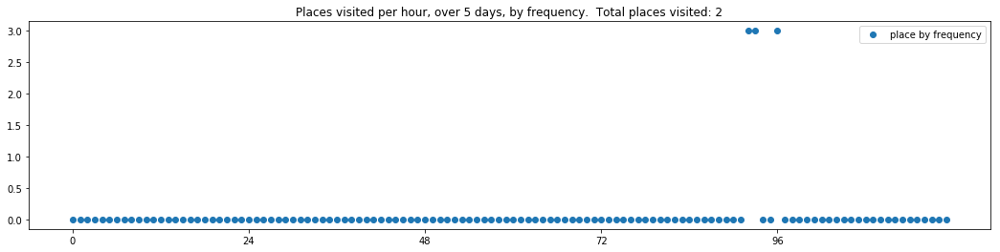

----- vector ----
prefix labels:  [598, 598]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 598, 0, 0, 0, 0, 0, 0, 598]
[598, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 598, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 168, 0, 463, 463, 0, 0, 0, 463, 344, 0, 0]


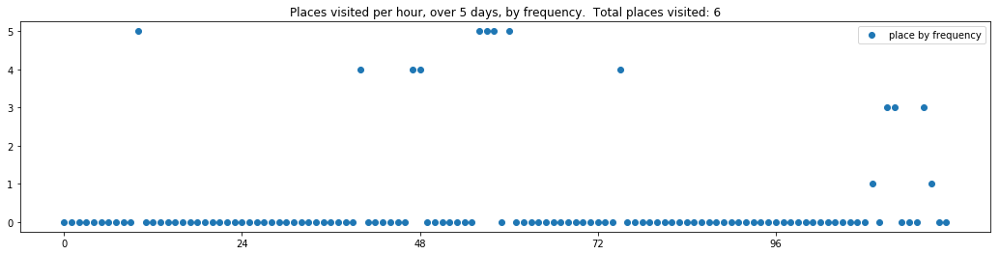

----- vector ----
prefix labels:  [174, 174]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 245, 0, 0, 239, 21, 119, 239, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


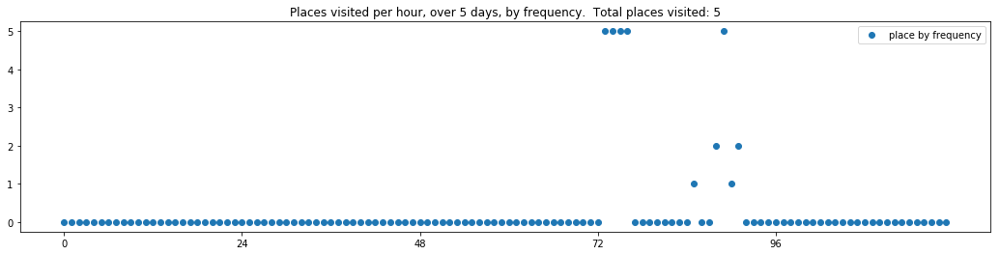

----- vector ----
prefix labels:  [390, 390]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]
[390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0, 0]
[0, 0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]


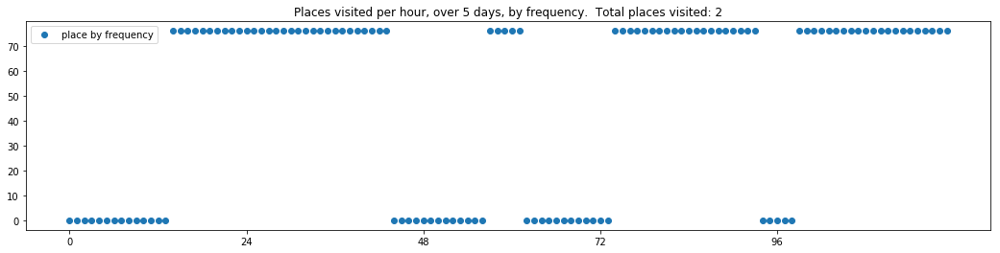

----- vector ----
prefix labels:  [24, 24]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 227, 0, 0, 0, 0, 125, 125, 125, 125, 125, 125, 125, 24, 24, 0, 0, 0, 0, 0, 0, 0]


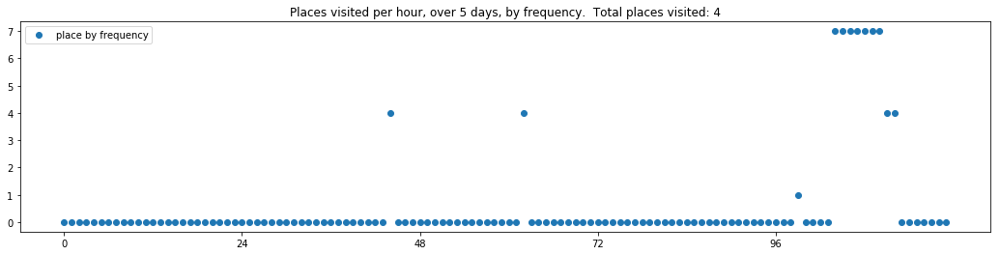

----- vector ----
prefix labels:  [151, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 0, 0]
[0, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 0, 0, 0, 0, 0, 0, 0]


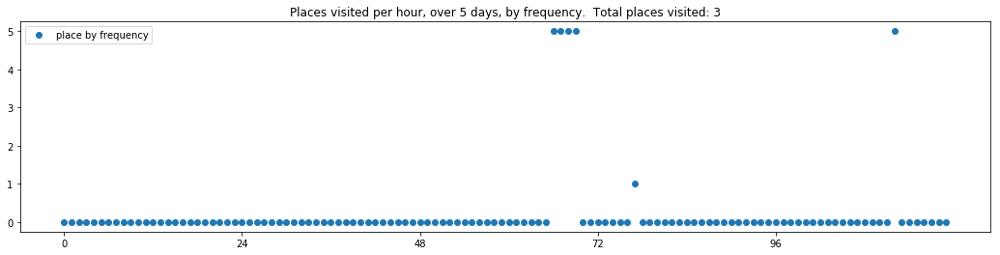

----- vector ----
prefix labels:  [577, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 400, 0, 0, 0, 0]
[0, 0, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 0, 0, 0, 0, 142, 142, 142, 0, 487, 487, 0]
[0, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 435, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0, 0]


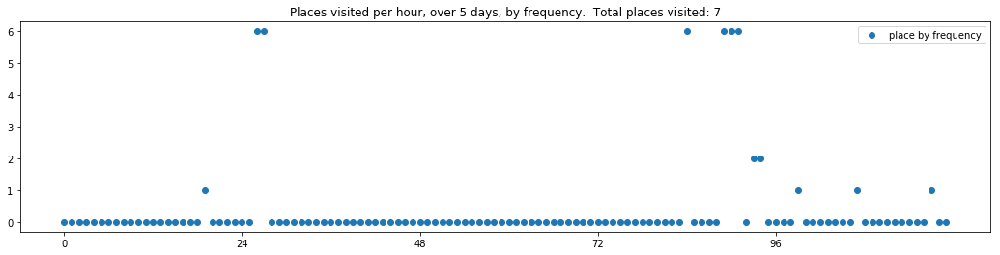

----- vector ----
prefix labels:  [147, 147]
[0, 0, 0, 0, 0, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 0, 0, 0, 0, 0, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]


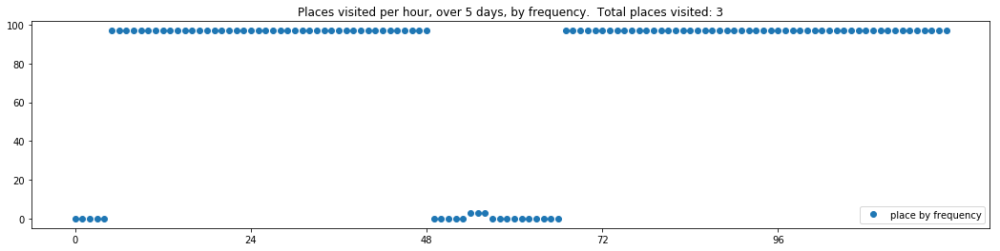

----- vector ----
prefix labels:  [458, 458]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 458, 458, 458, 458, 458]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 458, 458, 458, 458, 458, 458, 458, 458, 458, 475, 0, 0, 458, 458, 458, 458, 458, 458, 458, 458, 458]


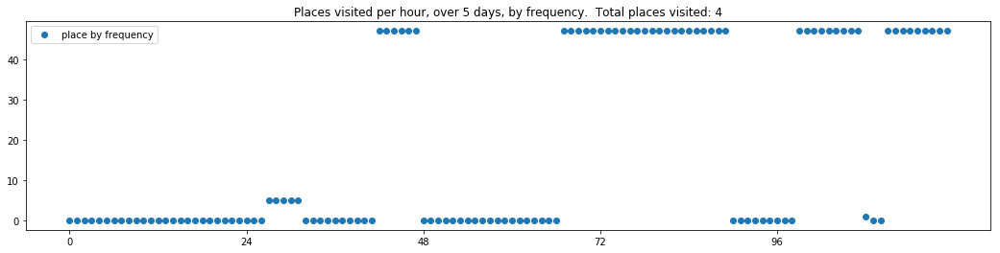

----- vector ----
prefix labels:  [356, 356]
[0, 0, 0, 0, 0, 143, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 0, 0, 0, 0, 0, 0, 0, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 33]
[401, 401, 41, 5, 5, 5, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]


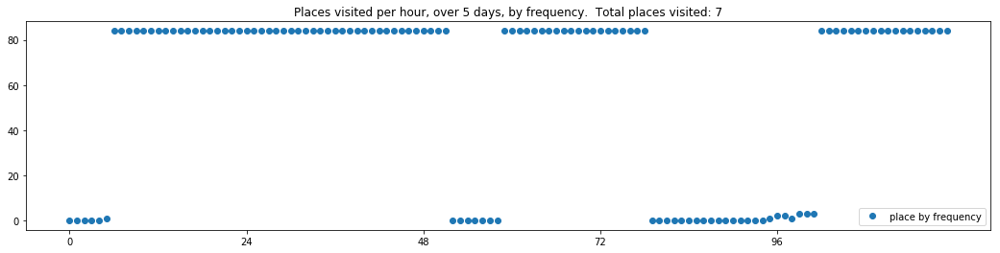

----- vector ----
prefix labels:  [214, 203]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 595, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]


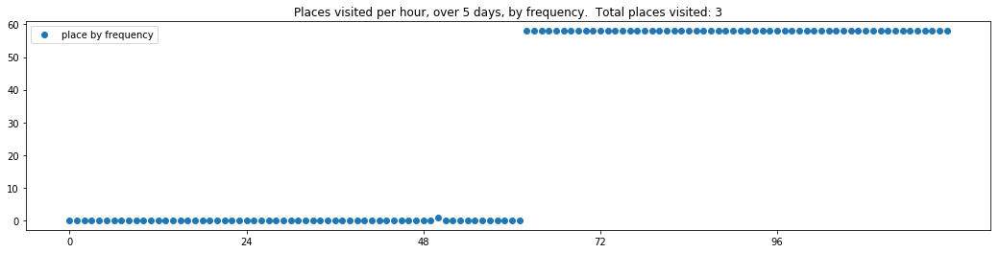

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 0, 0, 0, 0, 21, 22]
[22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 71, 71, 71, 271, 271, 271, 22, 22, 22, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


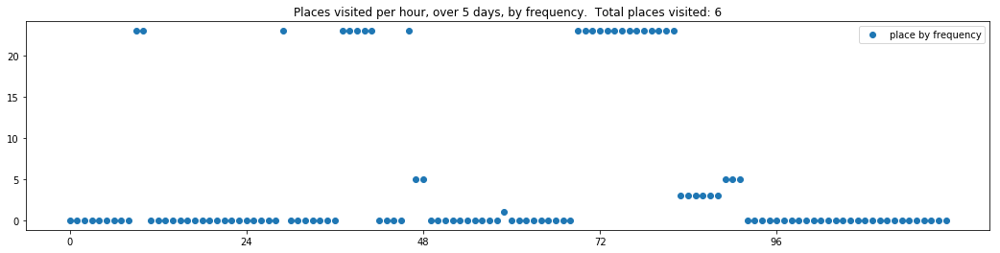

----- vector ----
prefix labels:  [286, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 286, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 286, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[286, 0, 0, 0, 0, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 386, 386, 386, 0, 0, 0, 0, 0, 0, 539, 0, 0, 0, 4, 4, 0, 94, 94, 94, 0, 0, 194]


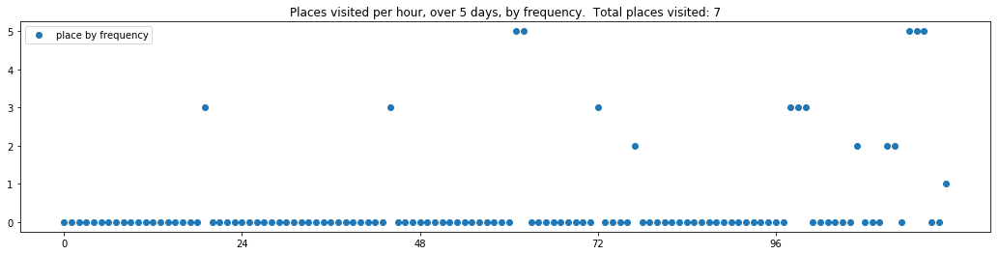

----- vector ----
prefix labels:  [117, 117]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 20, 117, 117, 117, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 239, 239, 239, 239, 239, 239, 239, 239]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 117, 117, 0, 0, 439, 439, 0, 0, 0, 117, 117, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 371, 371, 371, 371, 371, 293, 0, 0, 0, 0, 0, 0]


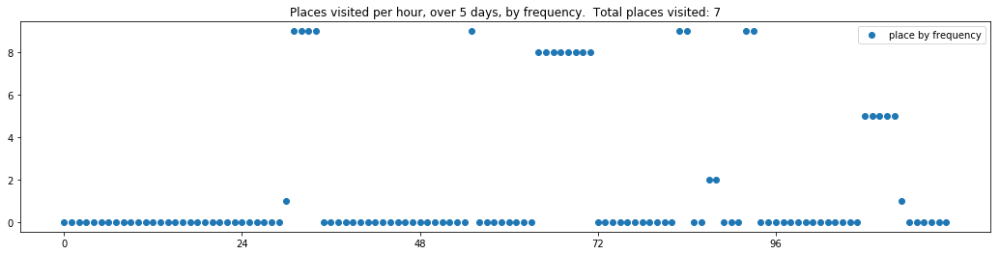

----- vector ----
prefix labels:  [242, 242]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]


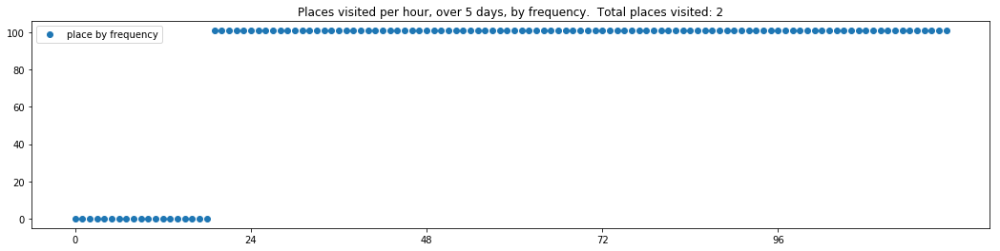

----- vector ----
prefix labels:  [634, 634]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 634, 634, 634, 0, 0, 0, 0, 0, 0, 634, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[634, 634, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 634, 0, 0, 634, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 634, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 634, 634, 0]


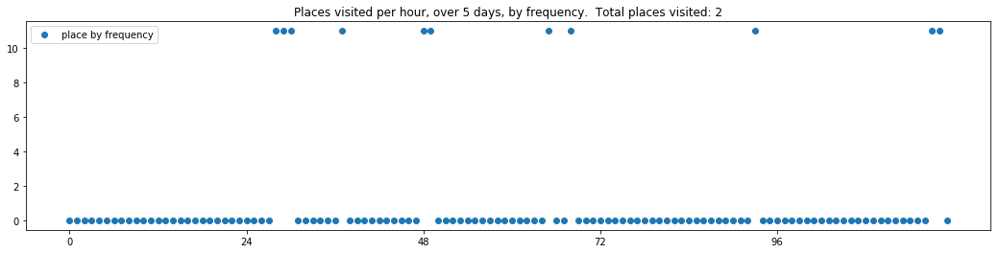

----- vector ----
prefix labels:  [35, 35]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


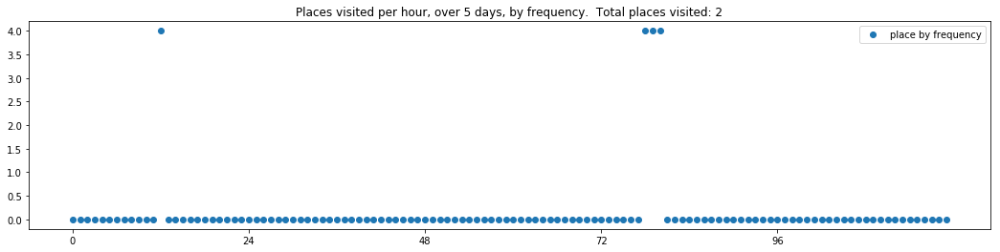

----- vector ----
prefix labels:  [95, 95]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 95, 95, 95, 95, 95, 95, 95, 95, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]


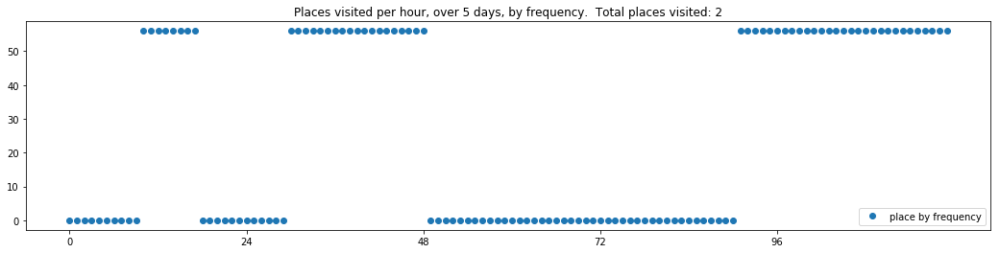

----- vector ----
prefix labels:  [432, 432]
[0, 0, 0, 0, 0, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[0, 0, 0, 0, 0, 0, 0, 322, 322, 322, 0, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 490, 0, 0, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 208, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]


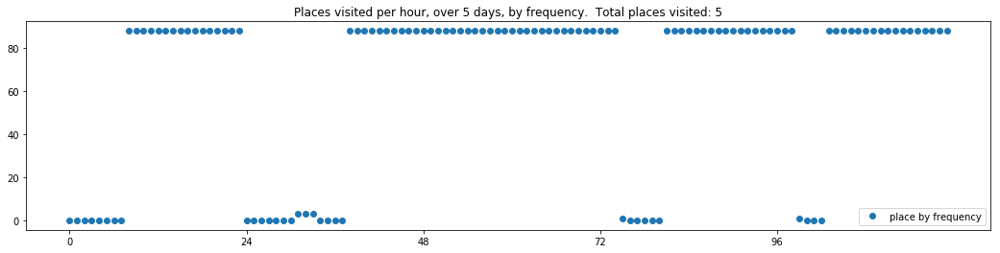

----- vector ----
prefix labels:  [43, 43]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 43, 43, 43]
[43, 43, 43, 43, 43, 43, 0, 0, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]


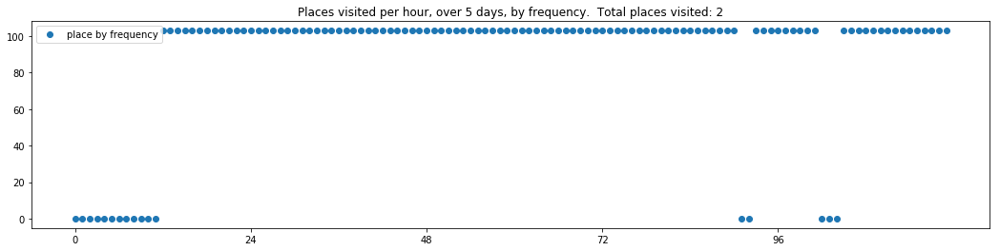

----- vector ----
prefix labels:  [395, 395]
[0, 0, 0, 0, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 395, 395, 0, 0, 0, 0, 0, 0, 395, 395, 395, 395, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 395, 395, 395, 395, 395, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395]
[395, 395, 395, 395, 0, 0, 395, 395, 395, 395, 395, 395, 0, 0, 0, 0, 0, 395, 0, 0, 0, 0, 0, 0]


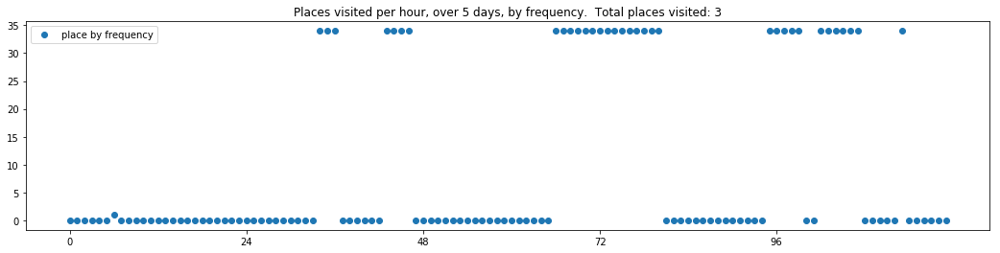

----- vector ----
prefix labels:  [413, 0]
[0, 0, 0, 0, 0, 0, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 544, 544, 544, 0, 413]
[413, 0, 0, 0, 413, 0, 413, 0, 0, 413, 413, 0, 0, 0, 0, 0, 413, 413, 413, 0, 413, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0]


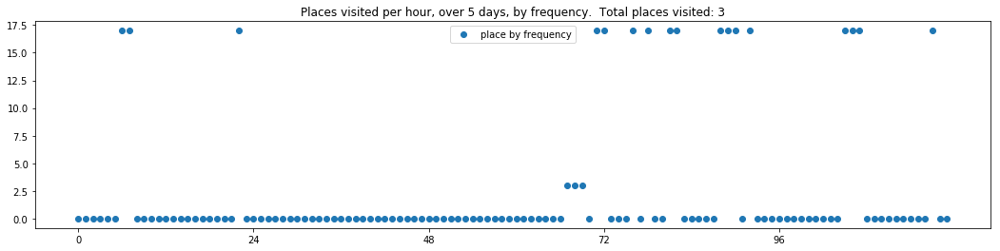

----- vector ----
prefix labels:  [449, 59]
[0, 0, 0, 0, 0, 0, 0, 22, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 162, 162]
[162, 162, 0, 22, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212]
[212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 0, 278, 278, 278, 278, 278, 278, 278, 0, 278, 278, 278, 278, 278, 576, 0, 0, 0, 0, 0, 0, 0]


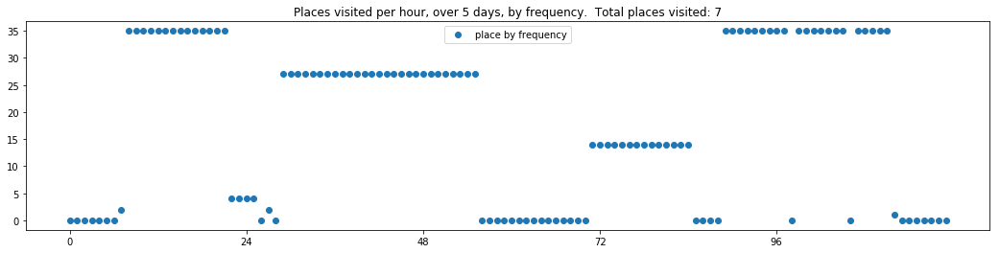

----- vector ----
prefix labels:  [512, 32]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 449, 449, 32, 32, 32, 32, 32, 0, 0, 21, 21, 21, 0, 0]
[0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 0, 0, 84, 84, 84, 0, 84, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32]


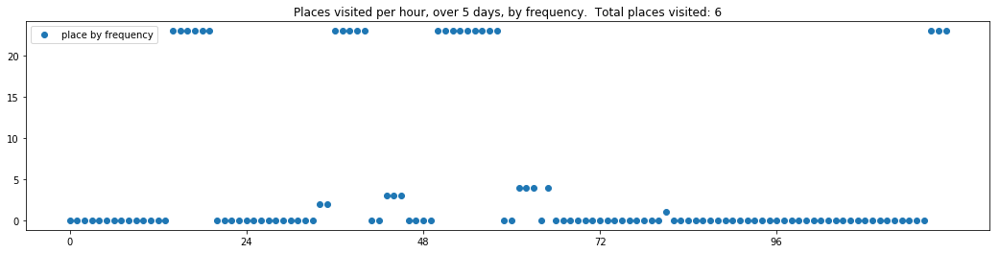


------
 60 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_60.txt 
------

----- vector ----
prefix labels:  [108, 108]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


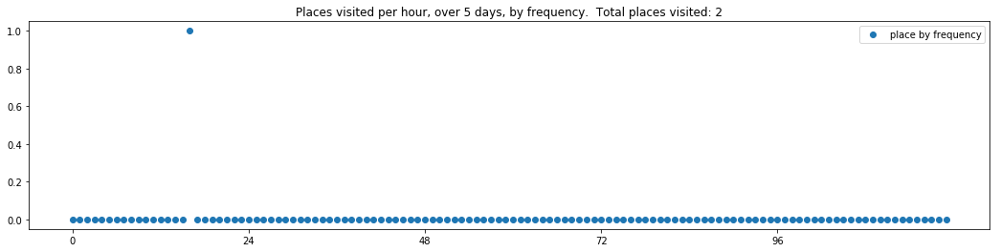

----- vector ----
prefix labels:  [312, 573]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 573]
[573, 573, 573, 0, 0, 0, 0, 0, 0, 194, 573, 573, 573, 0, 464, 269, 269, 0, 0, 0, 0, 168, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84, 0, 311, 311, 311, 311, 311, 311, 311]


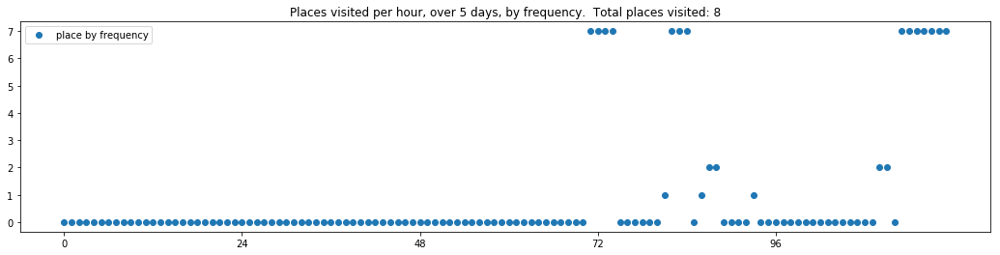

----- vector ----
prefix labels:  [526, 400]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 400, 0, 0, 0, 456, 526, 400, 400, 0, 254, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 209, 0, 0, 0, 0]
[0, 0, 0, 319, 319, 319, 319, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271]
[0, 0, 0, 0, 162, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 124, 124, 124, 124, 124, 124, 124, 124, 124, 124, 124, 124, 0, 0, 0, 0, 0]


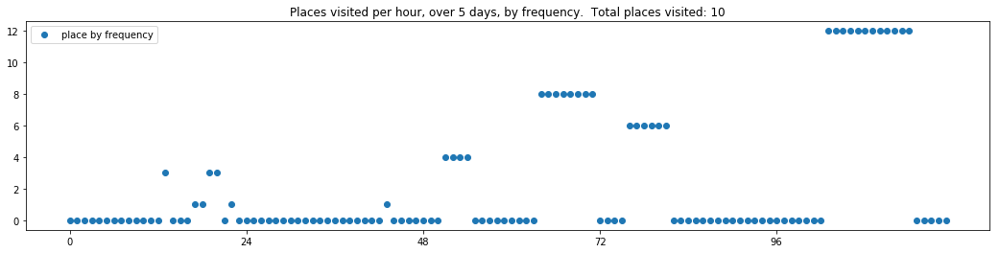

----- vector ----
prefix labels:  [23, 487]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 0, 0, 487, 567, 567, 0, 567]
[567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 0, 0, 23, 567, 567, 567, 487, 487]
[487, 487, 487, 487, 487, 0, 23, 487, 23, 487, 487, 487, 487, 487, 487, 0, 0, 0, 23, 567, 567, 567, 567, 567]
[567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567]
[567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 567, 23, 487, 487, 487]


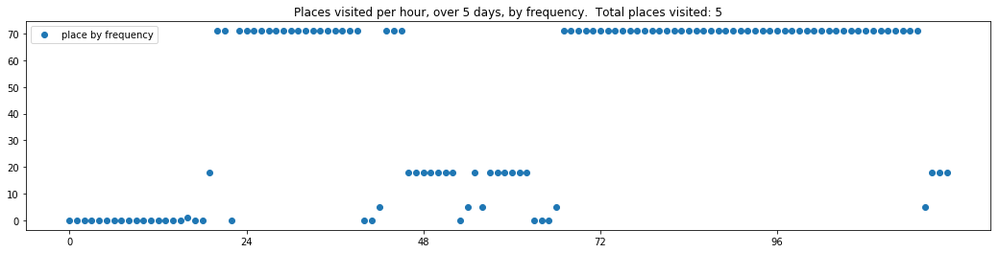

----- vector ----
prefix labels:  [2, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 335, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


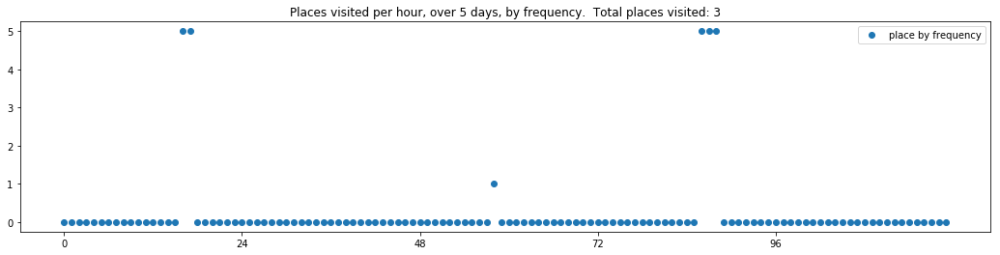

----- vector ----
prefix labels:  [439, 439]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0]
[0, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 439, 439, 439, 0, 0, 0, 439, 439, 439, 439]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


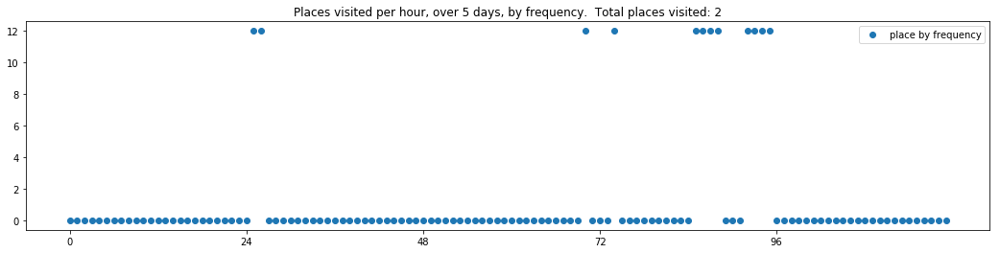

----- vector ----
prefix labels:  [162, 235]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


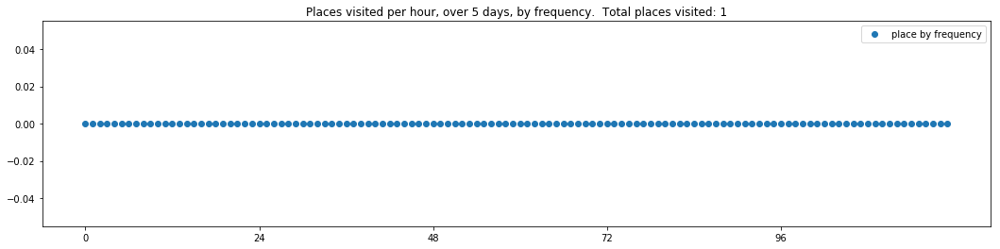

----- vector ----
prefix labels:  [102, 588]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 165, 390, 390, 390, 390, 0, 0, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 390]
[390, 390, 0, 390, 522, 522, 522, 522, 0, 611, 611, 0, 0, 390, 390, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0, 453, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]


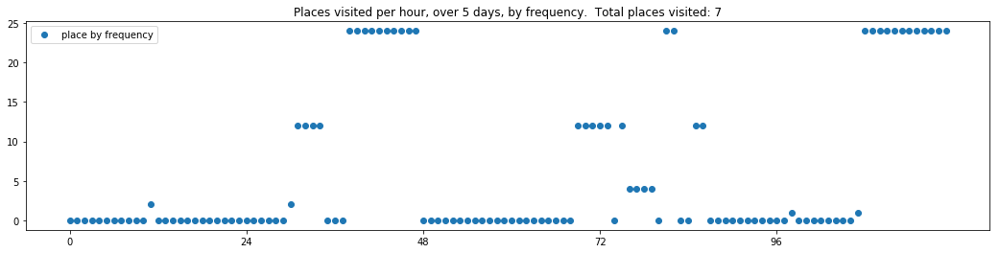

----- vector ----
prefix labels:  [588, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 588, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22]
[22, 22, 22, 0, 0, 98, 0, 0, 588, 588, 588, 588, 0, 0, 0, 0, 588, 588, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]


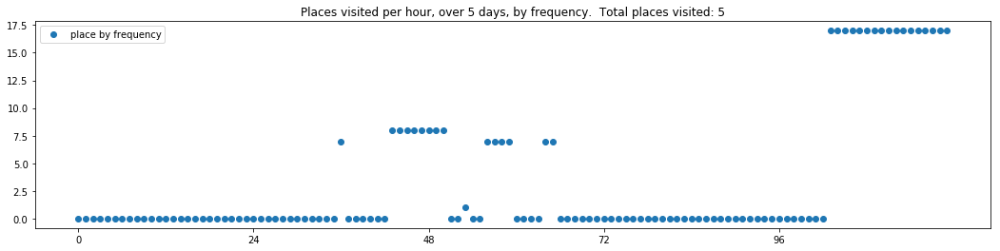

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[87, 87, 0, 87, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 146, 146, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 542, 0, 0, 0, 0]


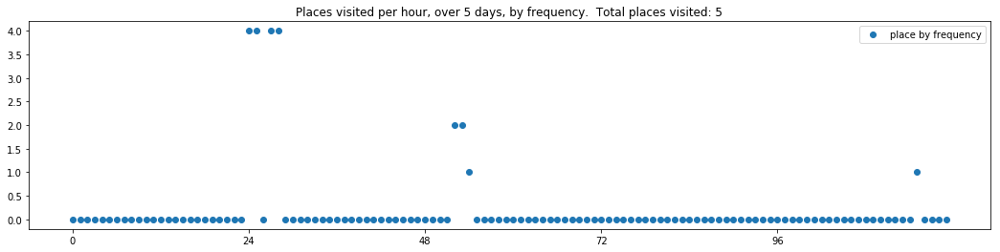

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 0, 0, 0, 0, 0, 0, 0, 0, 271, 0, 0, 271, 271, 271, 271, 271, 0, 0, 0, 0, 271, 271, 271]
[271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


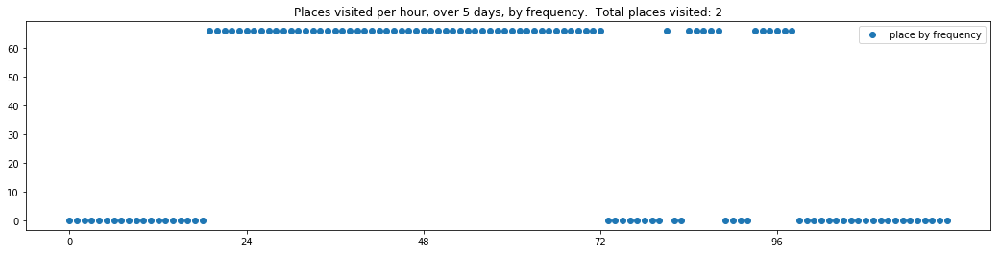

----- vector ----
prefix labels:  [88, 406]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


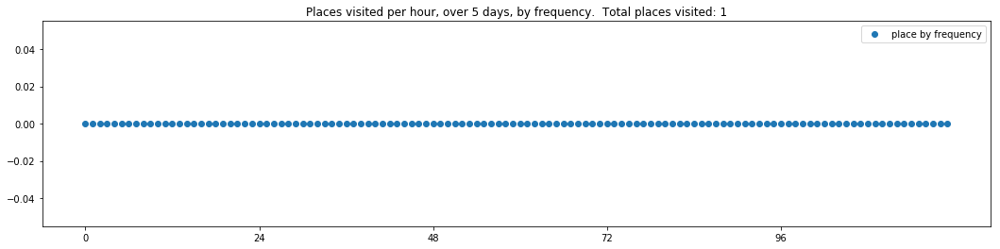

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]


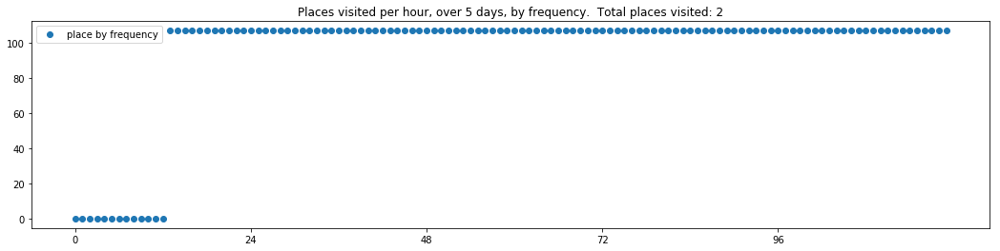

----- vector ----
prefix labels:  [1, 226]
[0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]


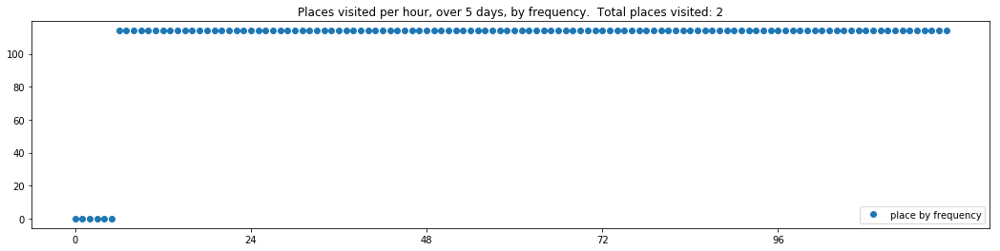

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 0, 0, 0, 0]
[0, 0, 416, 416, 416, 416, 416, 416, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


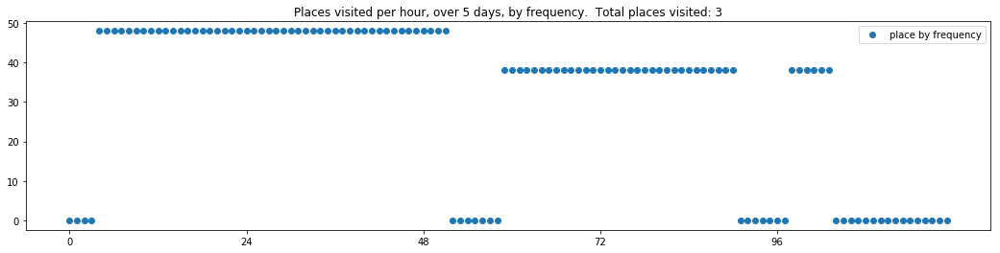

----- vector ----
prefix labels:  [48, 72]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 372, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72]
[72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72]
[72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72]


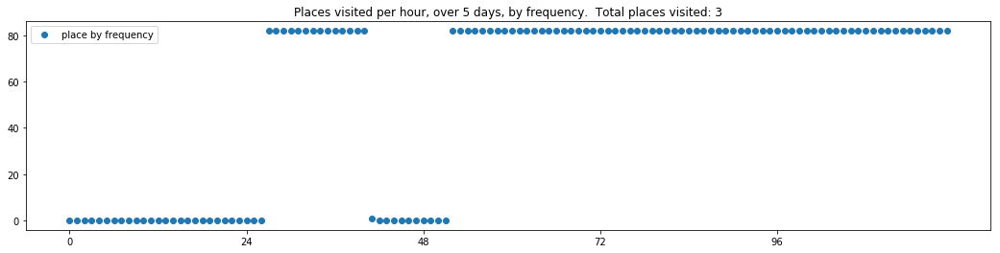

----- vector ----
prefix labels:  [379, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 186, 186, 0, 209, 127, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


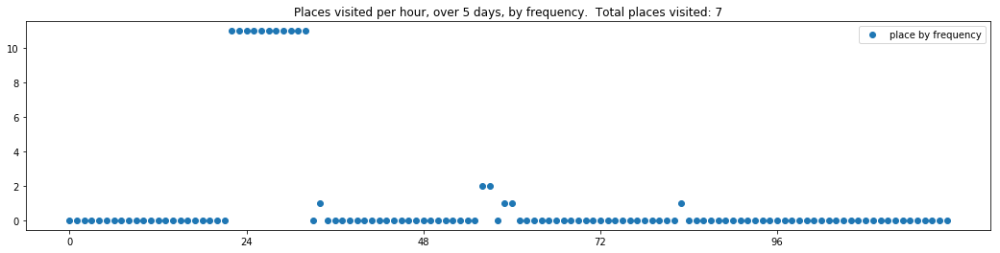

----- vector ----
prefix labels:  [197, 420]
[0, 0, 0, 0, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[270, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 268, 268, 268, 268, 268]


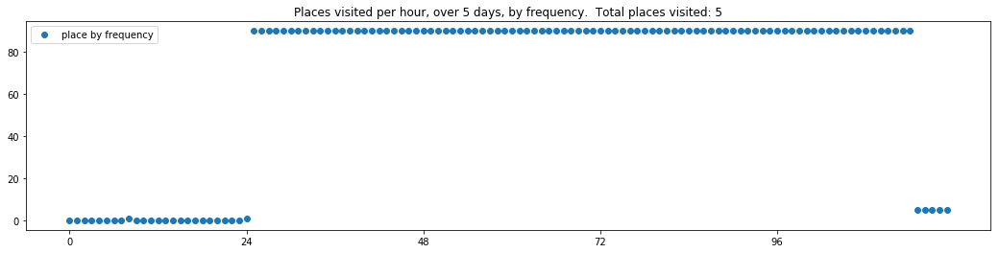

----- vector ----
prefix labels:  [491, 568]
[0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]


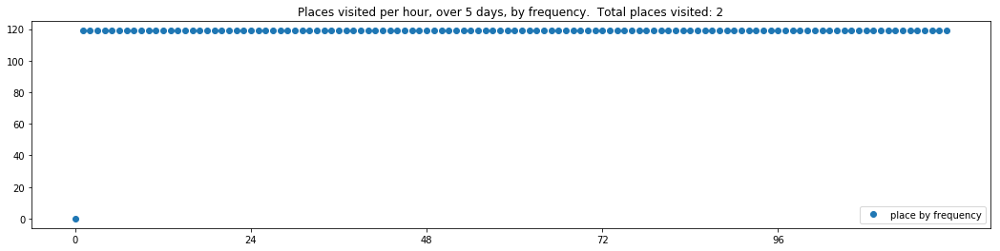

----- vector ----
prefix labels:  [20, 1]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 0, 20, 7, 0, 0, 0, 0, 0]
[7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 183, 183, 183]


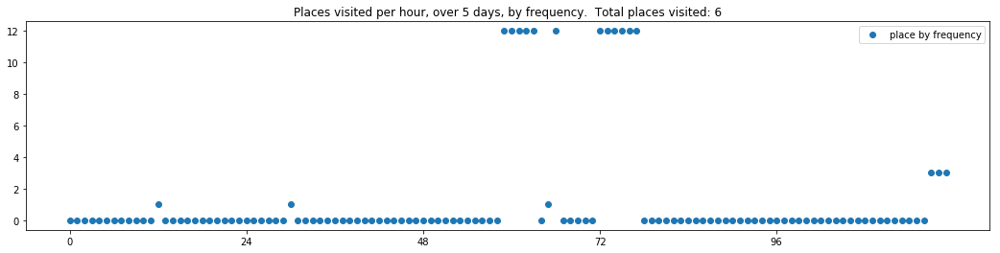

----- vector ----
prefix labels:  [409, 409]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


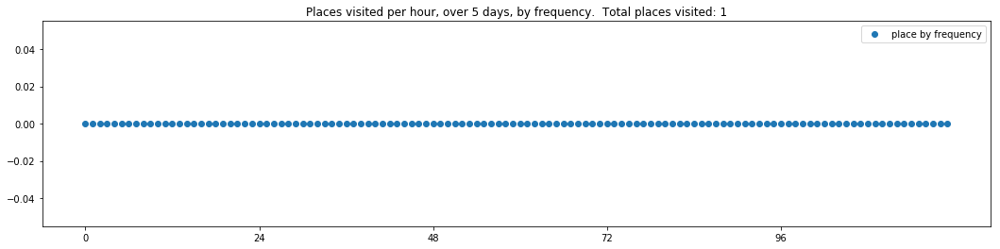

----- vector ----
prefix labels:  [395, 395]
[0, 0, 146, 395, 395, 395, 395, 395, 395, 395, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 395, 395]
[395, 395, 395, 395, 395, 416, 416, 416, 416, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 250, 250, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 395]


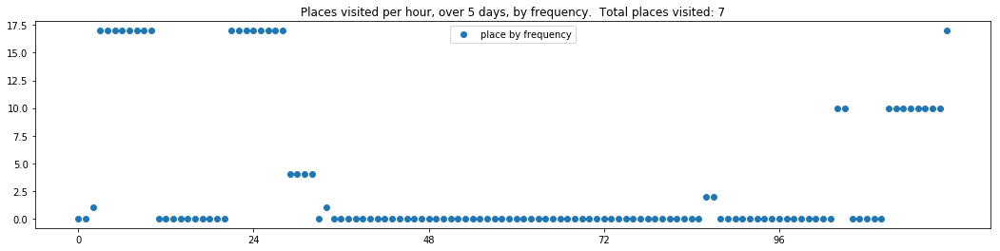

----- vector ----
prefix labels:  [130, 352]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 352, 352, 352, 352, 352, 352, 352, 352, 130, 130, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 130, 130, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]


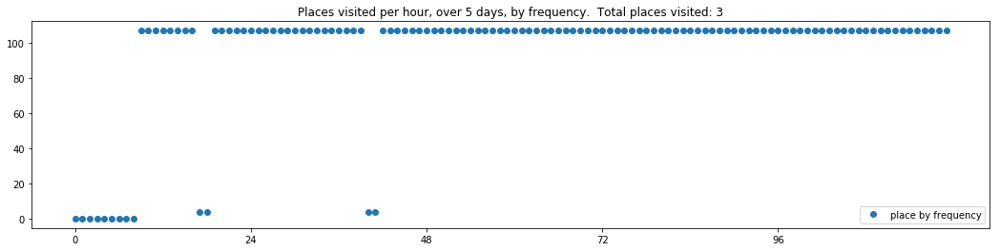

----- vector ----
prefix labels:  [528, 286]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[508, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 0, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]


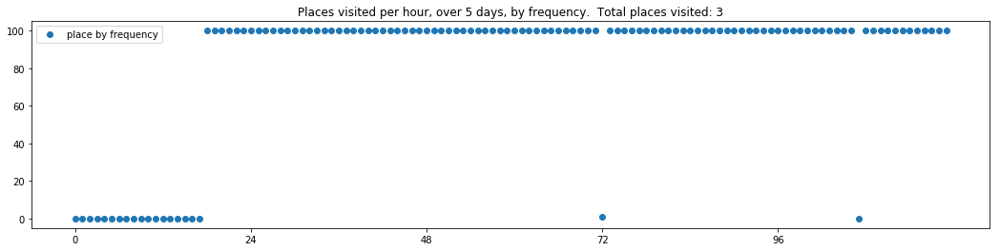

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 0, 0, 0, 39]
[39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


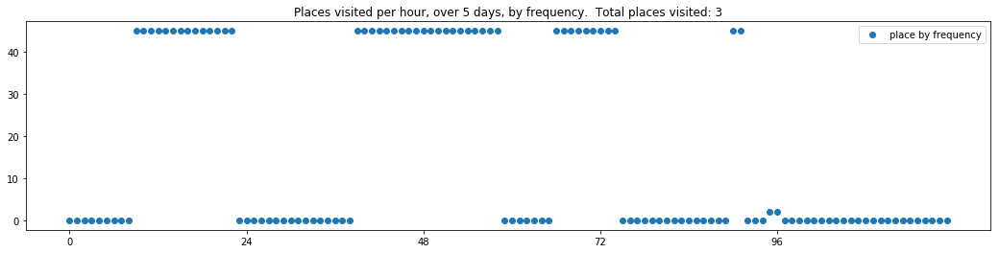

----- vector ----
prefix labels:  [417, 417]
[0, 0, 0, 0, 417, 417, 417, 0, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417]
[417, 417, 417, 417, 417, 417, 417, 417, 417, 0, 0, 0, 0, 0, 0, 0, 0, 0, 417, 417, 417, 417, 417, 417]
[417, 417, 0, 0, 0, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 0, 0, 417, 417, 417, 417]
[417, 417, 417, 417, 417, 417, 417, 0, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417]
[417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417, 417]


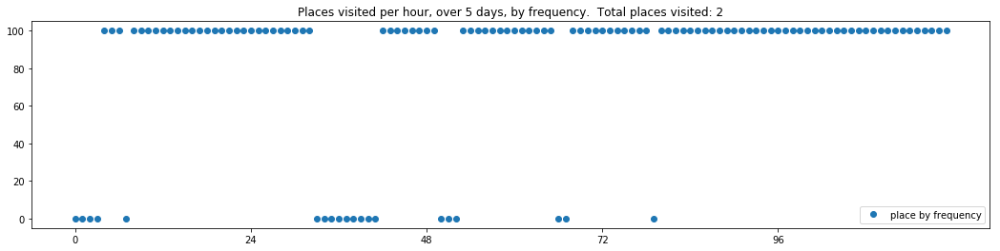

----- vector ----
prefix labels:  [190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 0, 0, 0, 0, 0, 0, 0, 0, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]


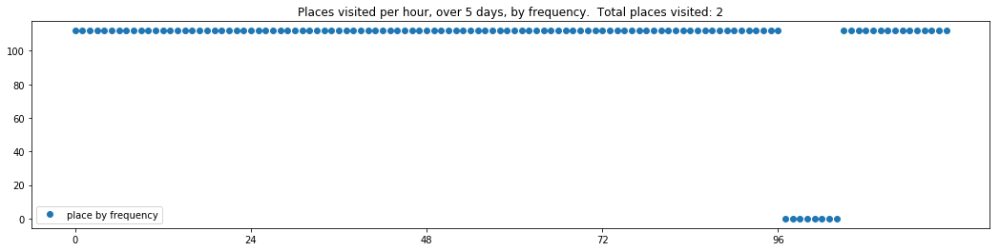

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 304, 304, 304]
[304, 304, 0, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 490, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 413, 413, 413, 413, 413, 0, 0, 0, 0, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 413, 413, 413, 413]


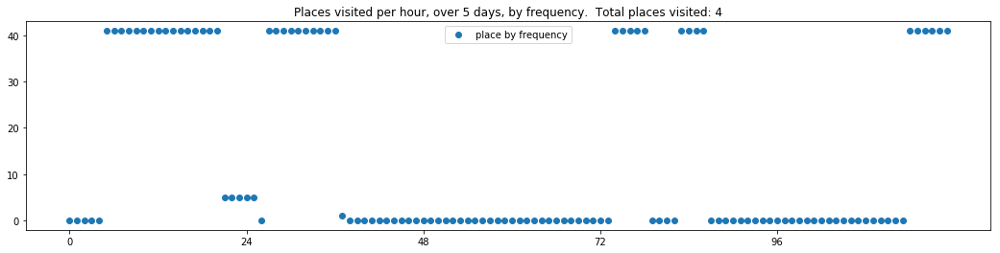

----- vector ----
prefix labels:  [308, 308]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 308, 308, 308, 0, 0, 0, 0, 308, 308, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 0, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 0, 0, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]


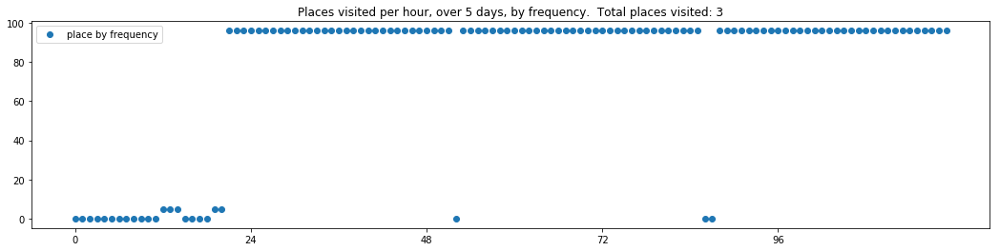

----- vector ----
prefix labels:  [582, 341]
[0, 0, 0, 0, 0, 0, 582, 87, 87, 87, 539, 539, 0, 94, 94, 94, 200, 0, 415, 276, 276, 276, 276, 276]
[276, 147, 147, 147, 147, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 341, 341, 539, 0, 0, 0]
[0, 0, 0, 0, 0, 582, 582, 582, 582, 582, 582, 582, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328]
[328, 328, 0, 582, 582, 582, 582, 582, 582, 582, 582, 582, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]


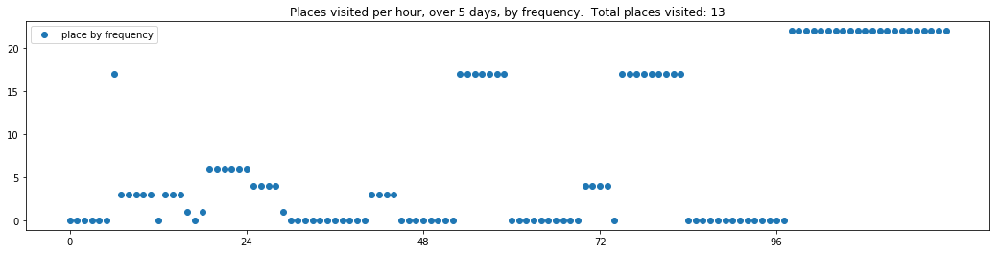

----- vector ----
prefix labels:  [588, 339]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 275, 151, 0, 0, 0, 0, 0, 0, 588, 588, 588, 588, 588, 588, 206, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 68, 68, 68, 285, 285, 588, 588, 11, 588, 112, 68, 68, 68, 68, 68, 588, 68, 68]
[68, 588, 588, 588, 588, 588, 202, 588, 588, 588, 414, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]


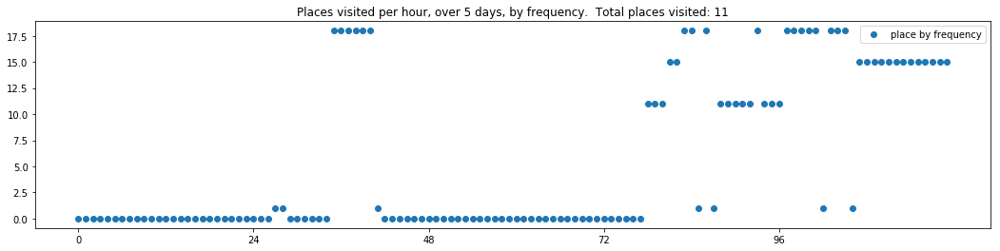

----- vector ----
prefix labels:  [87, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 77, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


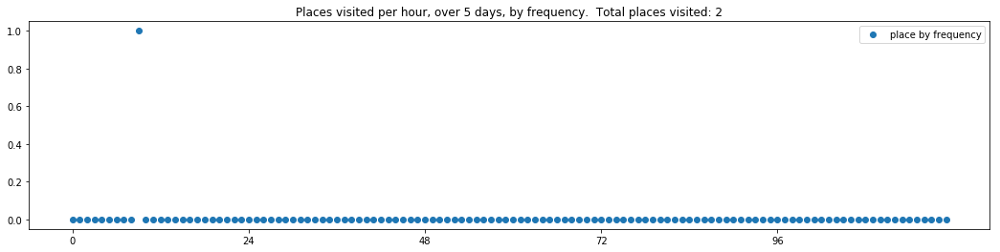

----- vector ----
prefix labels:  [232, 0]
[0, 0, 263, 282, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 208, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 334, 334, 0, 0, 0, 0, 0, 0]


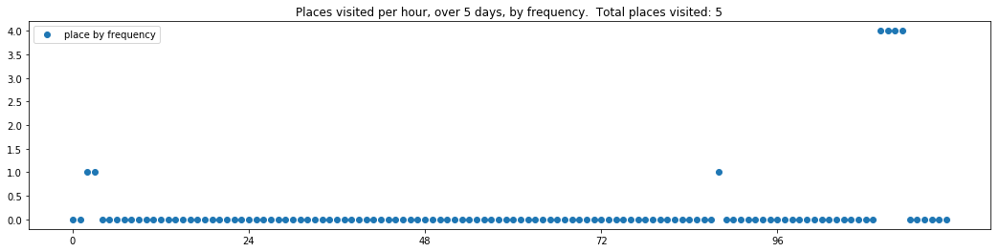

----- vector ----
prefix labels:  [141, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 115, 0, 0, 0, 142, 0, 0, 0, 0, 0]
[142, 142, 142, 142, 0, 142, 142, 0, 0, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142, 142]
[142, 142, 142, 142, 142, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 142, 142, 142, 142, 142, 142, 0]


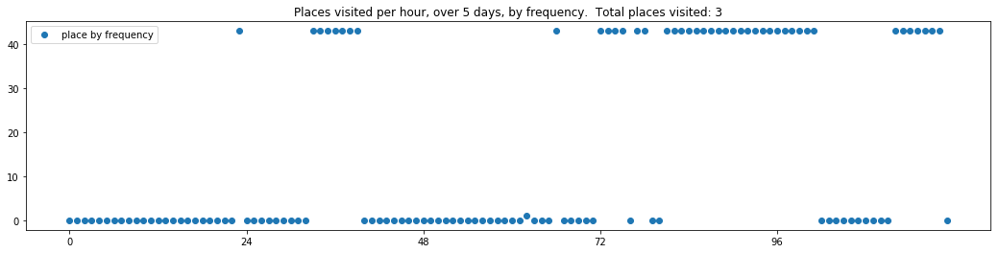

----- vector ----
prefix labels:  [79, 79]
[0, 0, 0, 0, 0, 0, 0, 255, 255, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 506, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 363, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


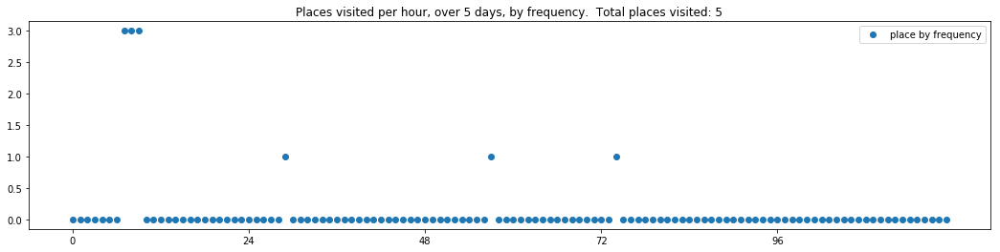

----- vector ----
prefix labels:  [308, 479]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 392, 0, 0, 0, 146, 0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 0, 185, 390]
[390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0]
[0, 0, 0, 0, 0, 0, 195, 195, 195, 195, 195, 195, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 308]
[308, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0, 0, 0, 0, 0, 0, 0, 0, 77, 0, 0, 0, 390]


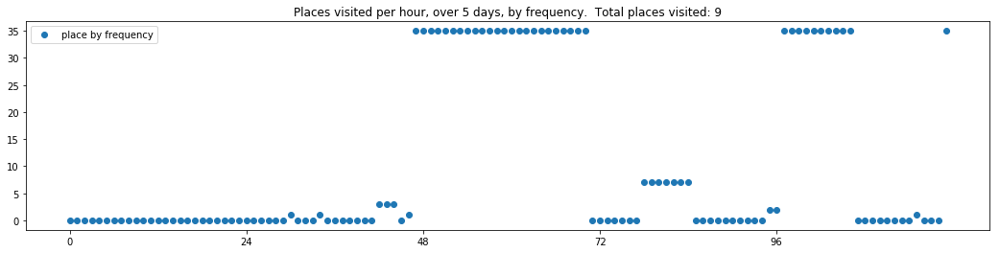

----- vector ----
prefix labels:  [22, 101]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 104, 40, 101, 101, 101, 101, 0, 0, 0]
[0, 0, 0, 289, 0, 0, 0, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 0, 104, 40, 41, 41, 41, 41, 41, 50, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 0, 0, 482]
[482, 482, 482, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 289, 289, 289, 289, 289, 289, 289, 289, 289]


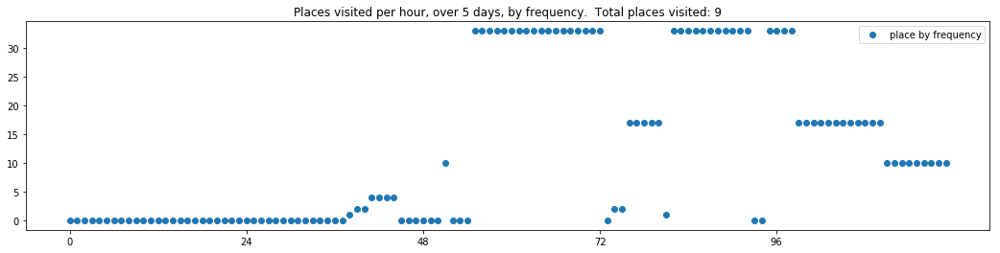

----- vector ----
prefix labels:  [88, 628]
[0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 97, 97, 97, 97, 349, 349, 349, 349, 349, 88, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 545]
[545, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


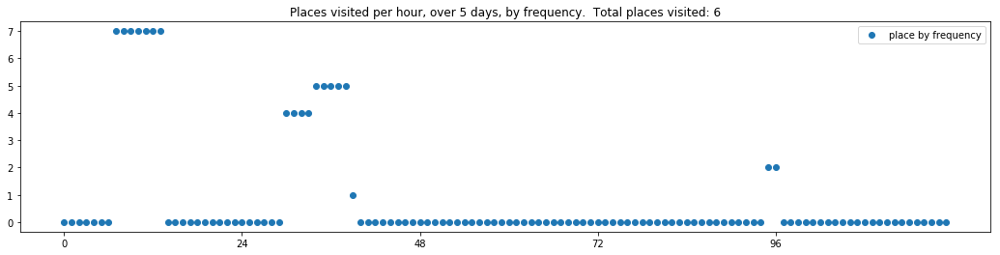

----- vector ----
prefix labels:  [216, 216]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 216, 216, 0, 0, 0, 0, 0, 0, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]
[216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 216, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 312, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


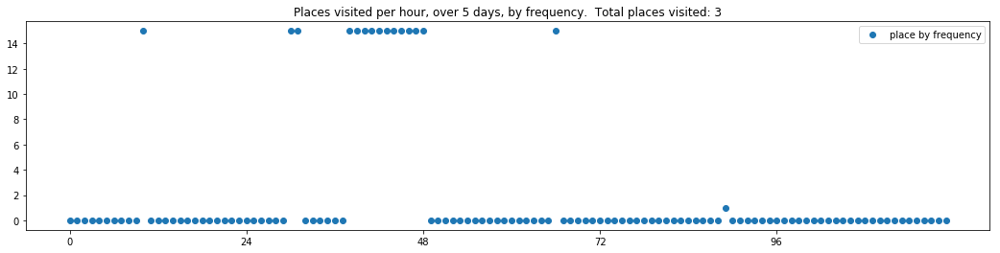

----- vector ----
prefix labels:  [539, 39]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 539, 0, 0, 539, 539, 147, 147, 147, 0, 0, 48, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


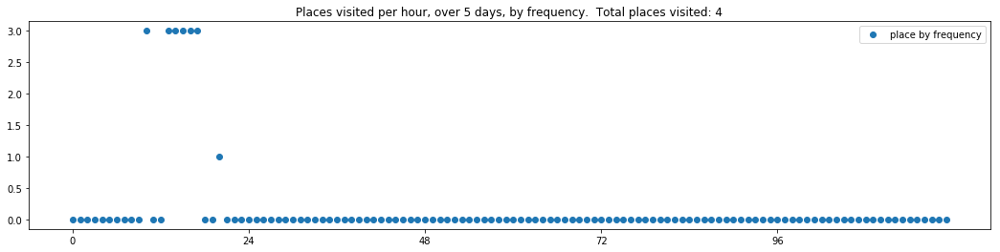

----- vector ----
prefix labels:  [140, 140]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 84, 84, 84, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 0, 0, 0, 0, 0]


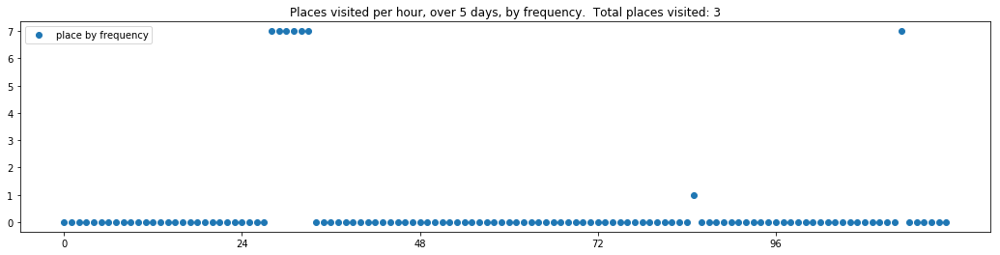

----- vector ----
prefix labels:  [0, 212]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 293, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212]


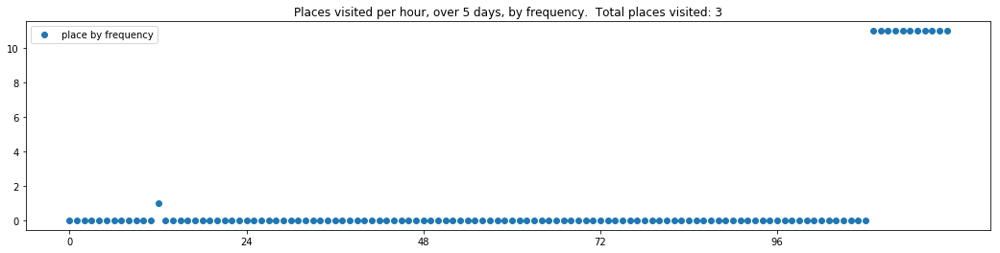

----- vector ----
prefix labels:  [48, 48]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 48]
[48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 48, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


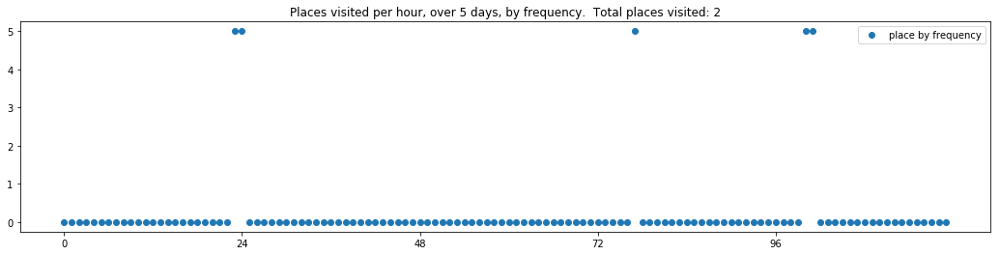

----- vector ----
prefix labels:  [455, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 645, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


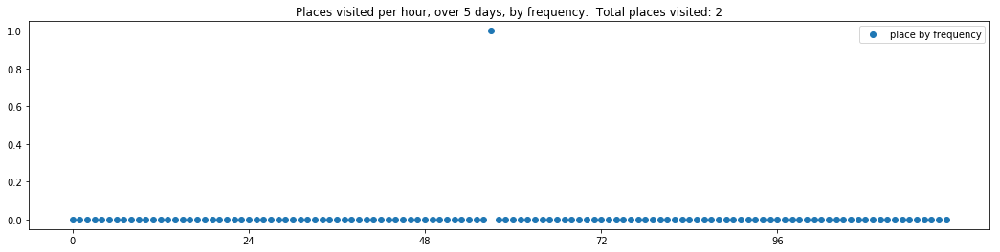

----- vector ----
prefix labels:  [297, 297]
[0, 0, 0, 0, 297, 297, 297, 297, 0, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297, 297]
[297, 297, 297, 297, 0, 0, 0, 0, 178, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 297, 297, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 297, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 187, 177, 177, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]


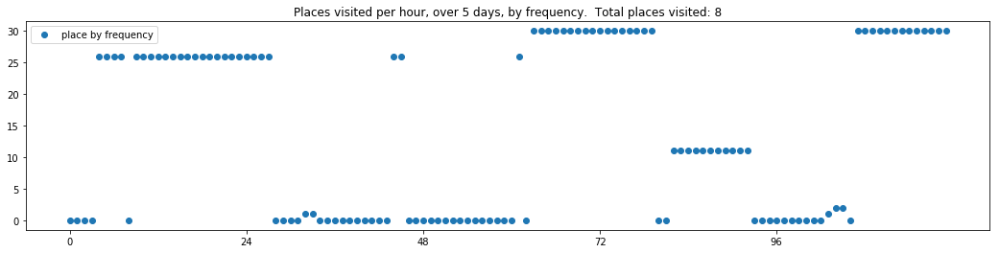

----- vector ----
prefix labels:  [246, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 247, 247]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[246, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 0, 246, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246]


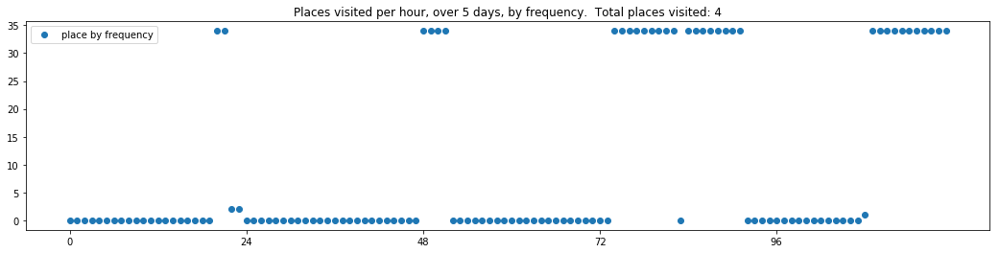

----- vector ----
prefix labels:  [310, 164]
[164, 304, 0, 0, 0, 0, 0, 0, 0, 0, 548, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


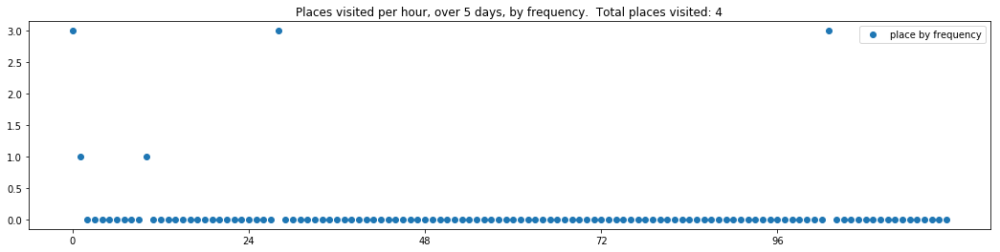

----- vector ----
prefix labels:  [116, 116]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 21, 0, 221, 221, 221, 221, 221, 221, 221, 457, 457, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 116, 116, 221, 221, 221, 221, 221, 221, 637, 637, 577, 518, 518, 518, 518, 518, 23, 0, 0, 0, 518, 518, 518]
[518, 518, 518, 518, 518, 518, 518, 518, 518, 518, 518, 0, 0, 0, 0, 0, 0, 518, 518, 518, 518, 518, 518, 518]
[71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 116, 116, 116, 0, 475, 475, 475, 475, 475, 475, 475]


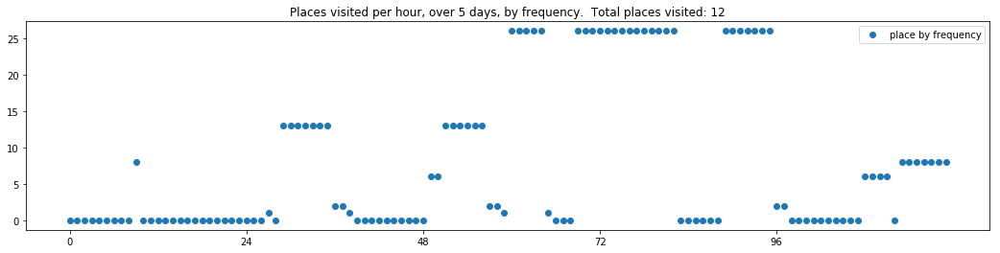

----- vector ----
prefix labels:  [149, 149]
[0, 0, 0, 361, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 84, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


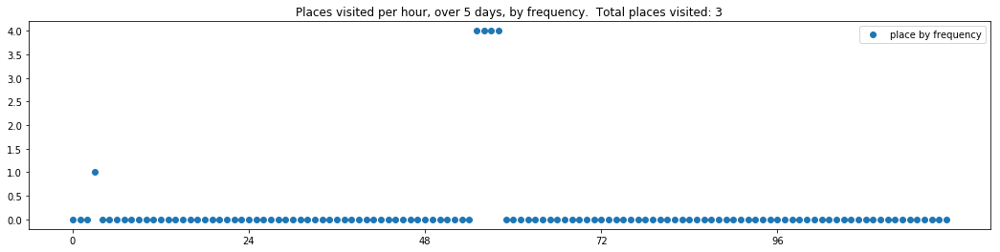

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


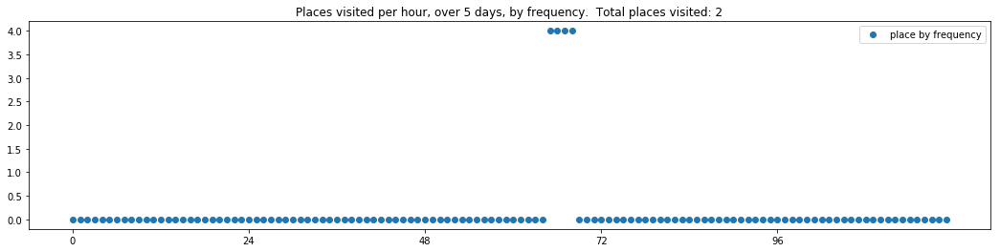


------
 65 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_65.txt 
------

----- vector ----
prefix labels:  [31, 31]
[0, 0, 0, 0, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 0, 0, 447, 0, 0, 0, 0, 0, 0, 0, 0, 31, 31, 31, 31, 31, 0, 0]
[0, 0, 0, 0, 0, 0, 516, 204, 204, 204, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[0, 0, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 31, 31, 31, 31, 31, 31, 31, 31, 31]


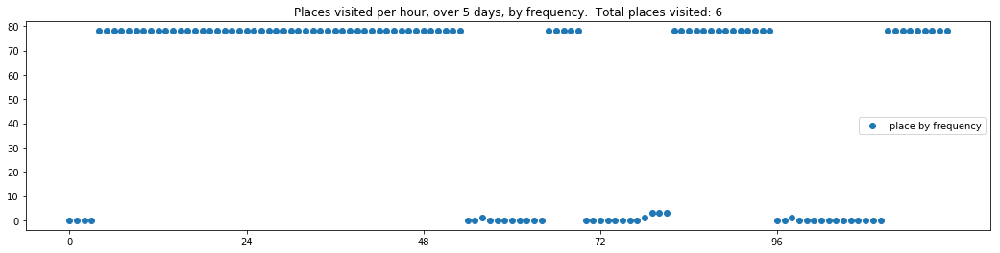

----- vector ----
prefix labels:  [386, 386]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 386, 386, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 386, 386, 386, 386, 76, 76, 386, 386, 386, 386, 386, 386, 386, 386, 386, 386]
[386, 386, 386, 0, 0, 0, 0, 478, 451, 0, 0, 0, 0, 0, 0, 478, 478, 478, 0, 478, 478, 478, 478, 478]
[478, 0, 0, 0, 340, 0, 0, 0, 0, 0, 0, 0, 0, 0, 451, 171, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 0, 0, 21, 21, 0, 231, 0, 478, 478, 478, 478]


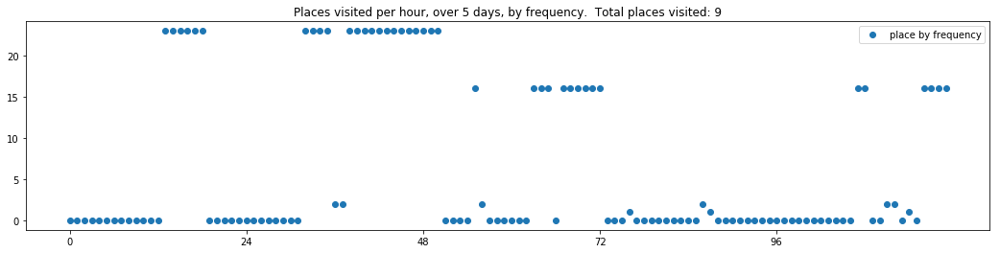

----- vector ----
prefix labels:  [314, 314]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 0, 165, 314, 314, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 314, 0, 0, 0, 0, 0, 314, 314, 0, 0, 0, 0, 0, 0, 0, 0, 0]


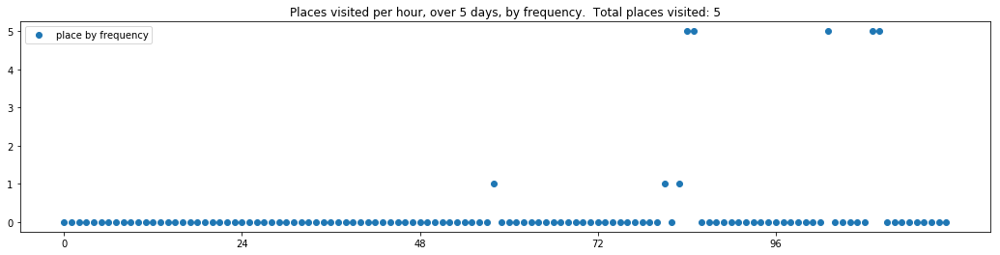

----- vector ----
prefix labels:  [260, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 260, 260, 260, 260, 260]
[260, 260, 260, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 260, 260]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 260, 260, 260, 260, 260, 260, 260]


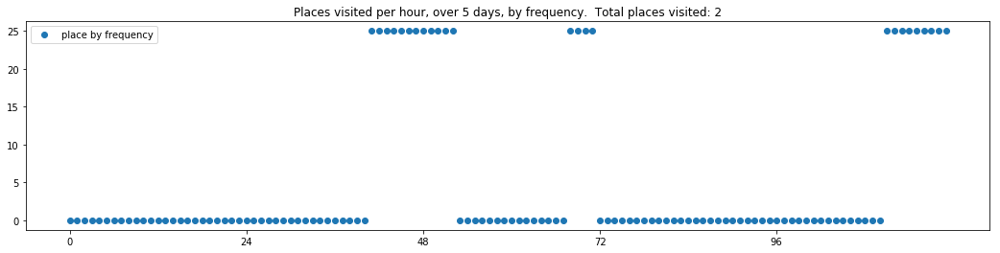

----- vector ----
prefix labels:  [314, 304]
[0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 311]
[311, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 304, 304, 304, 304, 304]


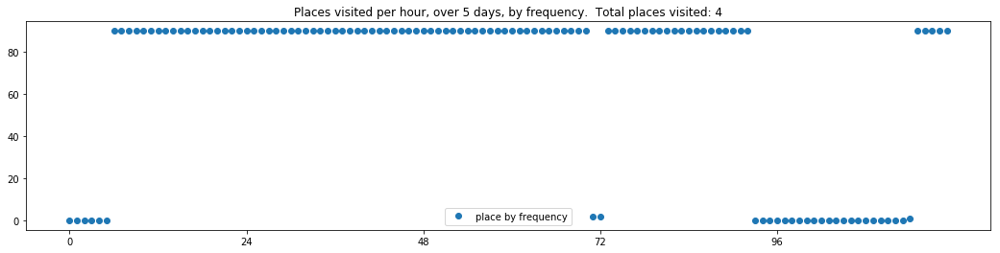

----- vector ----
prefix labels:  [282, 145]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 282, 282, 282, 282, 282, 282, 282]
[282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 282, 267, 56, 56, 56, 282, 282, 282, 282]
[282, 282, 282, 282, 162, 435, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 282, 282, 282, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 486, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


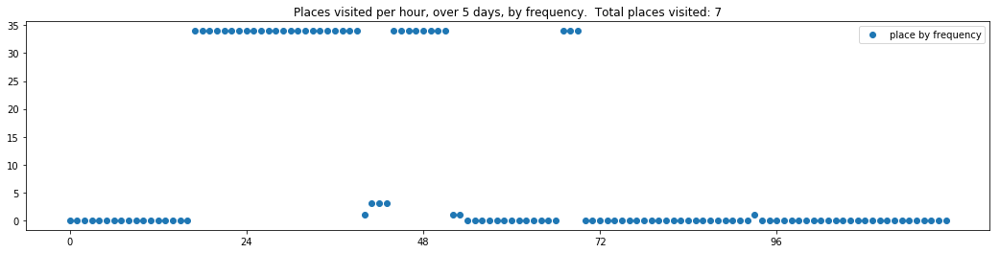

----- vector ----
prefix labels:  [611, 611]
[0, 0, 0, 0, 0, 0, 0, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 0]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]


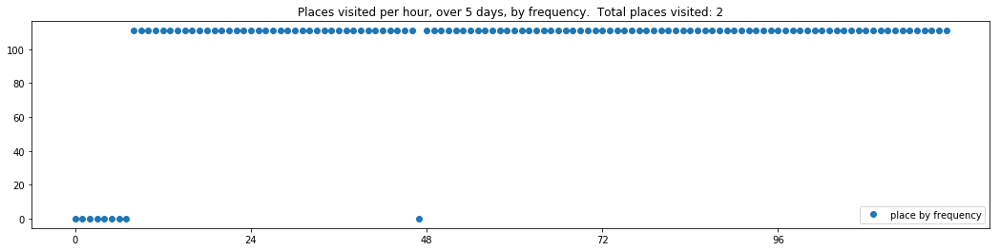

----- vector ----
prefix labels:  [34, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 0, 0, 0, 0, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 151]
[151, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 34, 34, 34, 34, 34, 34, 34, 34, 34]


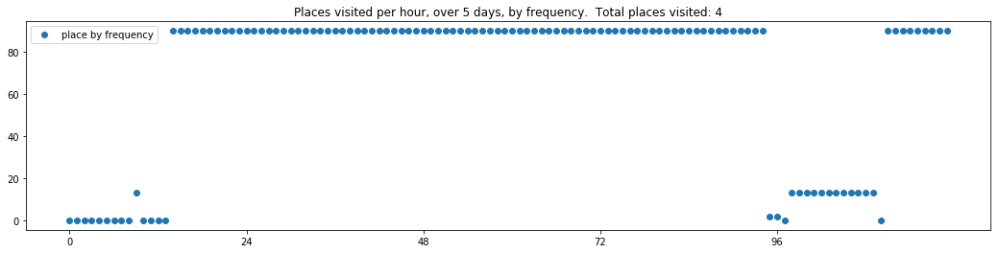

----- vector ----
prefix labels:  [83, 2]
[0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 239, 0, 239, 239, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 239, 239, 226, 357, 357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 239, 239, 239, 0, 0, 0, 0, 0, 0, 0]


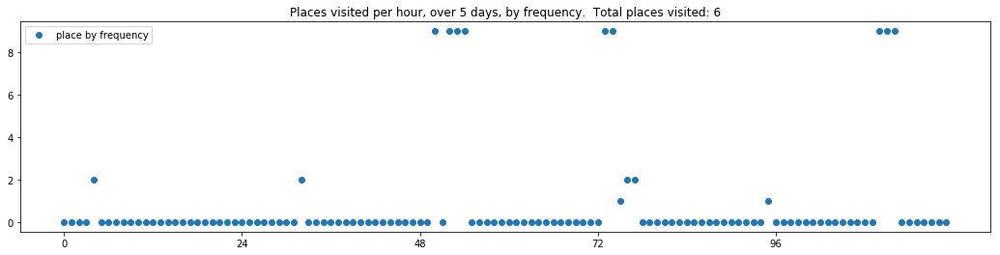

----- vector ----
prefix labels:  [384, 384]
[0, 0, 0, 0, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384]
[384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384]
[384, 384, 384, 384, 384, 384, 384, 384, 384, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 384, 384]
[384, 384, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


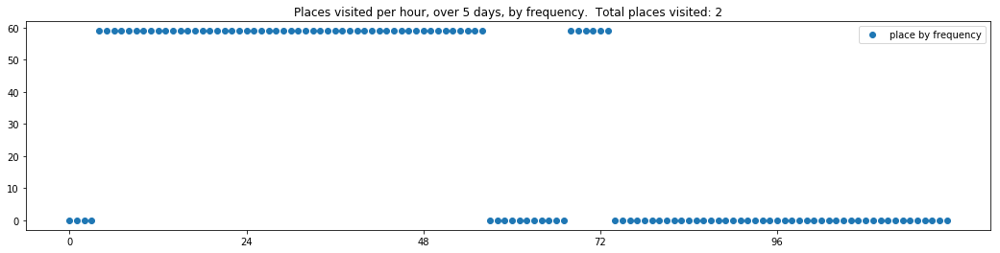

----- vector ----
prefix labels:  [84, 84]
[0, 0, 0, 0, 0, 0, 0, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


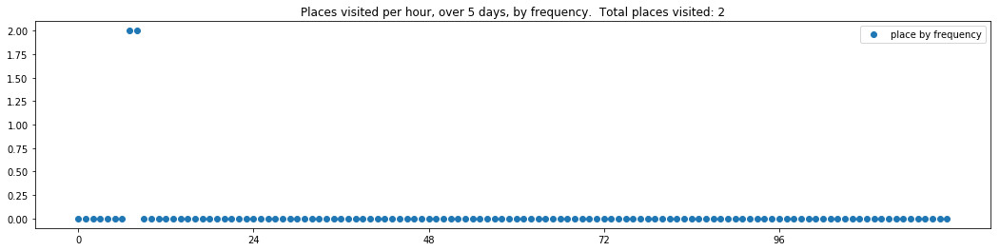

----- vector ----
prefix labels:  [506, 506]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 151, 151, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506]
[506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506]
[506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 0, 0, 0, 0, 0, 0, 0, 0, 0, 506]


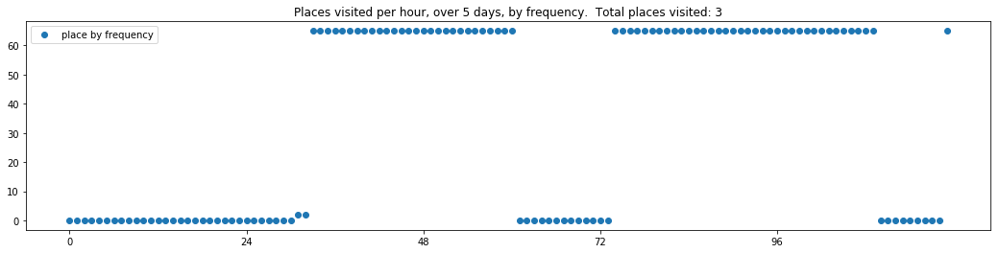

----- vector ----
prefix labels:  [120, 120]
[0, 0, 0, 0, 0, 0, 0, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 120, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 120, 120, 120, 120, 120, 0, 0, 0]


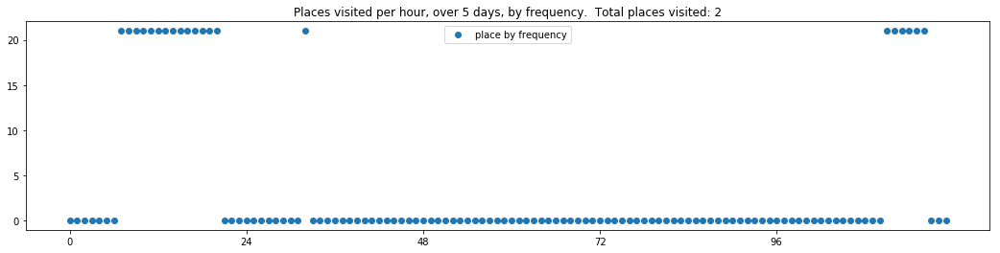

----- vector ----
prefix labels:  [506, 506]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 420, 506, 506, 506, 506, 506, 506, 506, 0]
[0, 0, 0, 0, 0, 0, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506]
[506, 506, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 73, 0, 0, 0, 0, 0, 0]


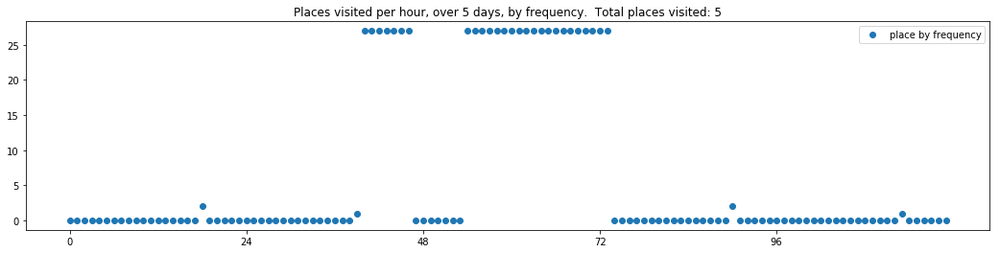

----- vector ----
prefix labels:  [21, 358]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 346, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 557, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


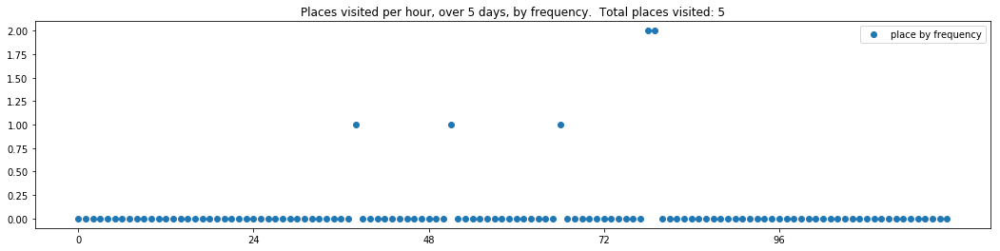

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434]


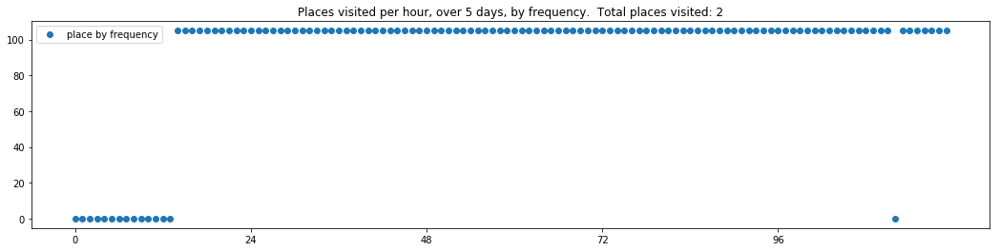

----- vector ----
prefix labels:  [158, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


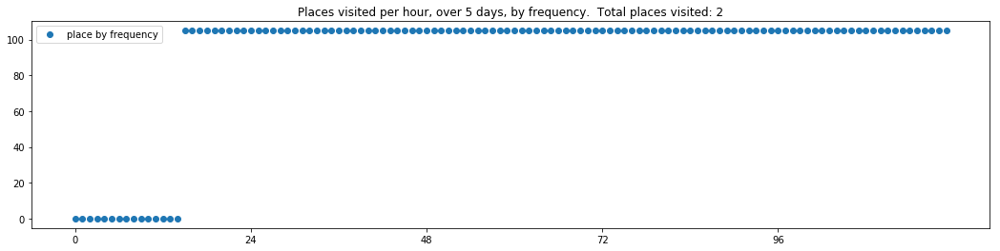

----- vector ----
prefix labels:  [302, 302]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0]


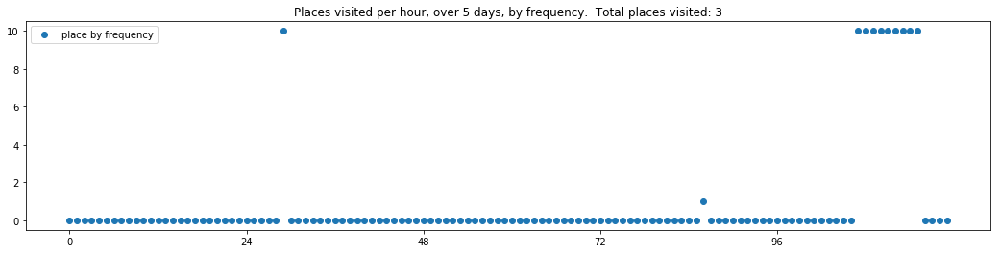

----- vector ----
prefix labels:  [123, 98]
[0, 0, 0, 0, 0, 21, 21, 0, 20, 476, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 0, 0, 568, 568, 568, 568, 0, 0, 0, 568, 0, 0, 0, 0]
[0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 0, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]


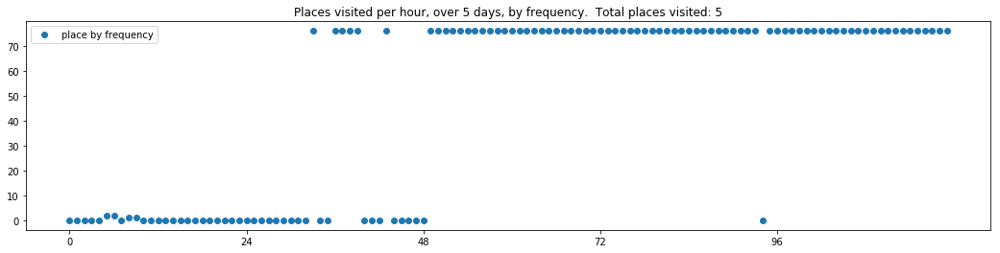

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 0]
[0, 0, 0, 205, 205, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 205]
[205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0]


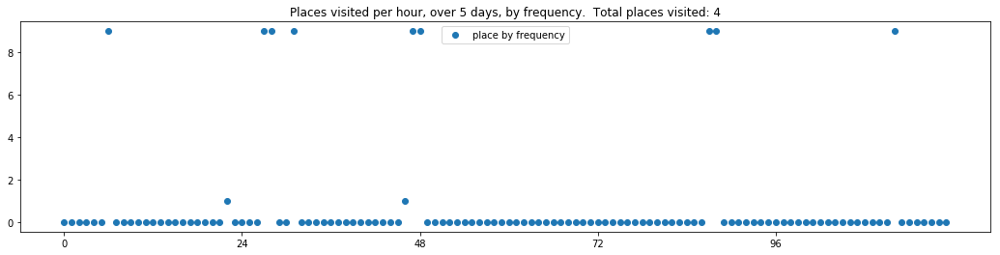

----- vector ----
prefix labels:  [357, 357]
[0, 0, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 77, 77, 77, 77, 77, 77, 77, 77, 357]
[357, 357, 357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 357]
[357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357]


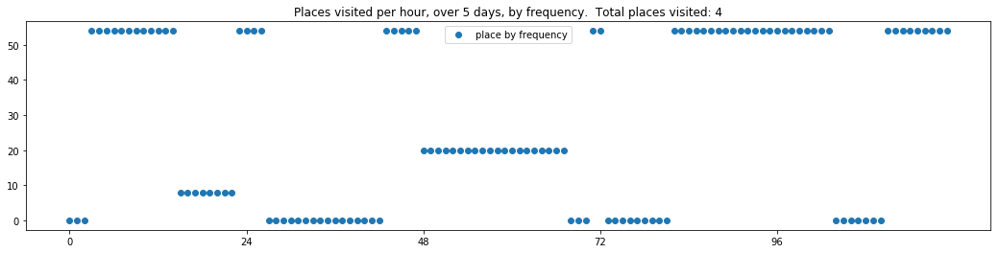

----- vector ----
prefix labels:  [90, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 90, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 90, 90, 90, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


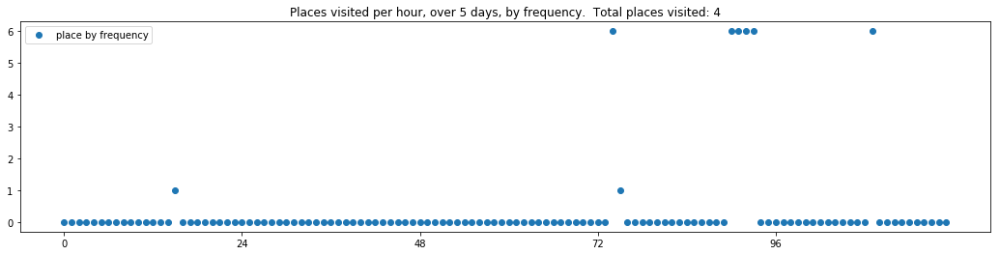

----- vector ----
prefix labels:  [83, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 35, 0, 0, 0, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 489, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


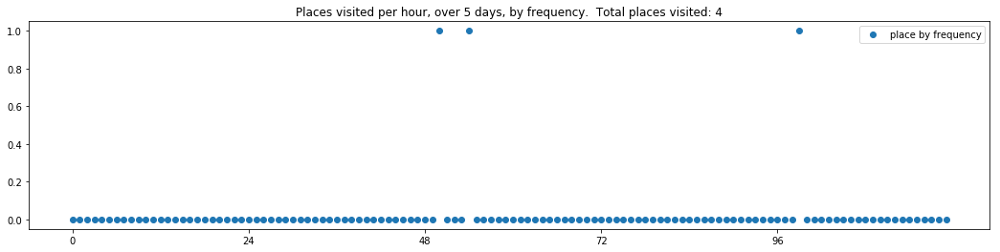

----- vector ----
prefix labels:  [396, 396]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 396, 0, 396, 396, 396, 396, 396, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 388, 388, 388, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 453, 453]
[453, 453, 564, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 0, 0, 341, 0, 0, 396, 396]
[396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 396, 0, 0, 0, 0]
[0, 420, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77]


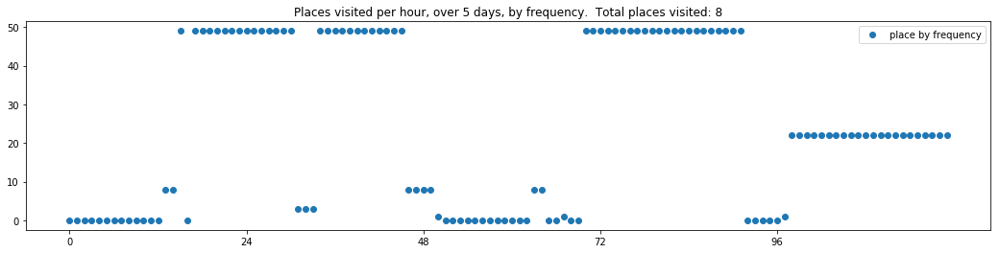

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 0, 0, 0, 165, 165, 165, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


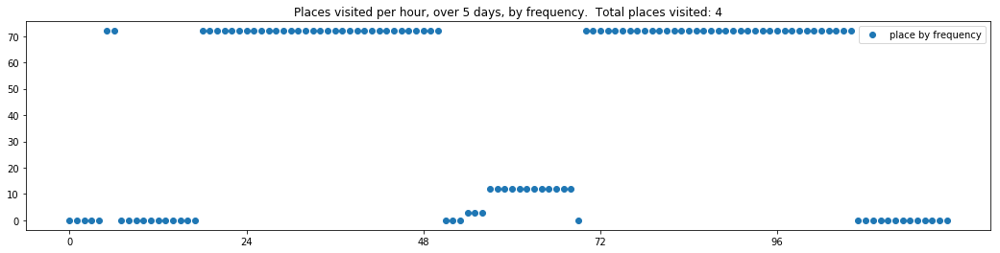

----- vector ----
prefix labels:  [360, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]


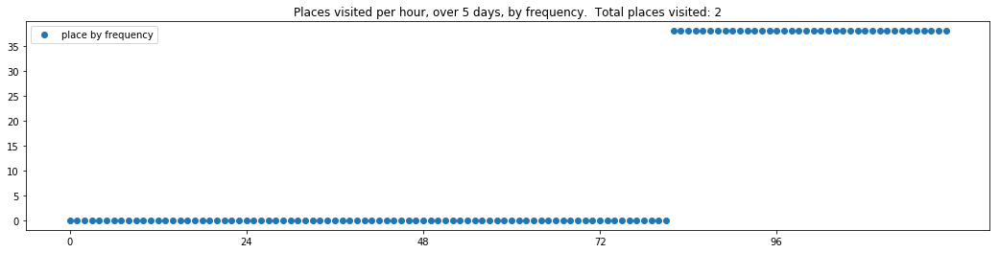

----- vector ----
prefix labels:  [112, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


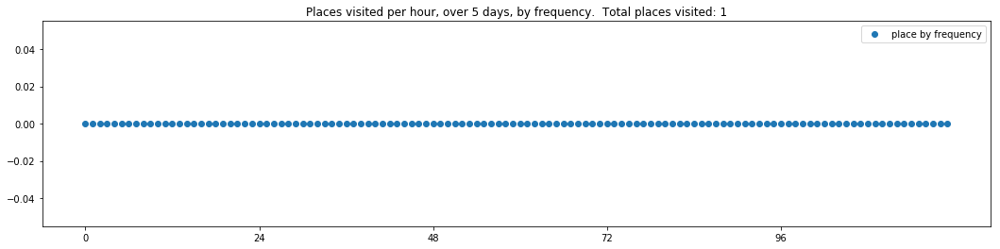

----- vector ----
prefix labels:  [480, 42]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 42, 42]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 42, 42, 42, 178, 0, 0, 302, 302, 419, 84, 84, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 178, 178, 178, 178, 41, 84, 192, 192, 192, 192, 192, 192, 192, 192]


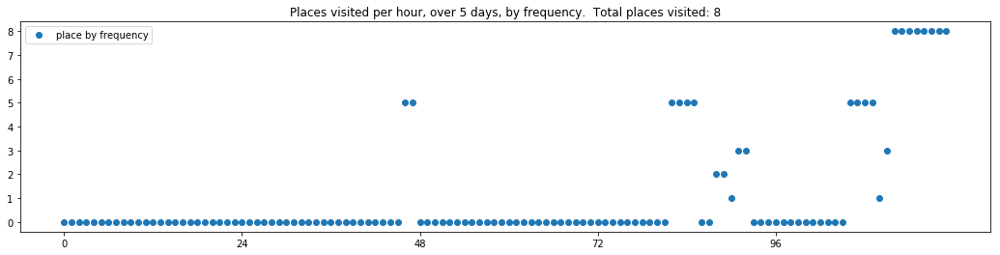

----- vector ----
prefix labels:  [233, 233]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 0, 0, 0]
[0, 0, 0, 0, 0, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 0, 0, 34]


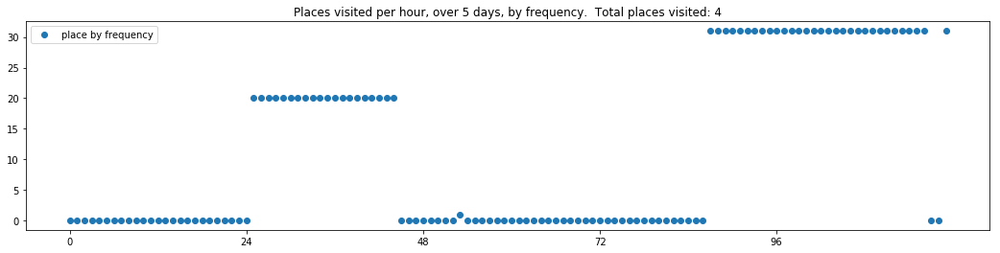

----- vector ----
prefix labels:  [611, 611]
[0, 0, 0, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]


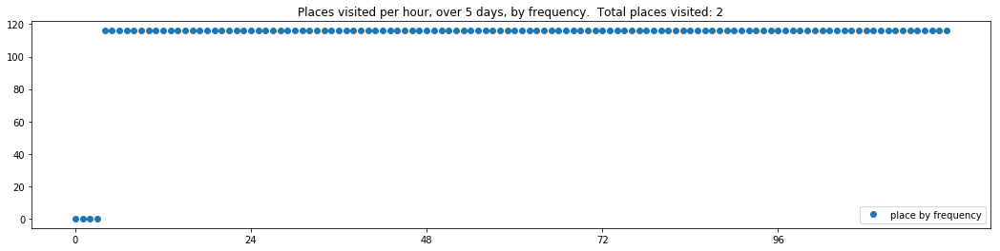

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 488, 488, 488, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 488, 488, 488, 488, 488, 80, 80]
[80, 80, 80, 80, 80, 0, 0, 0, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 0, 0, 0, 0, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 0, 80, 80]


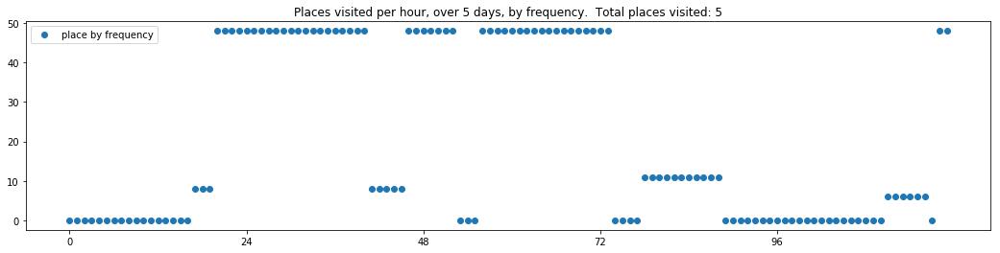

----- vector ----
prefix labels:  [320, 8]
[0, 0, 0, 0, 0, 0, 559, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320]
[320, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0]
[220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 320]


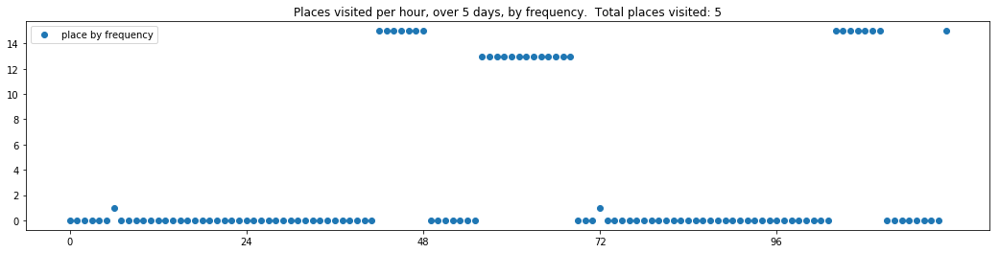

----- vector ----
prefix labels:  [590, 639]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 431, 431, 431, 431, 431, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 308, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 431, 431, 431, 431, 431, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


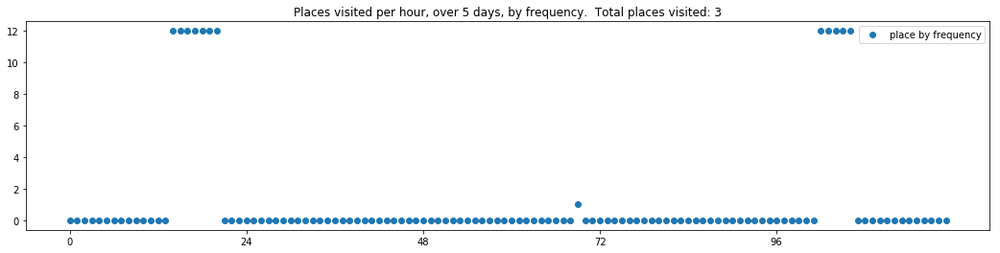

----- vector ----
prefix labels:  [398, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 119, 119, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 284, 503, 503, 0, 0, 0, 0, 0, 0, 0, 0]
[33, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 295, 0, 0, 0, 0, 0, 0, 0, 0, 0, 239, 239]
[239, 239, 0, 21, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


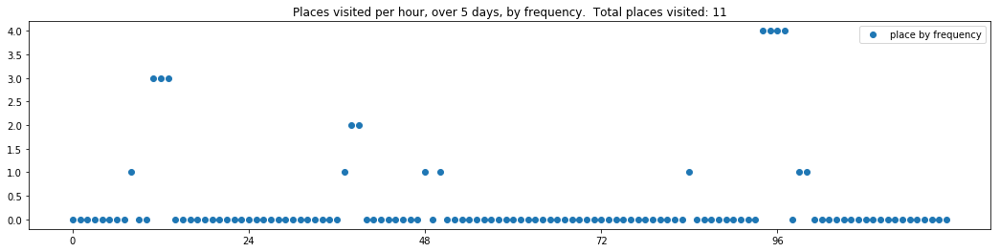

----- vector ----
prefix labels:  [539, 147]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 539, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 218, 218, 0, 0, 0, 0, 0, 94, 0, 539, 539, 539, 539, 539, 539, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218, 218, 218, 218, 218, 218]
[147, 147, 218, 218, 218, 218, 218, 218, 218, 0, 334, 334, 334, 334, 334, 334, 334, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


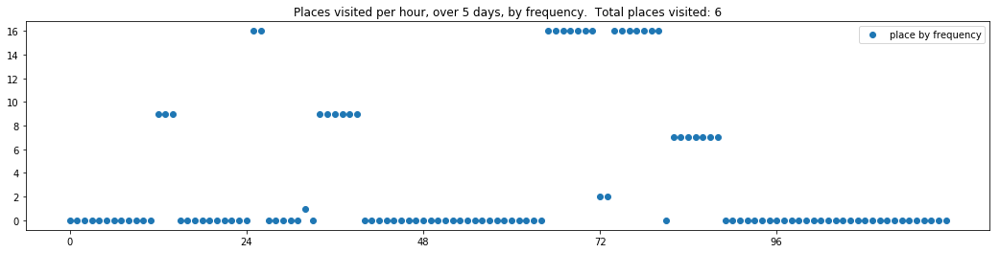

----- vector ----
prefix labels:  [174, 174]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


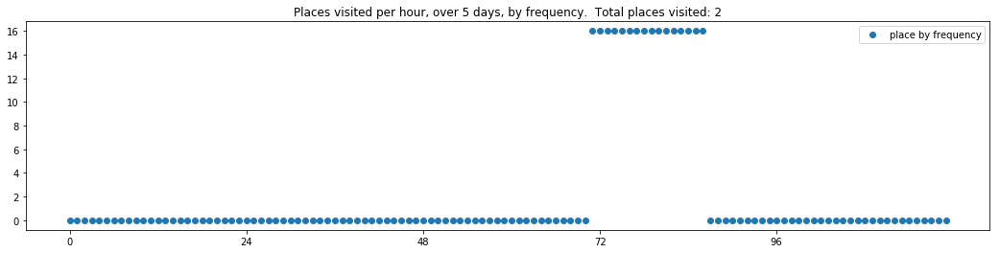

----- vector ----
prefix labels:  [311, 304]
[0, 0, 0, 304, 304, 304, 304, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 304, 304, 304, 304, 304, 304, 0, 311, 311, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]


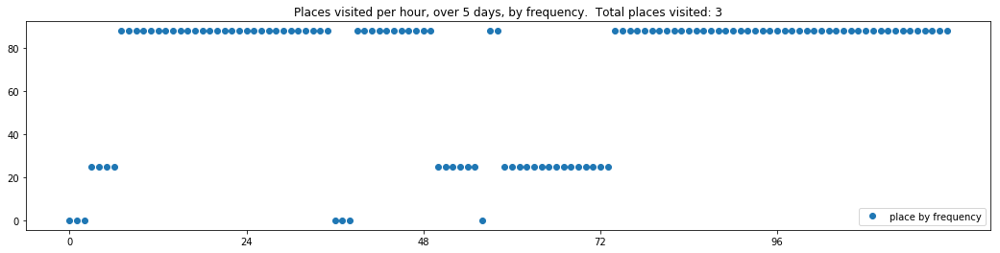

----- vector ----
prefix labels:  [453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 21, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 0, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 562, 562, 562, 562, 562, 392, 392, 392, 392, 392, 392]


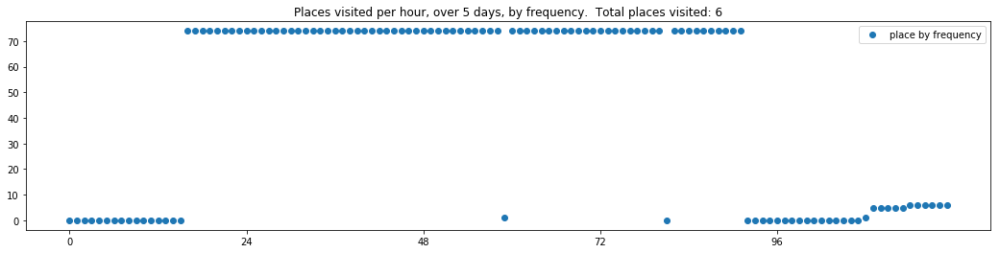

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0]
[71, 0, 0, 0, 0, 71, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71]


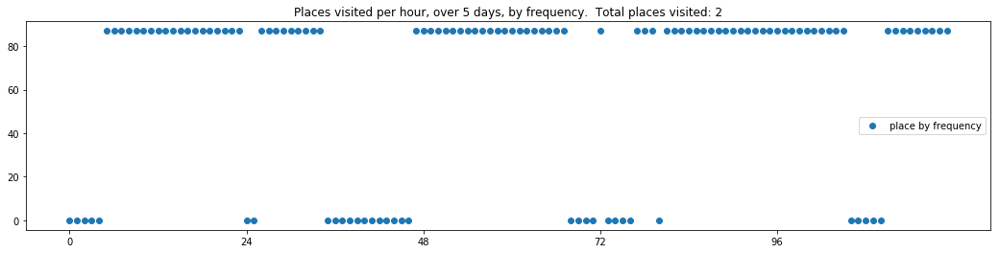

----- vector ----
prefix labels:  [122, 122]
[0, 0, 0, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 161, 161, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 456, 456, 456, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 245, 245, 245, 0, 0, 0, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52]
[52, 52, 52, 52, 52, 52, 52, 0, 0, 0, 580, 0, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 20, 20, 20, 0]


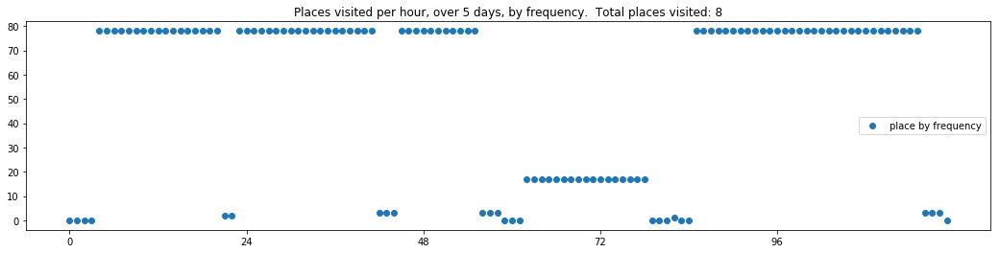

----- vector ----
prefix labels:  [189, 189]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 189, 189, 189, 189, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 107, 107, 107, 107, 107, 0, 4, 0, 0, 0, 4, 4]
[4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


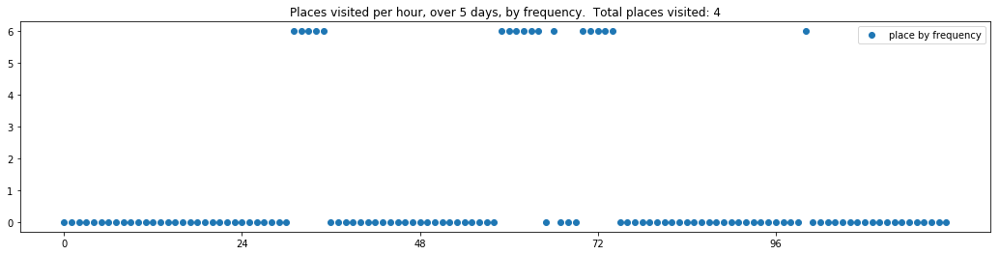

----- vector ----
prefix labels:  [534, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 55, 55, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]


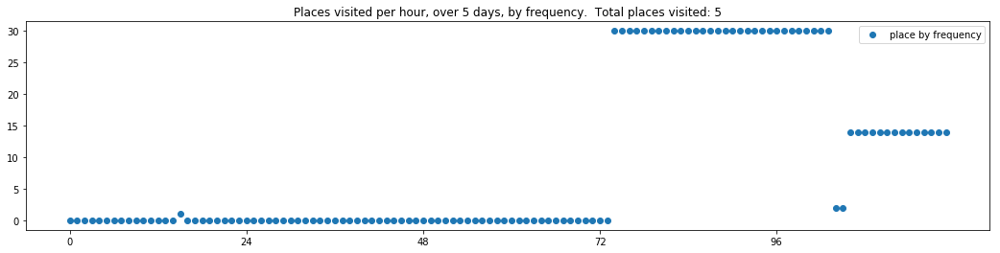

----- vector ----
prefix labels:  [231, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 372, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


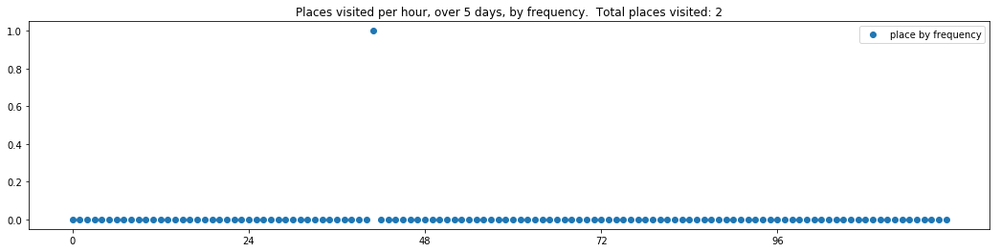

----- vector ----
prefix labels:  [110, 391]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 391, 312, 312, 313, 639, 195]
[195, 390, 390, 390, 390, 102, 0, 433, 0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0]
[195, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]
[390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0, 0, 195, 296, 296, 390, 390, 0, 390, 390, 390, 390, 390]
[390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]


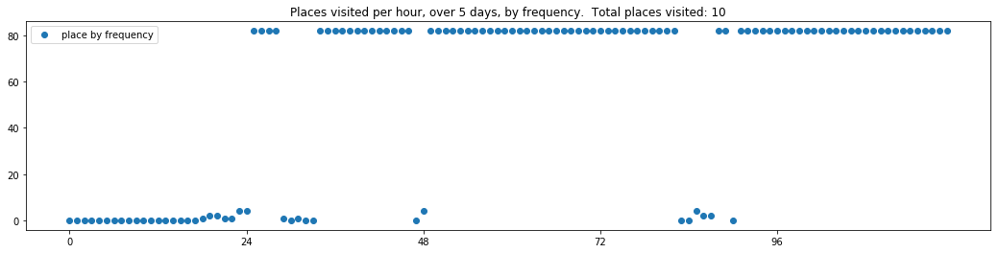

----- vector ----
prefix labels:  [634, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


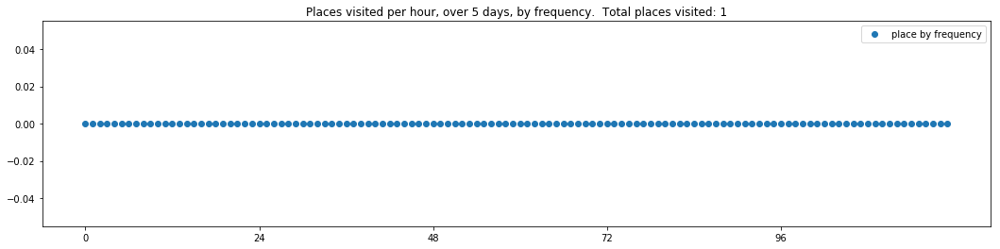

----- vector ----
prefix labels:  [24, 24]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


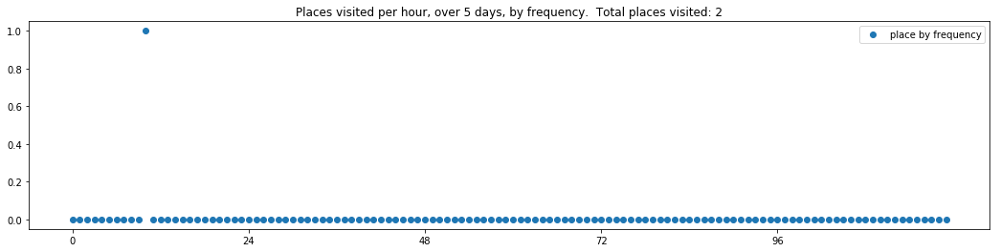

----- vector ----
prefix labels:  [110, 205]
[0, 0, 0, 0, 0, 110, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 110]
[110, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 110, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 305, 305, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 195, 599, 305, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 305, 305, 305, 305]
[305, 305, 305, 392, 0, 0, 0, 0, 0, 0, 392, 392, 312, 305, 305, 0, 0, 194, 549, 549, 549, 549, 549, 549]


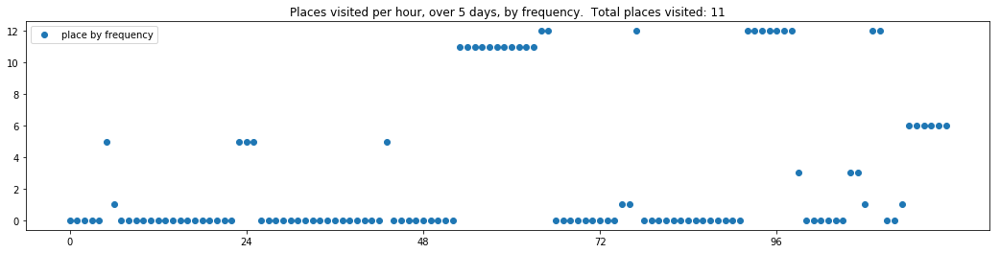

----- vector ----
prefix labels:  [52, 52]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 270, 270, 0, 270, 270, 270, 270, 270, 270, 0, 0, 52, 52, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 260, 20, 20, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 260, 227, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


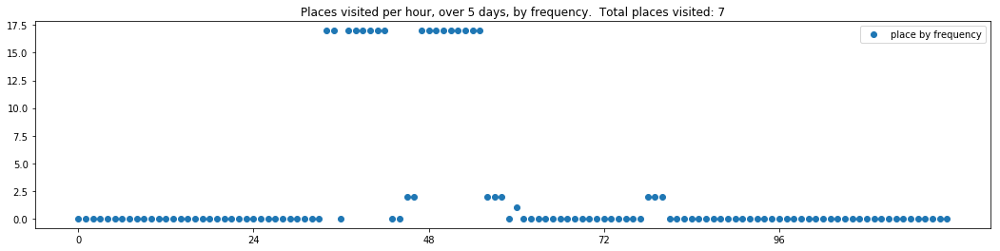

----- vector ----
prefix labels:  [177, 177]
[0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 410, 177, 177, 177, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 33, 0, 0, 0, 0, 0, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 177, 177, 0, 0, 177, 0, 0, 0, 0, 177, 177, 177, 177, 177]


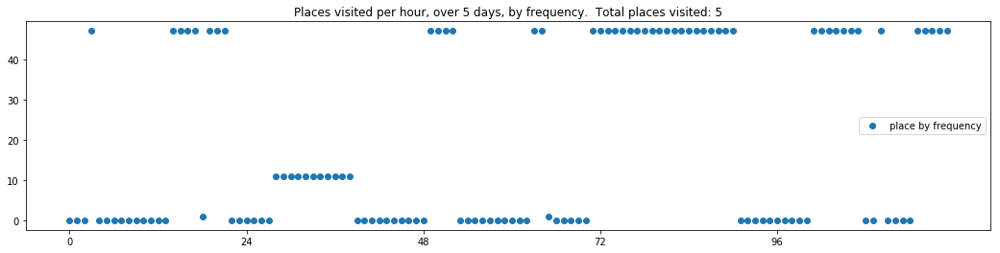

----- vector ----
prefix labels:  [64, 64]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 64, 64, 0, 0, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 155, 64, 64]


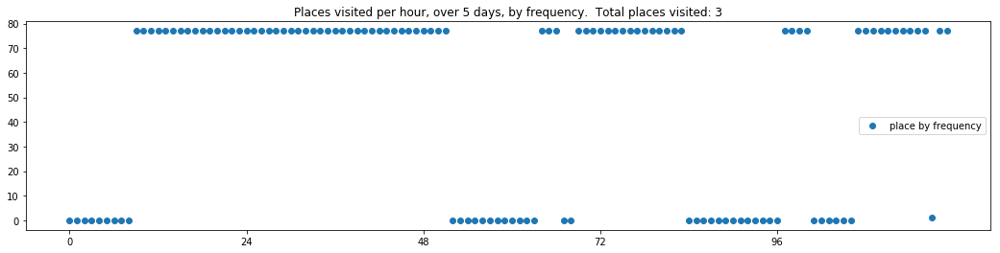


------
 70 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_70.txt 
------

----- vector ----
prefix labels:  [181, 76]
[0, 644, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 439, 439, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212]
[212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212]
[212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212]


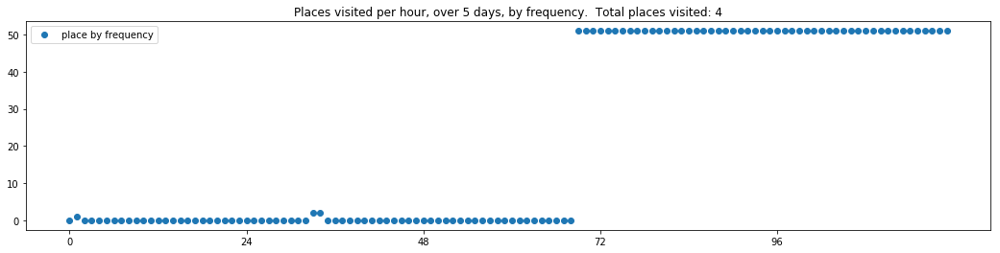

----- vector ----
prefix labels:  [184, 184]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 184]
[184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


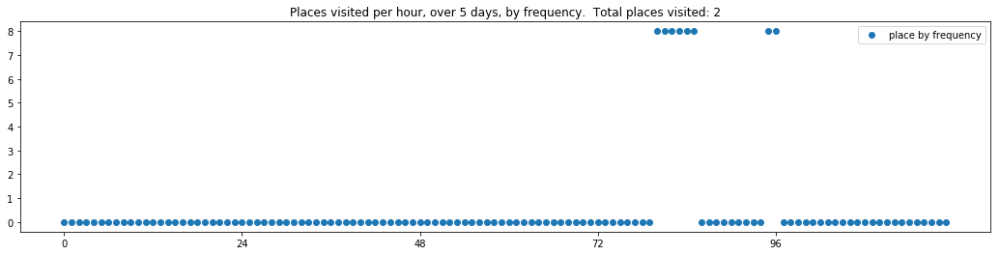

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


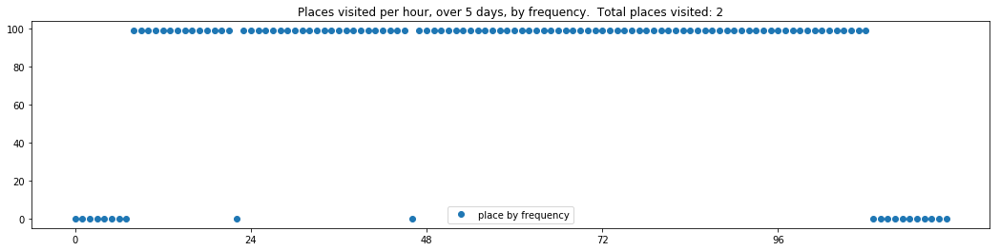

----- vector ----
prefix labels:  [50, 50]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 183, 20, 20, 20, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 396, 396, 396, 396, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


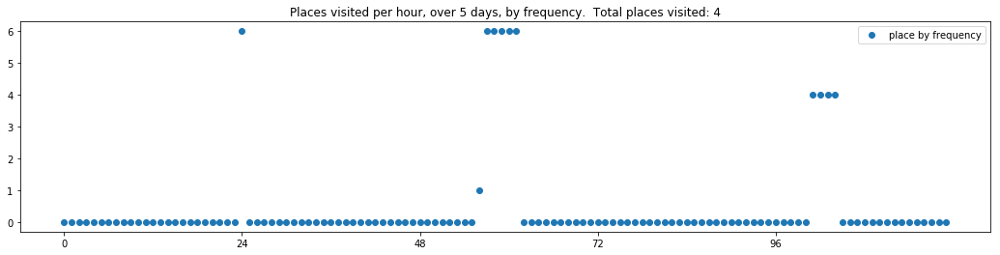

----- vector ----
prefix labels:  [65, 65]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 22, 22, 22]
[22, 22, 22, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 0, 65, 65, 65, 65, 65, 65]
[65, 65, 65, 22, 0, 22, 65, 65, 22, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]


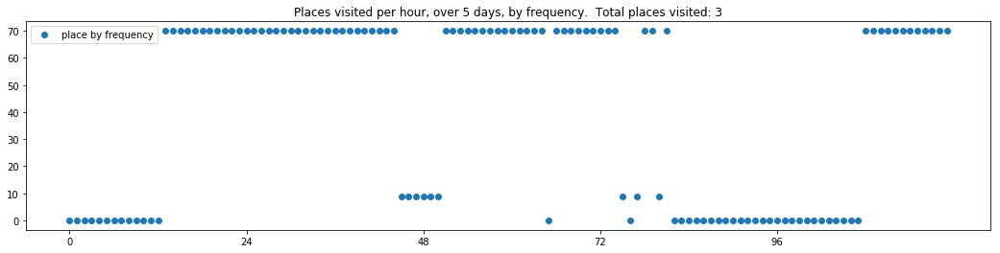

----- vector ----
prefix labels:  [611, 611]
[0, 0, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]


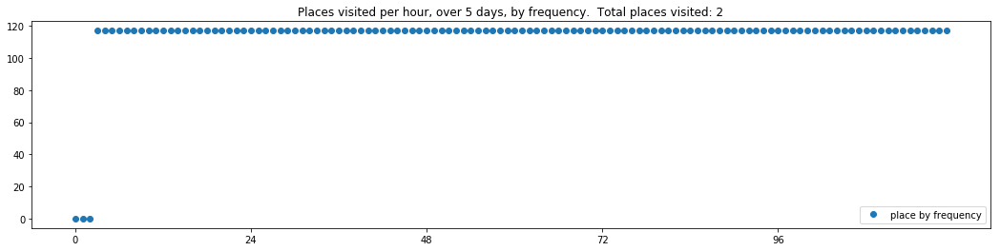

----- vector ----
prefix labels:  [133, 133]
[478, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[144, 144, 144, 144, 144, 144, 0, 0, 69, 69, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 372, 0, 0, 0, 0, 0]
[144, 144, 144, 144, 0, 0, 0, 0, 69, 0, 241, 0, 1, 7, 0, 0, 0, 0, 0, 0, 39, 323, 323, 323]


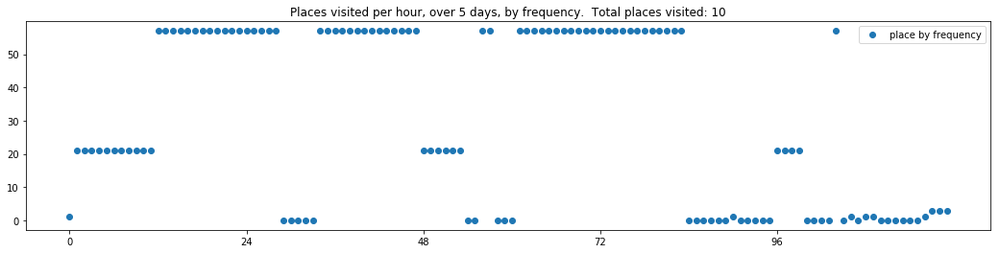

----- vector ----
prefix labels:  [87, 69]
[0, 0, 0, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69]
[0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 69, 69, 69, 69]
[0, 0, 0, 0, 0, 0, 69, 69, 0, 0, 410, 0, 0, 0, 69, 69, 69, 69, 69, 69, 87, 87, 87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


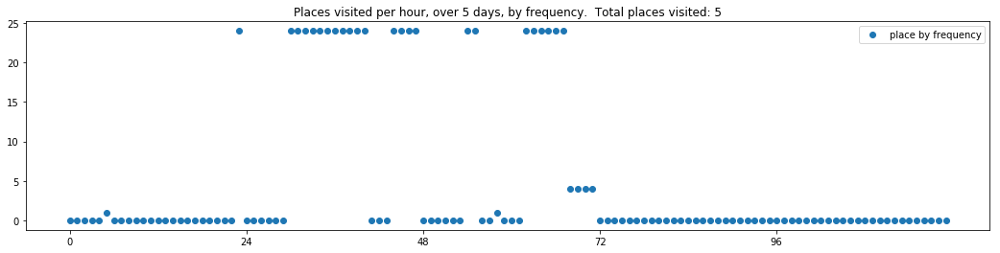

----- vector ----
prefix labels:  [533, 0]
[0, 0, 0, 0, 533, 533, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533, 533]
[533, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


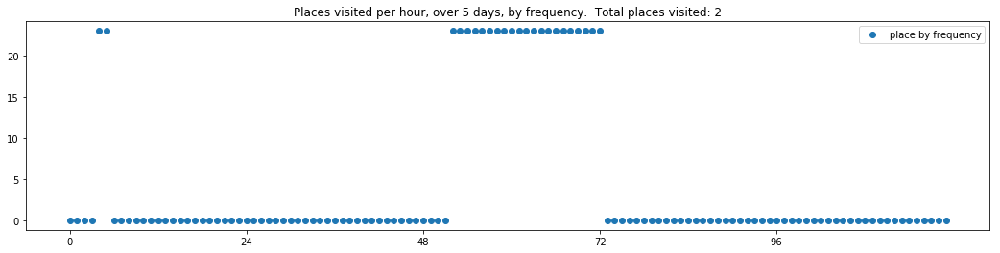

----- vector ----
prefix labels:  [334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


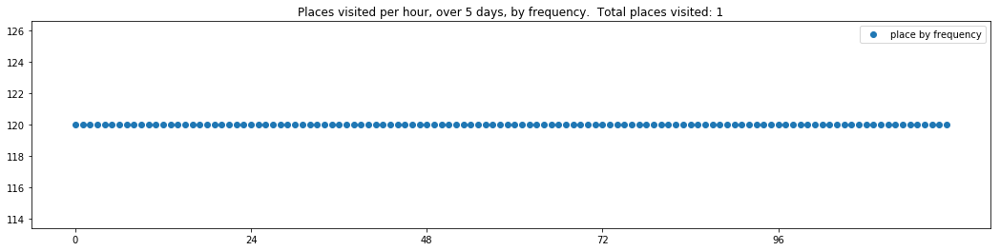

----- vector ----
prefix labels:  [153, 153]
[0, 0, 0, 153, 0, 0, 0, 0, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 153, 153, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 153, 459, 459, 459, 459, 459, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


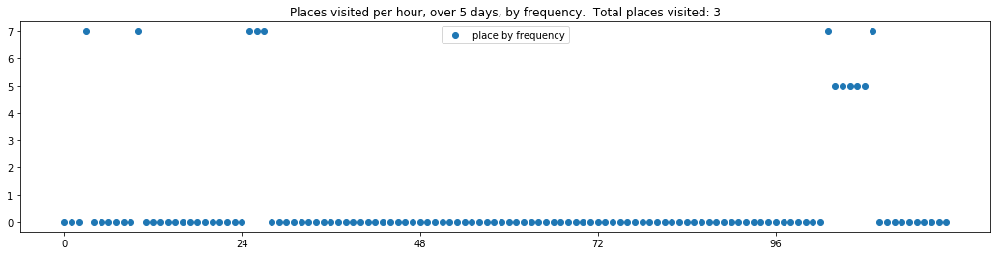

----- vector ----
prefix labels:  [534, 534]
[0, 0, 0, 0, 0, 0, 0, 534, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 534, 0, 0, 0]
[0, 0, 0, 0, 200, 404, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 318, 0, 0, 0, 0, 0, 0, 0, 146, 212, 212, 212, 212, 212, 212, 212, 212, 212]
[212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 596, 181]
[181, 181, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 181, 181, 0, 0, 388, 388, 0, 0, 0, 0, 0, 0]


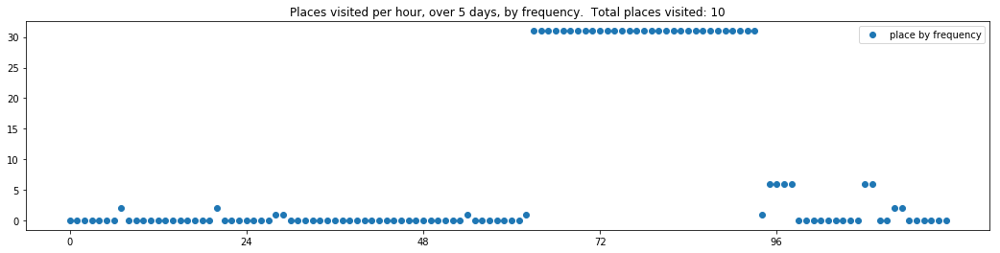

----- vector ----
prefix labels:  [330, 330]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[330, 330, 330, 330, 330, 330, 330, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 0]


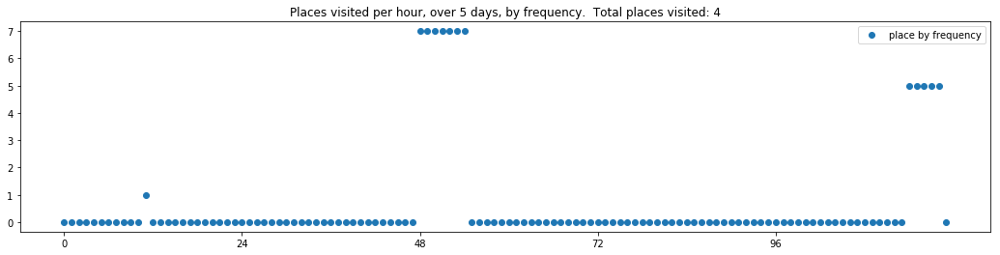

----- vector ----
prefix labels:  [31, 232]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 145, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 0, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 0, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]


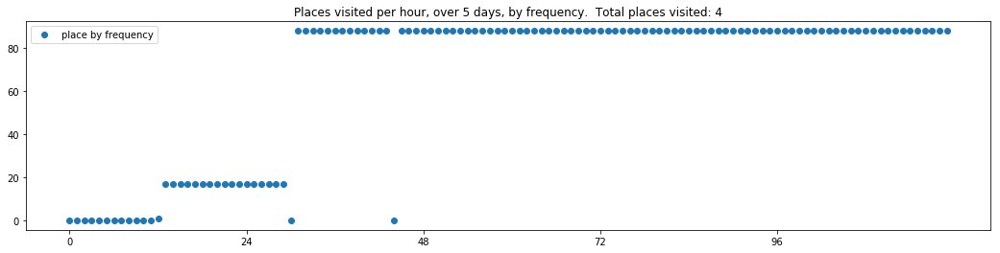

----- vector ----
prefix labels:  [1, 568]
[0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 0, 0, 0, 0, 488, 488, 0, 0, 0, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]


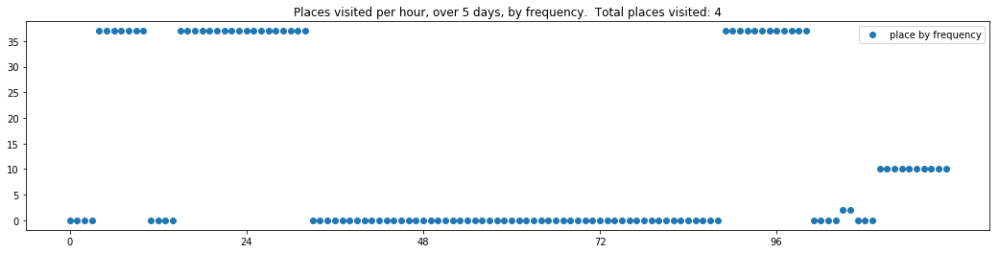

----- vector ----
prefix labels:  [461, 461]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


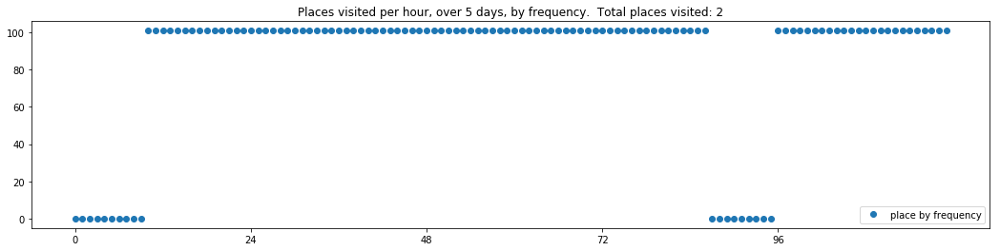

----- vector ----
prefix labels:  [52, 52]
[0, 0, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52]
[52, 52, 270, 270, 270, 270, 270, 270, 52, 52, 52, 52, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0, 52, 52, 52, 52, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[260, 291, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]


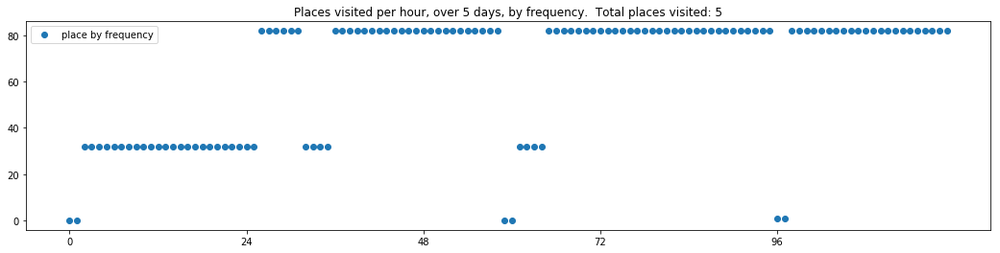

----- vector ----
prefix labels:  [0, 189]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189]
[189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189]
[189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189]
[189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


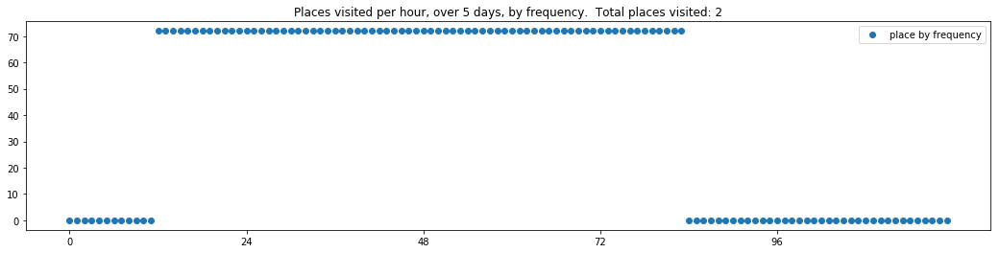

----- vector ----
prefix labels:  [103, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[94, 94, 94, 94, 94, 2, 0, 563, 563, 563, 563, 563, 563, 563, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


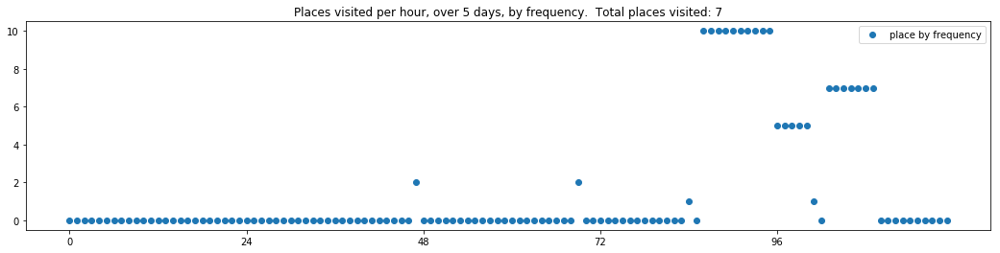

----- vector ----
prefix labels:  [181, 181]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 177, 177, 177]
[177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


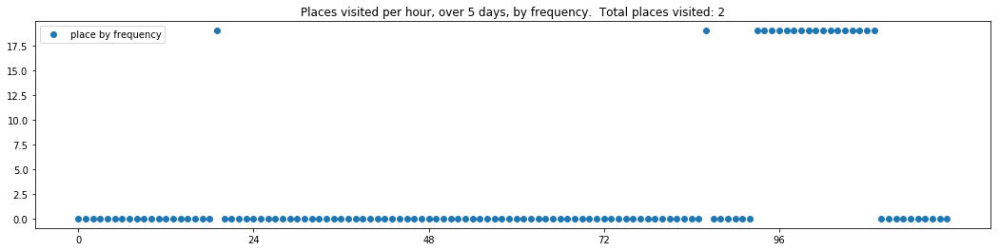

----- vector ----
prefix labels:  [649, 649]
[508, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 649]
[649, 649, 649, 649, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 649, 649, 649, 649]
[649, 649, 649, 649, 649, 649, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


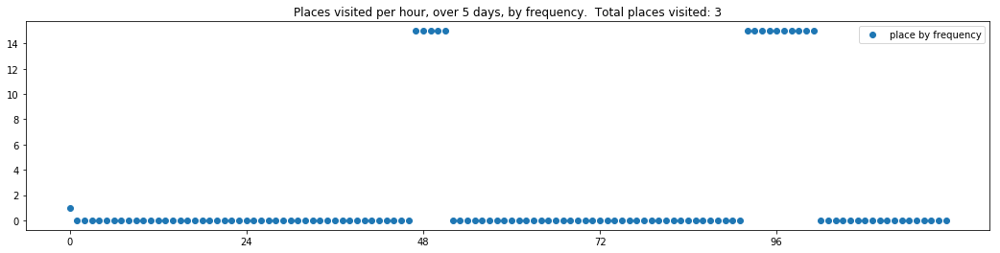

----- vector ----
prefix labels:  [308, 453]
[0, 0, 0, 0, 195, 0, 0, 0, 308, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 304]
[304, 304, 304, 486, 486, 486, 486, 486, 161, 161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 486, 486, 486, 486, 0, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 0, 308, 308, 308, 0, 486, 486]
[486, 486, 486, 486, 486, 486, 486, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 486, 486]
[0, 0, 0, 0, 308, 308, 562, 308, 308, 0, 0, 0, 308, 0, 0, 0, 0, 0, 0, 0, 195, 195, 195, 195]


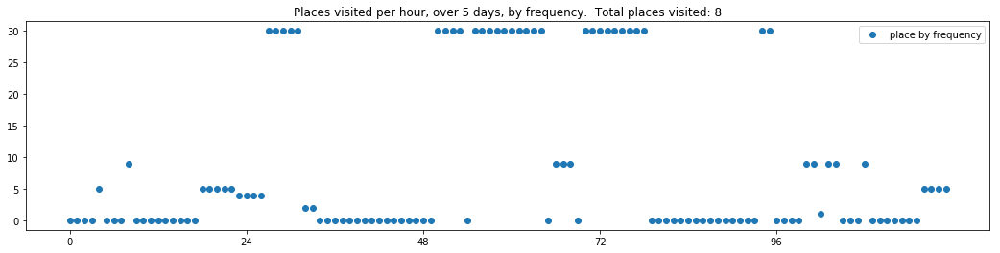

----- vector ----
prefix labels:  [267, 267]
[0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


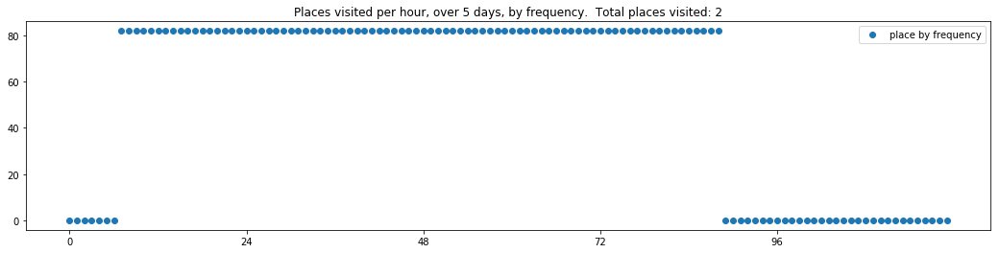

----- vector ----
prefix labels:  [253, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


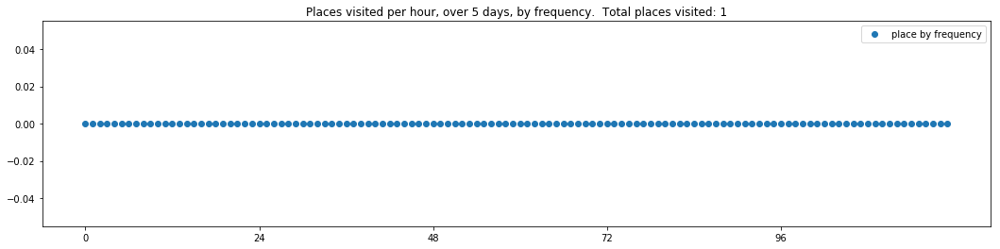

----- vector ----
prefix labels:  [478, 478]
[478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478]
[478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0]
[478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0, 0, 0, 478, 0, 0, 0, 0, 478, 478]
[478, 478, 478, 478, 478, 478, 478, 478, 478, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 478, 478, 478, 0, 0, 478, 478]


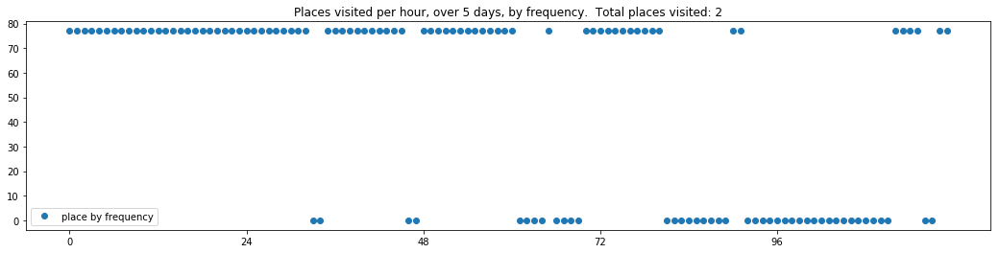

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 219, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]


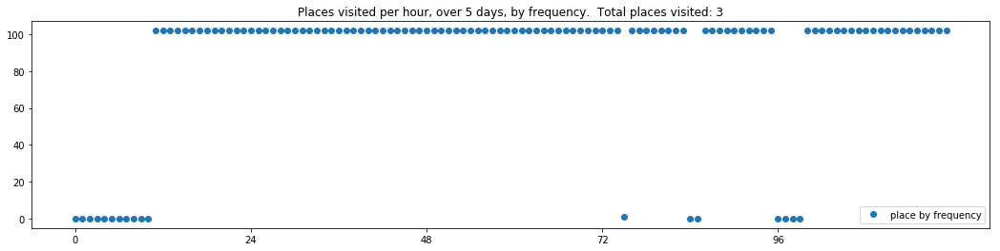

----- vector ----
prefix labels:  [165, 165]
[0, 0, 0, 0, 165, 165, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 165, 165]
[165, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 165, 0]
[0, 0, 0, 165, 165, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 165, 165, 165, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


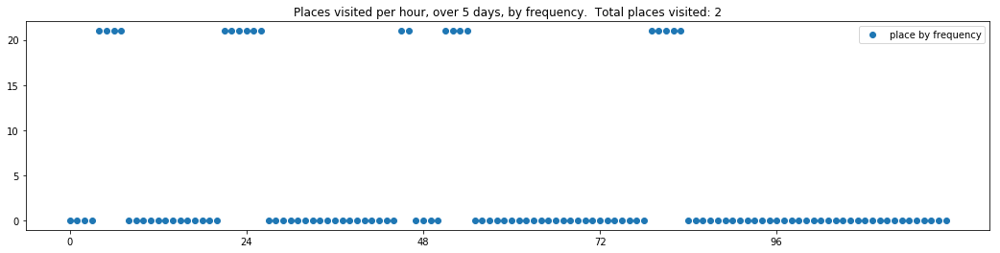

----- vector ----
prefix labels:  [502, 502]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 502, 502, 0, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0, 0, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


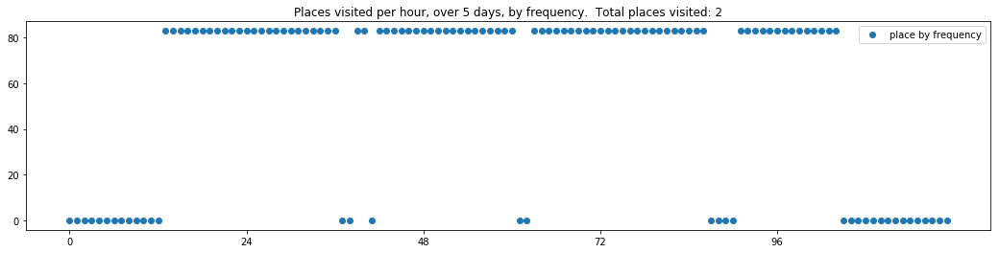

----- vector ----
prefix labels:  [7, 7]
[0, 0, 0, 0, 0, 184, 0, 0, 0, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 0, 0, 0, 0, 69]
[69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 465, 465, 465, 465, 465]
[465, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 353, 353, 353, 353, 7, 7, 7, 112, 112]


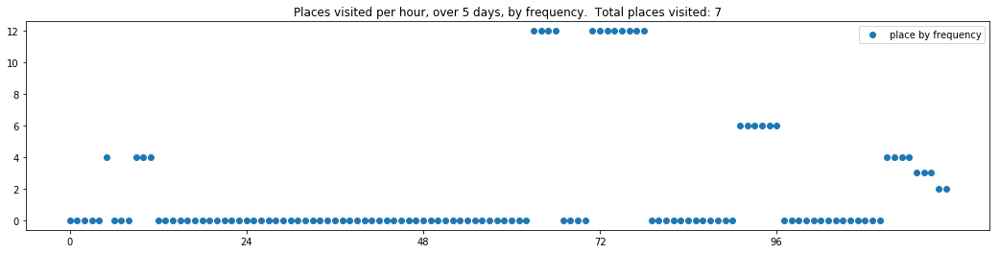

----- vector ----
prefix labels:  [98, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 465, 465, 465, 465, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 21]
[322, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 429, 429, 429, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


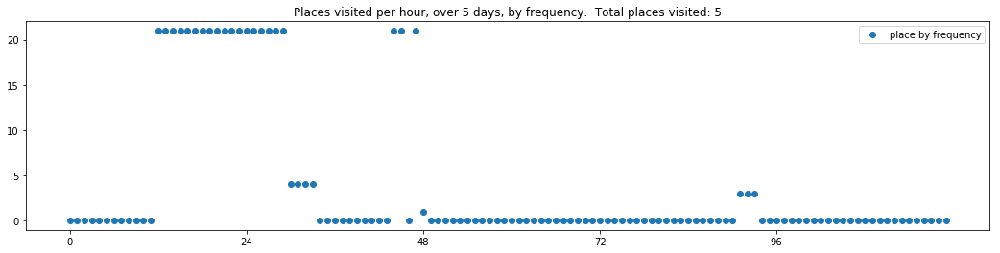

----- vector ----
prefix labels:  [218, 218]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 342, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 0, 0, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 0, 147, 147, 147, 147, 147, 147, 147, 0, 0]


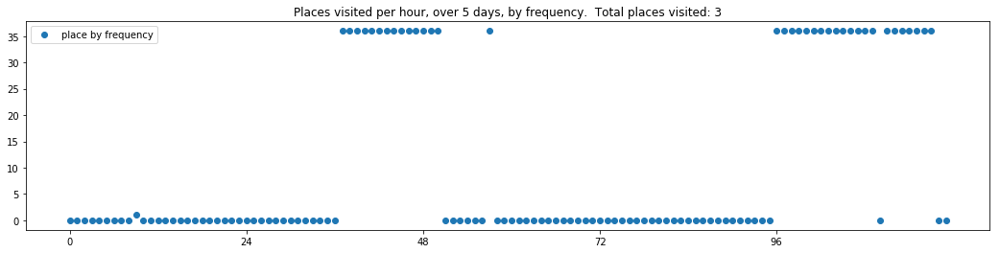

----- vector ----
prefix labels:  [579, 579]
[0, 0, 0, 0, 218, 455, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218, 0, 2, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 218, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 2, 2, 595, 595, 0, 0, 0, 0, 0, 0, 0, 0, 0, 579, 579, 579, 579, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289]
[289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289, 289]


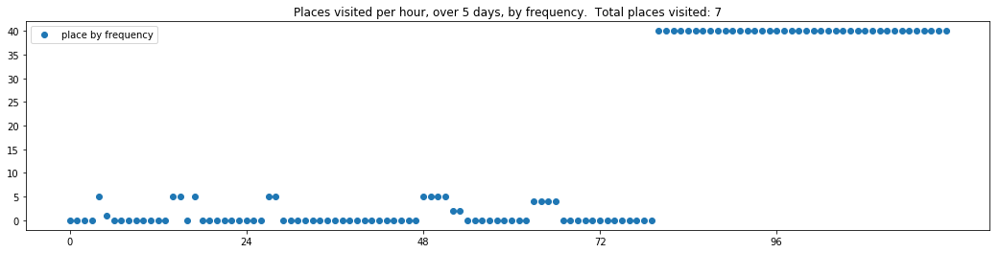

----- vector ----
prefix labels:  [189, 189]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 429, 429, 484, 0, 0, 0]


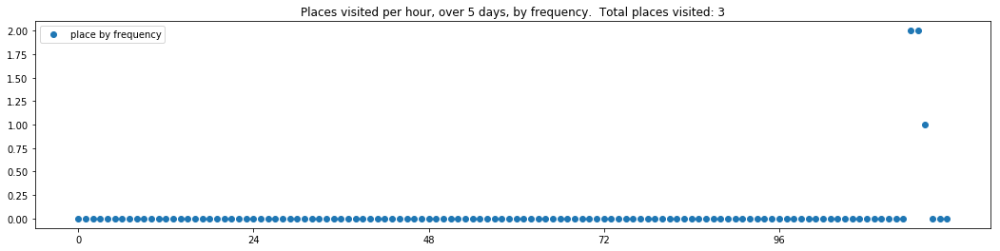

----- vector ----
prefix labels:  [221, 174]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 221, 221, 221, 221, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 533, 97, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]


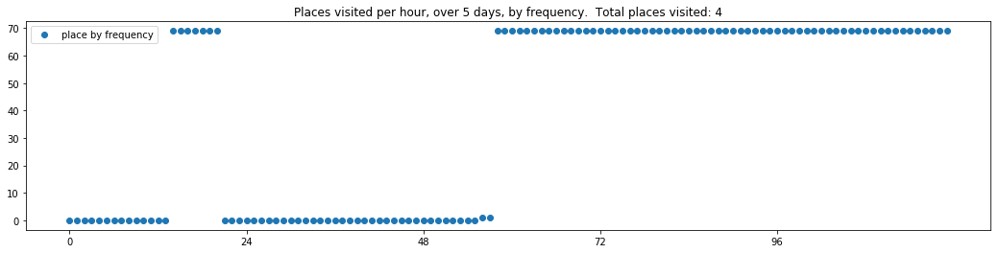

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


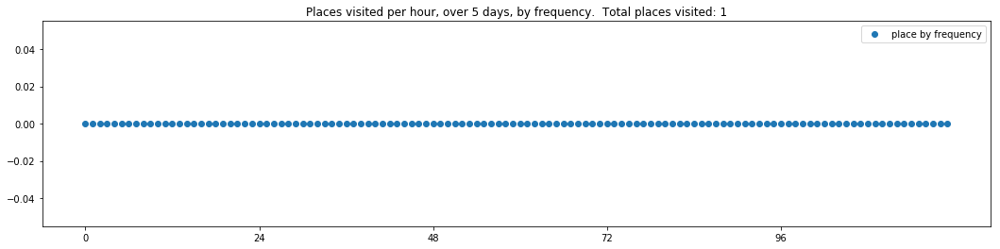

----- vector ----
prefix labels:  [95, 95]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 0, 0, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 0, 0, 0, 0, 0, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]


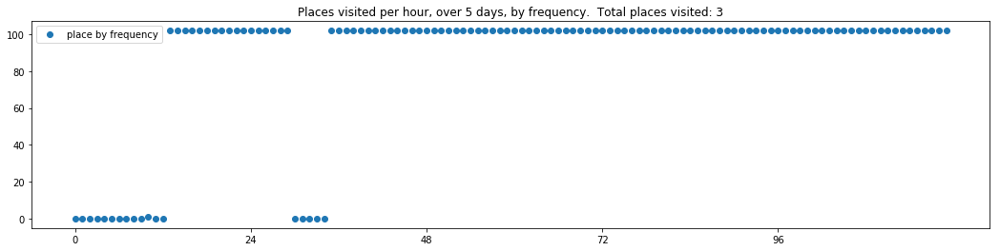

----- vector ----
prefix labels:  [488, 488]
[0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 568, 568, 568, 568, 488, 488, 488, 488, 488, 488, 488, 488, 45]
[0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]


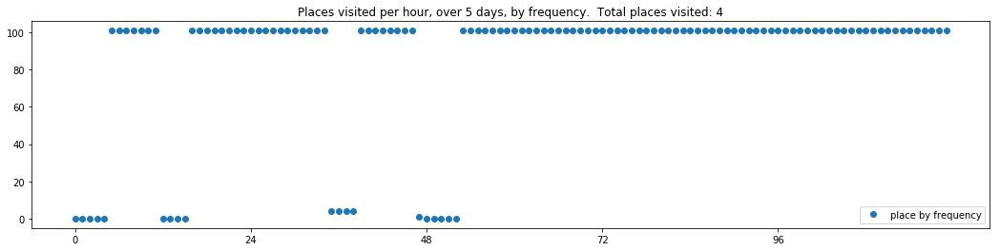

----- vector ----
prefix labels:  [2, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 2, 0, 20, 20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 645, 645, 645, 645, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


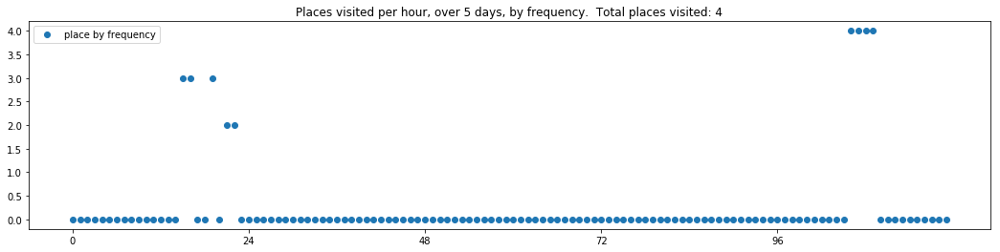

----- vector ----
prefix labels:  [224, 224]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 224, 224, 224, 224, 224, 224, 224, 224]
[224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224]
[224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 0, 224, 224, 224]
[224, 224, 224, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 224, 224, 224, 224, 224, 224, 224, 224, 224, 224, 0, 224, 224, 224, 224, 224, 224, 0, 224, 224, 224, 224]


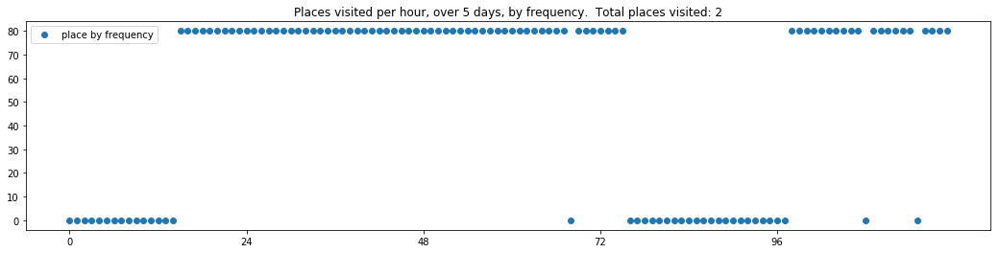

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 413, 413, 413, 413, 413, 413, 413, 413, 0, 413, 0, 413, 413, 413, 0, 0, 0, 0, 0, 0, 413, 413]
[413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 413]


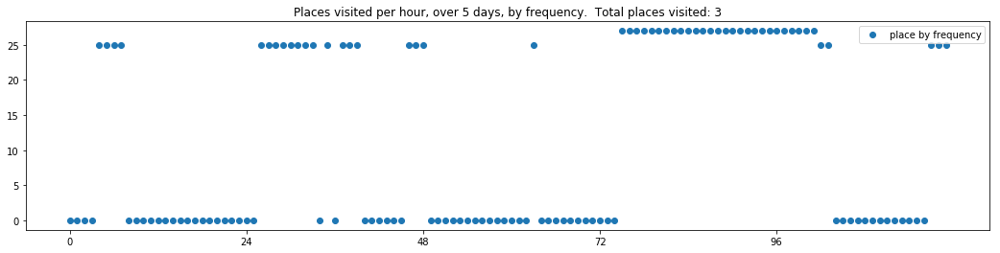

----- vector ----
prefix labels:  [53, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[21, 21, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 0, 21, 21, 57, 20, 8, 21, 21, 21, 21, 21, 21, 21, 21, 21, 76, 76, 76]
[76, 76, 76, 76, 76, 76, 76, 76, 127, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21]
[21, 0, 21, 21, 0, 0, 0, 0, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


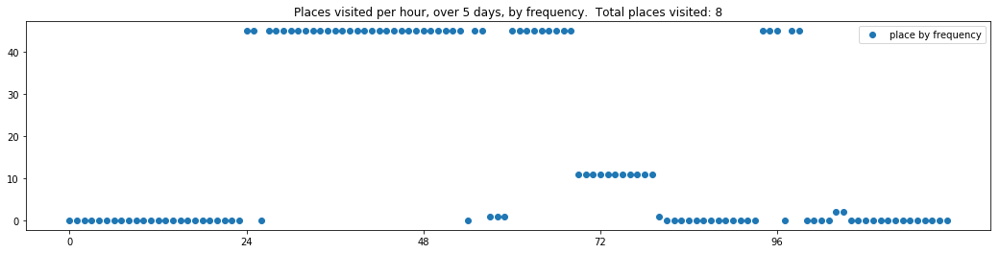

----- vector ----
prefix labels:  [35, 133]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 133, 0, 0, 0, 0, 0, 84, 84, 84, 403, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[100, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 0, 0, 100, 100, 0, 0, 0, 0, 407, 0]
[0, 0, 0, 0, 0, 0, 403, 403, 0, 0, 0, 0, 0, 0, 403, 403, 403, 403, 403, 0, 0, 0, 133, 403]


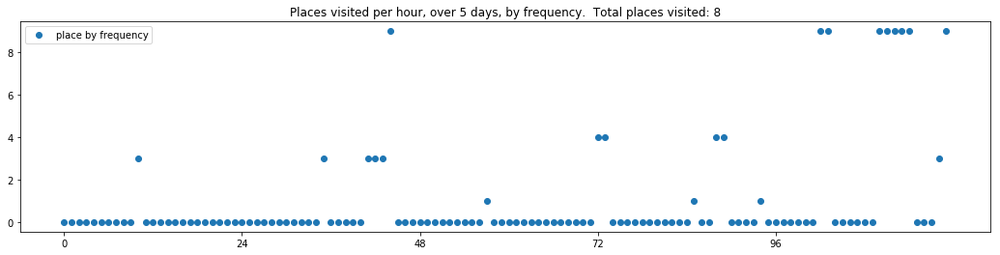

----- vector ----
prefix labels:  [475, 475]
[0, 0, 0, 0, 475, 475, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 0, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 0, 0, 0]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[0, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


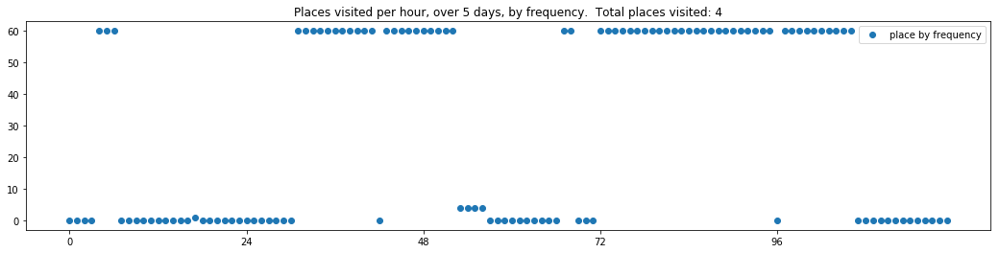

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 142, 0, 0]
[0, 0, 0, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0, 0, 142]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 413, 413, 413, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0]
[0, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0, 215, 215, 412, 412, 412, 0, 413]


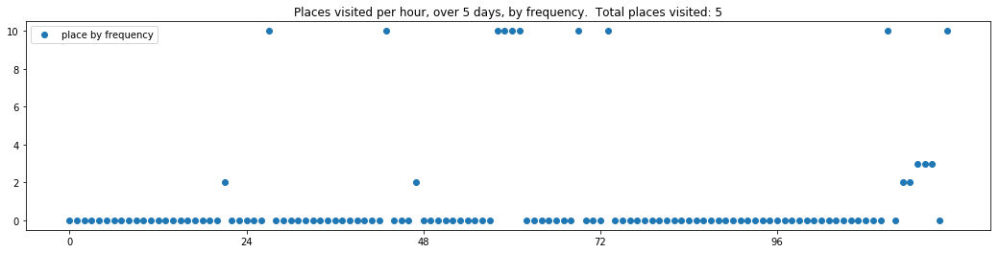

----- vector ----
prefix labels:  [515, 515]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 515, 515, 515, 515, 515, 515, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 515, 515, 515, 515]
[515, 515, 0, 0, 0, 0, 0, 0, 0, 515, 515, 55, 55, 55, 55, 55, 515, 515, 515, 515, 515, 515, 515, 4]
[4, 4, 4, 4, 4, 4, 4, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 515, 0, 0, 515, 515, 515]
[515, 515, 515, 0, 0, 177, 0, 0, 0, 0, 0, 0, 415, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


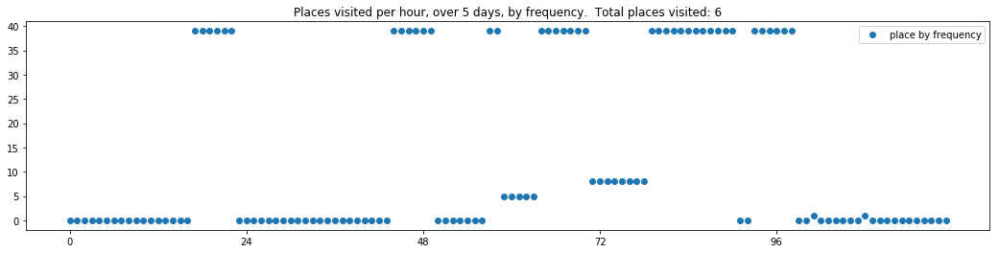

----- vector ----
prefix labels:  [588, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0]


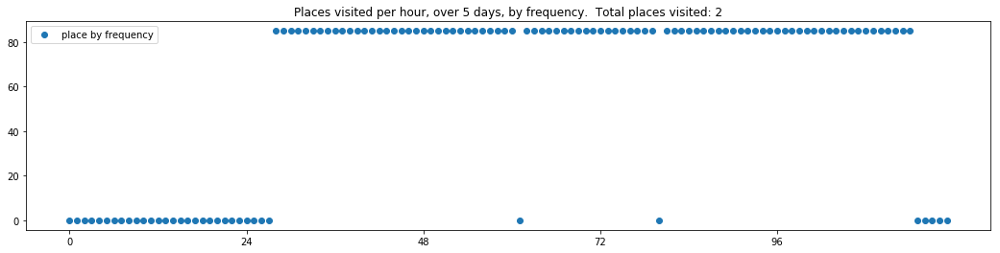

----- vector ----
prefix labels:  [649, 194]
[0, 0, 0, 0, 0, 0, 0, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 0, 0, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 0, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 130, 0, 0, 0, 0, 112, 112, 112, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43]


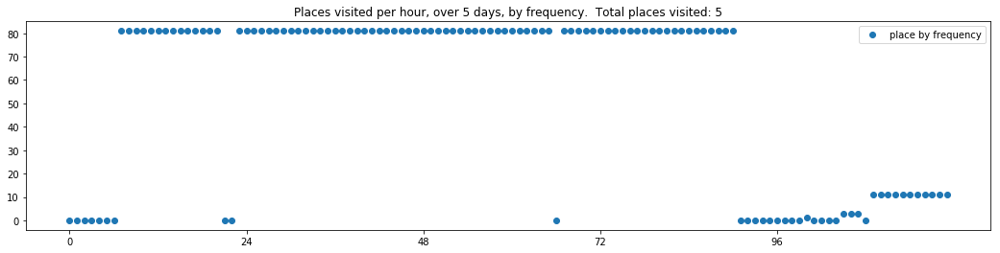

----- vector ----
prefix labels:  [147, 147]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 147, 147, 147, 0, 0, 0]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]
[147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]


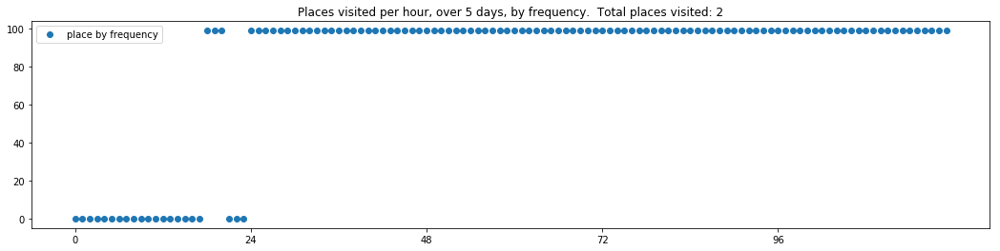

----- vector ----
prefix labels:  [484, 5]
[0, 0, 0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 410, 410, 410, 410, 410, 410, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 69, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 0, 0, 0, 69, 69, 69, 0, 69, 69, 69, 69, 0, 0, 0, 410, 0, 0, 0, 0, 0, 100, 0, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]


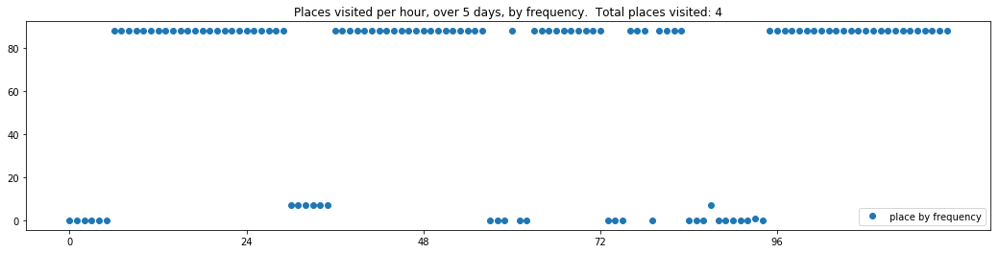

----- vector ----
prefix labels:  [637, 637]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 637, 637, 637, 637, 637, 637, 637, 637, 637, 637, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


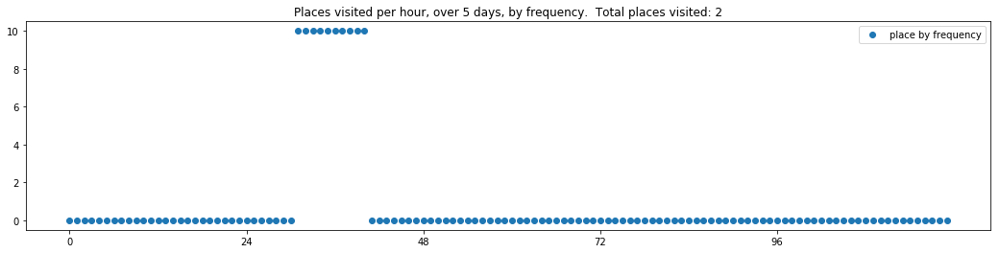


------
 75 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_75.txt 
------

----- vector ----
prefix labels:  [590, 415]
[0, 0, 328, 328, 328, 328, 328, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 107]
[107, 107, 107, 107, 107, 107, 107, 107, 107, 107, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 0, 0, 0, 328, 453]
[0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0, 415, 415, 415, 415, 415, 415, 415, 415]
[415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415]


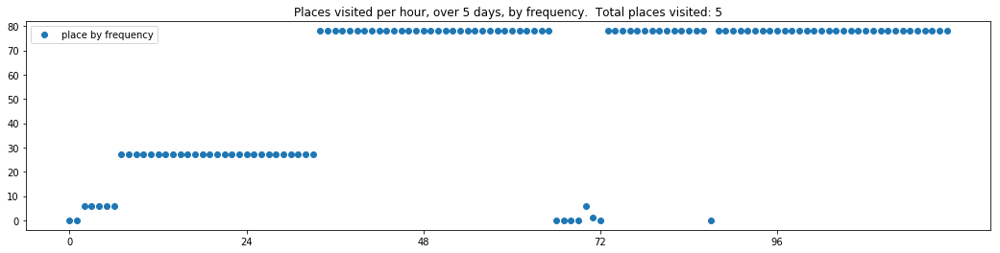

----- vector ----
prefix labels:  [427, 427]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 427, 427, 427, 0, 0, 0, 0, 0, 0, 0, 0, 427, 427, 427, 427, 427, 427, 427, 427, 427, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 427, 284, 284, 284, 284, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 239, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


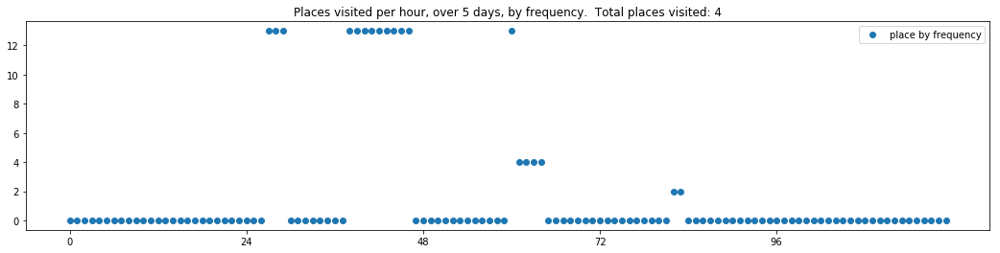

----- vector ----
prefix labels:  [97, 97]
[0, 0, 0, 0, 0, 410, 410, 410, 410, 410, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545, 545]
[545, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97]
[97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 0, 0, 0, 0, 0, 0, 0, 644, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 224, 0, 0, 0, 0, 0, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147, 147]


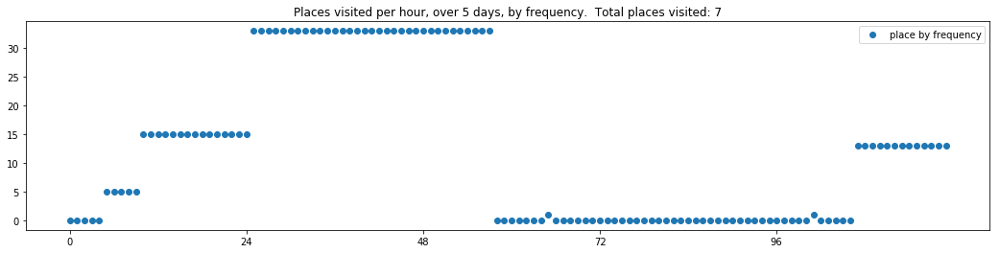

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437]
[437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437]


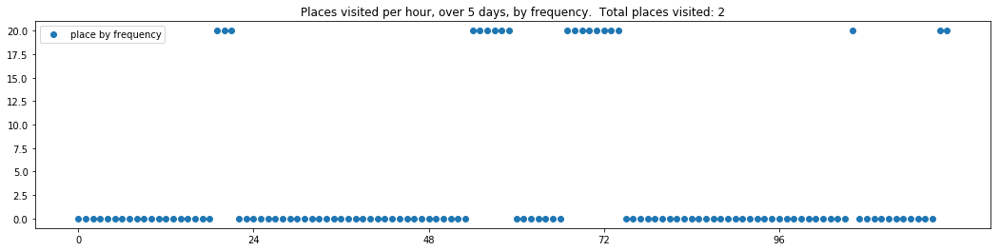

----- vector ----
prefix labels:  [515, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 164]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[637, 0, 0, 0, 0, 0, 278, 0, 0, 0, 0, 0, 0, 0, 278, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]


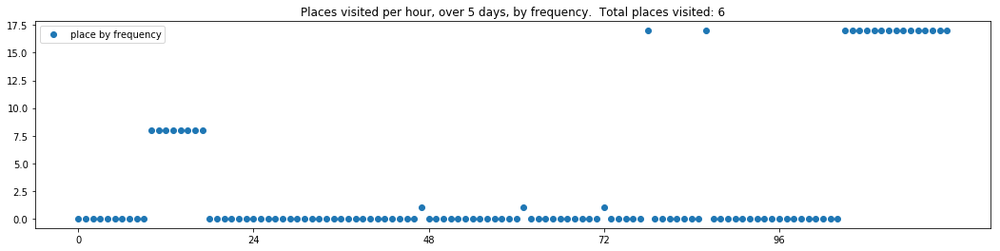

----- vector ----
prefix labels:  [637, 637]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 544, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 544, 544, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 38, 38, 38, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


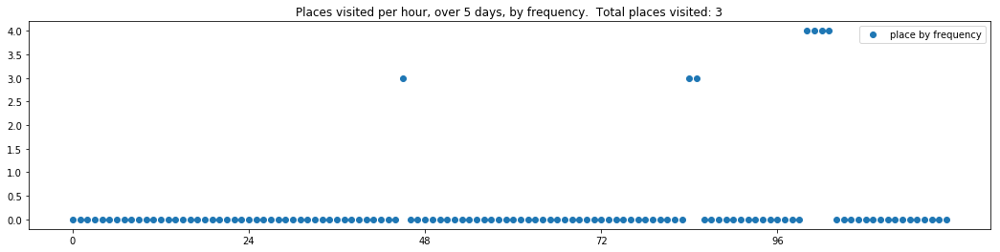

----- vector ----
prefix labels:  [404, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


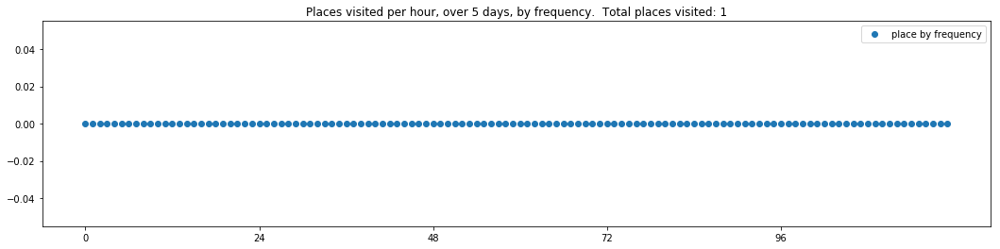

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0]
[0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]


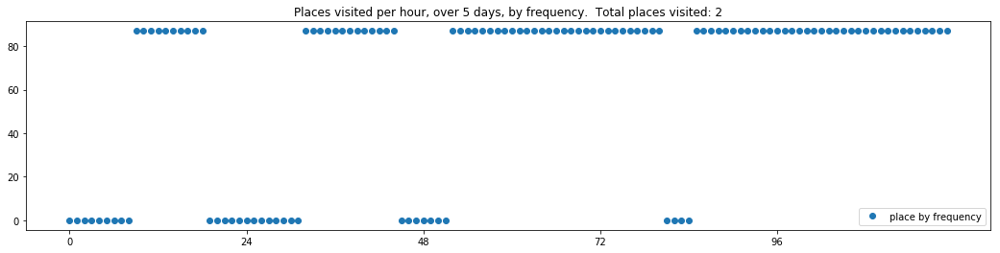

----- vector ----
prefix labels:  [11, 11]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21]
[0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 71, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21]
[11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11]
[11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11]


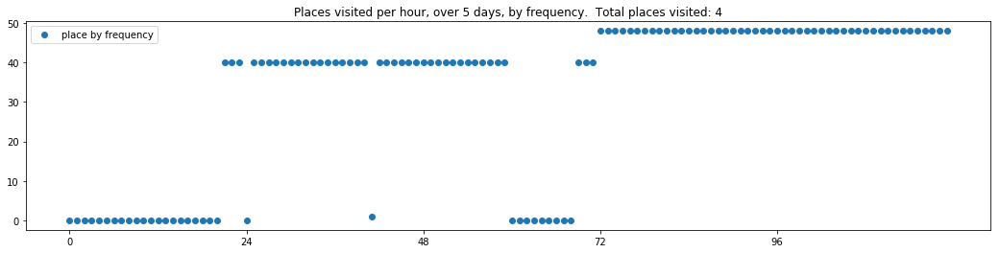

----- vector ----
prefix labels:  [341, 462]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 194, 0, 0, 0, 0, 341, 341, 341, 341, 341, 311, 311, 311]
[311, 311, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0, 341, 311, 311, 311, 311]
[0, 341, 341, 341, 341, 311, 311, 311, 311, 311, 311, 311, 311, 0, 0, 0, 0, 0, 341, 341, 0, 194, 194, 341]
[0, 19, 56, 56, 56, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 462]
[462, 462, 462, 462, 462, 462, 522, 522, 390, 390, 390, 390, 390, 390, 390, 341, 341, 341, 311, 311, 507, 507, 507, 311]


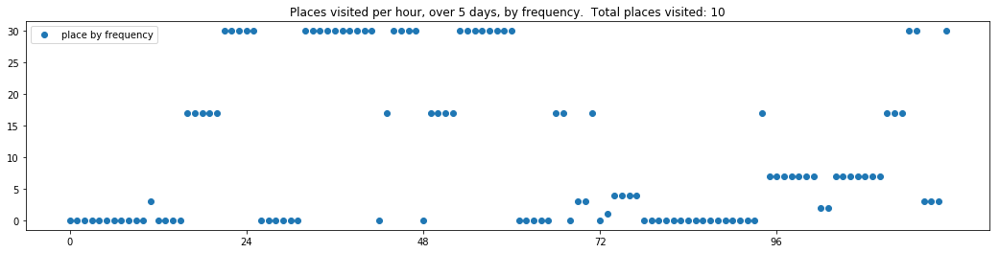

----- vector ----
prefix labels:  [376, 376]
[376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376]
[376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376]
[376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376]
[376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376]
[376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376, 376]


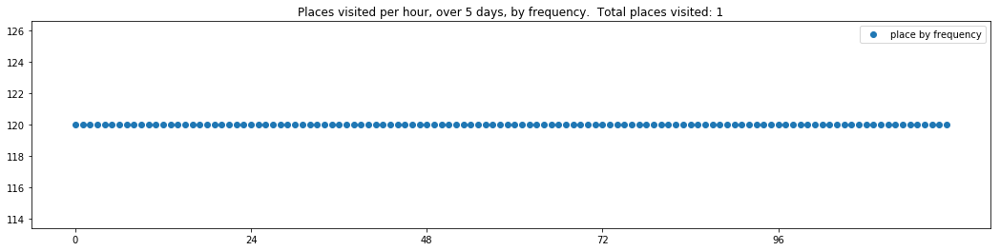

----- vector ----
prefix labels:  [130, 0]
[0, 0, 0, 68, 68, 0, 0, 0, 130, 130, 130, 0, 0, 0, 130, 0, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 130, 0, 130, 130, 130, 130, 130, 0, 0, 0, 0, 130, 0, 0, 0, 130, 130, 130, 130]
[130, 130, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 130, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 0, 0, 0, 20, 0, 130, 130, 130, 0, 0, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 0, 130]


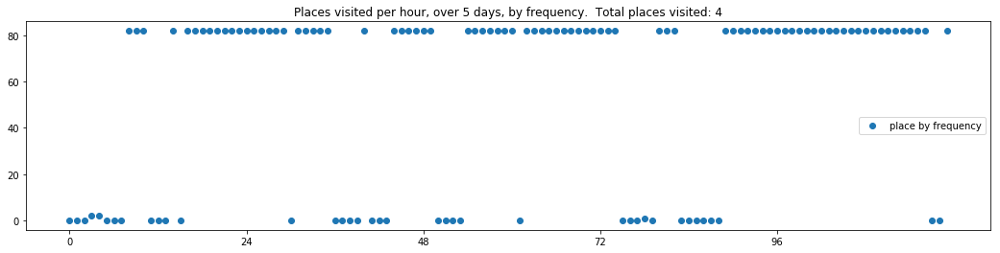

----- vector ----
prefix labels:  [165, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 289, 289, 289, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 165, 165, 165, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 289, 289]


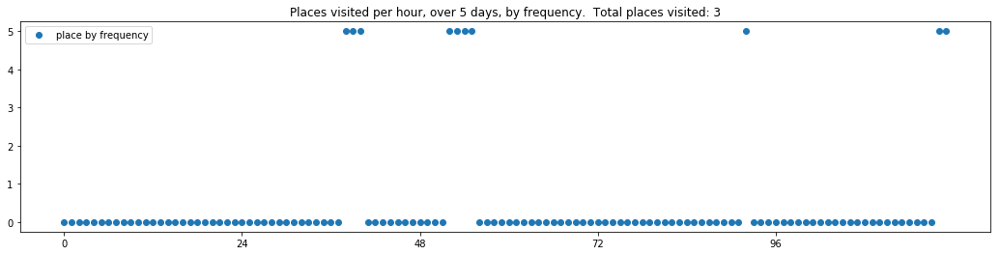

----- vector ----
prefix labels:  [507, 507]
[0, 0, 0, 0, 507, 0, 0, 0, 0, 0, 0, 0, 507, 507, 0, 0, 0, 507, 0, 0, 0, 0, 0, 507]
[507, 507, 507, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 573, 0, 507, 507, 507, 507, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 507, 507, 0, 507, 507]
[507, 507, 507, 507, 0, 0, 0, 507, 0, 0, 507, 507, 507, 0, 0, 507, 0, 507, 0, 0, 0, 0, 0, 0]
[0, 303, 0, 0, 0, 0, 303, 303, 303, 0, 0, 507, 507, 0, 0, 0, 0, 507, 0, 0, 0, 507, 507, 507]


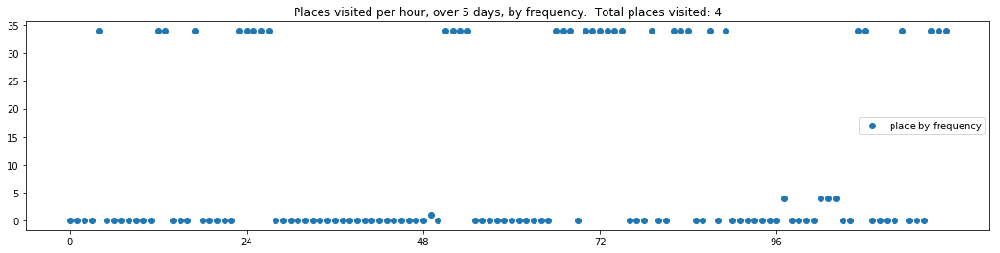

----- vector ----
prefix labels:  [308, 110]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 500, 500, 500, 629, 95, 599, 599]


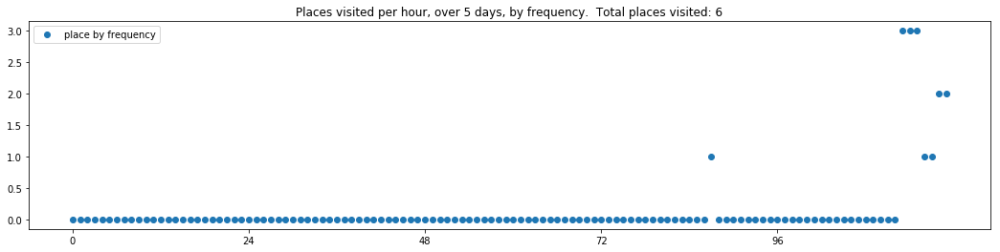

----- vector ----
prefix labels:  [109, 109]
[0, 0, 0, 0, 0, 0, 0, 109, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 48, 109, 109, 109, 0]
[0, 0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109, 109, 0, 0, 0, 0]
[0, 0, 0, 247, 109, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109]
[109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


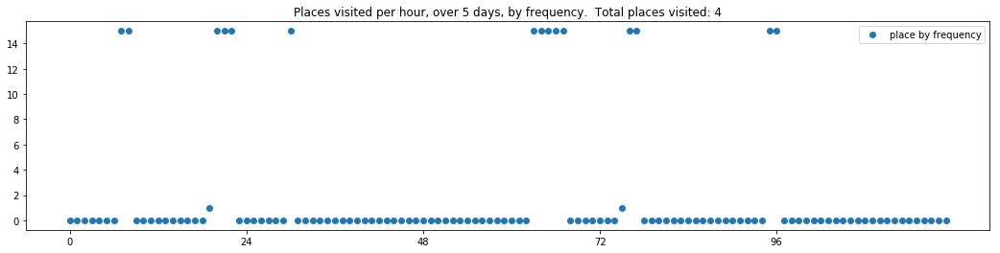

----- vector ----
prefix labels:  [361, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 122, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


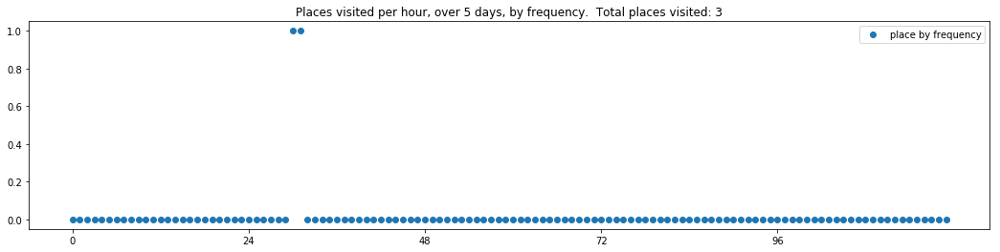

----- vector ----
prefix labels:  [268, 268]
[0, 0, 0, 0, 0, 21, 21, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


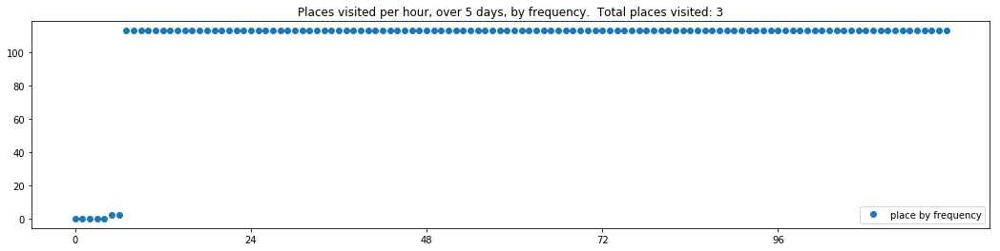

----- vector ----
prefix labels:  [268, 268]
[0, 0, 0, 0, 0, 0, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


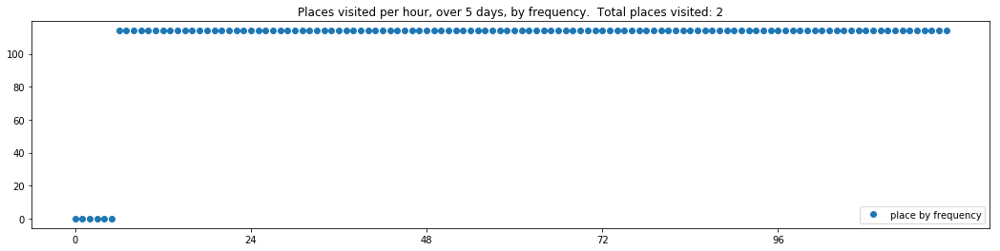

----- vector ----
prefix labels:  [150, 180]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 105, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150]
[150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 150, 617, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 180, 180, 105, 105, 105, 105]
[105, 105, 0, 20, 180, 180, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[150, 150, 150, 150, 150, 150, 150, 150, 150, 270, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


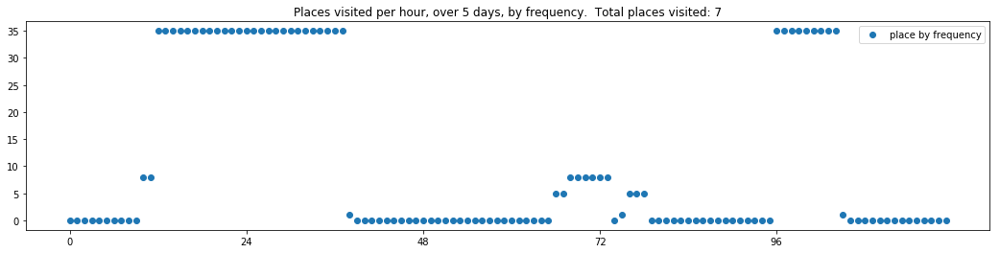

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 0, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 413, 413, 412, 412, 412, 0, 0, 0, 413, 0, 0, 0, 0, 413, 413, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 413, 413, 413, 413, 413, 412, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 413, 412, 412, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0]


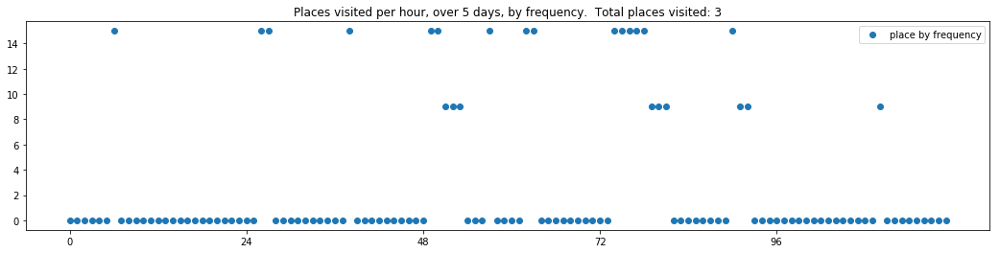

----- vector ----
prefix labels:  [295, 5]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 488, 488, 488, 488, 0, 0, 0, 0, 0, 0, 6, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 488]


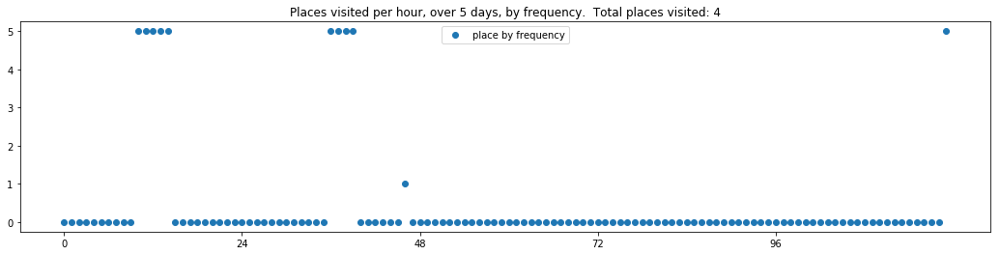

----- vector ----
prefix labels:  [502, 502]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 0, 0, 502, 502, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 502, 502, 502, 502, 502, 502, 0, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502]


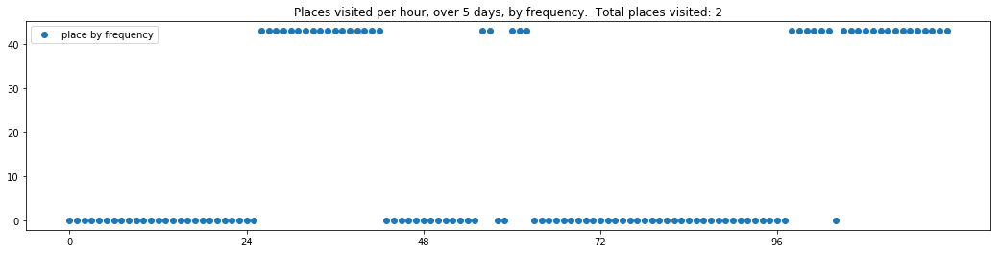

----- vector ----
prefix labels:  [457, 484]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 484, 484, 484, 484, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 0]
[0, 0, 0, 0, 0, 0, 484, 484, 484, 484, 401, 457, 484, 484, 0, 334, 334, 334, 334, 334, 334, 506, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


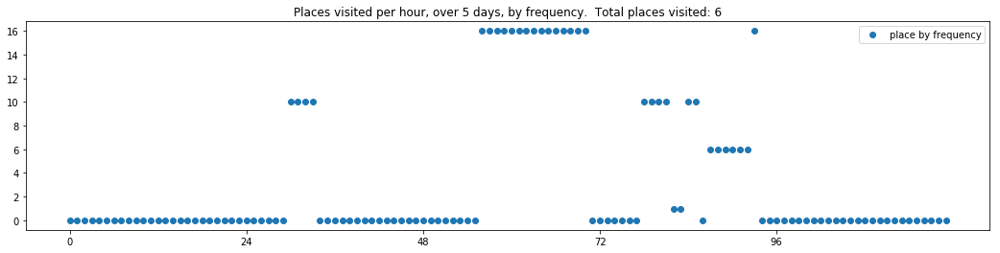

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 0, 0, 0, 0, 0, 0, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]


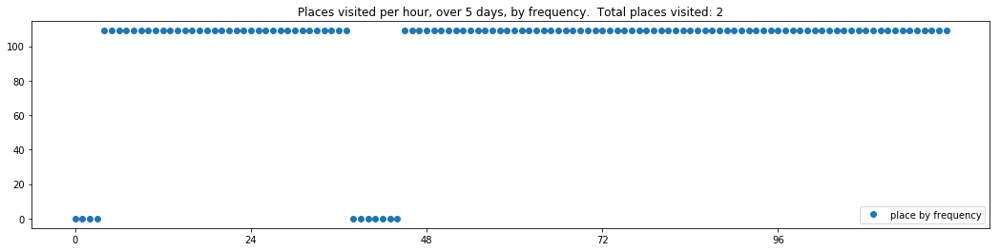

----- vector ----
prefix labels:  [531, 433]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433, 433, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 296, 296, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


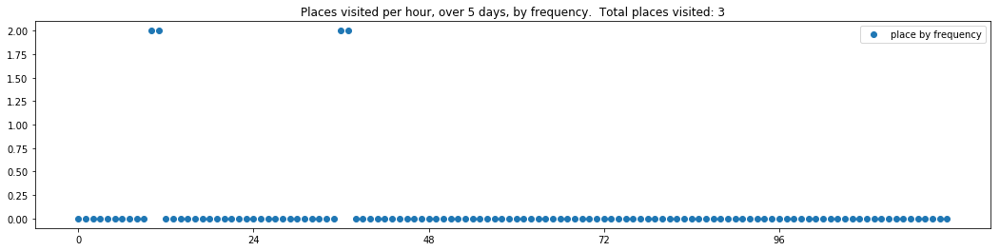

----- vector ----
prefix labels:  [182, 0]
[0, 0, 0, 0, 122, 0, 0, 0, 0, 0, 0, 0, 71, 0, 182, 182, 182, 182, 182, 182, 0, 182, 182, 182]
[182, 182, 182, 182, 182, 0, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 182, 182, 182, 182]
[182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 0]


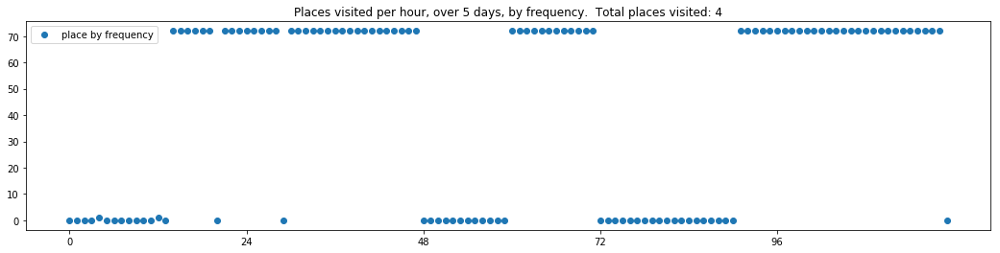

----- vector ----
prefix labels:  [245, 245]
[0, 0, 0, 0, 0, 0, 0, 0, 245, 245, 0, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245]
[245, 245, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 245, 245, 245, 245, 245, 245, 245, 55, 245, 245, 245, 245]
[245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245]
[245, 245, 69, 0, 0, 322, 322, 322, 322, 322, 322, 322, 364, 322, 322, 322, 322, 322, 87, 617, 291, 52, 0, 415]
[415, 415, 415, 0, 0, 559, 453, 453, 453, 453, 453, 453, 453, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245, 245]


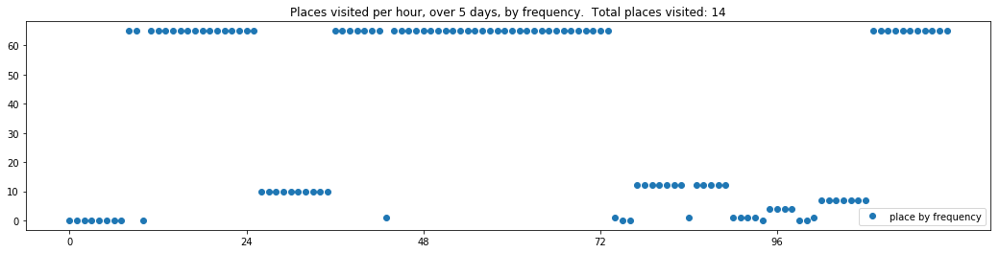

----- vector ----
prefix labels:  [475, 475]
[0, 0, 0, 0, 0, 357, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 76, 76, 76, 0, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]


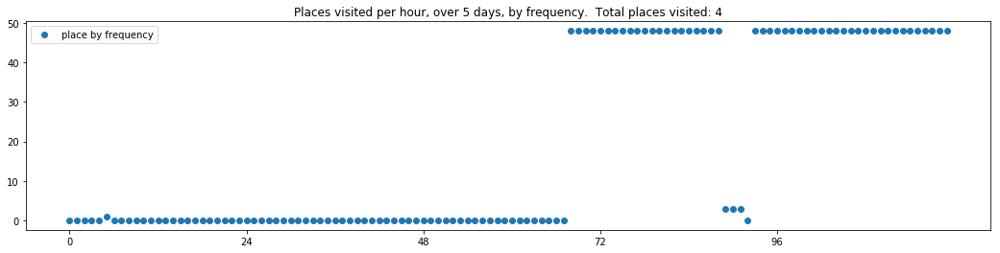

----- vector ----
prefix labels:  [433, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304]
[304, 304, 313, 313, 313, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 433, 0, 433, 433, 433, 433]
[433, 433, 0, 433, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 309, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 313, 391, 433, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]


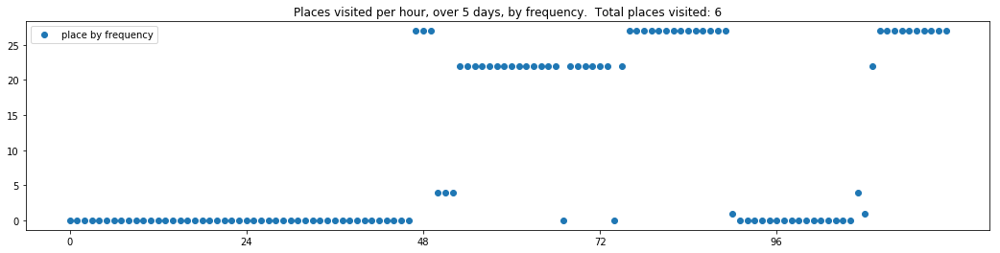

----- vector ----
prefix labels:  [620, 620]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 309, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 296, 296, 296, 296]
[611, 611, 611, 611, 611, 611, 611, 0, 0, 0, 0, 0, 0, 0, 0, 0, 389, 304, 304, 304, 522, 522, 304, 304]
[304, 304, 304, 0, 0, 0, 0, 0, 0, 0, 0, 611, 611, 611, 611, 611, 304, 304, 304, 304, 0, 0, 0, 0]
[0, 620, 304, 304, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 165, 165, 0, 0, 0, 0, 309]


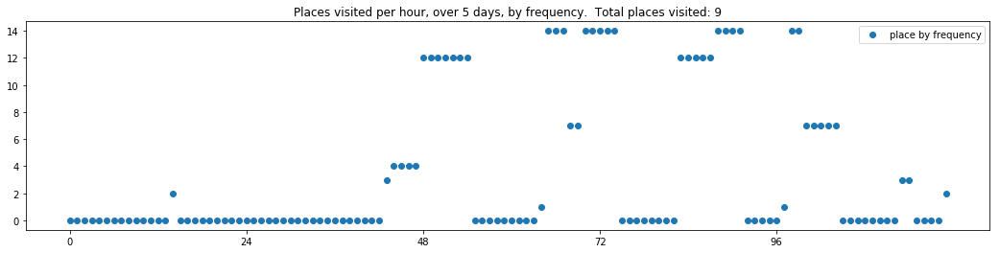

----- vector ----
prefix labels:  [108, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 108, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 108, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


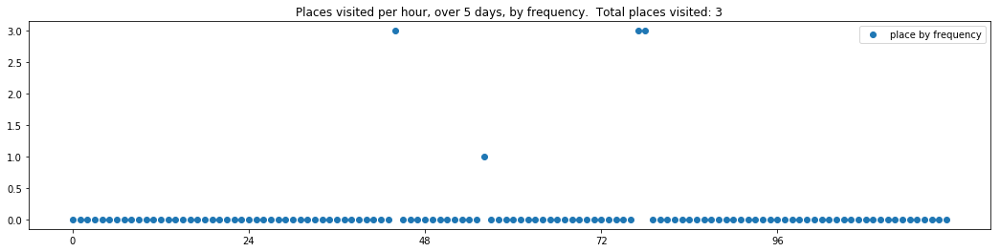

----- vector ----
prefix labels:  [10, 10]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0, 311, 311, 311, 311, 0, 311]
[311, 311, 311, 311, 0, 434, 434, 434, 434, 434, 434, 434, 215, 215, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0]


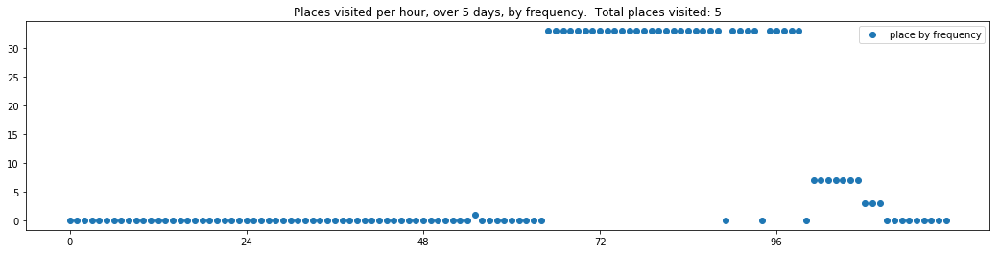

----- vector ----
prefix labels:  [448, 448]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 448, 448]
[448, 448, 448, 448, 448, 448, 448, 448, 448, 448, 448, 448, 448, 426, 426, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


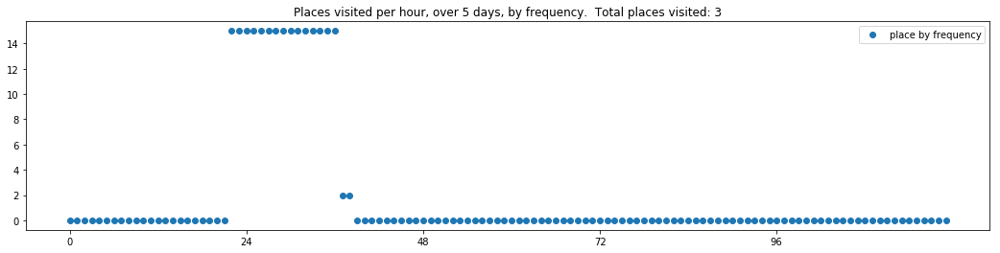

----- vector ----
prefix labels:  [38, 69]
[0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 31, 31, 31, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 203]
[203, 203, 203, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 39, 39, 140, 140, 140, 0, 34, 34, 34, 34, 214, 214, 214, 214, 214, 182, 182, 182]
[182, 182, 182, 182, 182, 182, 182, 182, 140, 204, 204, 204, 204, 204, 151, 151, 204, 204, 204, 204, 204, 204, 204, 204]


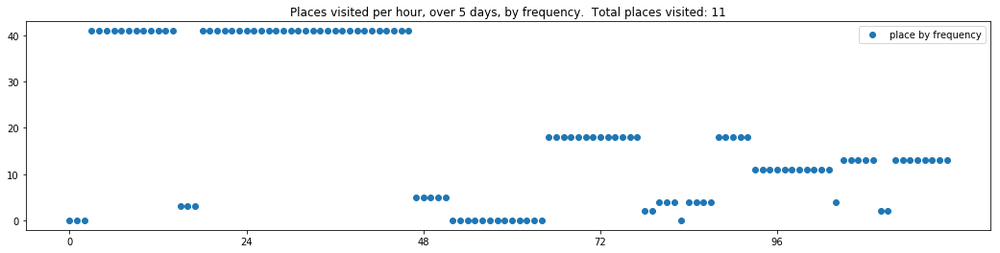

----- vector ----
prefix labels:  [97, 97]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


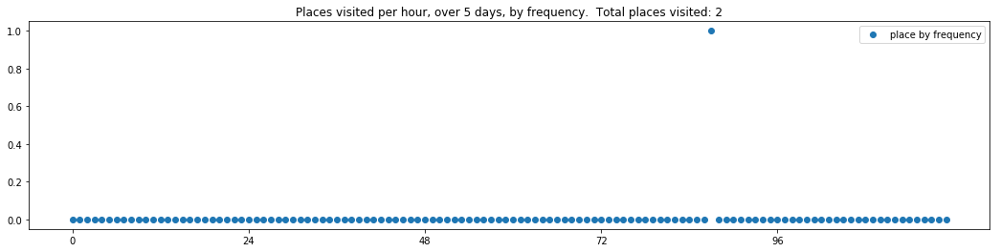

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 0, 389, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 205, 205, 205, 205, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


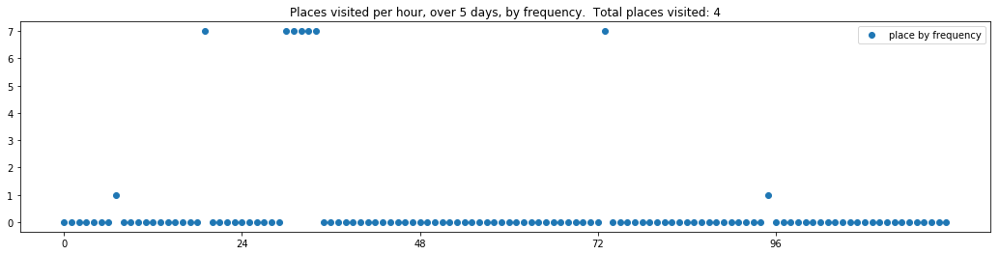

----- vector ----
prefix labels:  [200, 291]
[0, 0, 0, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 33, 33, 33, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 69, 0, 0, 0, 640, 640, 640, 640, 0, 200, 392, 392, 392, 0, 0, 0, 415, 415, 415, 415, 415, 415]
[0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 285, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 415, 415, 415, 415, 415, 415, 415, 415, 415, 415, 0]


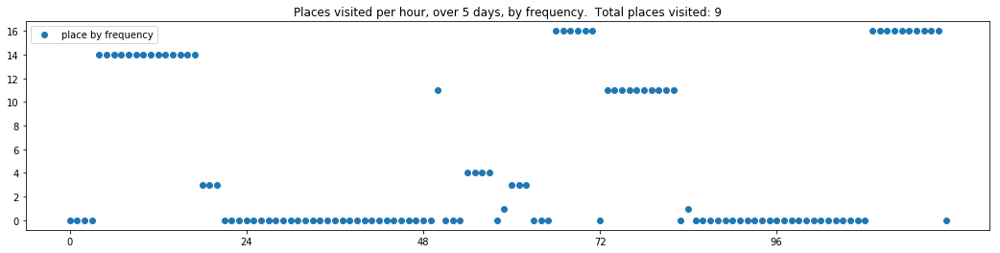

----- vector ----
prefix labels:  [39, 39]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39]
[39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 0, 0, 0, 0, 0]
[0, 0, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 39, 39, 39, 39, 39, 39]
[39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 187, 39, 39, 71, 71, 71, 0, 0, 0, 39, 39]
[39, 39, 39, 71, 71, 71, 71, 71, 71, 71, 0, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39, 39]


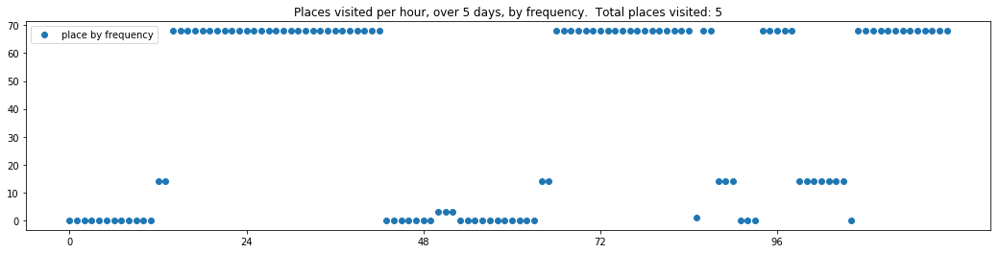

----- vector ----
prefix labels:  [488, 205]
[0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 582, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]


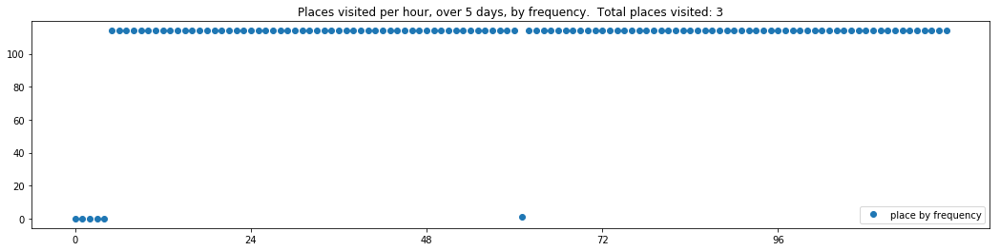

----- vector ----
prefix labels:  [548, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 548, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 379, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


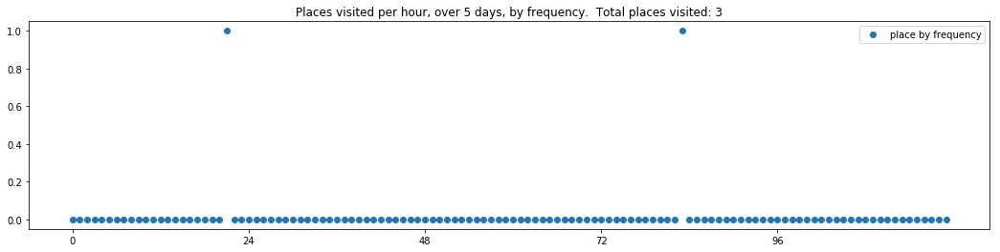

----- vector ----
prefix labels:  [190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]


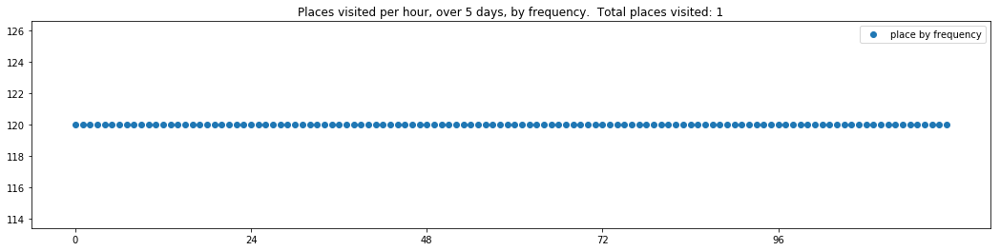

----- vector ----
prefix labels:  [304, 304]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]


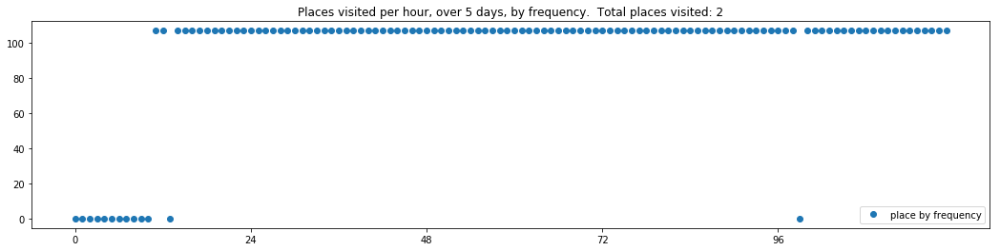

----- vector ----
prefix labels:  [524, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 339, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


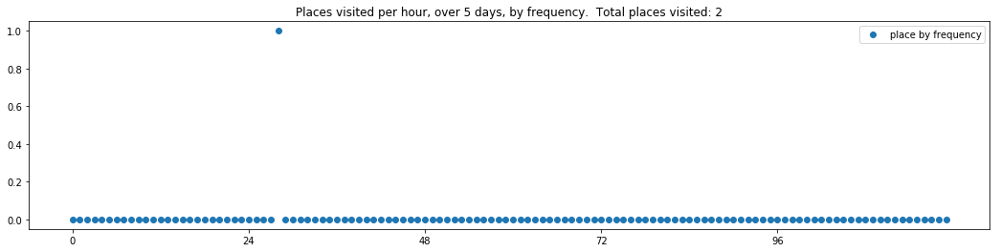

----- vector ----
prefix labels:  [423, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 84, 84]
[41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 423, 423, 423, 423, 423]
[423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 388, 388, 388, 388, 388, 388, 423, 423, 423, 423, 423, 423, 423]
[423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423]


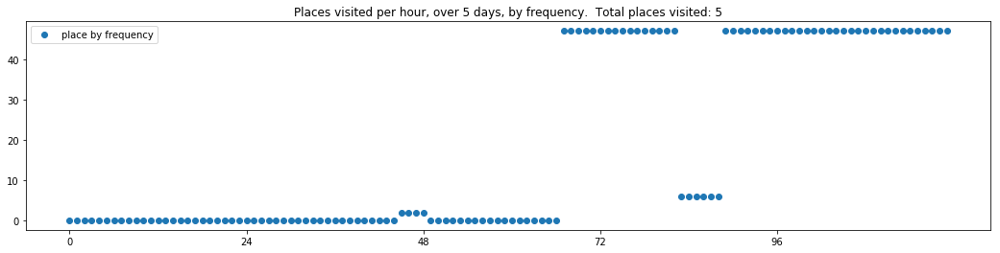

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 44, 0, 0, 0, 0, 0, 0, 44, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 251]


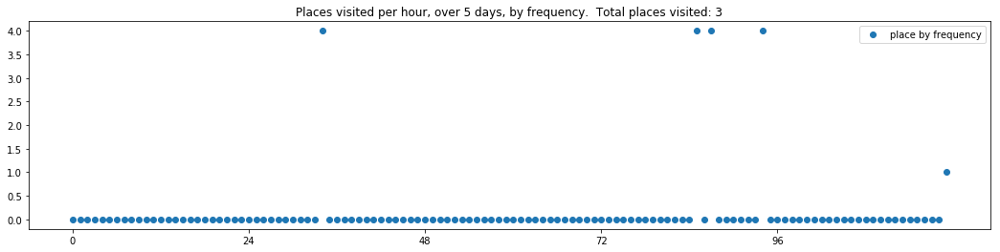

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 119, 119, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


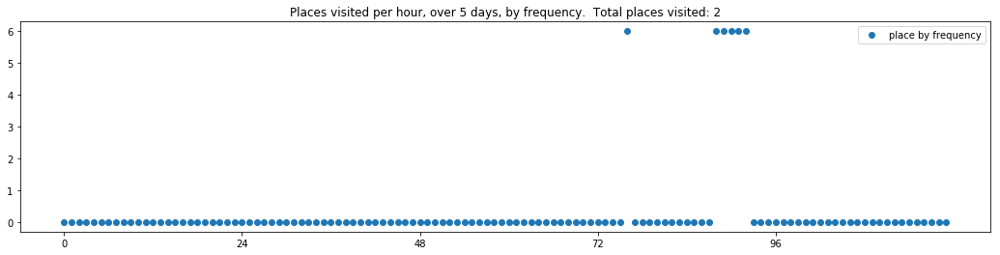

----- vector ----
prefix labels:  [479, 88]
[0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 431, 431, 431, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[431, 431, 431, 431, 0, 0, 410, 410, 410, 76, 76, 76, 76, 76, 59, 59, 59, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 573, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 431, 431, 431, 431, 0, 0, 484]
[484, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 0, 0, 271, 0, 0, 431, 431, 431]


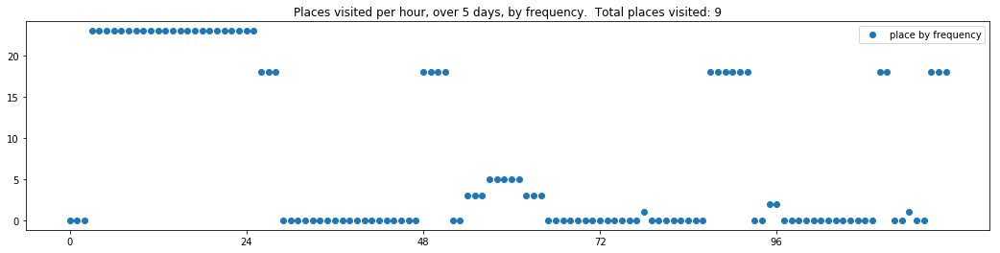

----- vector ----
prefix labels:  [126, 1]
[0, 0, 0, 0, 147, 147, 147, 147, 147, 147, 147, 147, 147, 0, 0, 184, 184, 184, 184, 184, 0, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


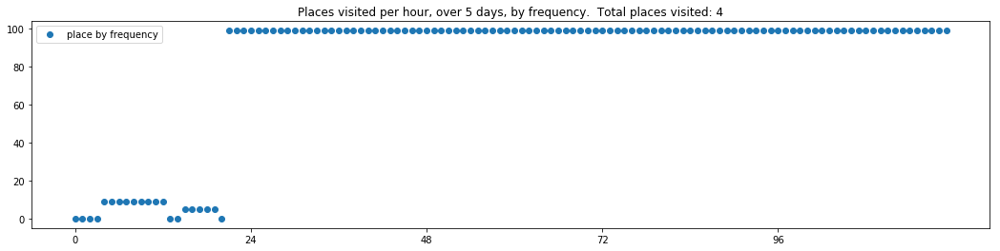

----- vector ----
prefix labels:  [270, 270]
[0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0]
[0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]


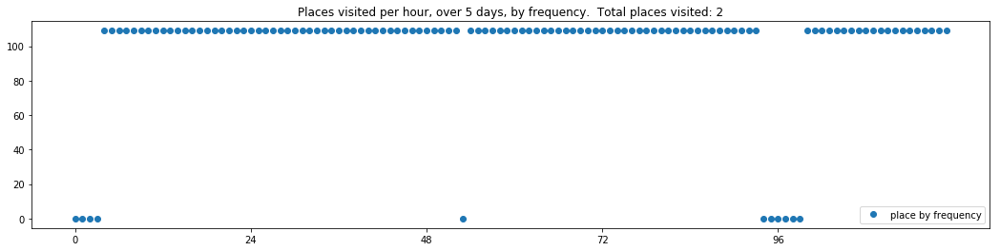


------
 80 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_80.txt 
------

----- vector ----
prefix labels:  [152, 353]
[0, 0, 0, 0, 0, 0, 0, 0, 130, 21, 21, 21, 21, 0, 0, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 0, 0, 0, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 0, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 130, 130]
[130, 130, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]


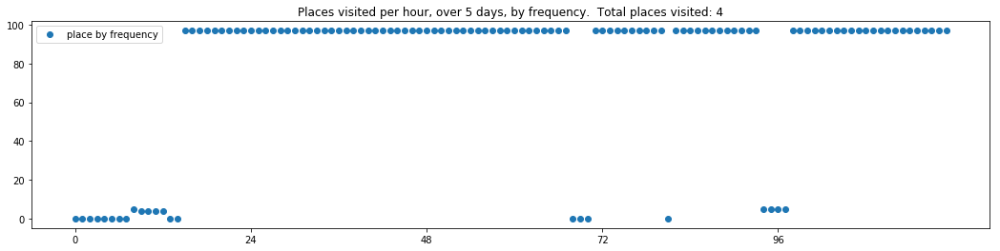

----- vector ----
prefix labels:  [44, 0]
[0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[0, 0, 0, 0, 0, 0, 0, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


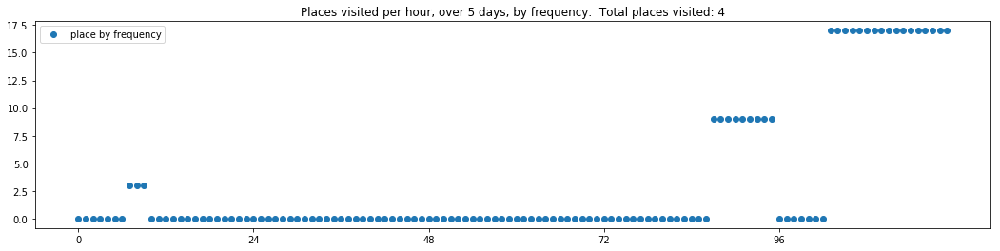

----- vector ----
prefix labels:  [177, 177]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 0, 0, 0, 0, 177]
[177, 177, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 16, 432, 76, 76, 76, 76, 76]
[76, 76, 76, 76, 76, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 117, 117, 0, 0, 0, 0, 0, 0, 552, 100, 0, 177, 177, 177, 0, 0, 0, 177, 177]


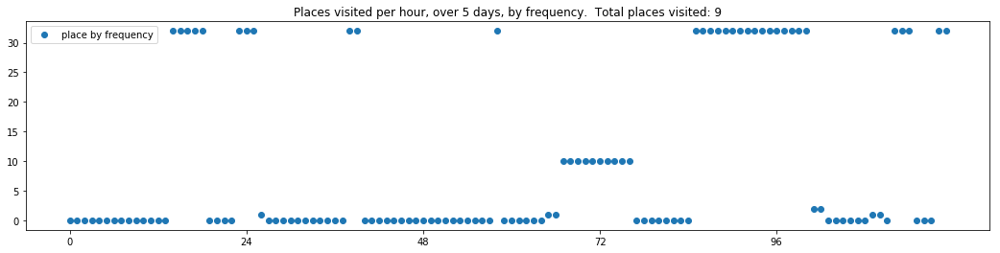

----- vector ----
prefix labels:  [180, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 180, 0, 40, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 0, 180, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


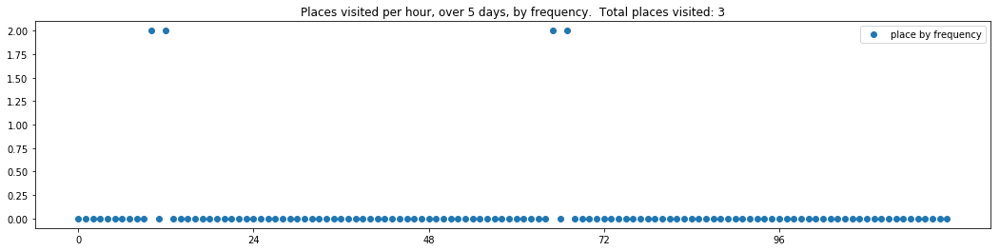

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271]
[0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]


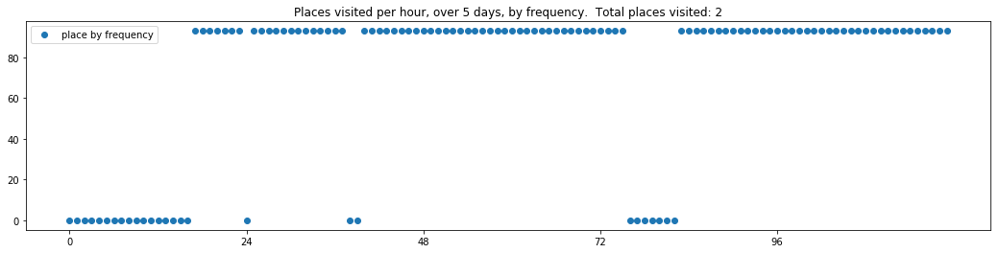

----- vector ----
prefix labels:  [431, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431]
[431, 431, 431, 431, 431, 0, 0, 0, 308, 0, 0, 0, 0, 0, 0, 0, 0, 0, 590, 590, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 0, 0, 0, 0, 0, 22, 22, 0, 0, 0, 0, 0, 0]
[460, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 351, 0, 0, 0, 0, 0, 0, 0]


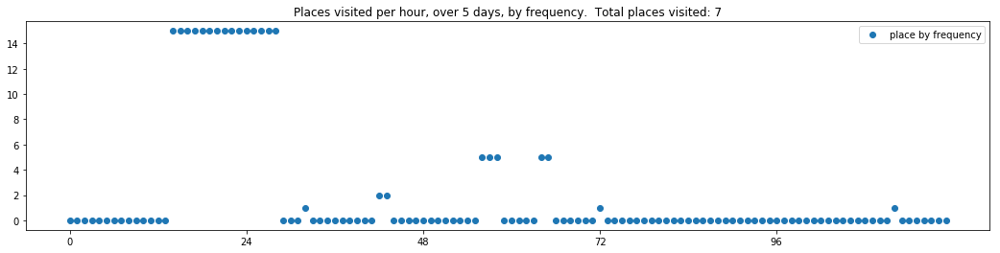

----- vector ----
prefix labels:  [78, 78]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 0, 214, 214, 214, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 202, 202, 202, 0, 0, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214]


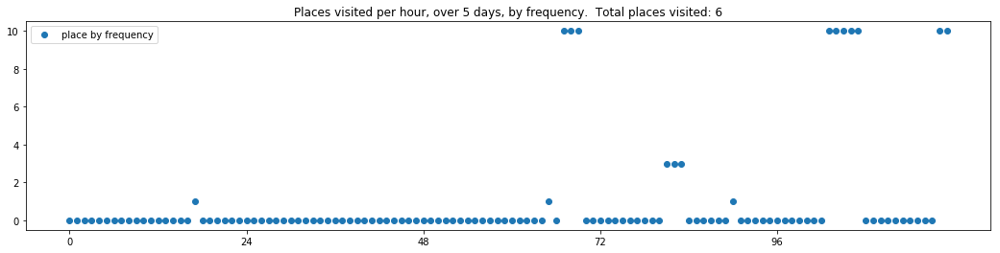

----- vector ----
prefix labels:  [487, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 487, 487, 487, 487, 487, 487, 487]
[487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487]
[487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 487, 0, 0, 0, 0]


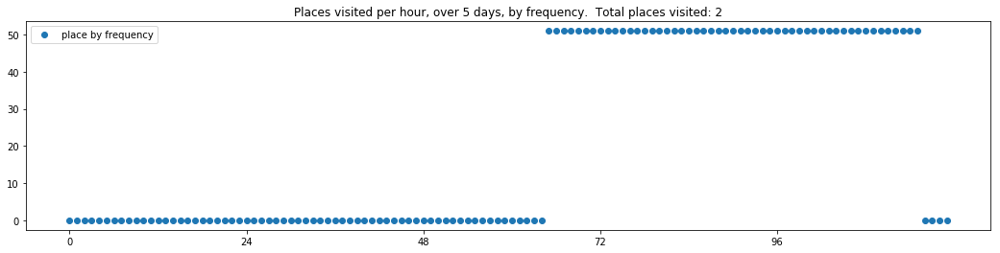

----- vector ----
prefix labels:  [365, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 288, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 317, 317, 317, 317]


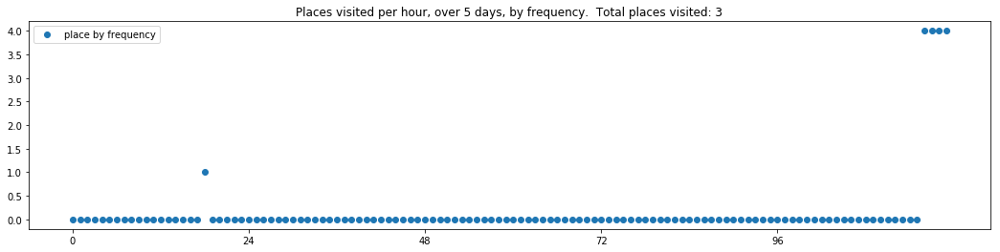

----- vector ----
prefix labels:  [384, 214]
[0, 0, 0, 0, 0, 0, 0, 29, 0, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 0, 8, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214]


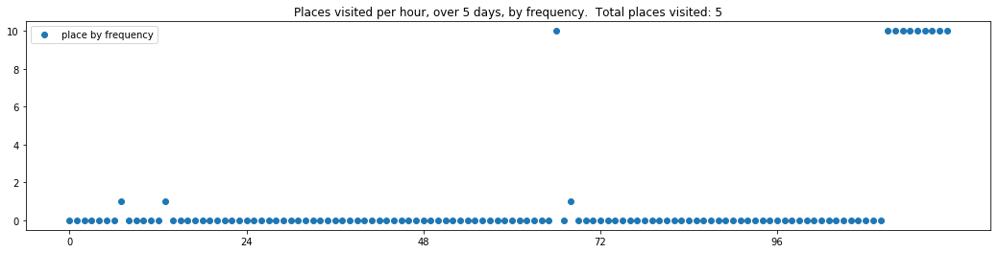

----- vector ----
prefix labels:  [10, 10]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 10, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


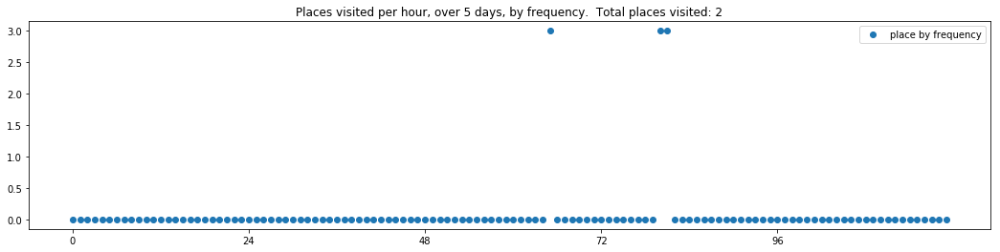

----- vector ----
prefix labels:  [580, 580]
[0, 0, 0, 0, 0, 0, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580]
[0, 0, 0, 0, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580]
[580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580]
[580, 580, 580, 580, 580, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580]


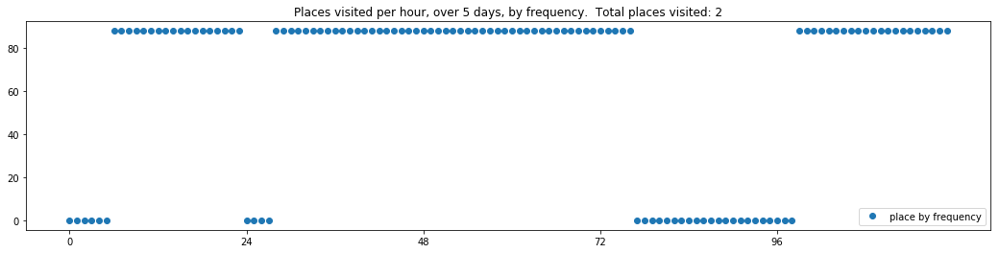

----- vector ----
prefix labels:  [453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 0, 4, 4, 4, 4, 4]
[4, 4, 453, 453, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 0, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453]


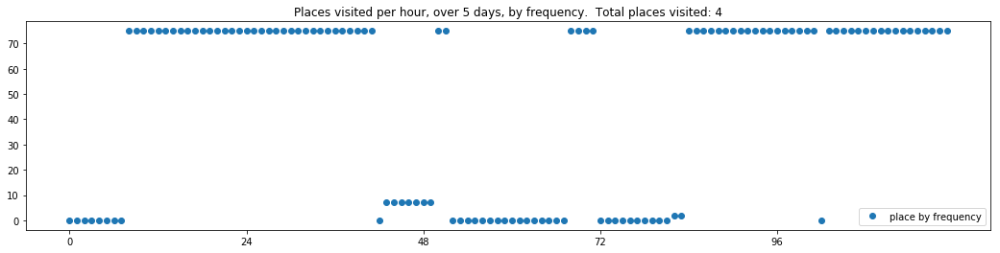

----- vector ----
prefix labels:  [309, 309]
[0, 0, 0, 0, 0, 0, 0, 0, 309, 309, 309, 309, 0, 0, 0, 0, 0, 0, 309, 309, 309, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 309, 309, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 309, 309, 309, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


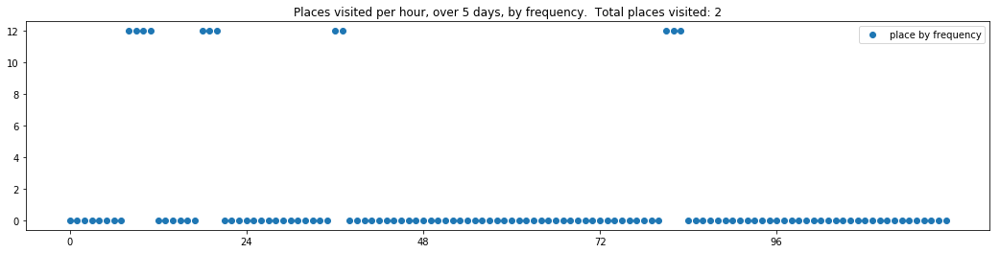

----- vector ----
prefix labels:  [498, 50]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 8]


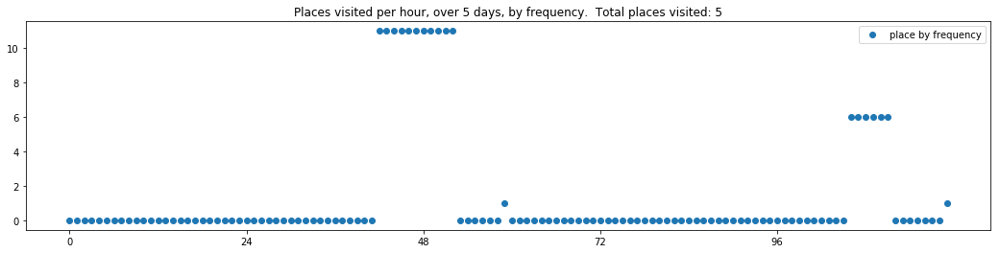

----- vector ----
prefix labels:  [149, 0]
[0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 0]
[0, 0, 0, 0, 0, 0, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 176, 176, 176, 176, 176, 176, 176, 199, 199, 199, 199, 199, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 184, 84, 84, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 84, 84, 424, 424, 424, 424, 0, 0, 0, 0, 0, 0, 0, 84, 84, 84, 84, 84]


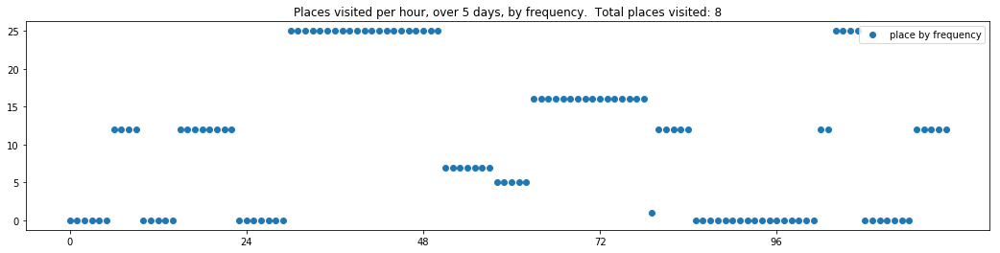

----- vector ----
prefix labels:  [199, 199]
[0, 0, 0, 0, 0, 199, 199, 199, 199, 199, 199, 199, 0, 0, 0, 0, 193, 193, 0, 0, 0, 0, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]


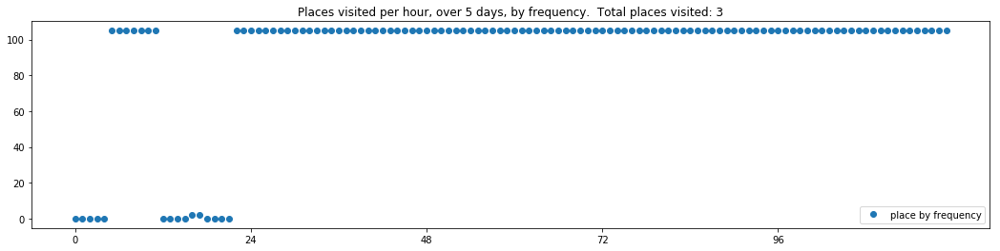

----- vector ----
prefix labels:  [178, 388]
[0, 0, 0, 0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 41, 41, 41, 41, 41, 41, 41, 41]


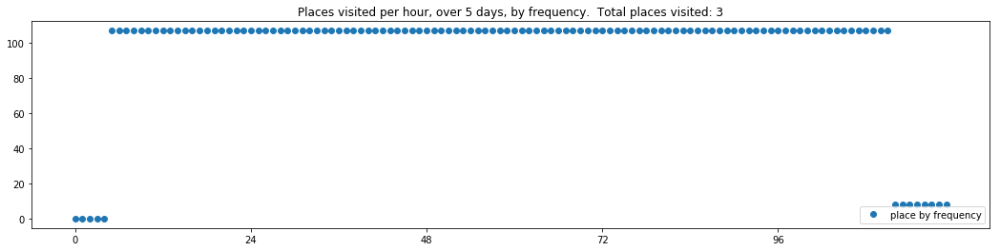

----- vector ----
prefix labels:  [120, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


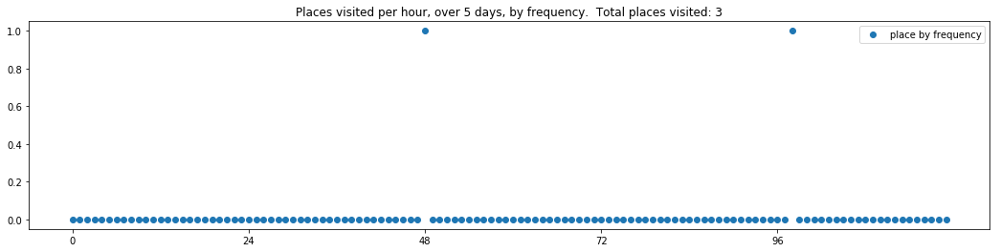

----- vector ----
prefix labels:  [424, 424]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 498, 498]


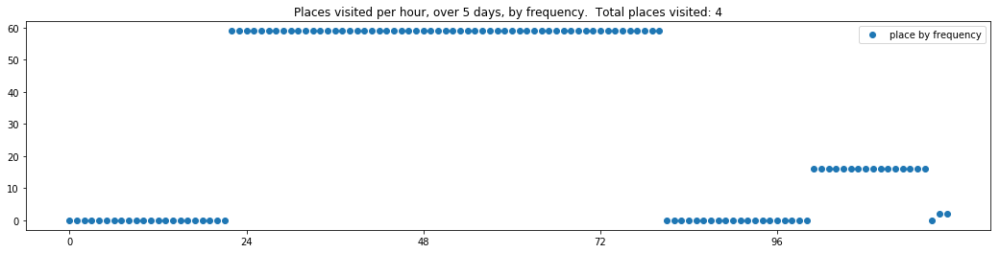

----- vector ----
prefix labels:  [227, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


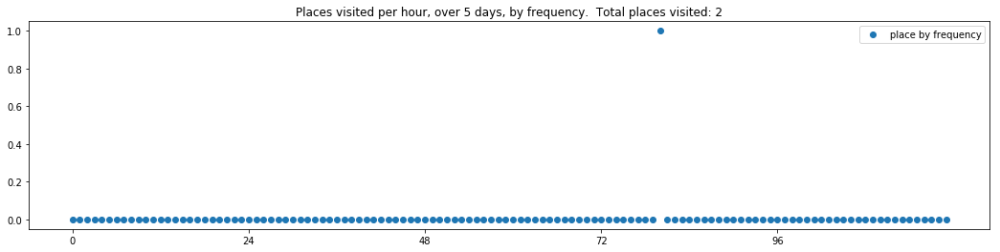

----- vector ----
prefix labels:  [112, 112]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 112, 112, 112, 112, 112, 112, 112, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 351, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


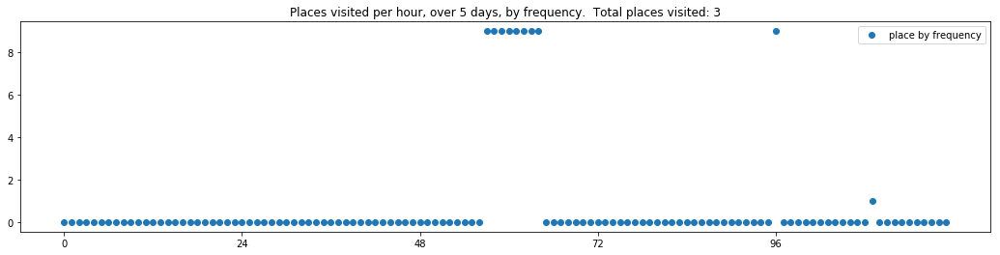

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 69, 0, 0, 33, 100, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 21]


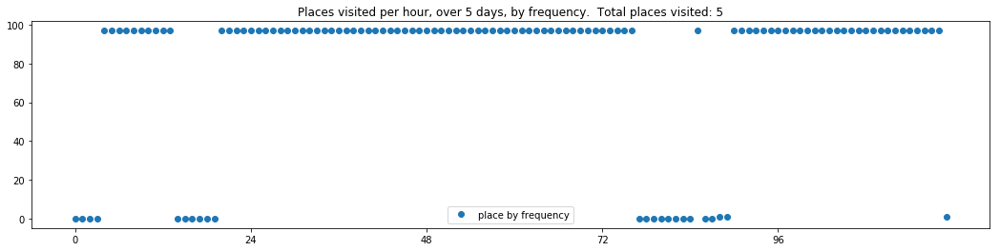

----- vector ----
prefix labels:  [307, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 271, 271, 271, 271, 21, 21, 21, 21, 416, 416, 416]
[20, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 21, 21, 21, 21, 21, 21, 384, 291, 0, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 416, 416, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 0, 0, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212, 212]


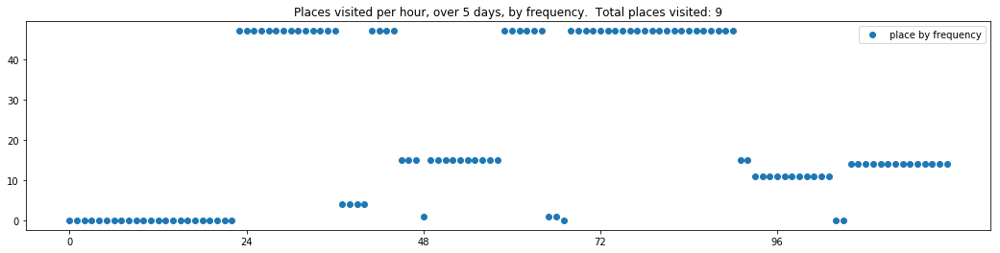

----- vector ----
prefix labels:  [402, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 21, 21, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 570, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 149, 21, 21, 21]
[21, 21, 21, 21, 55, 424, 424, 424, 424, 424, 41, 41, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21]


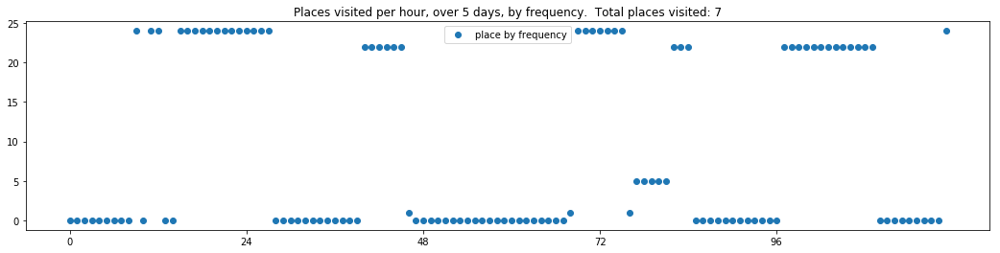

----- vector ----
prefix labels:  [353, 21]
[0, 0, 0, 0, 0, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 0, 0, 21, 21, 0, 21, 21, 21, 0, 353, 353, 353, 353, 353, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353]


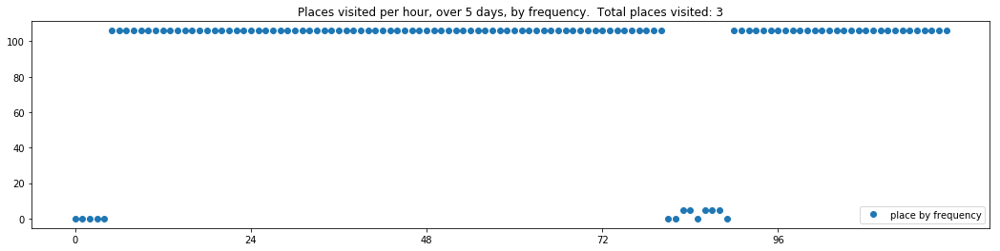

----- vector ----
prefix labels:  [84, 186]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84, 84, 0, 0, 0, 0, 0, 0, 0, 0, 84, 84]
[84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 32, 32, 32, 84, 84, 84, 84, 84]
[84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 0, 84]
[84, 84, 84, 84, 84, 84, 84, 84, 84, 84, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 71, 0, 0, 0, 0, 215]


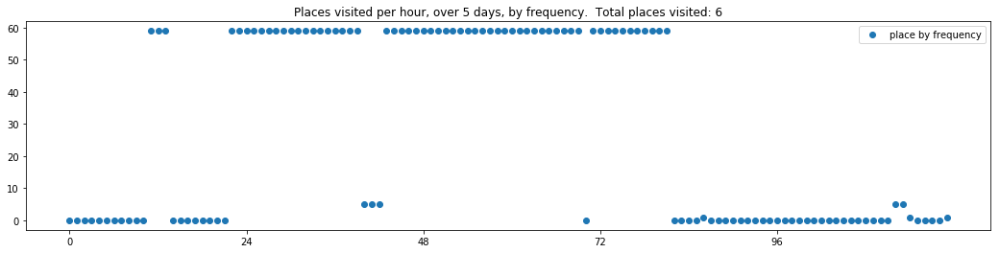

----- vector ----
prefix labels:  [342, 57]
[0, 0, 0, 0, 0, 68, 208, 208, 208, 0, 0, 0, 0, 0, 0, 0, 0, 20, 282, 282, 282, 282, 282, 282]
[282, 282, 282, 282, 282, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 208, 208, 0, 0, 0, 0, 0]
[342, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 0, 208, 208, 192, 192, 192, 0, 0, 0, 0, 0, 404, 342, 0, 0, 0, 0, 0]


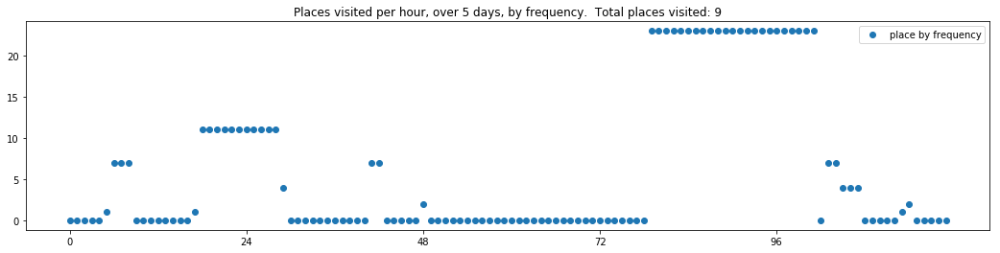

----- vector ----
prefix labels:  [416, 416]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]


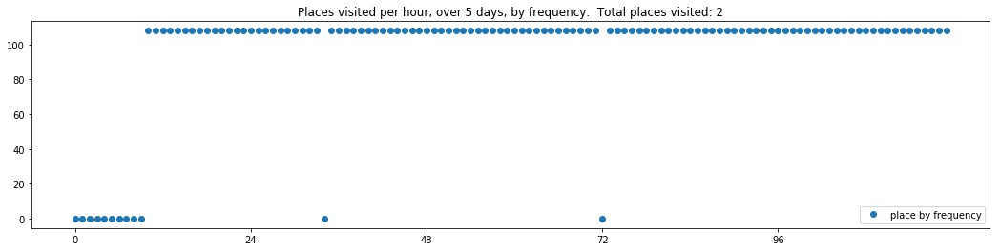

----- vector ----
prefix labels:  [153, 256]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 256, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459]
[459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 256, 256, 256, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 0, 459, 0, 0, 0, 0, 0, 0]
[0, 0, 153, 0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


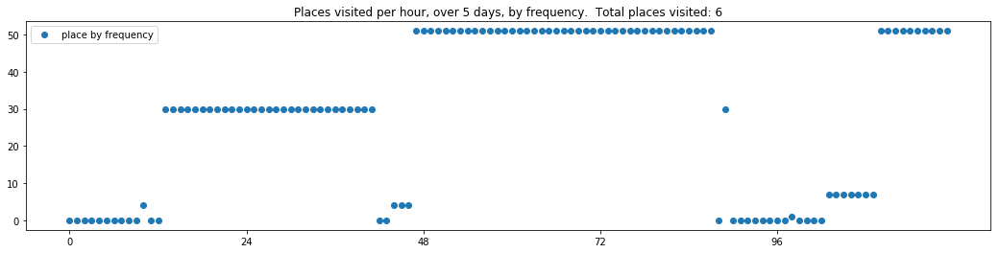

----- vector ----
prefix labels:  [291, 291]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 291, 291, 291, 291, 291, 291, 291, 291, 291, 291, 291, 291]


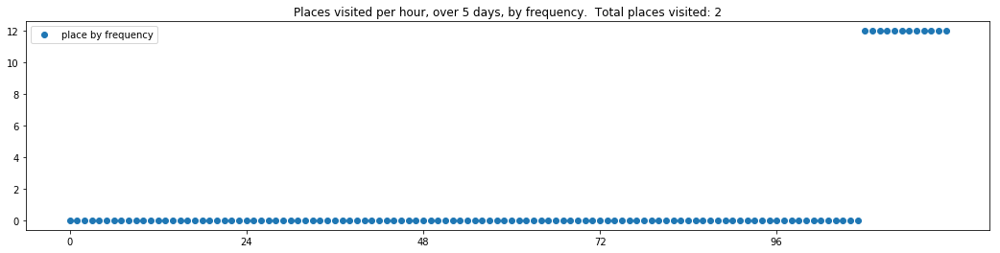

----- vector ----
prefix labels:  [475, 475]
[0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 475, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 0, 0, 0, 0, 0, 0, 70, 0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


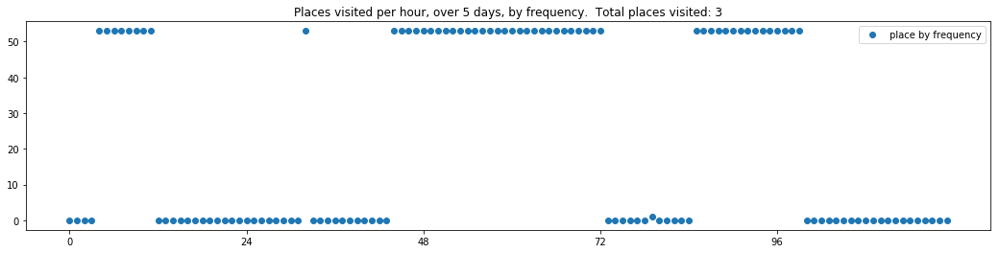

----- vector ----
prefix labels:  [522, 522]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 522, 522, 522]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522]
[522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 522, 0]


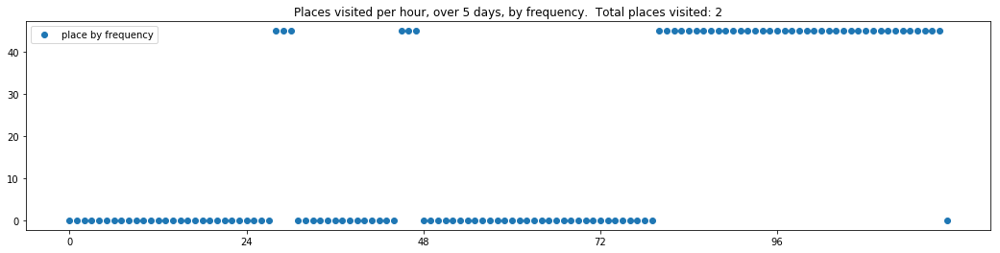

----- vector ----
prefix labels:  [250, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 250, 250, 250, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0]


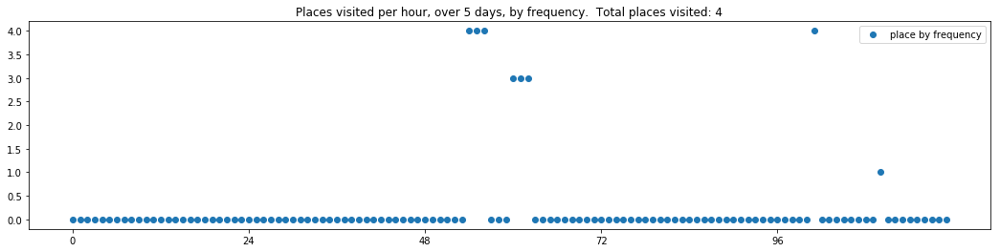

----- vector ----
prefix labels:  [192, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]


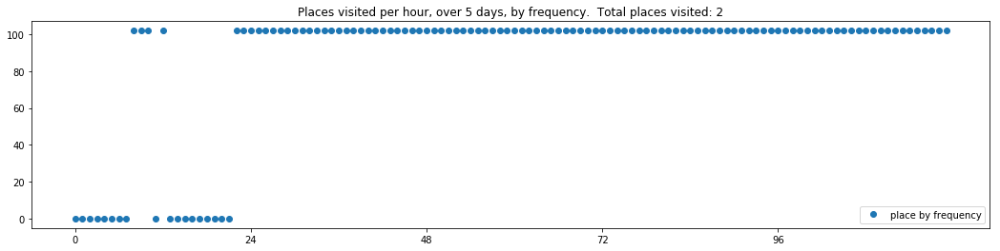

----- vector ----
prefix labels:  [260, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 33, 33, 33, 33, 0, 0, 0]
[0, 0, 0, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 0, 260, 260, 260, 260, 260, 260, 260]
[260, 0, 0, 20, 260, 260, 260, 260, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


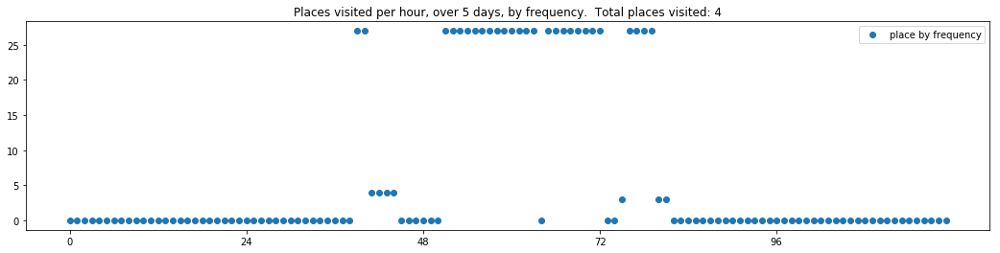

----- vector ----
prefix labels:  [544, 189]
[0, 0, 0, 0, 0, 544, 0, 0, 598, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 183, 183, 183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 544, 544, 544, 544, 544, 544, 544, 24, 24, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 122, 122, 544, 544, 544, 544, 544, 0, 0, 0, 0]


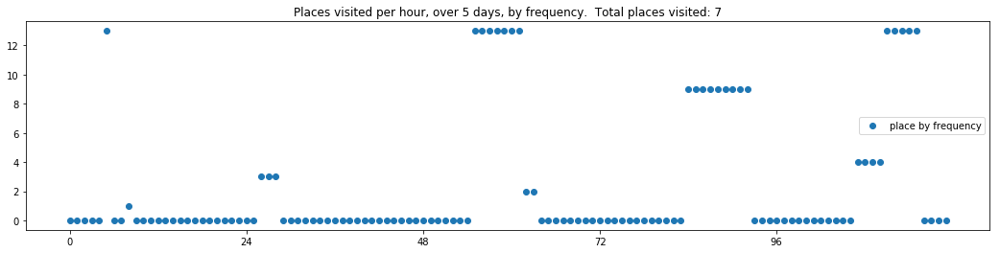

----- vector ----
prefix labels:  [391, 391]
[0, 0, 0, 0, 0, 0, 0, 311, 311, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 312, 312, 312, 312, 312, 0, 0, 0, 0, 0, 0, 0, 311, 311]
[311, 311, 311, 311, 391, 391, 391, 391, 391, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


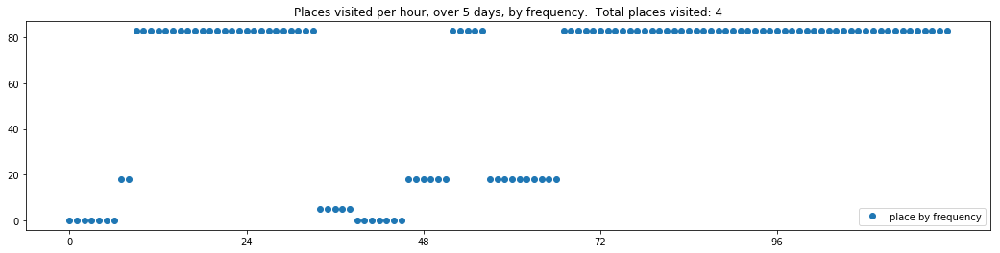

----- vector ----
prefix labels:  [231, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 297, 0, 0, 0, 0, 0, 0]
[94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


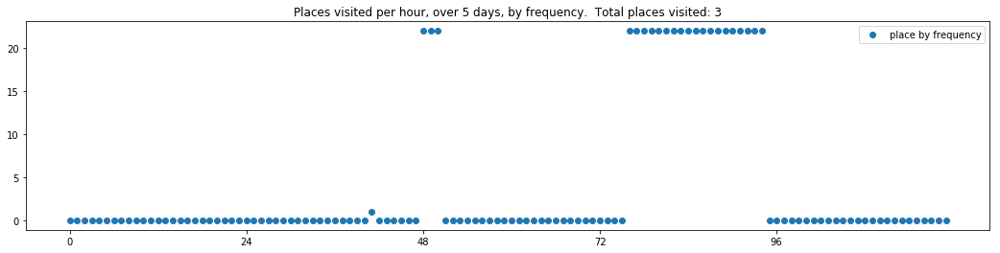

----- vector ----
prefix labels:  [426, 426]
[0, 0, 0, 0, 0, 0, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 426, 448, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[0, 0, 0, 426, 426, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


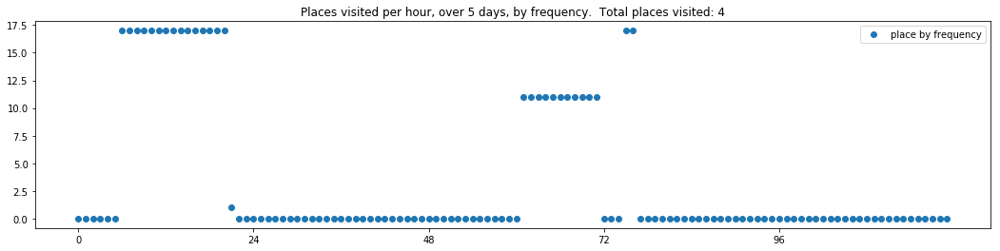

----- vector ----
prefix labels:  [0, 248]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 248]
[248, 248, 248, 248, 248, 248, 248, 248, 248, 0, 0, 0, 248, 248, 248, 248, 248, 248, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 248, 248]


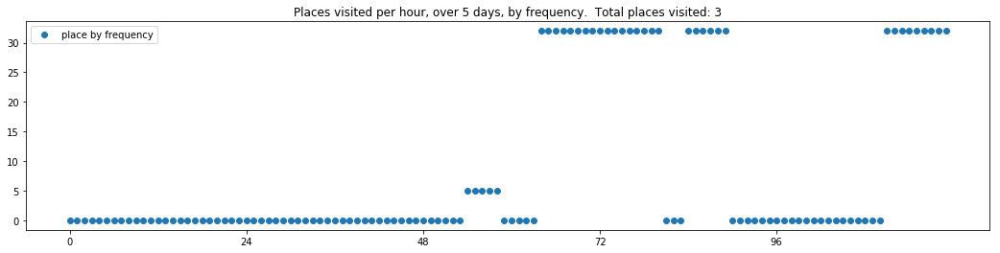

----- vector ----
prefix labels:  [498, 21]
[0, 0, 0, 0, 0, 0, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498]
[498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498, 498]
[498, 498, 498, 498, 498, 498, 498, 498, 41, 41, 41, 41, 41, 242, 41, 41, 41, 41, 41, 41, 41, 424, 424, 41]
[41, 41, 424, 424, 424, 302, 21, 21, 21, 21, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 424, 41, 424, 424]
[424, 424, 424, 424, 424, 424, 424, 133, 41, 41, 41, 424, 41, 291, 291, 291, 586, 586, 586, 586, 586, 586, 586, 0]


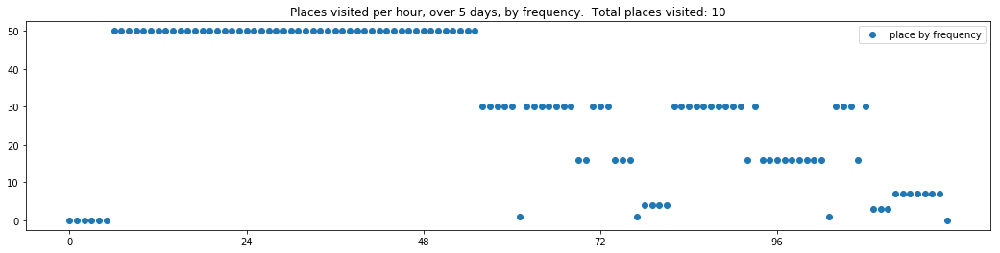

----- vector ----
prefix labels:  [32, 32]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32]
[32, 32, 32, 32, 32, 32, 32, 32, 31, 31, 32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 30, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


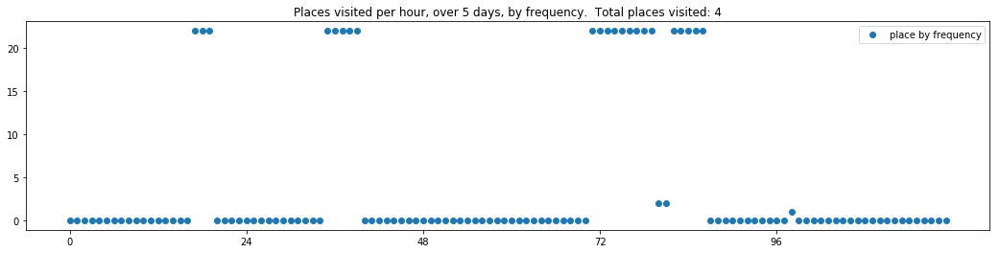

----- vector ----
prefix labels:  [581, 550]
[0, 0, 0, 0, 0, 0, 0, 550, 550, 550, 550, 0, 283, 550, 550, 213, 213, 213, 213, 213, 213, 213, 213, 213]
[213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 0, 0, 0, 0, 0, 0, 0, 213, 213, 213]
[213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213]
[213, 213, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 213, 213, 213, 213, 213, 213, 213, 213]
[213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


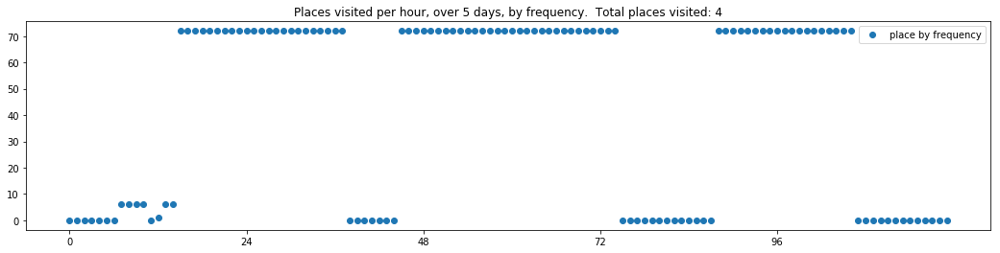

----- vector ----
prefix labels:  [285, 285]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 353]
[353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]
[285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 477, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]


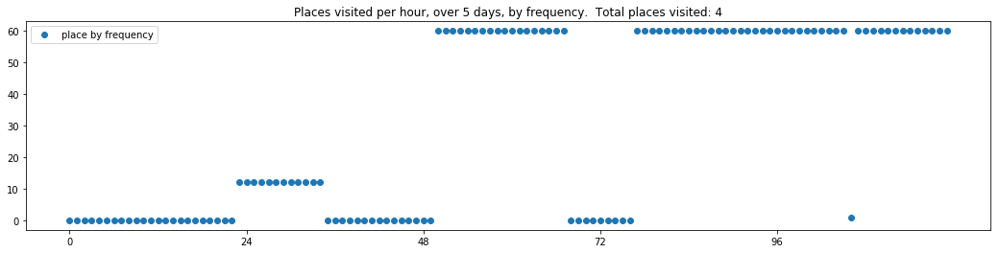

----- vector ----
prefix labels:  [620, 620]
[0, 0, 0, 165, 489, 489, 304, 304, 578, 578, 578, 578, 578, 578, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 0, 0, 0, 0, 0, 304, 304, 304, 304, 522, 522, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 489, 489, 489, 489, 304, 304, 304, 304, 304, 304]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 0, 304, 304, 304, 304, 304, 304, 578, 578, 578, 311]


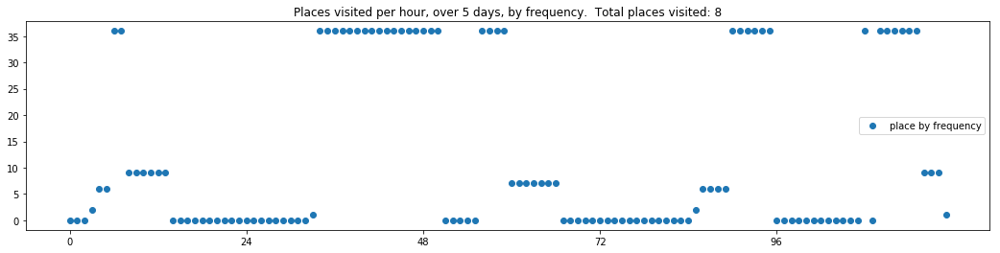

----- vector ----
prefix labels:  [191, 548]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


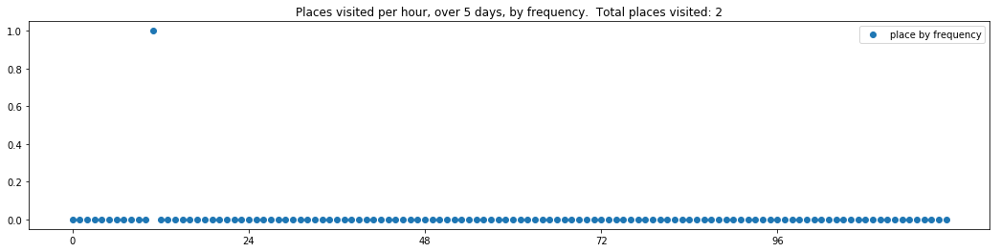

----- vector ----
prefix labels:  [94, 94]
[0, 0, 0, 0, 0, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218, 218, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 539, 0, 0, 0, 0, 0, 0, 539, 0, 218, 0, 218, 539, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 318, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 94, 94, 0, 0, 0, 218, 218, 218, 218, 218, 218, 0, 0, 539, 539, 539, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 94, 0, 0, 0, 218, 0, 218, 218, 218, 218, 0, 218, 218, 218, 218, 218, 218, 218, 218, 218]


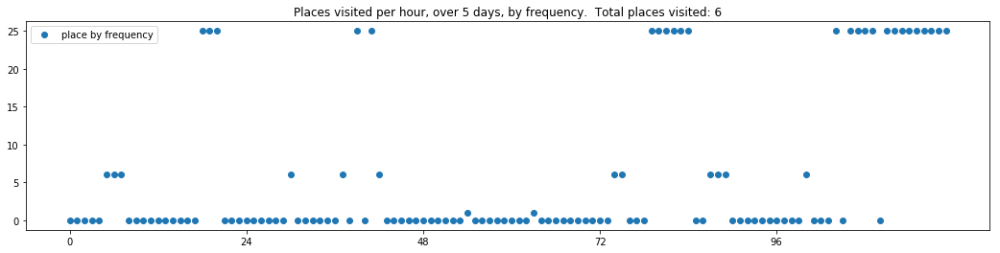

----- vector ----
prefix labels:  [406, 406]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 0, 0, 0, 0]


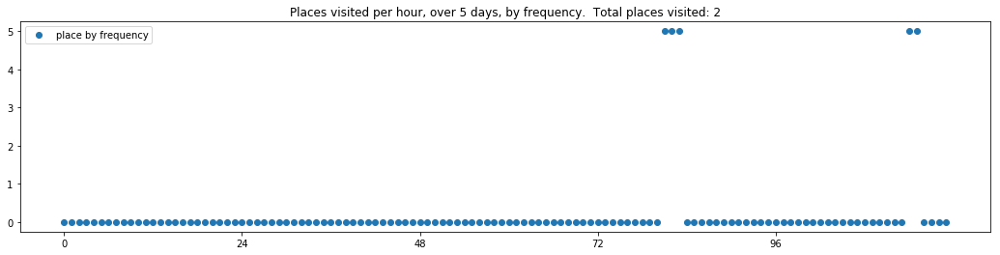

----- vector ----
prefix labels:  [215, 215]
[0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 0, 0, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]
[215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215, 215]


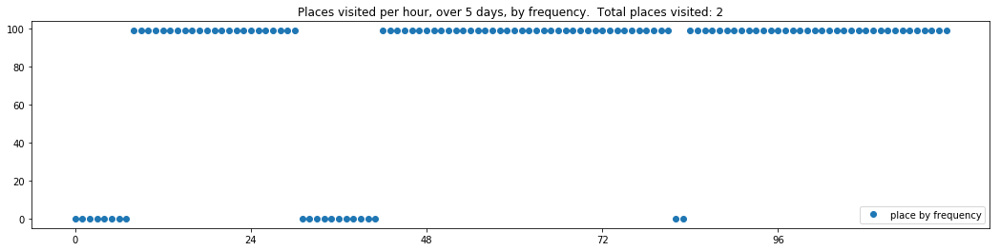


------
 85 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_85.txt 
------

----- vector ----
prefix labels:  [568, 568]
[0, 195, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 568, 568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 457]
[0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568]


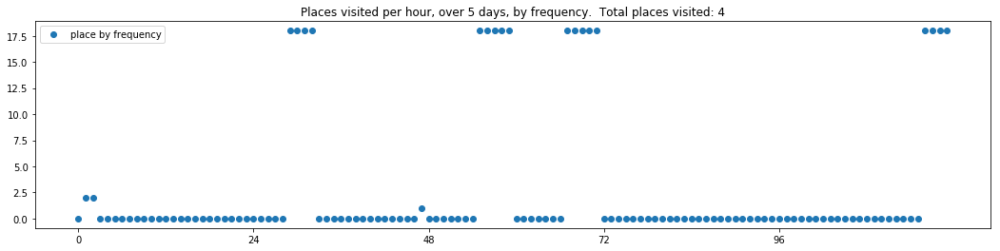

----- vector ----
prefix labels:  [15, 197]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 197, 197, 0, 0, 197, 260, 361]
[361, 199, 199, 199, 199, 199, 199, 199, 199, 199, 197, 85, 523, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580]
[580, 580, 575, 575, 575, 465, 0, 575, 0, 0, 575, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 199, 199, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 270, 270, 270, 270, 270, 270, 270]


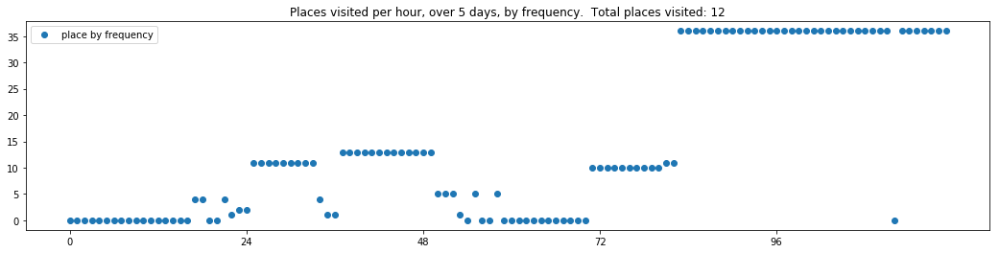

----- vector ----
prefix labels:  [215, 215]
[0, 0, 0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 52, 0, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]


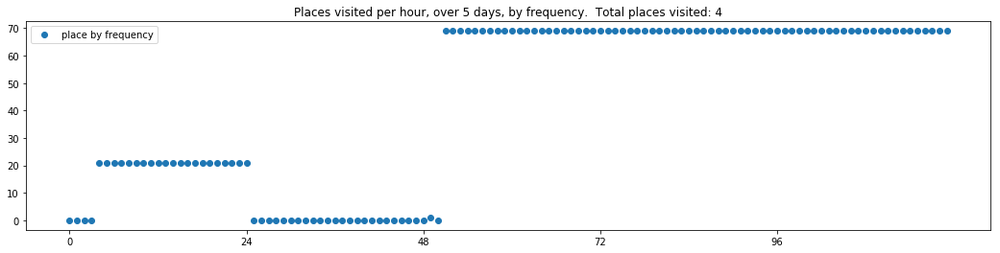

----- vector ----
prefix labels:  [130, 130]
[0, 0, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 130, 0, 0, 0, 130, 0, 0, 0, 0, 0, 130, 130]
[0, 0, 0, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 0, 130, 130, 130, 130, 130, 130, 0]
[130, 130, 130, 130, 0, 130, 130, 0, 0, 0, 130, 0, 130, 130, 0, 0, 0, 0, 130, 130, 130, 130, 130, 84]
[84, 84, 130, 130, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 0, 130, 130, 130, 130, 0, 130, 130, 130, 130]


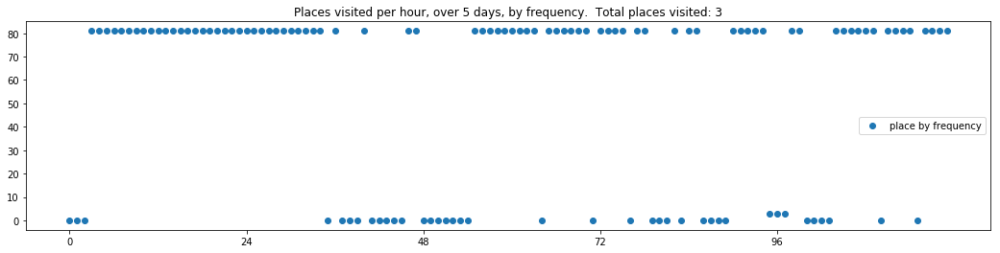

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 87, 87, 87, 0, 87, 0, 0, 0, 0, 0, 0, 0, 391, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 162, 162, 162, 162, 0, 0]
[0, 0, 0, 0, 271, 0, 0, 0, 0, 0, 0, 0, 87, 87, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 448, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 271, 266, 0, 87, 87, 87, 87, 87, 87, 87, 0, 0]


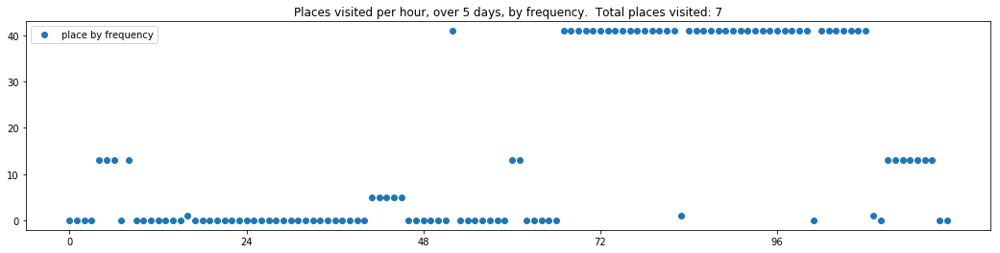

----- vector ----
prefix labels:  [293, 183]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 276, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 276, 0, 0, 0, 0]


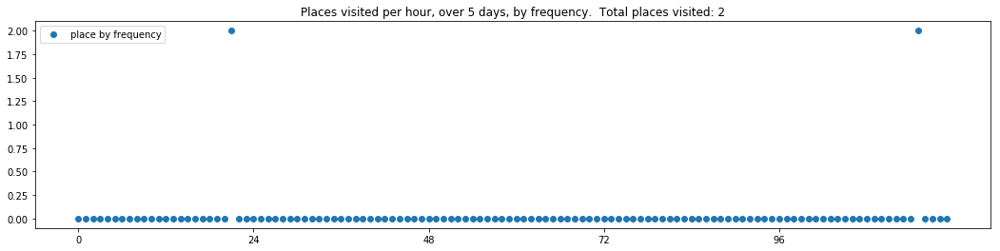

----- vector ----
prefix labels:  [430, 571]
[0, 0, 0, 0, 0, 0, 0, 0, 176, 176, 176, 176, 176, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 439, 0, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176]
[176, 176, 176, 176, 176, 176, 0, 0, 0, 0, 0, 0, 403, 41, 41, 41, 41, 176, 176, 354, 176, 176, 176, 176]
[176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 176, 21, 486, 486, 486, 486, 486, 486, 486, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


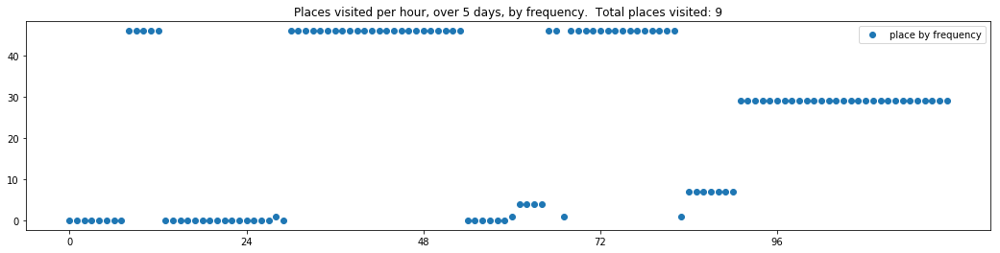

----- vector ----
prefix labels:  [372, 372]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 372, 0, 372, 372, 0, 0, 0, 0, 0, 0, 0, 0, 0, 257]
[0, 257, 257, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 71, 71, 71, 71, 71, 71, 71, 71, 70, 70, 372, 372]
[372, 372, 372, 372, 372, 372, 372, 372, 0, 0, 0, 0, 0, 0, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 150, 150, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]


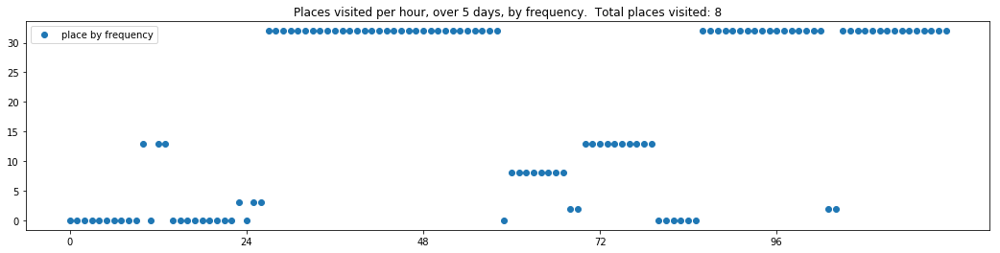

----- vector ----
prefix labels:  [78, 78]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[78, 78, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 78, 0, 0, 0, 0, 0, 0, 0]
[0, 538, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 78, 78, 0, 417, 92, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0]


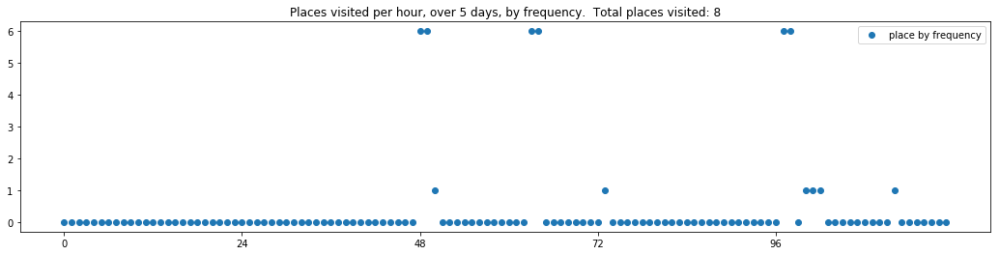

----- vector ----
prefix labels:  [117, 117]
[0, 0, 0, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


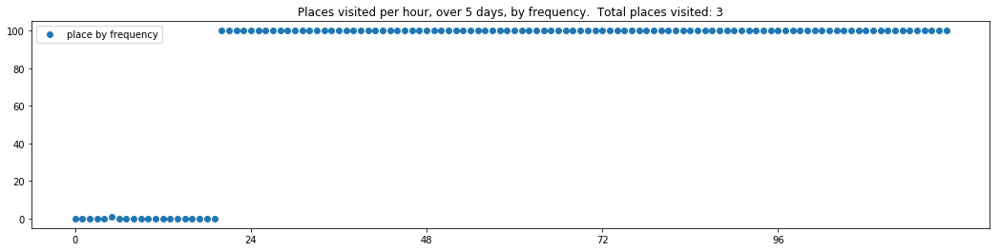

----- vector ----
prefix labels:  [594, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0]
[0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 29, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0]
[119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
[0, 284, 0, 227, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


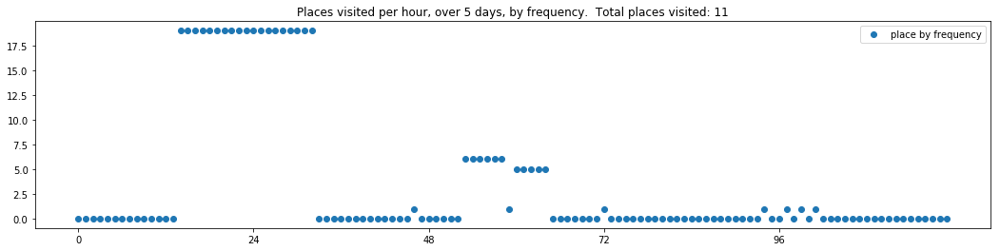

----- vector ----
prefix labels:  [604, 604]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]


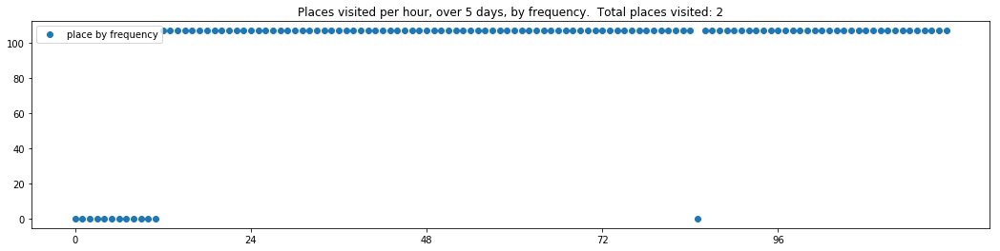

----- vector ----
prefix labels:  [177, 177]
[0, 0, 0, 0, 177, 0, 112, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[84, 84, 84, 84, 84, 84, 84, 84, 84, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 0, 0, 27, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]


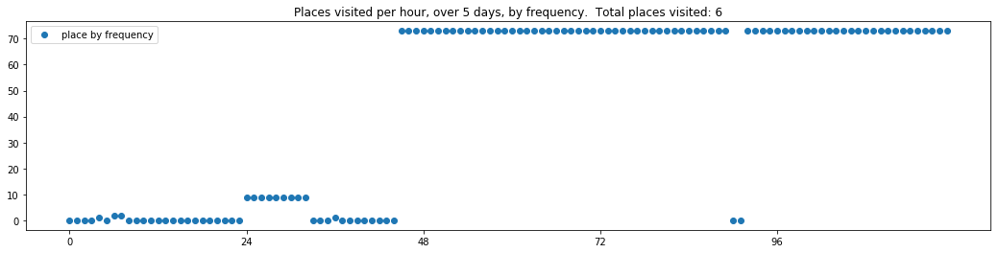

----- vector ----
prefix labels:  [558, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 212, 212, 212]


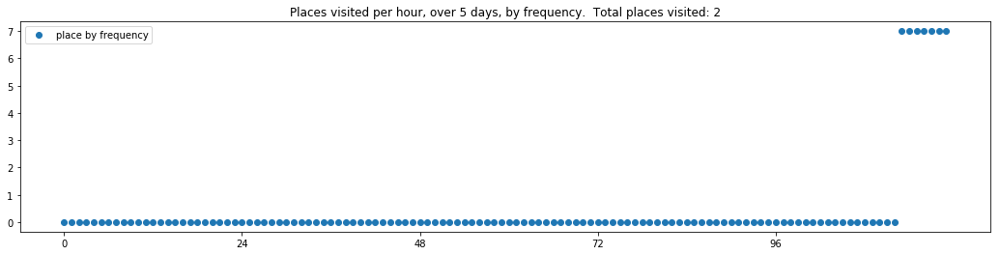

----- vector ----
prefix labels:  [14, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]
[22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 130, 14]


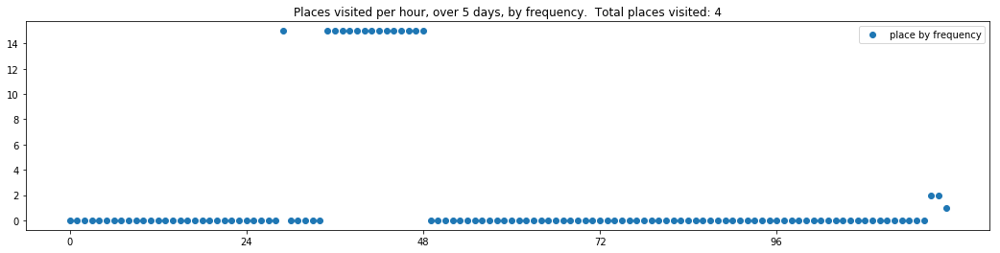

----- vector ----
prefix labels:  [325, 388]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 0, 0, 98, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 192, 0, 21, 21, 0, 144, 144, 144, 144, 144, 144, 0, 0, 0, 0, 486, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


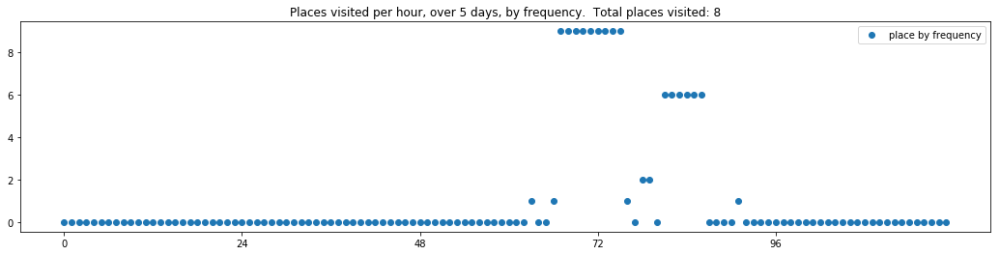

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0]
[0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 0, 0, 26, 26, 26]


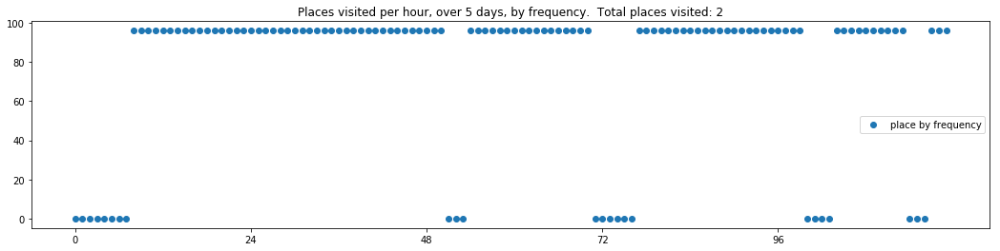

----- vector ----
prefix labels:  [168, 168]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 311, 0, 0, 0, 0, 168, 168, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 297, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


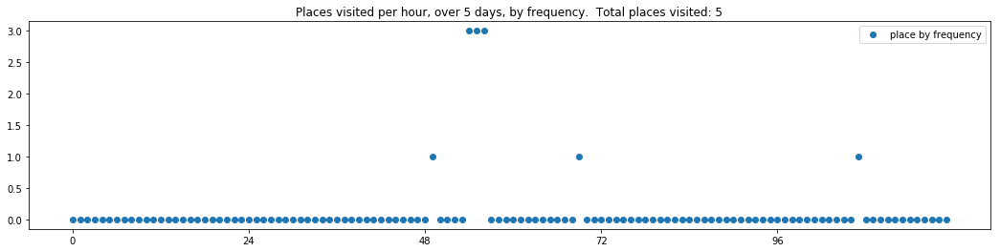

----- vector ----
prefix labels:  [310, 310]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599]
[599, 599, 599, 0, 0, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599]


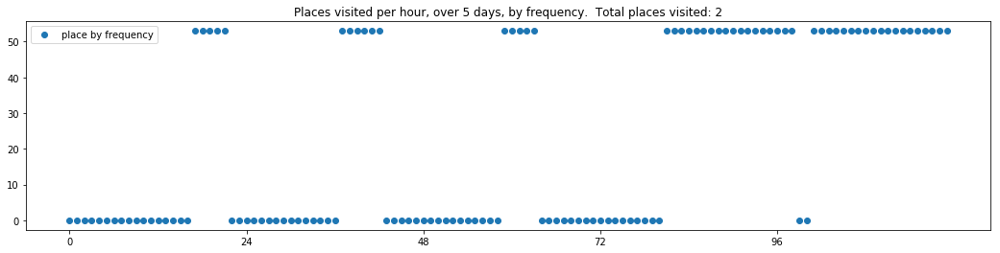

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 323, 323, 323, 323, 323, 367, 367, 87, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 542, 0, 0]


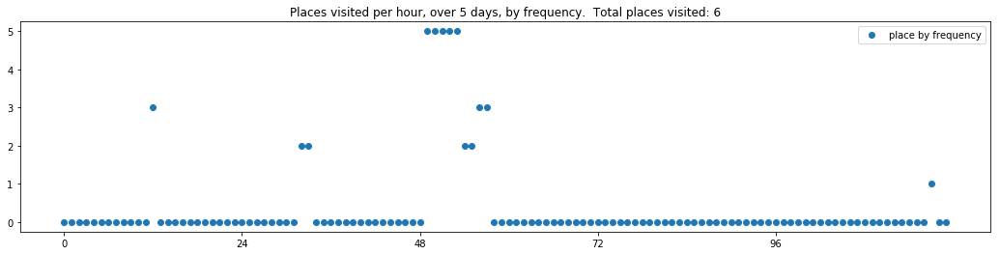

----- vector ----
prefix labels:  [463, 0]
[0, 0, 0, 0, 0, 463, 463, 463, 0, 0, 0, 0, 0, 0, 0, 463, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 200, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 341, 0, 0, 0, 0]
[0, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 611, 611, 392, 392, 392, 392, 392, 463]
[463, 463, 463, 463, 463, 463, 463, 75, 0, 0, 0, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508, 508]


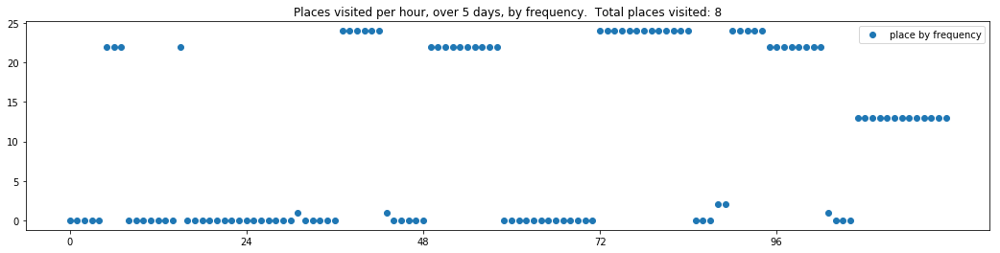

----- vector ----
prefix labels:  [385, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 385, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 385, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


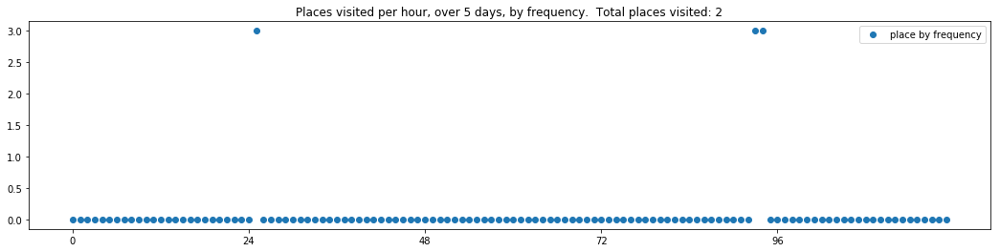

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 374, 374, 374, 374, 374, 374, 374, 374, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


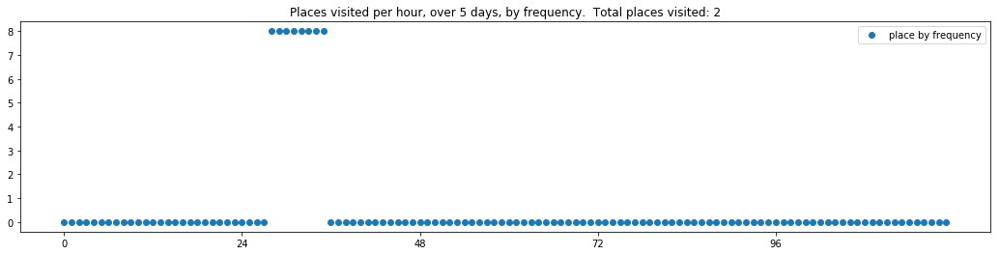

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 200, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 87, 87, 87, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]


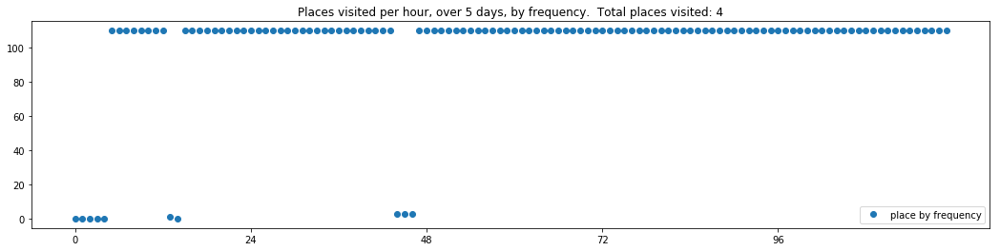

----- vector ----
prefix labels:  [8, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 248, 8, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 8]


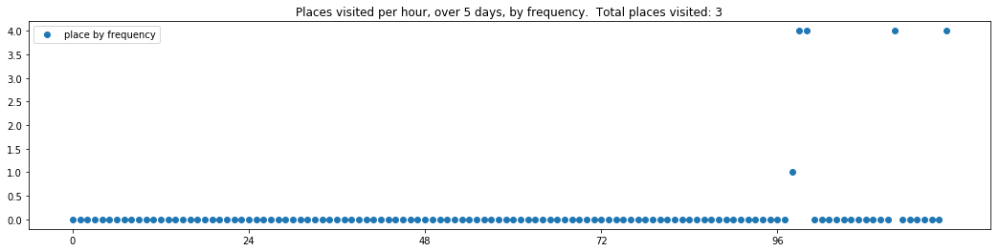

----- vector ----
prefix labels:  [32, 32]
[0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32]
[32, 32, 32, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 32, 32, 32, 32]


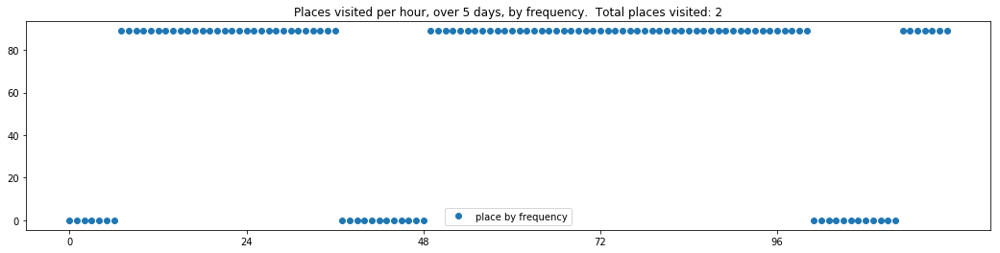

----- vector ----
prefix labels:  [482, 482]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482]
[482, 482, 482, 482, 482, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


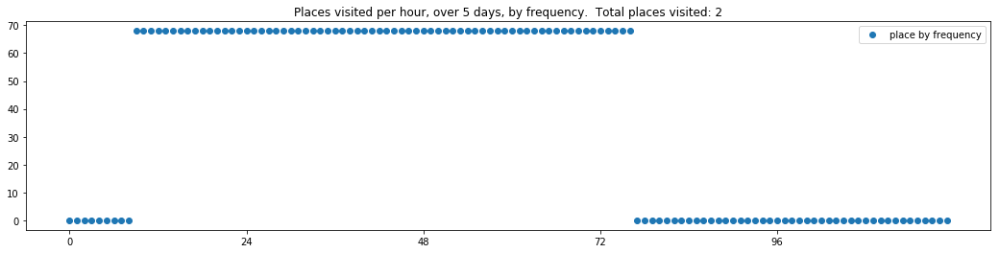

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 100, 0, 100, 100, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519]
[519, 519, 519, 519, 519, 519, 519, 0, 0, 0, 334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


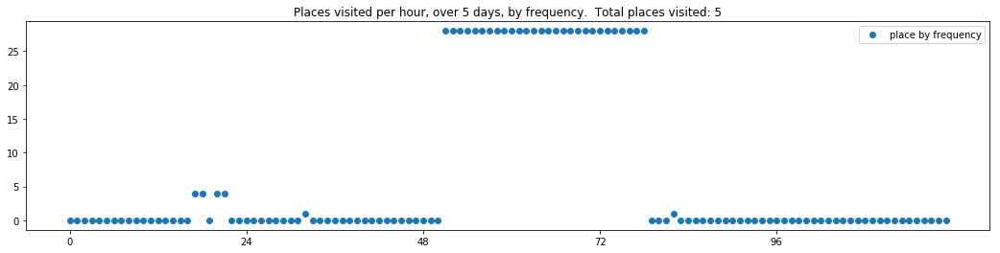

----- vector ----
prefix labels:  [257, 209]
[0, 0, 0, 0, 209, 209, 209, 209, 126, 161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[0, 0, 0, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]


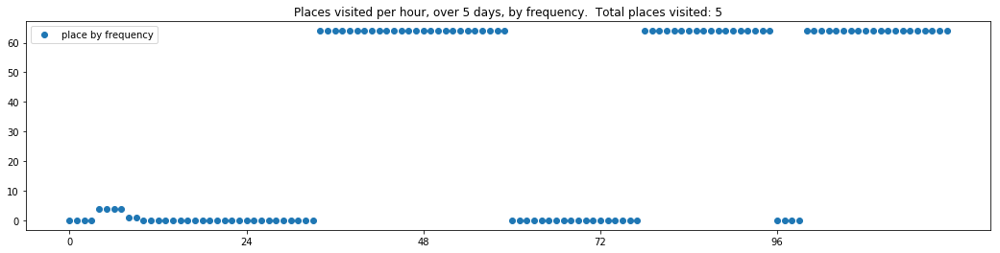

----- vector ----
prefix labels:  [94, 94]
[0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 535, 0, 0, 0, 0, 0, 0, 0]
[0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


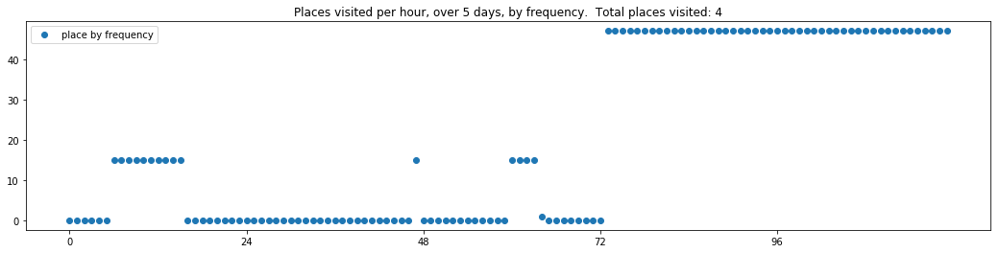

----- vector ----
prefix labels:  [68, 182]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 100, 100, 100, 100, 100, 100, 100, 100]
[100, 100, 100, 100, 100, 100, 100, 128, 128, 128, 0, 0, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 364]
[364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 100, 100, 100, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


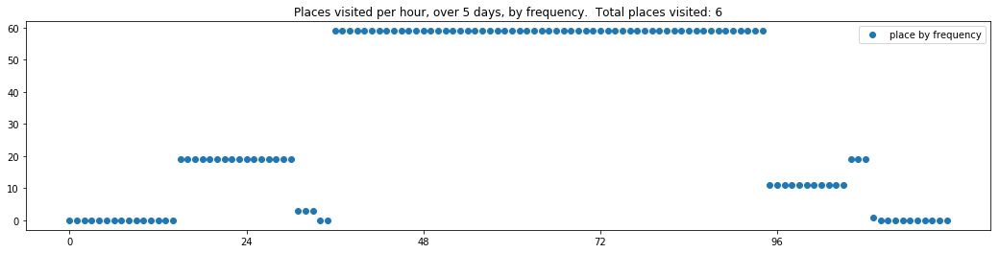

----- vector ----
prefix labels:  [574, 574]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 398, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 570, 76, 76]
[76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 0, 503, 21, 21, 21]


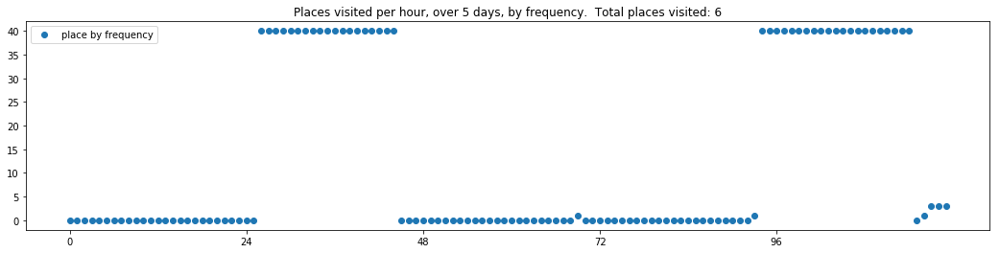

----- vector ----
prefix labels:  [192, 192]
[0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]


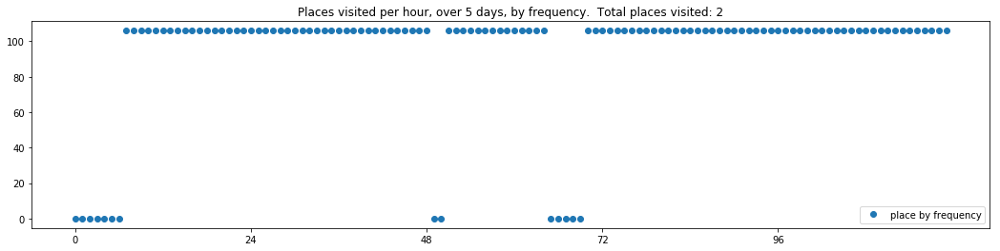

----- vector ----
prefix labels:  [214, 214]
[0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]


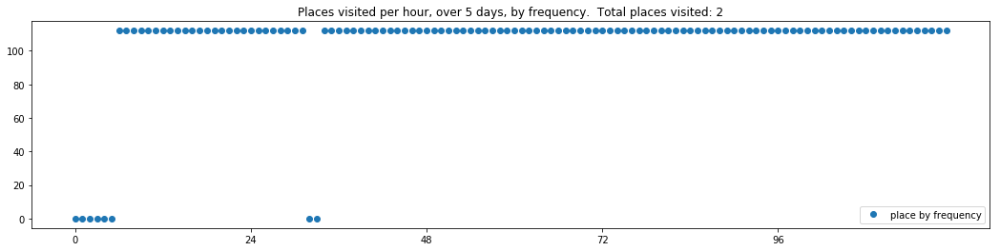

----- vector ----
prefix labels:  [334, 334]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 334]


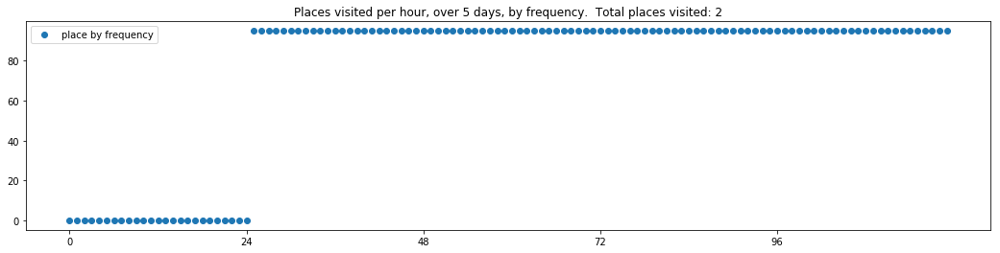

----- vector ----
prefix labels:  [128, 128]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


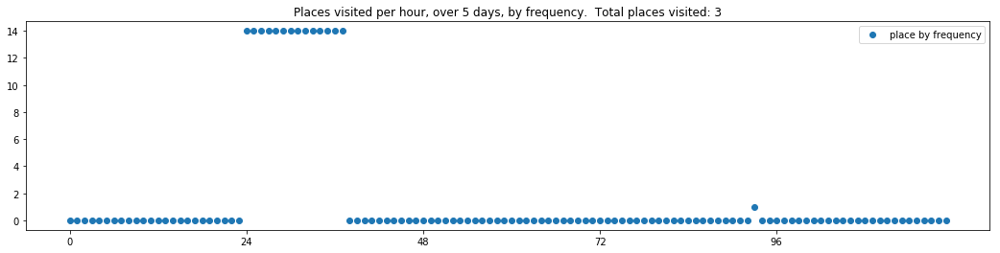

----- vector ----
prefix labels:  [230, 203]
[0, 0, 0, 0, 0, 0, 230, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 203, 203, 533, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 230, 230, 230, 230, 230, 294, 294, 294, 294]
[0, 0, 0, 0, 203, 0, 370, 370, 370, 32, 370, 438, 32, 32, 70, 70, 70, 70, 70, 70, 70, 70, 70, 70]
[32, 70, 70, 32, 70, 70, 70, 70, 0, 438, 85, 85, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 44, 0, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 34, 34]


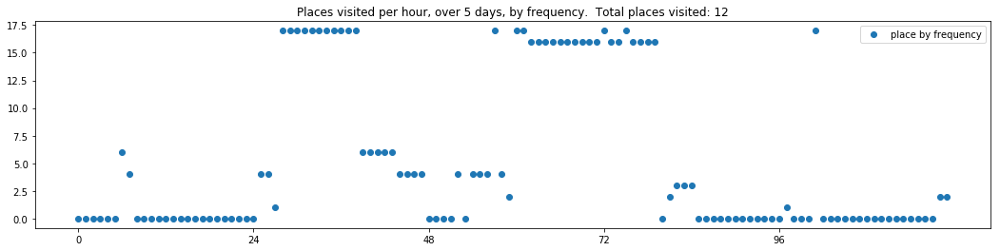

----- vector ----
prefix labels:  [160, 79]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 486, 45, 0, 0, 0, 0, 0, 0, 586, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 401, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


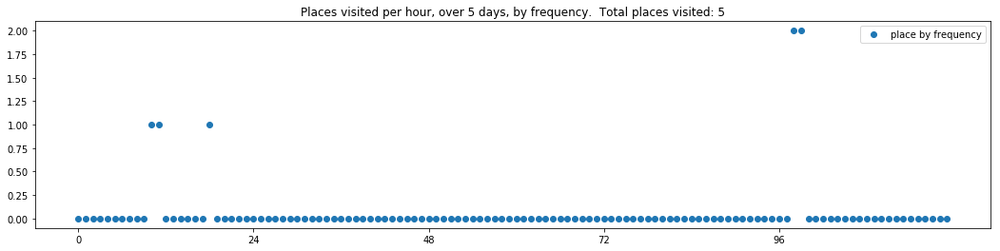

----- vector ----
prefix labels:  [84, 628]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 344, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 391]
[391, 391, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


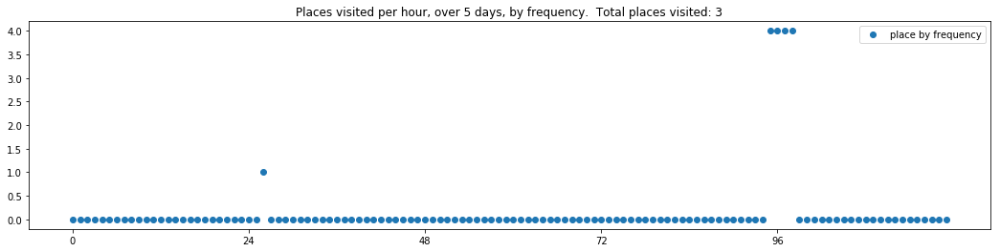

----- vector ----
prefix labels:  [344, 344]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 463, 0, 0, 0, 0, 0, 0, 429, 429, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 344, 344, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 569, 0, 434, 434, 434, 434, 61, 61, 0, 0, 0, 0, 20, 44]
[44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


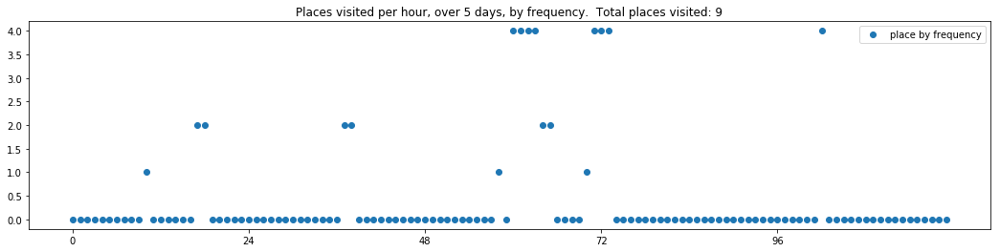

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 205, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 0, 416, 416, 416, 0, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416]


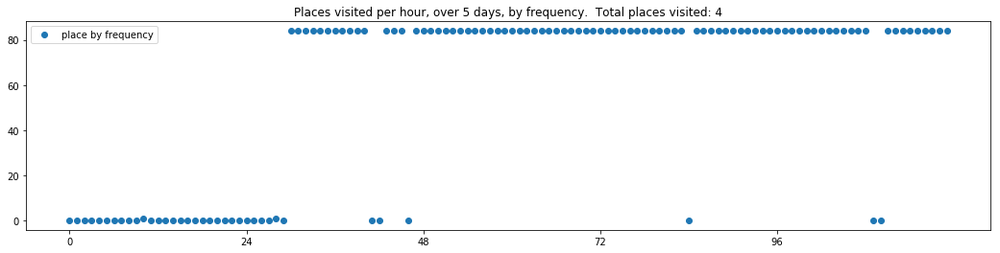

----- vector ----
prefix labels:  [91, 91]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 91, 91, 91, 91, 91, 456, 456, 456, 456, 456, 456, 289, 289, 289, 0, 0, 0, 0, 0, 0, 0, 20, 338]
[437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 0, 0, 437, 437, 437, 437, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437]


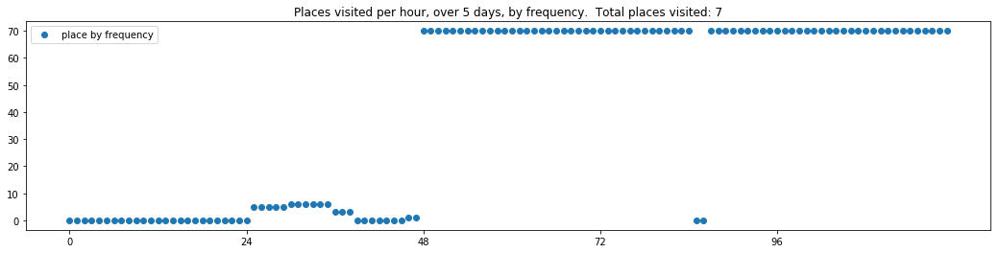

----- vector ----
prefix labels:  [345, 345]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 190, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 343, 343, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 195, 195, 195, 195, 195, 195, 195, 195, 195, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 195, 303, 303, 303, 0, 0, 0, 0, 0]


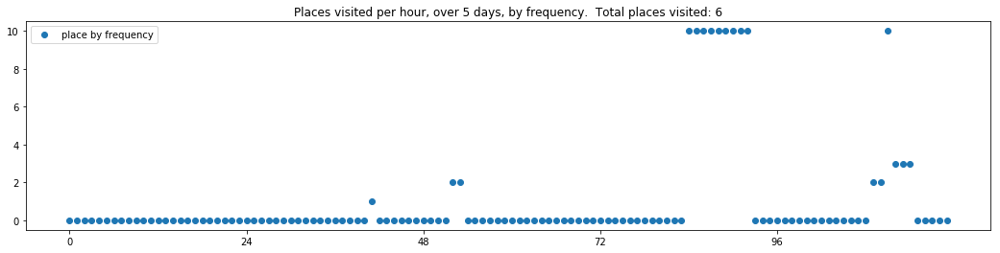

----- vector ----
prefix labels:  [223, 578]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 439, 439, 0, 578, 578, 578, 578, 578, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 578, 0, 578, 578, 578, 578, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[578, 578, 578, 0, 0, 0, 0, 7, 578, 578, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 578, 0]


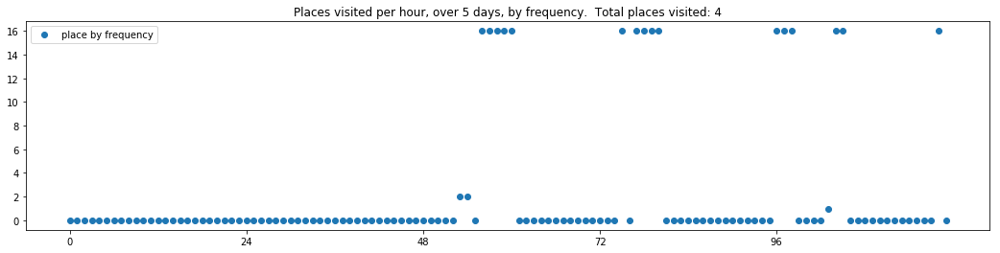

----- vector ----
prefix labels:  [87, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 0, 0, 0, 0, 0]
[0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0]


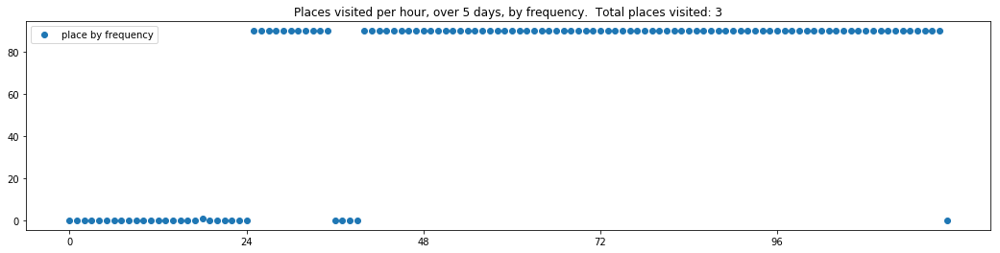

----- vector ----
prefix labels:  [104, 104]
[0, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[133, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]


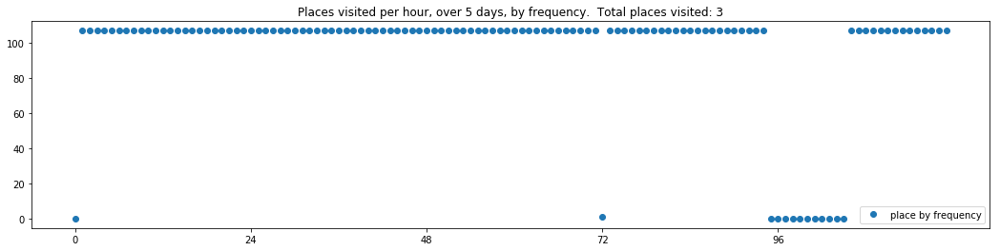

----- vector ----
prefix labels:  [126, 126]
[0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


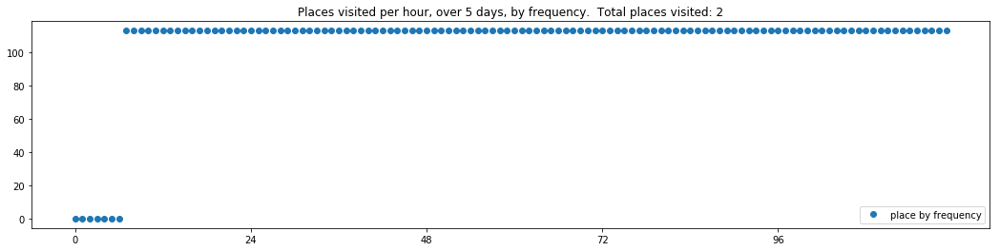

----- vector ----
prefix labels:  [433, 433]
[0, 0, 0, 0, 433, 0, 0, 433, 433, 433, 433, 433, 433, 433, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 433, 0, 0, 0, 0, 0, 0, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


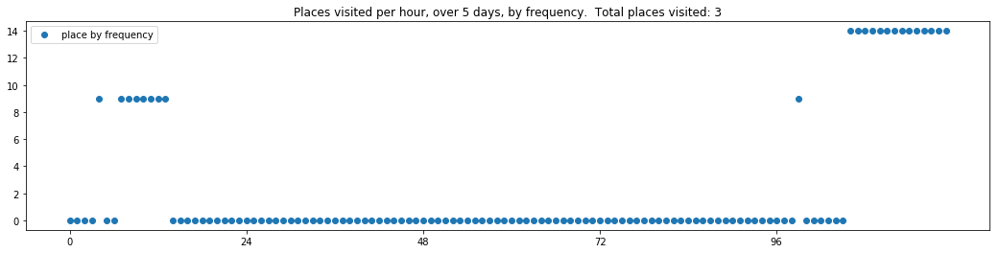

----- vector ----
prefix labels:  [373, 421]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 224, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 0, 142, 274, 142, 142, 0, 0]


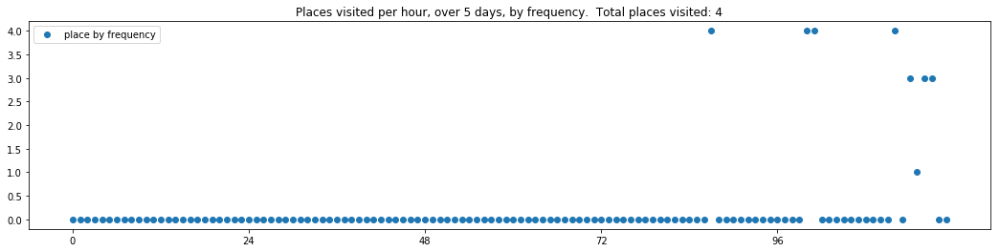

----- vector ----
prefix labels:  [55, 20]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 55, 0, 22, 22, 22, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 0, 0, 0, 0, 0, 0]
[0, 569, 0, 0, 0, 0, 0, 0, 364, 364, 364, 364, 364, 364, 364, 69, 69, 0, 69, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 0, 0, 0, 0, 0, 101, 101, 101, 101, 101, 0, 69]
[69, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 208, 208, 0, 0, 0, 0]


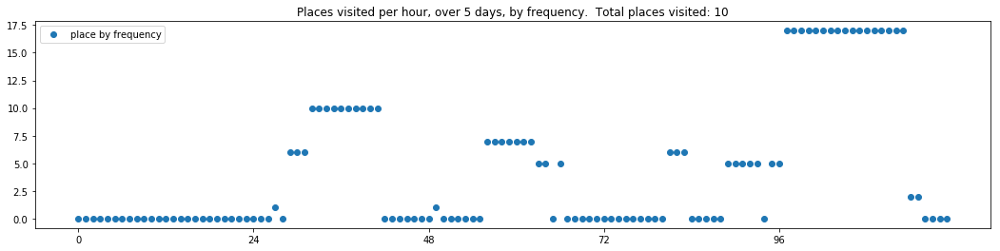


------
 90 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_90.txt 
------

----- vector ----
prefix labels:  [251, 251]
[0, 0, 0, 0, 251, 251, 251, 251, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251]
[251, 251, 251, 251, 251, 251, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251]


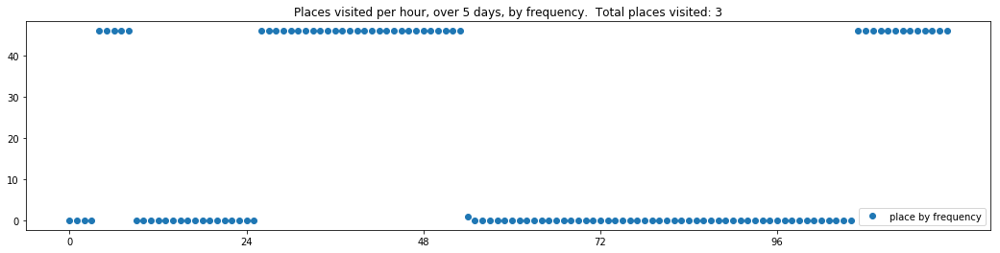

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 277, 0, 0, 0, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


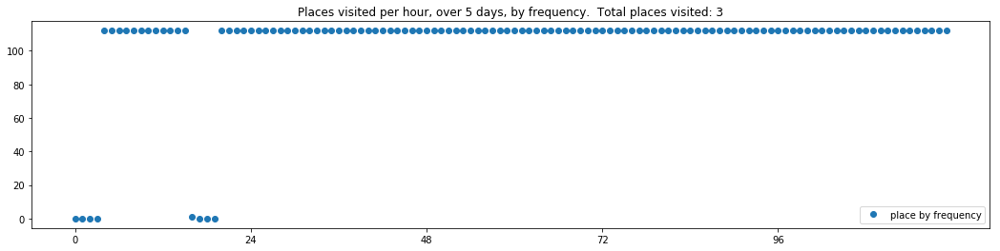

----- vector ----
prefix labels:  [529, 459]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 0, 0, 0, 0]


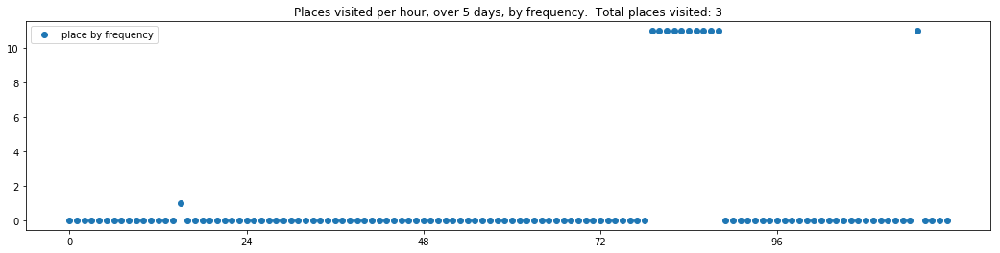

----- vector ----
prefix labels:  [395, 395]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 84, 0, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 84, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395, 395]
[271, 271, 271, 371, 371, 371, 371, 371, 371, 186, 186, 186, 186, 186, 186, 186, 186, 186, 186, 186, 4, 4, 0, 379]
[0, 140, 338, 338, 338, 0, 151, 338, 338, 338, 338, 0, 186, 186, 186, 186, 186, 186, 186, 186, 140, 140, 186, 0]


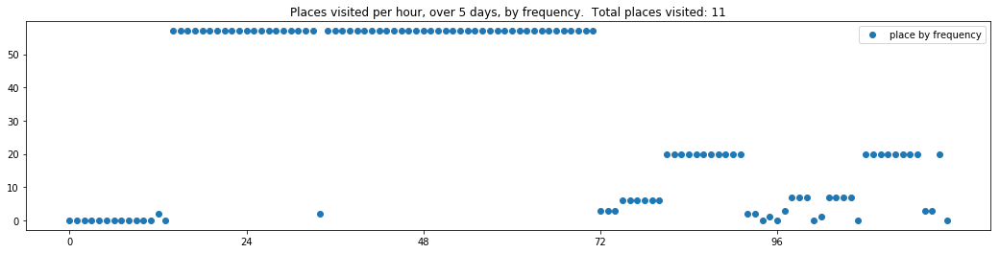

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]


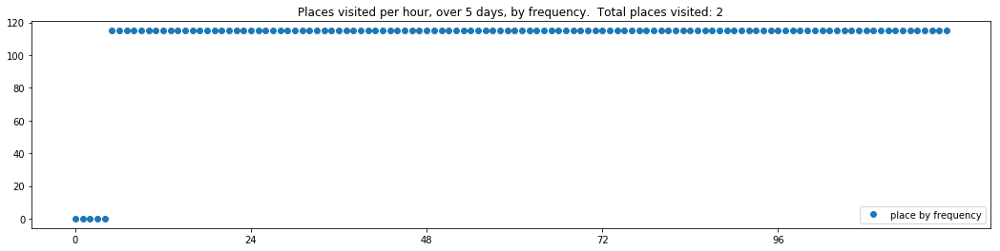

----- vector ----
prefix labels:  [246, 246]
[0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 246, 246, 246, 246, 246, 246, 246, 246]


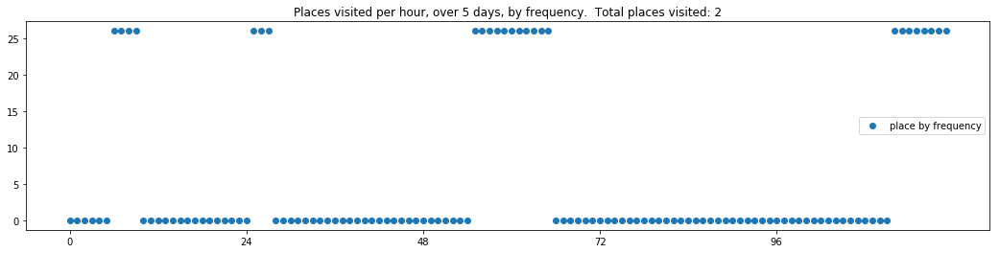

----- vector ----
prefix labels:  [246, 246]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 246, 246, 246, 246, 246, 246, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 48, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 0]


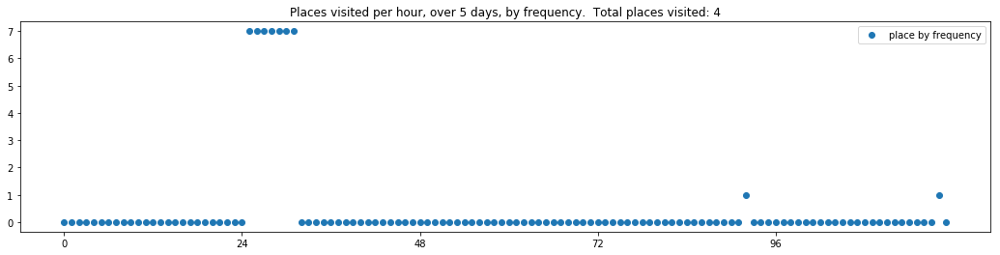

----- vector ----
prefix labels:  [311, 311]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]


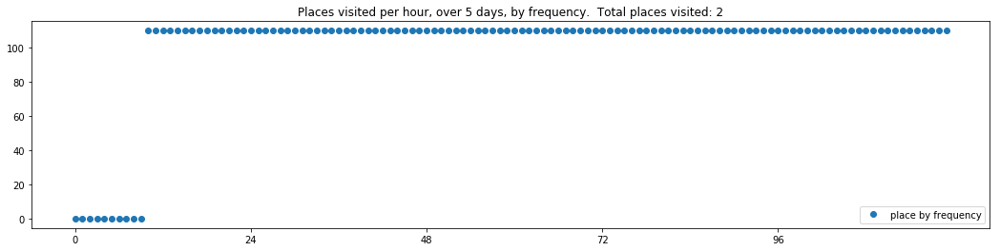

----- vector ----
prefix labels:  [130, 130]
[0, 0, 0, 0, 0, 0, 0, 0, 130, 130, 34, 34, 0, 0, 0, 0, 130, 130, 130, 130, 130, 130, 130, 130]
[130, 130, 130, 130, 0, 130, 130, 130, 130, 130, 130, 130, 0, 130, 34, 0, 0, 0, 0, 0, 0, 0, 130, 130]
[130, 0, 130, 130, 130, 130, 130, 130, 130, 0, 130, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69]
[69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130]


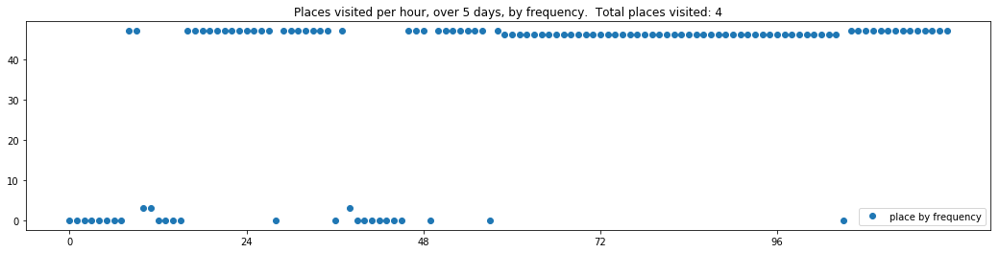

----- vector ----
prefix labels:  [153, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 116, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 39, 0, 0, 0, 8, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 21, 364, 364, 364, 364, 253, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


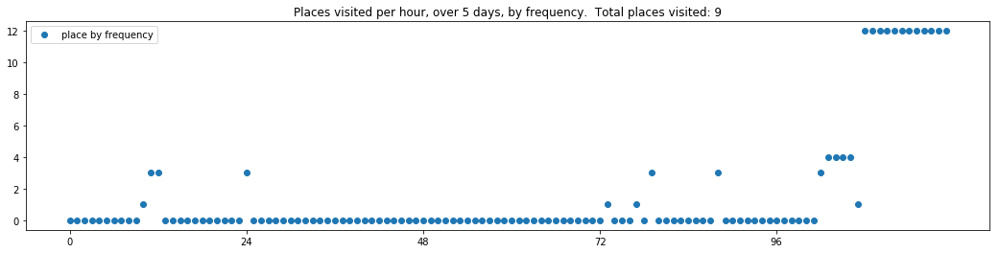

----- vector ----
prefix labels:  [620, 620]
[0, 0, 0, 0, 0, 0, 0, 620, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 620, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 304, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 194, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 341, 304, 304, 304, 304, 304, 304, 304, 0, 304, 304, 304, 304, 304, 304, 194, 194]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


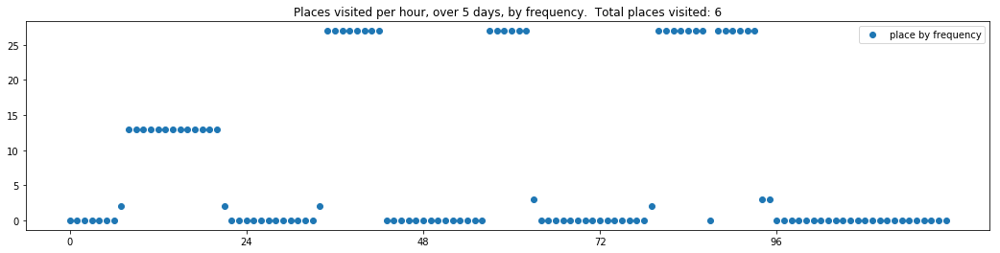

----- vector ----
prefix labels:  [122, 122]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 100, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 270, 270, 270]
[270, 0, 0, 0, 0, 245, 245, 245, 0, 502, 39, 361, 361, 361, 361, 361, 361, 361, 361, 361, 0, 361, 270, 270]


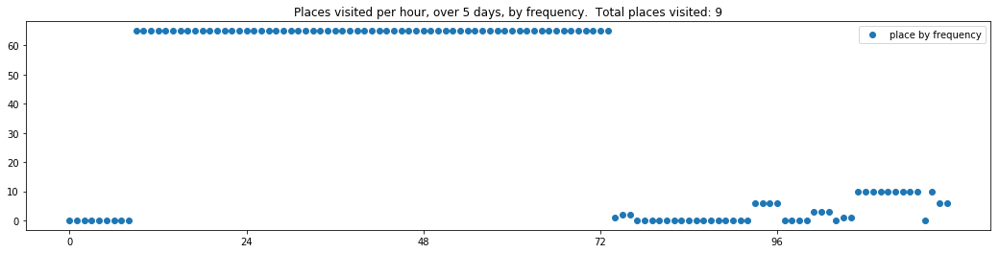

----- vector ----
prefix labels:  [459, 459]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 459, 459, 459, 459]
[459, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 459]
[459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 459, 459, 459, 459, 459, 459, 459, 459]
[459, 459, 459, 459, 459, 459, 459, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 459, 459, 459, 0]
[459, 459, 459, 459, 459, 459, 459, 459, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 459, 459, 459]


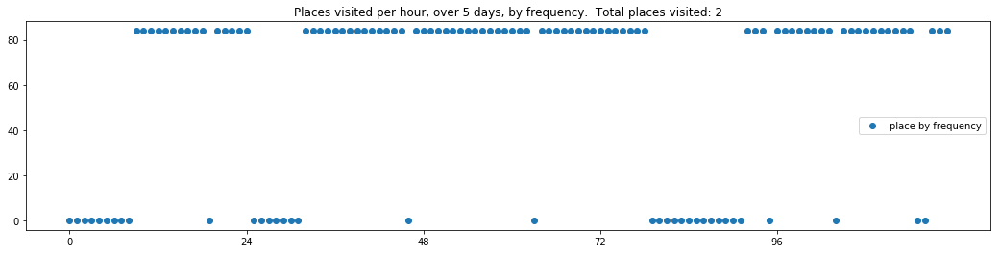

----- vector ----
prefix labels:  [381, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 482, 482, 482]
[482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 482, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 112, 112, 112]
[112, 112, 112, 112, 112, 112, 112, 0, 0, 0, 0, 21, 439, 439, 439, 439, 439, 439, 439, 439, 112, 112, 112, 112]
[282, 0, 439, 439, 439, 439, 439, 439, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 0, 0, 0, 0]


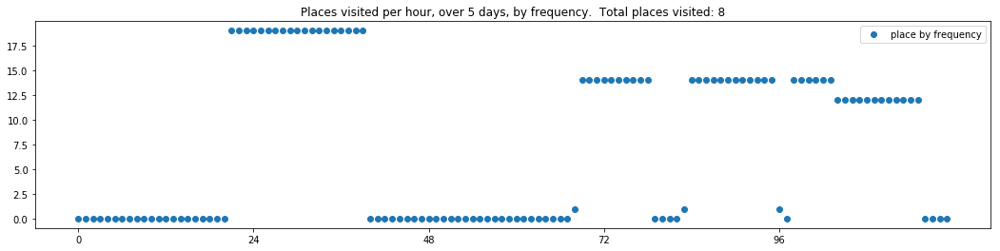

----- vector ----
prefix labels:  [458, 458]
[458, 458, 458, 458, 458, 458, 458, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]


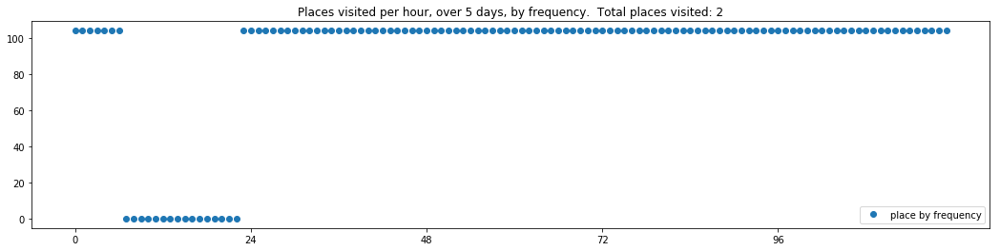

----- vector ----
prefix labels:  [475, 475]
[0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 0, 0, 0, 535, 43, 43, 43, 0, 518, 0, 0]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]


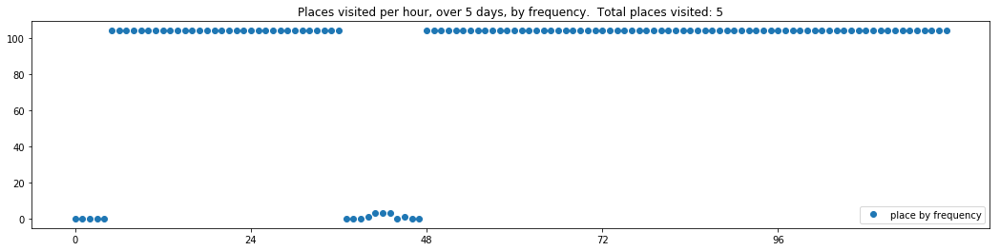

----- vector ----
prefix labels:  [385, 385]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 385, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 0, 0, 0, 0, 0, 0, 0, 385, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 0, 0, 0, 0, 0, 385, 385, 385, 311, 0, 0, 0, 385, 42, 164, 164, 0, 0, 0, 0, 0]


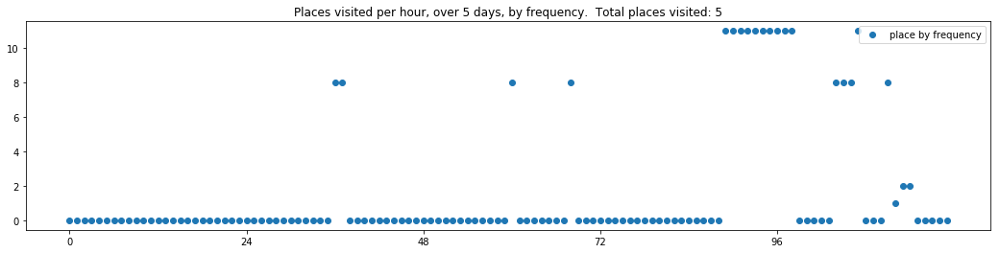

----- vector ----
prefix labels:  [121, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226]
[226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 193, 0, 0, 0, 0, 0, 0]


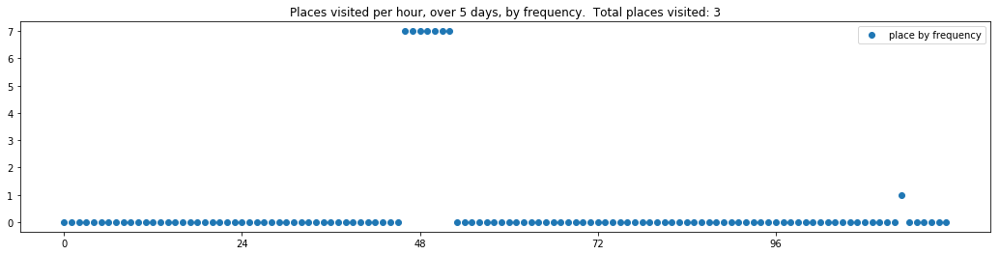

----- vector ----
prefix labels:  [31, 31]
[0, 0, 0, 0, 0, 0, 0, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 34, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]
[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31]


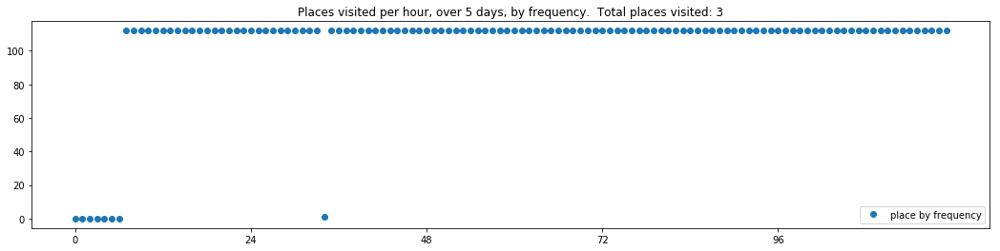

----- vector ----
prefix labels:  [44, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 0, 0, 0, 0, 0, 44, 0, 0]
[44, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 598, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


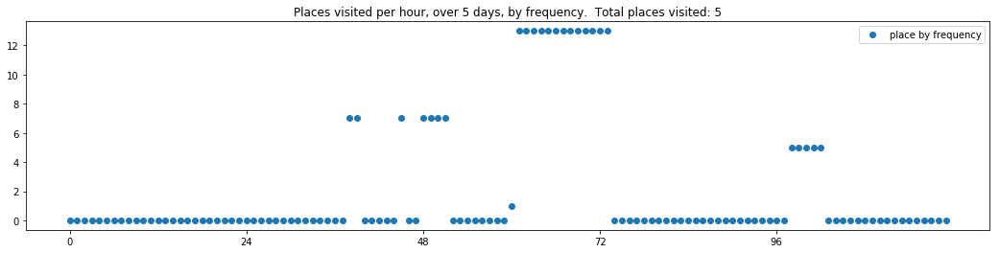

----- vector ----
prefix labels:  [378, 378]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 0, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]


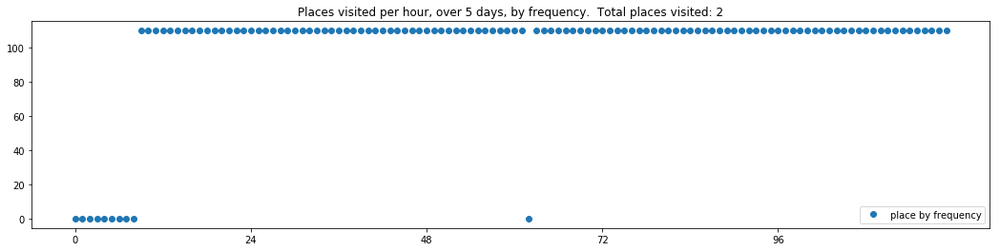

----- vector ----
prefix labels:  [4, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 77, 77, 77, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 498, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


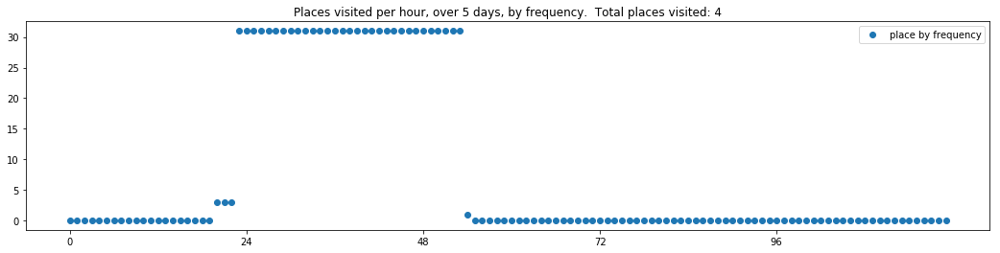

----- vector ----
prefix labels:  [21, 523]
[0, 0, 0, 0, 0, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41]
[41, 41, 41, 41, 176, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 41, 104, 15, 202, 202, 202, 202]
[11, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]
[285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285, 285]


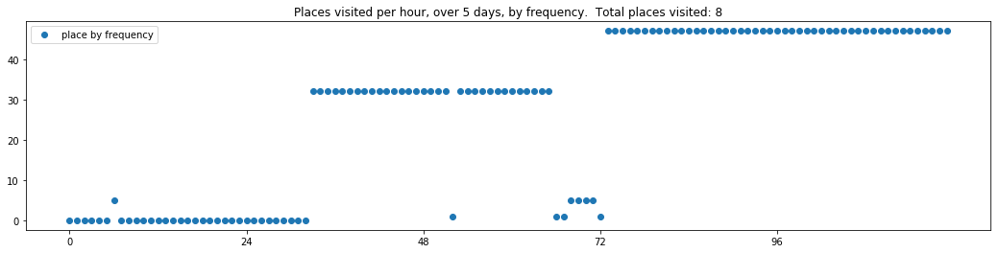

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 0, 0, 93, 93, 93, 93, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 88, 88, 88, 88, 88, 88, 88, 88, 88, 88]
[88, 88, 0, 93, 4, 93, 93, 93, 93, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
[4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


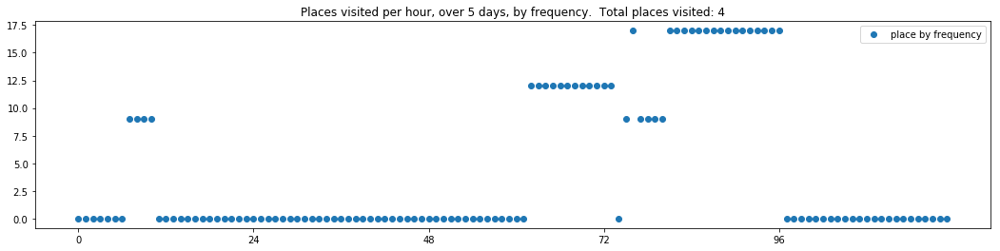

----- vector ----
prefix labels:  [116, 384]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 116, 116, 116, 116, 116]
[116, 116, 116, 116, 116, 116, 0, 0, 4, 4, 4, 0, 0, 0, 8, 461, 461, 461, 461, 461, 461, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 116, 116, 184, 184, 322, 322, 322]
[0, 287, 287, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 0]


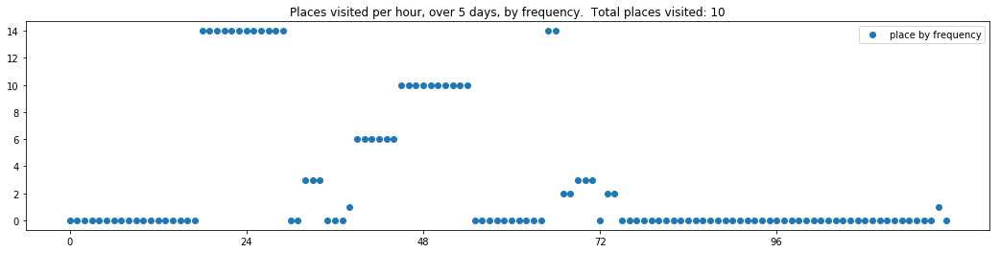

----- vector ----
prefix labels:  [432, 143]
[0, 0, 0, 0, 0, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 0, 144, 144, 144, 144, 144, 0, 192, 192, 192, 192, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]


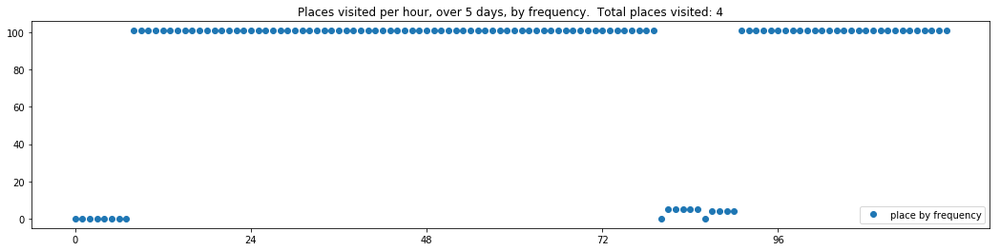

----- vector ----
prefix labels:  [98, 55]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[456, 456, 456, 456, 456, 209, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 35, 83, 503, 503, 503]
[503, 503, 503, 503, 503, 503, 503, 98, 98, 0, 0, 0, 0, 21, 21, 199, 271, 271, 271, 76, 76, 76, 76, 76]


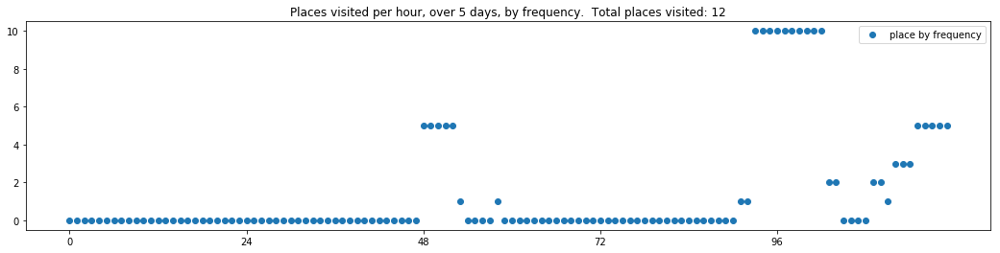

----- vector ----
prefix labels:  [209, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 456, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 0, 0, 0, 0, 0, 248, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 503, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


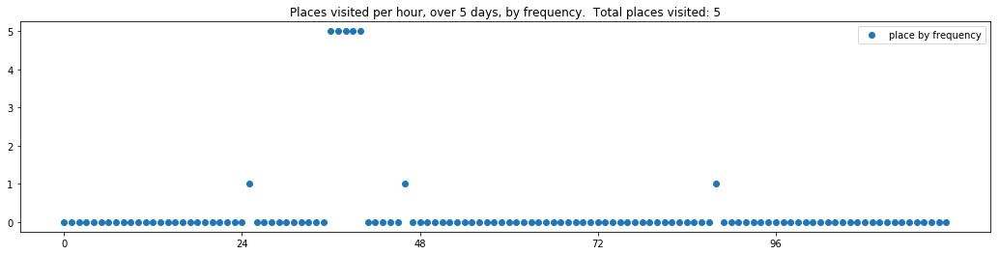

----- vector ----
prefix labels:  [162, 162]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162, 162, 162, 162, 162, 162, 162]
[162, 162, 162, 162, 0, 0, 0, 0, 162, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 322, 322, 0, 322, 322, 322, 322, 322, 322, 322, 322, 322, 322, 0, 0, 0, 0, 0, 162, 162, 162, 162]
[162, 162, 162, 162, 162, 0, 162, 162, 162, 162, 162, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


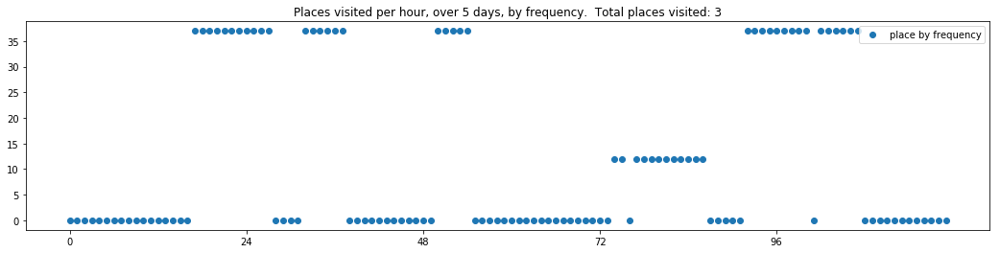

----- vector ----
prefix labels:  [204, 204]
[0, 0, 0, 0, 0, 0, 0, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 0, 0, 0, 0, 0, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 212, 212, 212, 212, 21, 20]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 0, 204, 204, 204, 204, 204, 204, 204, 0, 0, 0, 0, 0]


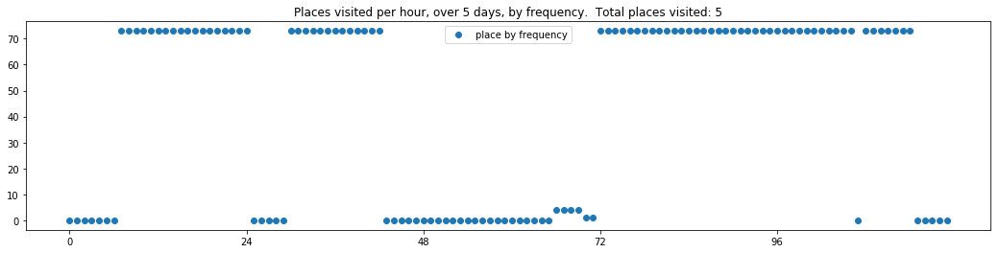

----- vector ----
prefix labels:  [205, 205]
[0, 0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0]
[0, 0, 0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 286, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0]


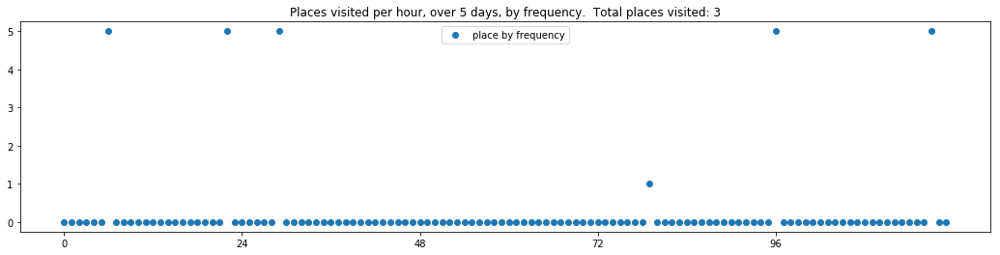

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 21, 21, 21, 21, 21, 21]
[21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 495, 495, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 21]
[0, 0, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 0, 21, 21, 21, 21, 21, 21, 21, 21]


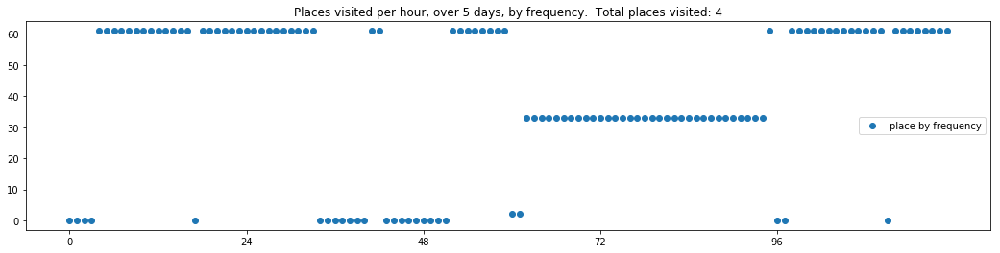

----- vector ----
prefix labels:  [44, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 385]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


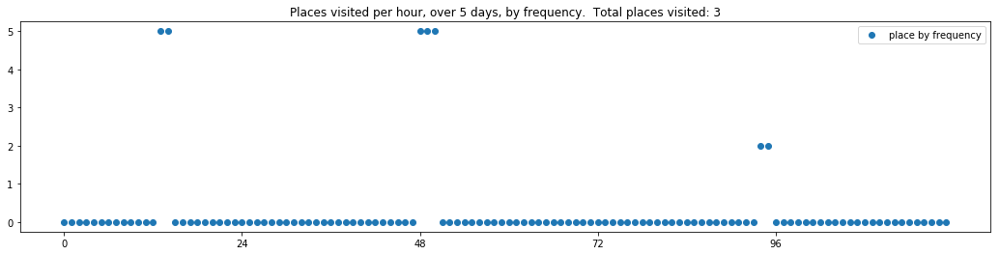

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]


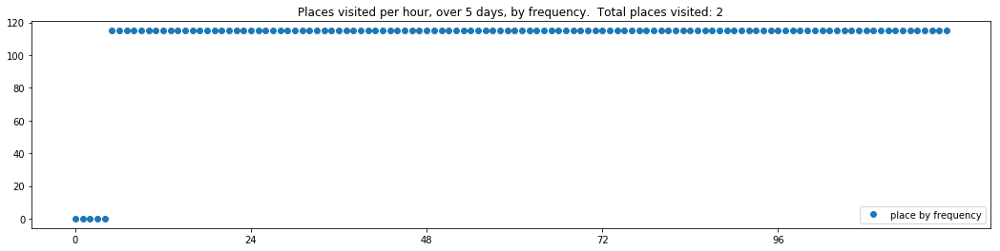

----- vector ----
prefix labels:  [8, 218]
[0, 0, 0, 0, 0, 0, 218, 218, 218, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 8, 8, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 185, 21, 448]
[65, 65, 22, 22, 22, 22, 22, 22, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 162, 162, 162, 162, 162, 65, 162, 0, 0, 0, 0, 0, 8, 8, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 8, 8, 100, 100, 0, 0, 0, 593, 593, 593, 593, 593, 593, 593, 593, 593, 208, 208]


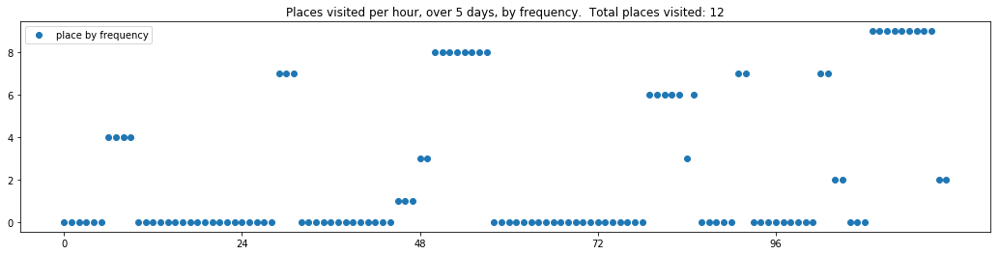

----- vector ----
prefix labels:  [403, 403]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 403, 403, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226]
[226, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 544, 544, 0, 0, 0, 0, 0, 0, 0]


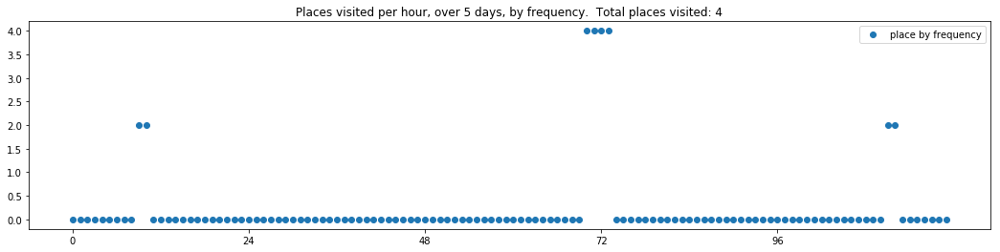

----- vector ----
prefix labels:  [620, 515]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 515, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[165, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 0, 0, 0, 0, 0, 0, 0, 0, 0]


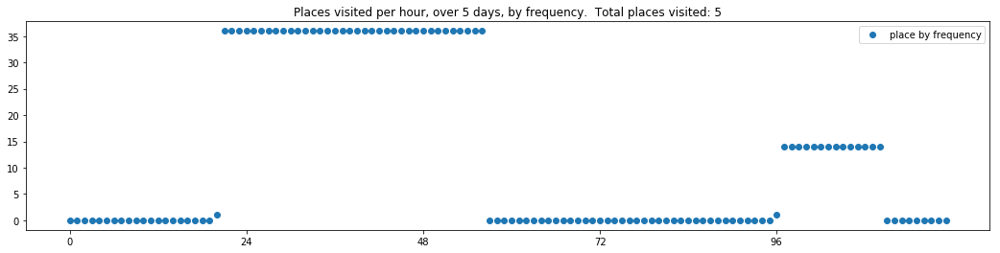

----- vector ----
prefix labels:  [126, 126]
[0, 126, 126, 126, 126, 126, 126, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]


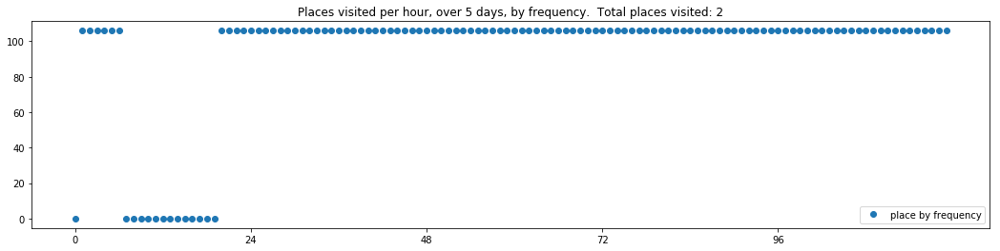

----- vector ----
prefix labels:  [424, 424]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 208, 208, 208, 0, 0, 0, 0, 0, 0, 424, 374, 0, 0, 0, 0, 0, 0, 0]
[424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 461, 461, 461]
[0, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424, 424]


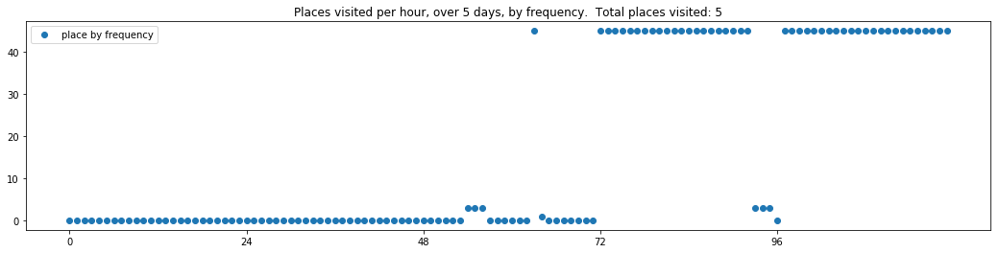

----- vector ----
prefix labels:  [94, 94]
[0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 410, 410, 410, 410, 410, 410, 410, 410]
[410, 410, 410, 410, 410, 410, 410, 410, 410, 410, 0, 0, 4, 4, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94]
[94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0, 494, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4]


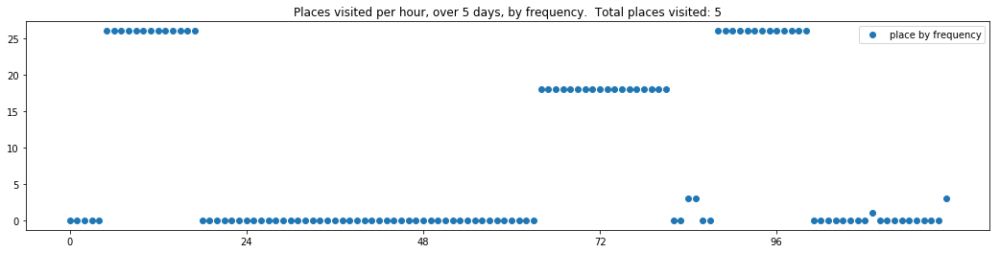

----- vector ----
prefix labels:  [161, 161]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161]
[161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 161, 248, 248, 248, 161]


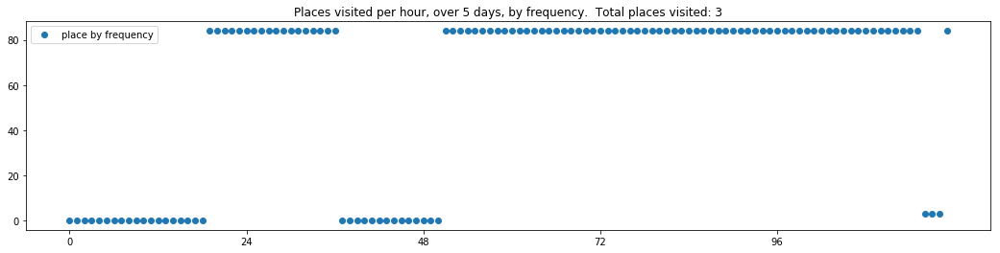

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 434, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 0, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 0, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]
[434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434, 434]


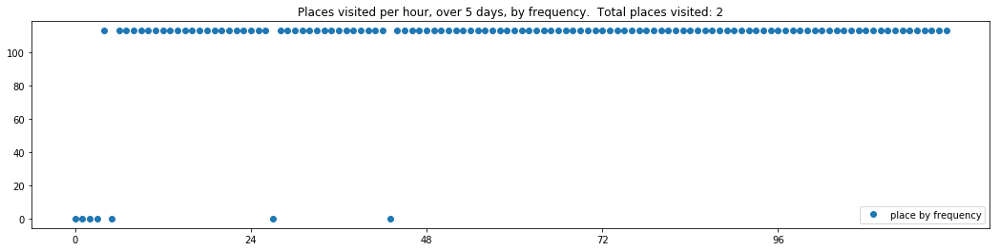

----- vector ----
prefix labels:  [416, 416]
[0, 0, 0, 0, 0, 0, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 395]
[395, 395, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]


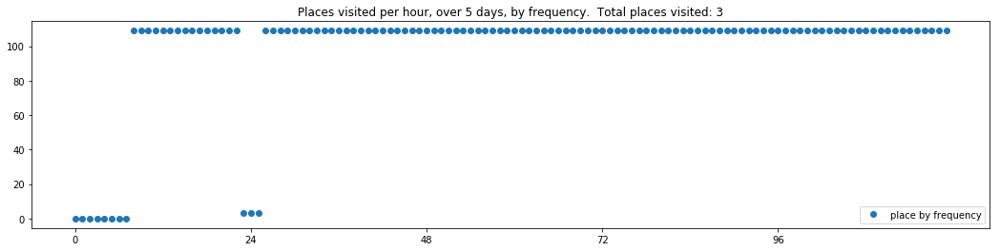

----- vector ----
prefix labels:  [328, 328]
[0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 0, 0, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]


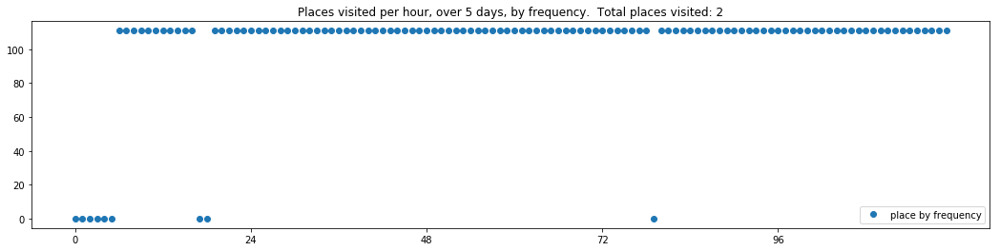

----- vector ----
prefix labels:  [388, 271]
[0, 0, 0, 0, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271]
[271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 0, 21, 21, 0, 0, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 330, 330, 330, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]
[388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388]


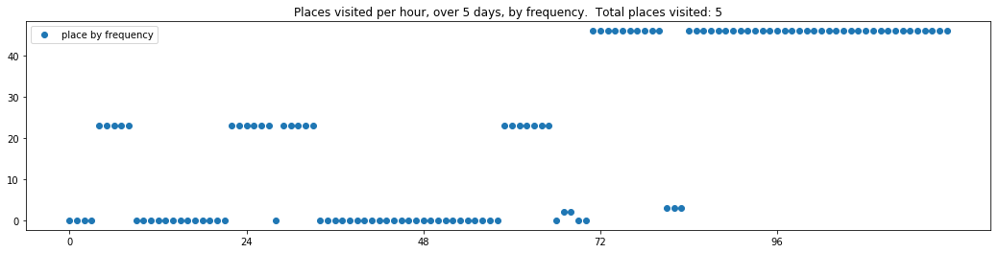

----- vector ----
prefix labels:  [14, 14]
[0, 0, 0, 0, 437, 186, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]
[14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]
[14, 14, 0, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]
[14, 14, 14, 14, 14, 14, 0, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]
[14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]


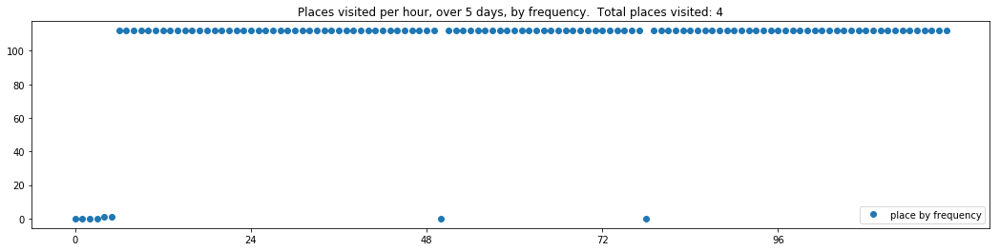

----- vector ----
prefix labels:  [448, 448]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 80, 22, 22, 22, 22, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 43, 43]
[43, 43, 43, 455, 0, 81, 81, 81, 81, 81, 81, 81, 81, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 81, 81, 0, 0, 0, 0, 0, 0, 0, 0, 576]


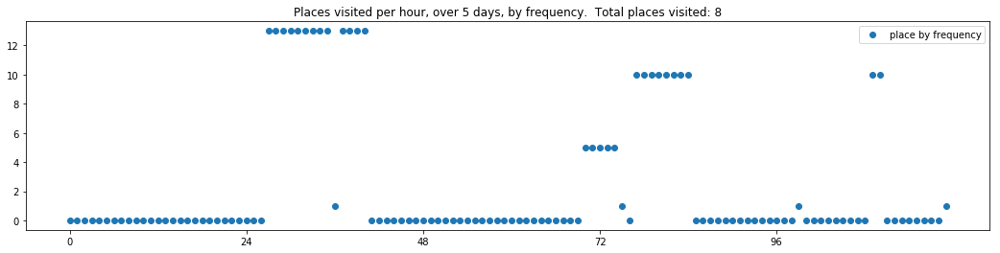

----- vector ----
prefix labels:  [568, 568]
[112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568]
[568, 0, 0, 0, 0, 568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 0, 0, 0, 0, 0]


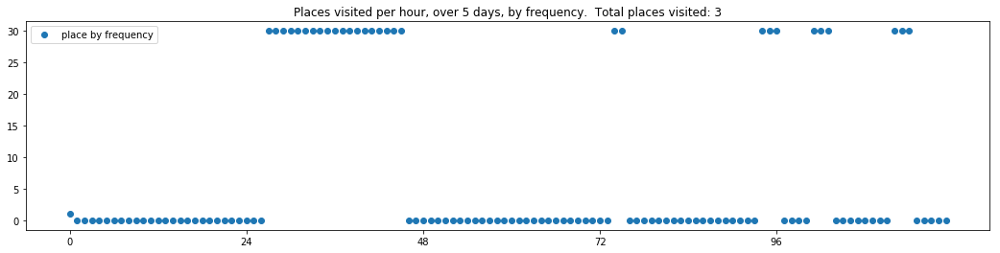

----- vector ----
prefix labels:  [352, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 352, 130, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 0, 0, 0, 112, 0, 0, 0, 0]
[352, 352, 352, 130, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 0, 353, 0, 352, 352, 352, 352, 352]
[352, 352, 7, 7, 7, 7, 7, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 0, 0, 0]


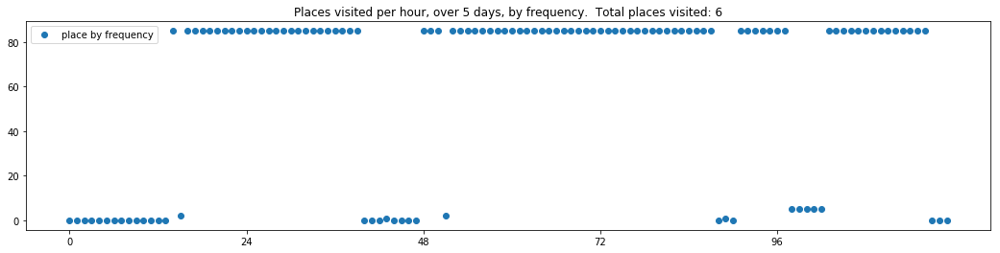

----- vector ----
prefix labels:  [521, 521]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 224, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 308, 224, 328, 328, 328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 0, 224, 0, 390, 0, 0, 0]
[0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 308, 0, 0, 0, 0, 0, 0, 0, 521, 304, 304, 304, 304, 304, 304, 304, 0, 0, 0, 0, 0, 0]
[0, 521, 521, 521, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 0, 0, 0, 0, 0, 0, 0, 0, 0]


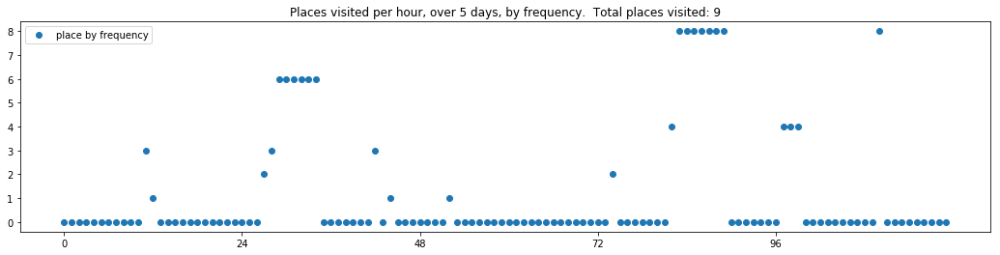


------
 95 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_95.txt 
------

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


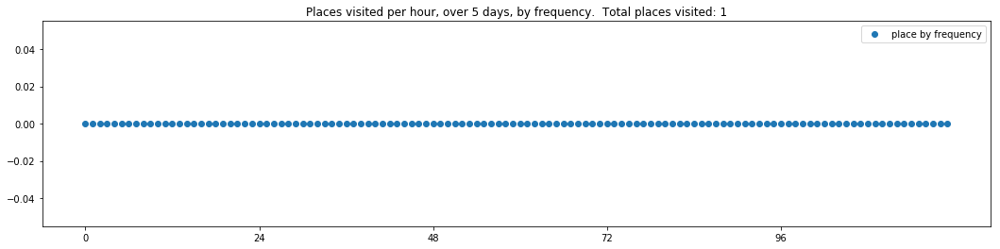

----- vector ----
prefix labels:  [352, 352]
[0, 0, 0, 0, 0, 70, 0, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]
[352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352, 352]


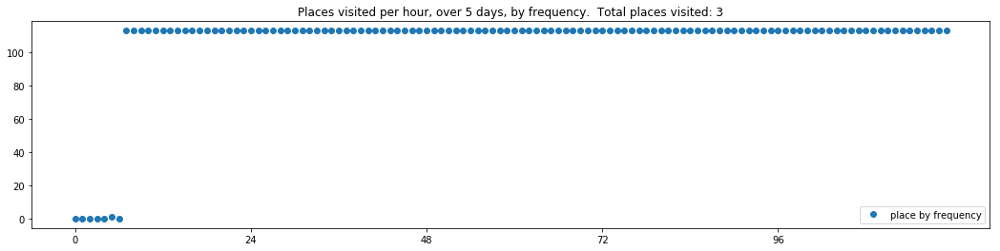

----- vector ----
prefix labels:  [392, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 570, 570, 374, 374, 374, 374, 374, 374, 374, 374, 374, 374, 374, 374, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 309, 0, 0, 0, 0, 0, 0, 0, 0, 165, 304, 165, 165, 0, 0, 0]


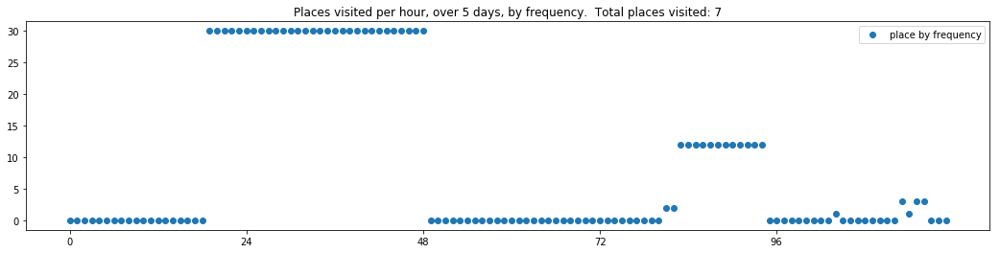

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392]


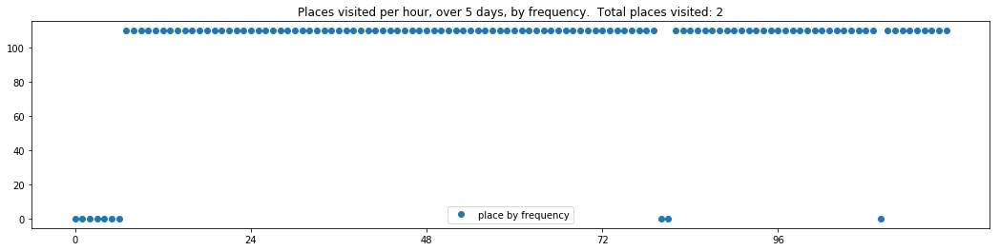

----- vector ----
prefix labels:  [339, 339]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]


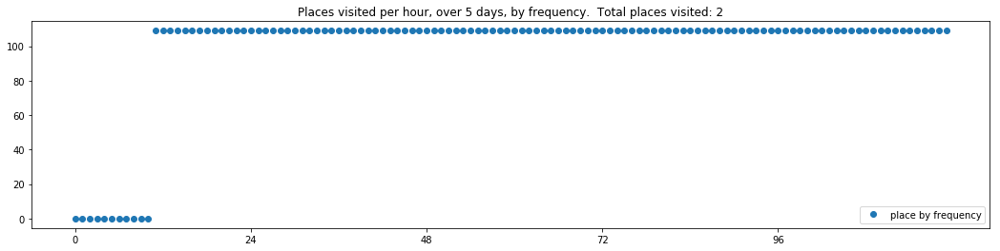

----- vector ----
prefix labels:  [109, 109]
[0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109]
[109, 109, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 412, 412, 412, 412]
[412, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 412, 412, 0, 0, 0, 0, 0, 0, 0, 412, 412, 247, 0, 0, 0, 109, 109, 109]


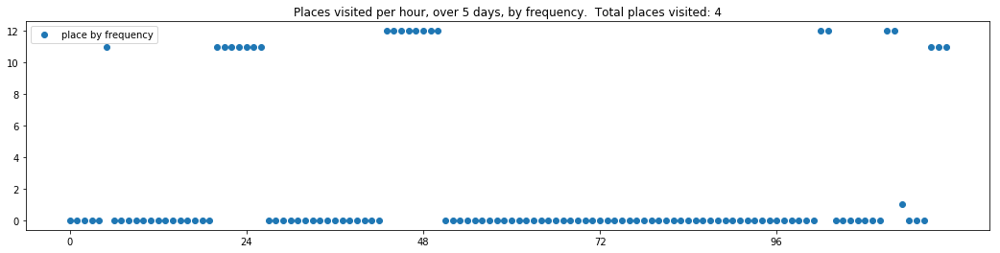

----- vector ----
prefix labels:  [216, 125]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]
[216, 216, 216, 0, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]
[216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]
[216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]


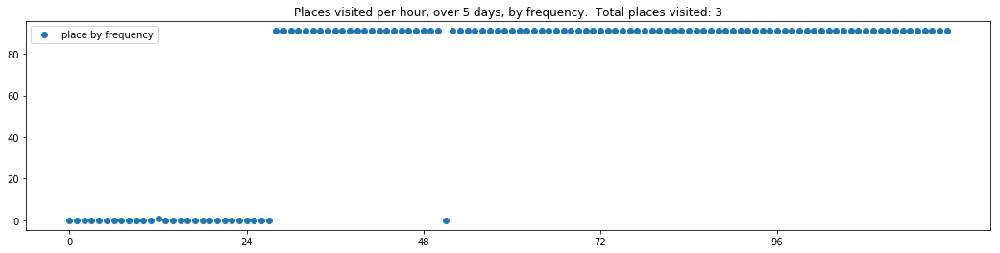

----- vector ----
prefix labels:  [486, 486]
[486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486]
[486, 0, 0, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486]
[486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486]
[486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486]
[486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486, 486]


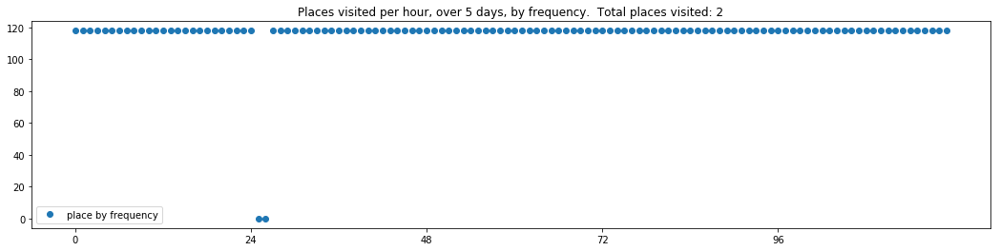

----- vector ----
prefix labels:  [104, 104]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 0, 0, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]
[104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104, 104]


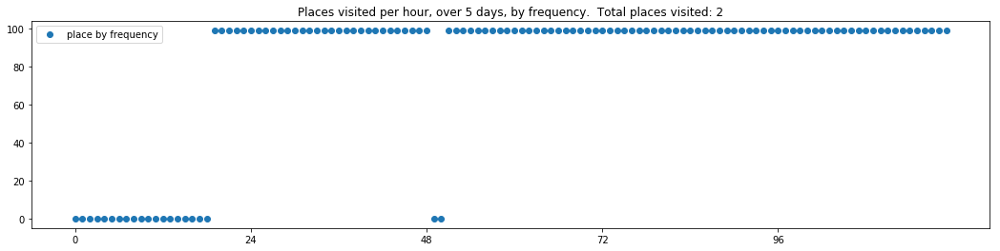

----- vector ----
prefix labels:  [22, 22]
[0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]
[77, 77, 0, 22, 22, 22, 22, 22, 22, 22, 22, 0, 0, 0, 0, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 270, 270, 270, 270, 270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 65, 65, 65, 65, 65, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


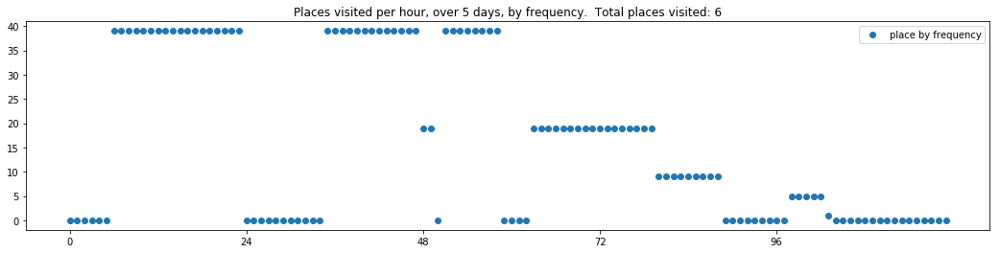

----- vector ----
prefix labels:  [8, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


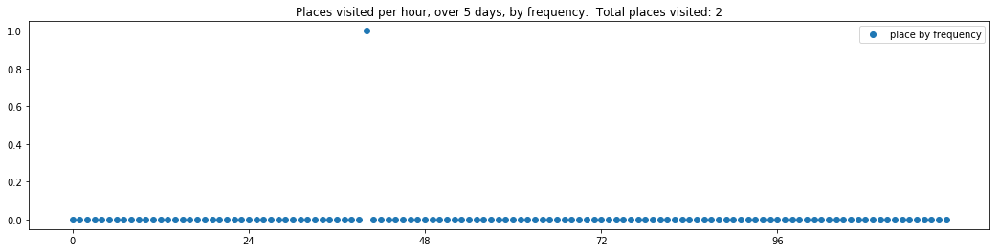

----- vector ----
prefix labels:  [88, 88]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 88, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 88]
[88, 88, 88, 88, 88, 88, 88, 88, 88, 88, 88, 88, 88, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


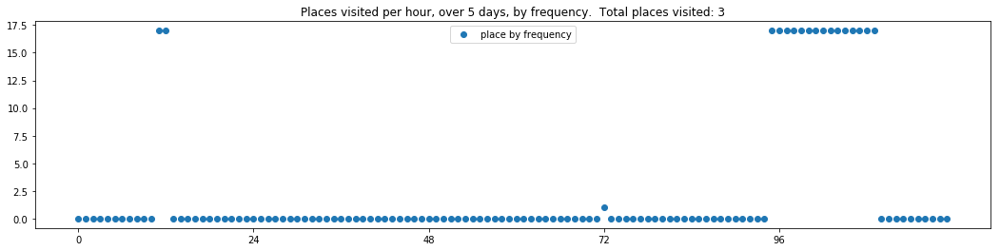

----- vector ----
prefix labels:  [90, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


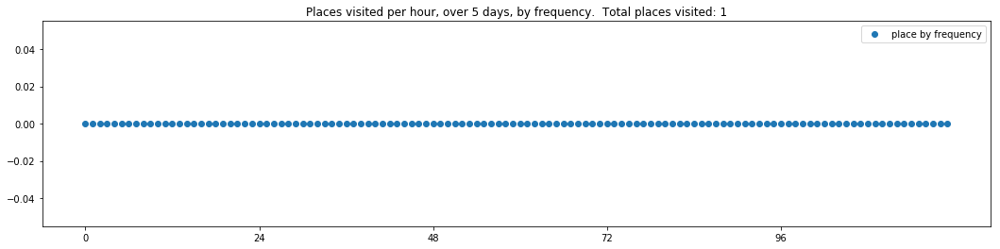

----- vector ----
prefix labels:  [141, 112]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 216, 216, 216, 0, 0, 0, 0, 216, 216, 216, 216, 216, 216, 216, 216]
[0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 0, 0, 0, 0, 0, 0, 251, 251, 251, 251, 251, 251, 251, 251, 251, 130, 69, 429, 429, 429, 69]
[69, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 214, 0, 0, 0, 0, 141, 214, 214, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555, 555]


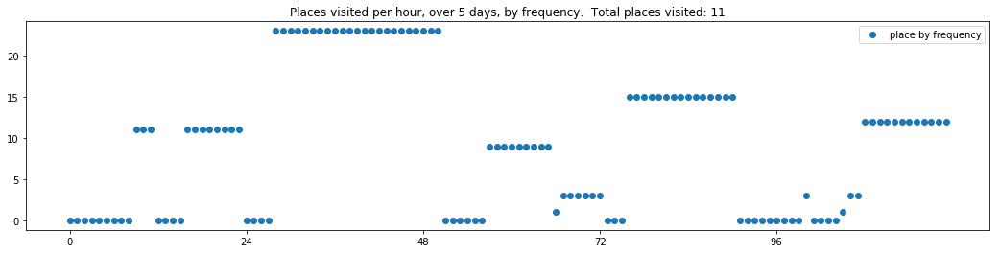

----- vector ----
prefix labels:  [461, 461]
[0, 0, 0, 0, 0, 0, 0, 0, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]
[461, 461, 461, 0, 0, 0, 0, 0, 0, 0, 400, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


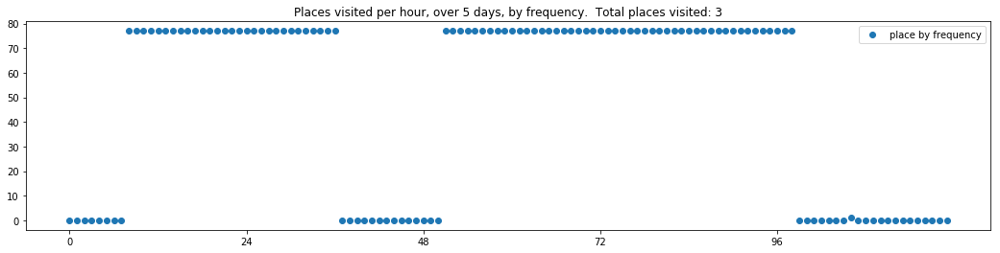

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 26, 26, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0]
[0, 0, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]


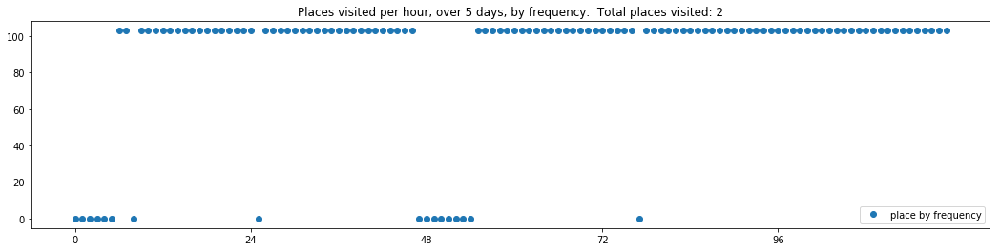

----- vector ----
prefix labels:  [20, 20]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 20, 0, 0, 20, 20, 20, 20, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 204, 204, 204, 204]


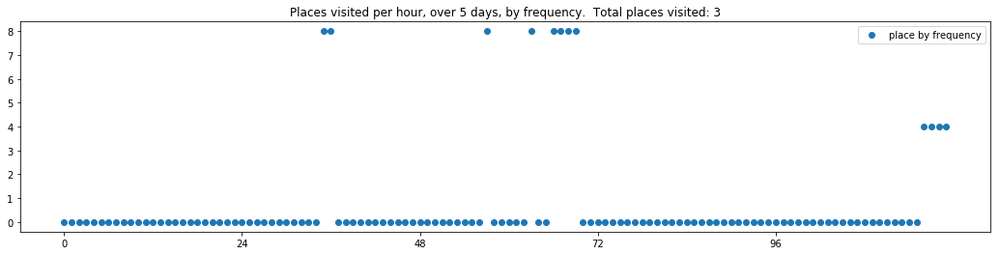

----- vector ----
prefix labels:  [339, 339]
[0, 0, 0, 0, 0, 0, 0, 0, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 202, 202, 202, 202, 339, 339, 339, 339, 0, 0, 0]
[0, 0, 0, 0, 390, 0, 0, 0, 0, 0, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]


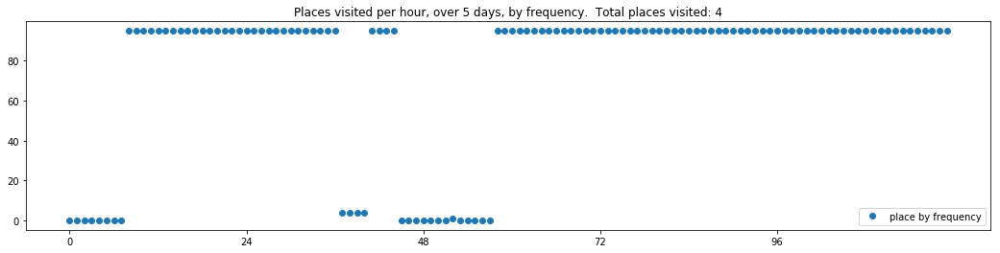

----- vector ----
prefix labels:  [559, 559]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 559, 559, 0, 0, 0, 559, 0, 0, 0, 0, 0, 0, 225, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 559, 559, 559, 559, 559, 559, 559, 559, 559, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 559, 559, 559, 559, 0, 0, 0, 0, 0, 0, 0, 0, 559, 0, 0, 0, 0, 559, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 374, 374, 0, 0, 0, 0, 0, 0, 559, 559]
[559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 559, 0, 0, 0, 0, 0]


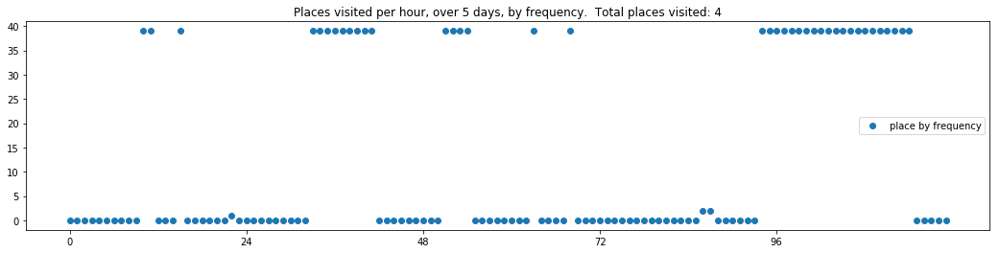

----- vector ----
prefix labels:  [423, 423]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 423, 423, 423, 423, 423, 423]
[423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423]
[423, 423, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 423, 423, 423, 404, 423, 423, 423, 423, 423]
[423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 422, 423]
[423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423, 423]


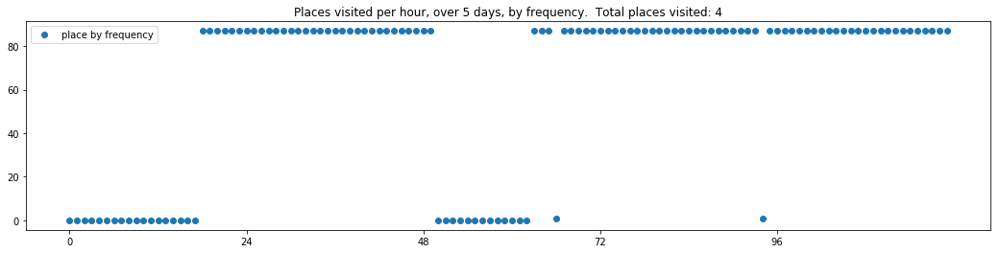

----- vector ----
prefix labels:  [242, 242]
[0, 0, 0, 0, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 0, 0]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]


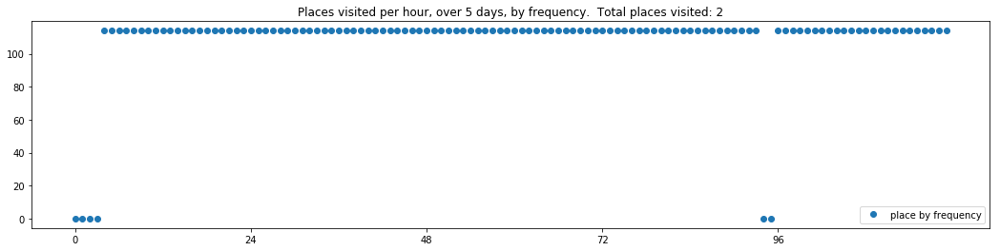

----- vector ----
prefix labels:  [414, 414]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 576, 0, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 317, 414, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]
[414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414, 414]


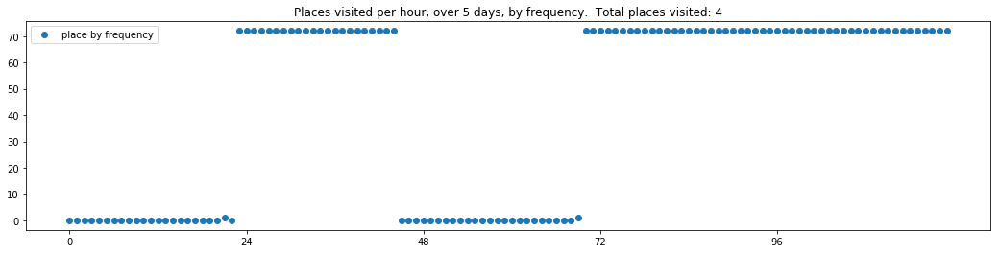

----- vector ----
prefix labels:  [190, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 599, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 190, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


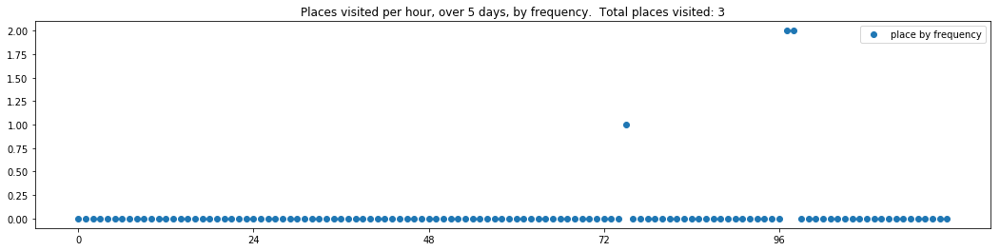

----- vector ----
prefix labels:  [91, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7]
[7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7]
[7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7]


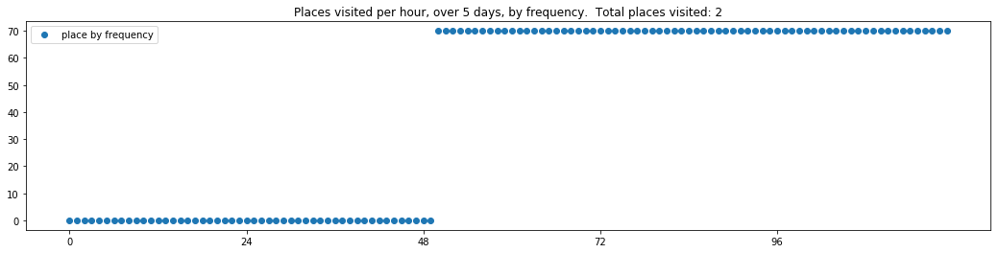

----- vector ----
prefix labels:  [465, 123]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 586, 586, 586, 0, 0, 0, 0, 488, 0, 93, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


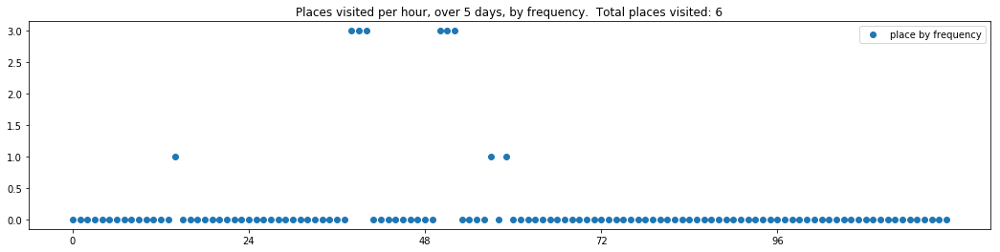

----- vector ----
prefix labels:  [143, 379]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4]
[0, 0, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 353, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 353, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 112, 0, 0, 0]


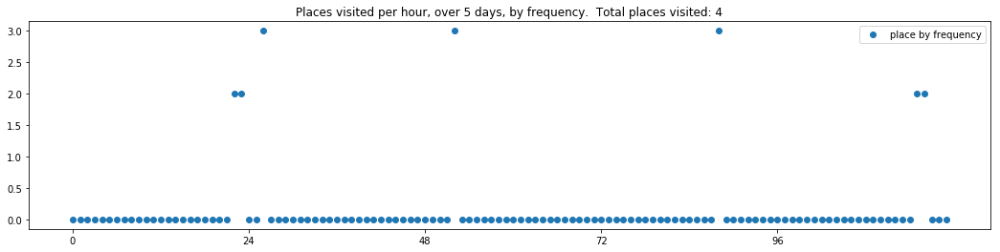

----- vector ----
prefix labels:  [462, 462]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 0]
[0, 0, 0, 462, 462, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 311, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390]
[390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 390, 0, 0, 390, 390, 390]


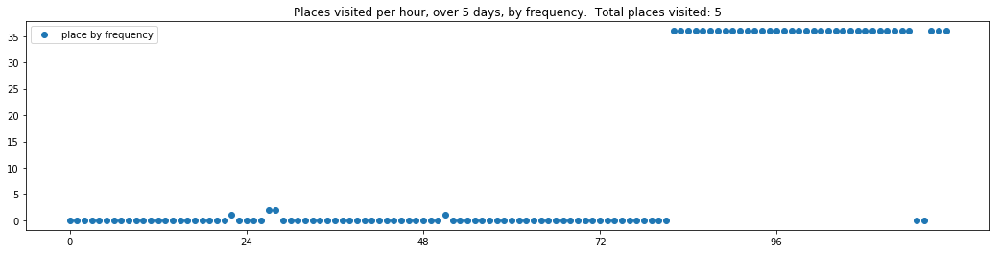

----- vector ----
prefix labels:  [372, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 372, 372, 372, 357, 357, 357, 372, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]


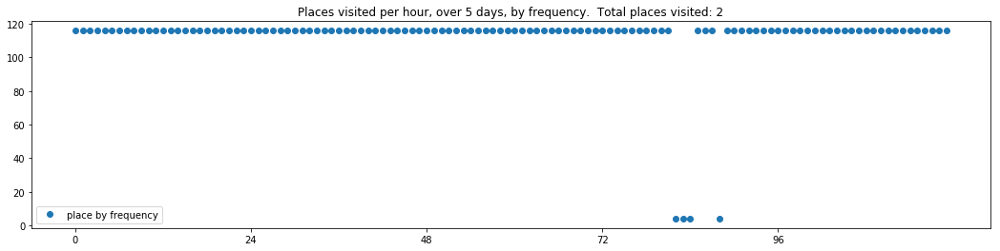

----- vector ----
prefix labels:  [43, 43]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 43, 43, 43, 43]


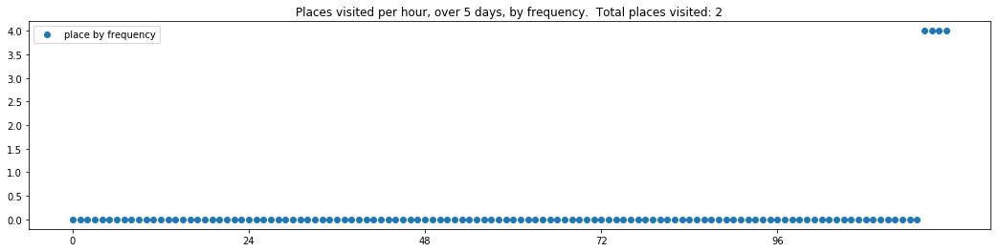

----- vector ----
prefix labels:  [568, 568]
[0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568, 568]
[568, 568, 568, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 568, 568, 568, 568, 568, 568, 568]


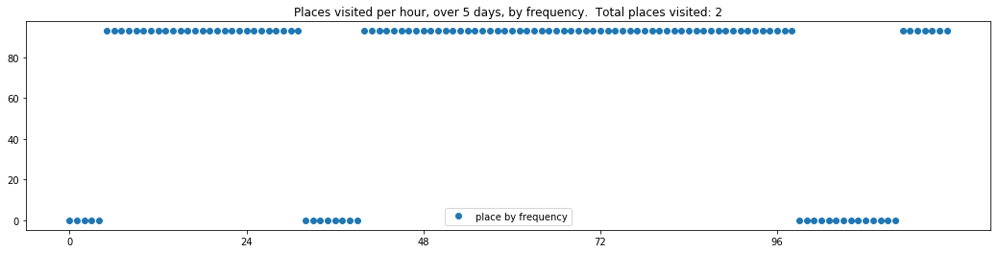

----- vector ----
prefix labels:  [304, 304]
[0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 334, 334, 334, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 0]


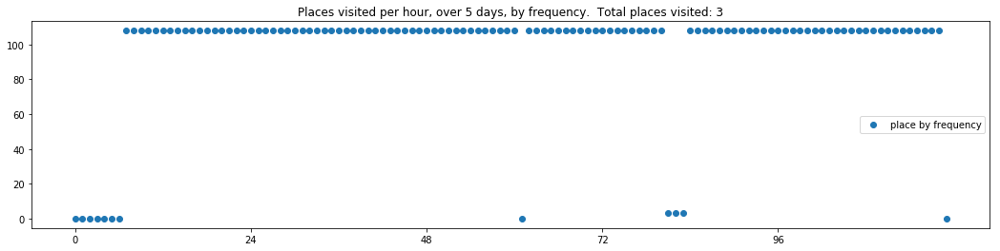

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 21, 21, 21]
[0, 21, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21]
[21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21]
[21, 21, 0, 21, 0, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 4, 4]


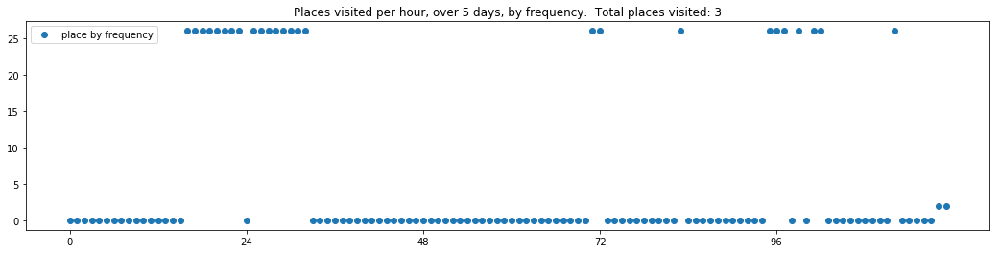

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 0, 0, 0, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


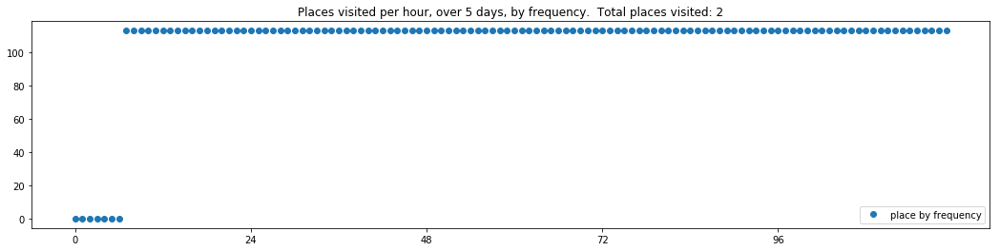

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71, 71, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


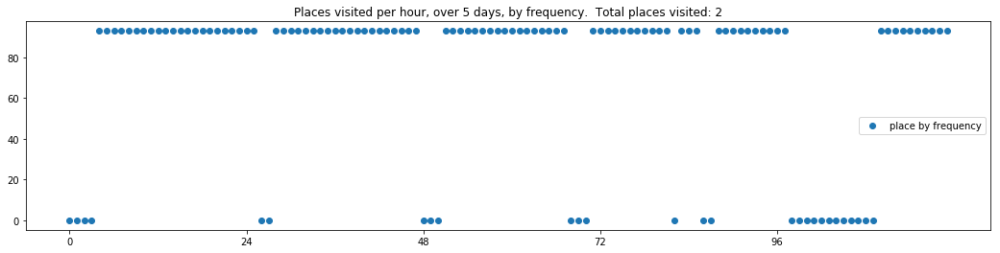

----- vector ----
prefix labels:  [401, 401]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80, 80]
[80, 80, 80, 80, 80, 80, 80, 80, 401, 401, 401, 401, 401, 401, 401, 80, 80, 80, 80, 80, 80, 80, 80, 80]


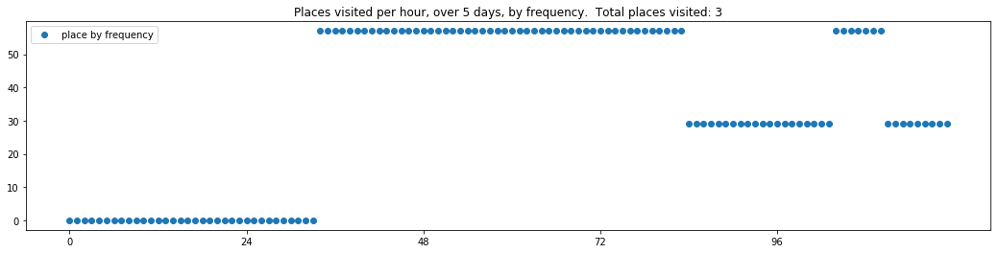

----- vector ----
prefix labels:  [135, 21]
[0, 0, 0, 0, 0, 0, 0, 56, 56, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[192, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 407, 0, 0]


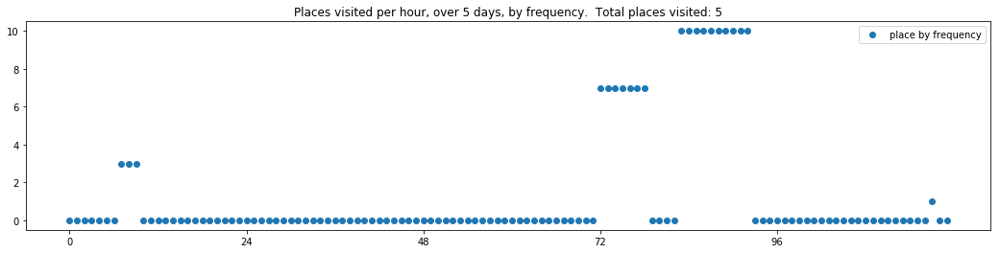

----- vector ----
prefix labels:  [328, 415]
[0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 463]
[415, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 208, 208]
[208, 208, 208, 208, 208, 208, 208, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 463, 0, 0, 328, 328]
[328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328, 328]


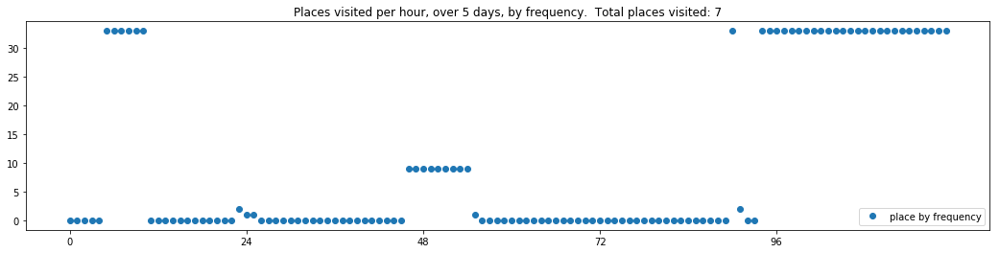

----- vector ----
prefix labels:  [458, 458]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458, 458]
[458, 458, 458, 458, 458, 458, 458, 458, 458, 0, 0, 0, 0, 0, 0, 0, 0, 458, 458, 458, 458, 458, 458, 458]


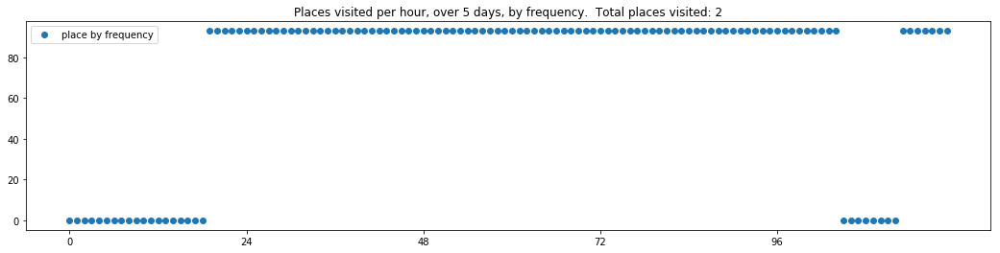

----- vector ----
prefix labels:  [64, 64]
[0, 0, 0, 0, 64, 64, 64, 64, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 0, 64, 64, 33, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 64]
[64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]


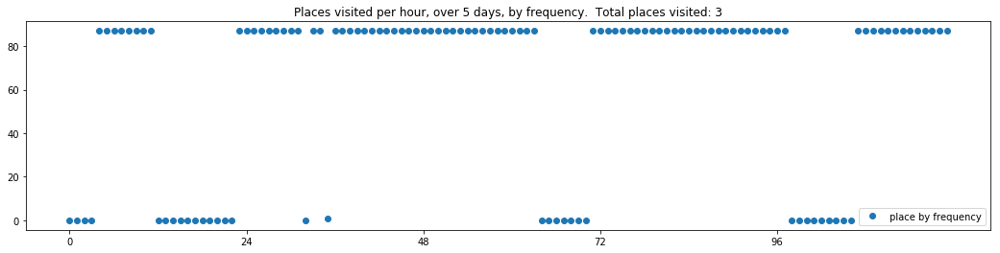

----- vector ----
prefix labels:  [172, 172]
[0, 0, 0, 0, 0, 0, 0, 172, 0, 0, 0, 459, 459, 459, 0, 0, 459, 459, 459, 0, 172, 172, 172, 172]
[172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172, 172]
[172, 172, 172, 0, 0, 0, 0, 0, 0, 172, 172, 172, 172, 172, 172, 0, 0, 172, 172, 172, 172, 0, 172, 283]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 172, 0, 0, 0, 208, 208, 208, 459]
[459, 459, 459, 459, 459, 229, 208, 283, 0, 172, 172, 172, 172, 172, 172, 172, 0, 172, 172, 172, 172, 172, 172, 172]


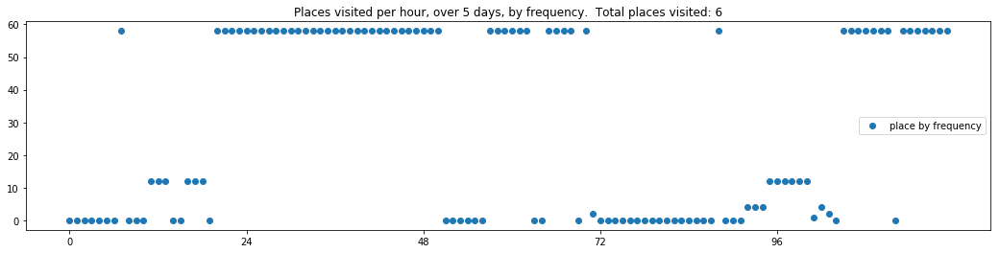

----- vector ----
prefix labels:  [391, 391]
[0, 0, 0, 0, 0, 165, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


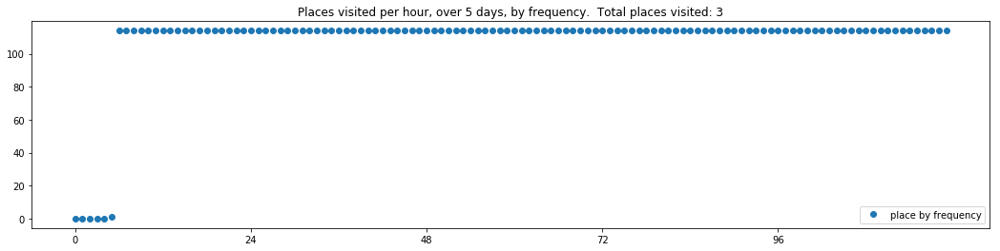

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 20, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]


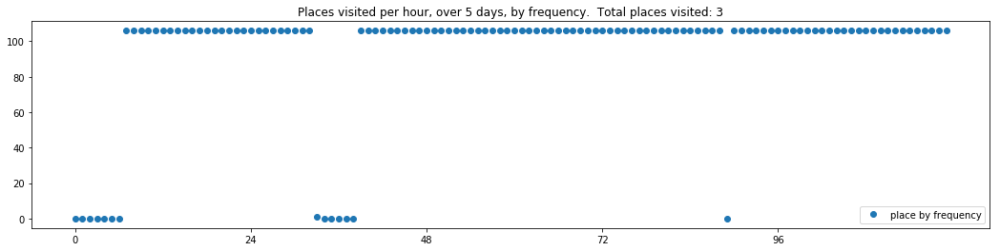

----- vector ----
prefix labels:  [25, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 25, 0, 25, 25, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 25, 25, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 25, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 25, 25, 25, 25, 25, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 25, 25, 0, 0, 0, 25, 25, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0]


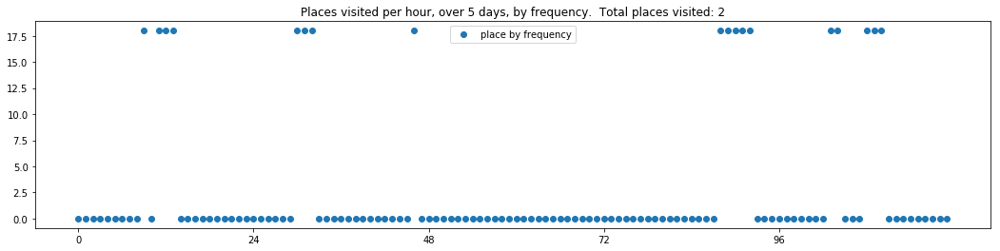

----- vector ----
prefix labels:  [150, 278]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 143, 143, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278]
[278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 278, 0, 0, 0, 278, 278, 0]
[0, 0, 0, 100, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 278, 278]


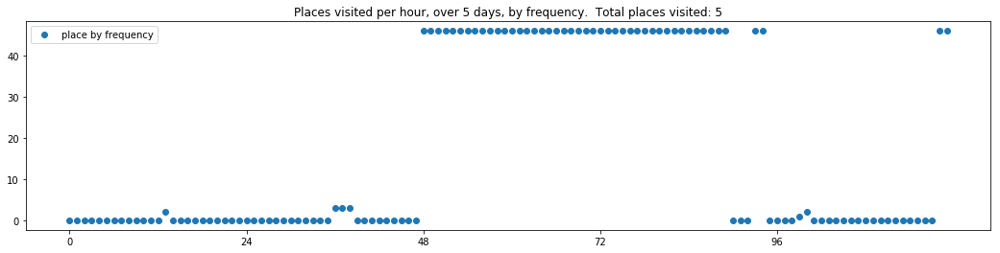

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 71, 71]
[71, 71, 71, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71]
[71, 71, 71, 39, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


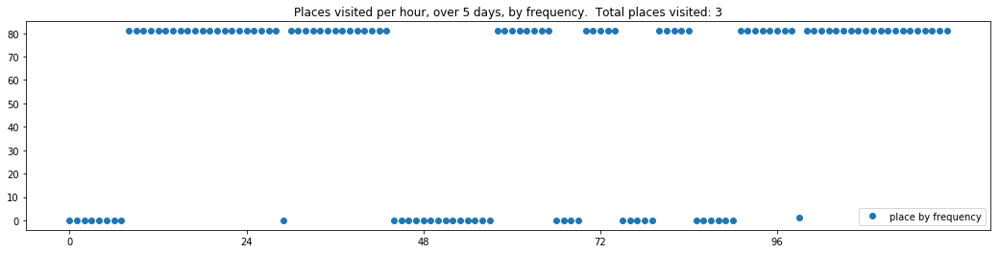

----- vector ----
prefix labels:  [8, 8]
[0, 0, 0, 0, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 269, 269, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


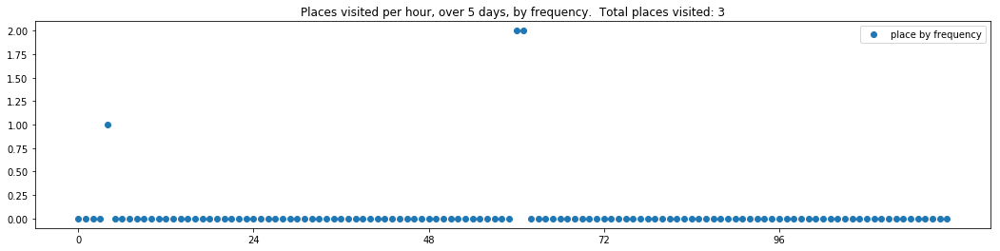

----- vector ----
prefix labels:  [122, 122]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 122, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]


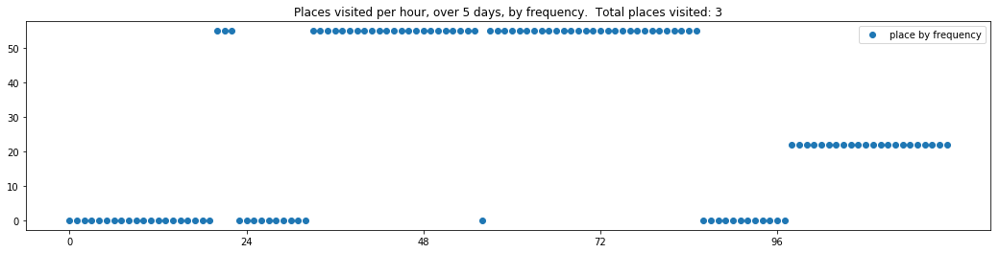

----- vector ----
prefix labels:  [69, 194]
[0, 0, 0, 0, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 181, 181, 470, 470, 470]
[470, 470, 470, 470, 0, 0, 0, 0, 0, 0, 0, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 392, 0, 39, 0, 392, 392, 392, 194, 194, 194, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


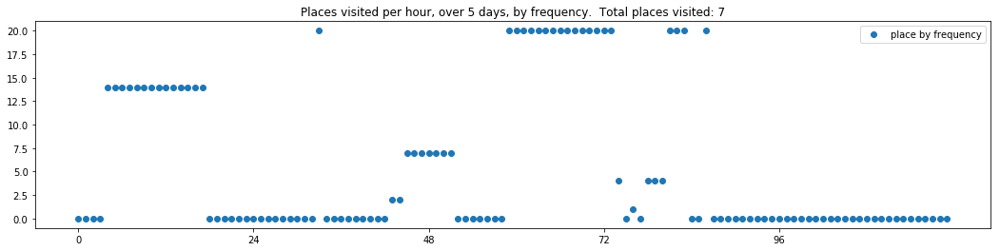

----- vector ----
prefix labels:  [557, 557]
[0, 0, 0, 0, 0, 557, 557, 557, 557, 557, 557, 0, 0, 0, 0, 0, 557, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 420, 420, 420, 420, 557, 557, 557]
[557, 557, 557, 557, 557, 557, 557, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 0, 0, 0, 0, 0, 0]
[22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


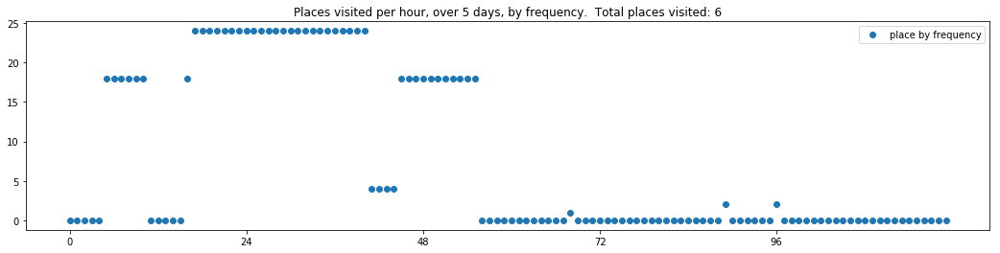

----- vector ----
prefix labels:  [2, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 20, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 38, 38, 38, 38, 38, 38, 0, 0, 0, 0, 0, 0]


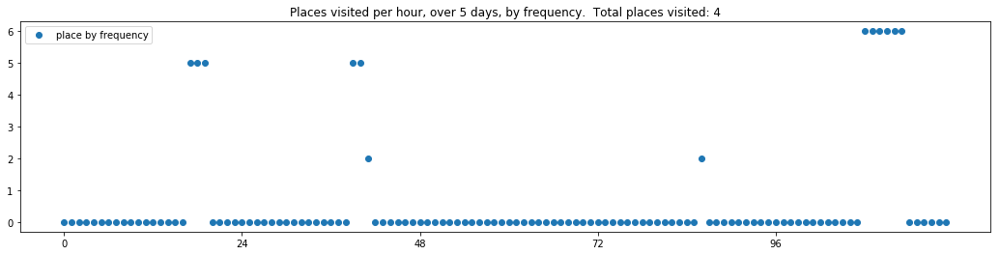


------
 110 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_110.txt 
------

----- vector ----
prefix labels:  [435, 353]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 0, 142, 213, 213, 213, 213, 213]
[213, 0, 0, 0, 0, 0, 0, 0, 0, 435, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 459, 459, 459, 459, 459, 459, 459, 459, 459, 459, 339, 0, 0, 0, 0, 0, 0, 0]


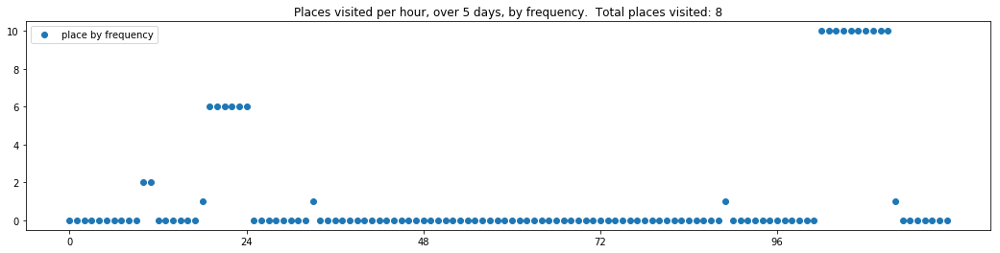

----- vector ----
prefix labels:  [26, 26]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 0, 413, 0]
[0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 0, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]
[26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26]


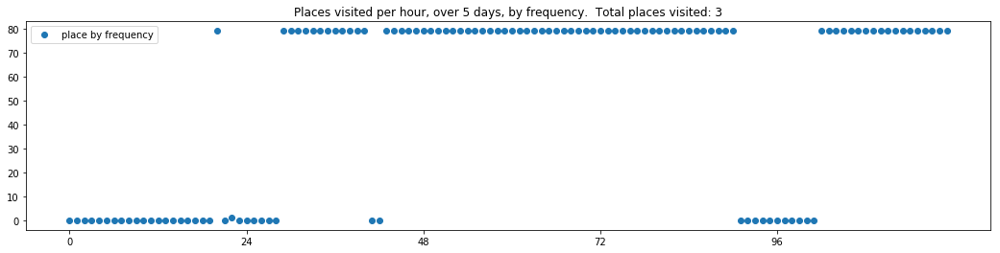

----- vector ----
prefix labels:  [146, 146]
[0, 0, 0, 0, 0, 0, 200, 0, 0, 0, 0, 0, 0, 0, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146]
[146, 146, 222, 146, 146, 146, 146, 146, 146, 146, 146, 146, 0, 0, 0, 222, 222, 146, 146, 559, 559, 0, 0, 0]
[374, 146, 146, 146, 146, 146, 146, 559, 559, 559, 559, 146, 146, 559, 559, 559, 0, 0, 0, 0, 0, 0, 559, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 559, 0, 0, 146, 146, 0, 146, 146, 146, 146]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 0, 0, 0, 0, 0, 0, 146, 0, 0, 0, 0]


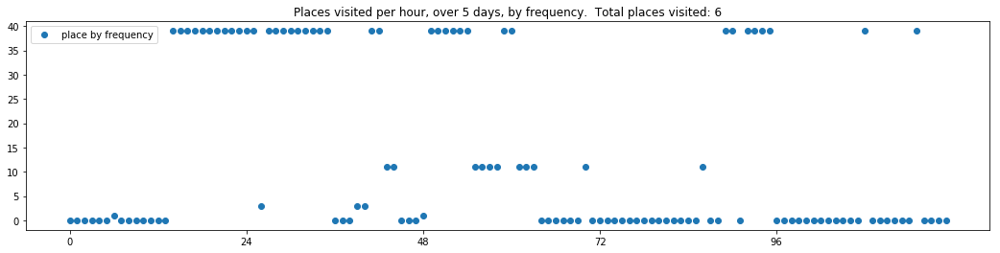

----- vector ----
prefix labels:  [16, 266]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 16, 16, 101]
[0, 0, 0, 0, 0, 411, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 479, 479]
[479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479]
[479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479]
[479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479]


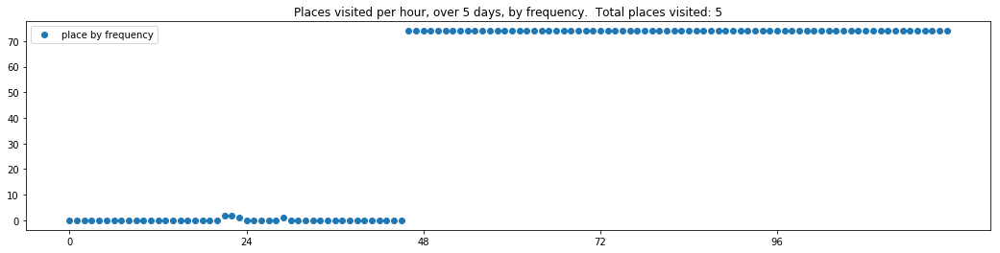

----- vector ----
prefix labels:  [162, 162]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 448, 448, 448, 448, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


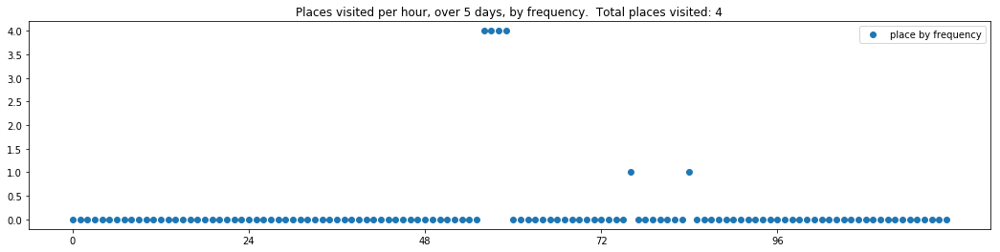

----- vector ----
prefix labels:  [391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 195, 195, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


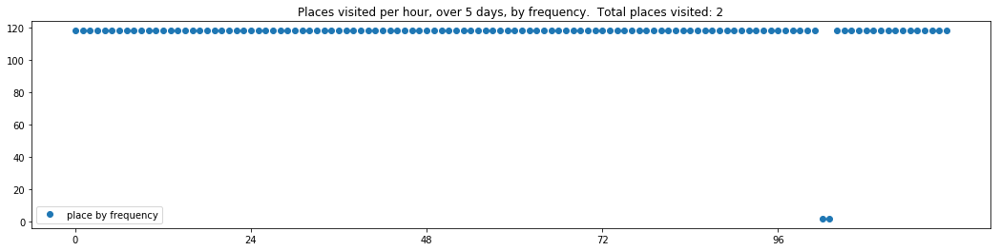

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 0, 4]
[4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


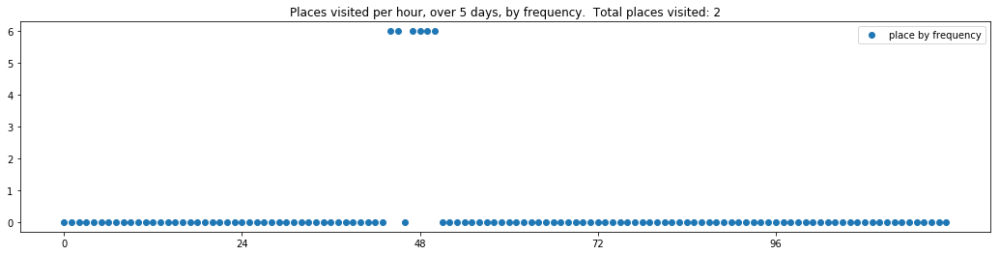

----- vector ----
prefix labels:  [5, 5]
[0, 0, 0, 0, 0, 209, 209, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]
[5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]
[5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]
[5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


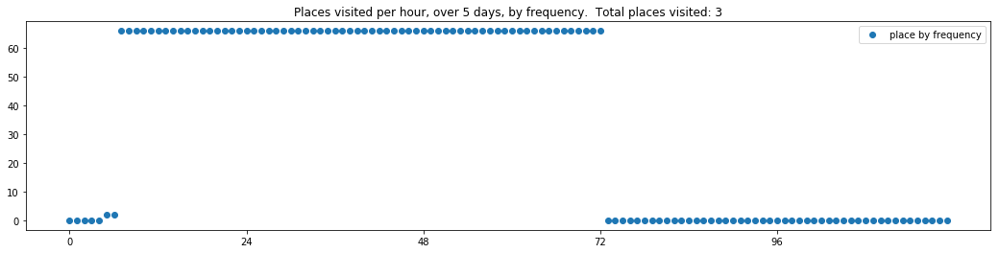

----- vector ----
prefix labels:  [223, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 68, 0, 0, 0, 216, 216, 216, 216]
[216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216, 216]


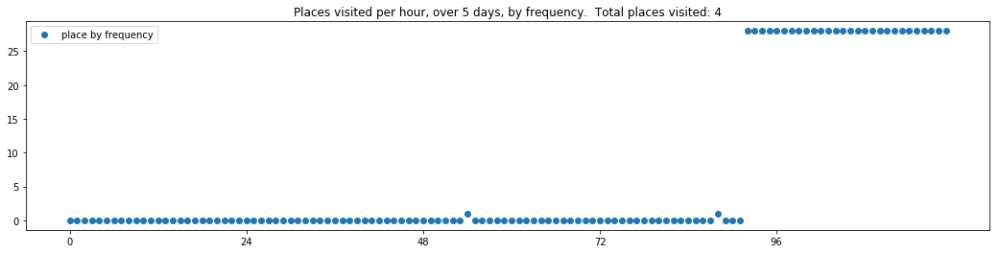

----- vector ----
prefix labels:  [401, 401]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401]
[401, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 401, 0, 0, 0, 0]


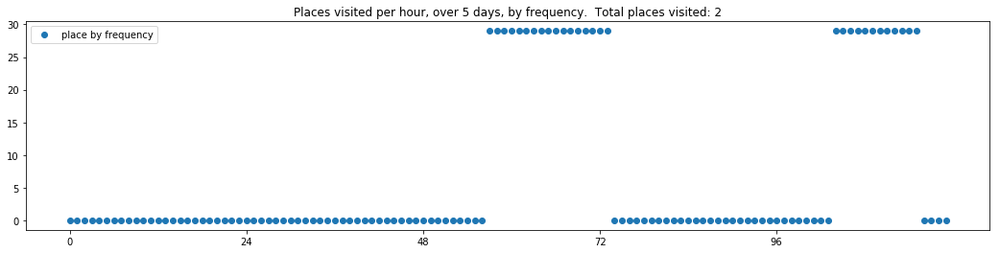

----- vector ----
prefix labels:  [590, 590]
[0, 0, 0, 0, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 590, 590, 590]
[590, 0, 0, 0, 0, 590, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[590, 590, 590, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


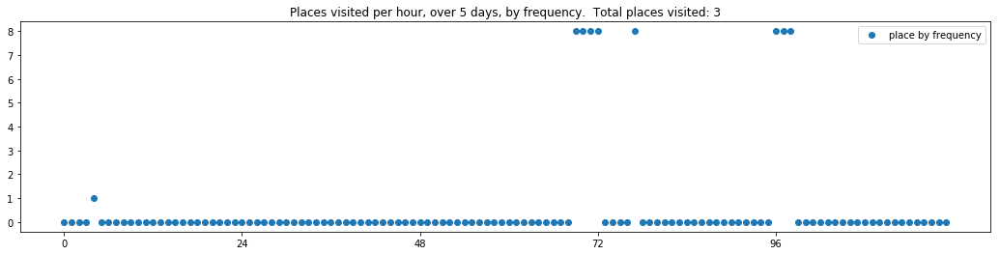

----- vector ----
prefix labels:  [261, 143]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 260, 260, 52, 52, 0, 0, 0, 0, 0, 0]
[260, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]


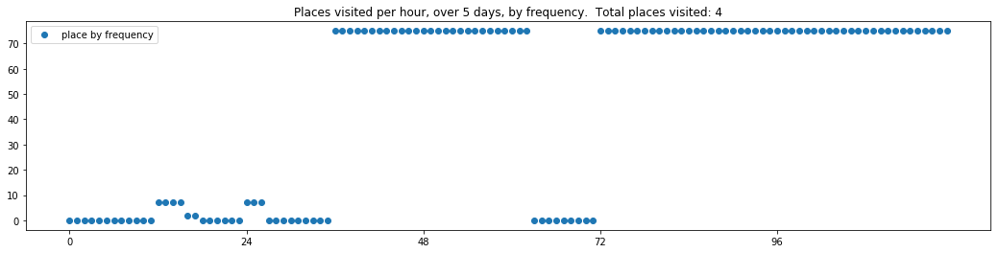

----- vector ----
prefix labels:  [21, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


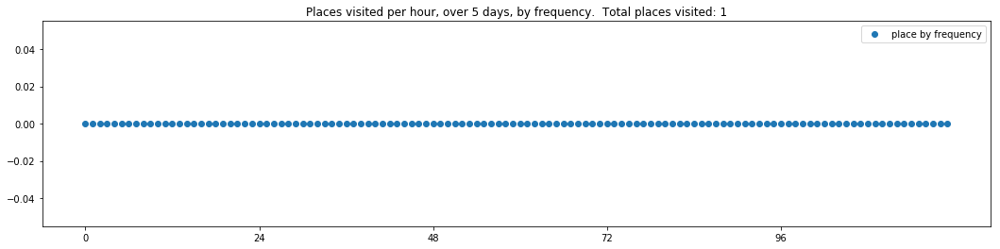

----- vector ----
prefix labels:  [311, 311]
[0, 0, 0, 0, 311, 311, 311, 311, 311, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311]
[311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 311, 0, 0, 0, 0, 0]


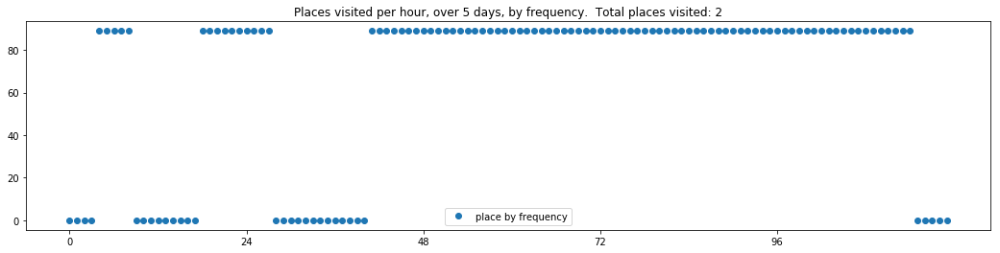

----- vector ----
prefix labels:  [94, 0]
[0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 94, 94, 94, 94, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94]


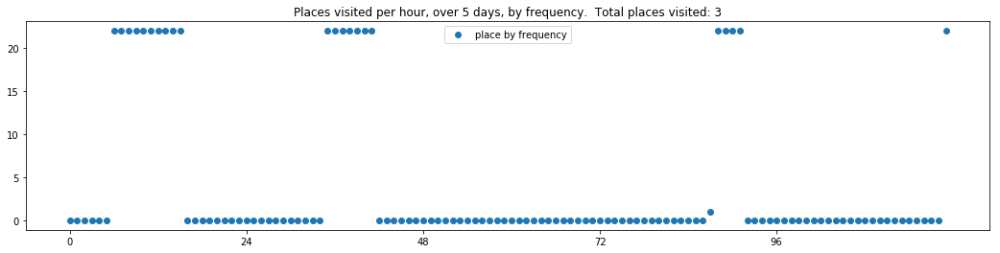

----- vector ----
prefix labels:  [480, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 33, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]


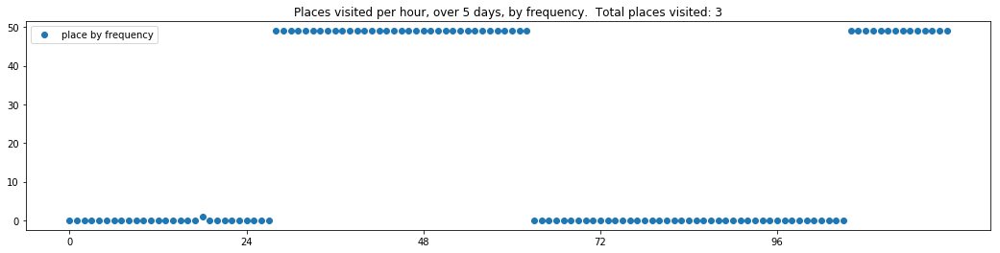

----- vector ----
prefix labels:  [391, 391]
[0, 0, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 0, 0, 0, 0, 0, 0, 0, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]
[391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391, 391]


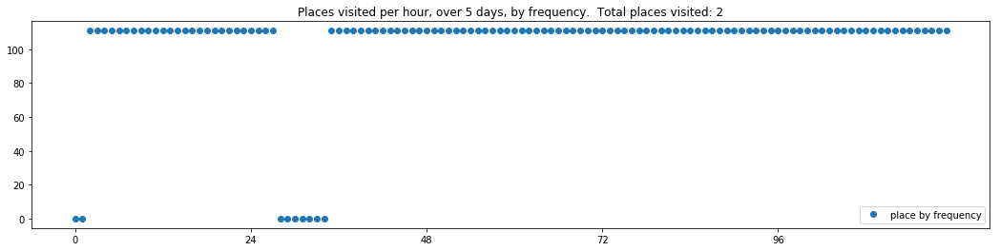

----- vector ----
prefix labels:  [558, 429]
[212, 0, 212, 0, 279, 279, 279, 279, 279, 279, 0, 0, 0, 0, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 0, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]
[611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611, 611]


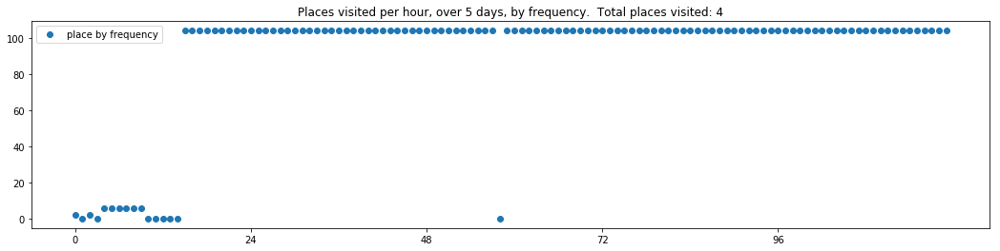

----- vector ----
prefix labels:  [242, 242]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 0, 0, 0, 0, 0, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]


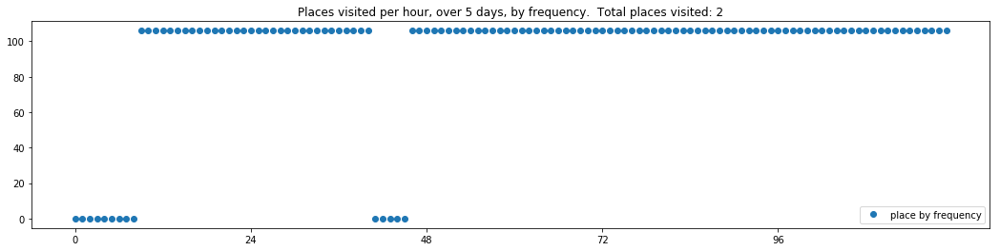

----- vector ----
prefix labels:  [69, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


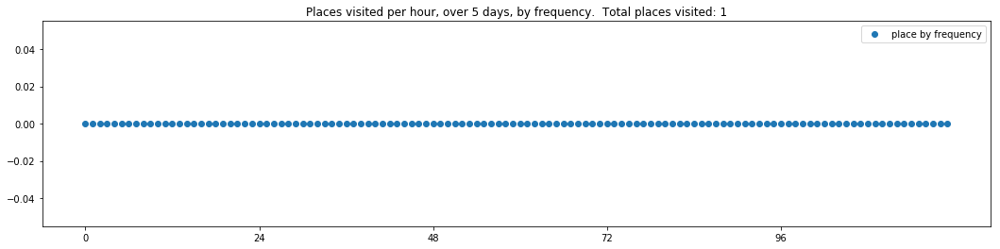

----- vector ----
prefix labels:  [87, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


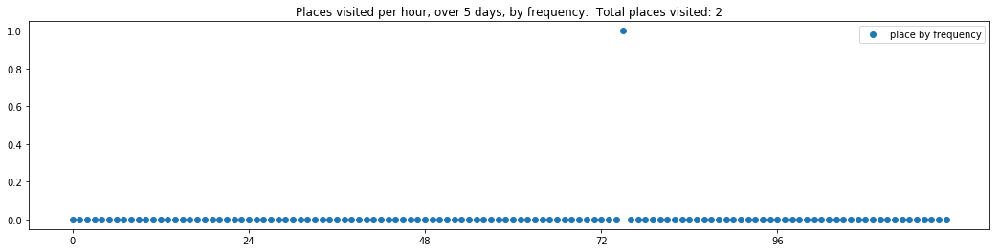

----- vector ----
prefix labels:  [98, 98]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 98, 98, 271, 271, 271, 271]
[271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


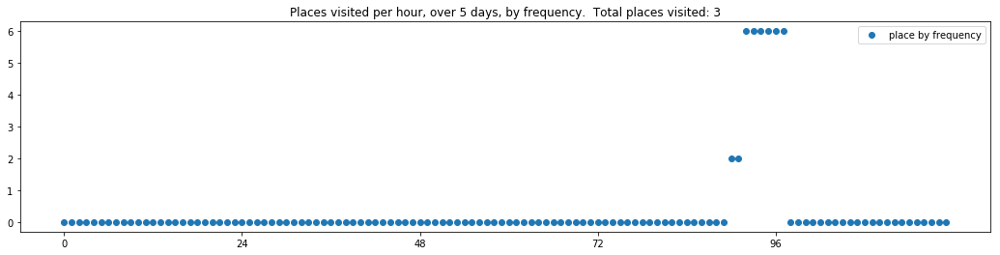

----- vector ----
prefix labels:  [488, 488]
[0, 0, 0, 0, 0, 0, 0, 0, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488]
[488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 488, 0, 0, 0, 0, 0, 0, 0]


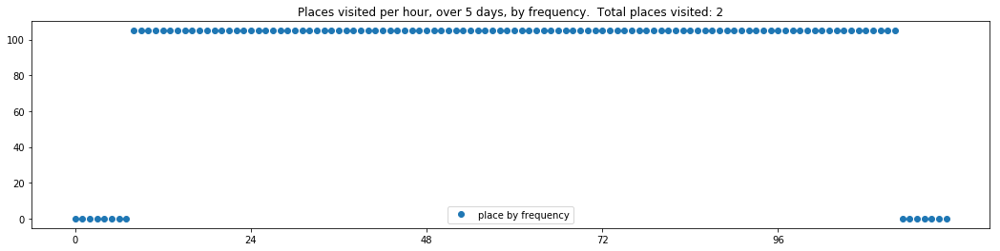

----- vector ----
prefix labels:  [303, 303]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 303, 303, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 0, 0, 0, 0, 0, 629, 629, 629, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 303, 303, 303, 0]


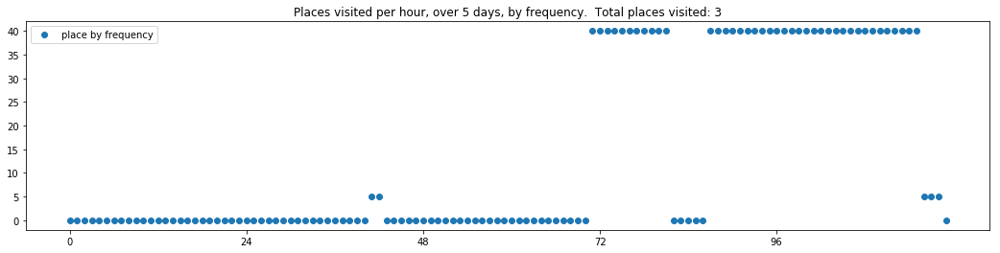

----- vector ----
prefix labels:  [502, 502]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 0, 0, 0, 0, 0, 0, 502, 502, 0, 0, 0]


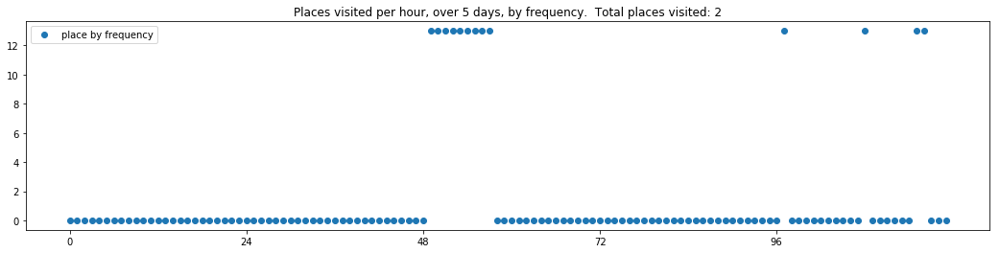

----- vector ----
prefix labels:  [128, 128]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128]
[128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100]
[100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 262, 262, 262, 262, 262, 262, 262, 262, 262, 262, 262, 262, 0, 0]
[0, 0, 0, 0, 0, 34, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 156, 0]


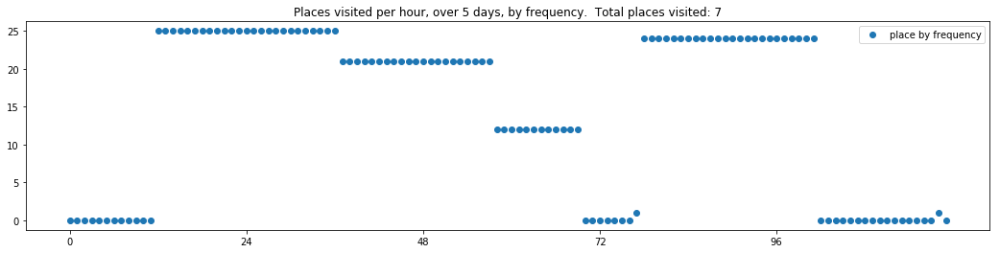

----- vector ----
prefix labels:  [378, 378]
[0, 0, 0, 0, 0, 378, 378, 378, 378, 378, 378, 0, 0, 0, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378, 378]


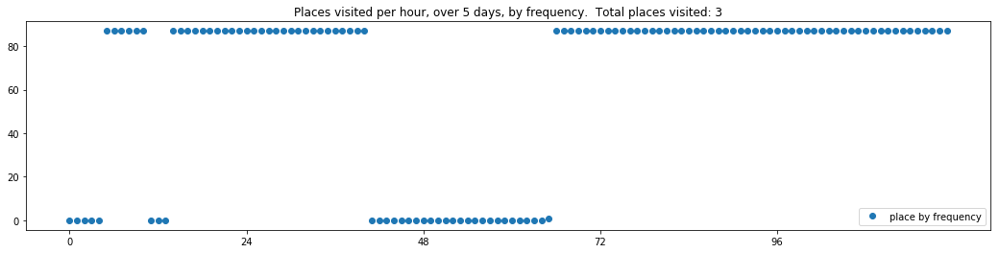

----- vector ----
prefix labels:  [188, 167]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 412, 0, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


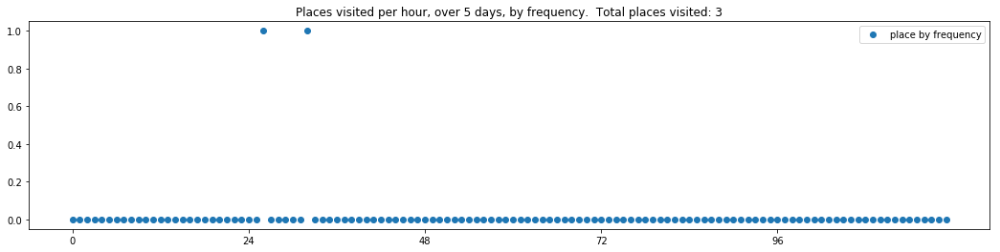

----- vector ----
prefix labels:  [638, 638]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638]
[638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638]
[638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638]
[638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638, 638]


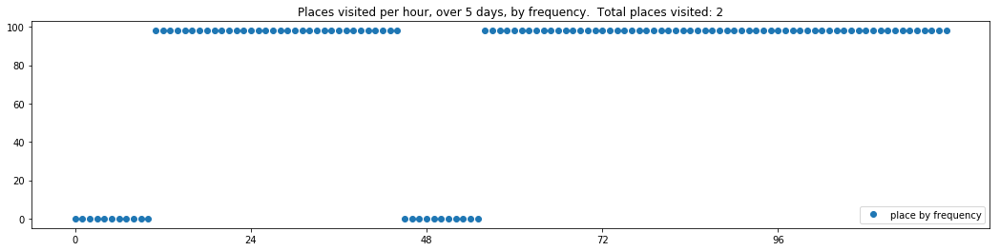

----- vector ----
prefix labels:  [152, 152]
[0, 0, 0, 0, 0, 0, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162]
[162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 162, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 162, 162, 162, 77, 77, 77, 77, 77, 77, 77]


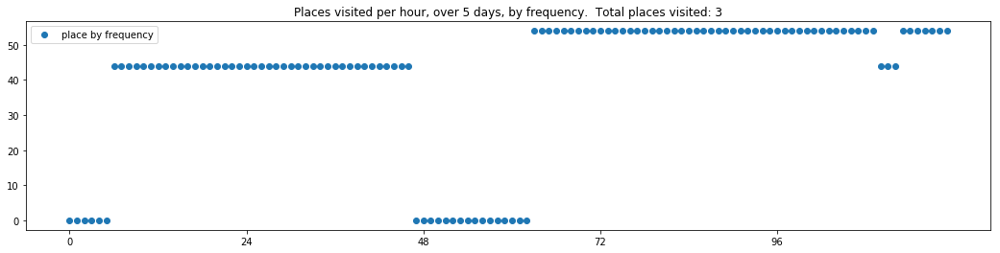

----- vector ----
prefix labels:  [64, 64]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 64, 64, 64, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64, 64]
[64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 27, 27, 27, 27, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]


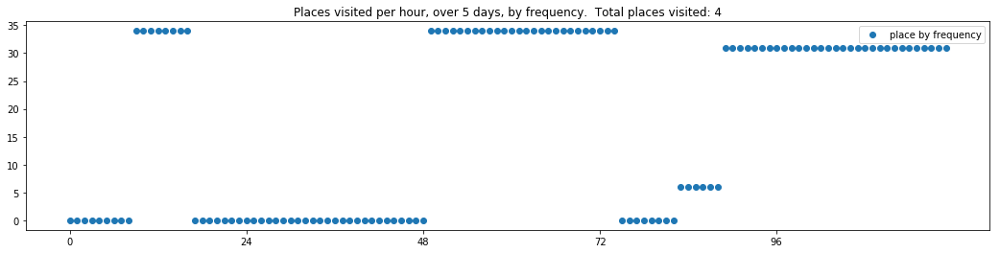

----- vector ----
prefix labels:  [130, 111]
[0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 478, 0, 435, 435]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 130, 0, 130, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 130, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 130, 130, 0, 0, 0, 0, 0, 0, 0, 0, 111, 111, 111, 0, 0, 111, 111]


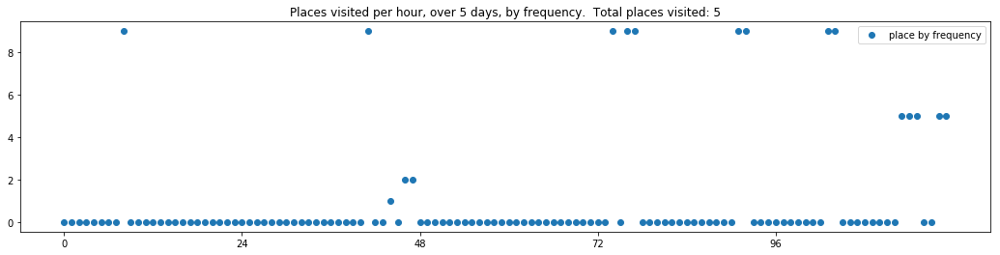

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 21, 21, 21, 0, 21, 21, 21, 21, 21, 21, 21, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


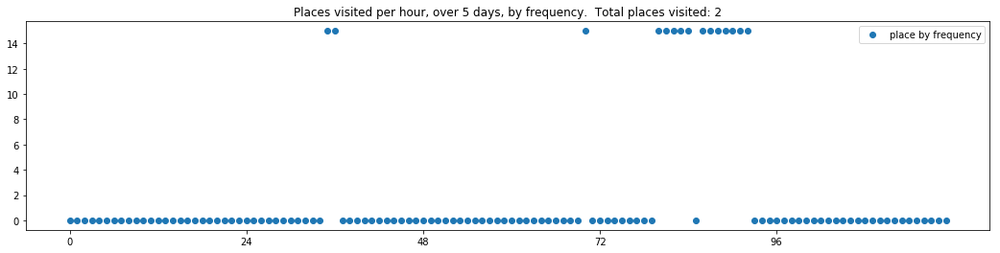

----- vector ----
prefix labels:  [184, 184]
[0, 0, 0, 0, 0, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 184, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 0, 0, 76, 76, 184, 184, 184, 184]


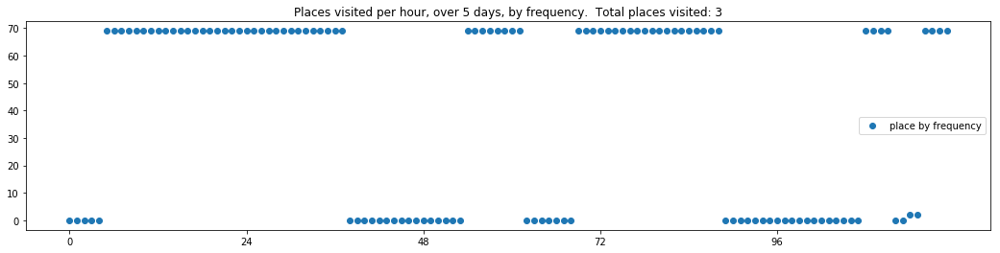

----- vector ----
prefix labels:  [161, 161]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126]
[126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 126, 161, 161, 161, 161]


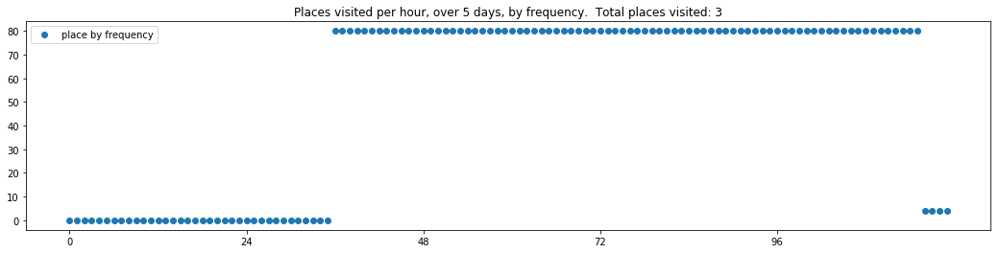

----- vector ----
prefix labels:  [550, 550]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 550, 550, 550, 550, 550, 550, 550, 550, 550]
[550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550]
[550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 0, 0, 0, 0, 550, 550, 550, 550, 550]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 550, 550, 550]
[550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550, 550]


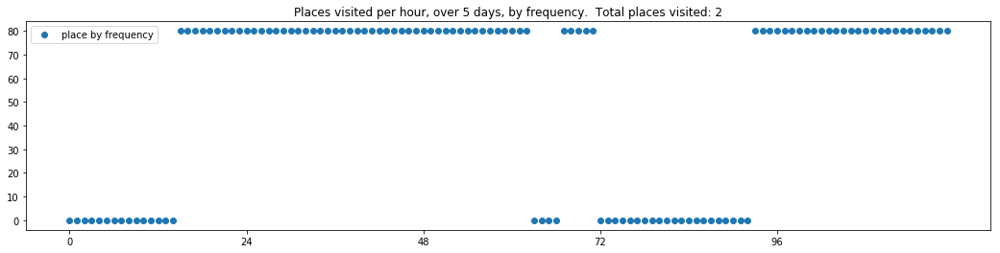

----- vector ----
prefix labels:  [87, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


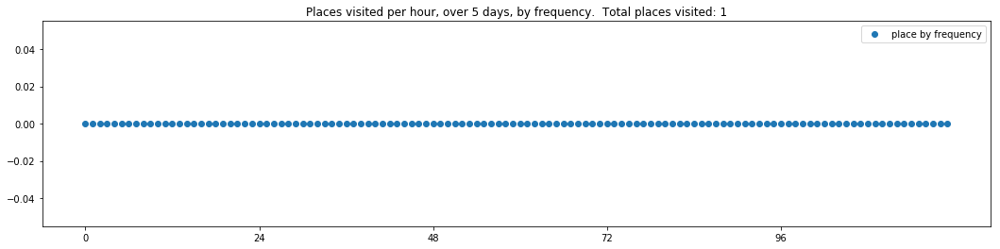

----- vector ----
prefix labels:  [493, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 2, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0]


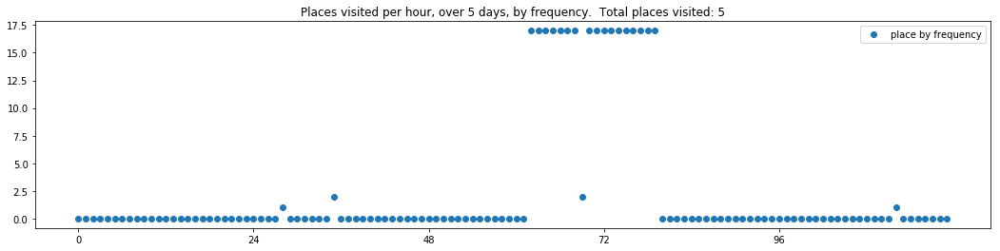

----- vector ----
prefix labels:  [135, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 317, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128, 128]
[128, 128, 128, 128, 128, 157, 157, 157, 157, 157, 414, 414, 414, 0, 0, 8, 0, 0, 0, 0, 34, 34, 34, 34]
[34, 34, 34, 34, 34, 34, 34, 34, 34, 34, 238, 238, 238, 0, 294, 294, 294, 294, 294, 294, 262, 262, 262, 262]
[262, 262, 262, 262, 262, 262, 262, 414, 414, 414, 414, 414, 414, 414, 414, 0, 0, 0, 0, 0, 0, 0, 0, 0]


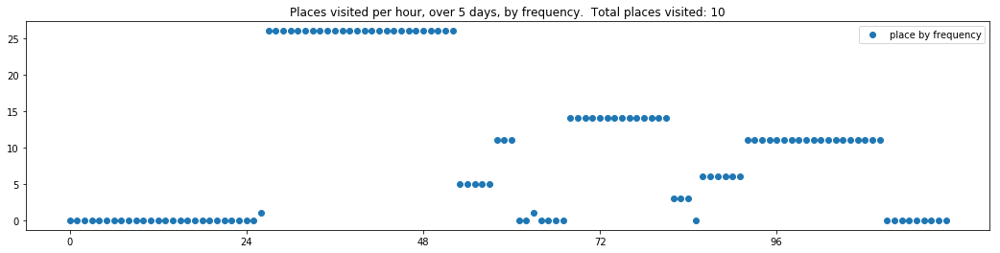

----- vector ----
prefix labels:  [146, 247]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 246, 0, 0, 0, 0, 0, 542, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


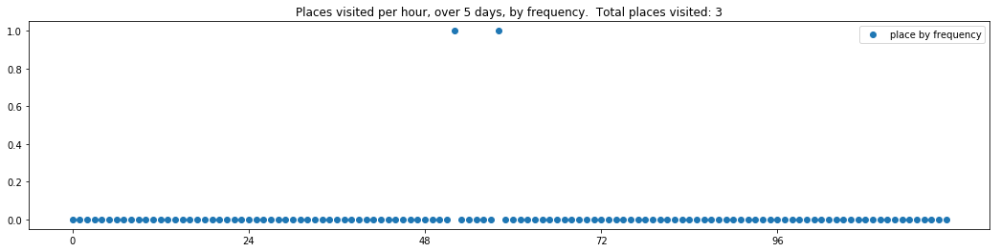

----- vector ----
prefix labels:  [69, 0]
[0, 69, 69, 69, 69, 69, 69, 69, 69, 69, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


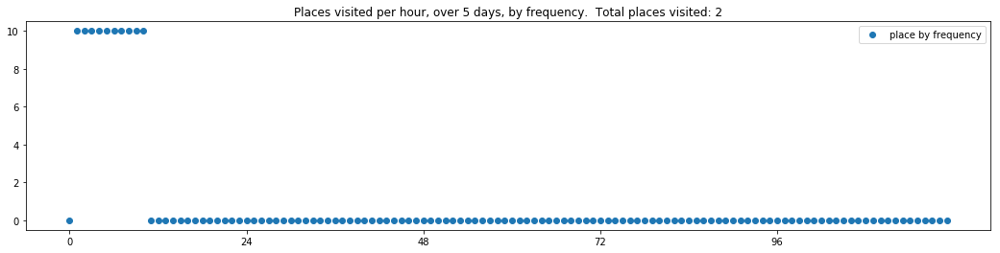

----- vector ----
prefix labels:  [250, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 412, 412, 412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412, 412, 0, 0, 250, 0, 250, 250, 250, 0, 250, 250]
[250, 250, 0, 0, 0, 0, 250, 250, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0]
[412, 412, 0, 0, 0, 0, 412, 412, 412, 567, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 412]
[412, 412, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


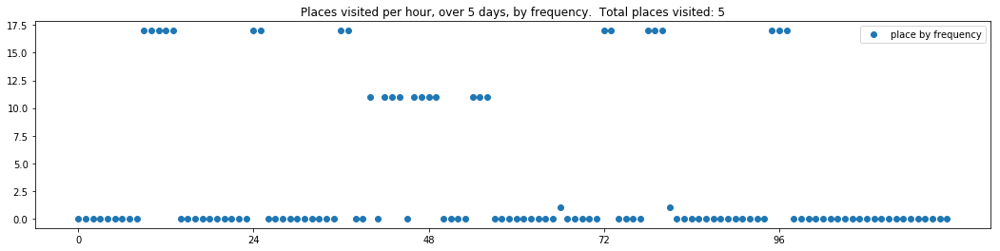

----- vector ----
prefix labels:  [607, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 592]


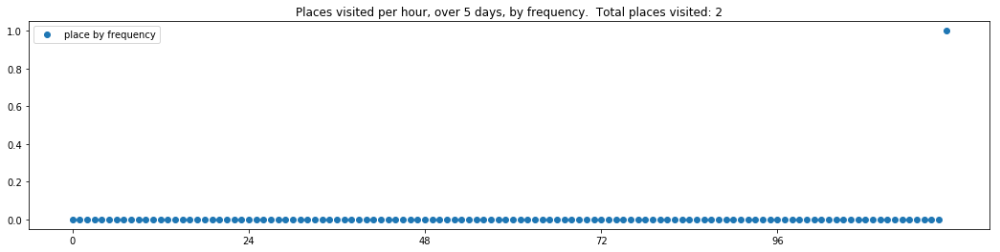

----- vector ----
prefix labels:  [465, 465]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 267]
[267, 267, 267, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 465, 0, 0, 0, 0, 0, 0, 0, 0, 0]


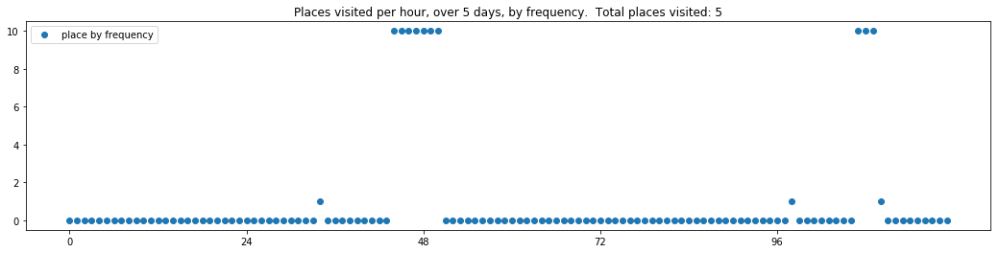

----- vector ----
prefix labels:  [473, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 21, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 100, 100, 0, 0, 473, 473, 473, 21, 22, 22]
[22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


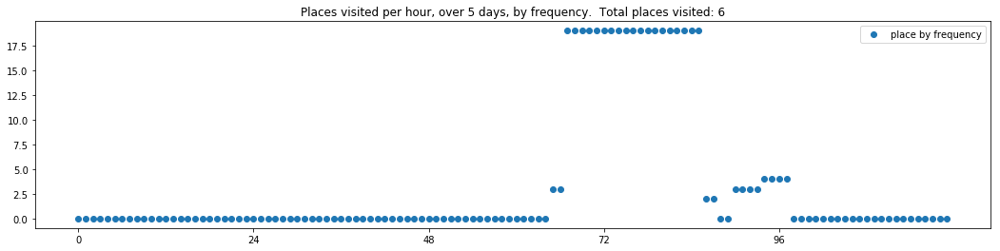

----- vector ----
prefix labels:  [13, 13]
[0, 0, 0, 0, 0, 0, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 0, 13]
[13, 13, 13, 13, 13, 13, 13, 0, 0, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
[13, 13, 13, 0, 13, 13, 13, 0, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
[13, 13, 13, 13, 13, 13, 0, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 0, 0, 0, 0, 0]
[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 0, 0, 0, 0, 0, 13, 13, 13, 13, 13, 13]


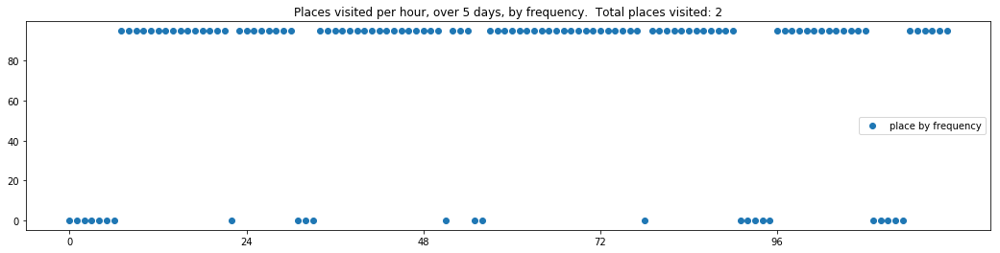

----- vector ----
prefix labels:  [260, 260]
[0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 0, 0, 0, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 0, 260, 260, 0, 0, 0, 0, 0]
[260, 260, 260, 260, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260, 260]


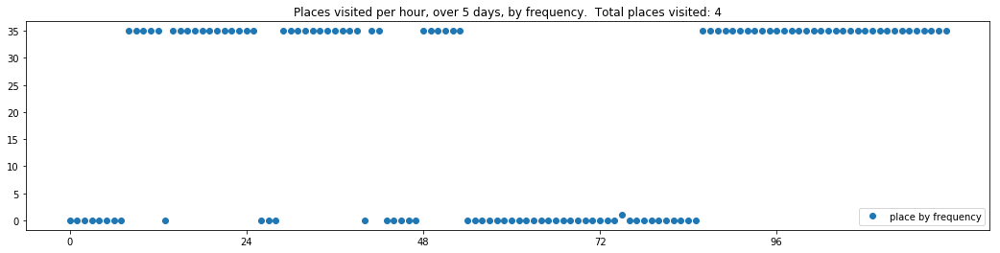

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 31, 31, 32, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0]


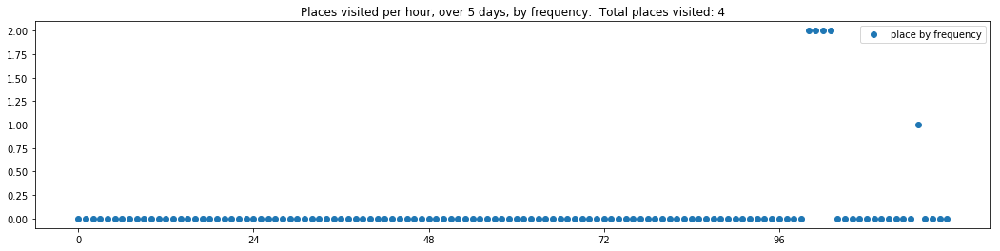

----- vector ----
prefix labels:  [226, 226]
[84, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77, 77]
[77, 77, 77, 77, 77, 77, 77, 77, 0, 0, 0, 0, 388, 388, 0, 0, 0, 0, 0, 0, 0, 41, 41, 41]
[424, 424, 424, 424, 424, 41, 41, 424, 424, 424, 424, 424, 424, 424, 424, 0, 0, 0, 423, 0, 0, 0, 0, 0]


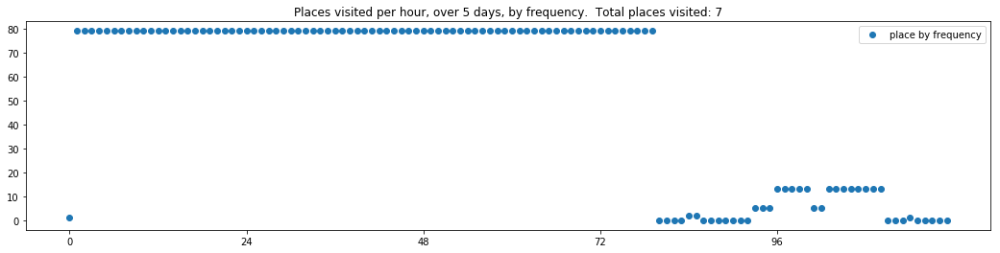

----- vector ----
prefix labels:  [370, 370]
[0, 0, 0, 0, 0, 0, 0, 0, 370, 370, 370, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72]
[72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 71]
[71, 71, 0, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251]
[251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251, 251]
[251, 251, 251, 251, 251, 251, 251, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370, 370]


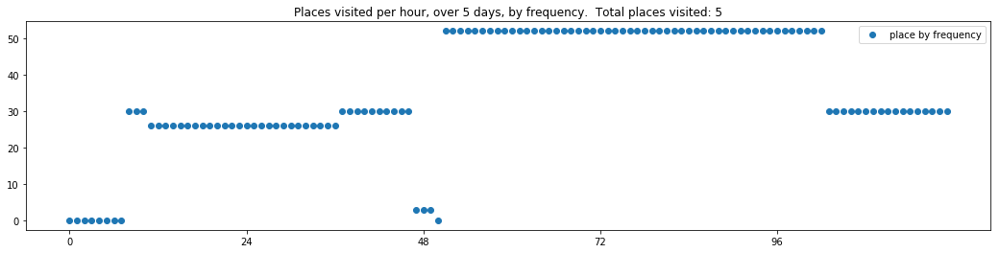


------
 115 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_115.txt 
------

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


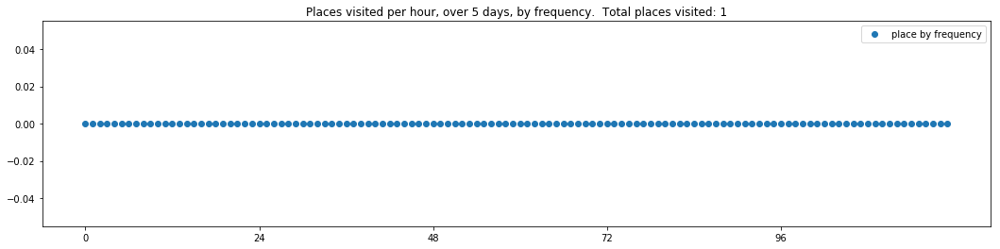

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 437, 0, 0, 0, 0, 0, 437, 437, 437, 437, 0, 0, 0, 0, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 0, 437, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437]


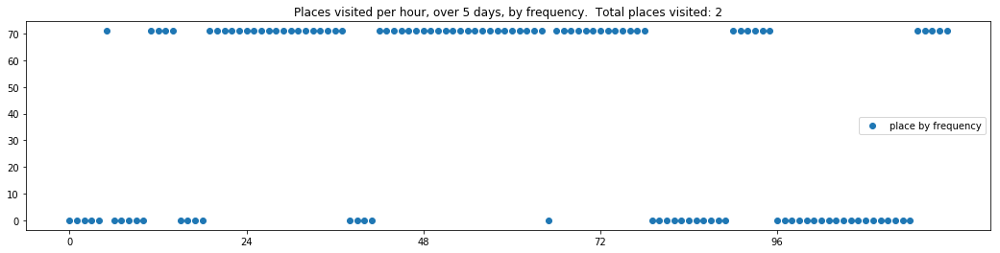

----- vector ----
prefix labels:  [3, 507]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 341, 341, 341, 341, 341, 341, 341, 341, 0, 341, 341, 341, 0, 0, 0, 0, 453]
[453, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 341, 341, 341, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 341, 0, 0, 0, 0, 0, 0, 0, 341, 341, 0, 0, 0, 0, 0]
[586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 87, 87, 87, 87, 87, 87, 0, 0, 0]


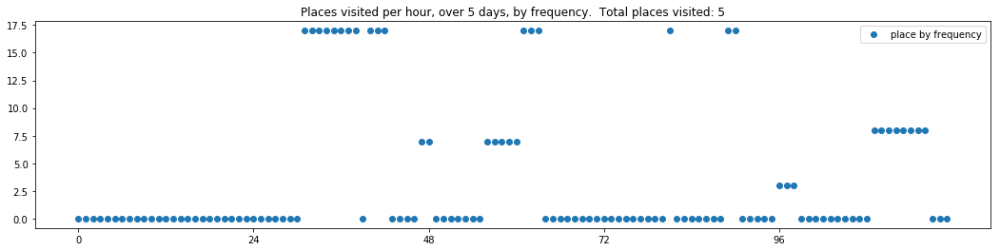

----- vector ----
prefix labels:  [111, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


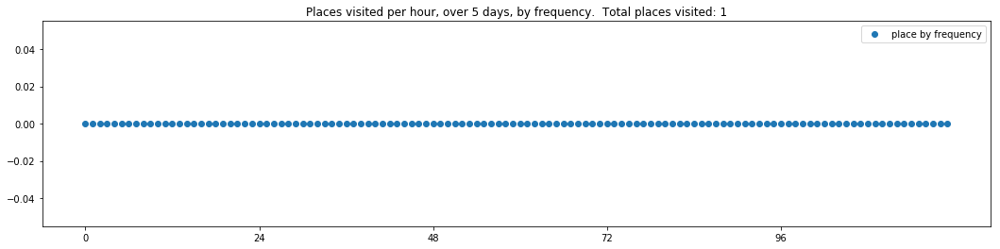

----- vector ----
prefix labels:  [477, 477]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 629, 629, 629, 629, 629, 629]
[629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 629, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629, 629]


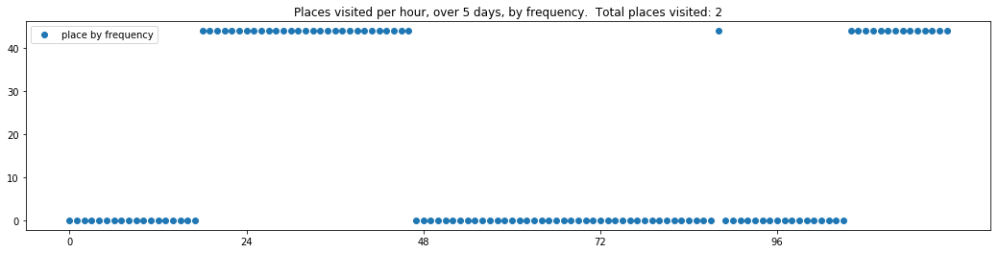

----- vector ----
prefix labels:  [187, 76]
[0, 0, 0, 0, 0, 0, 0, 76, 76, 76, 76, 76, 76, 76, 21, 0, 187, 187, 187, 187, 187, 187, 187, 187]
[187, 187, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 187, 187, 187, 187, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 0, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 187, 187, 187, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 640, 640]
[640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640, 640]


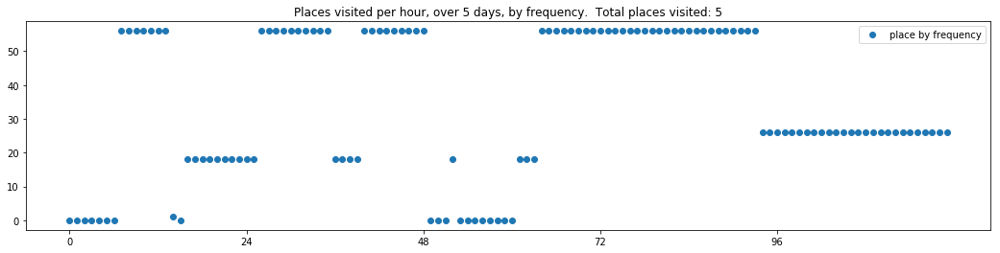

----- vector ----
prefix labels:  [179, 179]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 179, 179, 179, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


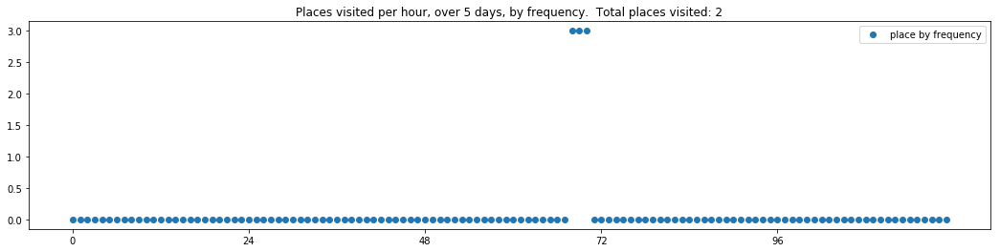

----- vector ----
prefix labels:  [84, 84]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 291, 225, 225, 225, 0, 84, 84]
[0, 0, 0, 0, 0, 0, 0, 0, 416, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 384, 384, 384]
[384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 384, 0, 119, 119]
[119, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 202, 20, 0, 0, 0]


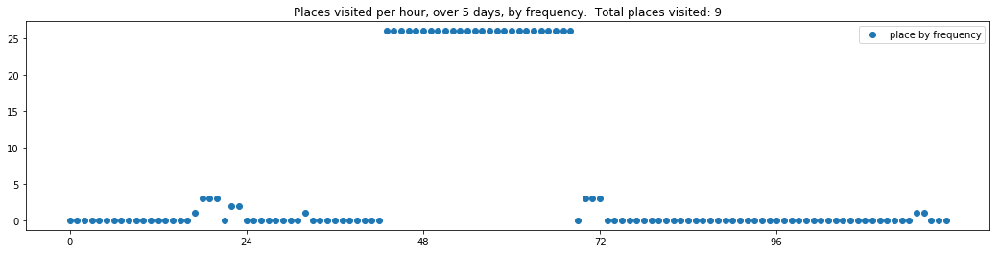

----- vector ----
prefix labels:  [435, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 204, 204, 204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 478, 550, 401]


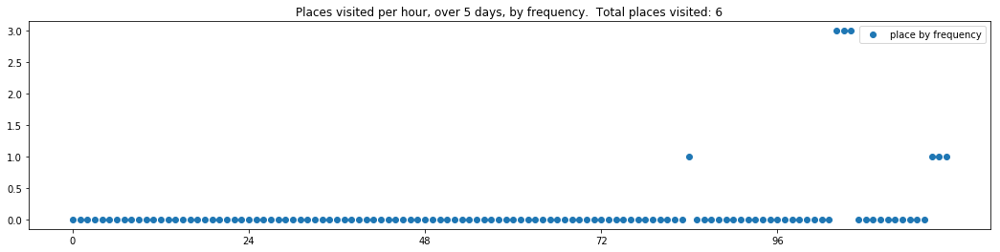

----- vector ----
prefix labels:  [267, 267]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]


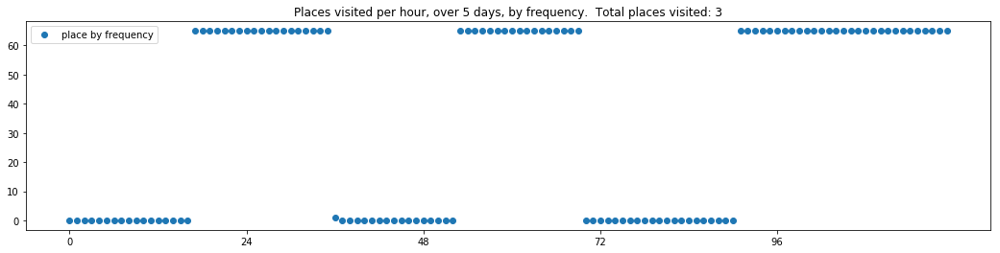

----- vector ----
prefix labels:  [3, 3]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 87, 87, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


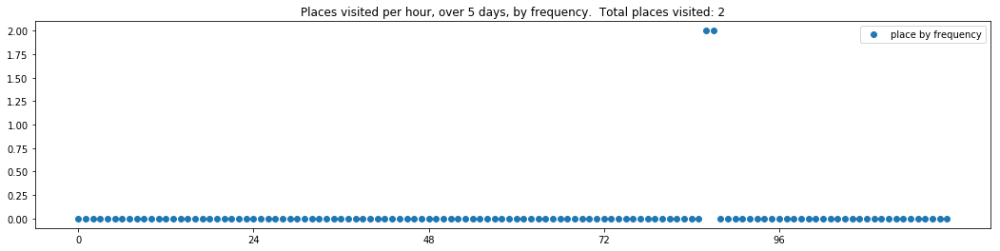

----- vector ----
prefix labels:  [613, 183]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 619, 260, 260, 260, 260, 260, 260, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 183, 183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


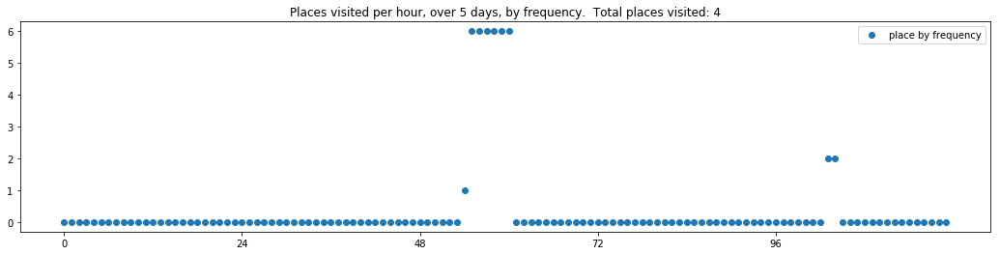

----- vector ----
prefix labels:  [420, 420]
[0, 0, 0, 0, 0, 420, 153, 153, 153, 112, 112, 112, 112, 112, 112, 112, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


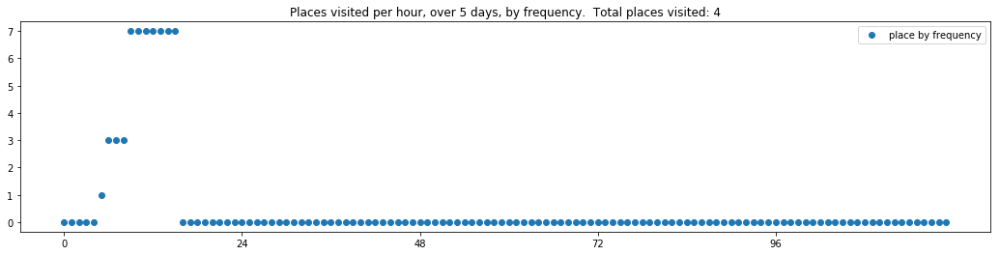

----- vector ----
prefix labels:  [205, 563]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


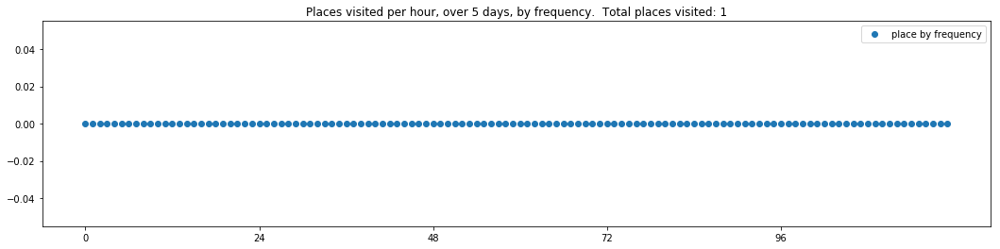

----- vector ----
prefix labels:  [475, 475]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 475, 475, 475, 475, 475, 76, 76, 76, 76, 76, 76, 0, 475, 475, 475]
[475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 475, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


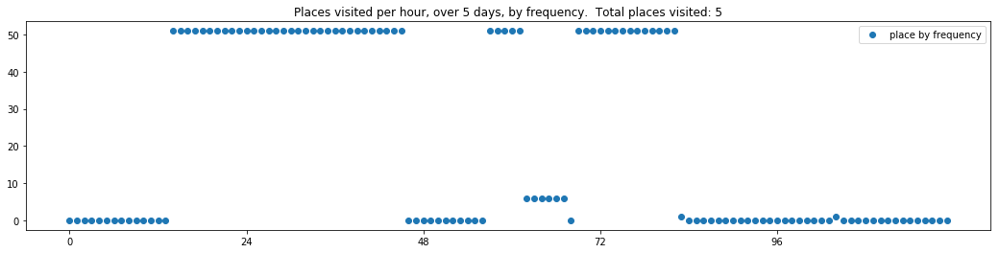

----- vector ----
prefix labels:  [312, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 312, 312, 312, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 312, 312]


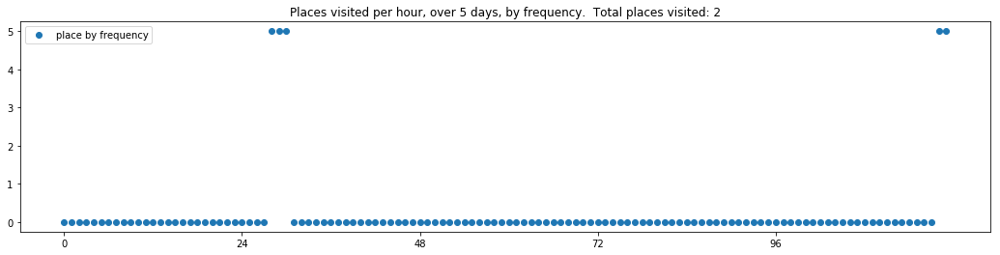

----- vector ----
prefix labels:  [416, 416]
[0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 0, 0, 0]
[0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]


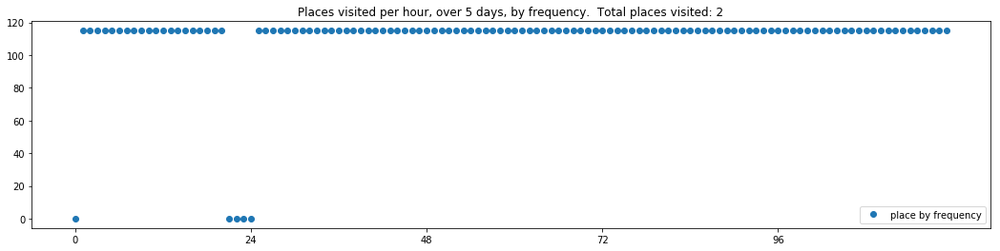

----- vector ----
prefix labels:  [479, 479]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


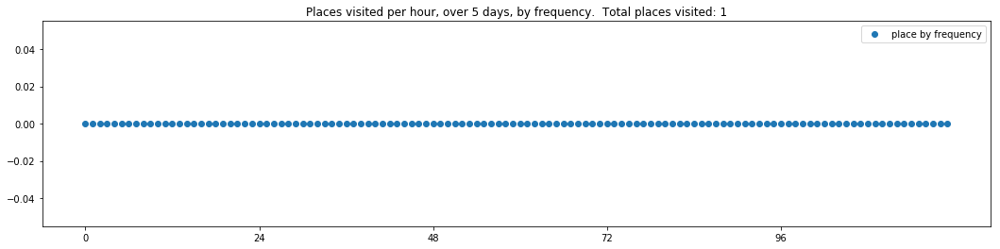

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0]


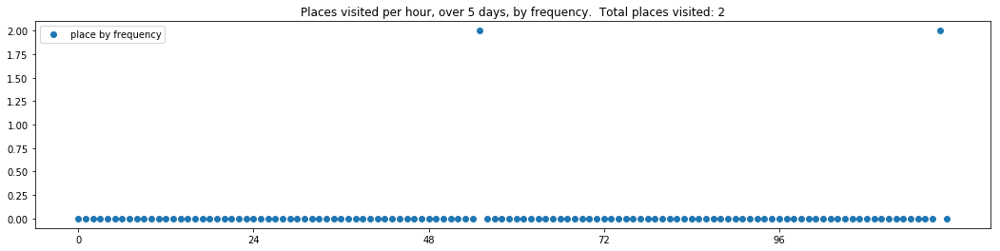

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


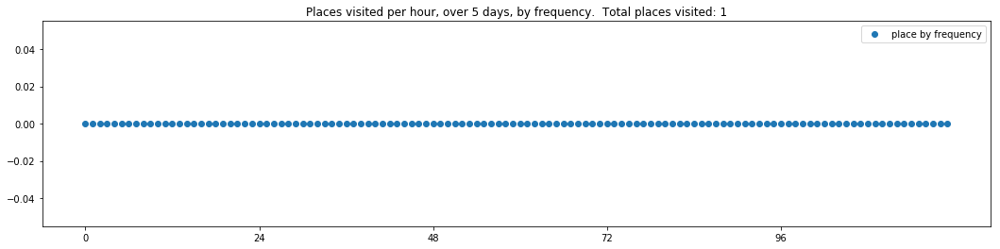

----- vector ----
prefix labels:  [386, 56]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 406, 406, 406, 406, 406, 22]
[22, 22, 330, 330, 330, 0, 557, 557, 557, 557, 557, 557, 557, 557, 386, 76, 76, 76, 76, 76, 76, 76, 0, 0]
[0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330, 330]


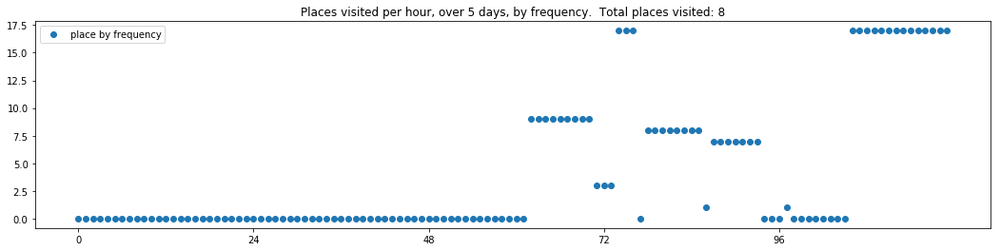

----- vector ----
prefix labels:  [373, 373]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


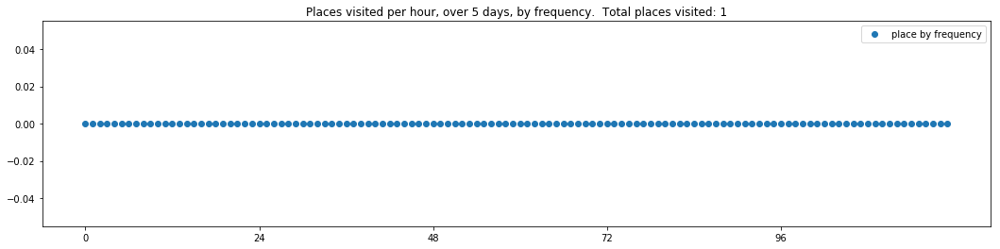

----- vector ----
prefix labels:  [47, 47]
[0, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 43, 0, 0, 0, 47, 47, 0, 0]
[0, 0, 0, 0, 0, 47, 47, 47, 47, 47, 47, 47, 47, 47, 47, 0, 0, 0, 47, 47, 47, 47, 47, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 47, 47, 47, 47, 47, 47, 47, 47]


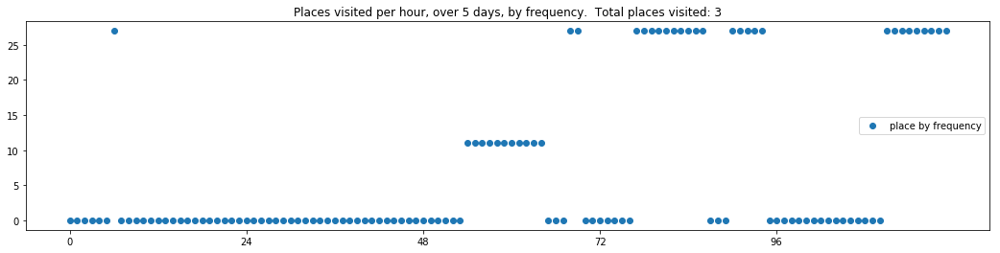

----- vector ----
prefix labels:  [5, 5]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 583, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 583, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5]
[5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 296, 0, 0, 0, 0, 0, 0, 0, 0]


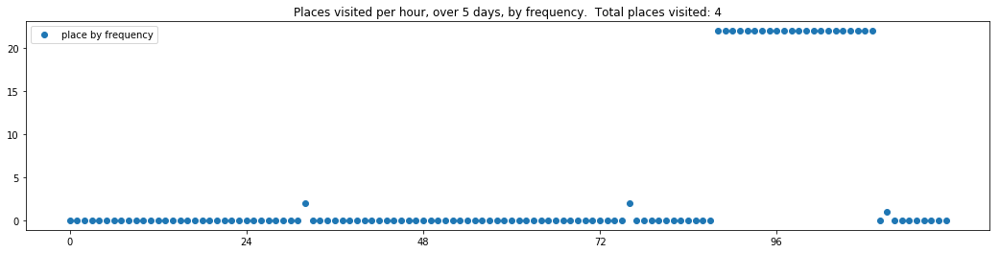

----- vector ----
prefix labels:  [76, 76]
[0, 0, 0, 0, 0, 0, 8, 8, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 548, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 184]
[184, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 0, 0, 0, 76, 76, 76, 76, 76, 76, 76, 184, 184, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76]


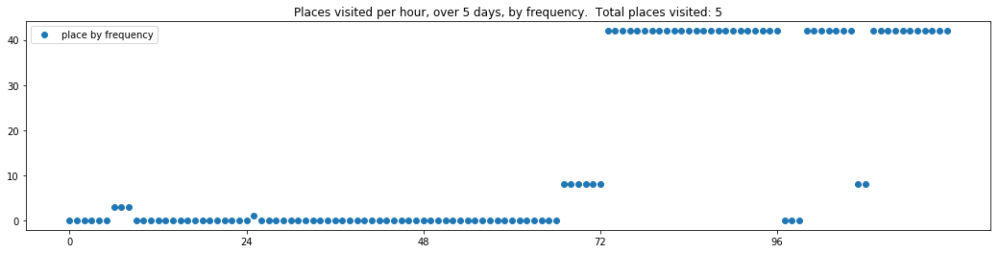

----- vector ----
prefix labels:  [620, 562]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489]
[489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489, 489]
[489, 489, 489, 489, 489, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562]
[562, 522, 522, 522, 522, 522, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 522, 522, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


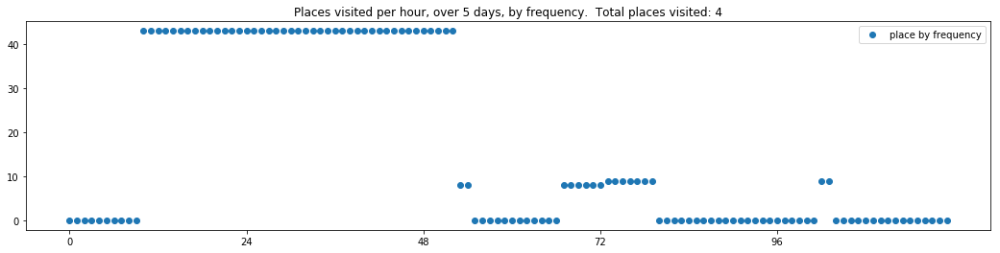

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71]
[0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71]
[71, 0, 71, 0, 0, 0, 0, 0, 0, 0, 71, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[0, 0, 0, 0, 0, 71, 71, 0, 0, 0, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 140, 0]


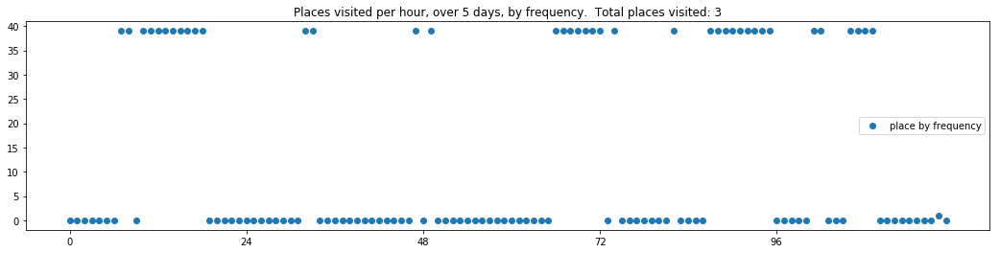

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 20, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


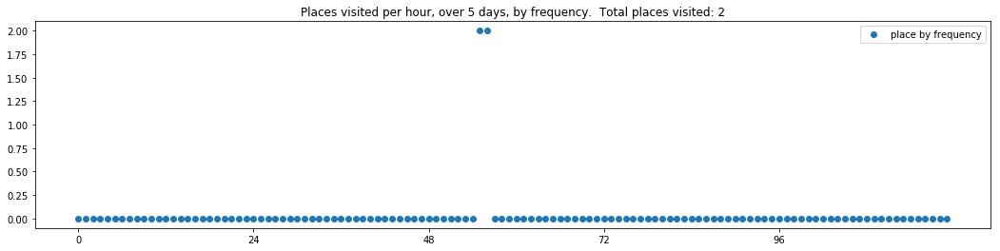

----- vector ----
prefix labels:  [562, 562]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


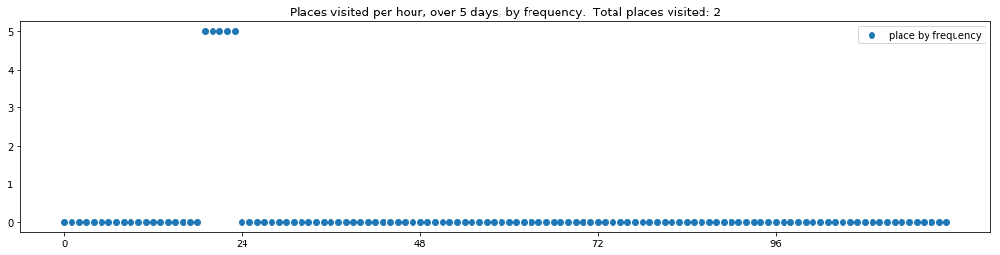

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 0, 71, 71]
[71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 371, 213, 213, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]


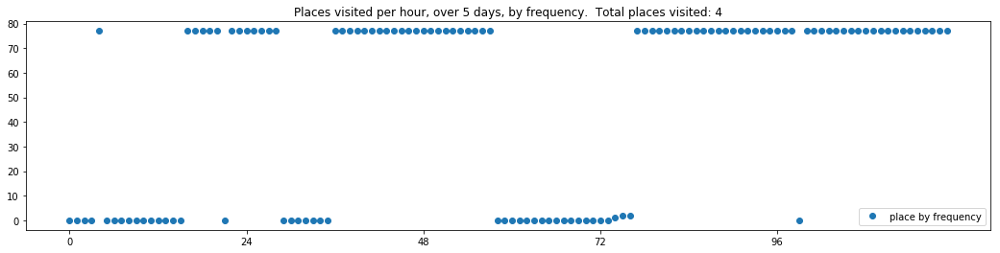

----- vector ----
prefix labels:  [109, 109]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109, 0]
[0, 0, 109, 109, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 109, 109, 109, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109, 109, 109, 109, 109, 109, 109, 109, 109, 109]
[109, 0, 0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 109, 109, 109, 109, 109, 109, 109]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 48, 109, 109, 109, 109, 0, 109, 0]


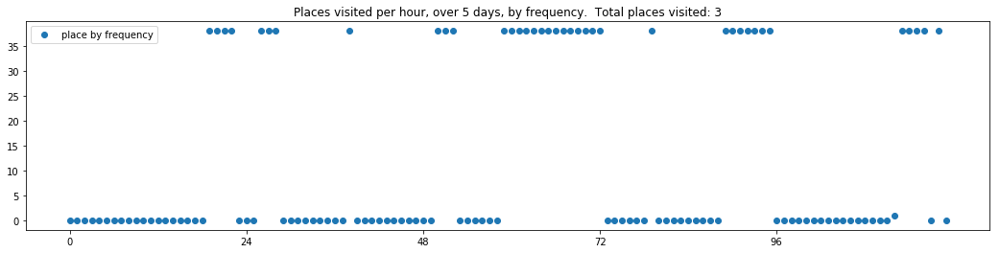

----- vector ----
prefix labels:  [205, 120]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 120, 120, 120, 120, 120, 120]
[120, 120, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 120, 0, 328, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328, 328, 328]


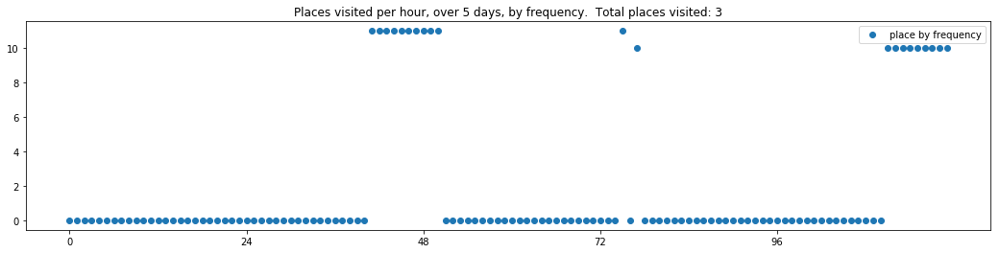

----- vector ----
prefix labels:  [146, 146]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 146, 0, 146, 146]
[146, 0, 0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 0, 146, 146]


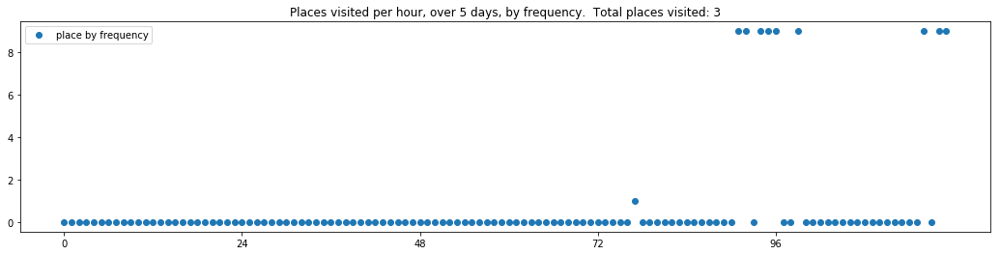

----- vector ----
prefix labels:  [523, 523]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 388, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


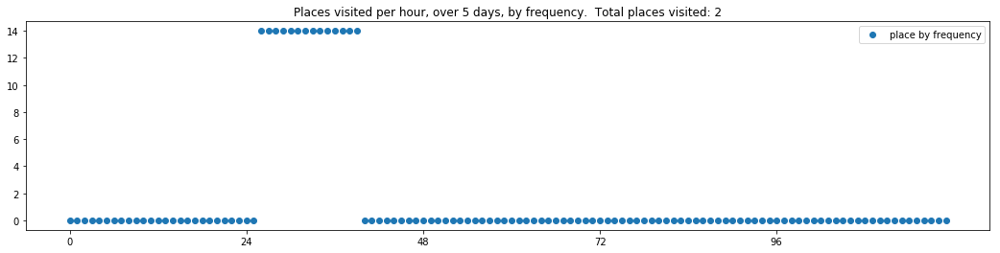

----- vector ----
prefix labels:  [93, 328]
[0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 107, 0, 0, 0, 0, 0, 0, 0, 328, 328, 328, 328, 328, 328, 328]


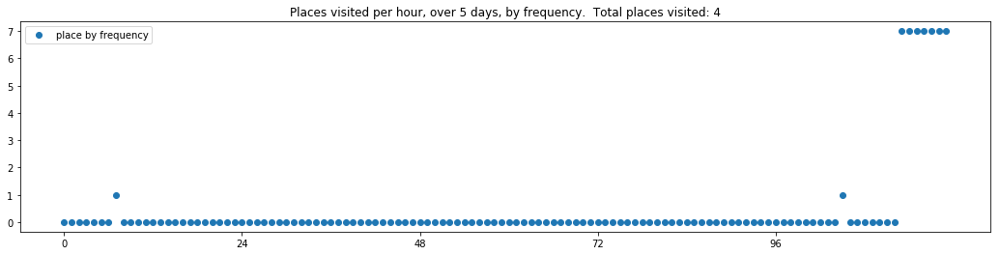

----- vector ----
prefix labels:  [218, 218]
[0, 0, 0, 0, 0, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218]
[218, 218, 218, 218, 218, 218, 218, 218, 218, 0, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218]
[218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 0, 0, 218, 218]
[218, 218, 218, 218, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 218, 218]
[218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


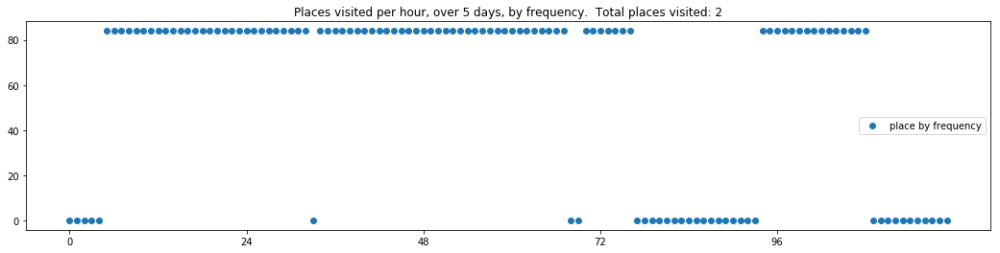

----- vector ----
prefix labels:  [270, 270]
[0, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]
[270, 270, 270, 270, 270, 270, 270, 270, 270, 260, 0, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270, 270]


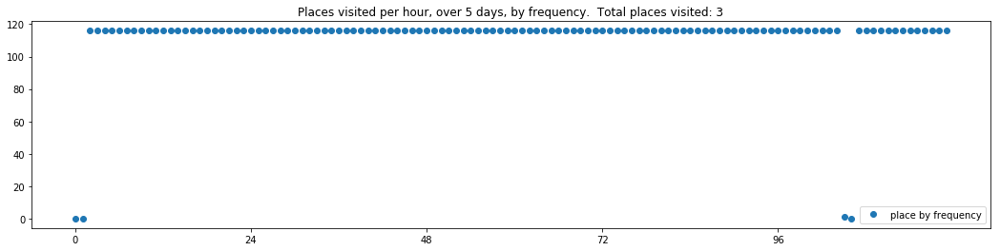

----- vector ----
prefix labels:  [8, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


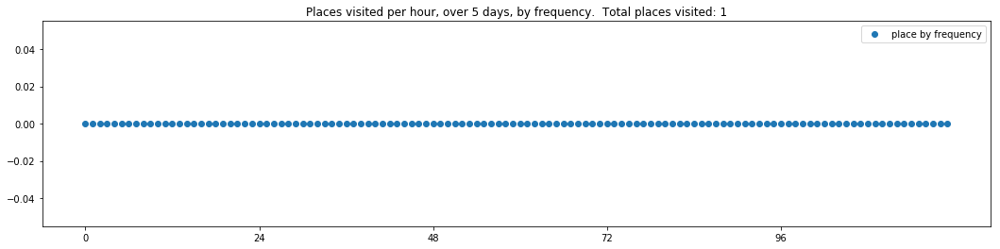

----- vector ----
prefix labels:  [256, 256]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 256, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 557, 0, 0, 0, 0, 256, 0, 0, 0, 0, 0, 0, 0, 0, 0, 256, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 507, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4]


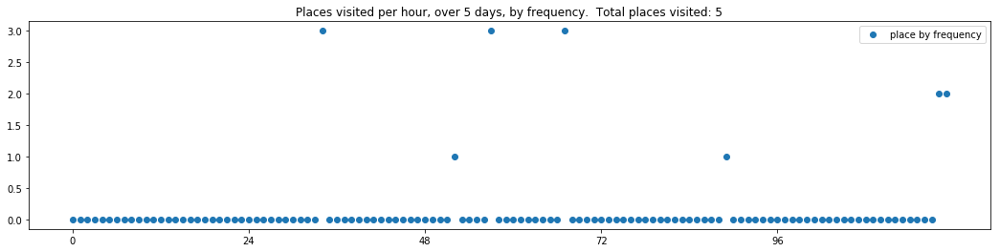

----- vector ----
prefix labels:  [379, 379]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379]
[379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379]
[379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 0, 0, 0, 0, 0, 0, 0, 379, 379, 379, 0, 379, 379]
[379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 0, 379, 379, 379, 379, 379, 379, 379, 379, 379, 379]
[379, 379, 379, 379, 379, 379, 379, 379, 379, 379, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 379, 379, 379]


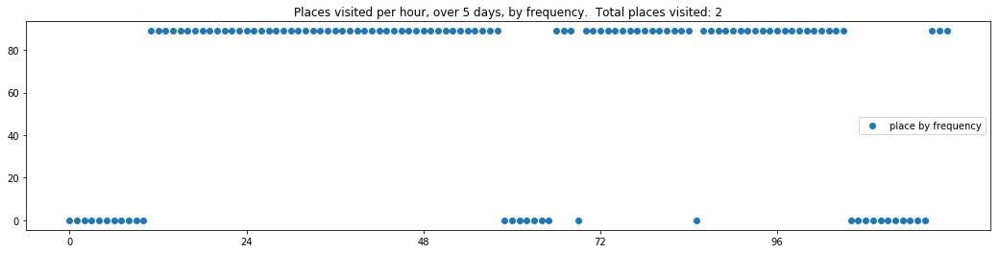

----- vector ----
prefix labels:  [192, 192]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 181]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192]
[192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 267, 0, 0, 0, 0, 0, 0, 0, 0, 0]


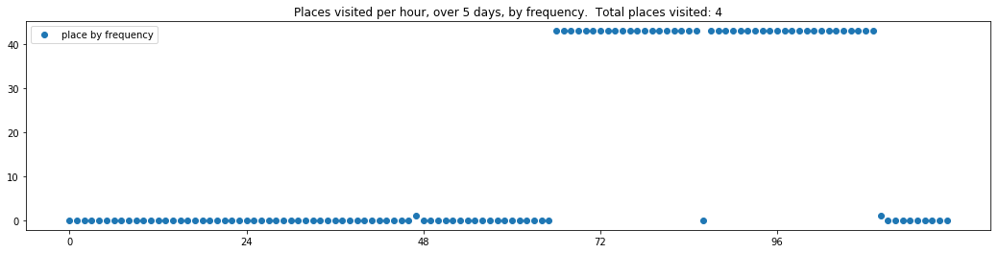

----- vector ----
prefix labels:  [413, 413]
[0, 0, 0, 0, 0, 0, 0, 0, 413, 567, 567, 567, 413, 413, 413, 413, 0, 413, 413, 413, 413, 413, 413, 413]
[413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 413, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 413, 502, 502, 502, 502, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


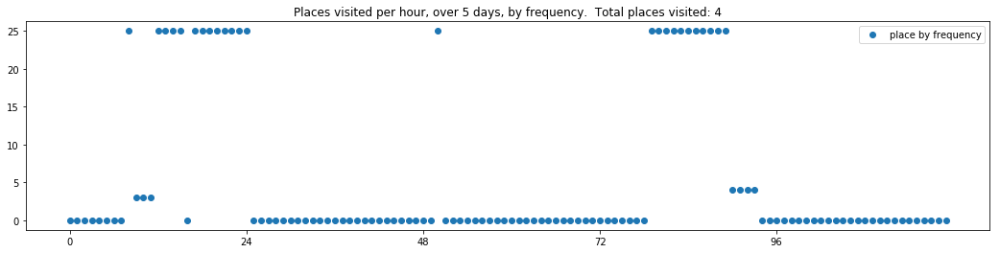

----- vector ----
prefix labels:  [367, 367]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 367, 367, 367, 396, 0, 0, 0, 0, 0, 0]
[0, 0, 367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 0, 0, 0, 0, 0, 0, 0, 0, 367, 367, 367]
[367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 367, 0, 367, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


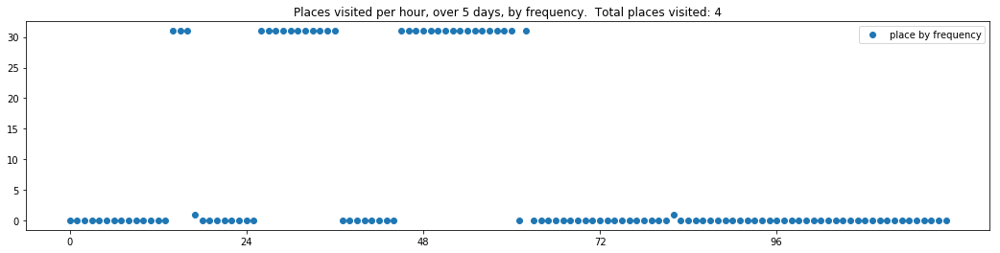

----- vector ----
prefix labels:  [599, 599]
[0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599]
[599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 542, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 599]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599]
[599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599]


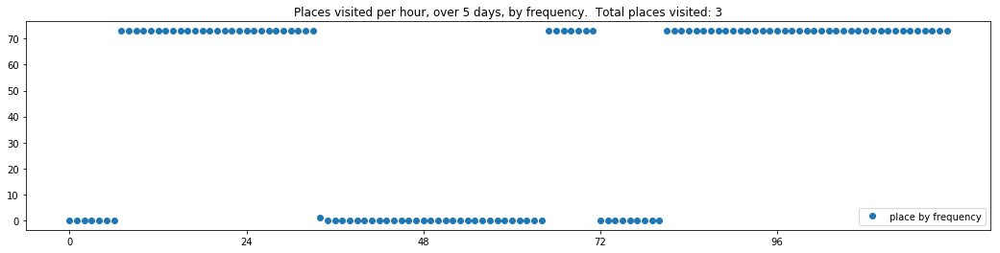

----- vector ----
prefix labels:  [242, 534]
[0, 0, 0, 0, 0, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242, 242]
[242, 242, 242, 242, 242, 416, 416, 416, 416, 416, 416, 416, 0, 0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]


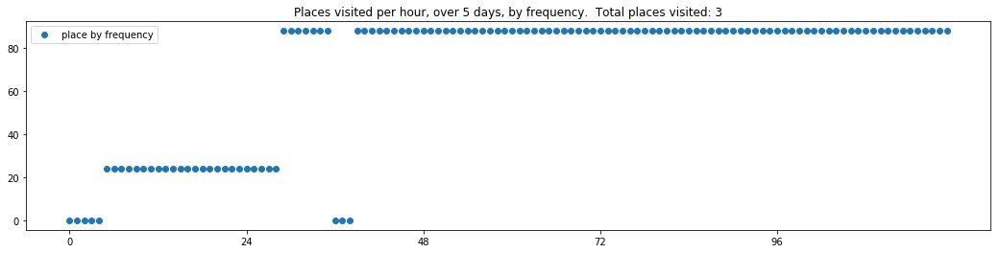

----- vector ----
prefix labels:  [12, 97]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


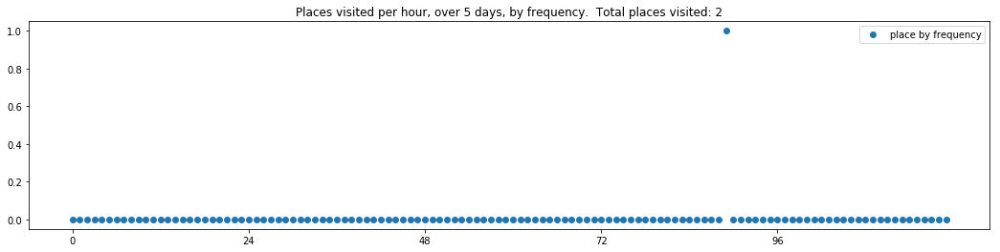

----- vector ----
prefix labels:  [591, 591]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


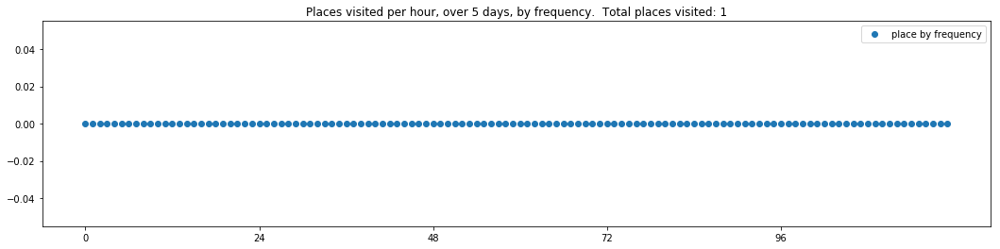

----- vector ----
prefix labels:  [115, 71]
[0, 0, 0, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 0, 0, 0]
[0, 0, 0, 68, 68, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 162]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22]
[22, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 0, 0, 0, 0, 27, 27, 27]


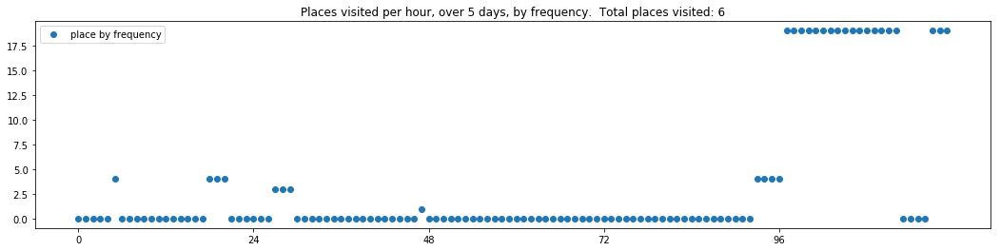

----- vector ----
prefix labels:  [4, 591]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


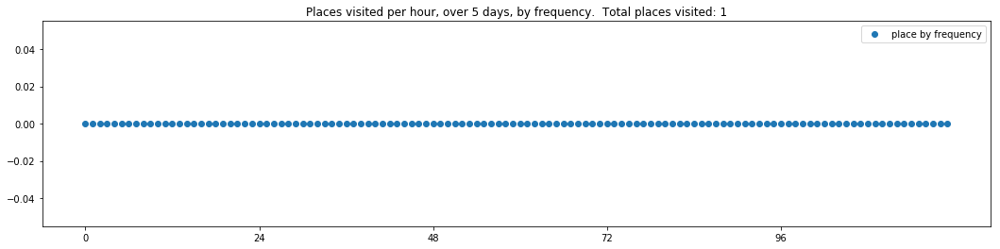

----- vector ----
prefix labels:  [604, 604]
[0, 0, 0, 0, 0, 0, 0, 604, 604, 604, 604, 0, 0, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]


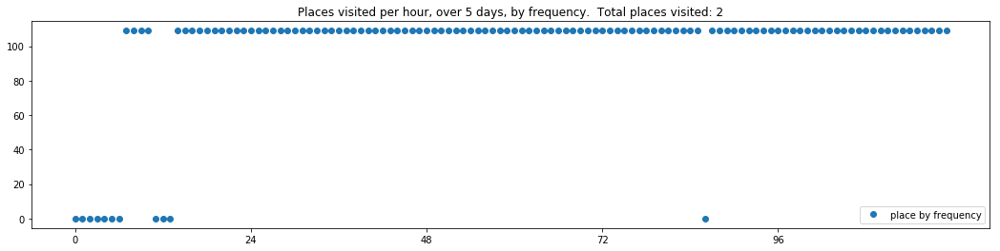


------
 120 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_120.txt 
------

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 560, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


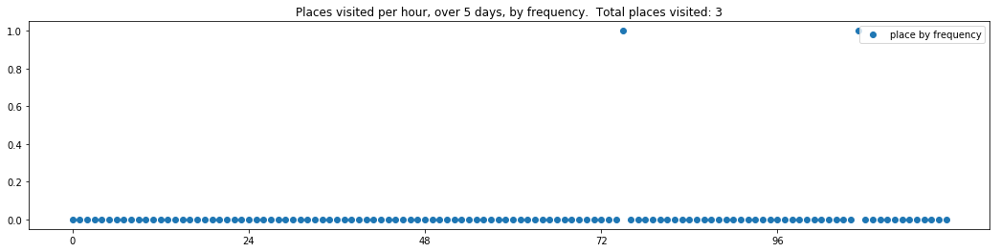

----- vector ----
prefix labels:  [226, 226]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 226, 226, 226, 0, 0, 0, 0, 0, 0, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 181, 226, 0, 0, 0, 0, 226]
[226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226, 226]


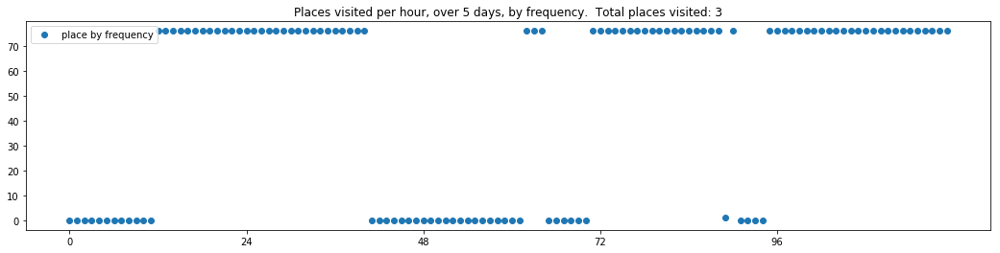

----- vector ----
prefix labels:  [222, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


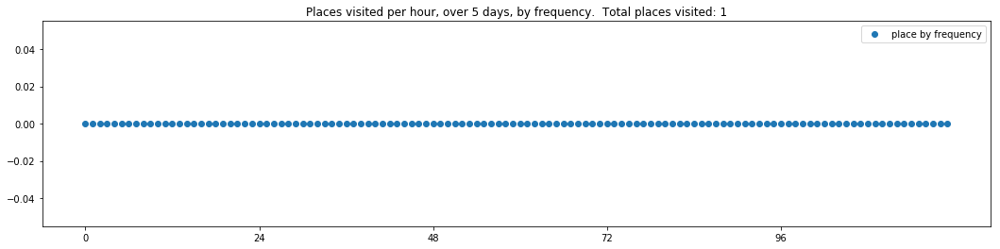

----- vector ----
prefix labels:  [635, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 0, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]


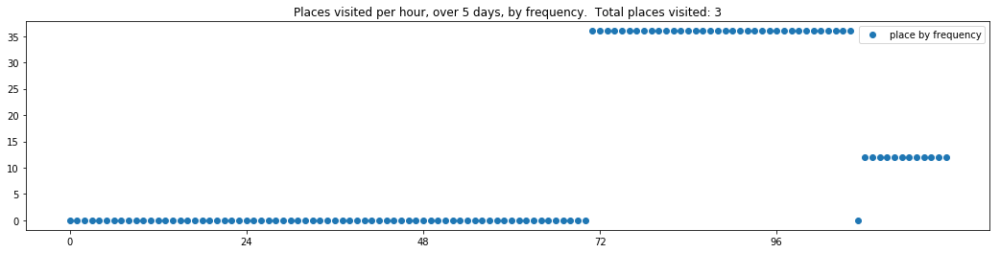

----- vector ----
prefix labels:  [40, 40]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40]
[40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40]
[40, 40, 40, 40, 40, 40, 0, 0, 0, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40, 40]
[40, 40, 40, 40, 40, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 40, 40, 40, 40, 40, 40]


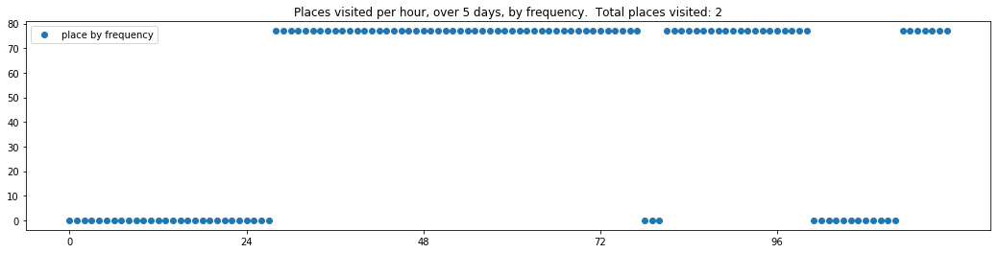

----- vector ----
prefix labels:  [47, 44]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 44, 44, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0]


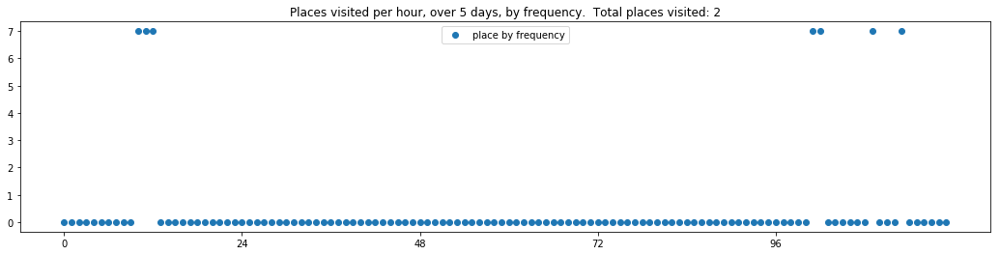

----- vector ----
prefix labels:  [133, 133]
[0, 0, 0, 0, 0, 0, 0, 133, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94]
[94, 94, 94, 0, 0, 0, 0, 97, 97, 603, 603, 603, 603, 603, 603, 603, 146, 76, 76, 76, 519, 519, 519, 519]
[519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 519, 0]


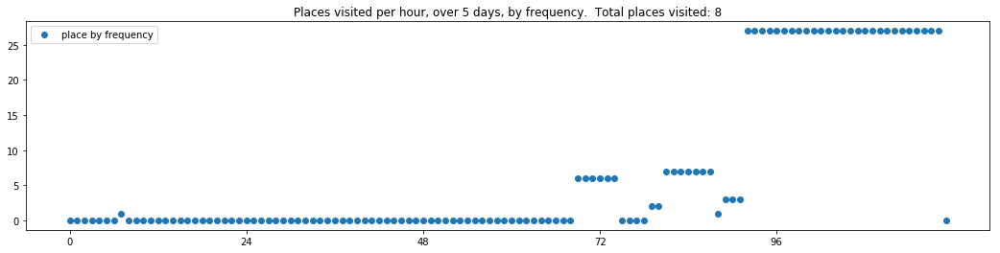

----- vector ----
prefix labels:  [0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


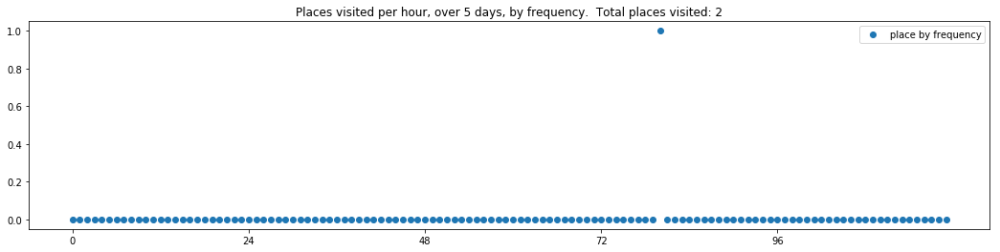

----- vector ----
prefix labels:  [26, 97]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 181, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


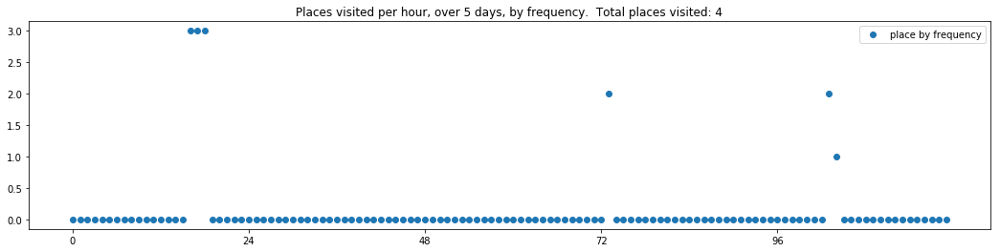

----- vector ----
prefix labels:  [199, 199]
[0, 0, 0, 0, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 0, 199]
[199, 199, 199, 199, 199, 0, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]


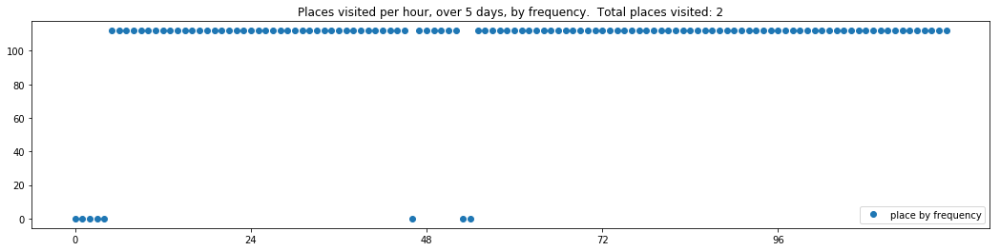

----- vector ----
prefix labels:  [23, 586]
[586, 586, 586, 0, 0, 0, 0, 0, 0, 0, 0, 0, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 0, 0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


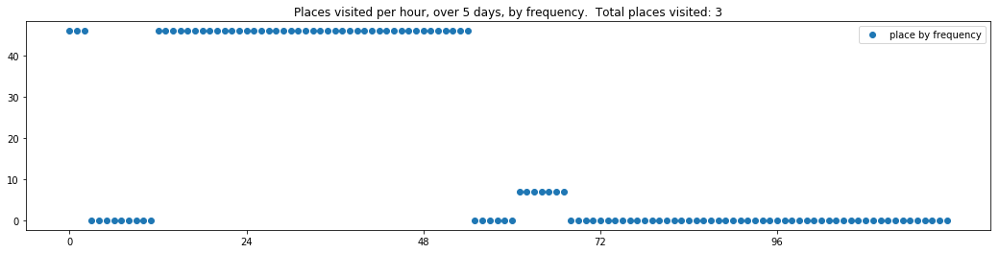

----- vector ----
prefix labels:  [194, 194]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 168, 168, 0, 0, 0, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]


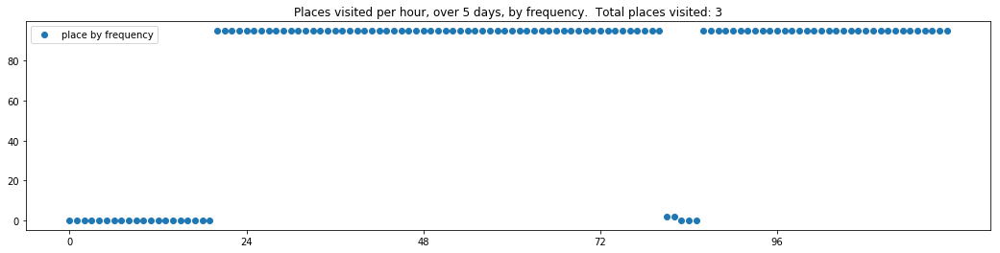

----- vector ----
prefix labels:  [93, 93]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 582]
[582, 582, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 93]
[0, 93, 93, 93, 93, 93, 93, 93, 93, 217, 217, 220, 220, 0, 93, 93, 93, 93, 93, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


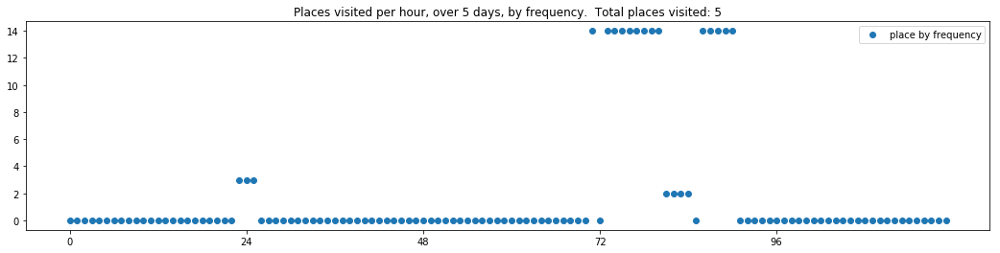

----- vector ----
prefix labels:  [382, 382]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 76, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]


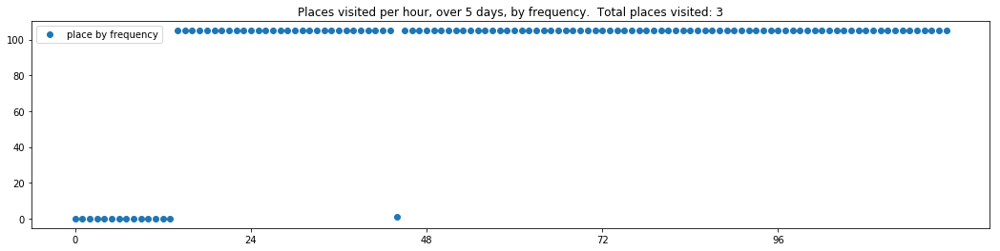

----- vector ----
prefix labels:  [143, 270]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 0]
[0, 0, 0, 270, 270, 270, 270, 270, 270, 0, 0, 0, 0, 0, 144, 144, 144, 144, 144, 144, 0, 0, 0, 0]
[270, 270, 260, 260, 260, 260, 260, 260, 260, 260, 260, 0, 260, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]
[144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144, 144]


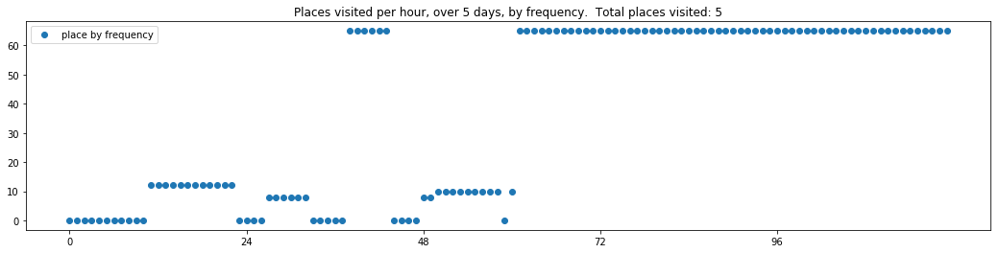

----- vector ----
prefix labels:  [279, 279]
[0, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 105, 0, 0, 0, 0, 0, 0, 279, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279]
[279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279, 279]


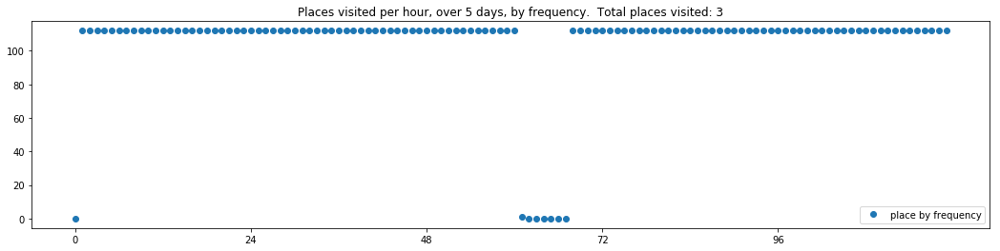

----- vector ----
prefix labels:  [592, 363]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 364, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 543, 0, 0, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267]
[267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 267, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


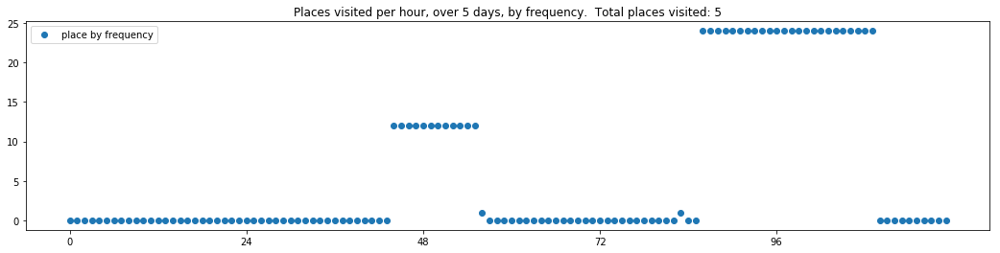

----- vector ----
prefix labels:  [3, 3]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 379, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 45]
[297, 297, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


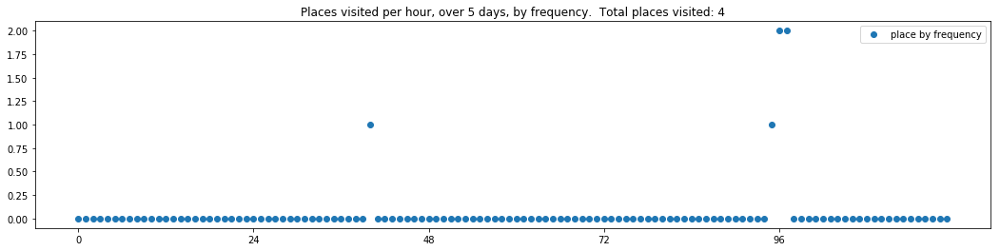

----- vector ----
prefix labels:  [283, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 283, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 283, 283]
[0, 0, 0, 283, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 283]


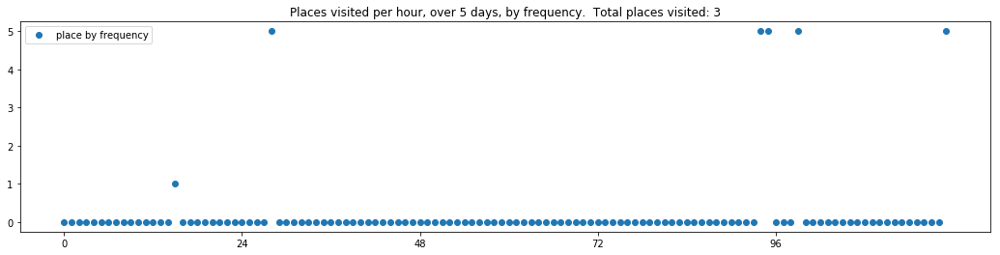

----- vector ----
prefix labels:  [386, 386]
[0, 0, 0, 0, 0, 0, 0, 386, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76]
[76, 76, 76, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479, 479]


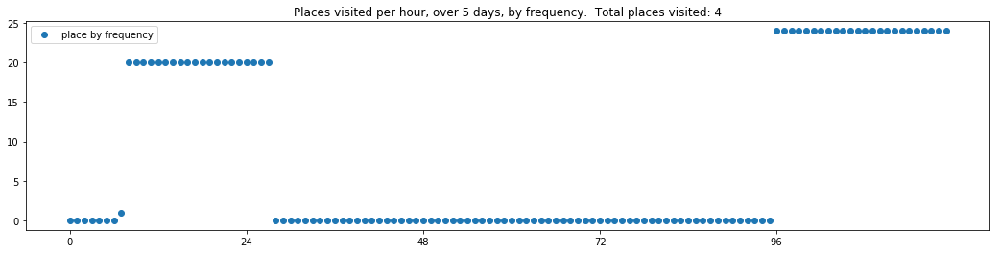

----- vector ----
prefix labels:  [128, 128]
[0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 128, 128, 128, 128, 128, 128, 128, 260, 100, 100, 100, 100, 100]
[100, 100, 128, 215, 215, 215, 215, 215, 215, 0, 0, 0, 0, 0, 0, 214, 0, 0, 0, 0, 0, 60, 60, 60]
[60, 60, 60, 0, 0, 0, 215, 0, 0, 0, 214, 344, 344, 151, 151, 151, 182, 182, 182, 0, 0, 0, 0, 0]
[0, 182, 182, 182, 215, 215, 215, 215, 0, 0, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182, 182]
[0, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60, 60]


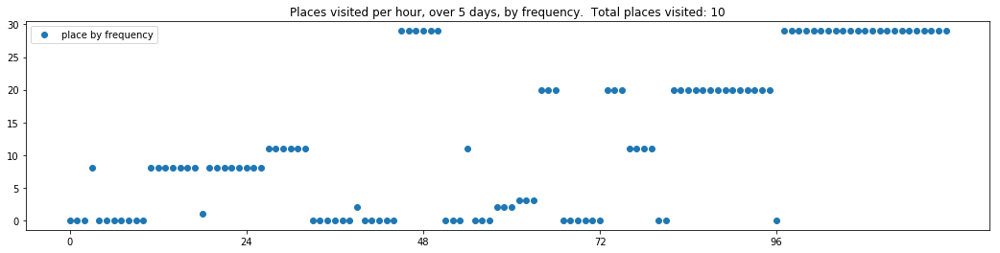

----- vector ----
prefix labels:  [225, 225]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 225, 225, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 416, 0, 0, 0, 0, 323, 431, 431, 431, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


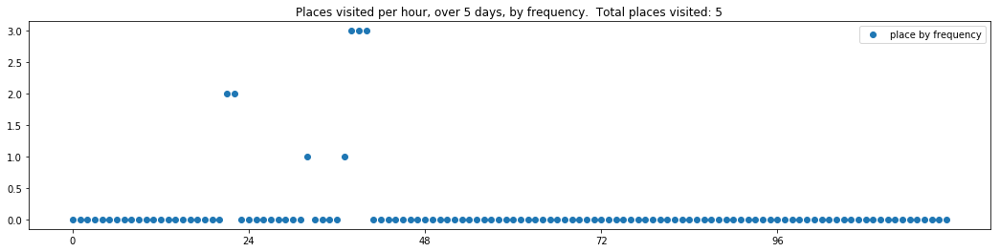

----- vector ----
prefix labels:  [152, 152]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 32, 32, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 262, 262, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


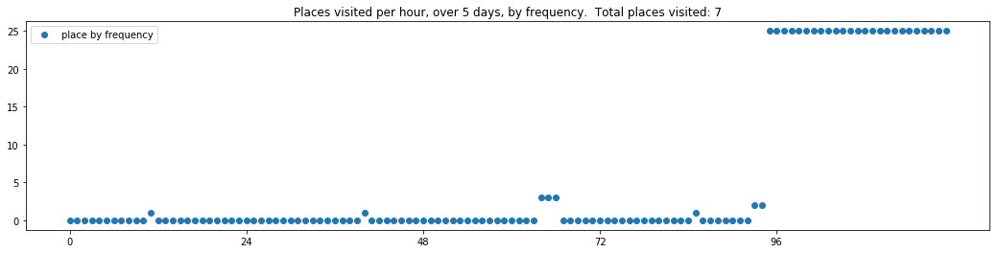

----- vector ----
prefix labels:  [304, 304]
[0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]
[304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304, 304]


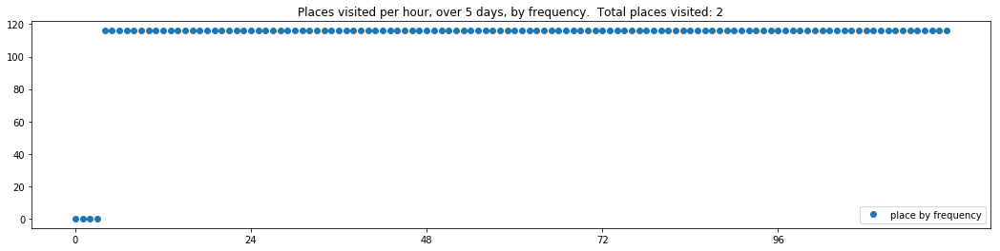

----- vector ----
prefix labels:  [43, 43]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 502, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


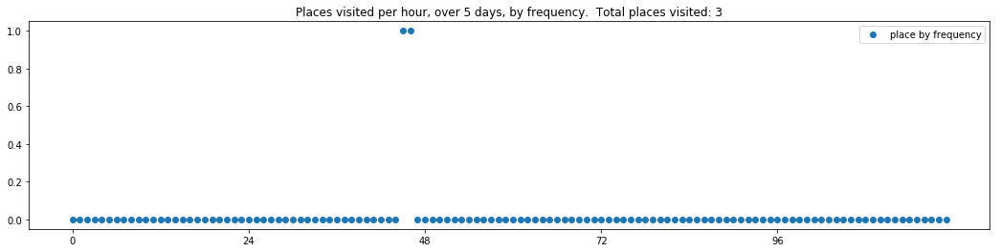

----- vector ----
prefix labels:  [580, 580]
[0, 0, 0, 0, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 580, 0, 580, 580, 580]
[580, 580, 580, 580, 580, 580, 580, 580, 580, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 580, 580, 580, 580, 0, 0, 0, 0, 0, 161, 0]


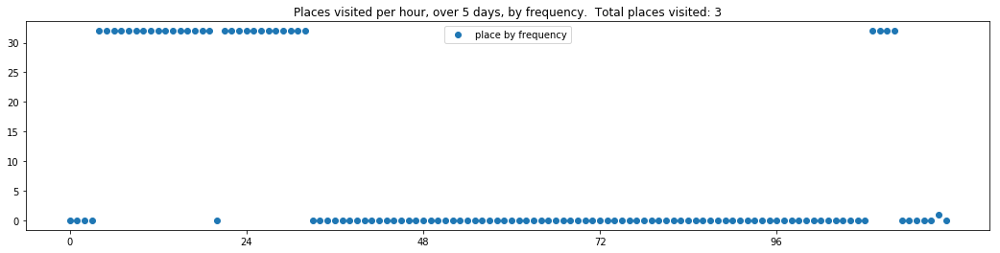

----- vector ----
prefix labels:  [416, 52]
[0, 0, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 52, 52, 52, 52, 52, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]
[416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416, 416]


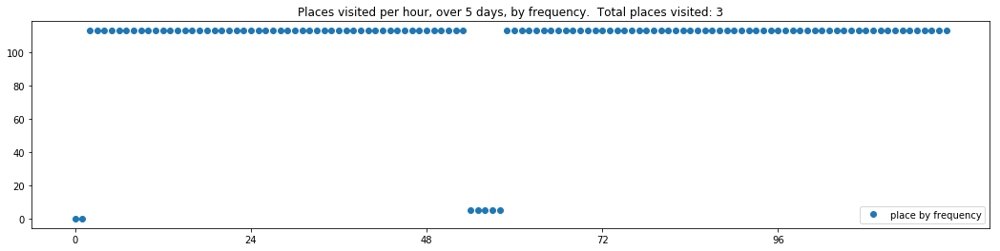

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343]
[343, 0, 0, 0, 0, 0, 343, 343, 343, 343, 343, 343, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 343, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 343, 0, 0, 0, 0, 0, 0, 0, 343, 343, 343]


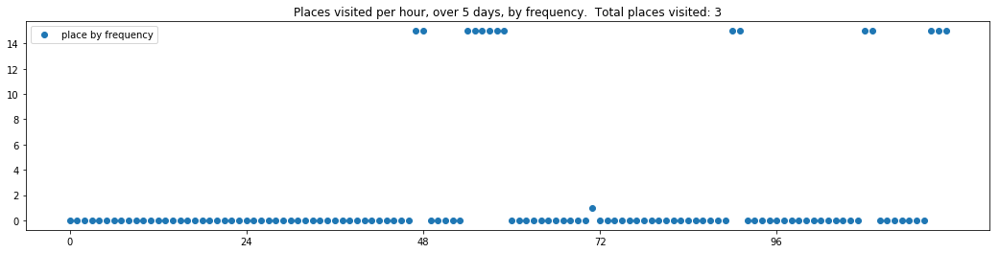

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]


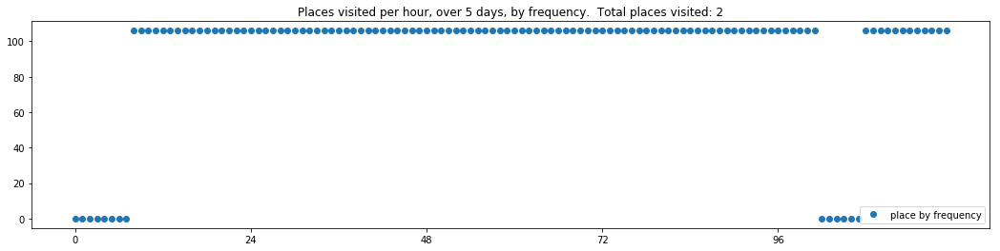

----- vector ----
prefix labels:  [395, 395]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 22, 22, 22, 22, 22, 22, 22, 22, 395, 395, 395, 395, 395, 22, 22, 78, 395, 395, 395, 395, 395, 395]
[22, 22, 22, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 239, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 259, 0, 0, 0, 0, 0, 0, 0]


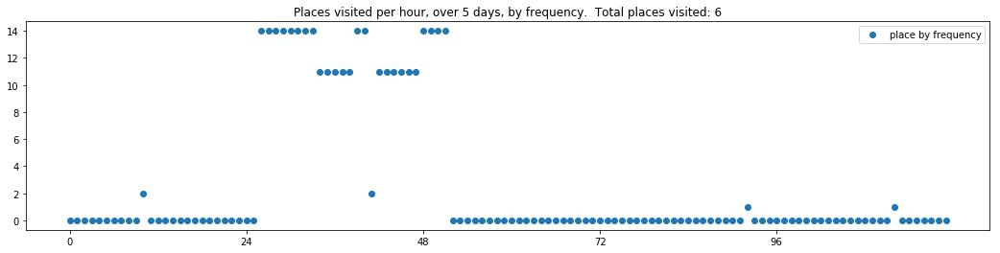

----- vector ----
prefix labels:  [177, 177]
[177, 177, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177]
[177, 177, 177, 177, 177, 0, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 177, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 177, 177, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


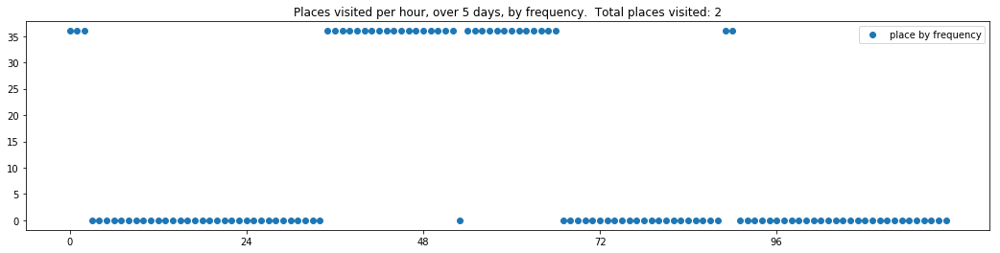

----- vector ----
prefix labels:  [286, 286]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286]
[286, 286, 286, 286, 286, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 286, 286, 286, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 286, 286, 0, 0, 0, 286, 286, 286, 0, 0, 0, 0, 0, 0, 559, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 200, 0, 455, 320, 320, 0, 0]


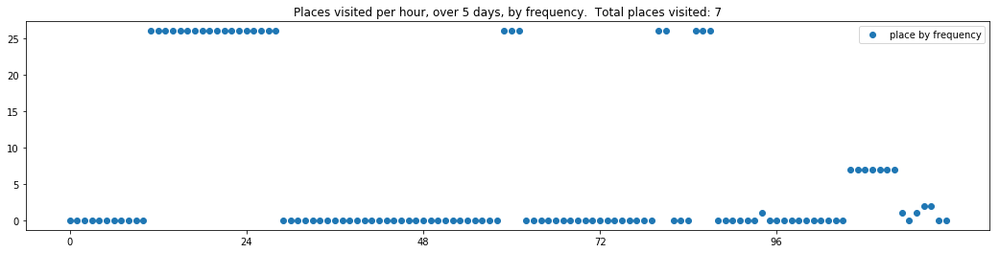

----- vector ----
prefix labels:  [339, 339]
[0, 0, 0, 0, 0, 0, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339]


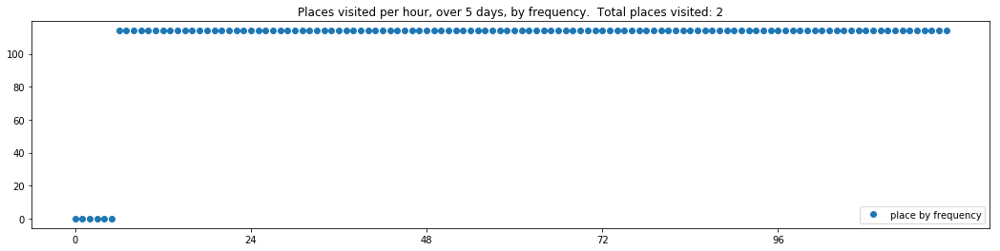

----- vector ----
prefix labels:  [312, 312]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 639, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 312, 312, 312, 312, 0, 0, 0, 0, 0, 0]
[0, 168, 168, 168, 168, 168, 168, 168, 0, 0, 312, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168]
[168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168]


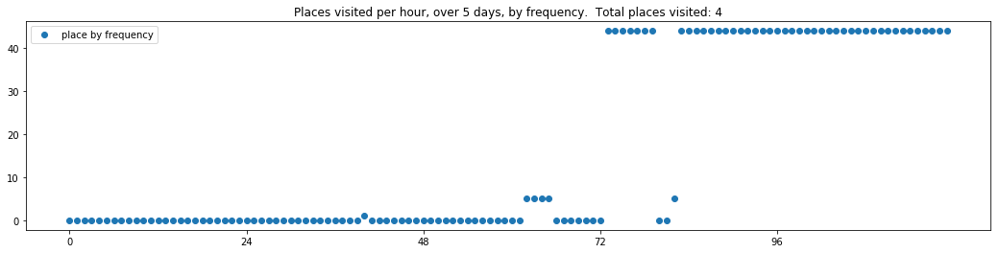

----- vector ----
prefix labels:  [457, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506, 506]


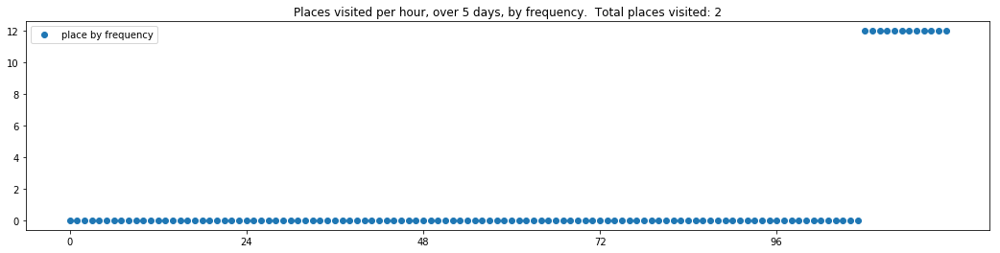

----- vector ----
prefix labels:  [223, 599]
[0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 599, 599, 599, 599, 599]
[599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 599, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


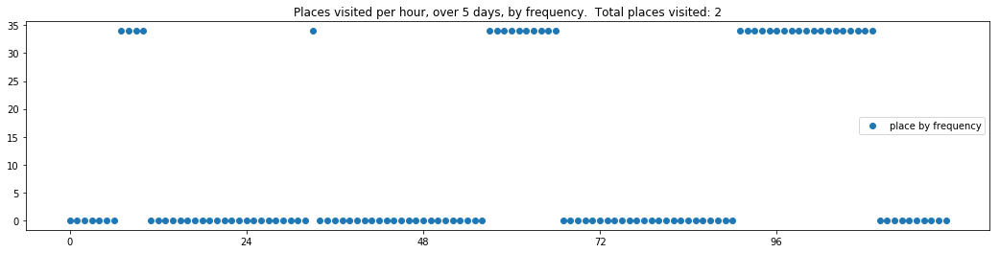

----- vector ----
prefix labels:  [2, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 334, 334, 334, 334, 334, 334, 334]
[334, 334, 334, 334, 334, 334, 334, 334, 334, 334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


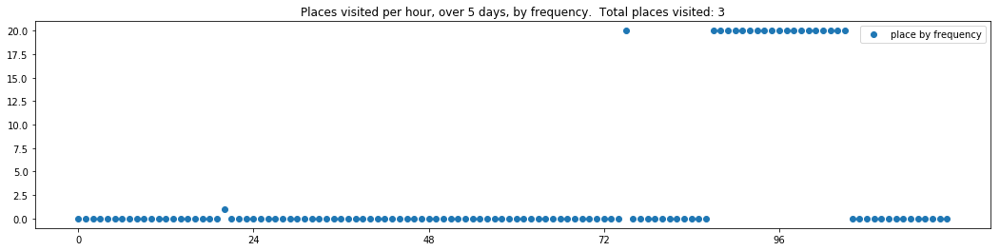

----- vector ----
prefix labels:  [312, 312]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 130, 0, 0, 0, 223, 0, 0, 0, 0, 0]


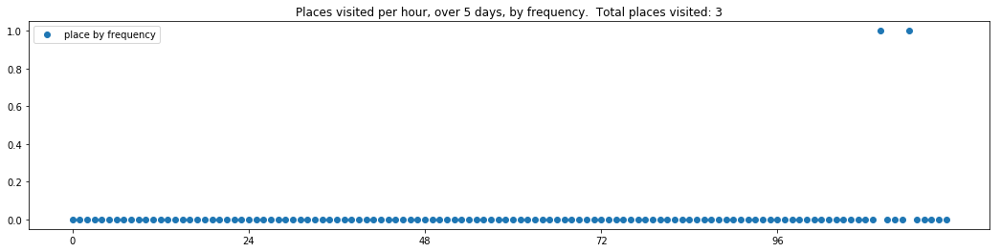

----- vector ----
prefix labels:  [194, 194]
[0, 0, 0, 0, 0, 0, 0, 0, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]
[194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194, 194]


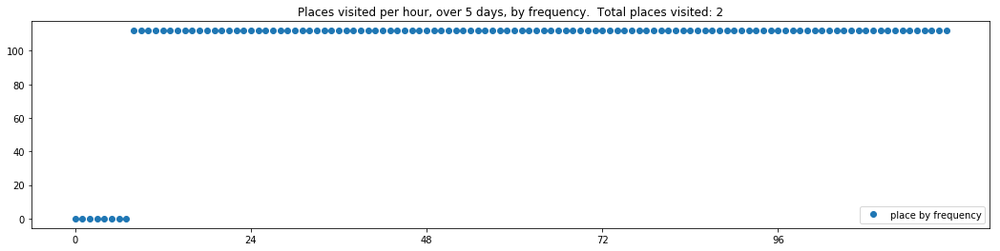

----- vector ----
prefix labels:  [266, 93]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 361, 0, 0, 204, 0, 0, 0, 367, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 304, 304, 304, 304, 304, 304, 304, 507]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 311, 311, 311, 26, 26, 26, 0, 0, 0, 0, 0]


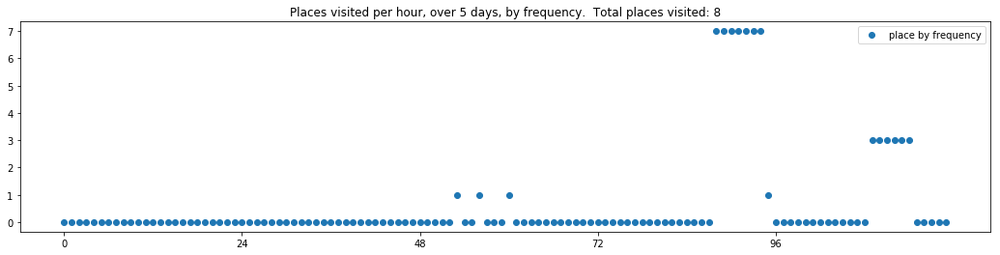

----- vector ----
prefix labels:  [184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 0, 0, 0, 0, 184, 0, 184, 184, 184, 184, 184, 184, 184, 184]
[184, 0, 0, 0, 0, 0, 0, 0, 0, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 0, 0]


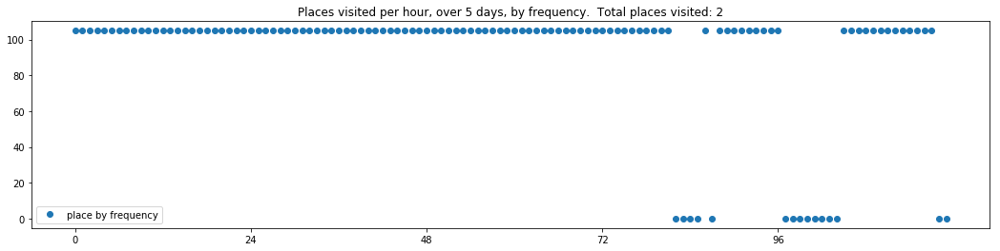

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 0, 0, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 364, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


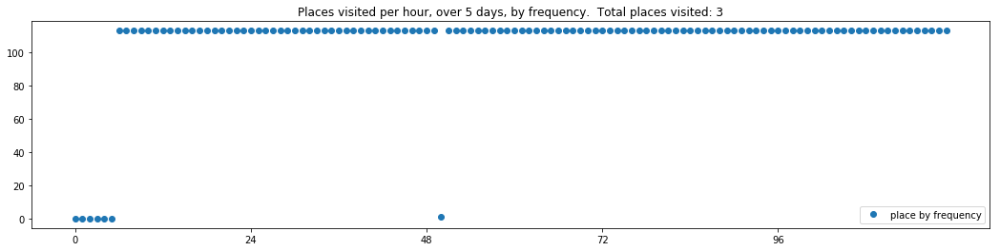

----- vector ----
prefix labels:  [609, 609]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]
[27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27]


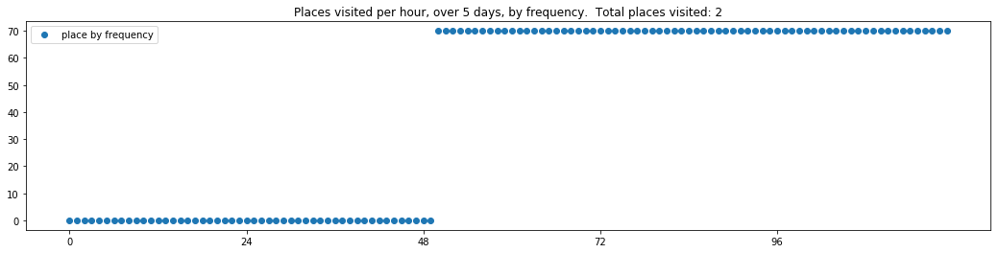

----- vector ----
prefix labels:  [146, 146]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146]
[146, 146, 146, 146, 146, 146, 146, 146, 0, 0, 0, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146]
[146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146]
[146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 146, 0, 0, 0, 0, 146, 146]


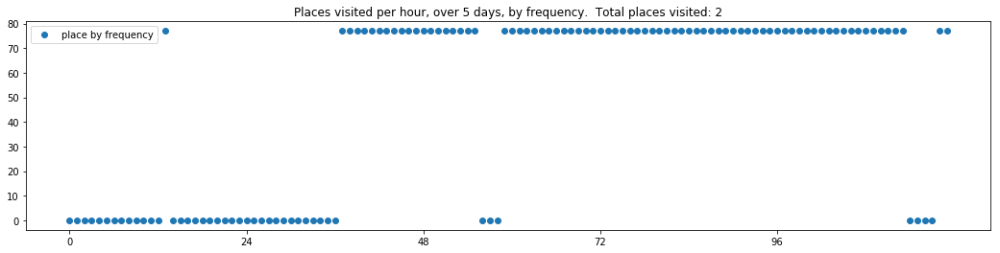

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 0, 0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 0]


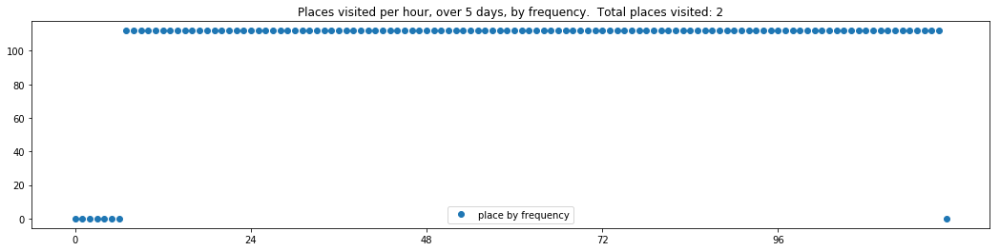

----- vector ----
prefix labels:  [185, 185]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 99, 99, 99]
[68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 132, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


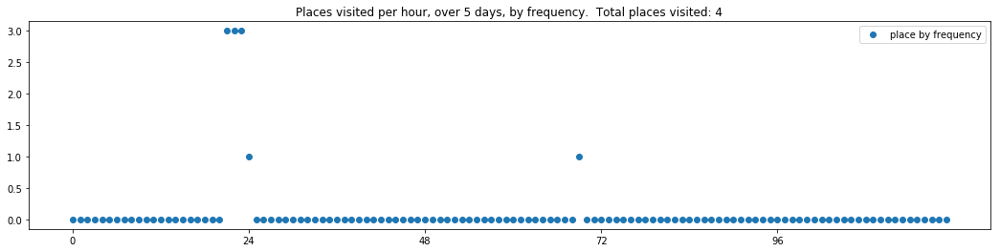

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


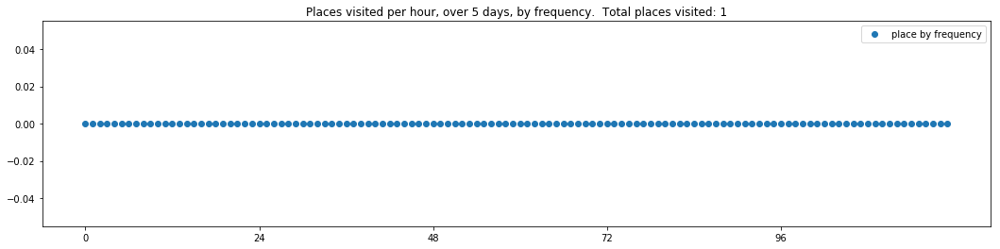

----- vector ----
prefix labels:  [93, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 209, 209, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 209, 209, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


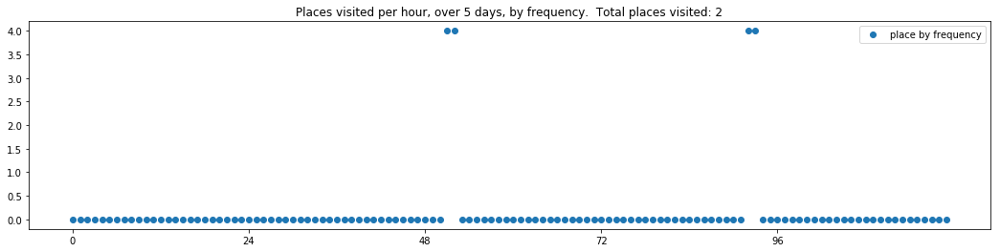

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


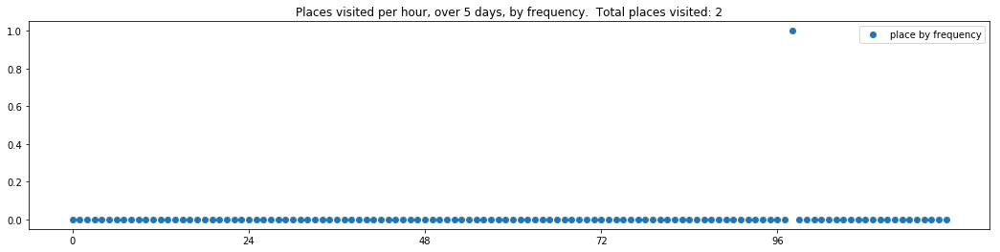

----- vector ----
prefix labels:  [69, 69]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 22, 22, 22, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


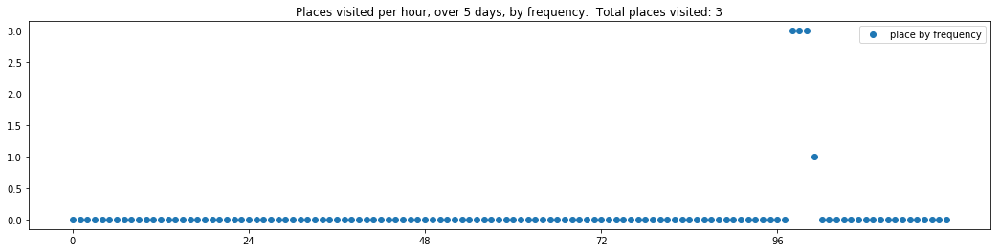


------
 125 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_125.txt 
------

----- vector ----
prefix labels:  [469, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 275, 275, 275, 275, 275, 275, 275, 275, 275, 275, 275, 275]
[275, 275, 275, 275, 112, 0, 187, 0, 0, 0, 187, 469, 469, 469, 469, 469, 203, 469, 469, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 214, 0, 0, 0, 0, 0, 0, 469, 469, 469, 469, 0, 469, 469, 469, 469, 469]
[469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 469, 213, 213, 213]
[213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 213, 550]


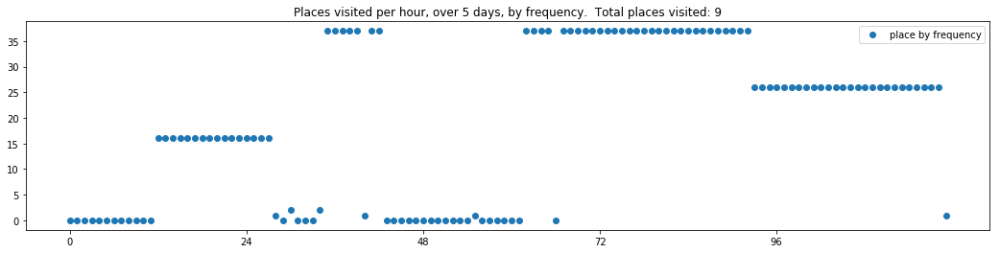

----- vector ----
prefix labels:  [2, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 151, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


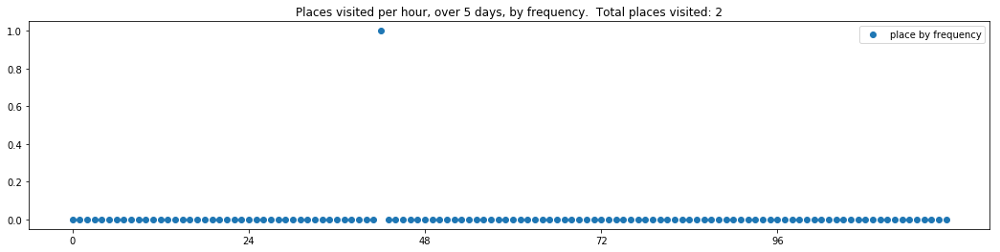

----- vector ----
prefix labels:  [248, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


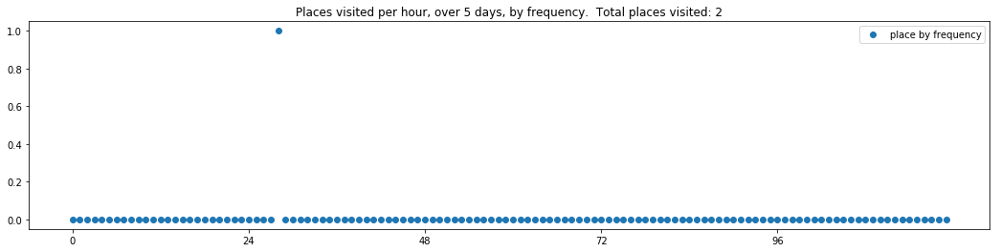

----- vector ----
prefix labels:  [289, 4]
[0, 0, 0, 0, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 88, 289, 289, 289]
[289, 289, 289, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 289, 289, 289, 289, 289, 289, 289]


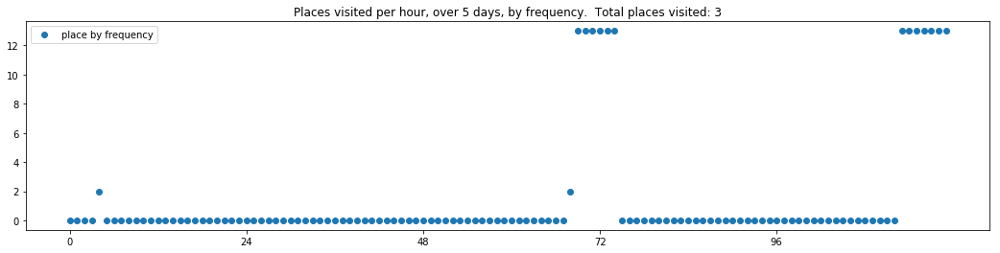

----- vector ----
prefix labels:  [115, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


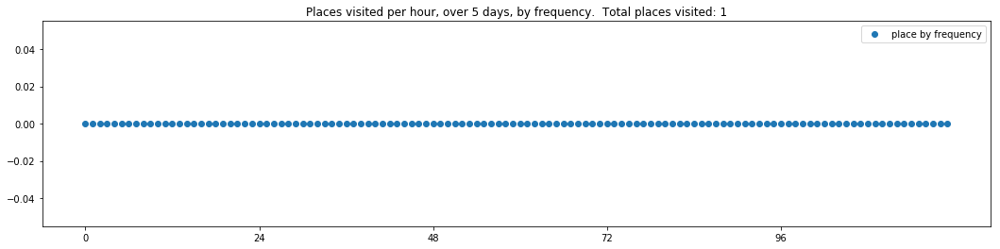

----- vector ----
prefix labels:  [586, 586]
[0, 0, 0, 0, 0, 0, 0, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 0, 586, 586, 586, 586, 586, 586]


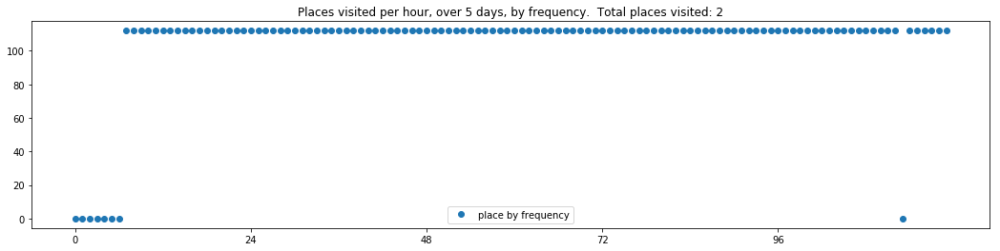

----- vector ----
prefix labels:  [263, 263]
[263, 263, 263, 263, 263, 263, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263]
[263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263]
[263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263]
[263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263, 263]


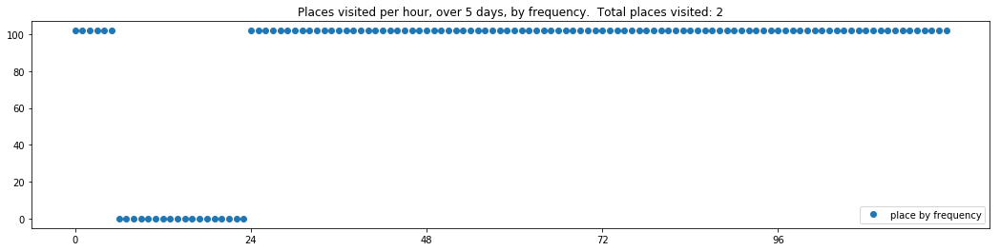

----- vector ----
prefix labels:  [90, 189]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 90]


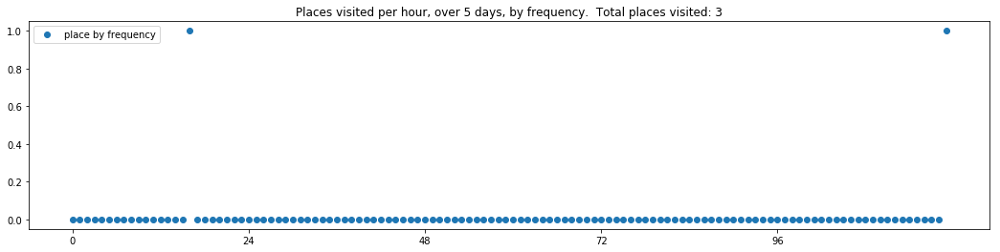

----- vector ----
prefix labels:  [293, 293]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


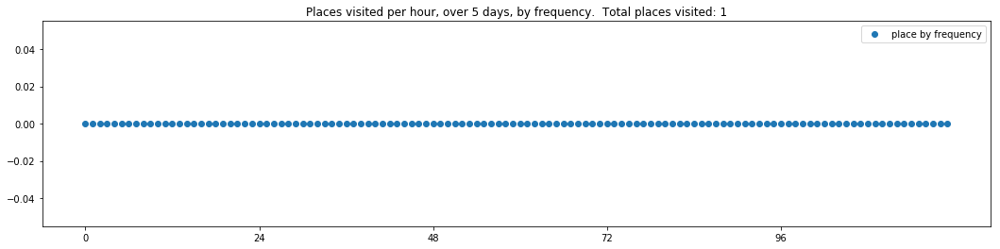

----- vector ----
prefix labels:  [143, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 33]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 0, 0, 454, 0, 0]


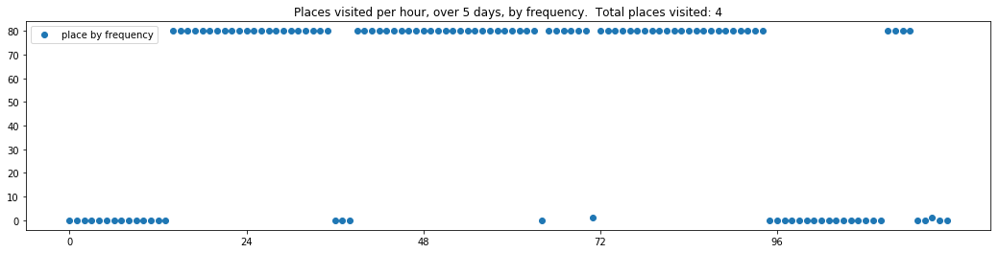

----- vector ----
prefix labels:  [87, 87]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


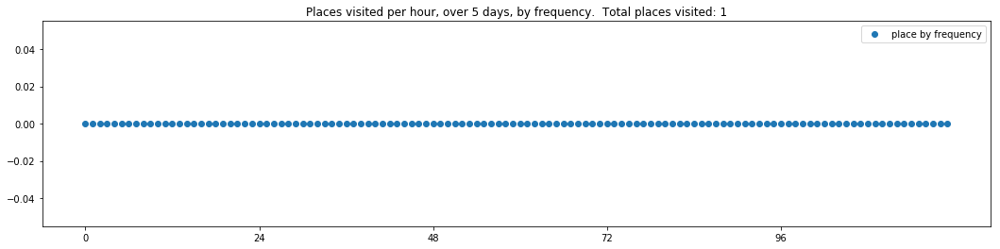

----- vector ----
prefix labels:  [44, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 44, 44]
[44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 44, 0, 0, 0, 44, 44, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


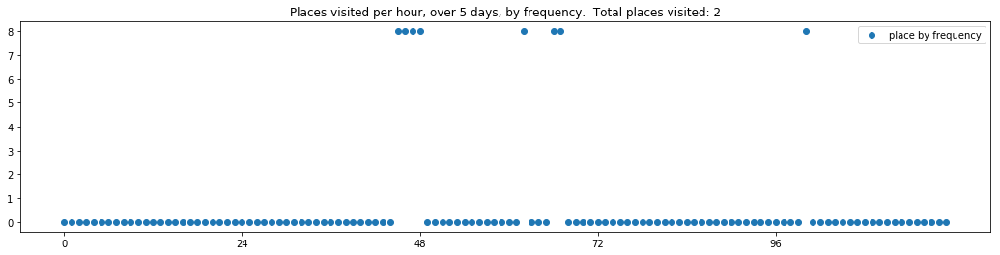

----- vector ----
prefix labels:  [43, 43]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


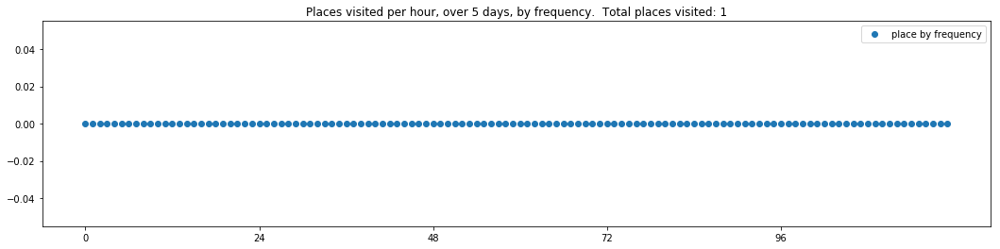

----- vector ----
prefix labels:  [562, 562]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562, 562]
[562, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


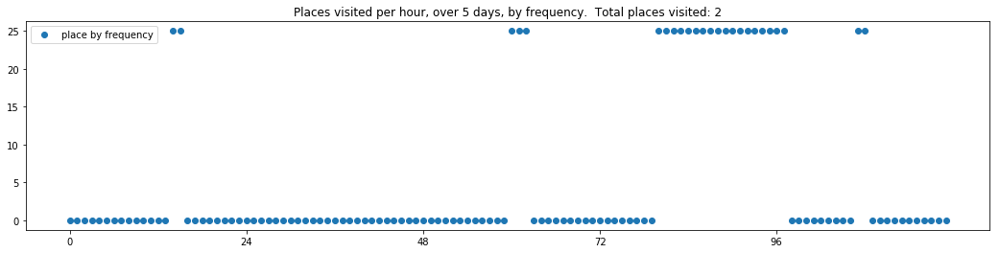

----- vector ----
prefix labels:  [417, 448]
[0, 0, 0, 0, 0, 0, 0, 406, 406, 406, 406, 406, 401, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 451, 0, 56, 56, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[21, 151, 151, 151, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 364, 317, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


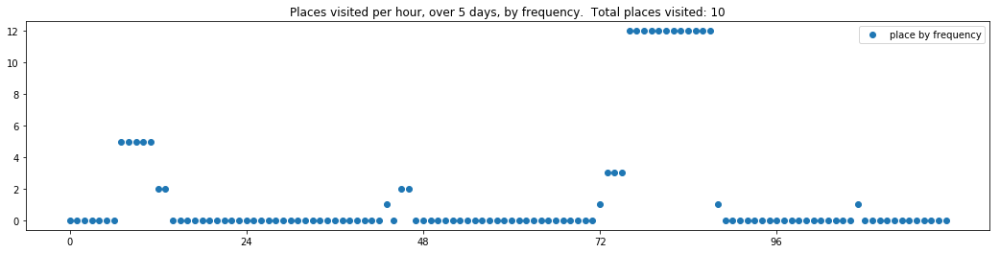

----- vector ----
prefix labels:  [95, 95]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95]
[95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 334, 334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


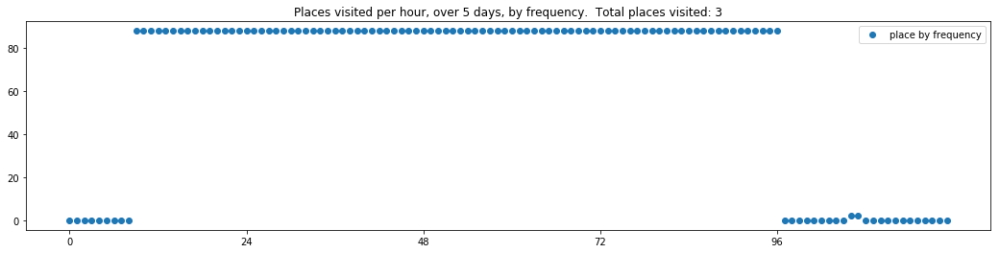

----- vector ----
prefix labels:  [323, 323]
[0, 0, 0, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]
[323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323, 323]


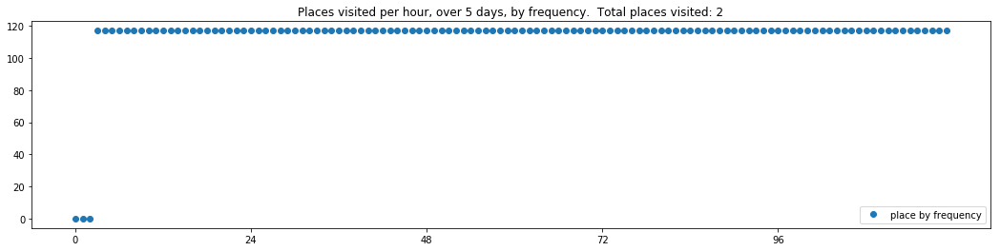

----- vector ----
prefix labels:  [431, 431]
[0, 0, 0, 0, 0, 0, 431, 431, 431, 431, 431, 431, 0, 0, 0, 0, 0, 0, 0, 0, 0, 431, 431, 431]
[431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431]
[431, 0, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 431, 0, 0]
[0, 431, 431, 0, 0, 0, 0, 0, 590, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


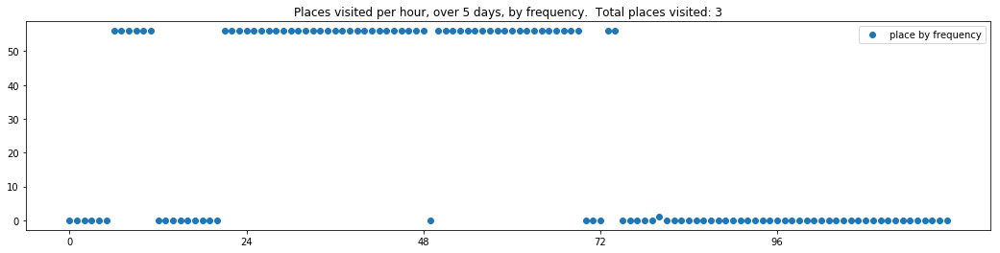

----- vector ----
prefix labels:  [72, 88]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72]
[72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 32, 32, 32, 32, 32, 0, 0]


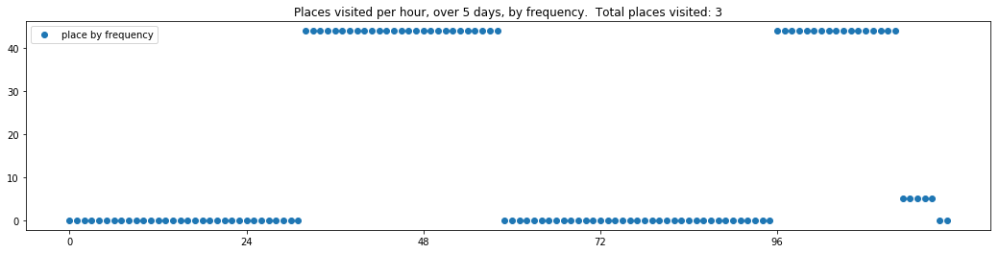

----- vector ----
prefix labels:  [233, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 640, 640]
[640, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 34, 0, 228, 0, 5, 5, 5, 5, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


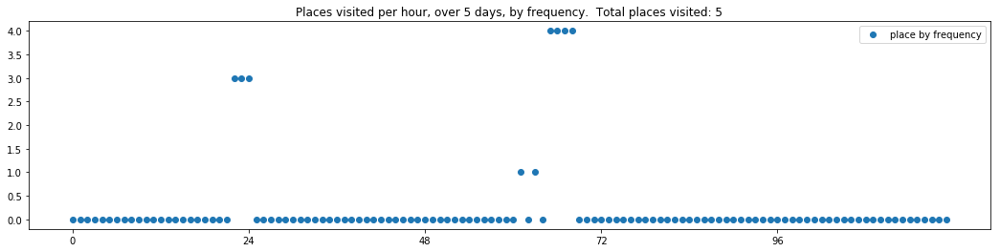

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 536, 536, 536, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


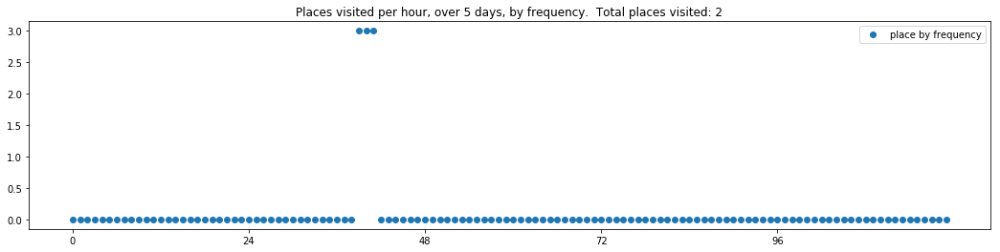

----- vector ----
prefix labels:  [4, 4]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 151, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


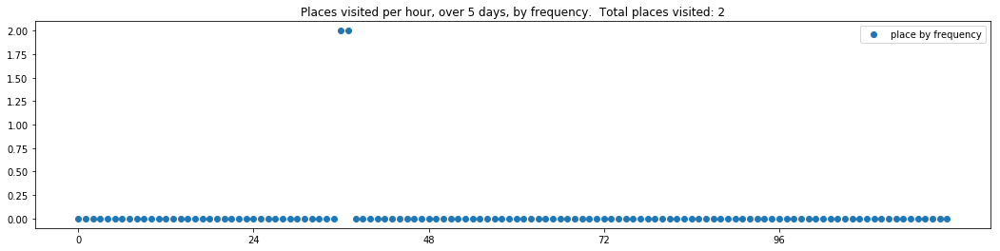

----- vector ----
prefix labels:  [557, 24]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


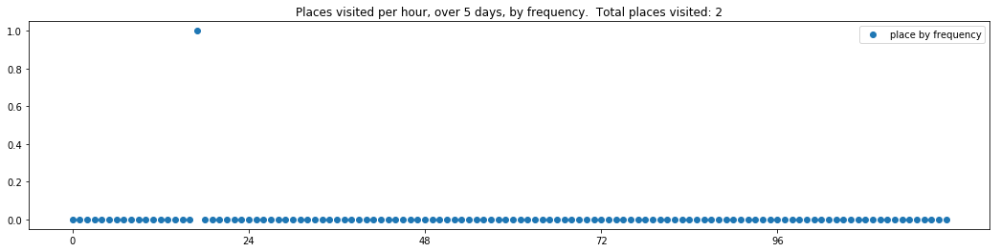

----- vector ----
prefix labels:  [233, 233]
[0, 0, 0, 0, 0, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 34, 34, 34, 34, 34, 34, 34, 34, 34]
[34, 34, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233]
[233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 0, 0]
[0, 29, 29, 0, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233]
[233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233, 233]


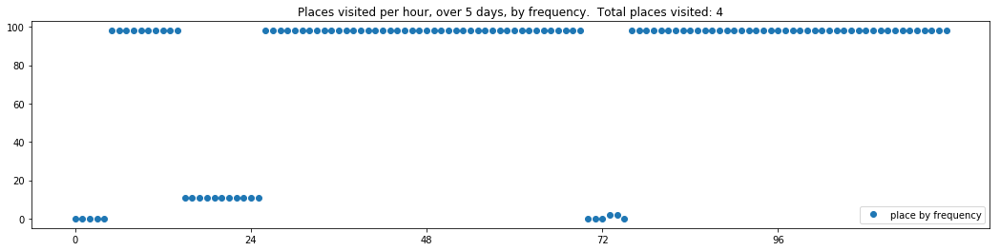

----- vector ----
prefix labels:  [91, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 433, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


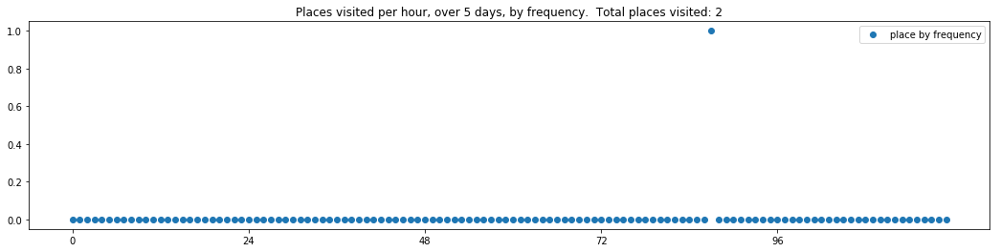

----- vector ----
prefix labels:  [157, 157]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 100, 157]
[157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157]
[157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157]
[157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157, 157]


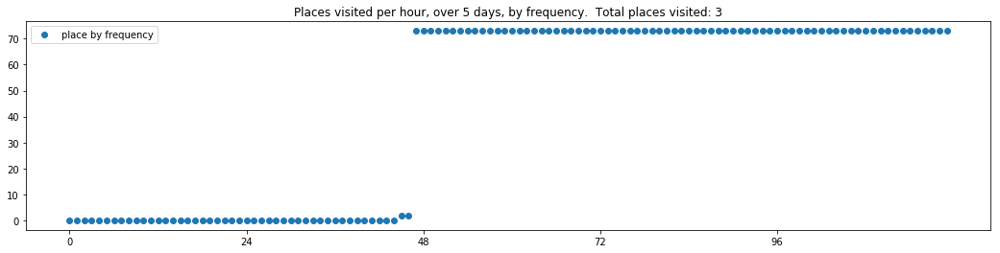

----- vector ----
prefix labels:  [299, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


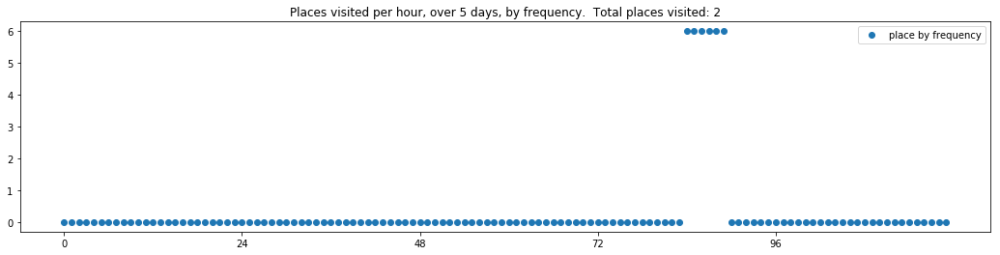

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71]
[71, 71, 71, 71, 71, 71, 151, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71]


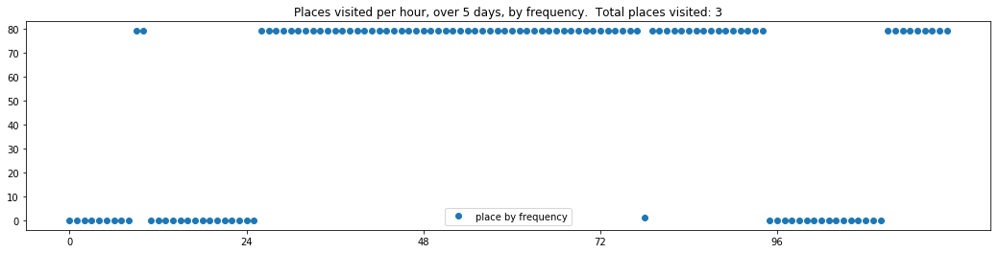

----- vector ----
prefix labels:  [502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 372, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 502, 502, 0, 0, 0, 0, 0, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 0, 0, 0, 0, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 0, 502, 502, 502, 502, 502, 502]
[502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 502, 126]


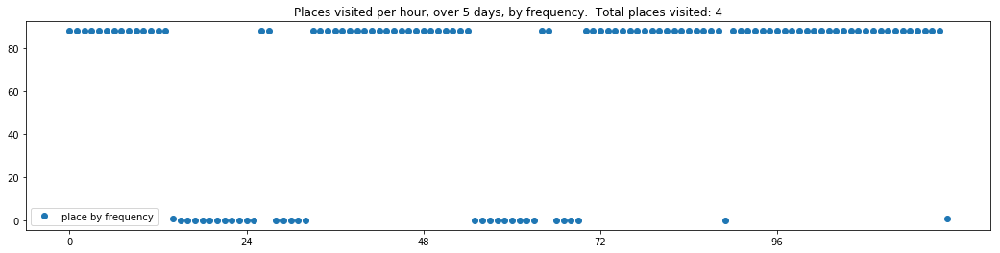

----- vector ----
prefix labels:  [392, 392]
[0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 0, 0, 539, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392, 392]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


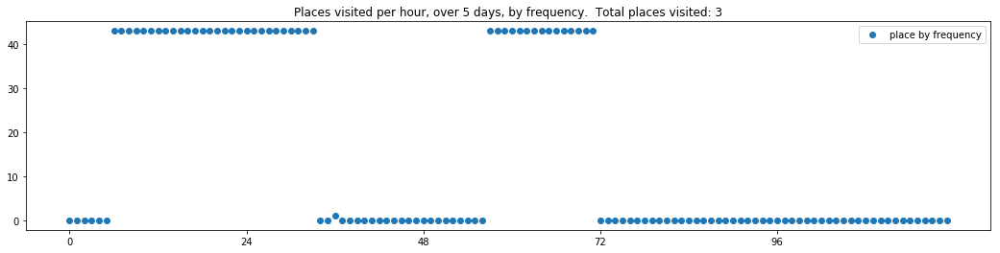

----- vector ----
prefix labels:  [192, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 216, 216, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 204]


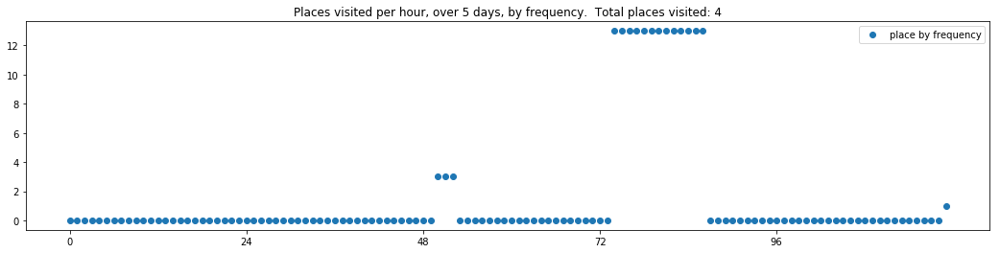

----- vector ----
prefix labels:  [223, 223]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


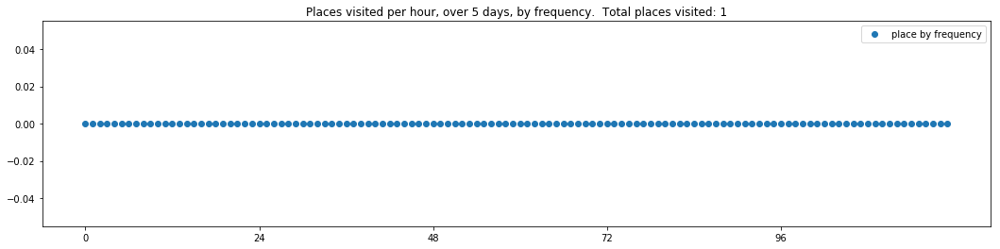

----- vector ----
prefix labels:  [390, 390]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[341, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 611, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


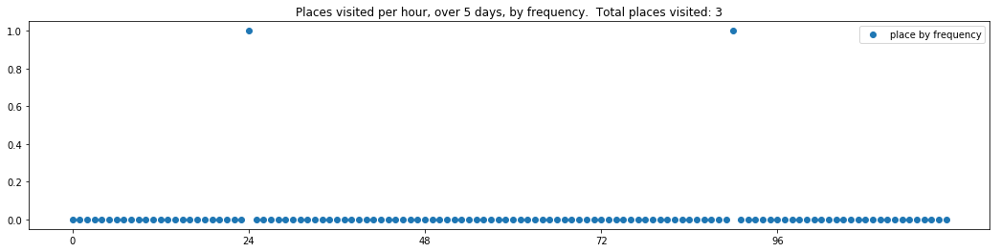

----- vector ----
prefix labels:  [432, 432]
[0, 0, 0, 0, 0, 0, 0, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]
[432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432, 432]


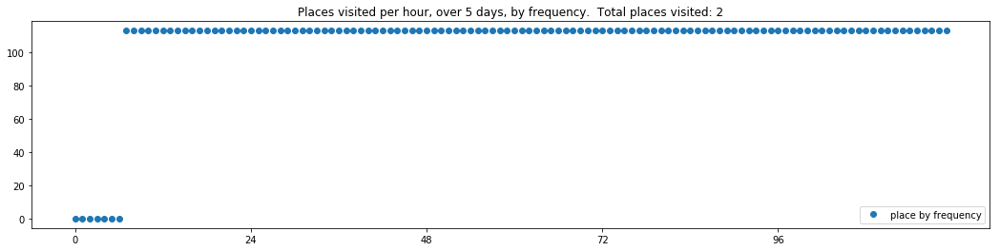

----- vector ----
prefix labels:  [20, 22]
[0, 0, 0, 0, 20, 404, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


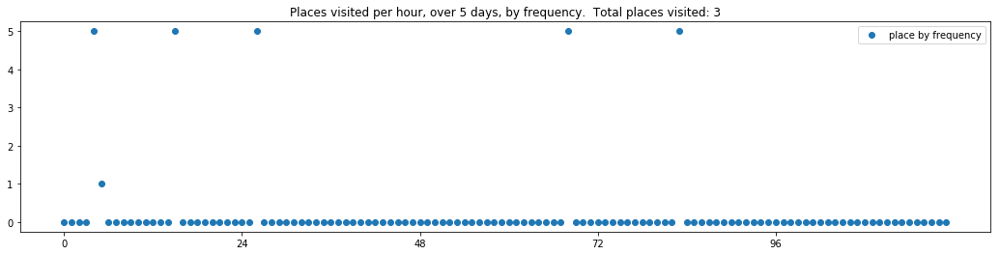

----- vector ----
prefix labels:  [404, 404]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 78, 0, 78, 78, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 78, 0, 0, 78, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


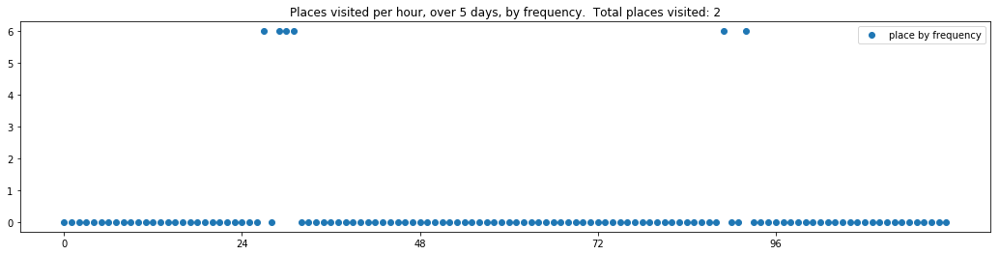

----- vector ----
prefix labels:  [581, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


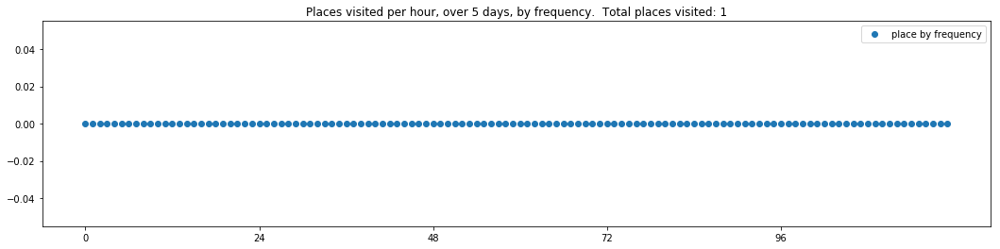

----- vector ----
prefix labels:  [343, 343]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 0, 0, 0, 0, 0, 0, 0, 616, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 343, 343, 343, 343, 343, 343, 343, 343, 343, 0, 0, 343, 0, 191, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343]
[343, 343, 343, 343, 343, 343, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 343, 343, 343, 343, 0, 0, 0, 0]


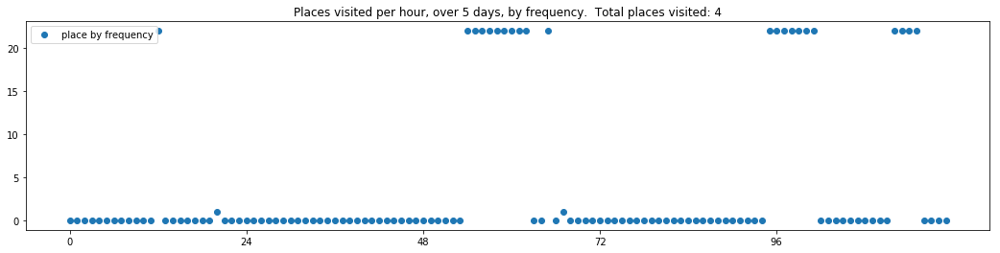

----- vector ----
prefix labels:  [22, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 22, 22, 22, 22, 22, 22, 22, 22]
[22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]
[22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 0, 22, 22, 22, 22, 22, 22]
[22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]


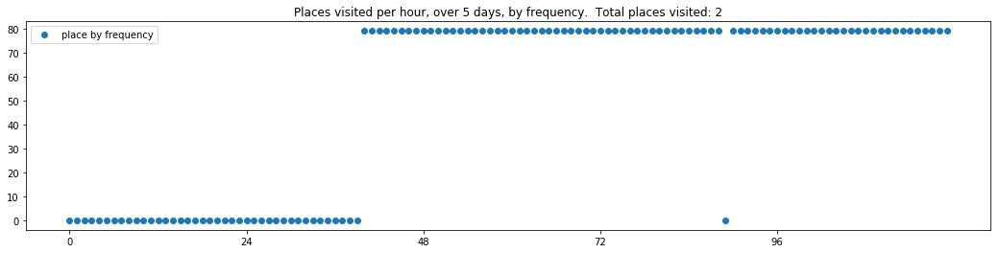

----- vector ----
prefix labels:  [71, 71]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71]
[71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 0, 0, 0, 0, 0, 0, 0]
[0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 0]
[0, 0, 0, 0, 0, 0, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 71, 0, 71, 71, 71, 71, 71, 71]


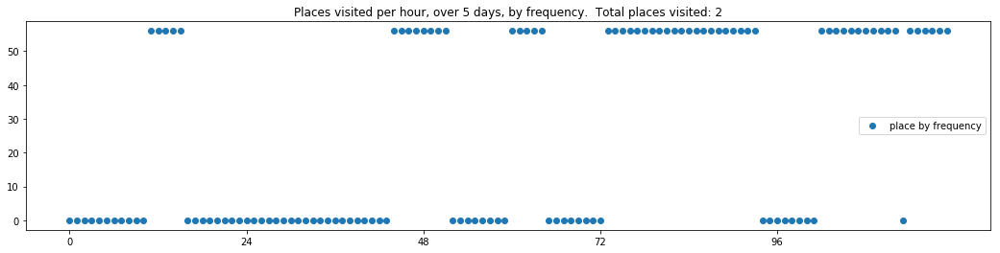

----- vector ----
prefix labels:  [26, 55]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 195, 195, 195, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320]
[320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 453]
[453, 453, 453, 453, 453, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]


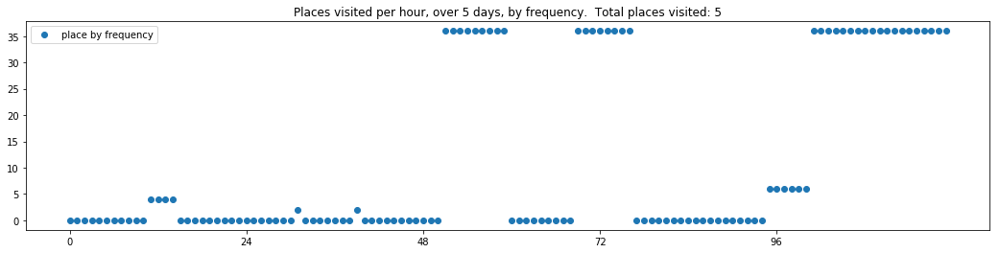

----- vector ----
prefix labels:  [46, 213]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 142, 213, 213, 213, 213, 213, 213, 0]
[0, 0, 0, 0, 46, 401, 401, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46, 46, 46, 46]
[46, 46, 46, 46, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 46, 46]


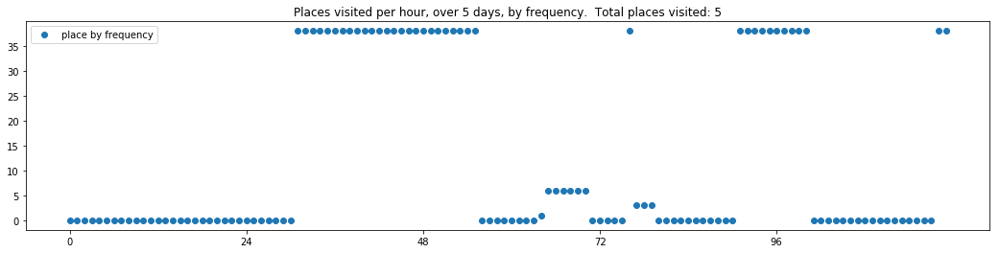

----- vector ----
prefix labels:  [216, 199]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119]
[0, 0, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 263, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 0, 0, 0, 0, 0, 0, 151, 151, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14]
[14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 0, 0]


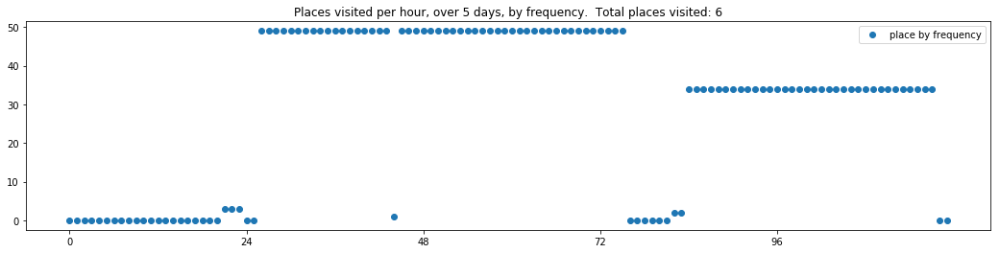

----- vector ----
prefix labels:  [288, 8]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 197, 197, 197, 197, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 169, 169, 169, 169, 593, 208, 0, 0, 0, 0, 268, 268, 268, 268]
[268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268, 268]


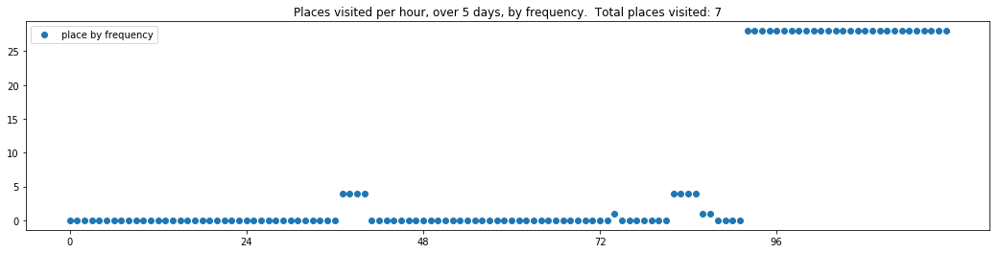

----- vector ----
prefix labels:  [580, 0]
[0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 580, 580, 580, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


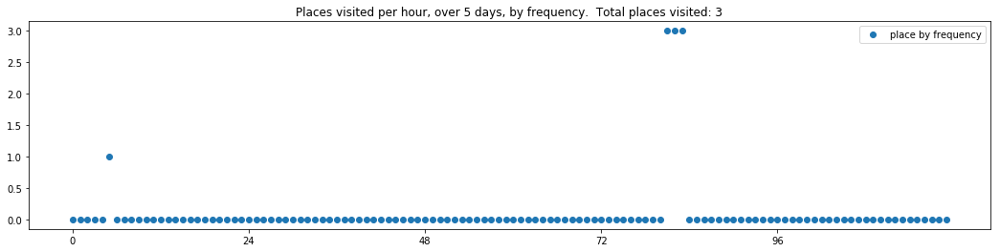

----- vector ----
prefix labels:  [192, 0]
[0, 0, 0, 0, 0, 0, 31, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232, 232]
[232, 232, 232, 232, 0, 271, 271, 271, 271, 0, 0, 0, 0, 0, 242, 242, 242, 242, 21, 0, 271, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 424, 424, 445, 76, 76, 76, 51, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192, 192]


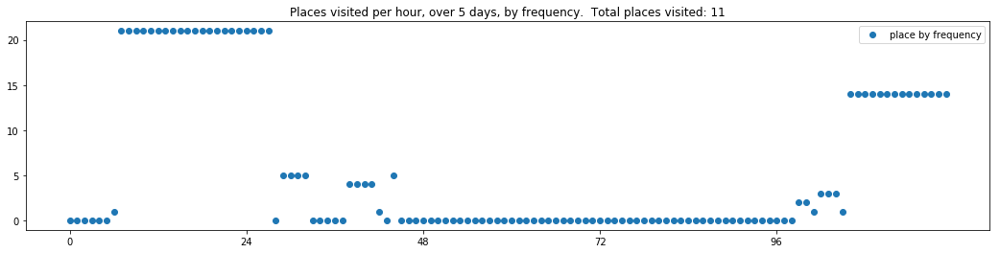

----- vector ----
prefix labels:  [152, 152]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 0, 0, 339, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 0, 68, 68, 68, 68, 68, 68, 68, 68, 68]
[68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 79, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68, 68]


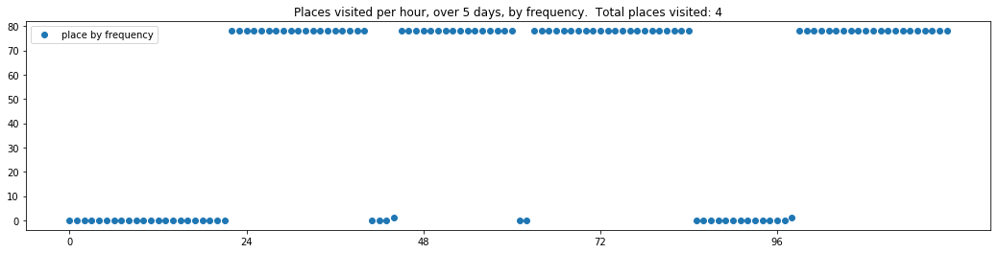

----- vector ----
prefix labels:  [214, 214]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 214, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214, 214]
[214, 214, 214, 214, 214, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 214, 214, 214]


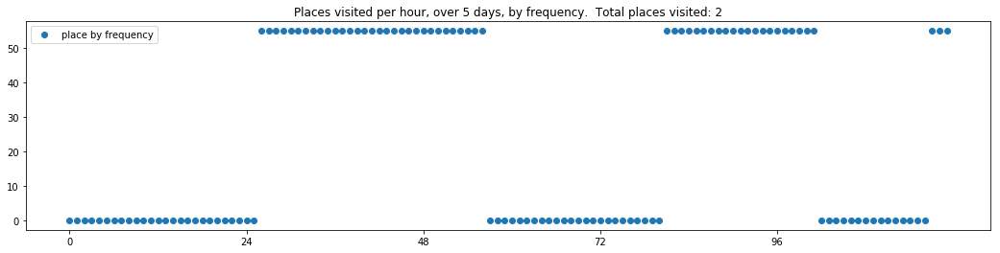

----- vector ----
prefix labels:  [540, 187]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 81, 377, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 187, 187, 0, 0]
[187, 187, 376, 22, 22, 21, 22, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]
[604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604]


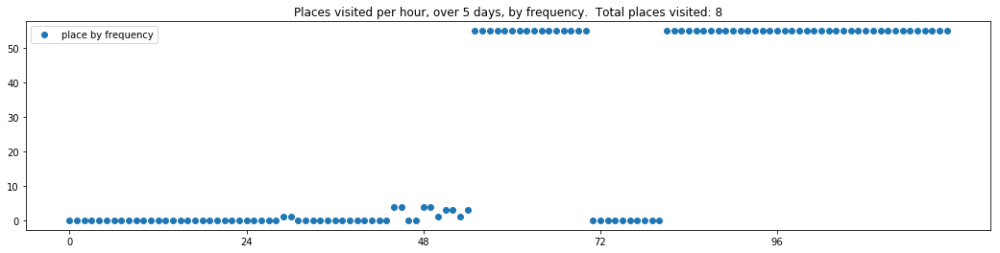

----- vector ----
prefix labels:  [190, 190]
[0, 0, 0, 0, 0, 0, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 190, 0, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
[190, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 190, 190]


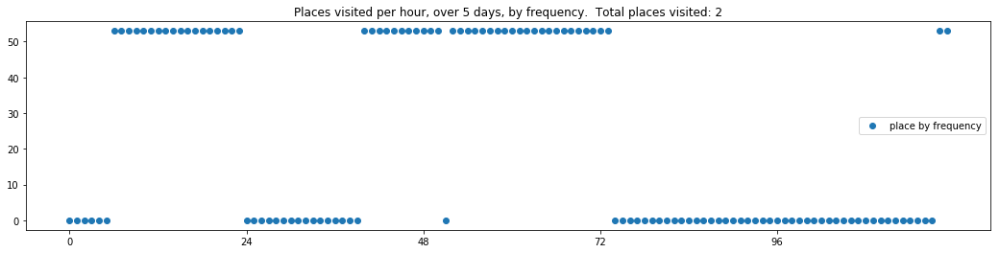


------
 130 /Users/aberke/projects/gan-hacking/SeqGAN/save/eval_file_130.txt 
------

----- vector ----
prefix labels:  [368, 56]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 375, 0]
[0, 0, 0, 0, 0, 100, 199, 199, 199, 503, 503, 503, 56, 56, 56, 56, 56, 56, 56, 56, 56, 56, 56, 56]
[56, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199]
[199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 21, 0, 0, 0, 0, 0, 0, 0, 0]


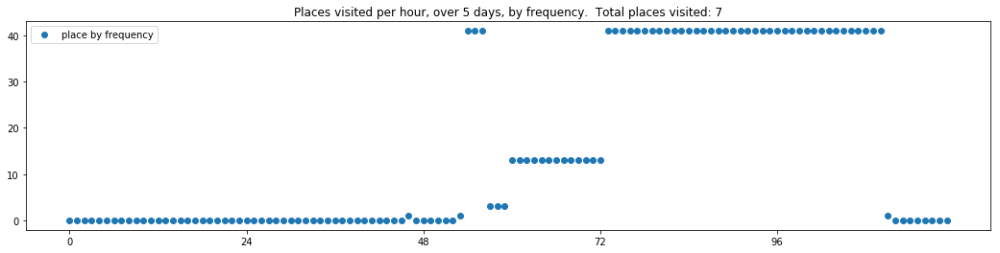

----- vector ----
prefix labels:  [542, 542]
[0, 0, 0, 0, 0, 0, 0, 542, 542, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 542]


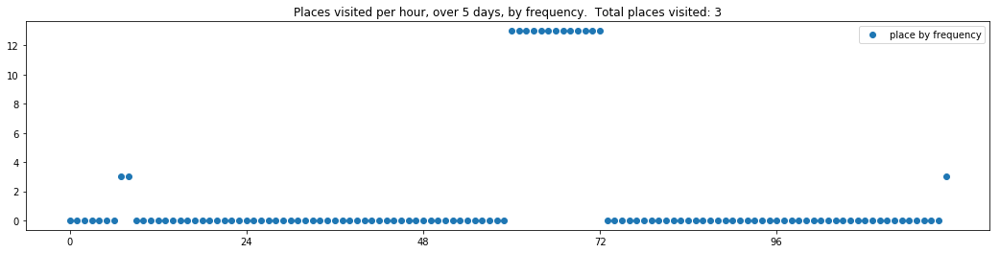

----- vector ----
prefix labels:  [586, 586]
[0, 0, 0, 0, 0, 0, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]
[586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586, 586]


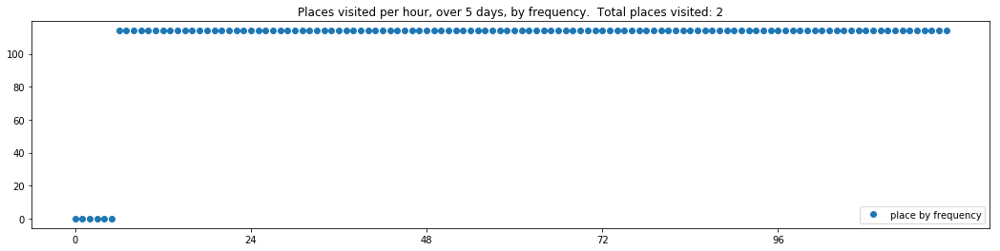

----- vector ----
prefix labels:  [595, 353]
[0, 0, 0, 0, 289, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


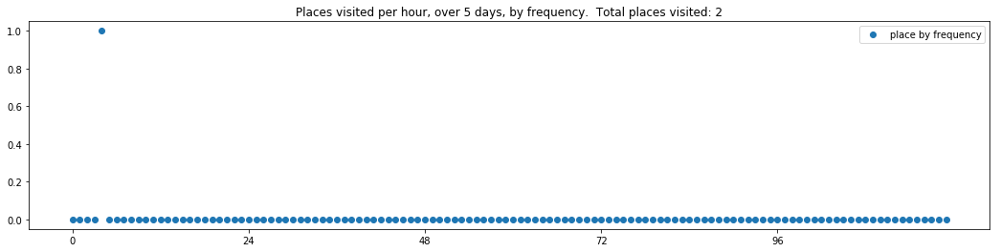

----- vector ----
prefix labels:  [99, 99]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 99, 99, 99, 99, 99, 99, 99, 99, 99]
[99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
[99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
[99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
[99, 99, 99, 99, 99, 99, 99, 99, 99, 551, 551, 551, 551, 551, 551, 0, 0, 0, 0, 438, 0, 0, 0, 0]


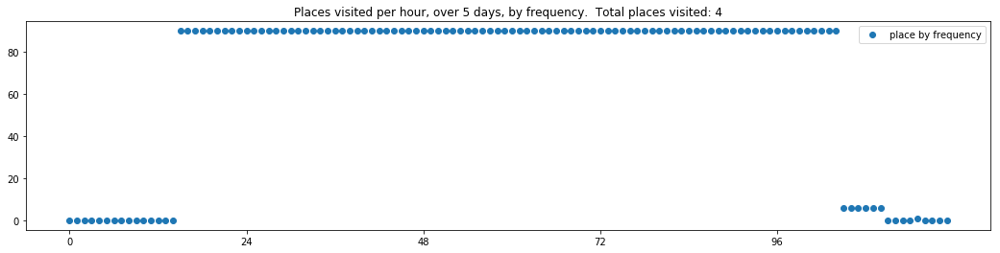

----- vector ----
prefix labels:  [21, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 21, 76, 76, 76, 0, 0]


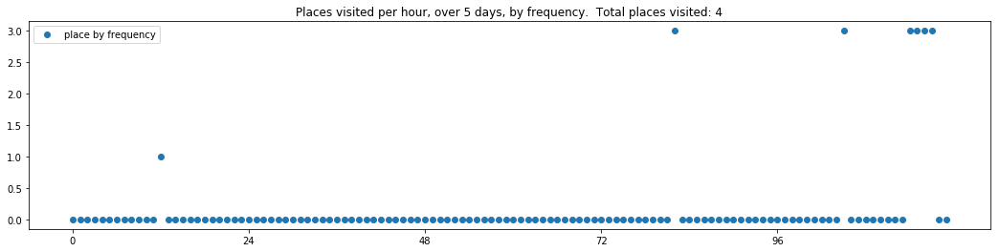

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


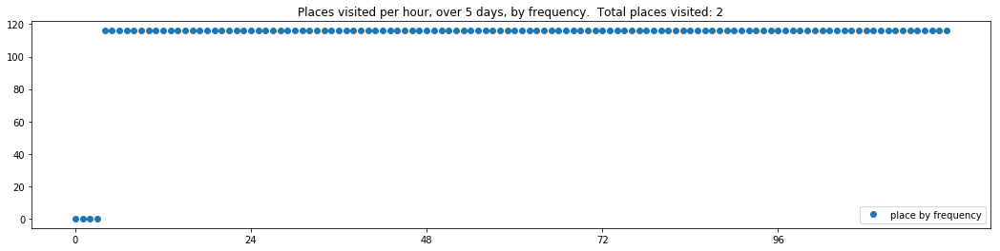

----- vector ----
prefix labels:  [271, 271]
[0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0]
[0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271]


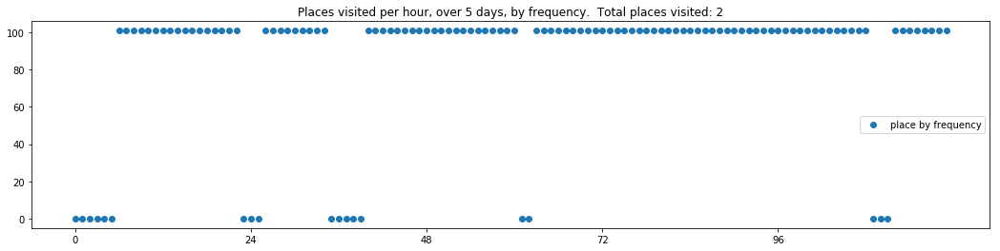

----- vector ----
prefix labels:  [247, 247]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 247, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 48, 247, 247, 247, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 247, 247]
[0, 0, 0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


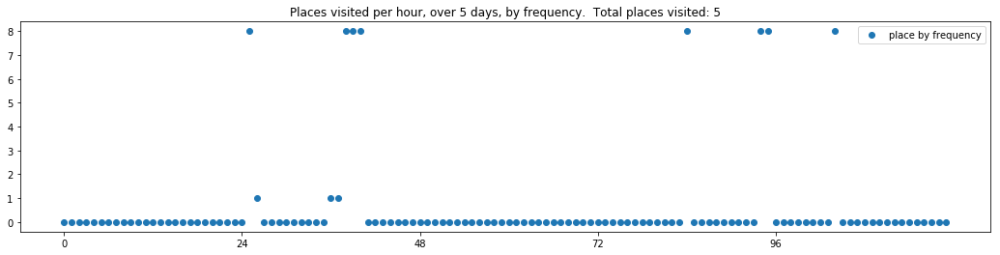

----- vector ----
prefix labels:  [281, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 214, 0, 140, 434, 434, 434, 434, 434, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


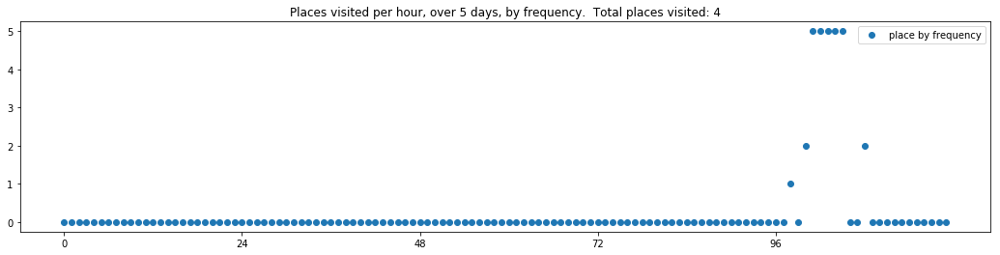

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320]
[320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


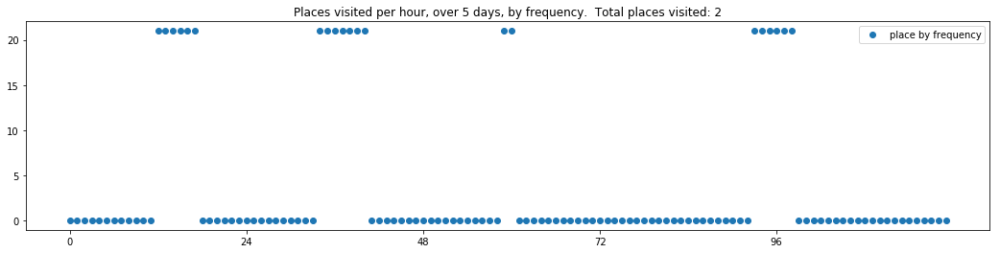

----- vector ----
prefix labels:  [378, 378]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 0, 0, 0, 0, 378, 378]
[378, 378, 378, 378, 378, 378, 378, 0, 182, 0, 182, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 52, 0, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347, 347]
[52, 52, 52, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 52, 52, 52, 52, 52, 52, 0, 0, 416, 416]
[416, 416, 416, 416, 416, 416, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52, 52]


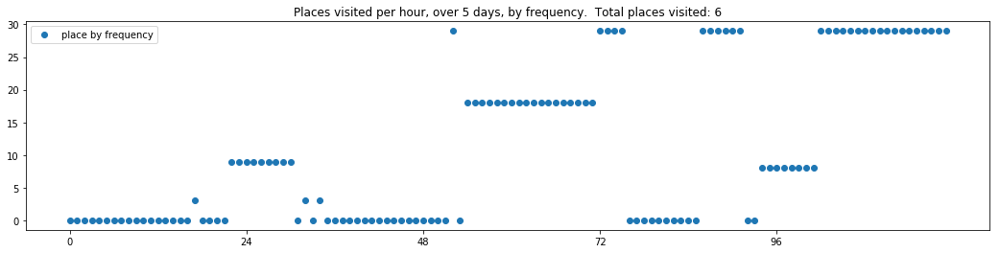

----- vector ----
prefix labels:  [119, 119]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 119, 119, 119, 119, 119, 119, 0, 0, 0, 199, 227, 0, 0]
[0, 0, 0, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 119, 151, 151, 151, 151, 151]
[151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151, 151]
[151, 151, 151, 151, 151, 151, 151, 506, 151, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 184, 56, 302, 302, 302]
[302, 302, 41, 42, 42, 42, 42, 42, 42, 42, 41, 41, 41, 42, 42, 42, 42, 0, 375, 375, 375, 375, 41, 41]


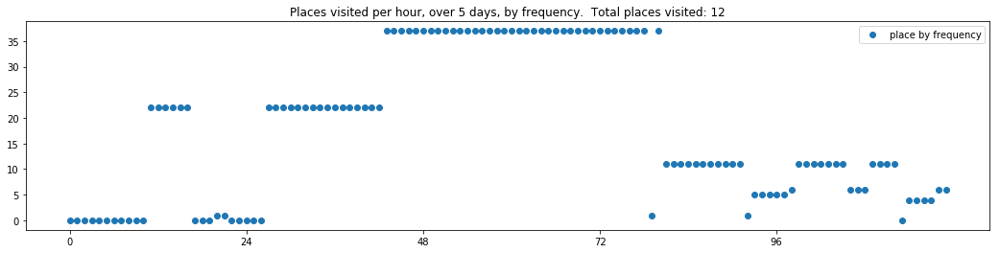

----- vector ----
prefix labels:  [205, 357]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357, 357]


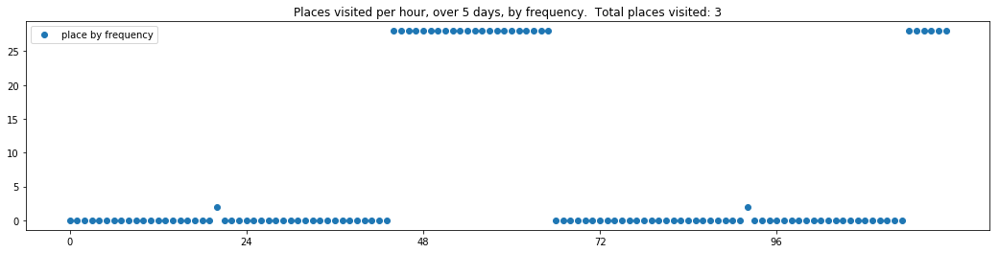

----- vector ----
prefix labels:  [395, 395]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 395, 395, 395, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 395, 395, 395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 395]
[395, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 395, 0]


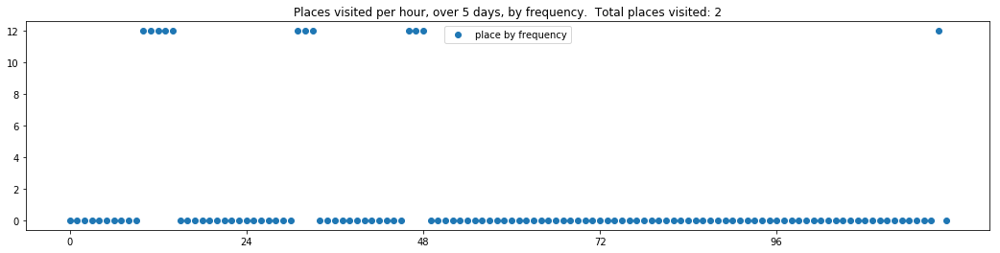

----- vector ----
prefix labels:  [437, 437]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437]
[437, 437, 437, 437, 437, 437, 437, 0, 437, 0, 0, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 437, 437, 437, 0, 437, 437, 437, 437, 437, 0]
[0, 437, 0, 0, 0, 0, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 437, 0, 0, 0, 0, 0, 0, 0]


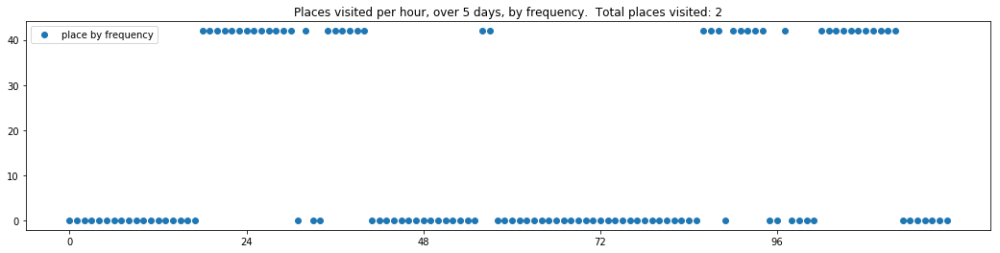

----- vector ----
prefix labels:  [120, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 0, 0, 0, 0]
[0, 0, 0, 412, 412, 0, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 120, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 120, 120, 120, 120]


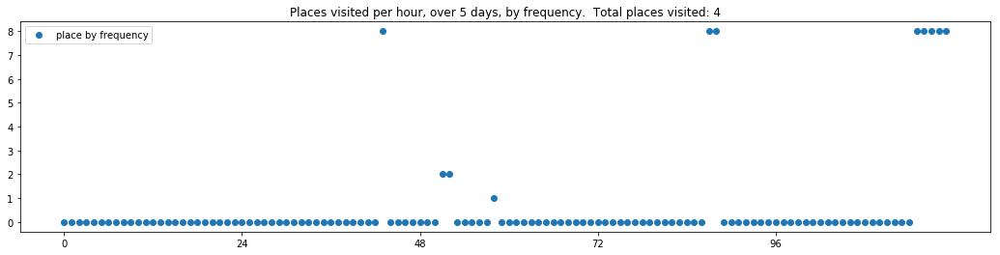

----- vector ----
prefix labels:  [434, 434]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 27, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 434, 434, 434, 434, 434, 434, 29, 212]
[0, 0, 0, 322, 214, 271, 271, 271, 0, 271, 271, 214, 628, 628, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 382, 382, 382, 382, 382, 382, 382, 382, 382]


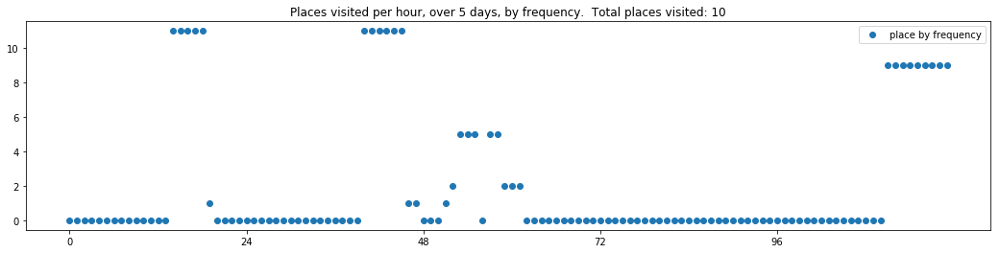

----- vector ----
prefix labels:  [582, 582]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]
[582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582, 582]


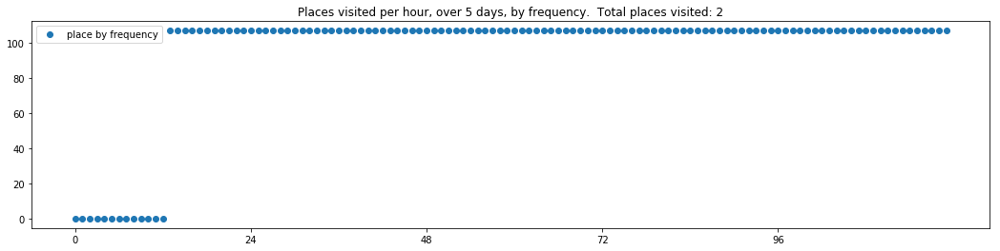

----- vector ----
prefix labels:  [20, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


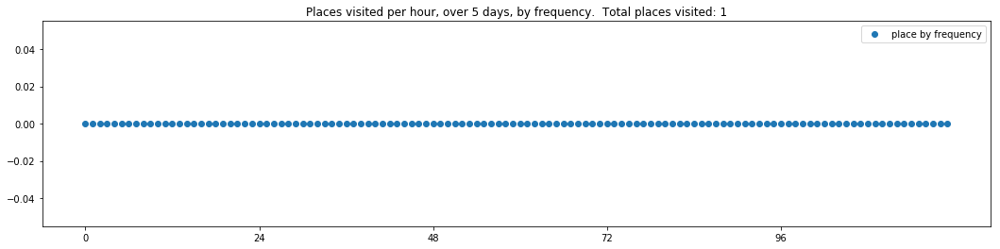

----- vector ----
prefix labels:  [200, 79]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 44, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


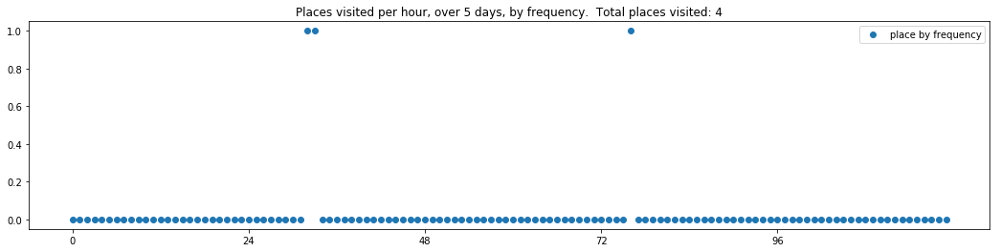

----- vector ----
prefix labels:  [384, 384]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 384, 384, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 384, 384, 0, 0, 384, 384, 384]
[384, 384, 384, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


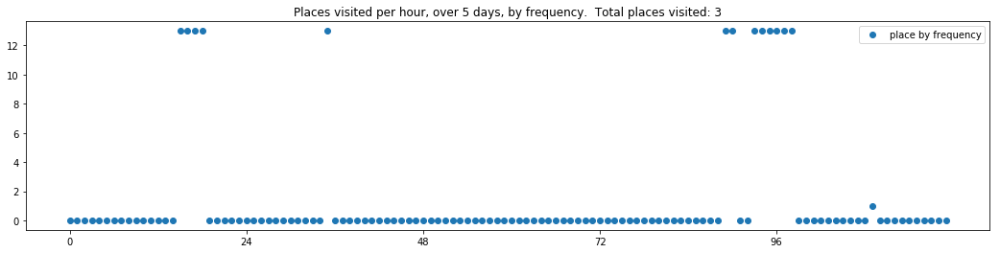

----- vector ----
prefix labels:  [209, 209]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[209, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209]
[209, 209, 209, 209, 209, 209, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


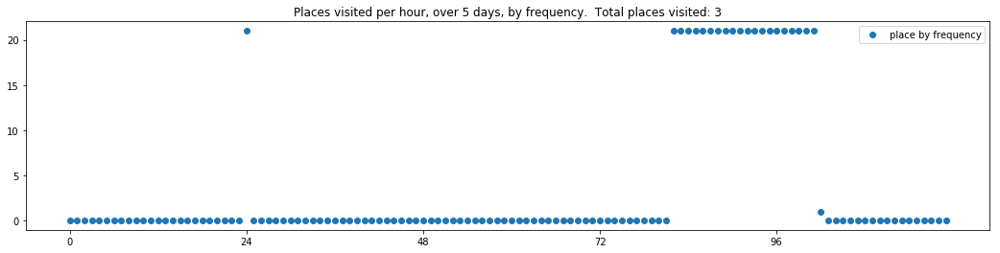

----- vector ----
prefix labels:  [479, 479]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 391, 391, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


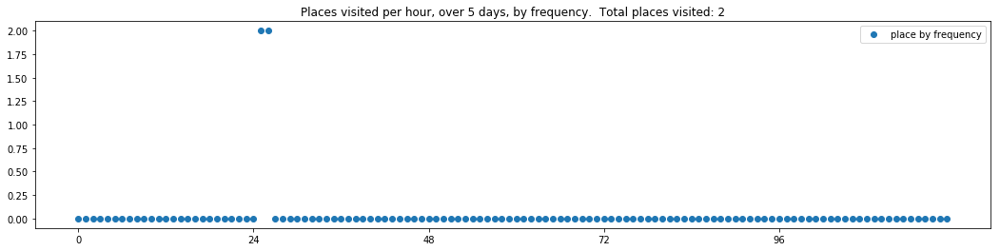

----- vector ----
prefix labels:  [192, 271]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 260, 260, 260, 260, 0, 0, 0, 0, 0]
[0, 0, 0, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]
[271, 271, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 271, 271, 271, 271, 271]


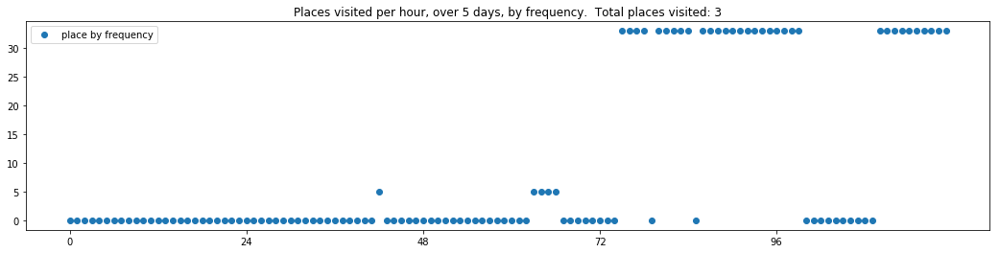

----- vector ----
prefix labels:  [203, 203]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203]
[203, 203, 203, 203, 203, 203, 203, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 203, 203, 203, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 604, 203, 203, 203, 203]
[203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203, 203]


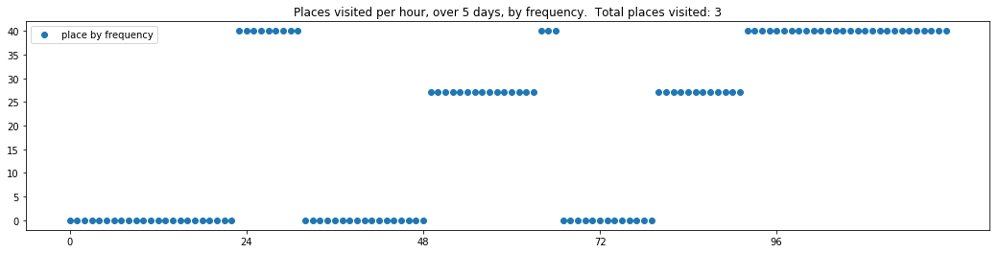

----- vector ----
prefix labels:  [80, 80]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 80, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


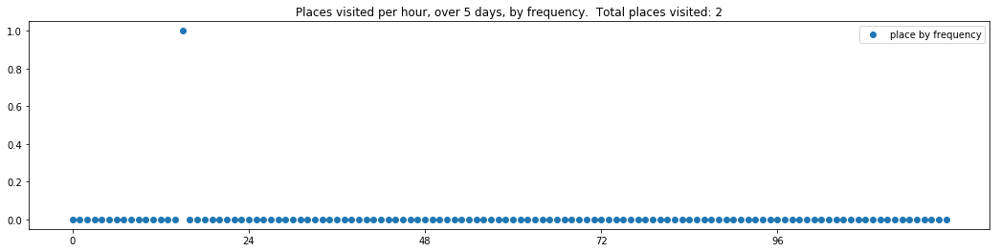

----- vector ----
prefix labels:  [320, 320]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 286, 286, 286, 286, 286, 391, 391, 391, 391, 391, 391, 391, 391, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]
[320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320, 320]


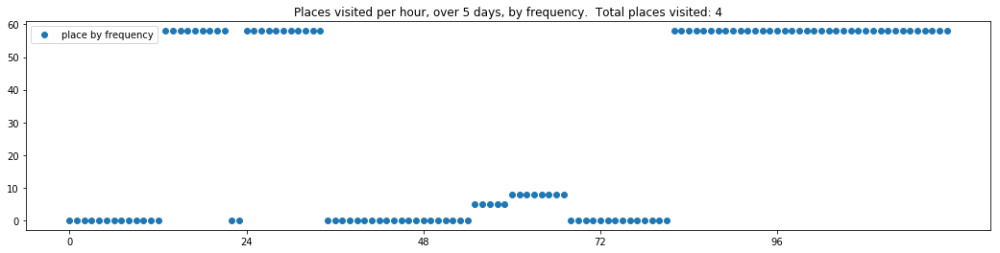

----- vector ----
prefix labels:  [205, 93]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 205, 205, 205, 0, 33, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


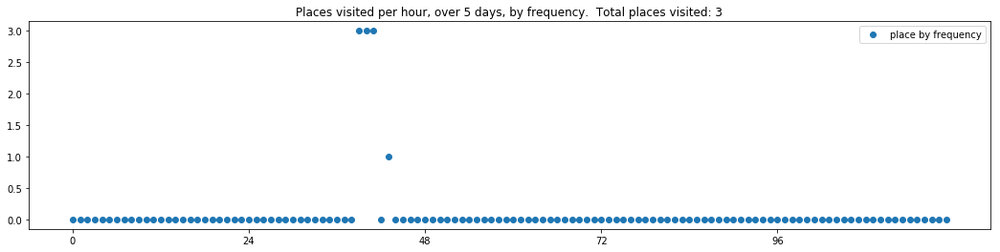

----- vector ----
prefix labels:  [598, 221]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221]
[221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 221, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


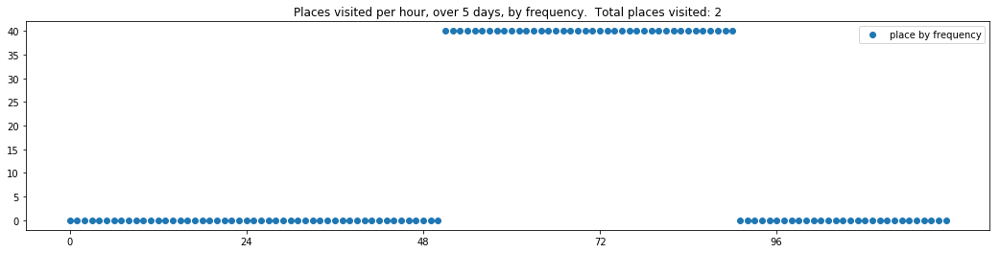

----- vector ----
prefix labels:  [382, 382]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]
[382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382, 382]


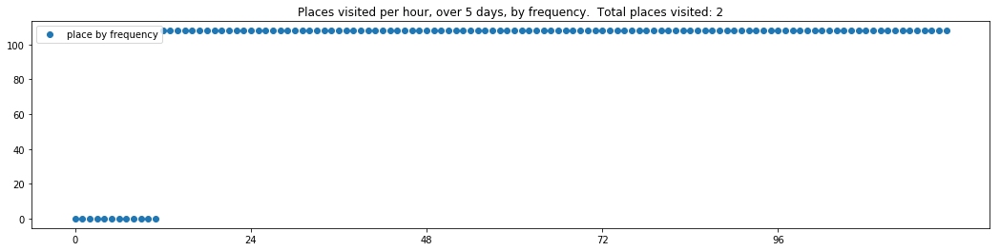

----- vector ----
prefix labels:  [122, 122]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 502, 502, 502, 502, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 122, 122, 122, 122, 122, 122, 0, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122, 122]
[122, 122, 122, 122, 0, 122, 122, 122, 122, 209, 271, 271, 76, 76, 76, 76, 76, 122, 122, 122, 122, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 144, 144, 144, 144, 144, 144, 144, 144]


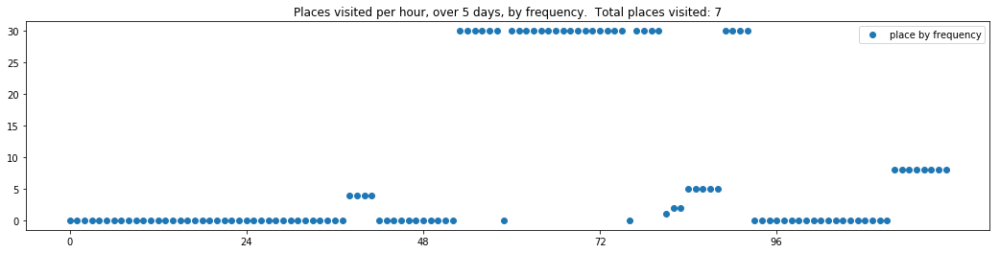

----- vector ----
prefix labels:  [588, 588]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 339, 339, 339, 339, 339, 339, 339, 339, 339]
[339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 339, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


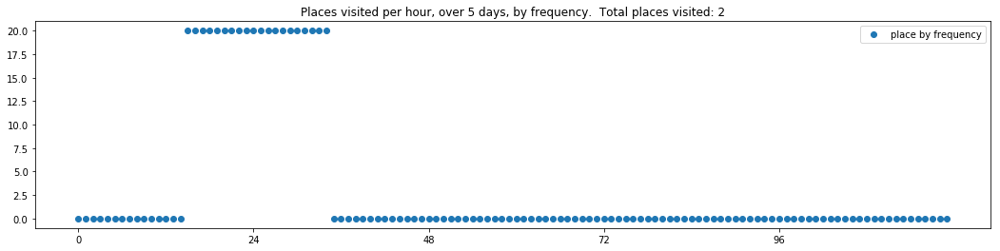

----- vector ----
prefix labels:  [281, 281]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 186, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94]
[94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 186, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


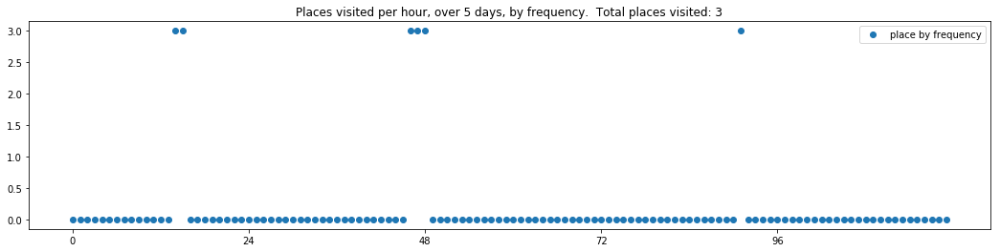

----- vector ----
prefix labels:  [204, 204]
[0, 0, 0, 0, 0, 0, 0, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]
[204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204, 204]


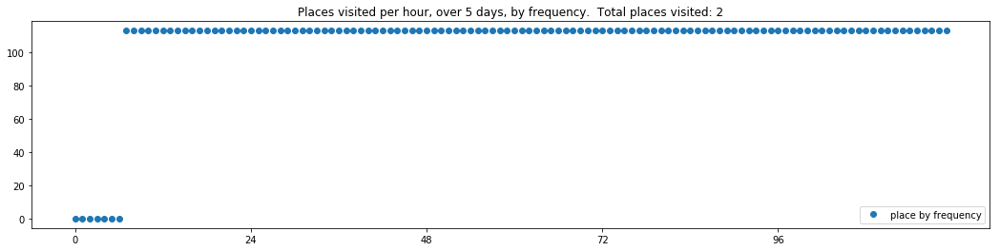

----- vector ----
prefix labels:  [453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 453, 453, 0, 0, 0, 0, 0, 0, 0, 453, 453, 453, 453, 453, 453, 453]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 0, 453, 453, 453, 453, 453]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 462, 462, 462, 462, 462, 462]
[453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 453, 463, 463, 463, 463, 463, 463, 463, 463, 463]


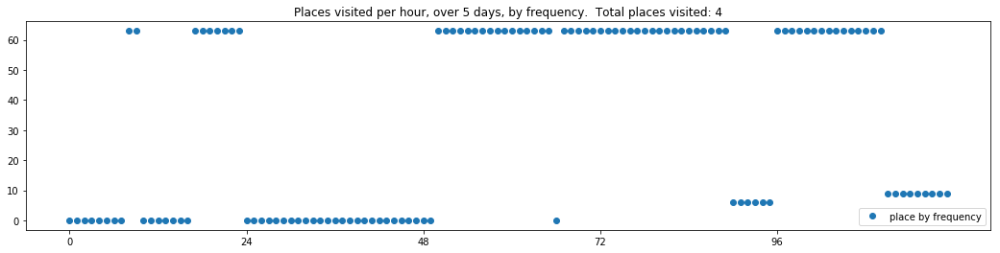

----- vector ----
prefix labels:  [308, 308]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 308, 308, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 562, 562]
[562, 562, 308, 308, 308, 0, 0, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168]
[168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168]
[168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 168, 0, 0, 0, 168, 168, 168, 168]


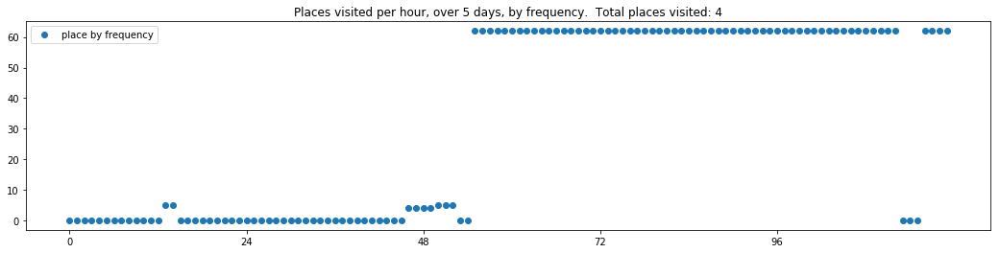

----- vector ----
prefix labels:  [29, 29]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 24, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]
[29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29]


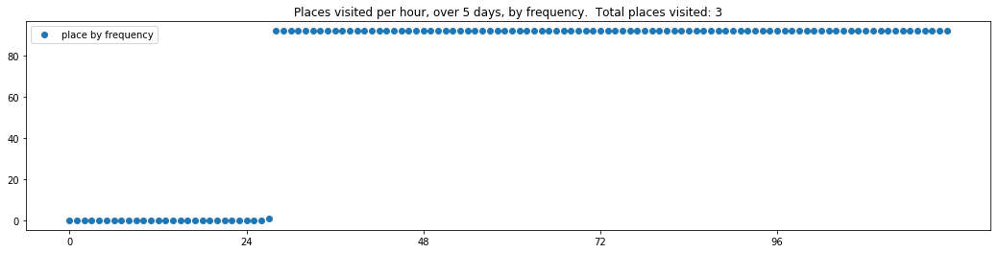

----- vector ----
prefix labels:  [311, 26]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 385, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


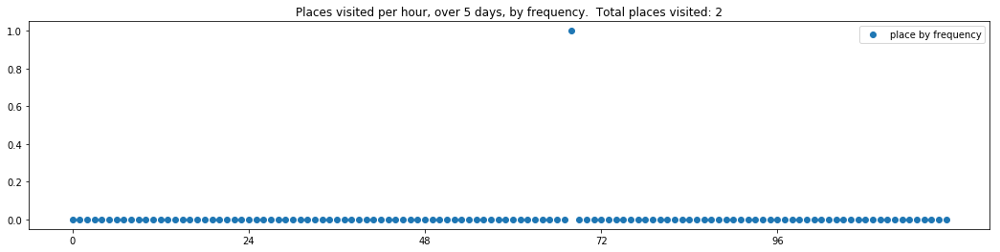

----- vector ----
prefix labels:  [248, 248]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 56, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]
[248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]
[248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]
[248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248, 248]


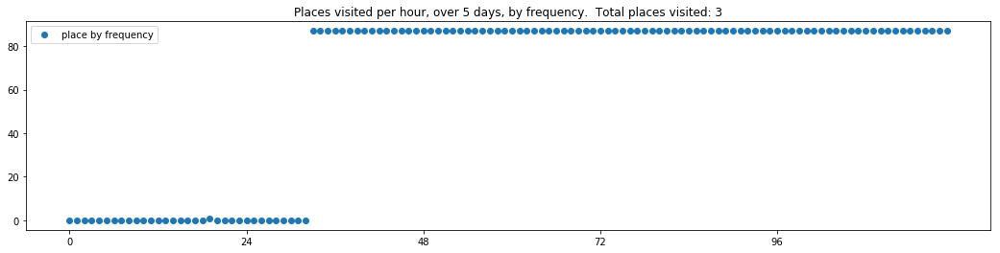

----- vector ----
prefix labels:  [505, 51]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 209, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 227, 227, 227, 184, 271, 271, 271, 271, 271, 0, 0, 161, 130, 204, 204, 204, 204, 392, 0, 0, 0, 0, 0]
[0, 0, 0, 267, 100, 100, 19, 19, 19, 19, 19, 0, 0, 0, 19, 19, 19, 19, 19, 19, 19, 19, 19, 267]
[267, 270, 270, 270, 270, 270, 270, 270, 270, 557, 557, 557, 557, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


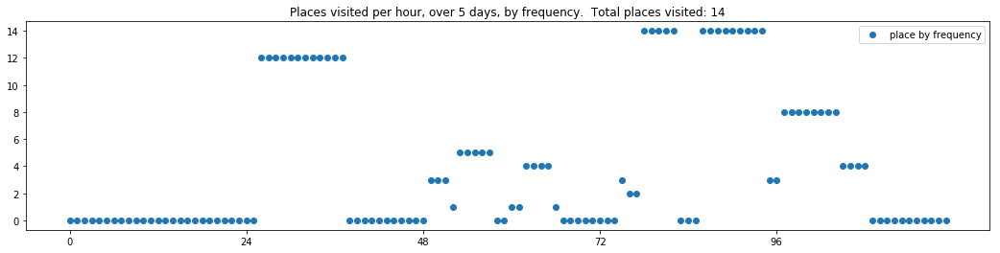

----- vector ----
prefix labels:  [259, 259]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 259, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 413, 0, 23, 0]
[60, 0, 0, 0, 0, 0, 26, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


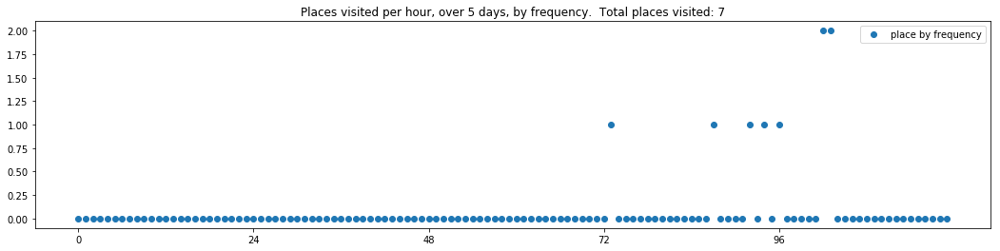

----- vector ----
prefix labels:  [285, 322]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


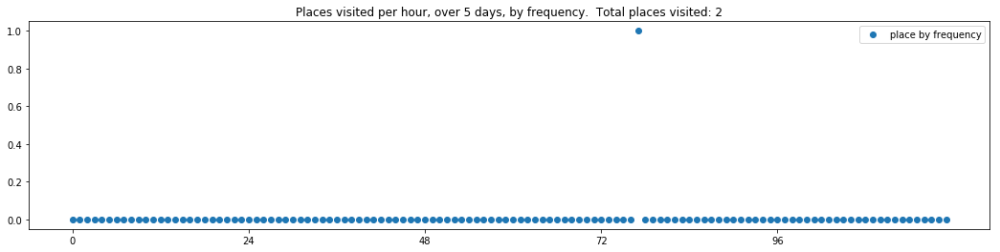

----- vector ----
prefix labels:  [357, 21]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357]
[357, 357, 357, 271, 271, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]
[357, 357, 357, 357, 357, 357, 357, 357, 357, 0, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357, 357]


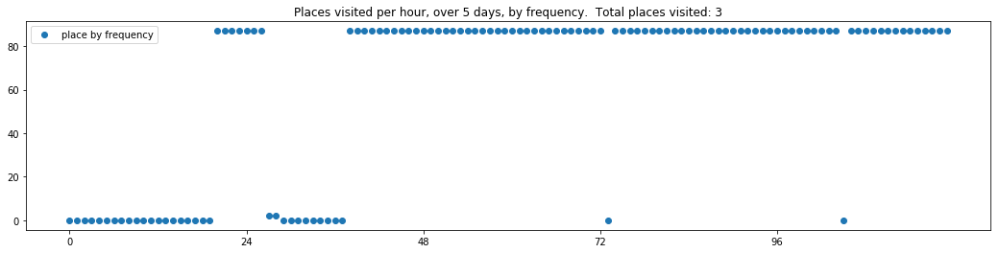

----- vector ----
prefix labels:  [374, 98]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 271, 271, 271, 271, 271, 98, 0, 0, 0, 0, 0, 0, 0, 0]


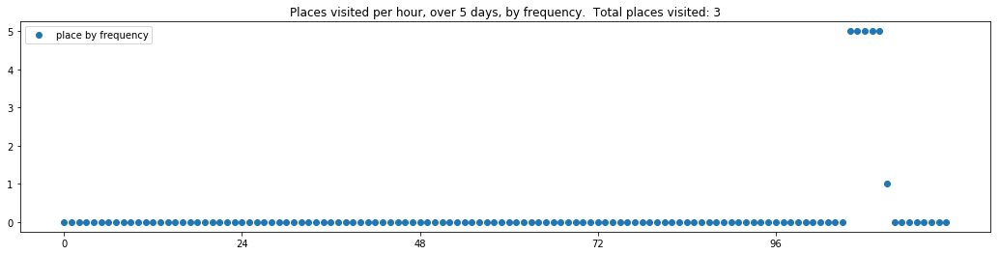

----- vector ----
prefix labels:  [182, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[378, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 456, 456]
[248, 434, 434, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 209, 209, 209, 209]


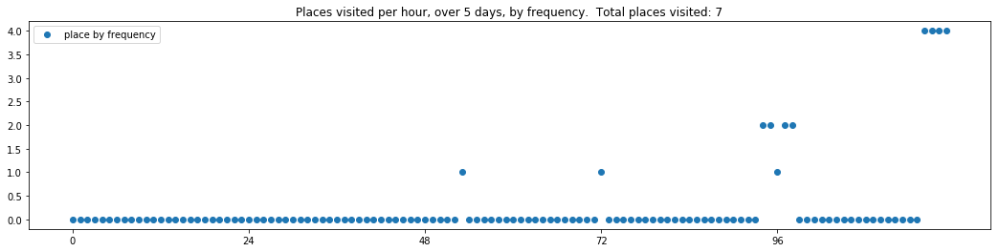

----- vector ----
prefix labels:  [303, 303]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 303, 303, 303, 303, 0, 303, 303, 303]
[303, 303, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


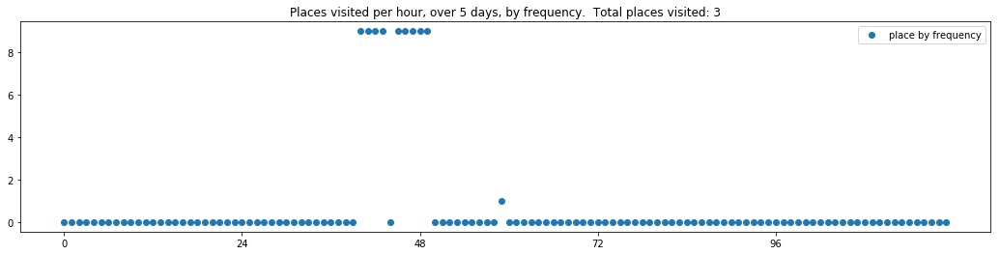

----- vector ----
prefix labels:  [94, 94]
[0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 464, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 94, 94, 94, 94, 94, 0, 0, 0]
[94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 0, 0, 0, 0, 94, 94, 94, 94, 94, 94, 94, 94, 94]


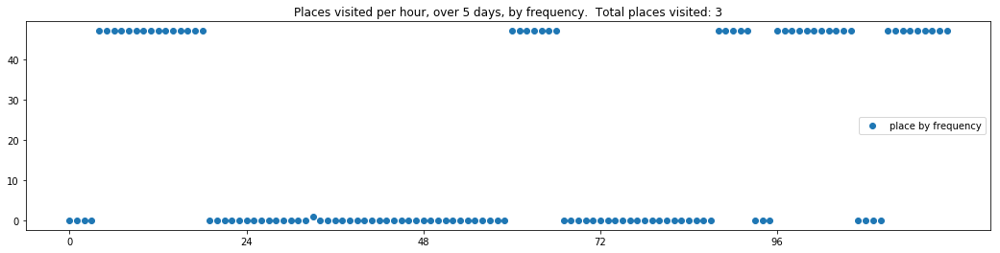

----- vector ----
prefix labels:  [105, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


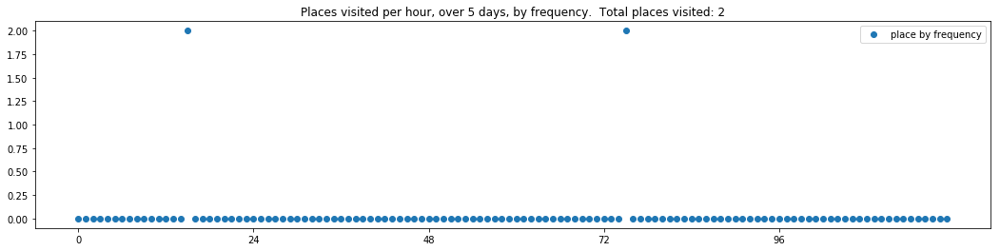

----- vector ----
prefix labels:  [401, 401]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 401, 401, 401, 401, 401, 401, 401, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


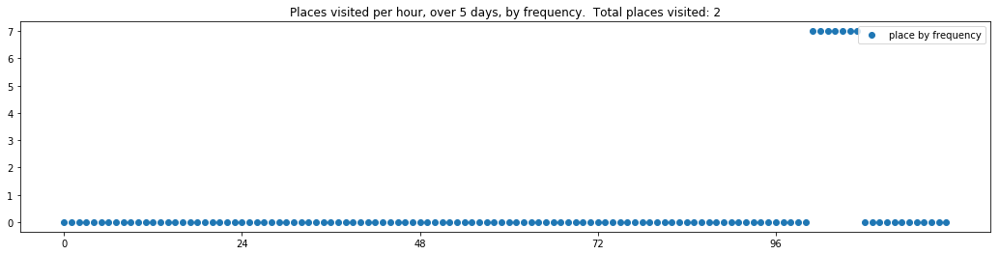

In [8]:
# Inspect the trajectories in these eval files

sample_size = 50

seqgan_generated = []

for eval_num in sorted(eval_filenames.keys()):
    filename = eval_filenames[eval_num]
    print('\n------\n',eval_num, filename, '\n------\n')
    seqgan_generated = read_trajectories_from_file(filename)
    for tv in seqgan_generated[:sample_size]:
        print_dwell_vector_by_days(tv)
        plot_trajectory_vector_frequencies(tv, by_frequency_order=False) 
        